# ARIMAX_N with GRIDSEARCH_CV and PCA on ADM0, MONTHLY

In [1]:
import pandas as pd

# pd.set_option('display.max_rows', 500)
# pd.set_option('display.max_columns', 500)

import warnings
warnings.simplefilter('ignore')

import warnings
from statsmodels.tools.sm_exceptions import ConvergenceWarning
warnings.simplefilter('ignore', ConvergenceWarning)
    
import time
import datetime

import os

## Model Specifications

In [2]:
TARGET_VARIABLE = "SUM(FATALITIES)"
SEASONAL_PERIODICITY = 12 # for data frequency & seasonality S

SEASONALITY = False
NEIGHBORS = True # X_N
SOCIO_ECO_VARS = False # X_SE
N_LAGS_X = 1 # todo: remove or change behavior from max lags to lag
DIM_REDUCTION_METHOD = "PCA"

if SEASONALITY:
    CV_FOLDS = 5
else:
    CV_FOLDS = 5

In [3]:
MODEL_NAME = ""
if SEASONALITY:
    MODEL_NAME += "S" 
    
MODEL_NAME += "ARIMA"

if SOCIO_ECO_VARS and NEIGHBORS:
    MODEL_NAME += "X_SE+N"
    
if SOCIO_ECO_VARS and not NEIGHBORS:
    MODEL_NAME += "X_SE"
    
if not SOCIO_ECO_VARS and NEIGHBORS:
    MODEL_NAME += "X_N"
    
if SEASONAL_PERIODICITY ==  12:
    MODEL_NAME += "_MONTHLY"
elif SEASONAL_PERIODICITY == 4:
    MODEL_NAME += "_QUARTERLY"

MODEL_NAME

'ARIMAX_N_MONTHLY'

### Hyperparameter Grid

In [4]:
# create a set of sarima configs to try
PARAM_GRID = list()
# parameter options to try

### PCA
if NEIGHBORS or SOCIO_ECO_VARS:
    n_components = range(0, 4) # include up to three main components
else:
    n_components = [0]
    

### ARMA
p_params = range(4) # AR 3
d_params = range(2) # Differencing 1
q_params = range(4) # MA 3


### SEASONALITY
if SEASONALITY:
    P_params = range(3) # 5
    D_params = range(2) # 1
    Q_params = range(3) # 2
    
    ### TREND
    # t_params = ['n','c','t','ct'] # Form of Trend
    # t_params = ['n', 't', 'ct'] # Form of Trend
    t_params = ["n"]

    ### SEASONAL PERIODICITY
    m_params = [SEASONAL_PERIODICITY]   
else:
    P_params = [0]
    D_params = [0]
    Q_params = [0]

    t_params = ["n"] # Form of Trend

    m_params = [0] 

for n in n_components:
    for p in p_params:
        for d in d_params:
            for q in q_params:
                for P in P_params:
                    for D in D_params:
                        for Q in Q_params:
                            for m in m_params:
                                for t in t_params:
                                    cfg = [n, (p, d, q), (P, D, Q, m), t]
                                    PARAM_GRID.append(cfg)
len(PARAM_GRID)    

128

## Model Training

In [5]:
from common_functions import *
from forecasters import *

#### Training Method

In [6]:
def sarimax(target_variable="SUM(FATALITIES)", 
            target_country="MLI", 
            predictor_countries=["BFA"], 
            n_lags_X = N_LAGS_X, 
            seasonal_periodicity = SEASONAL_PERIODICITY):
        
    ### GET DATA
    y, X = getData(target_variable = target_variable, 
                   target_country = target_country, 
                   predictor_countries = predictor_countries,
                   socio_eco_vars = SOCIO_ECO_VARS,
                   n_lags_X = N_LAGS_X, 
                   seasonal_periodicity = SEASONAL_PERIODICITY)
    
    ### SPLIT DATA
    X_train, X_test, y_train, y_test = train_test_split(y = y,
                                                        X = X, 
                                                        forecast_horizon = SEASONAL_PERIODICITY)
    
    ### TRAINING WITH GRIDSEARCHCV
    gscv = GridSearchCV(param_grid = PARAM_GRID,
                        forecaster = TimeSeriesForecasterPCA_LinInt,
                        seasonal_periodicity = SEASONAL_PERIODICITY,
                        cv_folds = CV_FOLDS)
    training_res = gscv.train(X_train, y_train)

    if training_res is not None:
        model = gscv
        # print ARIMA summary
        print(training_res)
        print(model.best_model_result.mle_retvals)
        plt.tight_layout()
        try:
            model.best_model_result.plot_diagnostics(figsize=(16*0.7, 10*0.7), lags = SEASONAL_PERIODICITY+1)
        except: 
            pass
        best_parameters = str(model.best_model_cv_results)
        
    else:
        print("No model fitted --> Prediction with Naive Model ")
        model = NoChange().fit(X_train, y_train)
        best_parameters = np.nan
        
    ### PREDICTION
    prediction_results = model.evaluate_model(X_test, y_test, fh = SEASONAL_PERIODICITY)
    
    if prediction_results["FAT_PRED"].isnull().values.any():
        model = NoChange().fit(X_train, y_train)
        print("Model Prediction failed --> Prediction with Naive Model ")
        model = NoChange().fit(X_train, y_train)
        best_parameters = np.nan
        prediction_results = model.evaluate_model(X_test, y_test, fh = SEASONAL_PERIODICITY)
    
    ### ADJUST RESULT DF
    prediction_results["GID_0"] = target_country
    prediction_results["MONTH"] = pd.to_datetime(prediction_results["MONTH"].astype(str)) 
    prediction_results["PARAMETERS"] = best_parameters

    print(prediction_results)

    return prediction_results

#### Automated Training for all 234 Countries 

In [7]:
acled_monthly_adm0 = pd.read_csv("../data/TB003_EVENT_OUTCOMES_MONTHLY_START_DATE.csv")
gid0_neighbors = pd.read_csv("../data/GID_0_Neighbours.csv")
# gid_list = acled_monthly_adm0["GID_0"].unique()[::-1] #reverse
gid_list = acled_monthly_adm0["GID_0"].unique()
len(gid_list)

234

######## ABW (1/234) #########
0
Neighbor countries: []
Getting Data for ABW
IMF, WB, ACLED loaded
adjusting y for lags
adjusting X for lags
GET DATA finished.
X: (38, 0)
y: (38, 1)
------------------------------------------------
Training started.
y_train is all zero. No GSCV necessary.
Best CV-Results
{}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ABW   No. Observations:                   26
Model:                         SARIMAX   Log Likelihood                 275.444
Date:                 Wed, 19 Oct 2022   AIC                           -548.887
Time:                         10:23:14   BIC                           -547.629
Sample:                     01-31-2019   HQIC                          -548.525
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err 

<Figure size 432x288 with 0 Axes>

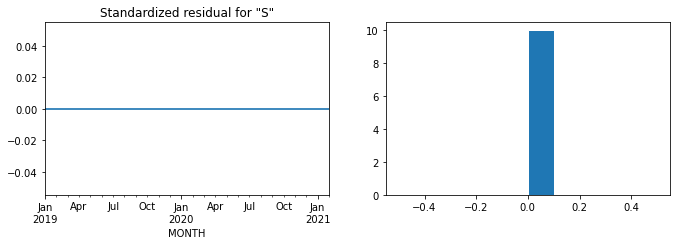

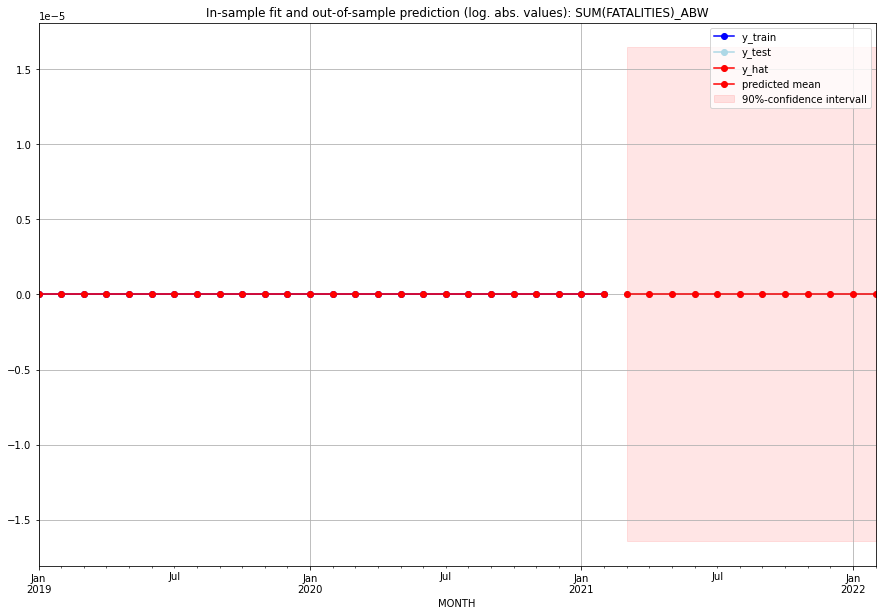

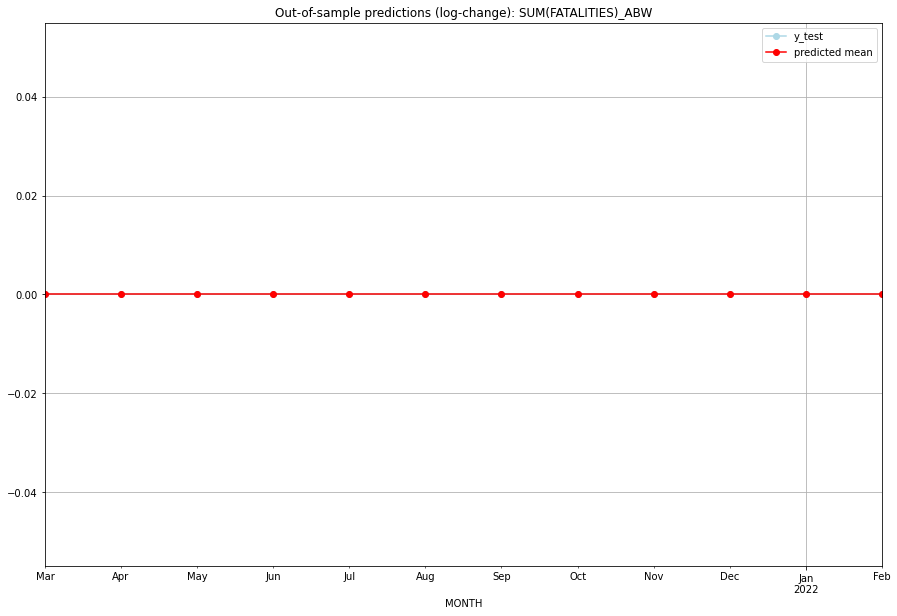

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ABW   
1  2021-04-01       0.0         0.0           0.0             0.0   ABW   
2  2021-05-01       0.0         0.0           0.0             0.0   ABW   
3  2021-06-01       0.0         0.0           0.0             0.0   ABW   
4  2021-07-01       0.0         0.0           0.0             0.0   ABW   
5  2021-08-01       0.0         0.0           0.0             0.0   ABW   
6  2021-09-01       0.0         0.0           0.0             0.0   ABW   
7  2021-10-01       0.0         0.0           0.0             0.0   ABW   
8  2021-11-01       0.0         0.0           0.0             0.0   ABW   
9  2021-12-01       0.0         0.0           0.0             0.0   ABW   
10 2022-01-01       0.0         0.0           0.0             0.0   ABW   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.2832347975267508, 'fold_results': [0.2787274463036295, 0.26570510200518277, 0.30527184427144]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_AFG   No. Observations:                   50
Model:                SARIMAX(1, 0, 2)   Log Likelihood                  -3.375
Date:                 Wed, 19 Oct 2022   AIC                             20.749
Time:                         10:23:26   BIC                             34.133
Sample:                     01-31-2017   HQIC                            25.846
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1        

<Figure size 432x288 with 0 Axes>

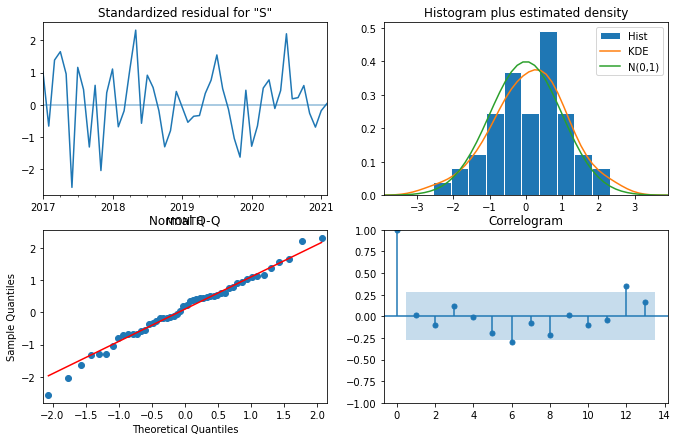

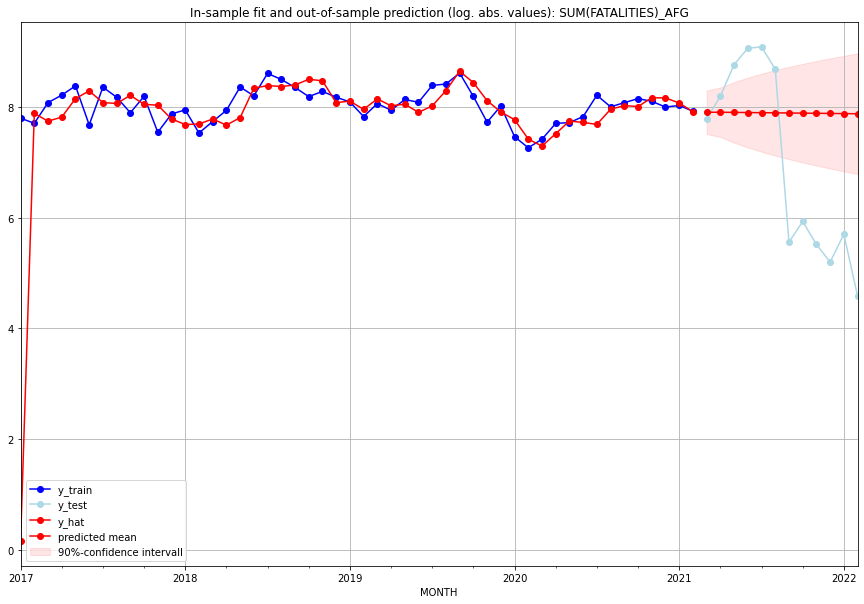

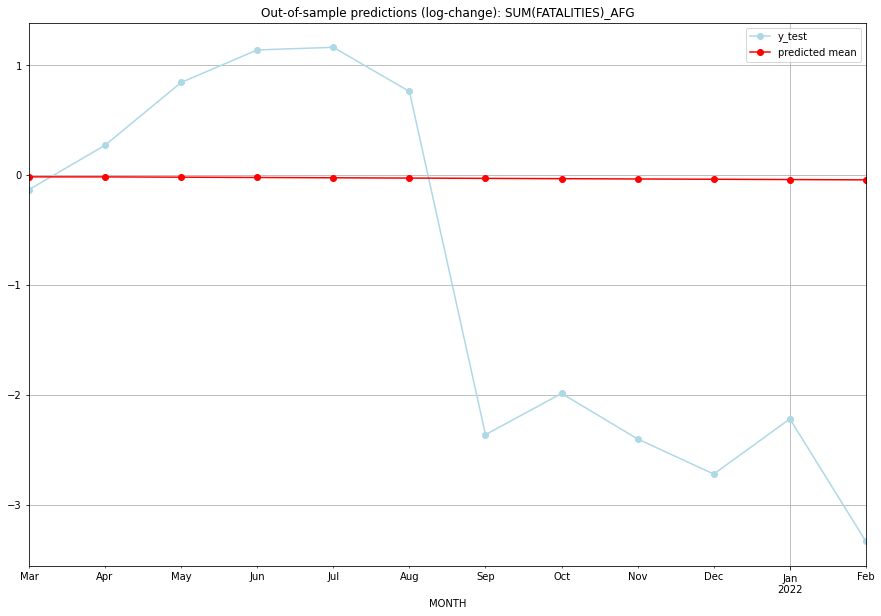

TADDA: 1.6105108582251784
Evaluation finished.
        MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2703.585991      2406.0     -0.018469       -0.135036   AFG   
1  2021-04-01  2703.185281      3606.0     -0.018617        0.269459   AFG   
2  2021-05-01  2695.879566      6384.0     -0.021322        0.840534   AFG   
3  2021-06-01  2688.595971      8584.0     -0.024026        1.136599   AFG   
4  2021-07-01  2681.334424      8791.0     -0.026730        1.160425   AFG   
5  2021-08-01  2674.094851      5884.0     -0.029433        0.758989   AFG   
6  2021-09-01  2666.877179       258.0     -0.032134       -2.364345   AFG   
7  2021-10-01  2659.681335       376.0     -0.034835       -1.988928   AFG   
8  2021-11-01  2652.507248       248.0     -0.037535       -2.403720   AFG   
9  2021-12-01  2645.354844       180.0     -0.040234       -2.722676   AFG   
10 2022-01-01  2638.224053       298.0     -0.042932       -2.220729   AFG   
11 2022-02-01  26

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.9842262050704302, 'fold_results': [1.7389615744397713, 1.0121323662267205, 0.7967262928138656, 0.605756046300039, 0.7675547455717554]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_AGO   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -498.110
Date:                 Wed, 19 Oct 2022   AIC                           1004.219
Time:                         10:24:03   BIC                           1018.871
Sample:                     02-28-1997   HQIC                          1010.091
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

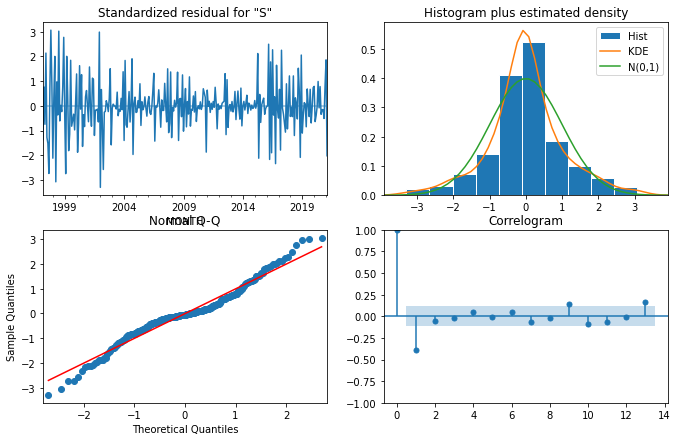

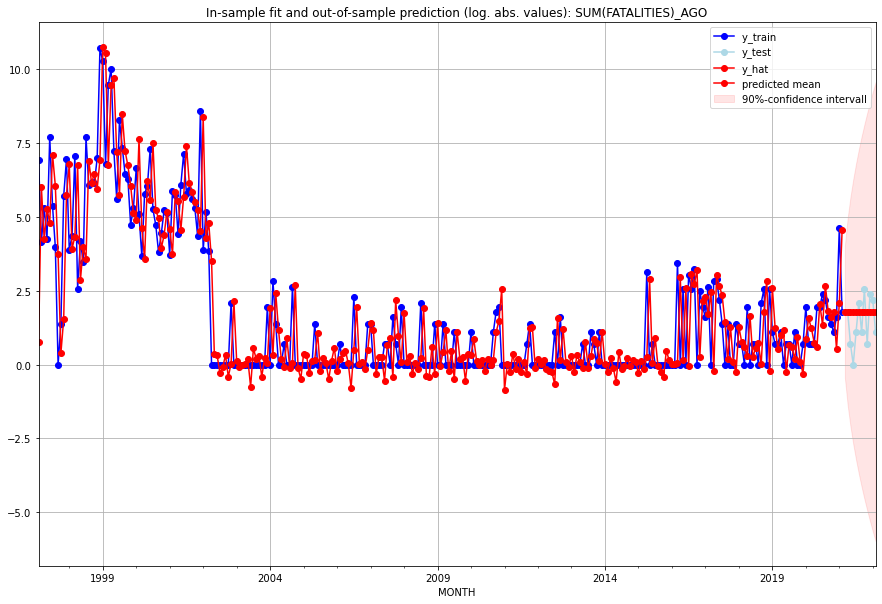

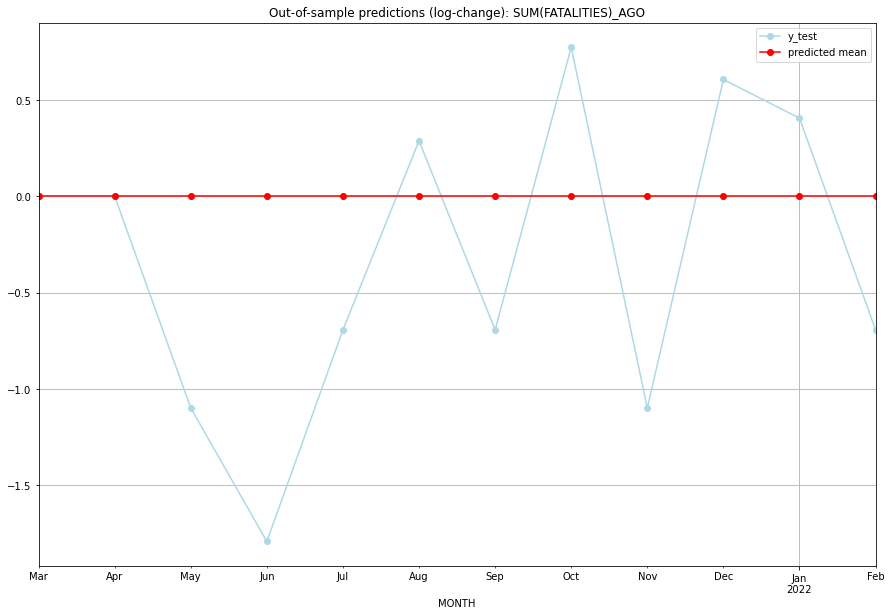

TADDA: 0.6784082050506551
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       5.0         5.0  8.881784e-16        0.000000   AGO   
1  2021-04-01       5.0         5.0  8.881784e-16        0.000000   AGO   
2  2021-05-01       5.0         1.0  8.881784e-16       -1.098612   AGO   
3  2021-06-01       5.0         0.0  8.881784e-16       -1.791759   AGO   
4  2021-07-01       5.0         2.0  8.881784e-16       -0.693147   AGO   
5  2021-08-01       5.0         7.0  8.881784e-16        0.287682   AGO   
6  2021-09-01       5.0         2.0  8.881784e-16       -0.693147   AGO   
7  2021-10-01       5.0        12.0  8.881784e-16        0.773190   AGO   
8  2021-11-01       5.0         1.0  8.881784e-16       -1.098612   AGO   
9  2021-12-01       5.0        10.0  8.881784e-16        0.606136   AGO   
10 2022-01-01       5.0         8.0  8.881784e-16        0.405465   AGO   
11 2022-02-01       5.0         2.0  8.881784e-16    

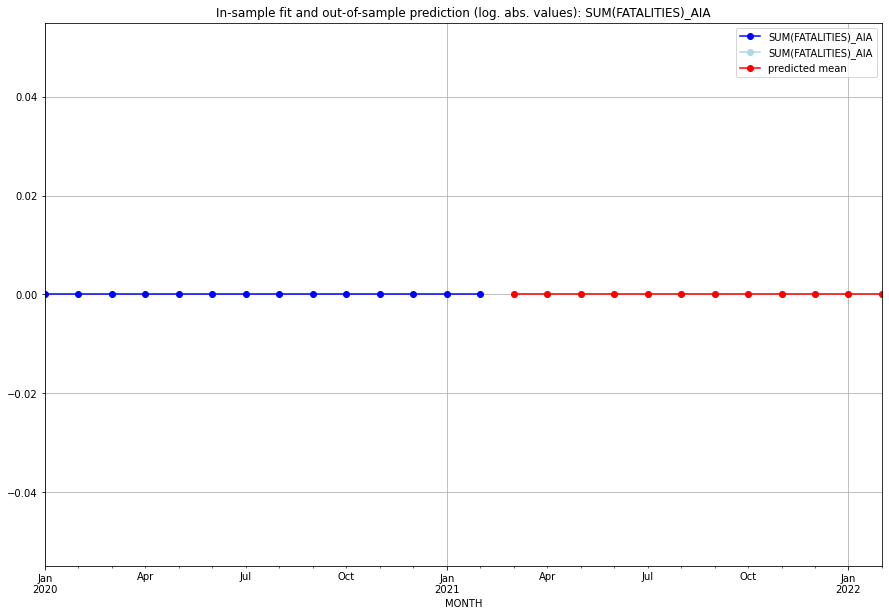

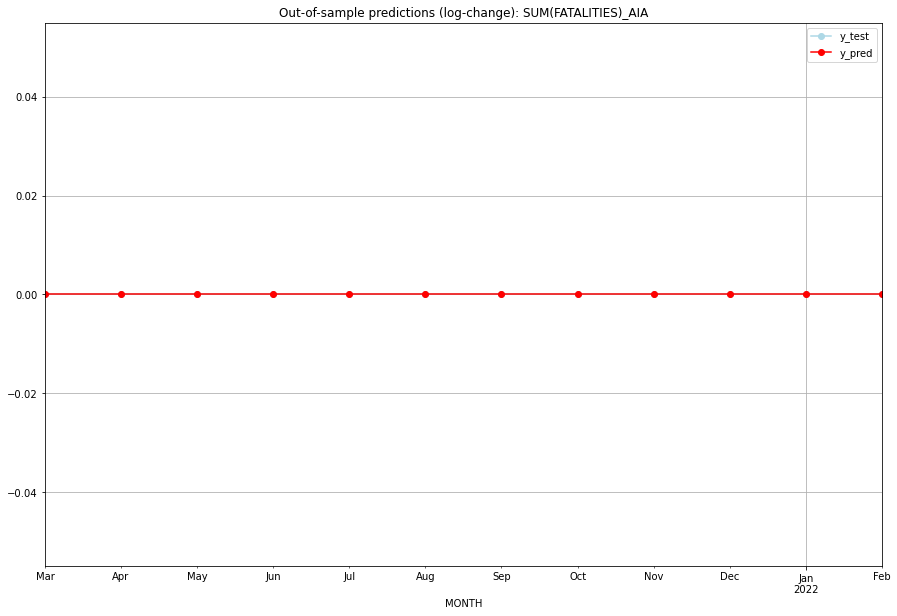

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   AIA   
1  2021-04-01       0.0         0.0           0.0             0.0   AIA   
2  2021-05-01       0.0         0.0           0.0             0.0   AIA   
3  2021-06-01       0.0         0.0           0.0             0.0   AIA   
4  2021-07-01       0.0         0.0           0.0             0.0   AIA   
5  2021-08-01       0.0         0.0           0.0             0.0   AIA   
6  2021-09-01       0.0         0.0           0.0             0.0   AIA   
7  2021-10-01       0.0         0.0           0.0             0.0   AIA   
8  2021-11-01       0.0         0.0           0.0             0.0   AIA   
9  2021-12-01       0.0         0.0           0.0             0.0   AIA   
10 2022-01-01       0.0         0.0           0.0             0.0   AIA   
11 2022-02-01       0.0         0.0           0.0             0.0   

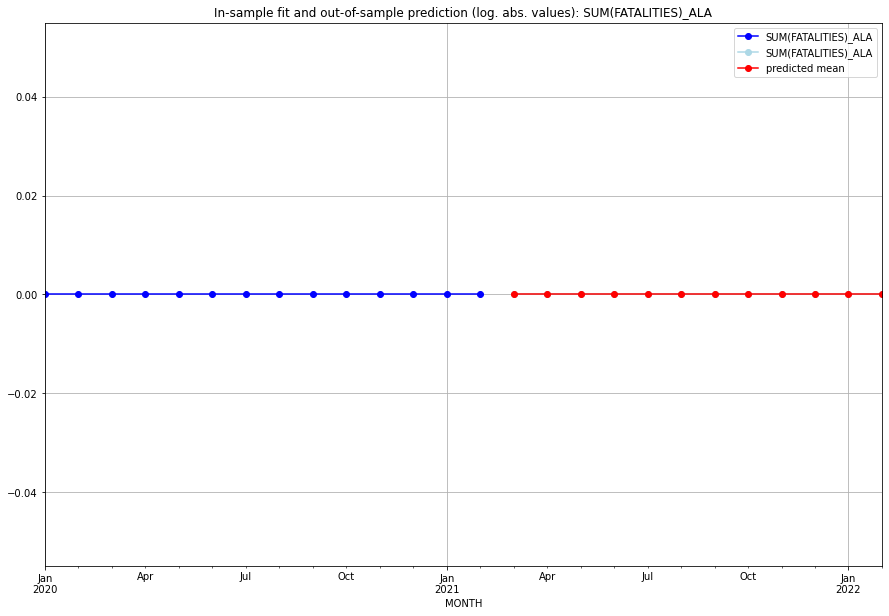

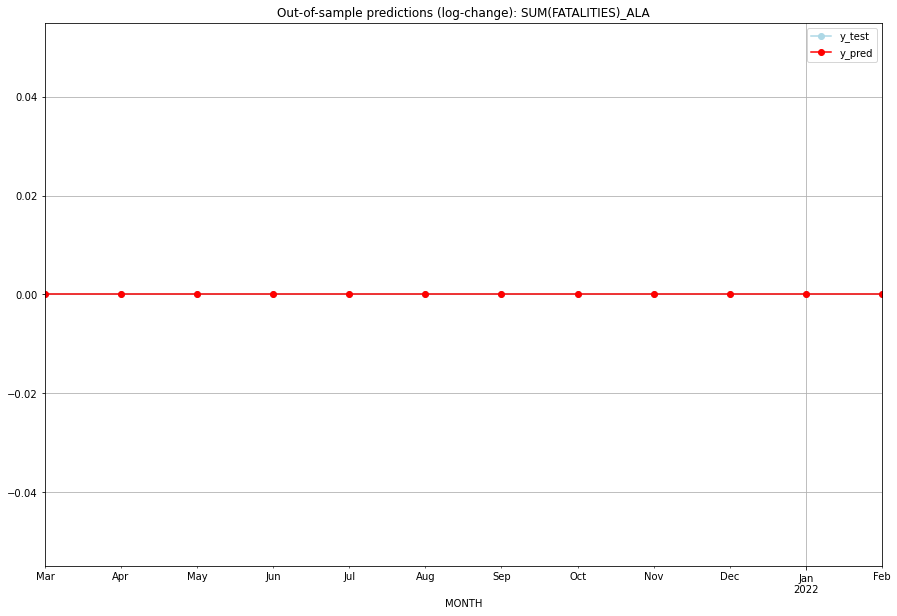

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ALA   
1  2021-04-01       0.0         0.0           0.0             0.0   ALA   
2  2021-05-01       0.0         0.0           0.0             0.0   ALA   
3  2021-06-01       0.0         0.0           0.0             0.0   ALA   
4  2021-07-01       0.0         0.0           0.0             0.0   ALA   
5  2021-08-01       0.0         0.0           0.0             0.0   ALA   
6  2021-09-01       0.0         0.0           0.0             0.0   ALA   
7  2021-10-01       0.0         0.0           0.0             0.0   ALA   
8  2021-11-01       0.0         0.0           0.0             0.0   ALA   
9  2021-12-01       0.0         0.0           0.0             0.0   ALA   
10 2022-01-01       0.0         0.0           0.0             0.0   ALA   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ALB   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  29.122
Date:                 Wed, 19 Oct 2022   AIC                            -56.244
Time:                         10:24:27   BIC                            -54.606
Sample:                     01-31-2018   HQIC                           -55.661
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0126      0.001     18.748      0.000       0.011       0

<Figure size 432x288 with 0 Axes>

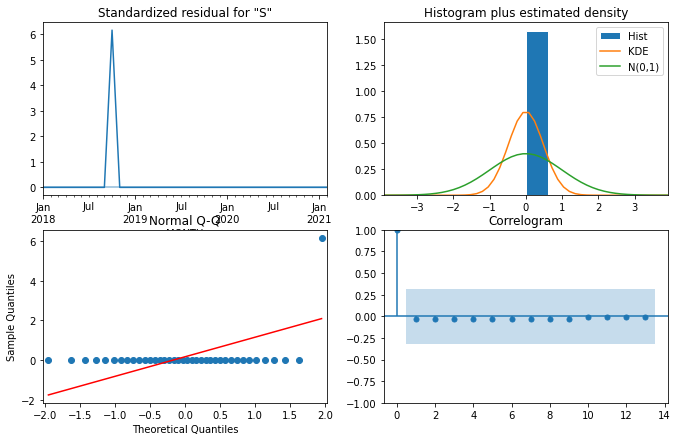

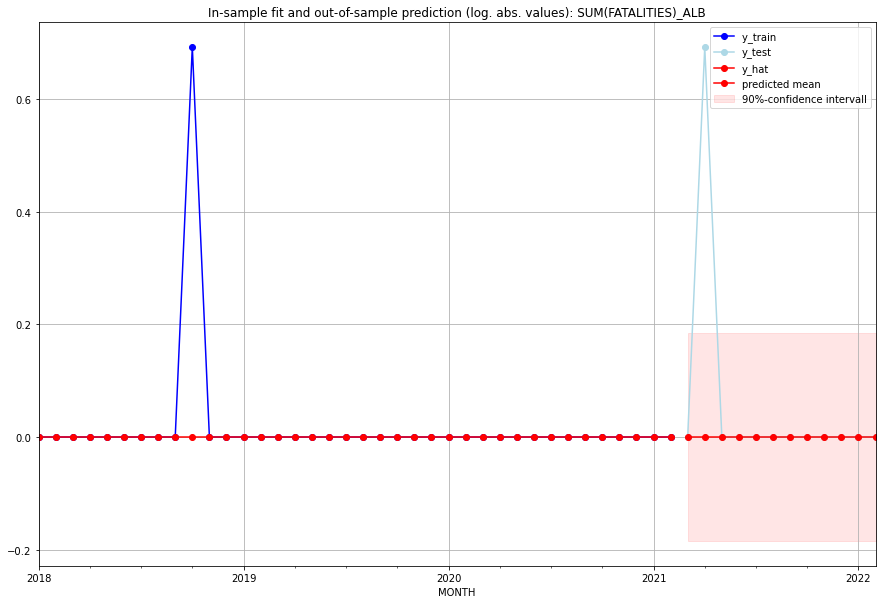

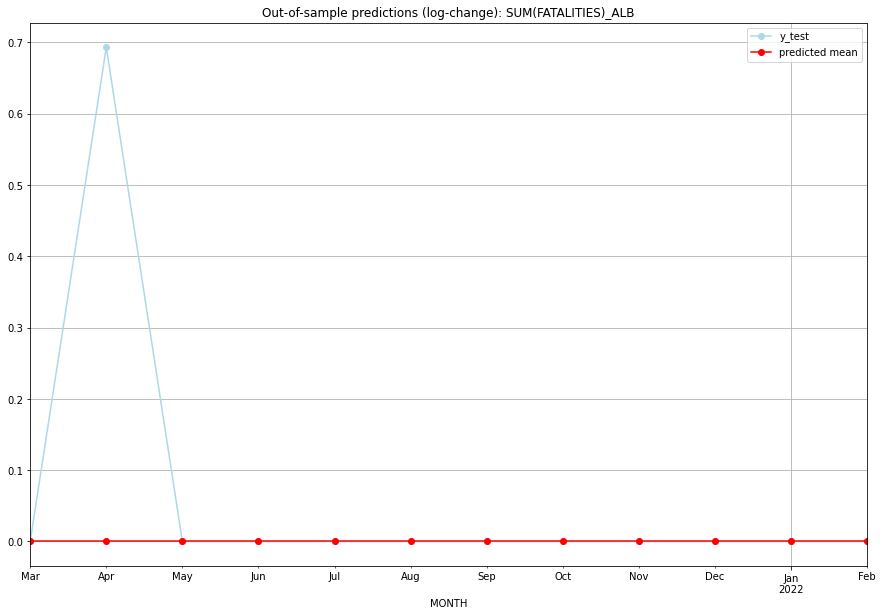

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   ALB   
1  2021-04-01       0.0         1.0           0.0        0.693147   ALB   
2  2021-05-01       0.0         0.0           0.0        0.000000   ALB   
3  2021-06-01       0.0         0.0           0.0        0.000000   ALB   
4  2021-07-01       0.0         0.0           0.0        0.000000   ALB   
5  2021-08-01       0.0         0.0           0.0        0.000000   ALB   
6  2021-09-01       0.0         0.0           0.0        0.000000   ALB   
7  2021-10-01       0.0         0.0           0.0        0.000000   ALB   
8  2021-11-01       0.0         0.0           0.0        0.000000   ALB   
9  2021-12-01       0.0         0.0           0.0        0.000000   ALB   
10 2022-01-01       0.0         0.0           0.0        0.000000   ALB   
11 2022-02-01       0.0         0.0           0.0  

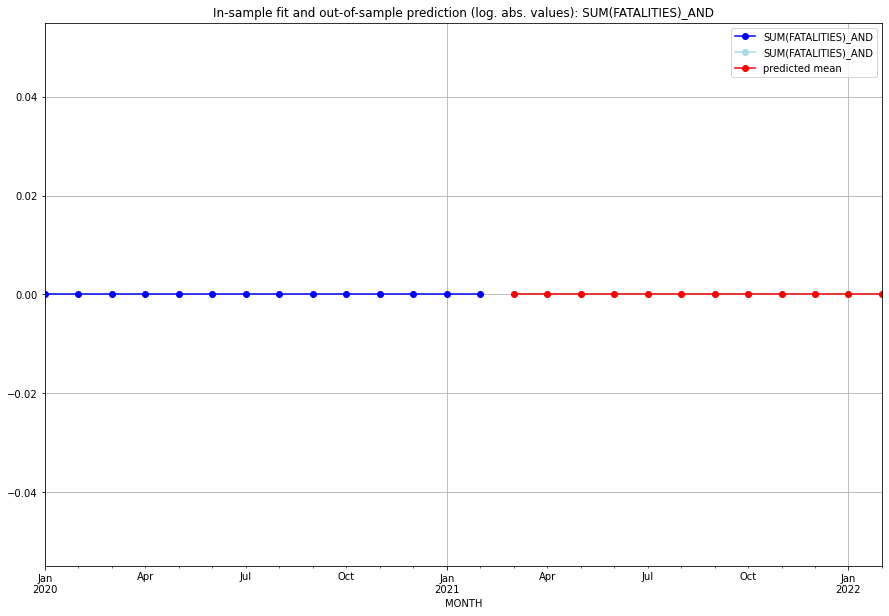

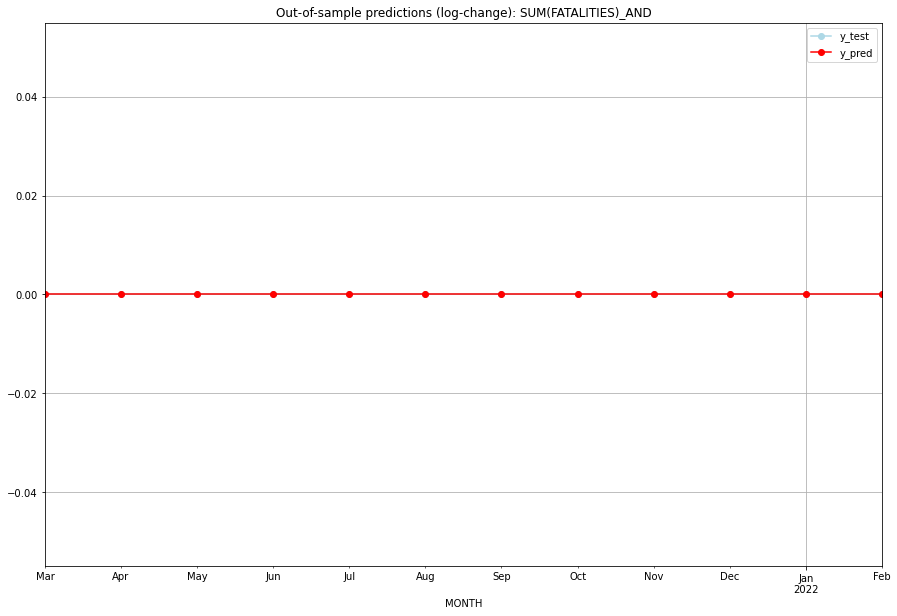

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   AND   
1  2021-04-01       0.0         0.0           0.0             0.0   AND   
2  2021-05-01       0.0         0.0           0.0             0.0   AND   
3  2021-06-01       0.0         0.0           0.0             0.0   AND   
4  2021-07-01       0.0         0.0           0.0             0.0   AND   
5  2021-08-01       0.0         0.0           0.0             0.0   AND   
6  2021-09-01       0.0         0.0           0.0             0.0   AND   
7  2021-10-01       0.0         0.0           0.0             0.0   AND   
8  2021-11-01       0.0         0.0           0.0             0.0   AND   
9  2021-12-01       0.0         0.0           0.0             0.0   AND   
10 2022-01-01       0.0         0.0           0.0             0.0   AND   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

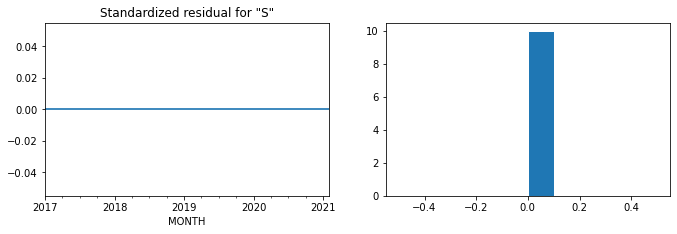

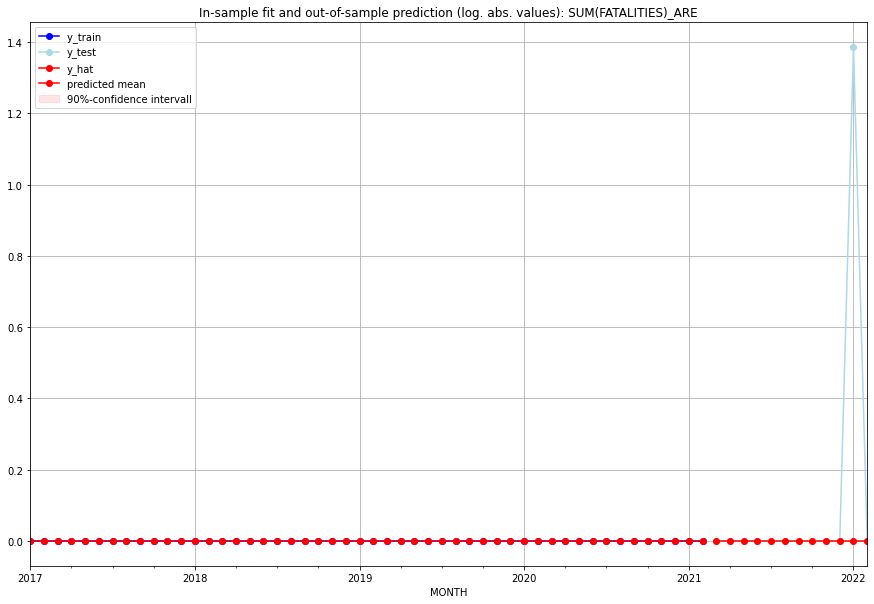

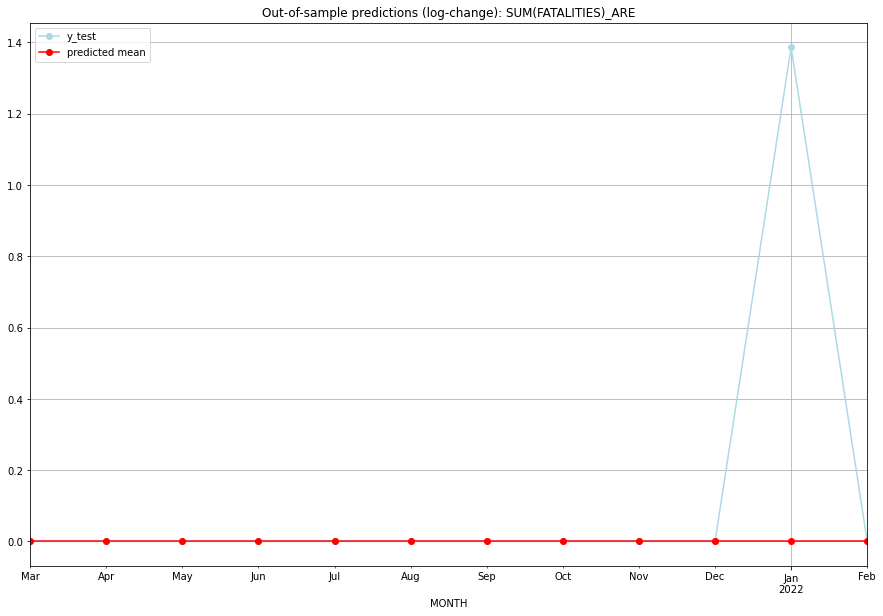

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   ARE   
1  2021-04-01       0.0         0.0           0.0        0.000000   ARE   
2  2021-05-01       0.0         0.0           0.0        0.000000   ARE   
3  2021-06-01       0.0         0.0           0.0        0.000000   ARE   
4  2021-07-01       0.0         0.0           0.0        0.000000   ARE   
5  2021-08-01       0.0         0.0           0.0        0.000000   ARE   
6  2021-09-01       0.0         0.0           0.0        0.000000   ARE   
7  2021-10-01       0.0         0.0           0.0        0.000000   ARE   
8  2021-11-01       0.0         0.0           0.0        0.000000   ARE   
9  2021-12-01       0.0         0.0           0.0        0.000000   ARE   
10 2022-01-01       0.0         3.0           0.0        1.386294   ARE   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.41177209405499937, 'fold_results': [nan, 0.41177209405499937]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ARG   No. Observations:                   38
Model:                SARIMAX(3, 1, 3)   Log Likelihood                 -35.070
Date:                 Wed, 19 Oct 2022   AIC                             84.140
Time:                         10:24:42   BIC                             95.416
Sample:                     01-31-2018   HQIC                            88.116
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0274      0.217     -0.12

<Figure size 432x288 with 0 Axes>

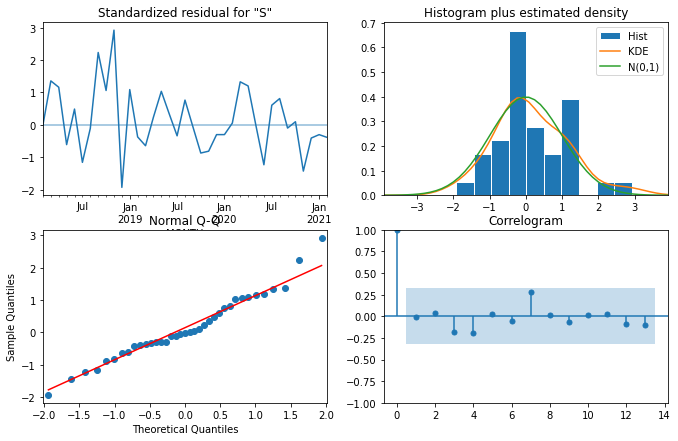

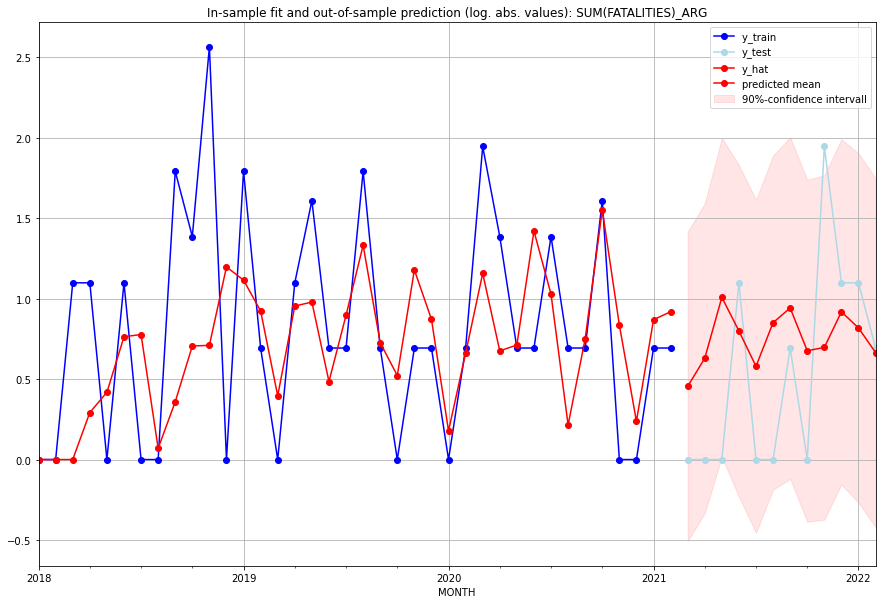

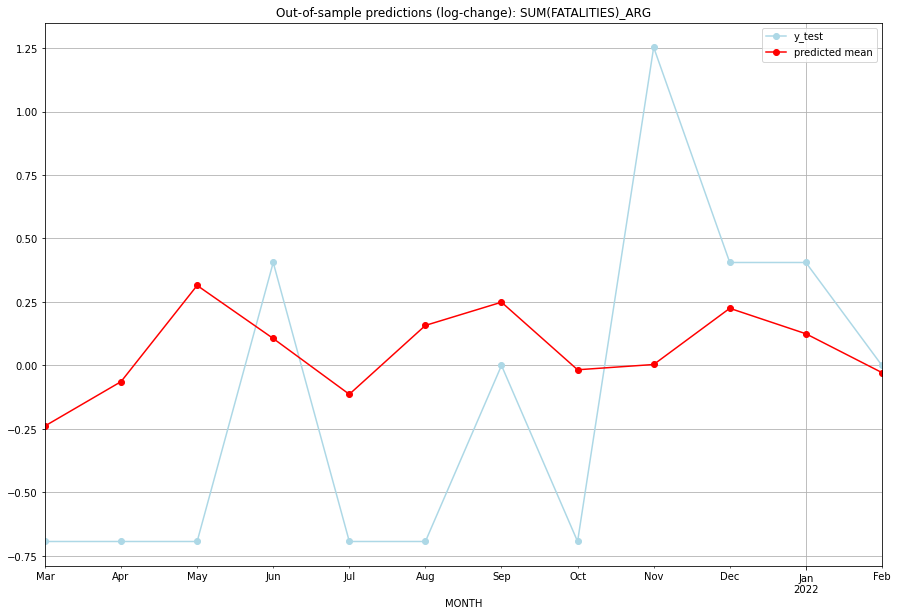

TADDA: 0.5798535280081004
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.575846         0.0     -0.238355       -0.693147   ARG   
1  2021-04-01  0.876562         0.0     -0.063706       -0.693147   ARG   
2  2021-05-01  1.740667         0.0      0.315054       -0.693147   ARG   
3  2021-06-01  1.224066         2.0      0.106190        0.405465   ARG   
4  2021-07-01  0.785420         0.0     -0.113494       -0.693147   ARG   
5  2021-08-01  1.341566         0.0      0.157673       -0.693147   ARG   
6  2021-09-01  1.565709         1.0      0.249088        0.000000   ARG   
7  2021-10-01  0.966295         0.0     -0.016996       -0.693147   ARG   
8  2021-11-01  1.007598         6.0      0.003792        1.252763   ARG   
9  2021-12-01  1.504774         2.0      0.225051        0.405465   ARG   
10 2022-01-01  1.266039         2.0      0.124886        0.405465   ARG   
11 2022-02-01  0.944526         1.0     -0.028129    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.38261515017524783, 'fold_results': [0.11552453009332421, 0.6497057702571715]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ARM   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                 -40.015
Date:                 Wed, 19 Oct 2022   AIC                             82.029
Time:                         10:24:50   BIC                             83.667
Sample:                     01-31-2018   HQIC                            82.612
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.4810      

<Figure size 432x288 with 0 Axes>

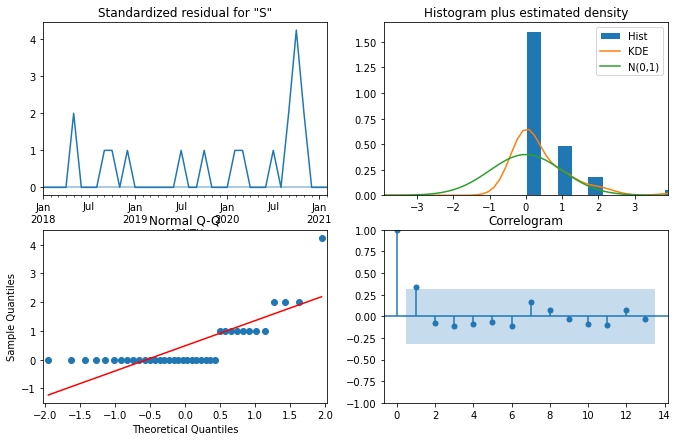

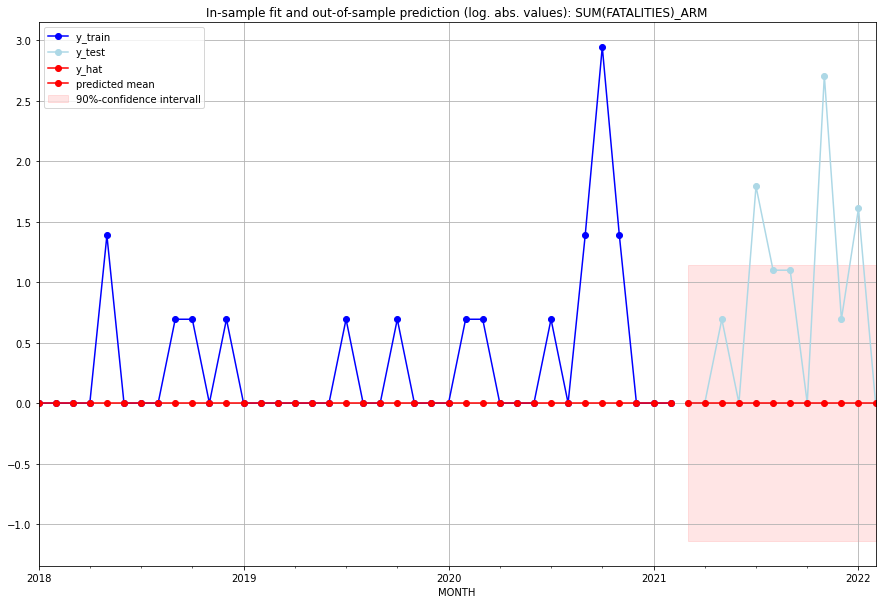

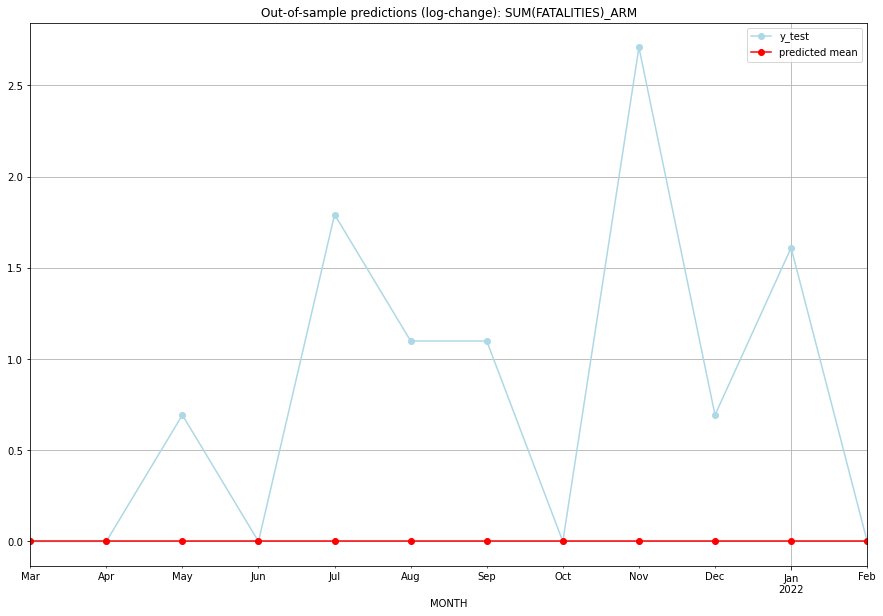

TADDA: 0.8077305434350398
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   ARM   
1  2021-04-01       0.0         0.0           0.0        0.000000   ARM   
2  2021-05-01       0.0         1.0           0.0        0.693147   ARM   
3  2021-06-01       0.0         0.0           0.0        0.000000   ARM   
4  2021-07-01       0.0         5.0           0.0        1.791759   ARM   
5  2021-08-01       0.0         2.0           0.0        1.098612   ARM   
6  2021-09-01       0.0         2.0           0.0        1.098612   ARM   
7  2021-10-01       0.0         0.0           0.0        0.000000   ARM   
8  2021-11-01       0.0        14.0           0.0        2.708050   ARM   
9  2021-12-01       0.0         1.0           0.0        0.693147   ARM   
10 2022-01-01       0.0         4.0           0.0        1.609438   ARM   
11 2022-02-01       0.0         0.0           0.0    

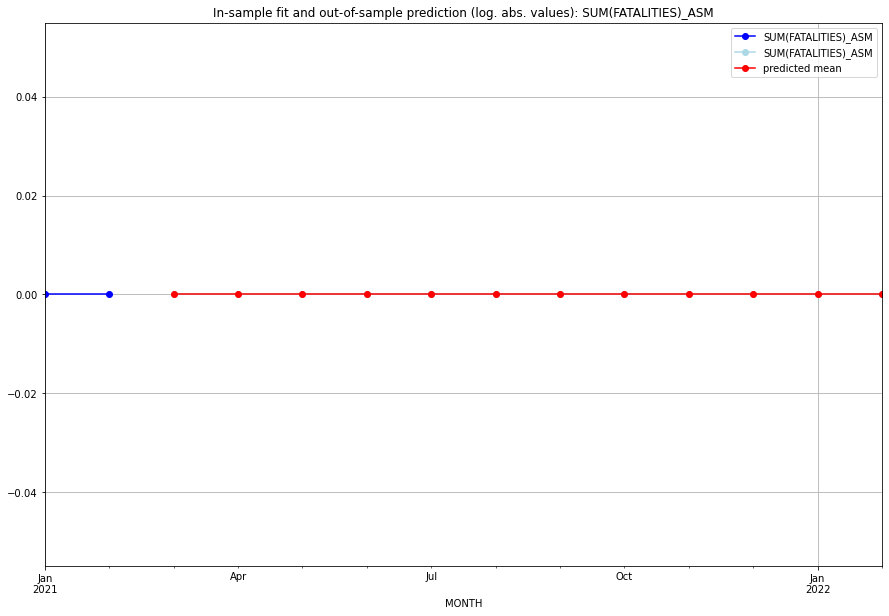

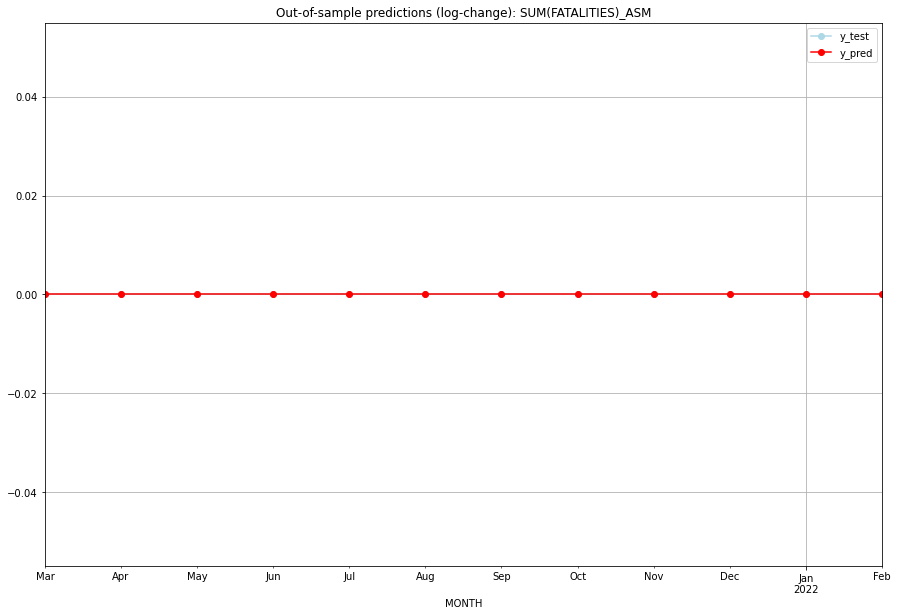

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ASM   
1  2021-04-01       0.0         0.0           0.0             0.0   ASM   
2  2021-05-01       0.0         0.0           0.0             0.0   ASM   
3  2021-06-01       0.0         0.0           0.0             0.0   ASM   
4  2021-07-01       0.0         0.0           0.0             0.0   ASM   
5  2021-08-01       0.0         0.0           0.0             0.0   ASM   
6  2021-09-01       0.0         0.0           0.0             0.0   ASM   
7  2021-10-01       0.0         0.0           0.0             0.0   ASM   
8  2021-11-01       0.0         0.0           0.0             0.0   ASM   
9  2021-12-01       0.0         0.0           0.0             0.0   ASM   
10 2022-01-01       0.0         0.0           0.0             0.0   ASM   
11 2022-02-01       0.0         0.0           0.0             0.0   

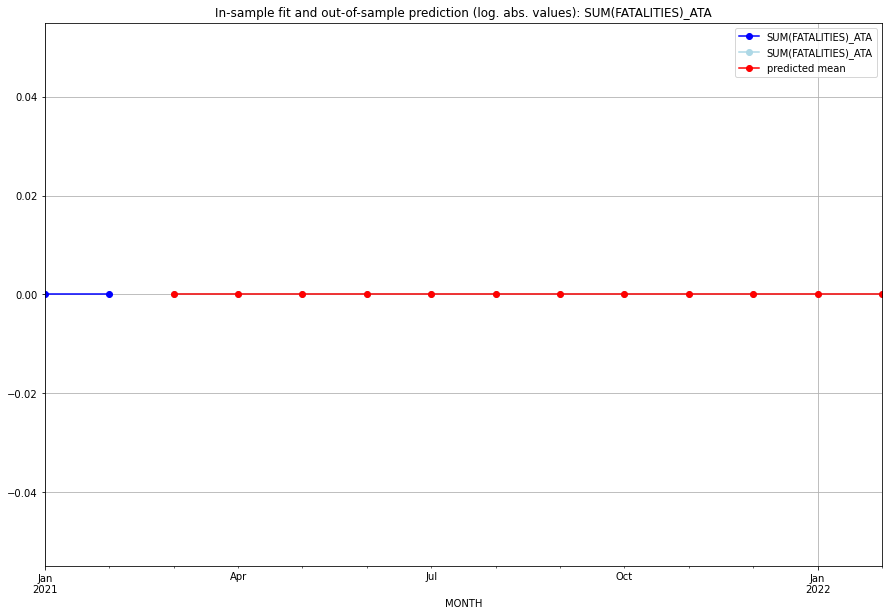

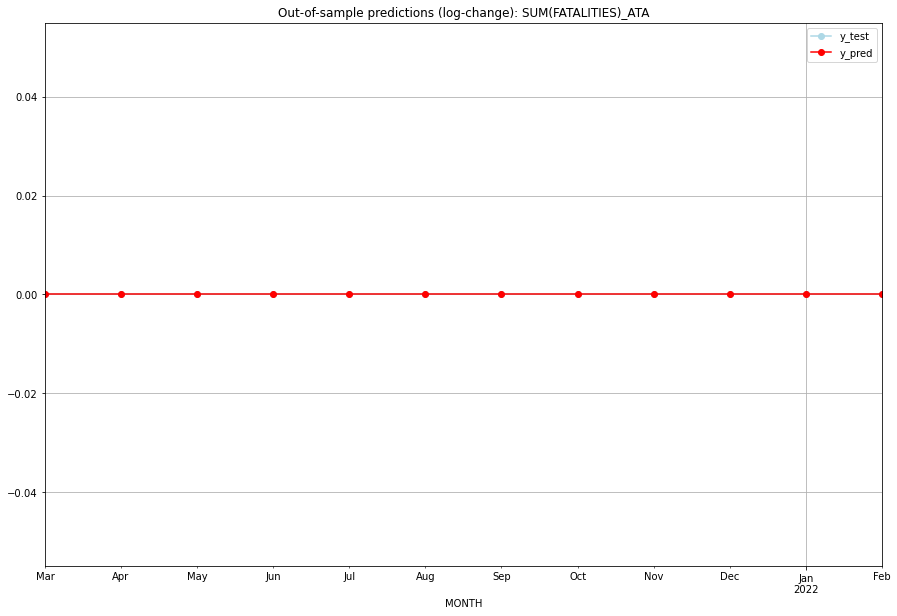

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ATA   
1  2021-04-01       0.0         0.0           0.0             0.0   ATA   
2  2021-05-01       0.0         0.0           0.0             0.0   ATA   
3  2021-06-01       0.0         0.0           0.0             0.0   ATA   
4  2021-07-01       0.0         0.0           0.0             0.0   ATA   
5  2021-08-01       0.0         0.0           0.0             0.0   ATA   
6  2021-09-01       0.0         0.0           0.0             0.0   ATA   
7  2021-10-01       0.0         0.0           0.0             0.0   ATA   
8  2021-11-01       0.0         0.0           0.0             0.0   ATA   
9  2021-12-01       0.0         0.0           0.0             0.0   ATA   
10 2022-01-01       0.0         0.0           0.0             0.0   ATA   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.028881132523331052, 'fold_results': [0.0, 0.057762265046662105]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ATG   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  29.122
Date:                 Wed, 19 Oct 2022   AIC                            -56.244
Time:                         10:25:01   BIC                            -54.606
Sample:                     01-31-2018   HQIC                           -55.661
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0126      0.001     18.

<Figure size 432x288 with 0 Axes>

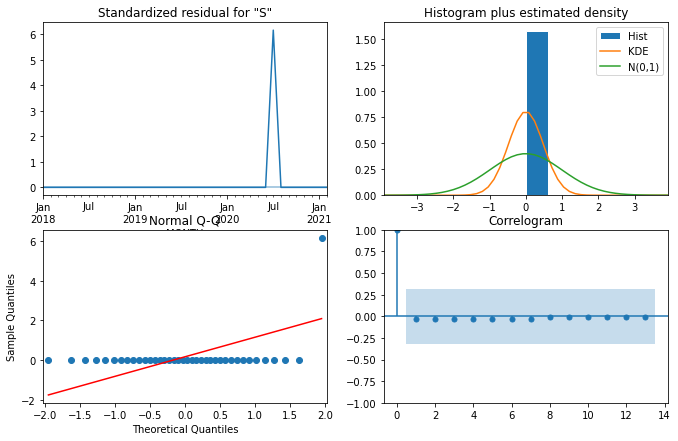

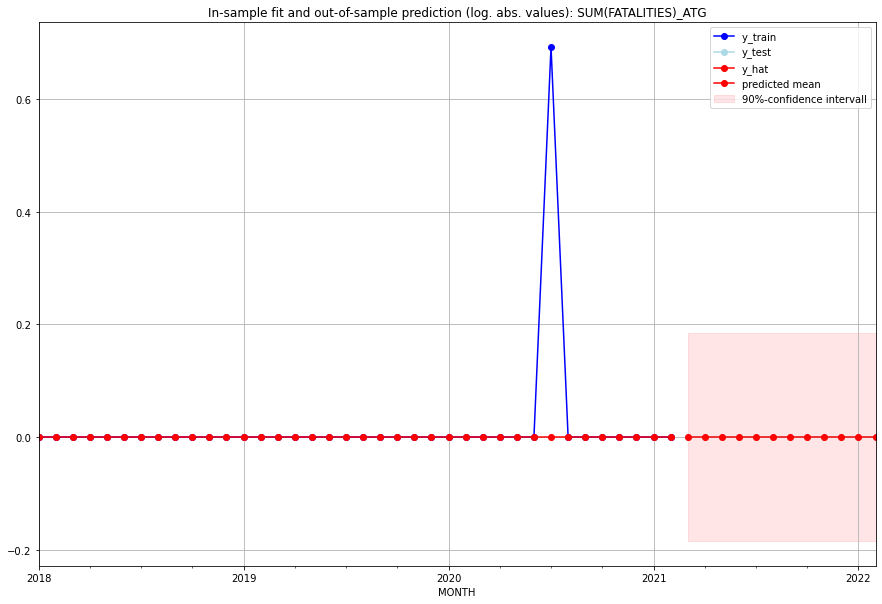

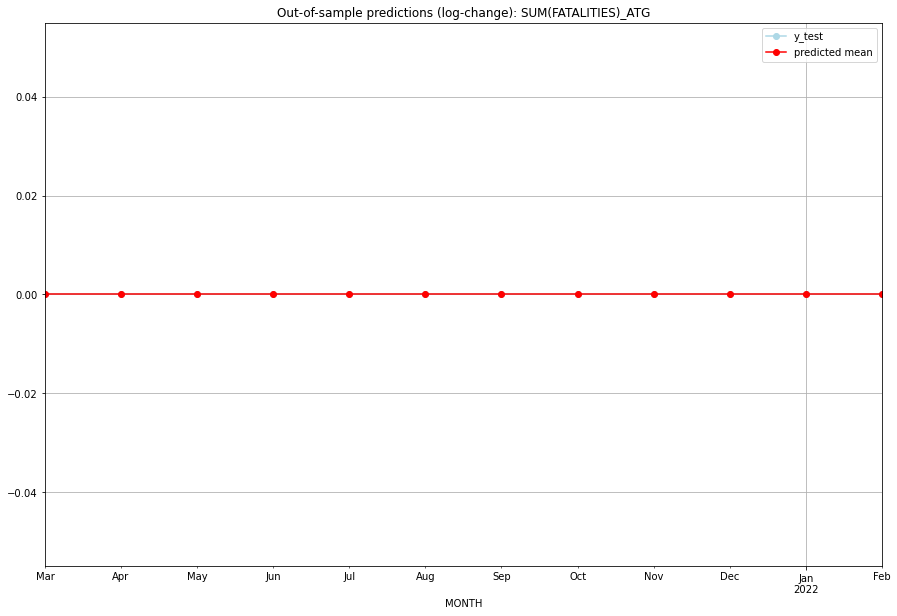

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ATG   
1  2021-04-01       0.0         0.0           0.0             0.0   ATG   
2  2021-05-01       0.0         0.0           0.0             0.0   ATG   
3  2021-06-01       0.0         0.0           0.0             0.0   ATG   
4  2021-07-01       0.0         0.0           0.0             0.0   ATG   
5  2021-08-01       0.0         0.0           0.0             0.0   ATG   
6  2021-09-01       0.0         0.0           0.0             0.0   ATG   
7  2021-10-01       0.0         0.0           0.0             0.0   ATG   
8  2021-11-01       0.0         0.0           0.0             0.0   ATG   
9  2021-12-01       0.0         0.0           0.0             0.0   ATG   
10 2022-01-01       0.0         0.0           0.0             0.0   ATG   
11 2022-02-01       0.0         0.0           0.0             0.0   

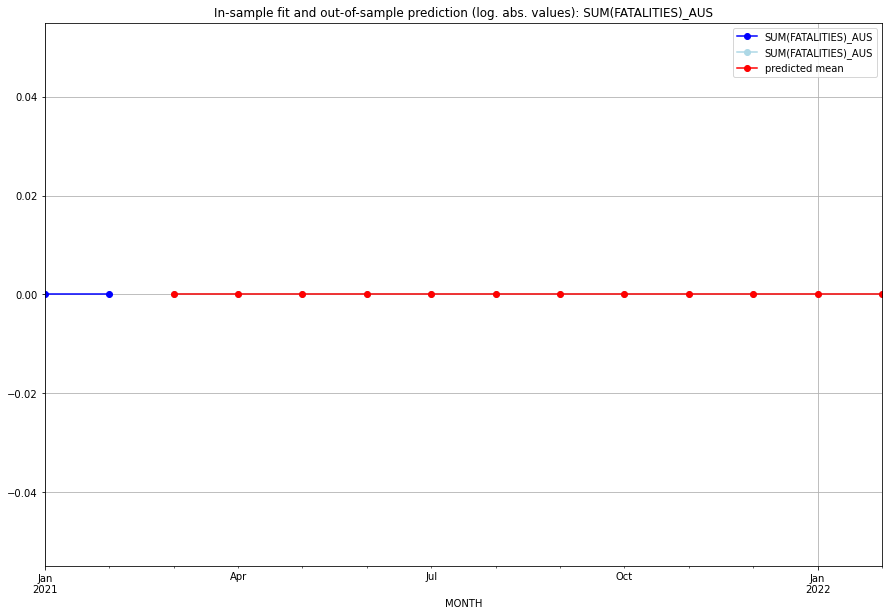

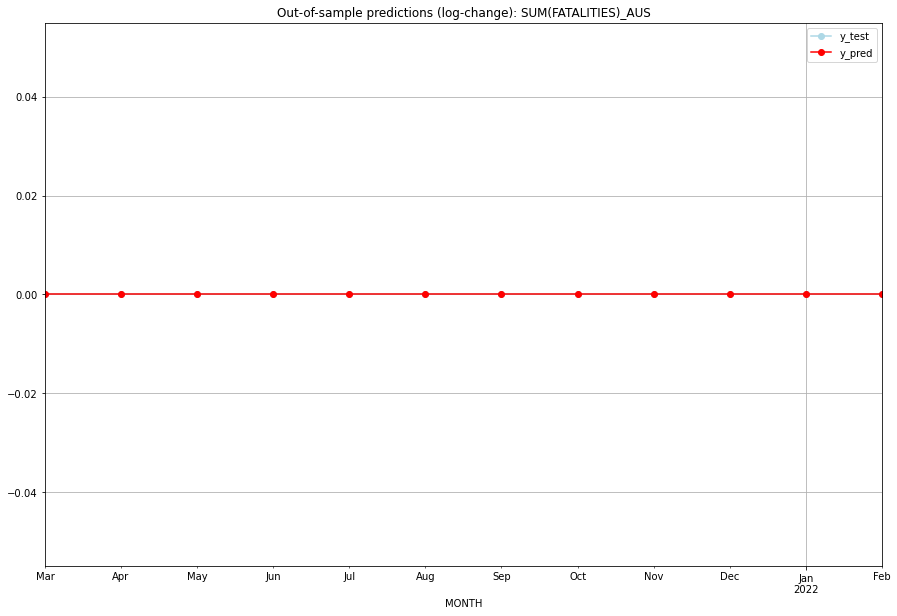

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   AUS   
1  2021-04-01       0.0         0.0           0.0             0.0   AUS   
2  2021-05-01       0.0         0.0           0.0             0.0   AUS   
3  2021-06-01       0.0         0.0           0.0             0.0   AUS   
4  2021-07-01       0.0         0.0           0.0             0.0   AUS   
5  2021-08-01       0.0         0.0           0.0             0.0   AUS   
6  2021-09-01       0.0         0.0           0.0             0.0   AUS   
7  2021-10-01       0.0         0.0           0.0             0.0   AUS   
8  2021-11-01       0.0         0.0           0.0             0.0   AUS   
9  2021-12-01       0.0         0.0           0.0             0.0   AUS   
10 2022-01-01       0.0         0.0           0.0             0.0   AUS   
11 2022-02-01       0.0         0.0           0.0             0.0   

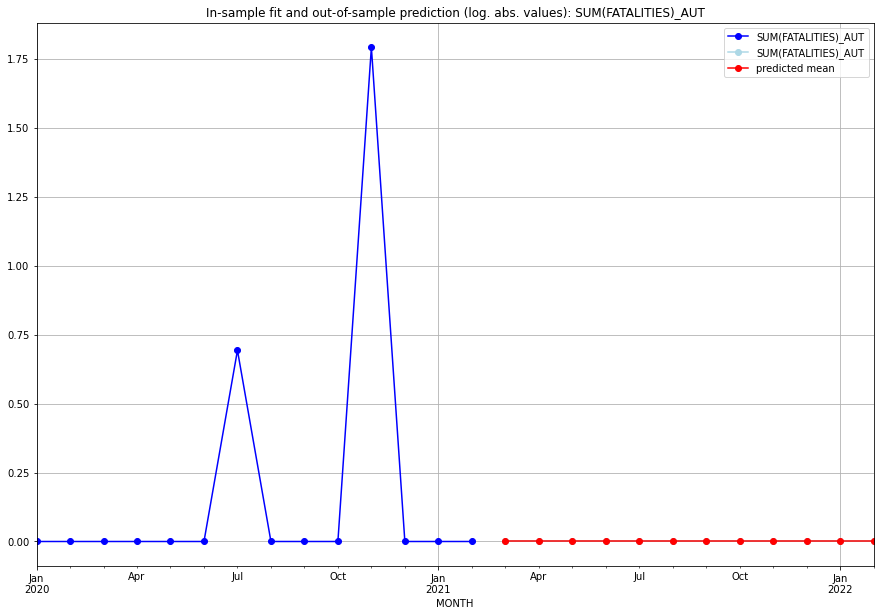

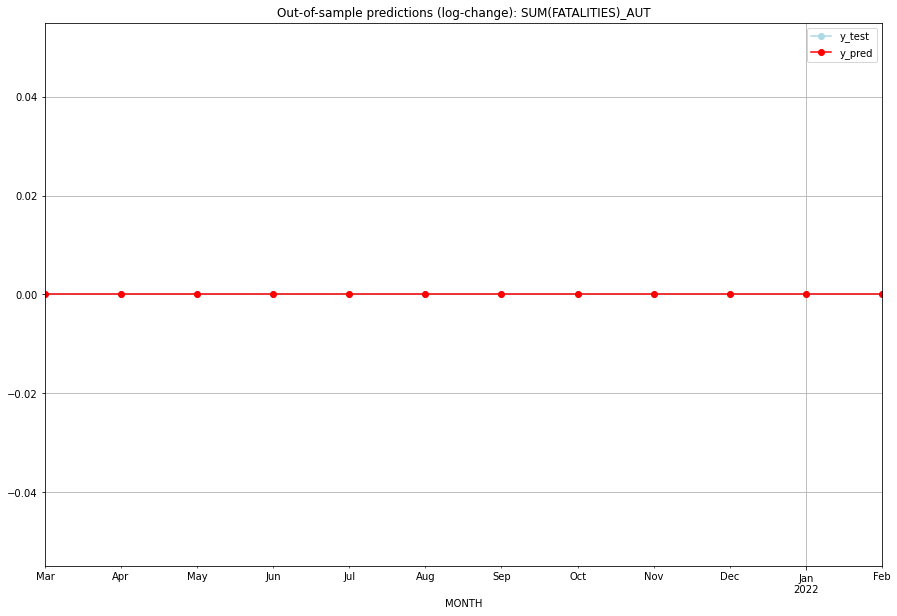

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   AUT   
1  2021-04-01       0.0         0.0           0.0             0.0   AUT   
2  2021-05-01       0.0         0.0           0.0             0.0   AUT   
3  2021-06-01       0.0         0.0           0.0             0.0   AUT   
4  2021-07-01       0.0         0.0           0.0             0.0   AUT   
5  2021-08-01       0.0         0.0           0.0             0.0   AUT   
6  2021-09-01       0.0         0.0           0.0             0.0   AUT   
7  2021-10-01       0.0         0.0           0.0             0.0   AUT   
8  2021-11-01       0.0         0.0           0.0             0.0   AUT   
9  2021-12-01       0.0         0.0           0.0             0.0   AUT   
10 2022-01-01       0.0         0.0           0.0             0.0   AUT   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 1.5091568945733196, 'fold_results': [0.6691736745222969, 2.3491401146243422]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_AZE   No. Observations:                   38
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -68.826
Date:                 Wed, 19 Oct 2022   AIC                            141.653
Time:                         10:25:15   BIC                            144.875
Sample:                     01-31-2018   HQIC                           142.789
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.2236      0.

<Figure size 432x288 with 0 Axes>

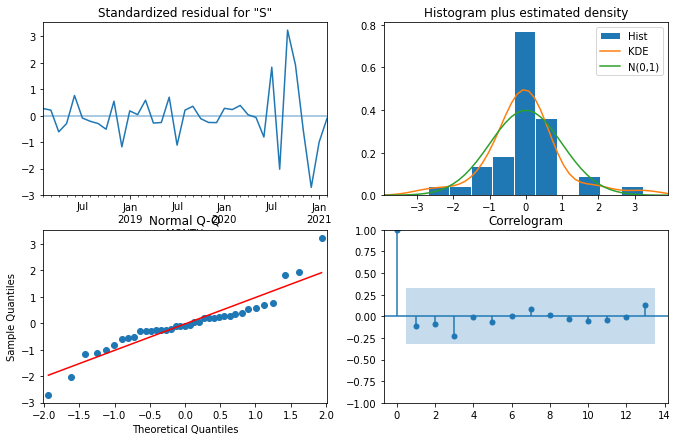

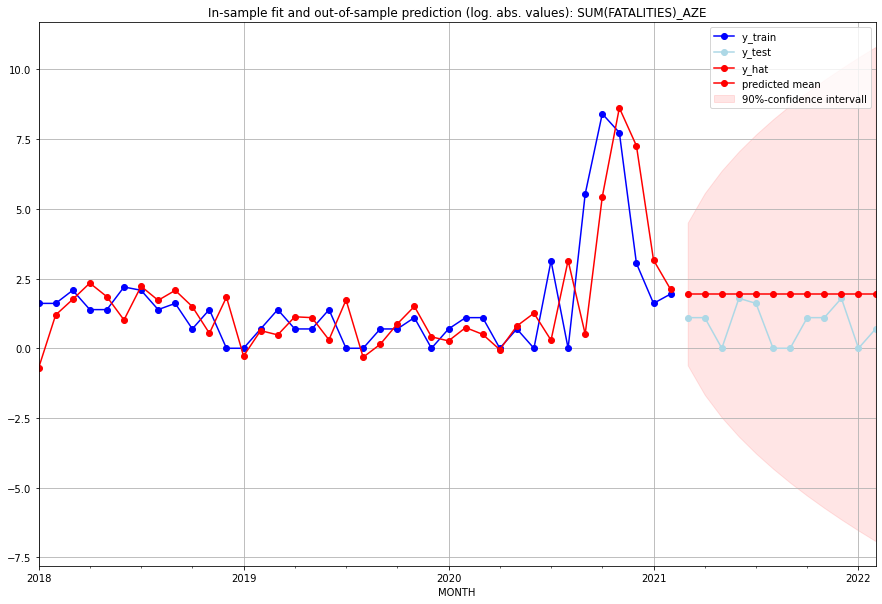

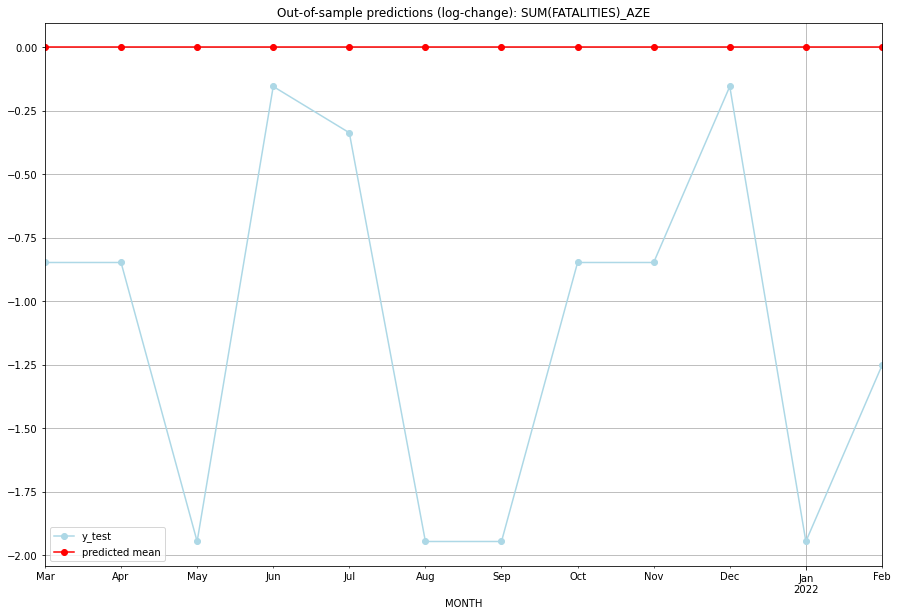

TADDA: 1.0891973835450963
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       6.0         2.0 -2.220446e-16       -0.847298   AZE   
1  2021-04-01       6.0         2.0 -2.220446e-16       -0.847298   AZE   
2  2021-05-01       6.0         0.0 -2.220446e-16       -1.945910   AZE   
3  2021-06-01       6.0         5.0 -2.220446e-16       -0.154151   AZE   
4  2021-07-01       6.0         4.0 -2.220446e-16       -0.336472   AZE   
5  2021-08-01       6.0         0.0 -2.220446e-16       -1.945910   AZE   
6  2021-09-01       6.0         0.0 -2.220446e-16       -1.945910   AZE   
7  2021-10-01       6.0         2.0 -2.220446e-16       -0.847298   AZE   
8  2021-11-01       6.0         2.0 -2.220446e-16       -0.847298   AZE   
9  2021-12-01       6.0         5.0 -2.220446e-16       -0.154151   AZE   
10 2022-01-01       6.0         0.0 -2.220446e-16       -1.945910   AZE   
11 2022-02-01       6.0         1.0 -2.220446e-16    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.5881974913700214, 'fold_results': [0.9236198396478242, 0.23911787140868646, 0.6618819255496723, 0.5445745289572174, 0.5717932912867064]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BDI   No. Observations:                  289
Model:                SARIMAX(1, 0, 2)   Log Likelihood                -426.164
Date:                 Wed, 19 Oct 2022   AIC                            862.329
Time:                         10:25:39   BIC                            880.661
Sample:                     02-28-1997   HQIC                           869.674
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

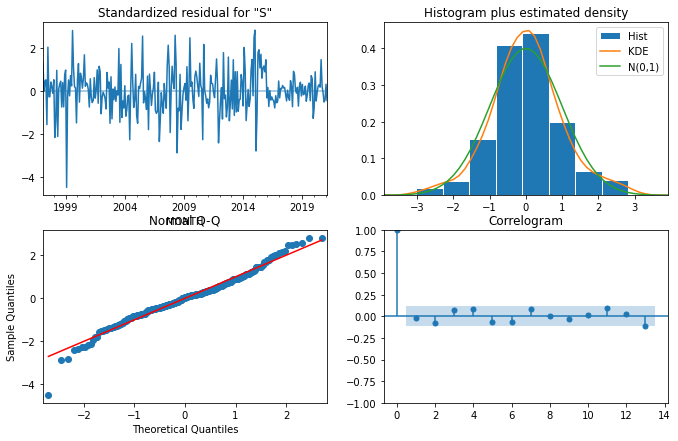

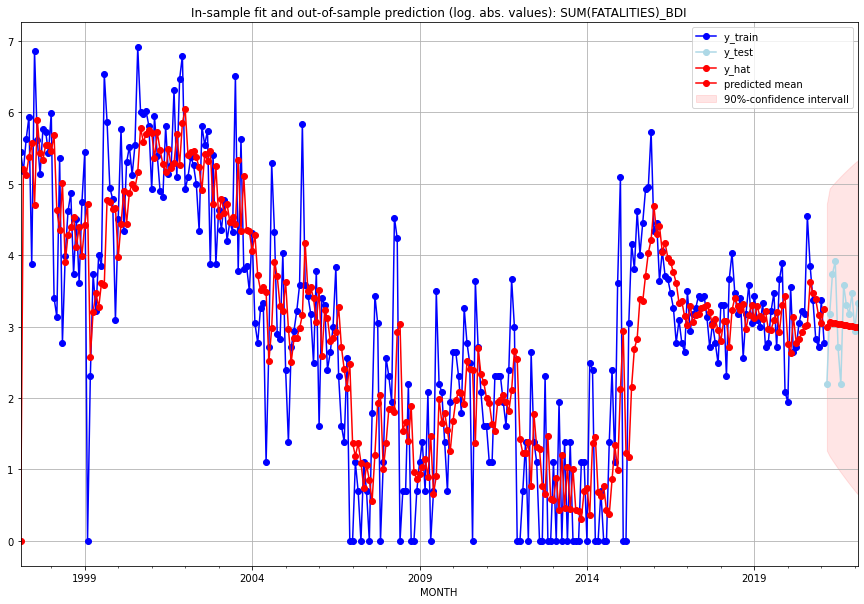

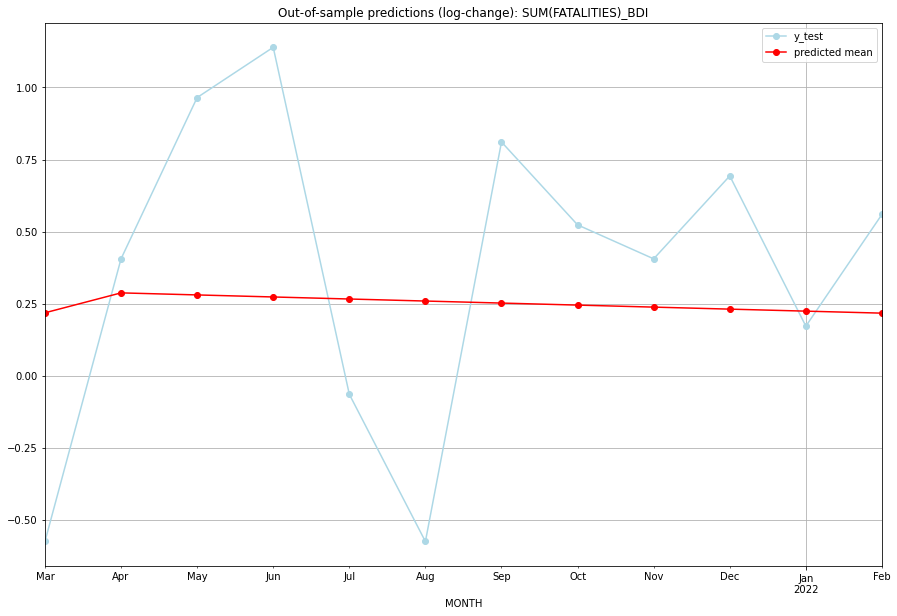

TADDA: 0.5194073530170585
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  18.901607         8.0      0.218212       -0.575364   BDI   
1  2021-04-01  20.325604        23.0      0.287320        0.405465   BDI   
2  2021-05-01  20.174589        41.0      0.280213        0.965081   BDI   
3  2021-06-01  20.024992        49.0      0.273123        1.139434   BDI   
4  2021-07-01  19.876795        14.0      0.266050       -0.064539   BDI   
5  2021-08-01  19.729983         8.0      0.258992       -0.575364   BDI   
6  2021-09-01  19.584542        35.0      0.251952        0.810930   BDI   
7  2021-10-01  19.440455        26.0      0.244927        0.523248   BDI   
8  2021-11-01  19.297709        23.0      0.237919        0.405465   BDI   
9  2021-12-01  19.156287        31.0      0.230928        0.693147   BDI   
10 2022-01-01  19.016176        18.0      0.223952        0.171850   BDI   
11 2022-02-01  18.877361        27.0     

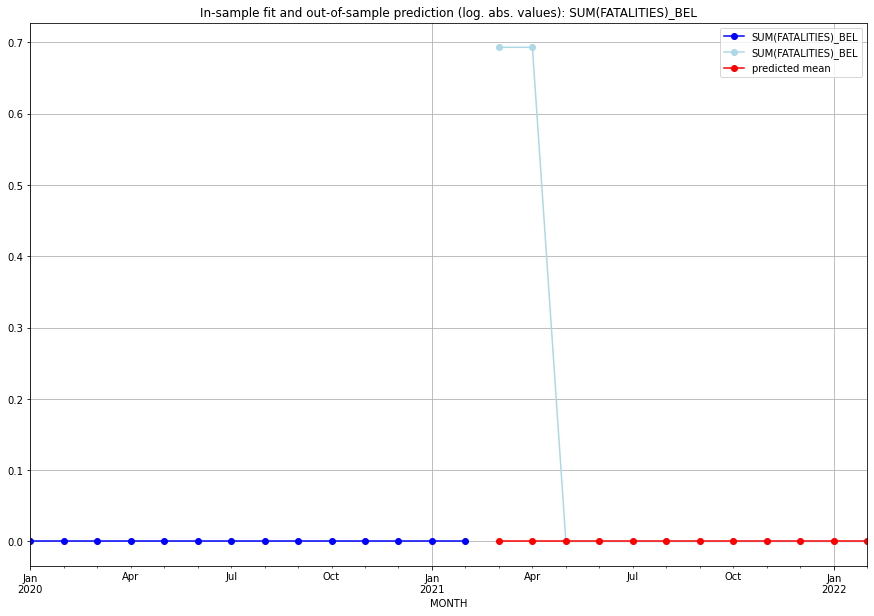

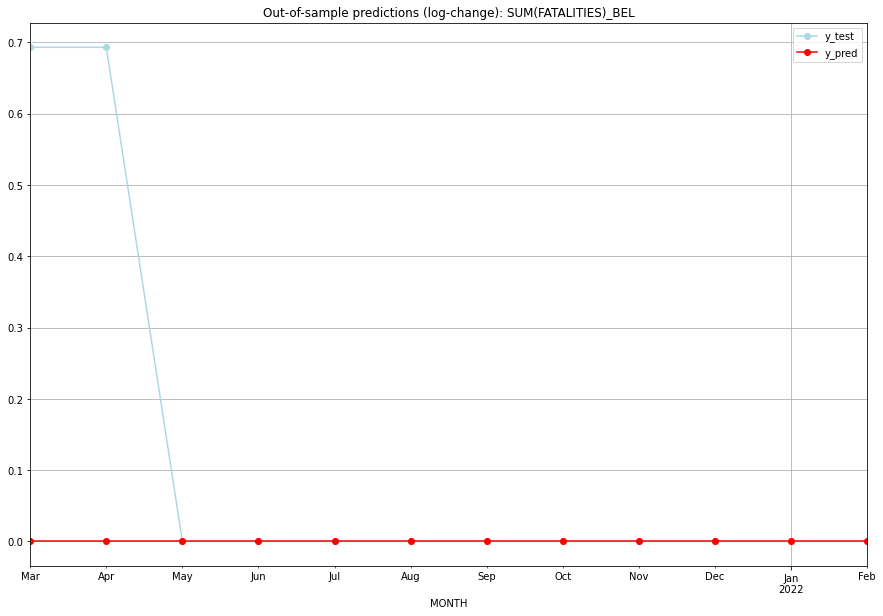

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.693147           0.0        0.693147   BEL   
1  2021-04-01       0.0    0.693147           0.0        0.693147   BEL   
2  2021-05-01       0.0    0.000000           0.0        0.000000   BEL   
3  2021-06-01       0.0    0.000000           0.0        0.000000   BEL   
4  2021-07-01       0.0    0.000000           0.0        0.000000   BEL   
5  2021-08-01       0.0    0.000000           0.0        0.000000   BEL   
6  2021-09-01       0.0    0.000000           0.0        0.000000   BEL   
7  2021-10-01       0.0    0.000000           0.0        0.000000   BEL   
8  2021-11-01       0.0    0.000000           0.0        0.000000   BEL   
9  2021-12-01       0.0    0.000000           0.0        0.000000   BEL   
10 2022-01-01       0.0    0.000000           0.0        0.000000   BEL   
11 2022-02-01       0.0    0.000000           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.8713248877162634, 'fold_results': [0.9478645590717948, 0.5128760921305816, 0.8630918524645791, 1.0058852504226843, 1.0269066844916772]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BEN   No. Observations:                  289
Model:                SARIMAX(1, 0, 1)   Log Likelihood                -183.416
Date:                 Wed, 19 Oct 2022   AIC                            378.832
Time:                         10:26:17   BIC                            400.830
Sample:                     02-28-1997   HQIC                           387.646
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

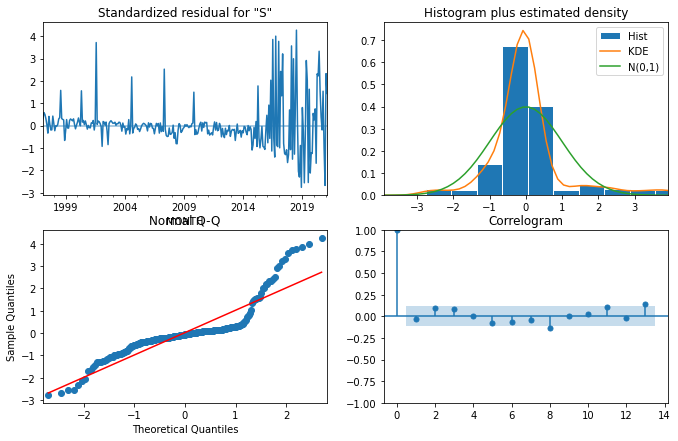

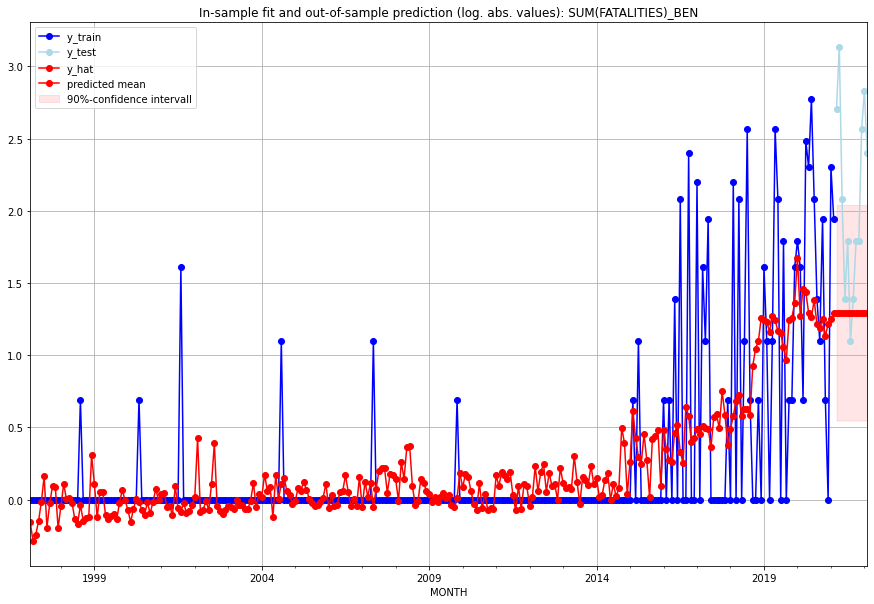

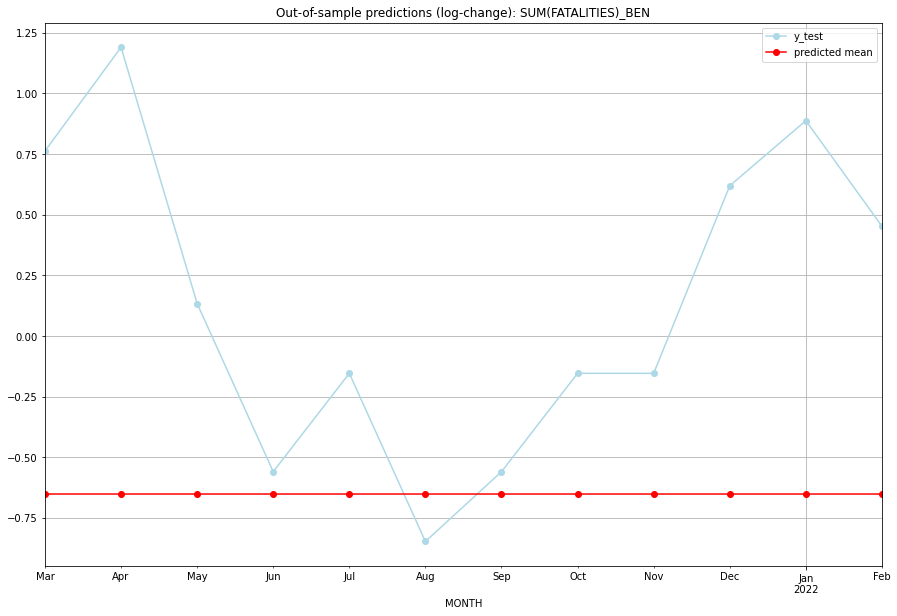

TADDA: 1.1446289267327736
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.648330        14.0     -0.651641        0.762140   BEN   
1  2021-04-01  2.648326        22.0     -0.651642        1.189584   BEN   
2  2021-05-01  2.648322         7.0     -0.651643        0.133531   BEN   
3  2021-06-01  2.648318         3.0     -0.651644       -0.559616   BEN   
4  2021-07-01  2.648314         5.0     -0.651645       -0.154151   BEN   
5  2021-08-01  2.648310         2.0     -0.651646       -0.847298   BEN   
6  2021-09-01  2.648305         3.0     -0.651647       -0.559616   BEN   
7  2021-10-01  2.648301         5.0     -0.651649       -0.154151   BEN   
8  2021-11-01  2.648297         5.0     -0.651650       -0.154151   BEN   
9  2021-12-01  2.648293        12.0     -0.651651        0.619039   BEN   
10 2022-01-01  2.648289        16.0     -0.651652        0.887303   BEN   
11 2022-02-01  2.648285        10.0     -0.651653    

<Figure size 432x288 with 0 Axes>

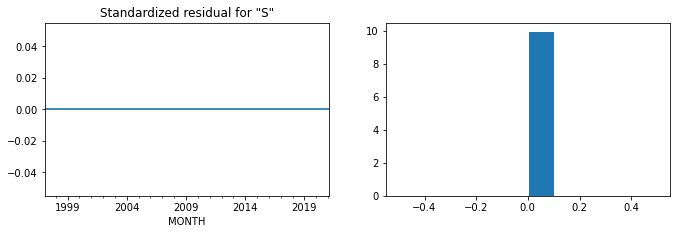

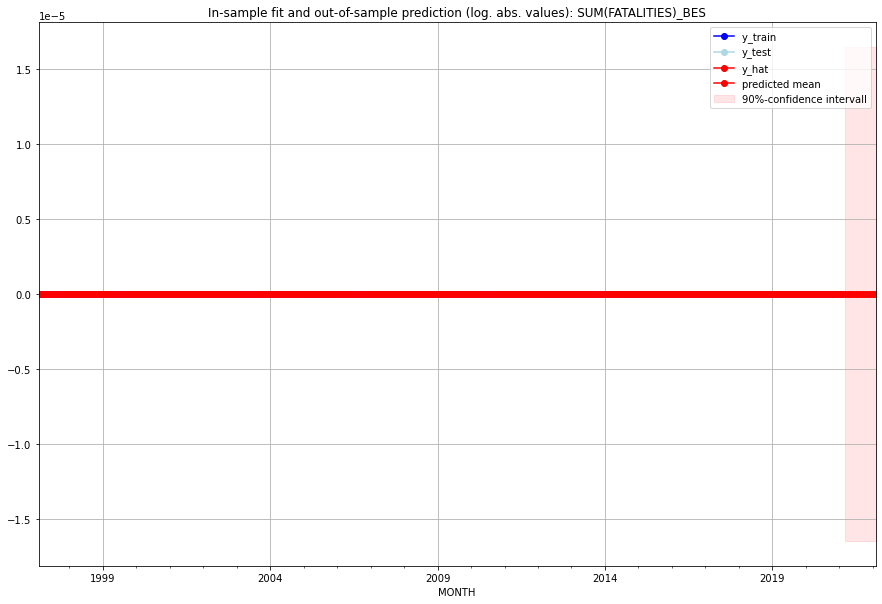

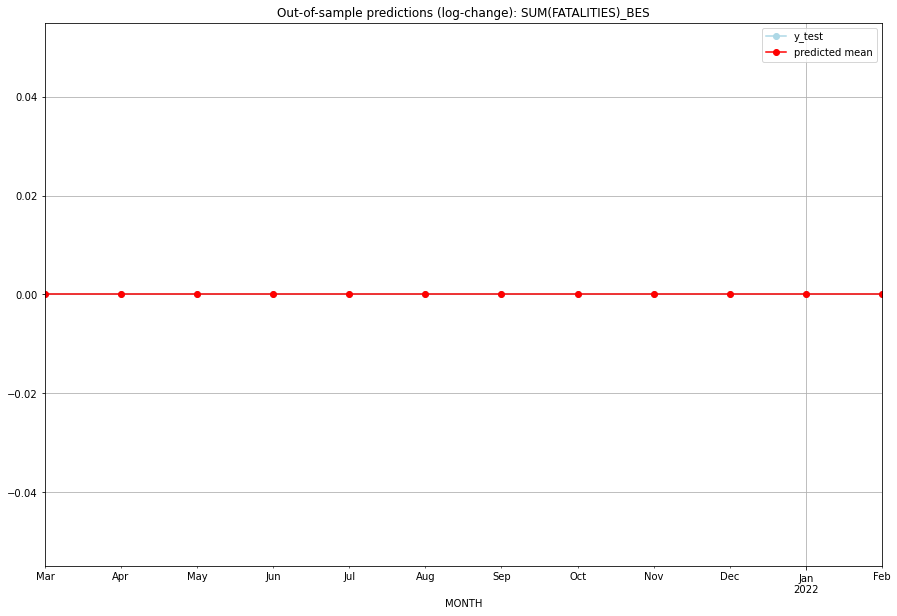

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   BES   
1  2021-04-01       0.0         0.0           0.0             0.0   BES   
2  2021-05-01       0.0         0.0           0.0             0.0   BES   
3  2021-06-01       0.0         0.0           0.0             0.0   BES   
4  2021-07-01       0.0         0.0           0.0             0.0   BES   
5  2021-08-01       0.0         0.0           0.0             0.0   BES   
6  2021-09-01       0.0         0.0           0.0             0.0   BES   
7  2021-10-01       0.0         0.0           0.0             0.0   BES   
8  2021-11-01       0.0         0.0           0.0             0.0   BES   
9  2021-12-01       0.0         0.0           0.0             0.0   BES   
10 2022-01-01       0.0         0.0           0.0             0.0   BES   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.8707530449529678, 'fold_results': [0.8149737992149452, 0.7292070153962626, 1.3892492670536392, 0.7057665666899492, 0.7145685764100431]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BFA   No. Observations:                  289
Model:                SARIMAX(3, 1, 0)   Log Likelihood                -322.405
Date:                 Wed, 19 Oct 2022   AIC                            658.809
Time:                         10:27:03   BIC                            684.450
Sample:                     02-28-1997   HQIC                           669.085
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

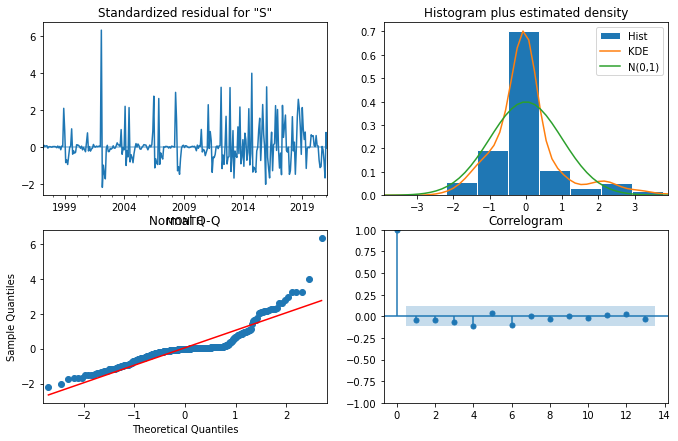

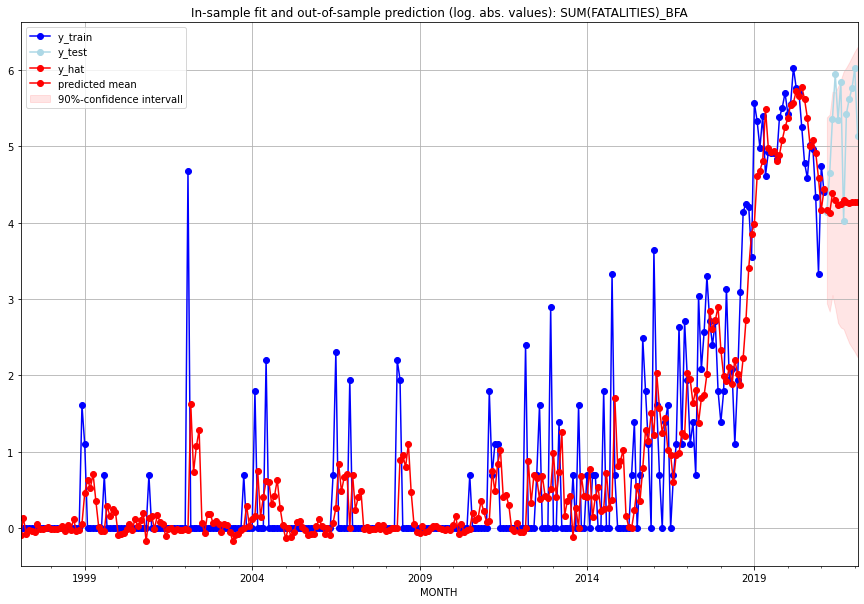

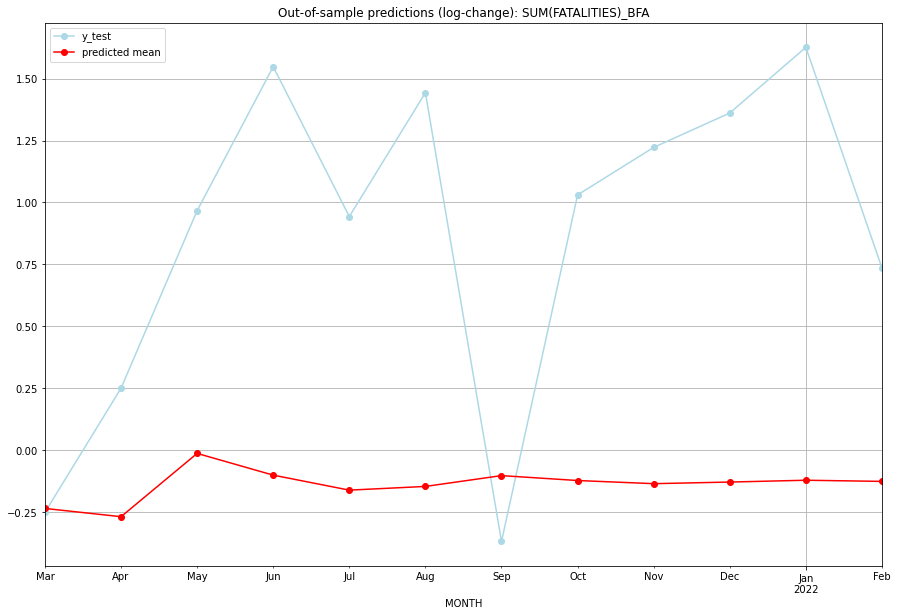

TADDA: 1.1720467273226556
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  62.995587        62.0     -0.235635       -0.251314   BFA   
1  2021-04-01  60.897885       103.0     -0.268963        0.249942   BFA   
2  2021-05-01  78.922500       212.0     -0.013392        0.966843   BFA   
3  2021-06-01  72.210842       380.0     -0.101106        1.548350   BFA   
4  2021-07-01  67.904760       207.0     -0.161724        0.943089   BFA   
5  2021-08-01  68.945992       342.0     -0.146726        1.443281   BFA   
6  2021-09-01  72.069278        55.0     -0.103041       -0.369097   BFA   
7  2021-10-01  70.633931       226.0     -0.122880        1.030501   BFA   
8  2021-11-01  69.728980       274.0     -0.135594        1.222322   BFA   
9  2021-12-01  70.190741       315.0     -0.129086        1.361293   BFA   
10 2022-01-01  70.715818       411.0     -0.121738        1.626574   BFA   
11 2022-02-01  70.383551       168.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.49533403986824903, 'fold_results': [0.6213178659029946, 0.5365676725175251, 0.8015974778422265, 0.3212146064665598, 0.19597257661193876]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BGD   No. Observations:                  134
Model:                SARIMAX(2, 0, 1)   Log Likelihood                 -95.038
Date:                 Wed, 19 Oct 2022   AIC                            200.077
Time:                         10:27:23   BIC                            214.566
Sample:                     01-31-2010   HQIC                           205.965
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

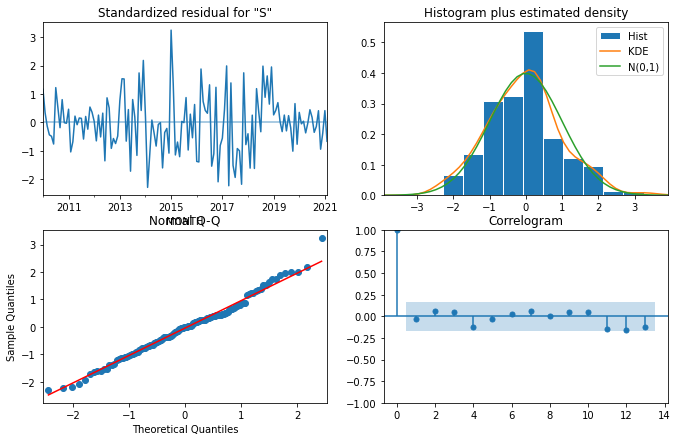

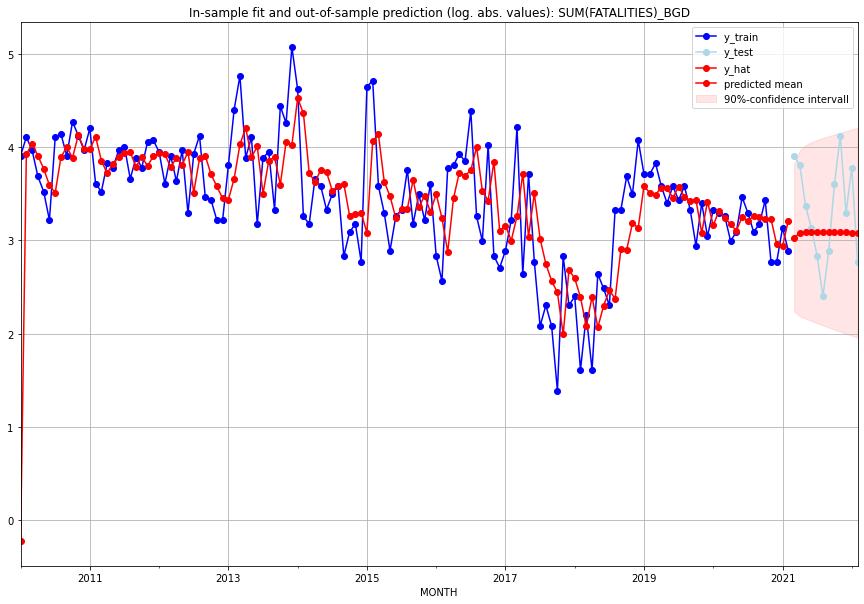

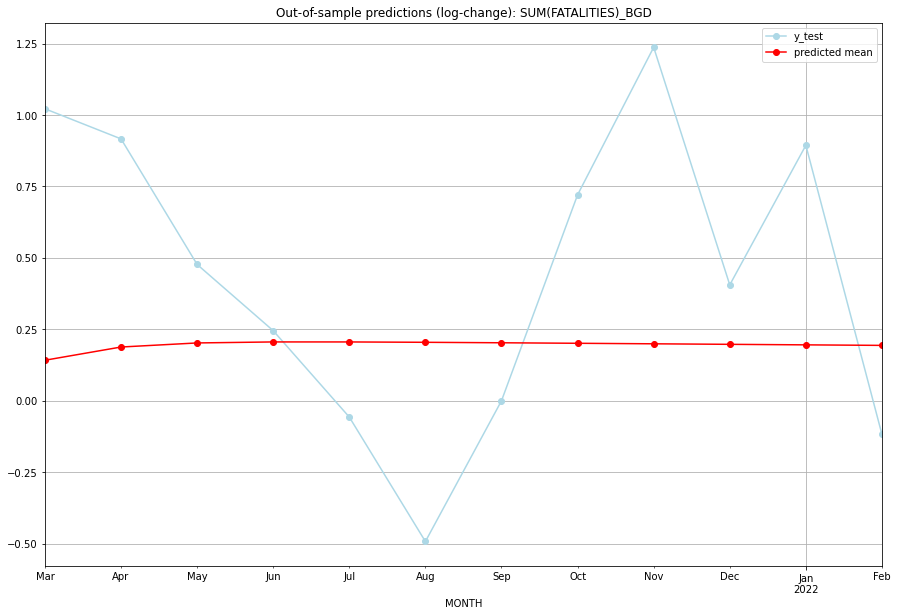

TADDA: 0.5386431801531525
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  19.741284        49.0      0.141754        1.021651   BGD   
1  2021-04-01  20.723179        44.0      0.188008        0.916291   BGD   
2  2021-05-01  21.035199        28.0      0.202269        0.476924   BGD   
3  2021-06-01  21.113440        22.0      0.205814        0.245122   BGD   
4  2021-07-01  21.112445        16.0      0.205769       -0.057158   BGD   
5  2021-08-01  21.084895        10.0      0.204522       -0.492476   BGD   
6  2021-09-01  21.048519        17.0      0.202874        0.000000   BGD   
7  2021-10-01  21.009258        36.0      0.201091        0.720546   BGD   
8  2021-11-01  20.969100        61.0      0.199265        1.236763   BGD   
9  2021-12-01  20.928710        26.0      0.197425        0.405465   BGD   
10 2022-01-01  20.888308        43.0      0.195581        0.893818   BGD   
11 2022-02-01  20.847970        15.0     

<Figure size 432x288 with 0 Axes>

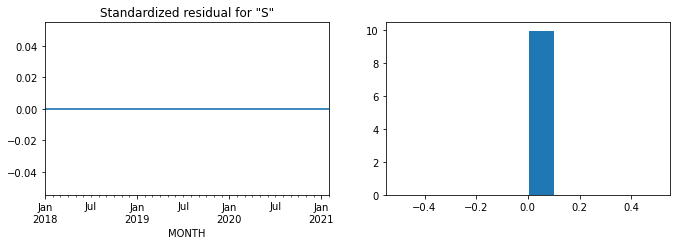

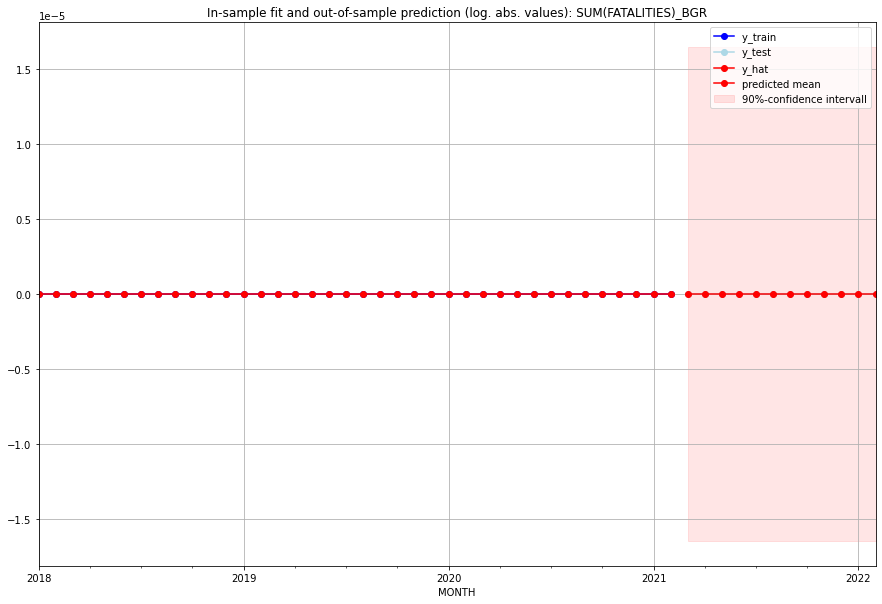

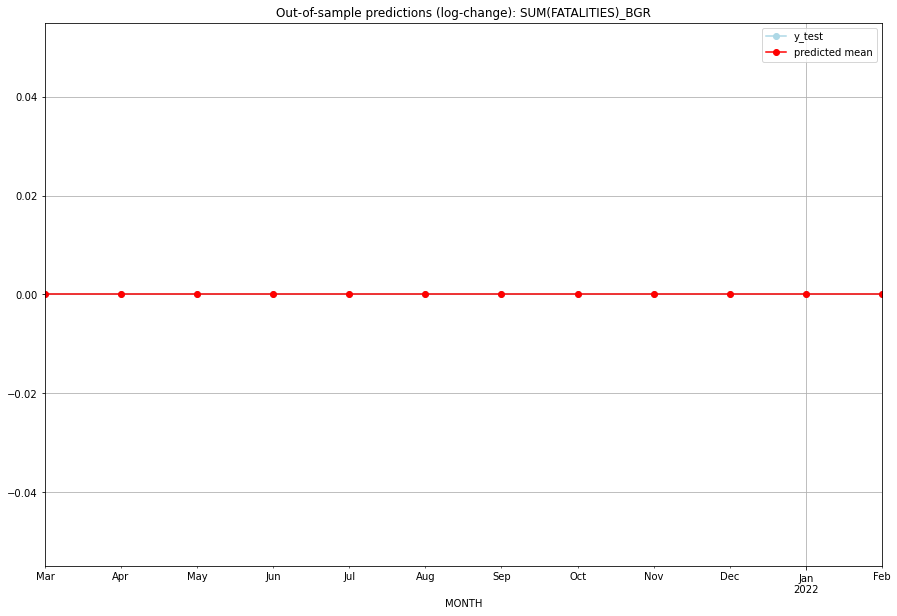

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   BGR   
1  2021-04-01       0.0         0.0           0.0             0.0   BGR   
2  2021-05-01       0.0         0.0           0.0             0.0   BGR   
3  2021-06-01       0.0         0.0           0.0             0.0   BGR   
4  2021-07-01       0.0         0.0           0.0             0.0   BGR   
5  2021-08-01       0.0         0.0           0.0             0.0   BGR   
6  2021-09-01       0.0         0.0           0.0             0.0   BGR   
7  2021-10-01       0.0         0.0           0.0             0.0   BGR   
8  2021-11-01       0.0         0.0           0.0             0.0   BGR   
9  2021-12-01       0.0         0.0           0.0             0.0   BGR   
10 2022-01-01       0.0         0.0           0.0             0.0   BGR   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.045605728717131665, 'fold_results': [nan, 0.027183390442787517, 0.06137839543614304, 0.04825540027246444]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BHR   No. Observations:                   62
Model:                SARIMAX(3, 1, 3)   Log Likelihood                 -23.248
Date:                 Wed, 19 Oct 2022   AIC                             64.496
Time:                         10:27:53   BIC                             83.494
Sample:                     01-31-2016   HQIC                            71.941
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

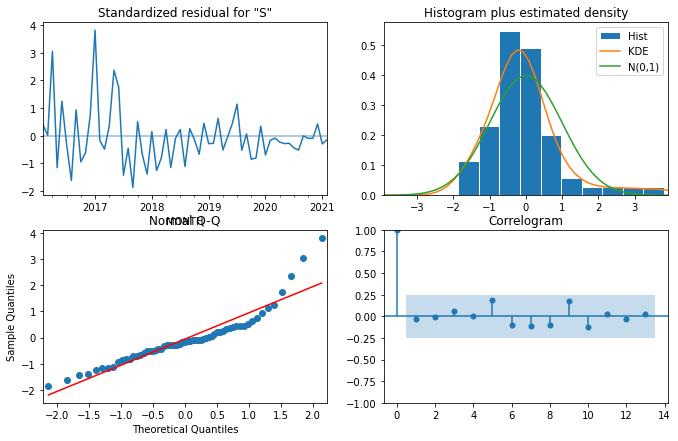

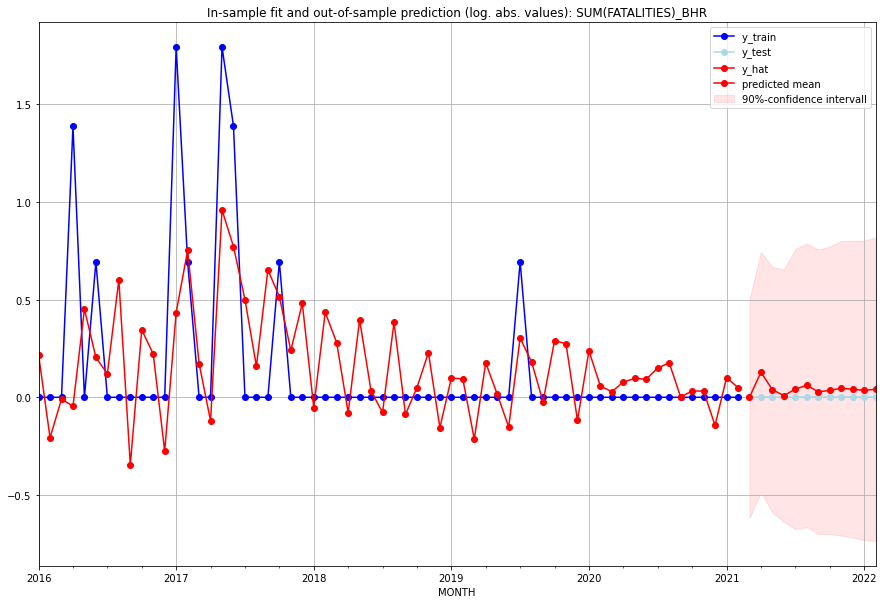

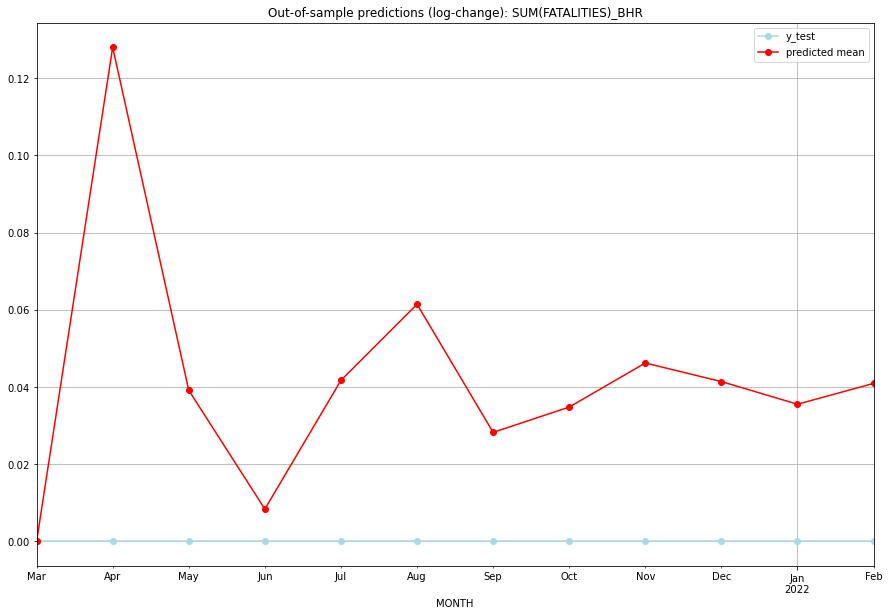

TADDA: 0.04216383929335082
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.000000         0.0      0.000000             0.0   BHR   
1  2021-04-01  0.136550         0.0      0.127998             0.0   BHR   
2  2021-05-01  0.039935         0.0      0.039158             0.0   BHR   
3  2021-06-01  0.008428         0.0      0.008393             0.0   BHR   
4  2021-07-01  0.042621         0.0      0.041738             0.0   BHR   
5  2021-08-01  0.063380         0.0      0.061453             0.0   BHR   
6  2021-09-01  0.028663         0.0      0.028260             0.0   BHR   
7  2021-10-01  0.035434         0.0      0.034821             0.0   BHR   
8  2021-11-01  0.047317         0.0      0.046232             0.0   BHR   
9  2021-12-01  0.042284         0.0      0.041415             0.0   BHR   
10 2022-01-01  0.036190         0.0      0.035550             0.0   BHR   
11 2022-02-01  0.041799         0.0      0.040949   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.11552453009332421, 'fold_results': [0.057762265046662105, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BHS   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  -1.457
Date:                 Wed, 19 Oct 2022   AIC                              4.915
Time:                         10:27:58   BIC                              6.552
Sample:                     01-31-2018   HQIC                             5.497
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0632    

<Figure size 432x288 with 0 Axes>

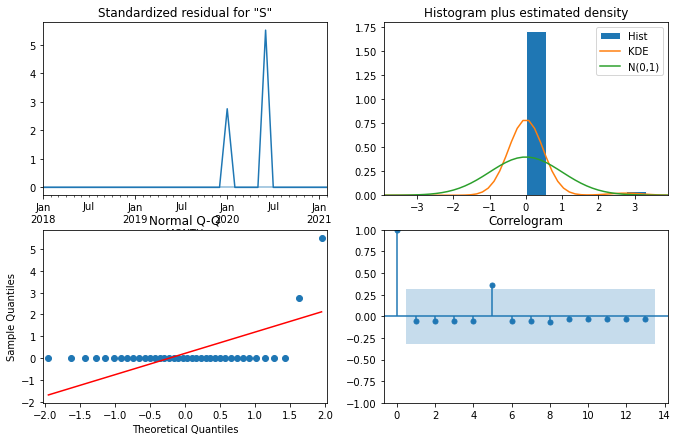

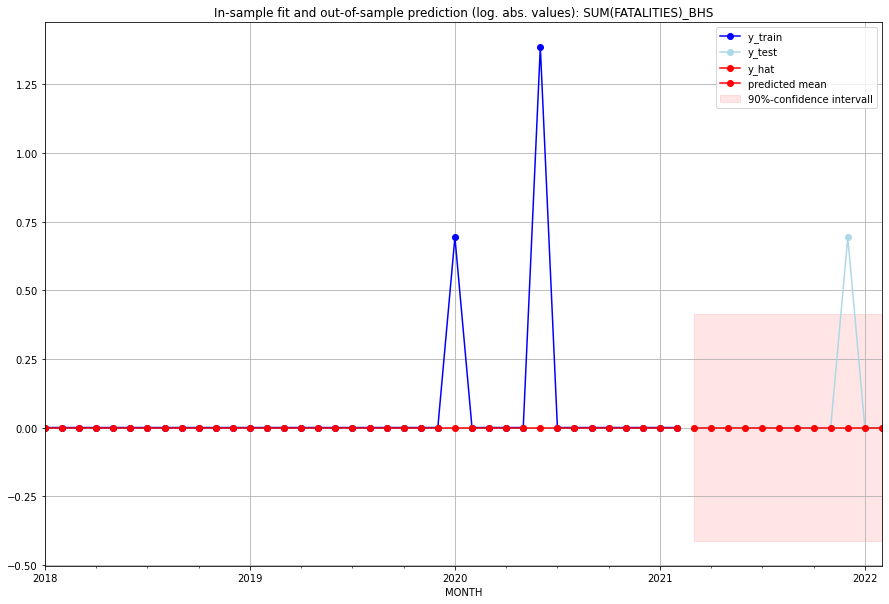

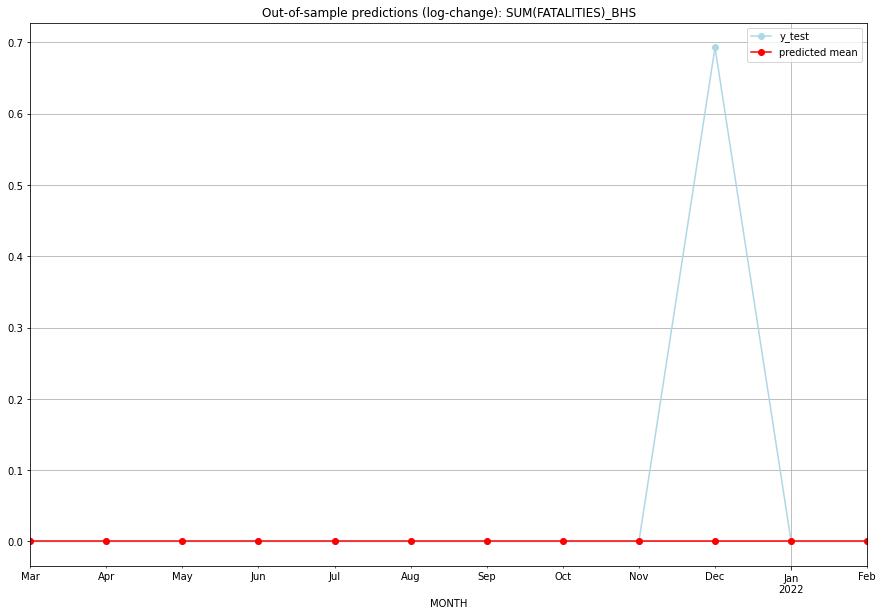

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   BHS   
1  2021-04-01       0.0         0.0           0.0        0.000000   BHS   
2  2021-05-01       0.0         0.0           0.0        0.000000   BHS   
3  2021-06-01       0.0         0.0           0.0        0.000000   BHS   
4  2021-07-01       0.0         0.0           0.0        0.000000   BHS   
5  2021-08-01       0.0         0.0           0.0        0.000000   BHS   
6  2021-09-01       0.0         0.0           0.0        0.000000   BHS   
7  2021-10-01       0.0         0.0           0.0        0.000000   BHS   
8  2021-11-01       0.0         0.0           0.0        0.000000   BHS   
9  2021-12-01       0.0         1.0           0.0        0.693147   BHS   
10 2022-01-01       0.0         0.0           0.0        0.000000   BHS   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.02036308607332716, 'fold_results': [nan, 0.02036308607332716]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BIH   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                  18.932
Date:                 Wed, 19 Oct 2022   AIC                            -23.864
Time:                         10:28:17   BIC                            -12.588
Sample:                     01-31-2018   HQIC                           -19.889
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0087      0.029      0.30

<Figure size 432x288 with 0 Axes>

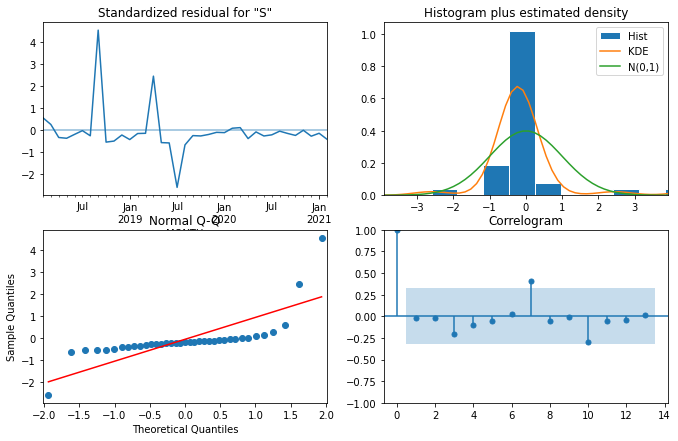

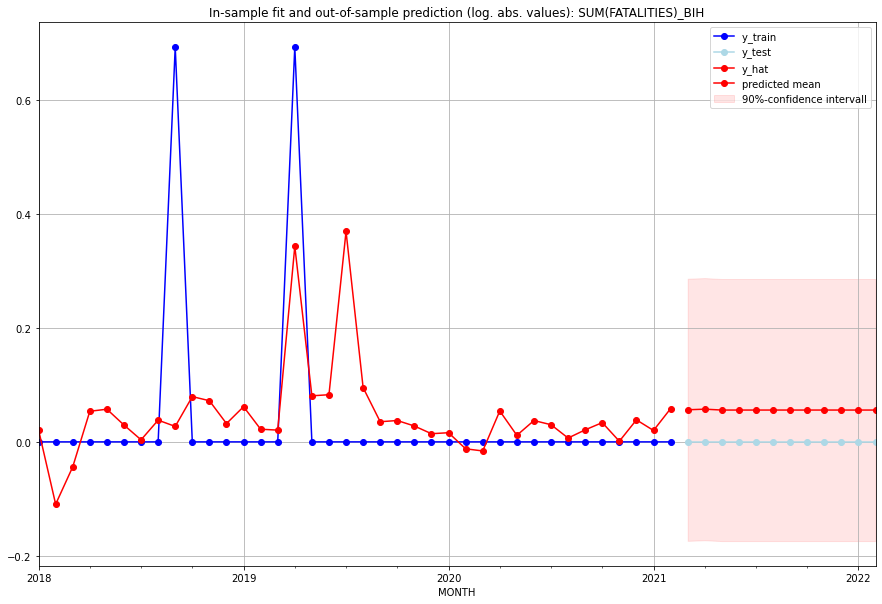

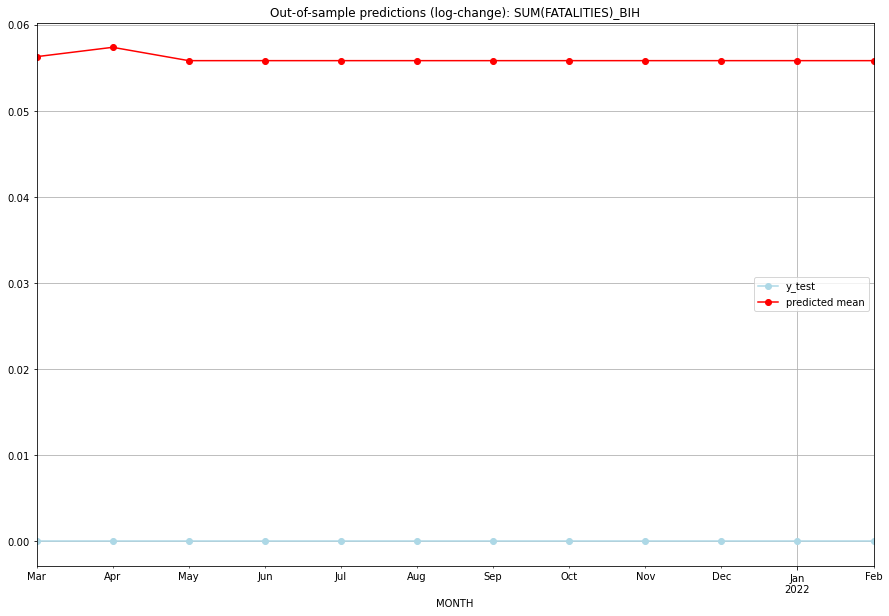

TADDA: 0.05600825333938844
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.057918         0.0      0.056303             0.0   BIH   
1  2021-04-01  0.059069         0.0      0.057390             0.0   BIH   
2  2021-05-01  0.057429         0.0      0.055841             0.0   BIH   
3  2021-06-01  0.057429         0.0      0.055841             0.0   BIH   
4  2021-07-01  0.057429         0.0      0.055841             0.0   BIH   
5  2021-08-01  0.057429         0.0      0.055841             0.0   BIH   
6  2021-09-01  0.057429         0.0      0.055841             0.0   BIH   
7  2021-10-01  0.057429         0.0      0.055841             0.0   BIH   
8  2021-11-01  0.057429         0.0      0.055841             0.0   BIH   
9  2021-12-01  0.057429         0.0      0.055841             0.0   BIH   
10 2022-01-01  0.057429         0.0      0.055841             0.0   BIH   
11 2022-02-01  0.057429         0.0      0.055841   

<Figure size 432x288 with 0 Axes>

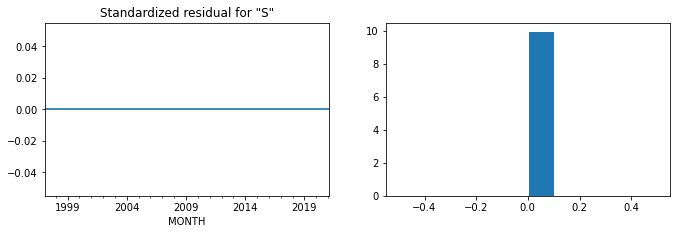

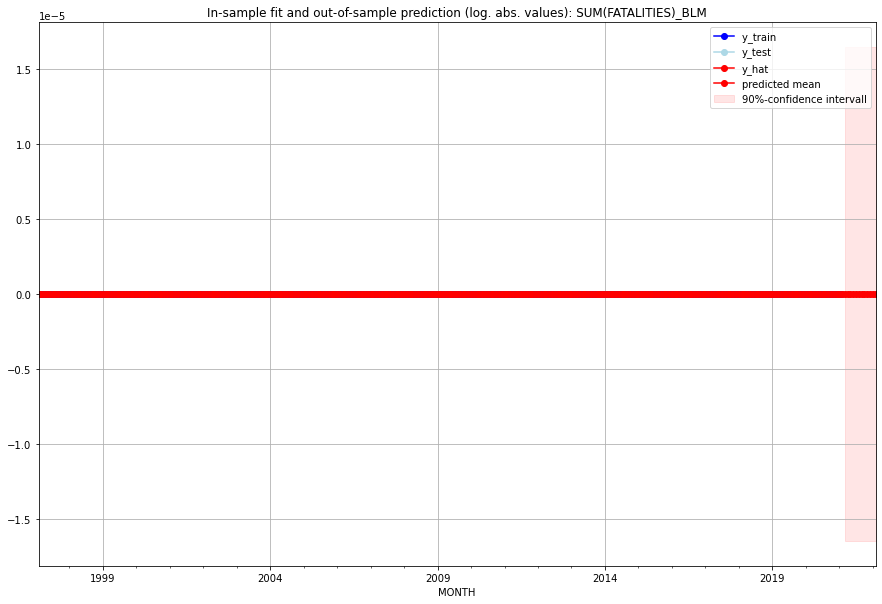

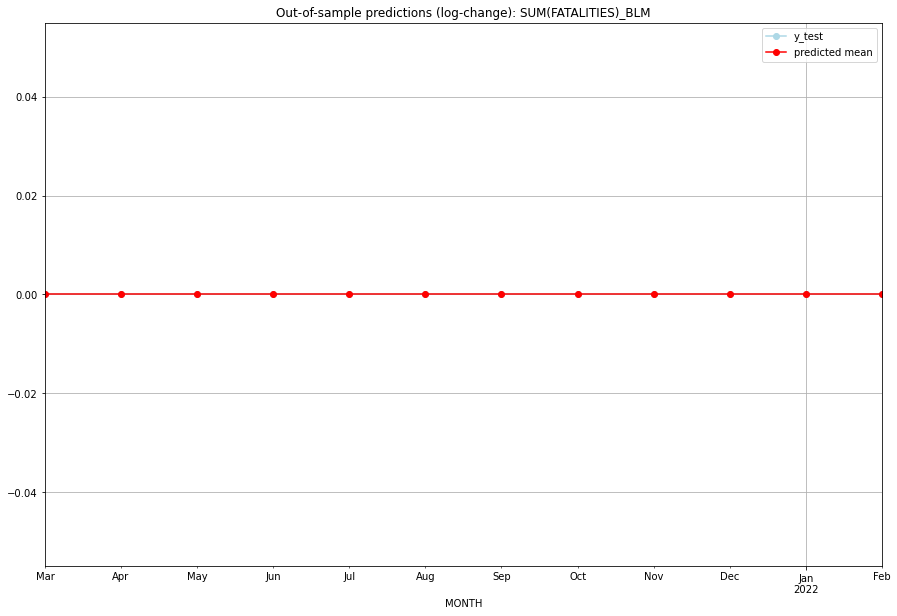

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   BLM   
1  2021-04-01       0.0         0.0           0.0             0.0   BLM   
2  2021-05-01       0.0         0.0           0.0             0.0   BLM   
3  2021-06-01       0.0         0.0           0.0             0.0   BLM   
4  2021-07-01       0.0         0.0           0.0             0.0   BLM   
5  2021-08-01       0.0         0.0           0.0             0.0   BLM   
6  2021-09-01       0.0         0.0           0.0             0.0   BLM   
7  2021-10-01       0.0         0.0           0.0             0.0   BLM   
8  2021-11-01       0.0         0.0           0.0             0.0   BLM   
9  2021-12-01       0.0         0.0           0.0             0.0   BLM   
10 2022-01-01       0.0         0.0           0.0             0.0   BLM   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.12482217806474964, 'fold_results': [0.0, 0.24964435612949928]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BLR   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  -8.884
Date:                 Wed, 19 Oct 2022   AIC                             19.768
Time:                         10:28:34   BIC                             21.405
Sample:                     01-31-2018   HQIC                            20.351
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0935      0.007     13.99

<Figure size 432x288 with 0 Axes>

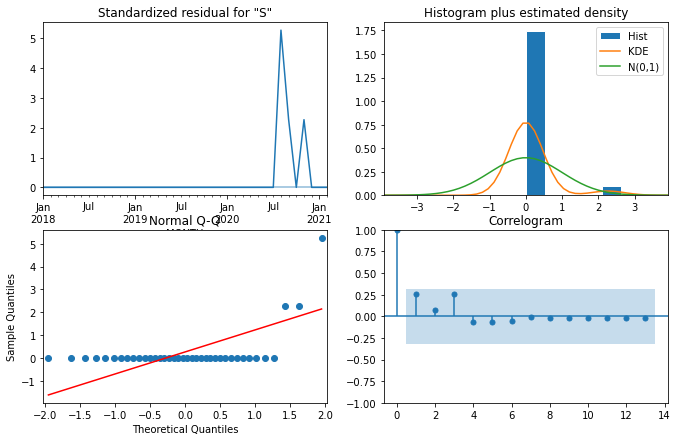

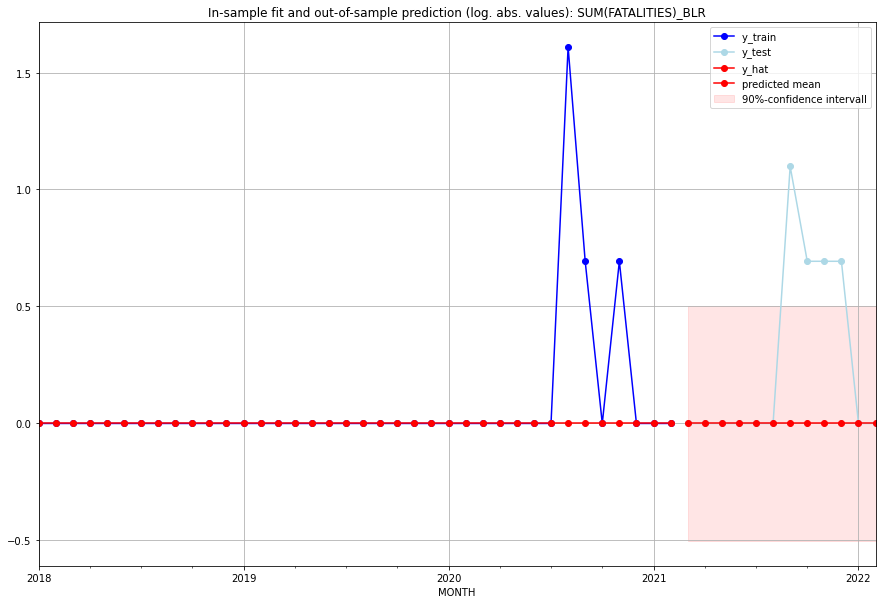

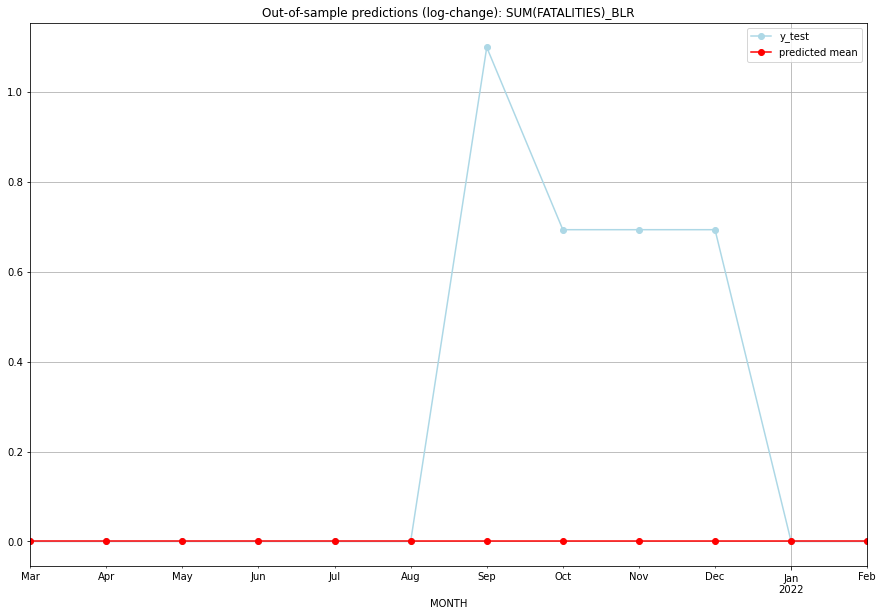

TADDA: 0.2648378191956621
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   BLR   
1  2021-04-01       0.0         0.0           0.0        0.000000   BLR   
2  2021-05-01       0.0         0.0           0.0        0.000000   BLR   
3  2021-06-01       0.0         0.0           0.0        0.000000   BLR   
4  2021-07-01       0.0         0.0           0.0        0.000000   BLR   
5  2021-08-01       0.0         0.0           0.0        0.000000   BLR   
6  2021-09-01       0.0         2.0           0.0        1.098612   BLR   
7  2021-10-01       0.0         1.0           0.0        0.693147   BLR   
8  2021-11-01       0.0         1.0           0.0        0.693147   BLR   
9  2021-12-01       0.0         1.0           0.0        0.693147   BLR   
10 2022-01-01       0.0         0.0           0.0        0.000000   BLR   
11 2022-02-01       0.0         0.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.5216703318381576, 'fold_results': [nan, 0.5216703318381576]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BLZ   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -32.183
Date:                 Wed, 19 Oct 2022   AIC                             72.367
Time:                         10:28:48   BIC                             78.810
Sample:                     01-31-2018   HQIC                            74.638
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.8622     44.424     -0.019 

<Figure size 432x288 with 0 Axes>

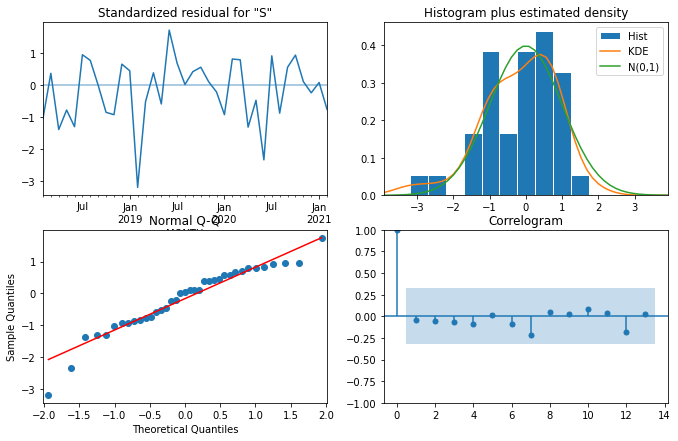

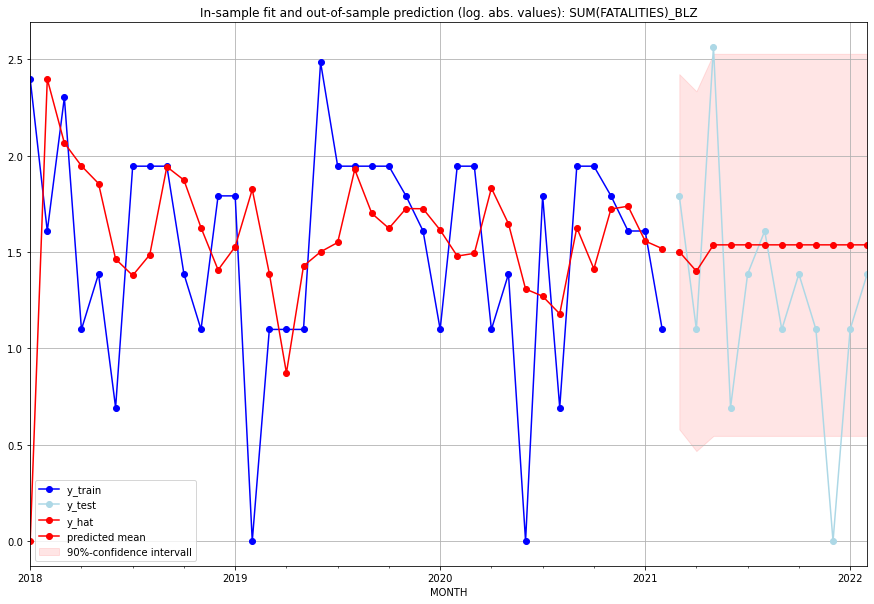

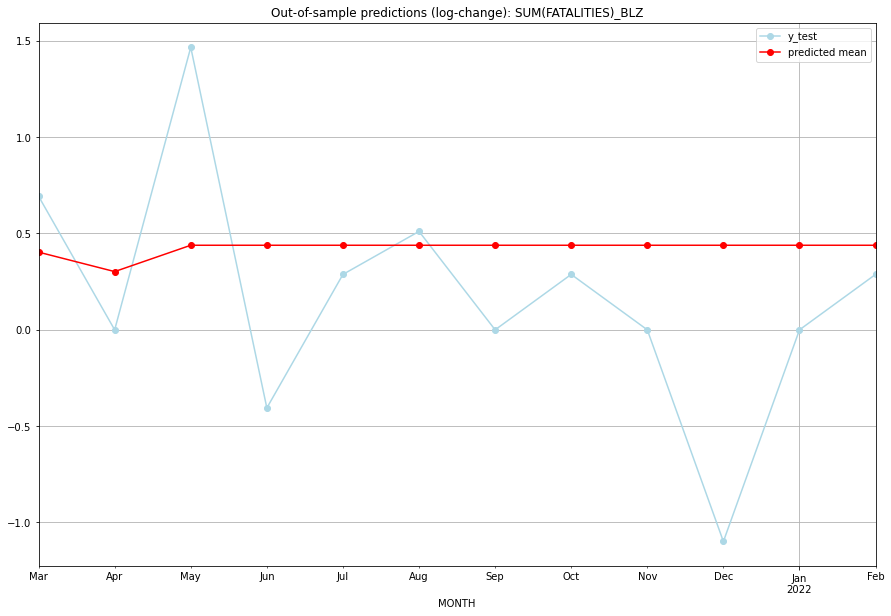

TADDA: 0.5601651283896704
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.489971         5.0      0.403234        0.693147   BLZ   
1  2021-04-01  3.058739         2.0      0.302260        0.000000   BLZ   
2  2021-05-01  3.653242        12.0      0.438952        1.466337   BLZ   
3  2021-06-01  3.653242         1.0      0.438952       -0.405465   BLZ   
4  2021-07-01  3.653242         3.0      0.438952        0.287682   BLZ   
5  2021-08-01  3.653242         4.0      0.438952        0.510826   BLZ   
6  2021-09-01  3.653242         2.0      0.438952        0.000000   BLZ   
7  2021-10-01  3.653242         3.0      0.438952        0.287682   BLZ   
8  2021-11-01  3.653242         2.0      0.438952        0.000000   BLZ   
9  2021-12-01  3.653242         0.0      0.438952       -1.098612   BLZ   
10 2022-01-01  3.653242         2.0      0.438952        0.000000   BLZ   
11 2022-02-01  3.653242         3.0      0.438952    

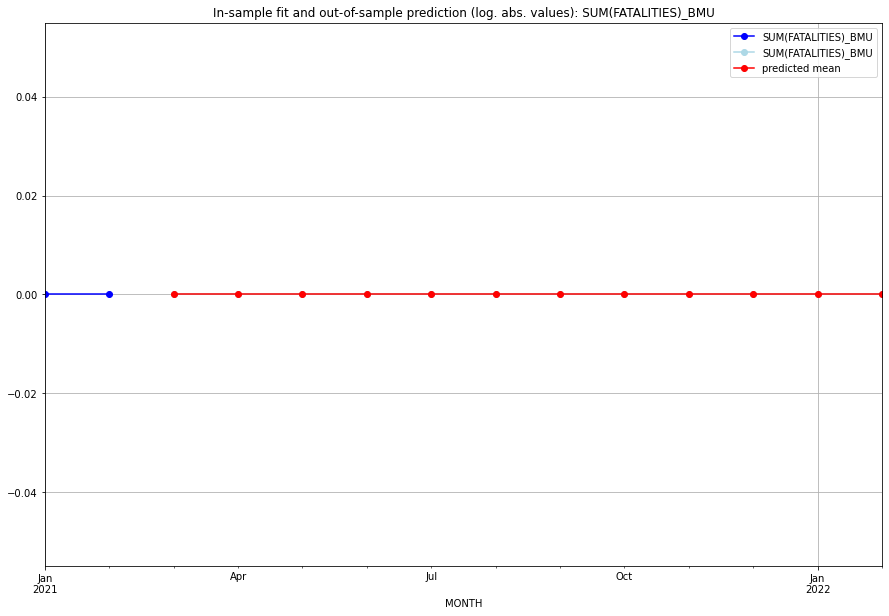

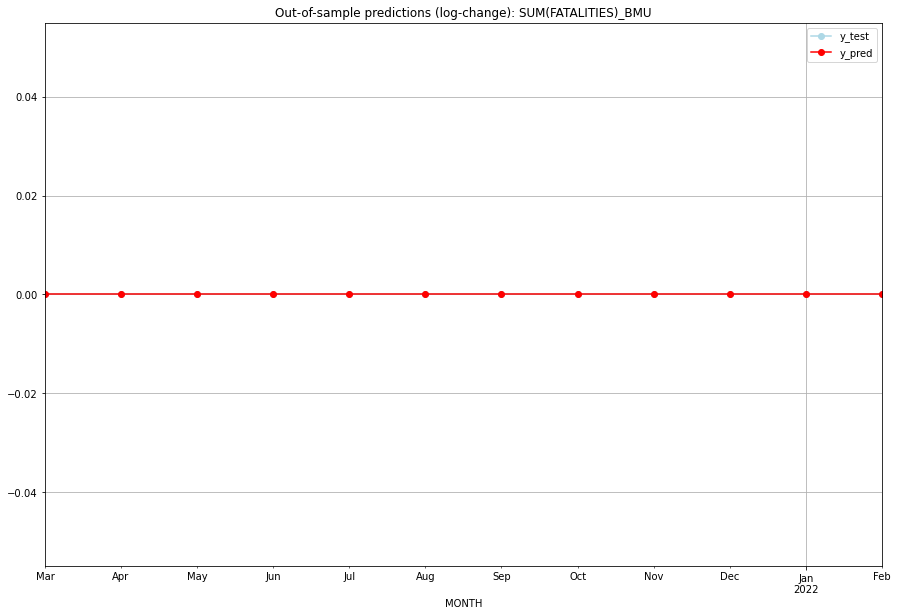

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   BMU   
1  2021-04-01       0.0         0.0           0.0             0.0   BMU   
2  2021-05-01       0.0         0.0           0.0             0.0   BMU   
3  2021-06-01       0.0         0.0           0.0             0.0   BMU   
4  2021-07-01       0.0         0.0           0.0             0.0   BMU   
5  2021-08-01       0.0         0.0           0.0             0.0   BMU   
6  2021-09-01       0.0         0.0           0.0             0.0   BMU   
7  2021-10-01       0.0         0.0           0.0             0.0   BMU   
8  2021-11-01       0.0         0.0           0.0             0.0   BMU   
9  2021-12-01       0.0         0.0           0.0             0.0   BMU   
10 2022-01-01       0.0         0.0           0.0             0.0   BMU   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.326433953705854, 'fold_results': [0.537231091431883, 0.11563681597982504]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BOL   No. Observations:                   38
Model:                SARIMAX(2, 0, 1)   Log Likelihood                 -39.663
Date:                 Wed, 19 Oct 2022   AIC                             87.325
Time:                         10:29:05   BIC                             93.876
Sample:                     01-31-2018   HQIC                            89.656
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0932      1.3

<Figure size 432x288 with 0 Axes>

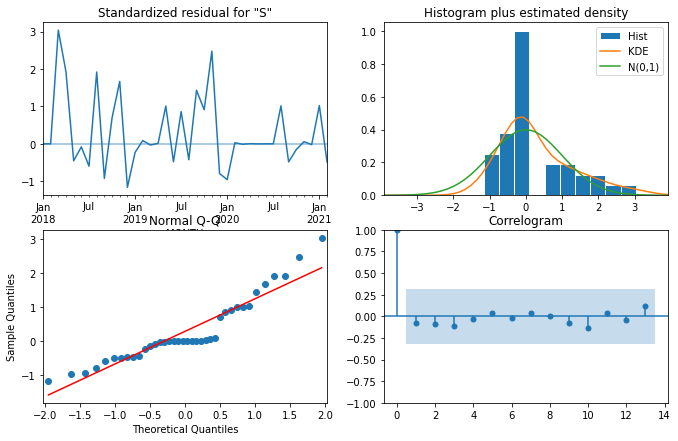

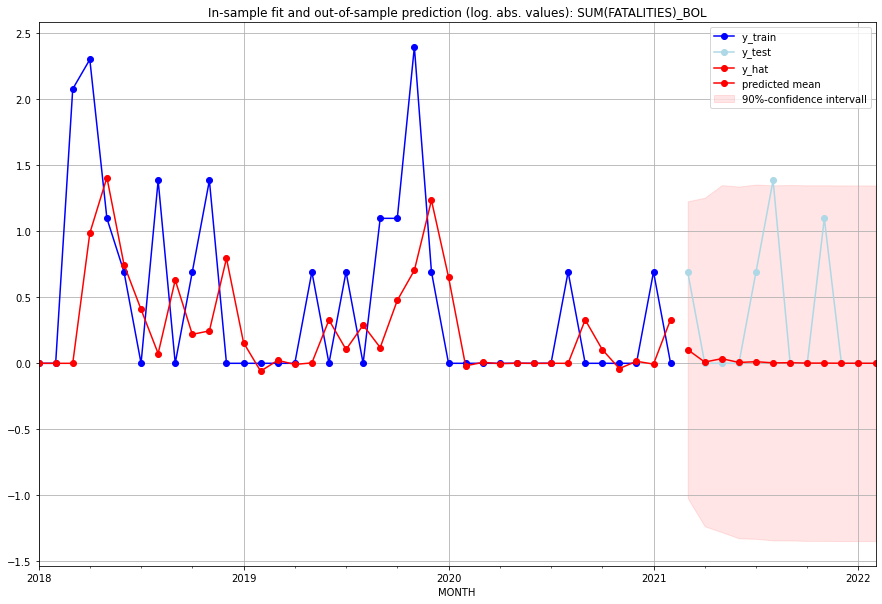

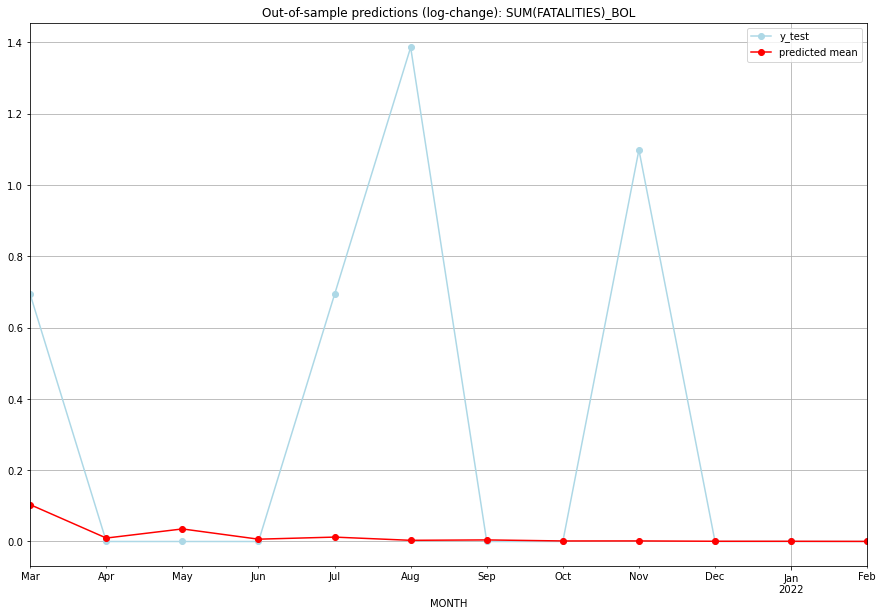

TADDA: 0.31744972420123335
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.108879         1.0      0.103349        0.693147   BOL   
1  2021-04-01  0.009680         0.0      0.009633        0.000000   BOL   
2  2021-05-01  0.035848         0.0      0.035220        0.000000   BOL   
3  2021-06-01  0.006503         0.0      0.006482        0.000000   BOL   
4  2021-07-01  0.012377         1.0      0.012301        0.693147   BOL   
5  2021-08-01  0.003305         3.0      0.003299        1.386294   BOL   
6  2021-09-01  0.004402         0.0      0.004393        0.000000   BOL   
7  2021-10-01  0.001506         0.0      0.001505        0.000000   BOL   
8  2021-11-01  0.001600         2.0      0.001599        1.098612   BOL   
9  2021-12-01  0.000649         0.0      0.000649        0.000000   BOL   
10 2022-01-01  0.000592         0.0      0.000592        0.000000   BOL   
11 2022-02-01  0.000271         0.0      0.000271   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.14395937354869956, 'fold_results': [nan, 0.14395937354869956]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BRA   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                   1.526
Date:                 Wed, 19 Oct 2022   AIC                              6.947
Time:                         10:29:19   BIC                             15.002
Sample:                     01-31-2018   HQIC                             9.787
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0084      0.027      0.30

<Figure size 432x288 with 0 Axes>

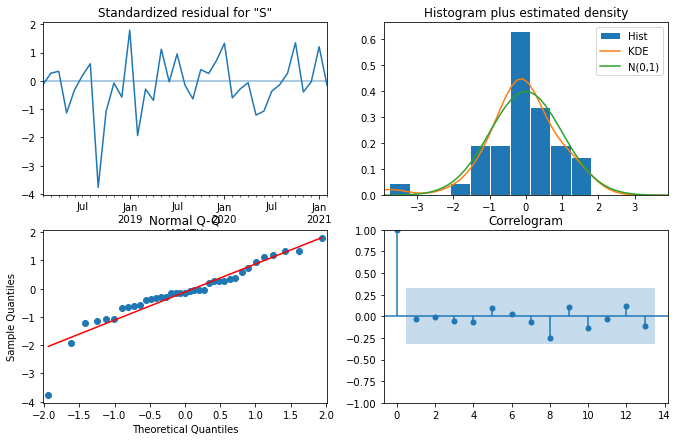

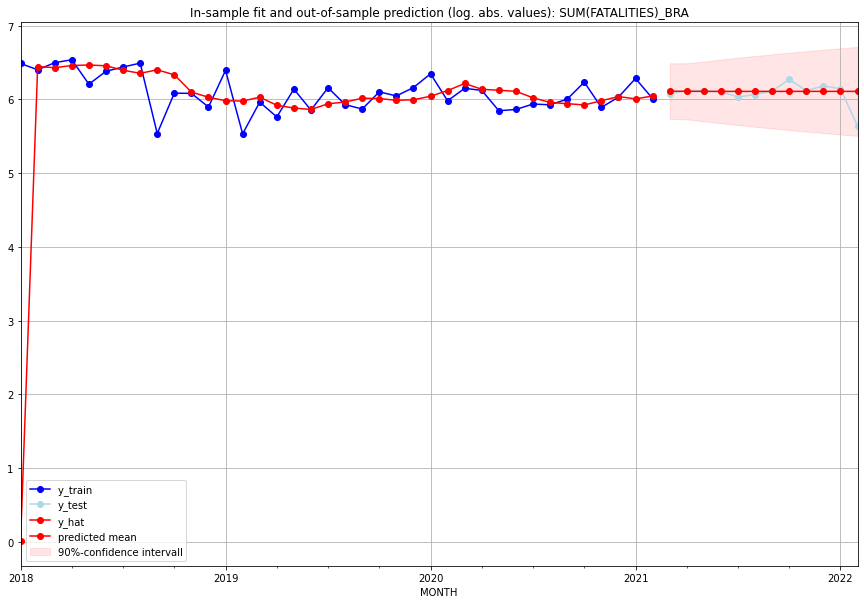

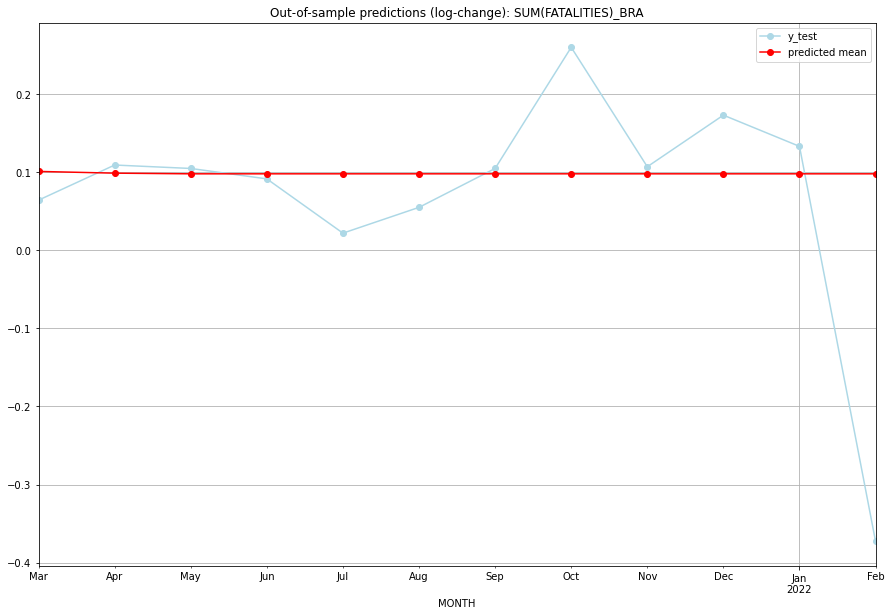

TADDA: 0.08633183575130639
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  450.291273       434.0      0.100846        0.064079   BRA   
1  2021-04-01  449.284713       454.0      0.098613        0.109030   BRA   
2  2021-05-01  448.902956       452.0      0.097765        0.104625   BRA   
3  2021-06-01  448.902956       446.0      0.097765        0.091291   BRA   
4  2021-07-01  448.902956       416.0      0.097765        0.021819   BRA   
5  2021-08-01  448.902956       430.0      0.097765        0.054841   BRA   
6  2021-09-01  448.902956       452.0      0.097765        0.104625   BRA   
7  2021-10-01  448.902956       528.0      0.097765        0.259721   BRA   
8  2021-11-01  448.902956       453.0      0.097765        0.106830   BRA   
9  2021-12-01  448.902956       484.0      0.097765        0.172882   BRA   
10 2022-01-01  448.902956       465.0      0.097765        0.132918   BRA   
11 2022-02-01  448.902956   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.05776226477310199, 'fold_results': [0.057762265046662105, 0.05776226449954188]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BRB   No. Observations:                   38
Model:                SARIMAX(2, 0, 1)   Log Likelihood                  21.147
Date:                 Wed, 19 Oct 2022   AIC                            -34.293
Time:                         10:29:29   BIC                            -27.743
Sample:                     01-31-2018   HQIC                           -31.963
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         5.9e-06   1

<Figure size 432x288 with 0 Axes>

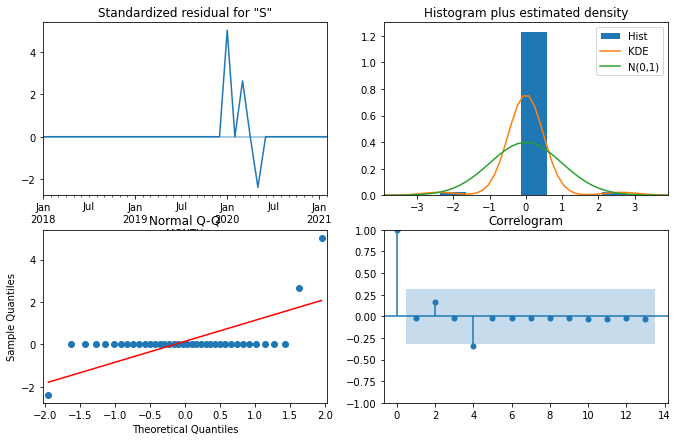

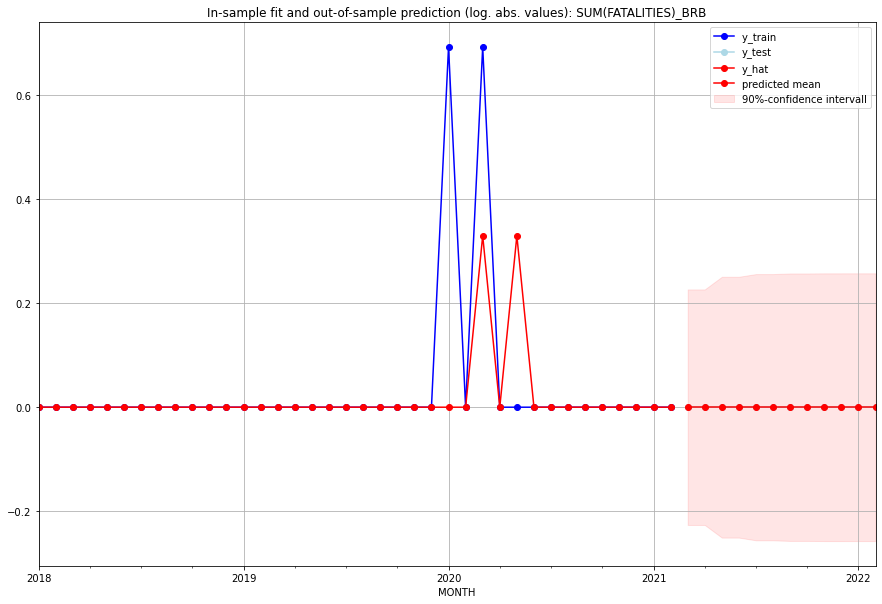

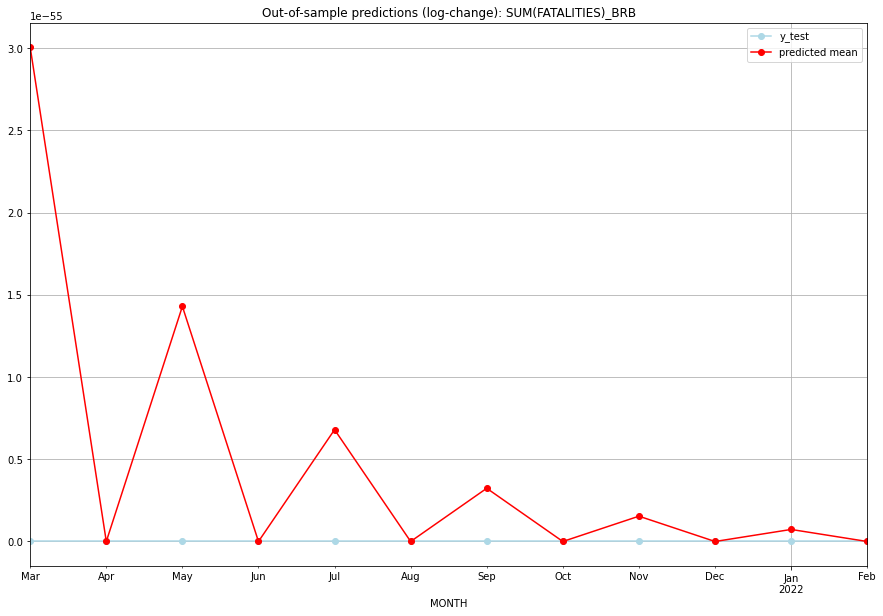

TADDA: 4.720896482131256e-56
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0  3.004909e-55             0.0   BRB   
1  2021-04-01       0.0         0.0  1.772912e-60             0.0   BRB   
2  2021-05-01       0.0         0.0  1.429480e-55             0.0   BRB   
3  2021-06-01       0.0         0.0  1.686802e-60             0.0   BRB   
4  2021-07-01       0.0         0.0  6.800250e-56             0.0   BRB   
5  2021-08-01       0.0         0.0  1.203656e-60             0.0   BRB   
6  2021-09-01       0.0         0.0  3.234980e-56             0.0   BRB   
7  2021-10-01       0.0         0.0  7.634626e-61             0.0   BRB   
8  2021-11-01       0.0         0.0  1.538928e-56             0.0   BRB   
9  2021-12-01       0.0         0.0  4.539882e-61             0.0   BRB   
10 2022-01-01       0.0         0.0  7.320912e-57             0.0   BRB   
11 2022-02-01       0.0         0.0  2.591628e-61 

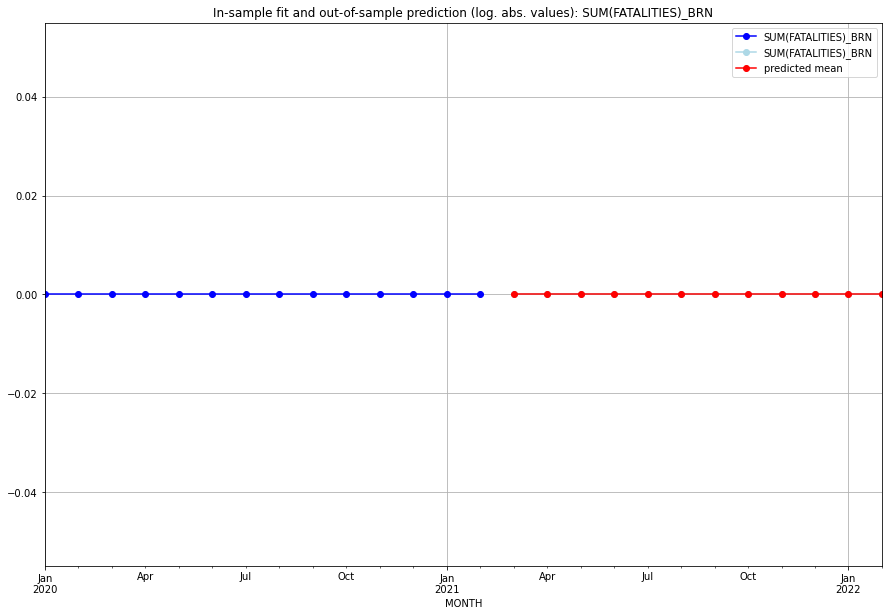

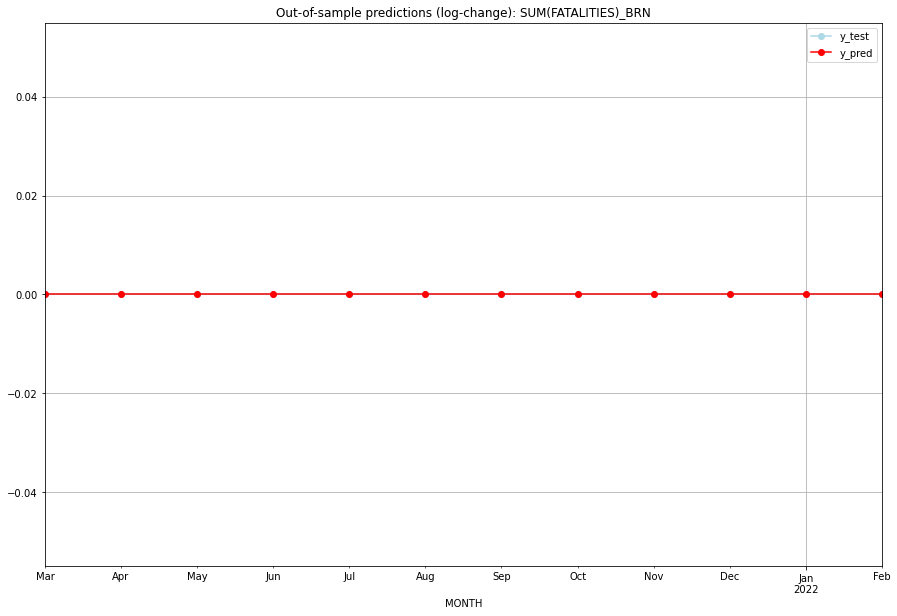

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   BRN   
1  2021-04-01       0.0         0.0           0.0             0.0   BRN   
2  2021-05-01       0.0         0.0           0.0             0.0   BRN   
3  2021-06-01       0.0         0.0           0.0             0.0   BRN   
4  2021-07-01       0.0         0.0           0.0             0.0   BRN   
5  2021-08-01       0.0         0.0           0.0             0.0   BRN   
6  2021-09-01       0.0         0.0           0.0             0.0   BRN   
7  2021-10-01       0.0         0.0           0.0             0.0   BRN   
8  2021-11-01       0.0         0.0           0.0             0.0   BRN   
9  2021-12-01       0.0         0.0           0.0             0.0   BRN   
10 2022-01-01       0.0         0.0           0.0             0.0   BRN   
11 2022-02-01       0.0         0.0           0.0             0.0   

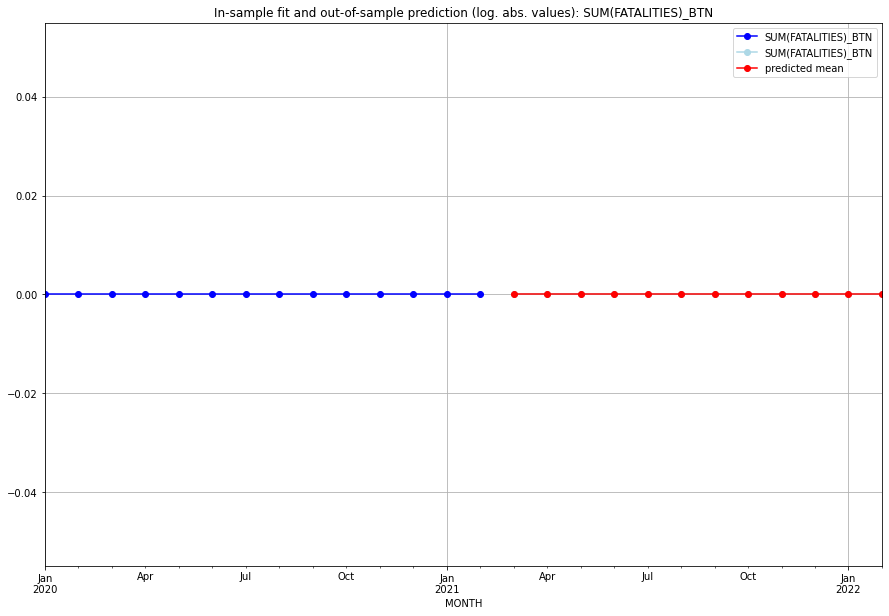

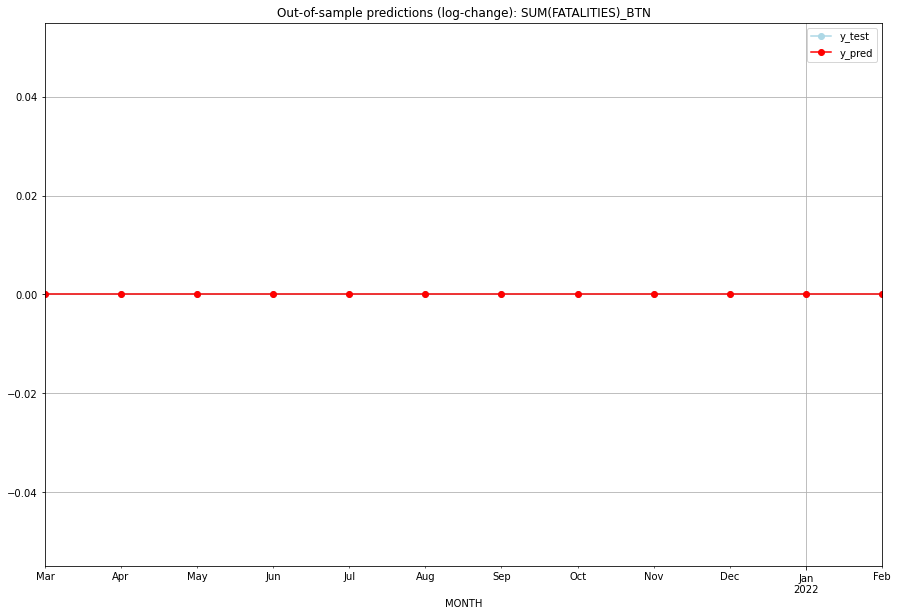

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   BTN   
1  2021-04-01       0.0         0.0           0.0             0.0   BTN   
2  2021-05-01       0.0         0.0           0.0             0.0   BTN   
3  2021-06-01       0.0         0.0           0.0             0.0   BTN   
4  2021-07-01       0.0         0.0           0.0             0.0   BTN   
5  2021-08-01       0.0         0.0           0.0             0.0   BTN   
6  2021-09-01       0.0         0.0           0.0             0.0   BTN   
7  2021-10-01       0.0         0.0           0.0             0.0   BTN   
8  2021-11-01       0.0         0.0           0.0             0.0   BTN   
9  2021-12-01       0.0         0.0           0.0             0.0   BTN   
10 2022-01-01       0.0         0.0           0.0             0.0   BTN   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08458623025389712, 'fold_results': [0.0, 0.0, 0.057762265046662105, 0.11552453009332421, 0.24964435612949928]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_BWA   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                 150.941
Date:                 Wed, 19 Oct 2022   AIC                           -299.883
Time:                         10:30:10   BIC                           -296.216
Sample:                     02-28-1997   HQIC                          -298.414
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

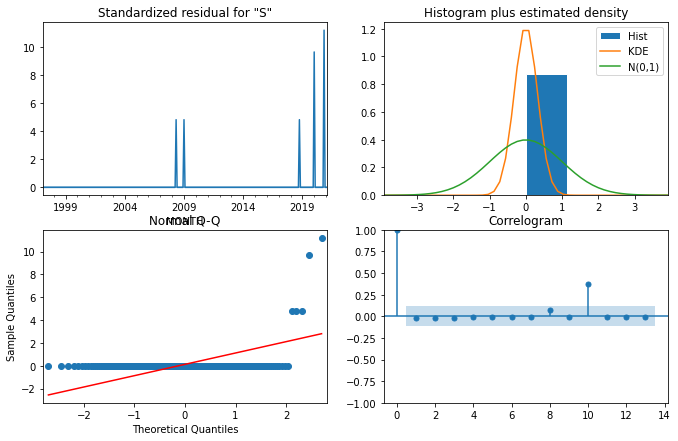

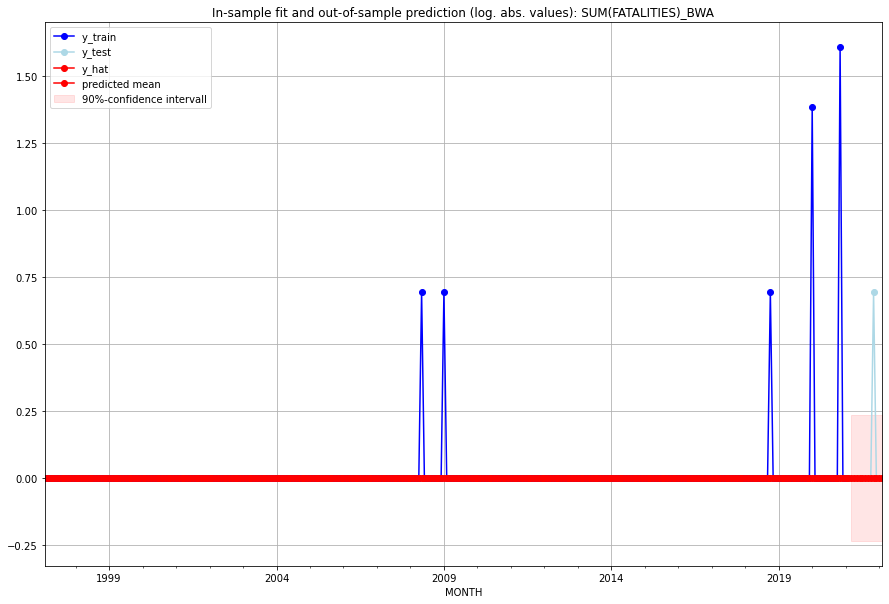

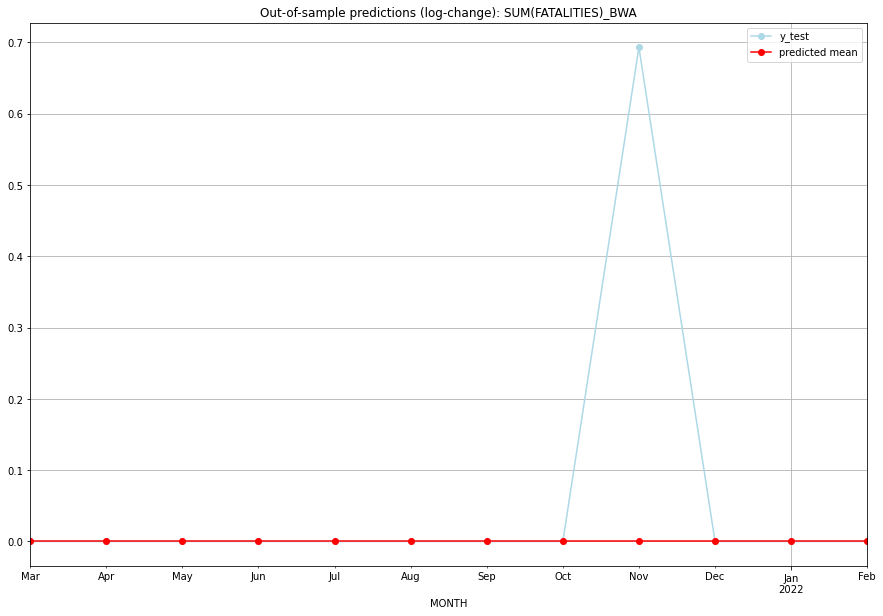

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   BWA   
1  2021-04-01       0.0         0.0           0.0        0.000000   BWA   
2  2021-05-01       0.0         0.0           0.0        0.000000   BWA   
3  2021-06-01       0.0         0.0           0.0        0.000000   BWA   
4  2021-07-01       0.0         0.0           0.0        0.000000   BWA   
5  2021-08-01       0.0         0.0           0.0        0.000000   BWA   
6  2021-09-01       0.0         0.0           0.0        0.000000   BWA   
7  2021-10-01       0.0         0.0           0.0        0.000000   BWA   
8  2021-11-01       0.0         1.0           0.0        0.693147   BWA   
9  2021-12-01       0.0         0.0           0.0        0.000000   BWA   
10 2022-01-01       0.0         0.0           0.0        0.000000   BWA   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.9167014421889389, 'fold_results': [1.1185320694688687, 0.6691161301388799, 0.7809855704633938, 1.0029572154226336, 1.0119162254509184]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CAF   No. Observations:                  289
Model:                SARIMAX(3, 1, 0)   Log Likelihood                -503.410
Date:                 Wed, 19 Oct 2022   AIC                           1018.821
Time:                         10:30:41   BIC                           1040.798
Sample:                     02-28-1997   HQIC                          1027.628
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

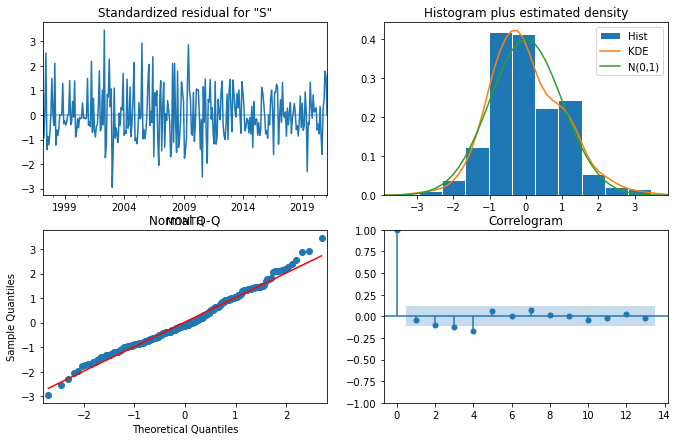

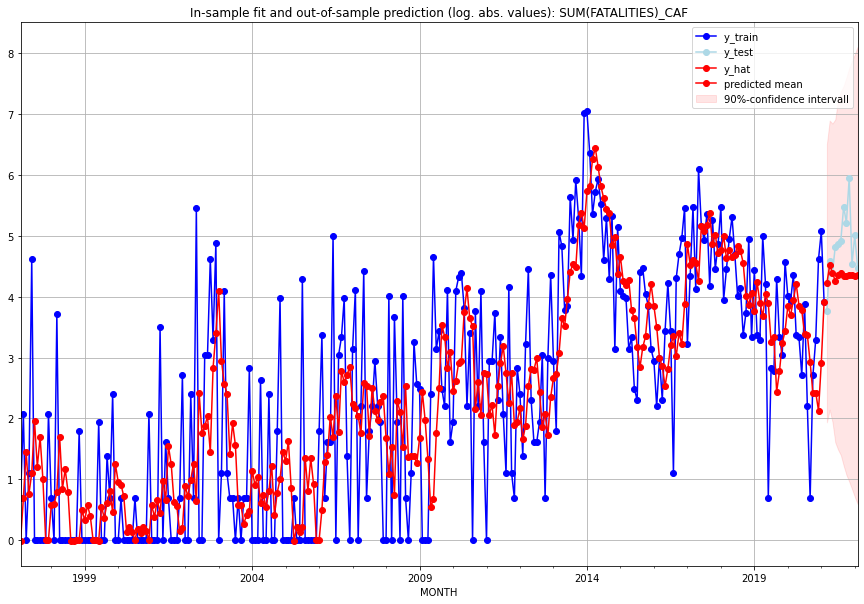

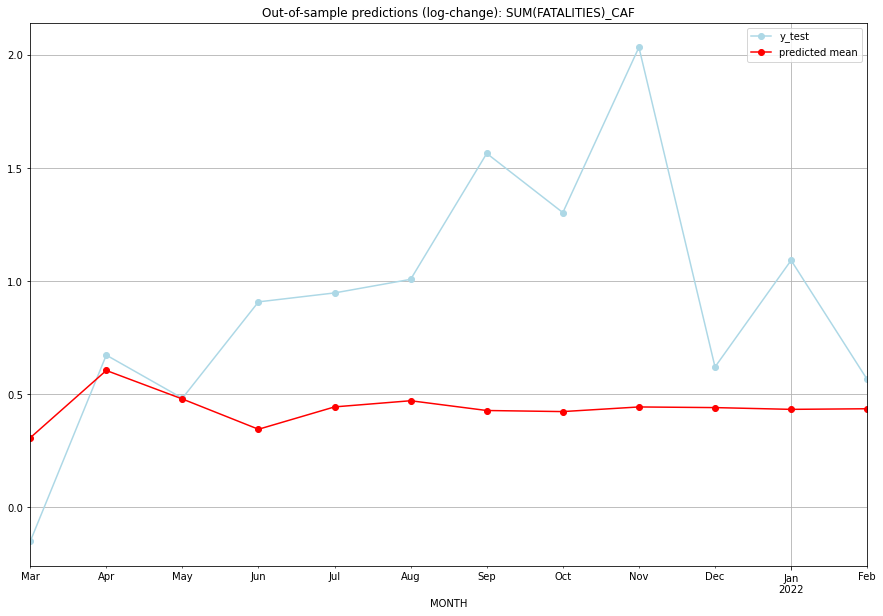

TADDA: 0.5844726910625123
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  66.997033        42.0      0.307441       -0.150823   CAF   
1  2021-04-01  90.571065        97.0      0.605092        0.672944   CAF   
2  2021-05-01  79.725060        80.0      0.479026        0.482426   CAF   
3  2021-06-01  69.615143       123.0      0.345222        0.908259   CAF   
4  2021-07-01  76.950211       128.0      0.444047        0.947789   CAF   
5  2021-08-01  79.102834       136.0      0.471288        1.007958   CAF   
6  2021-09-01  75.719101       238.0      0.428128        1.564441   CAF   
7  2021-10-01  75.353136       183.0      0.423346        1.302913   CAF   
8  2021-11-01  76.932227       381.0      0.443817        2.033398   CAF   
9  2021-12-01  76.710129        92.0      0.440963        0.620576   CAF   
10 2022-01-01  76.107476       148.0      0.433177        1.091923   CAF   
11 2022-02-01  76.315233        87.0     

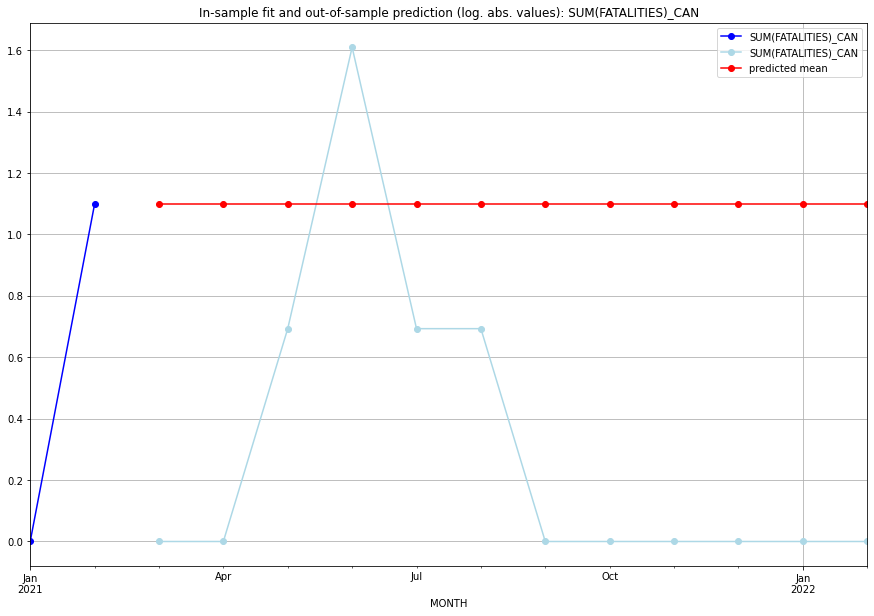

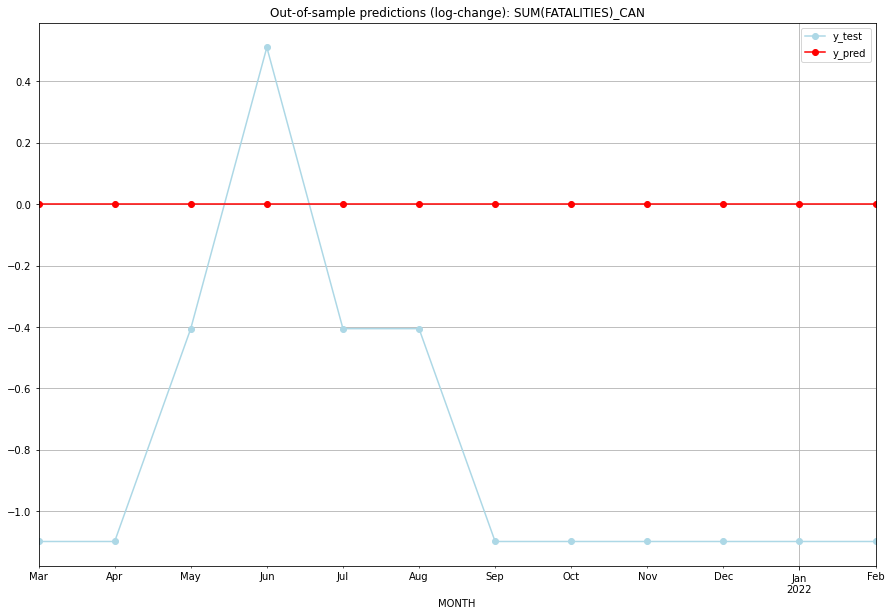

TADDA: 0.8763432714529468
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.098612    0.000000           0.0       -1.098612   CAN   
1  2021-04-01  1.098612    0.000000           0.0       -1.098612   CAN   
2  2021-05-01  1.098612    0.693147           0.0       -0.405465   CAN   
3  2021-06-01  1.098612    1.609438           0.0        0.510826   CAN   
4  2021-07-01  1.098612    0.693147           0.0       -0.405465   CAN   
5  2021-08-01  1.098612    0.693147           0.0       -0.405465   CAN   
6  2021-09-01  1.098612    0.000000           0.0       -1.098612   CAN   
7  2021-10-01  1.098612    0.000000           0.0       -1.098612   CAN   
8  2021-11-01  1.098612    0.000000           0.0       -1.098612   CAN   
9  2021-12-01  1.098612    0.000000           0.0       -1.098612   CAN   
10 2022-01-01  1.098612    0.000000           0.0       -1.098612   CAN   
11 2022-02-01  1.098612    0.000000           0.0    

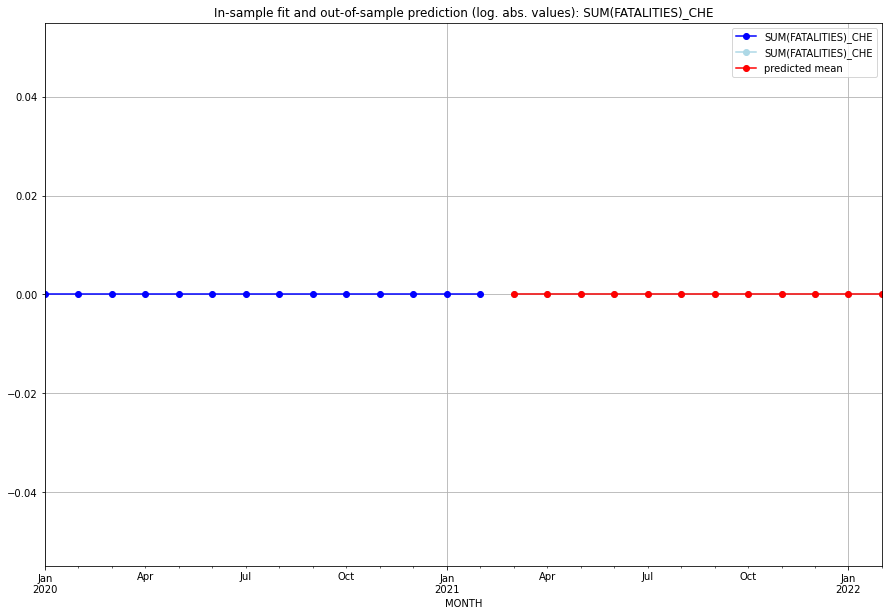

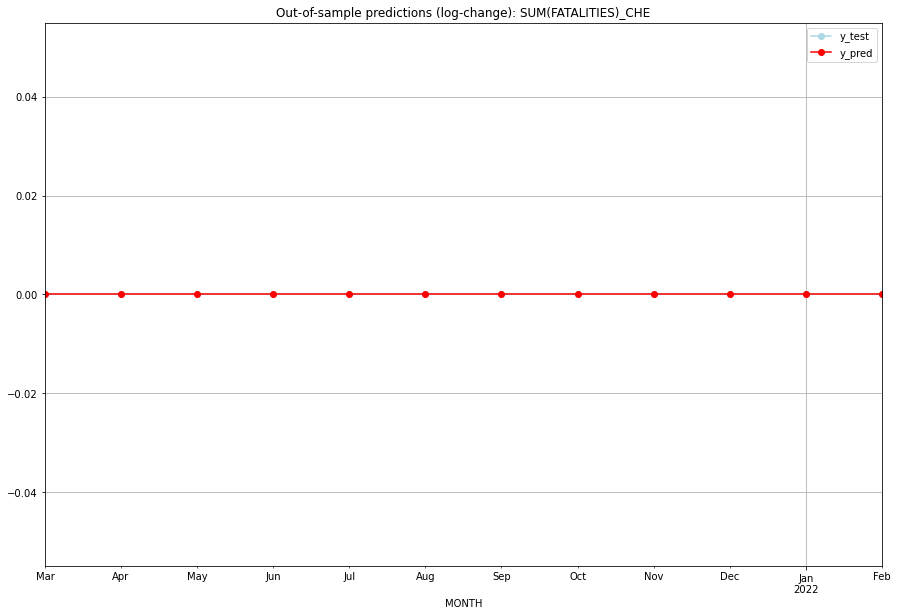

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   CHE   
1  2021-04-01       0.0         0.0           0.0             0.0   CHE   
2  2021-05-01       0.0         0.0           0.0             0.0   CHE   
3  2021-06-01       0.0         0.0           0.0             0.0   CHE   
4  2021-07-01       0.0         0.0           0.0             0.0   CHE   
5  2021-08-01       0.0         0.0           0.0             0.0   CHE   
6  2021-09-01       0.0         0.0           0.0             0.0   CHE   
7  2021-10-01       0.0         0.0           0.0             0.0   CHE   
8  2021-11-01       0.0         0.0           0.0             0.0   CHE   
9  2021-12-01       0.0         0.0           0.0             0.0   CHE   
10 2022-01-01       0.0         0.0           0.0             0.0   CHE   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.41009243763653774, 'fold_results': [nan, 0.41009243763653774]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CHL   No. Observations:                   38
Model:                SARIMAX(3, 1, 3)   Log Likelihood                 -37.712
Date:                 Wed, 19 Oct 2022   AIC                             89.424
Time:                         10:31:06   BIC                            100.700
Sample:                     01-31-2018   HQIC                            93.399
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4762      2.434     -0.19

<Figure size 432x288 with 0 Axes>

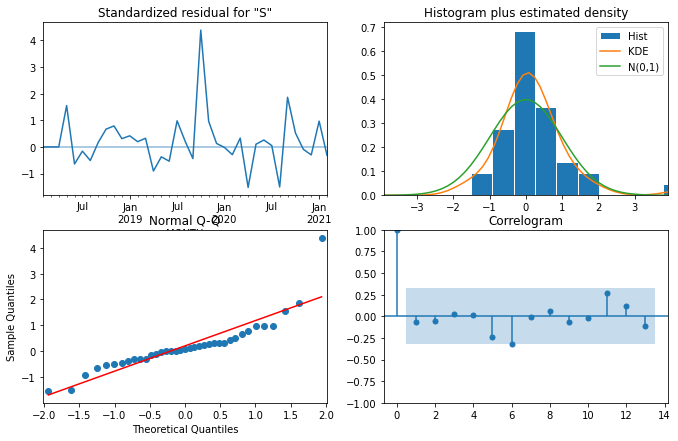

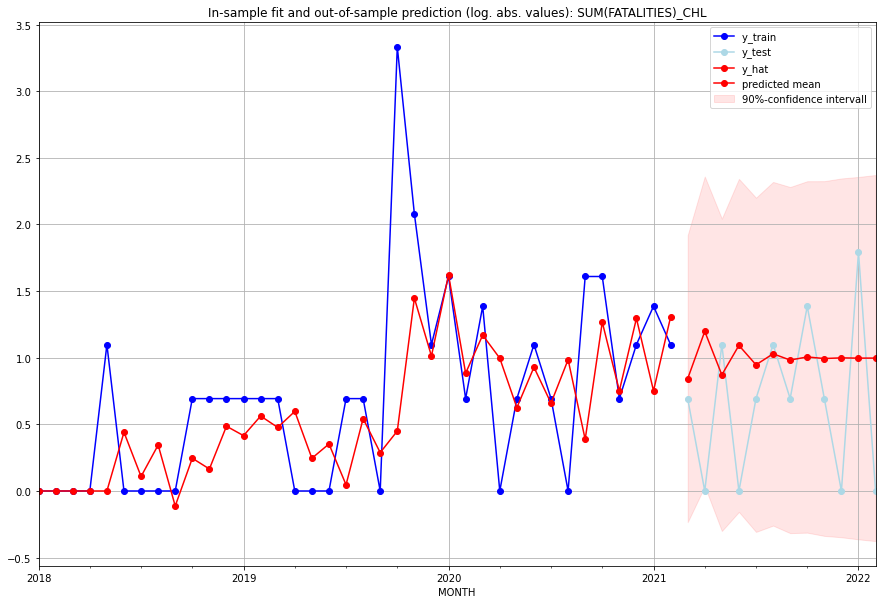

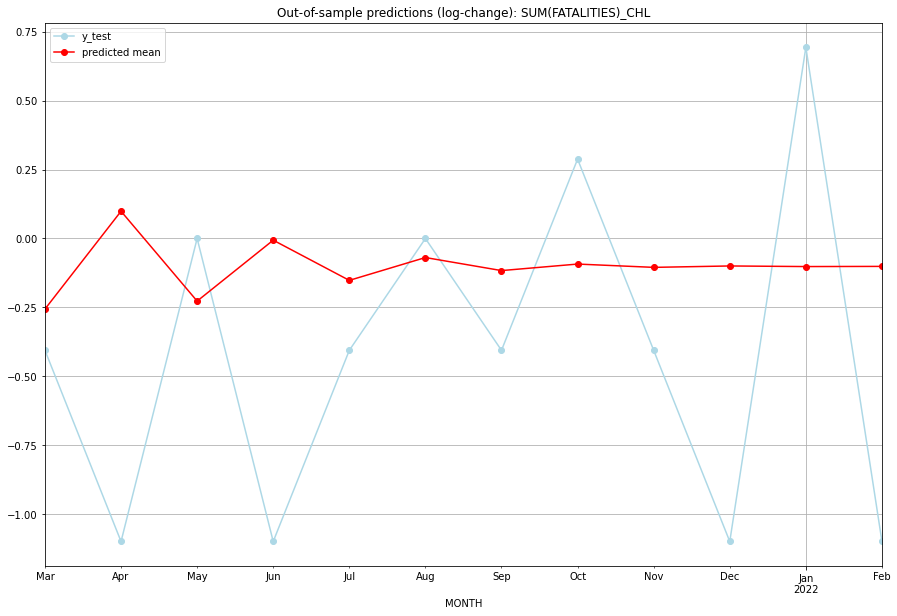

TADDA: 0.5869967373483019
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.322382         1.0     -0.256019       -0.405465   CHL   
1  2021-04-01  2.311550         0.0      0.098804       -1.098612   CHL   
2  2021-05-01  1.390732         2.0     -0.227013        0.000000   CHL   
3  2021-06-01  1.981614         0.0     -0.006147       -1.098612   CHL   
4  2021-07-01  1.577293         1.0     -0.151873       -0.405465   CHL   
5  2021-08-01  1.799731         2.0     -0.069089        0.000000   CHL   
6  2021-09-01  1.670436         1.0     -0.116371       -0.405465   CHL   
7  2021-10-01  1.734297         3.0     -0.092738        0.287682   CHL   
8  2021-11-01  1.701774         1.0     -0.104704       -0.405465   CHL   
9  2021-12-01  1.715528         0.0     -0.099626       -1.098612   CHL   
10 2022-01-01  1.709683         5.0     -0.101781        0.693147   CHL   
11 2022-02-01  1.711294         0.0     -0.101186    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.37328322275584486, 'fold_results': [0.2986265782046759, 0.4479398673070138]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CHN   No. Observations:                   38
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -48.159
Date:                 Wed, 19 Oct 2022   AIC                             98.318
Time:                         10:31:19   BIC                             99.929
Sample:                     01-31-2018   HQIC                            98.886
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.7908      0

<Figure size 432x288 with 0 Axes>

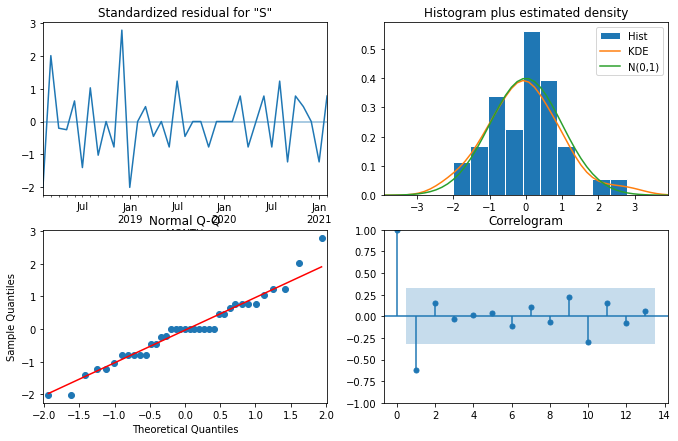

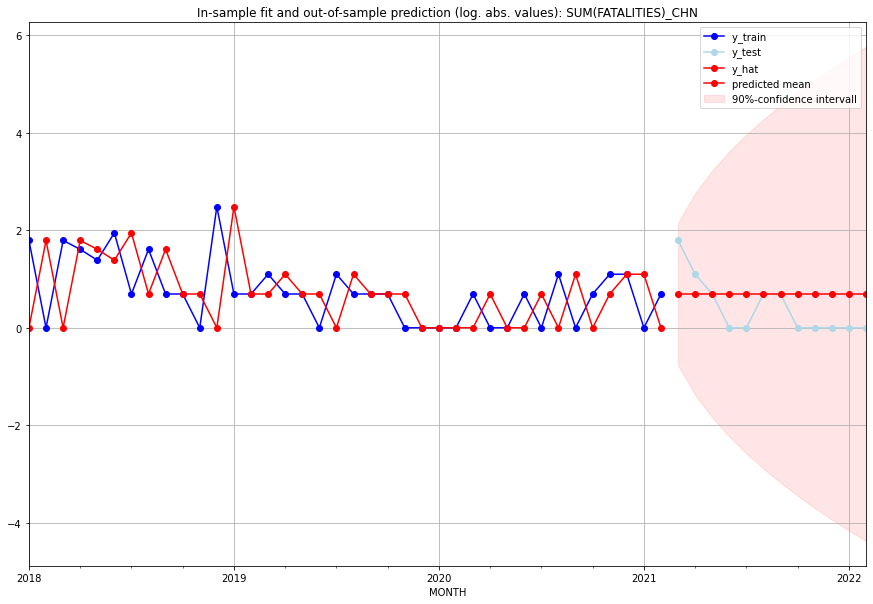

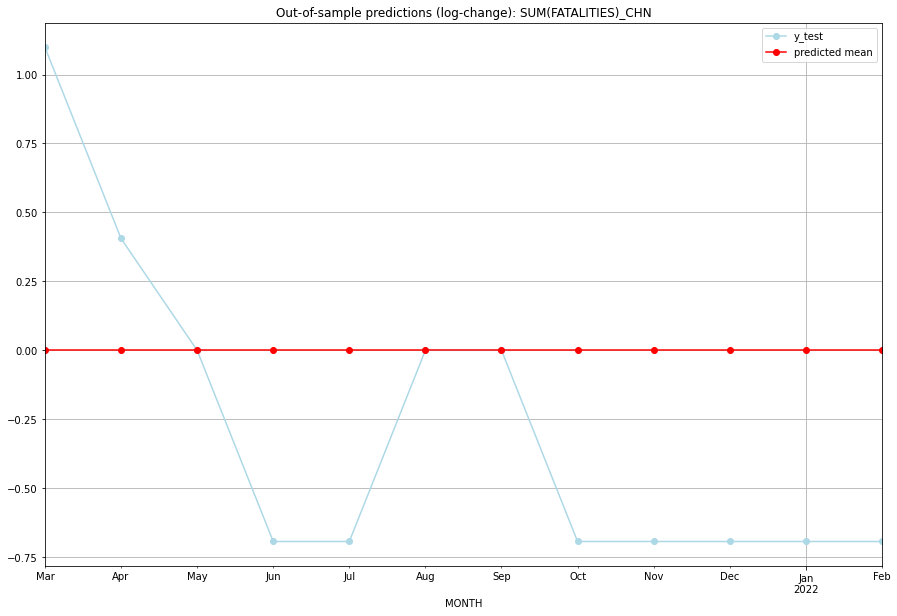

TADDA: 0.5296756383913243
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       1.0         5.0           0.0        1.098612   CHN   
1  2021-04-01       1.0         2.0           0.0        0.405465   CHN   
2  2021-05-01       1.0         1.0           0.0        0.000000   CHN   
3  2021-06-01       1.0         0.0           0.0       -0.693147   CHN   
4  2021-07-01       1.0         0.0           0.0       -0.693147   CHN   
5  2021-08-01       1.0         1.0           0.0        0.000000   CHN   
6  2021-09-01       1.0         1.0           0.0        0.000000   CHN   
7  2021-10-01       1.0         0.0           0.0       -0.693147   CHN   
8  2021-11-01       1.0         0.0           0.0       -0.693147   CHN   
9  2021-12-01       1.0         0.0           0.0       -0.693147   CHN   
10 2022-01-01       1.0         0.0           0.0       -0.693147   CHN   
11 2022-02-01       1.0         0.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.7874976694553752, 'fold_results': [0.8190309207118278, 0.907181756782923, 0.835276067798128, 0.6344908534964079, 0.7415087484875897]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CIV   No. Observations:                  289
Model:                SARIMAX(3, 0, 3)   Log Likelihood                -467.002
Date:                 Wed, 19 Oct 2022   AIC                            950.004
Time:                         10:31:56   BIC                            979.336
Sample:                     02-28-1997   HQIC                           961.757
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

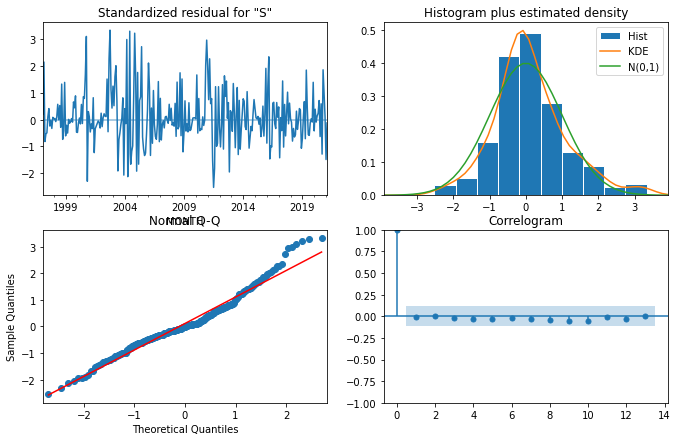

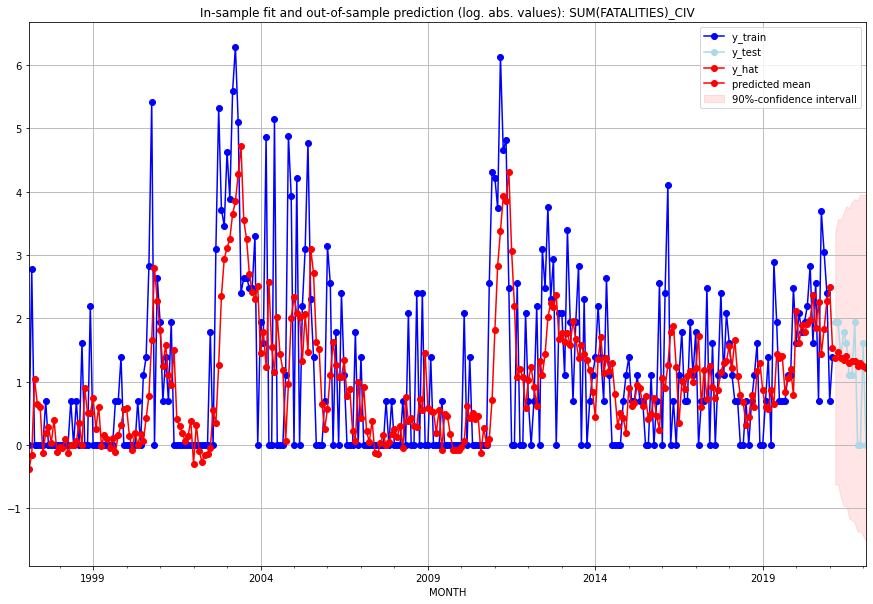

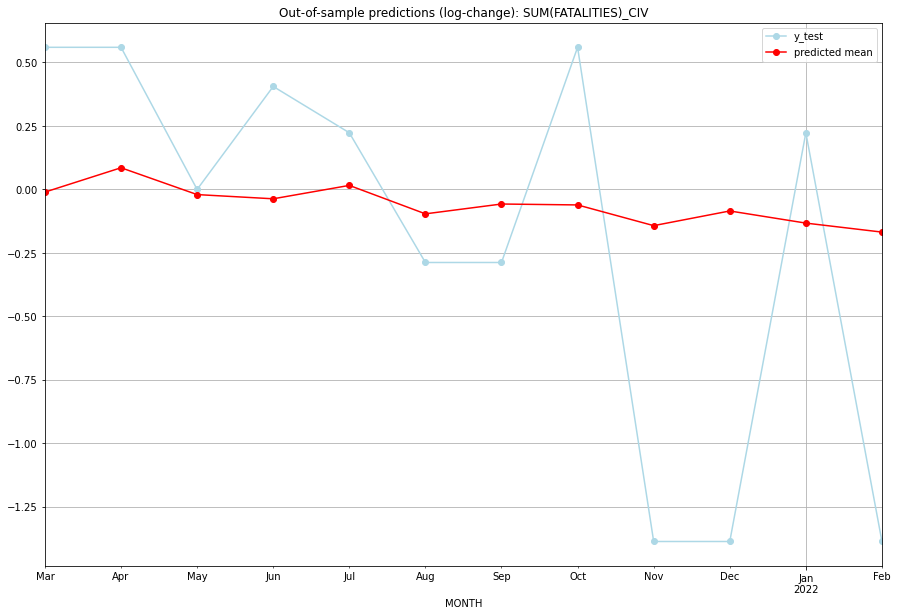

TADDA: 0.5930792244328581
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.958373         6.0     -0.010461        0.559616   CIV   
1  2021-04-01  3.356388         6.0      0.085349        0.559616   CIV   
2  2021-05-01  2.919556         3.0     -0.020316        0.000000   CIV   
3  2021-06-01  2.855165         5.0     -0.036881        0.405465   CIV   
4  2021-07-01  3.063860         4.0      0.015839        0.223144   CIV   
5  2021-08-01  2.633320         2.0     -0.096148       -0.287682   CIV   
6  2021-09-01  2.776704         2.0     -0.057443       -0.287682   CIV   
7  2021-10-01  2.763091         6.0     -0.061054        0.559616   CIV   
8  2021-11-01  2.468363         0.0     -0.142612       -1.386294   CIV   
9  2021-12-01  2.674799         0.0     -0.084796       -1.386294   CIV   
10 2022-01-01  2.503266         4.0     -0.132599        0.223144   CIV   
11 2022-02-01  2.381365         0.0     -0.168015    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.598273803808985, 'fold_results': [0.7233905597177906, 0.7438874409390618, 0.8601019004987567, 0.435174079102756, 0.2288150387865596]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CMR   No. Observations:                  289
Model:                SARIMAX(3, 1, 1)   Log Likelihood                -384.601
Date:                 Wed, 19 Oct 2022   AIC                            785.202
Time:                         10:32:29   BIC                            814.505
Sample:                     02-28-1997   HQIC                           796.945
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

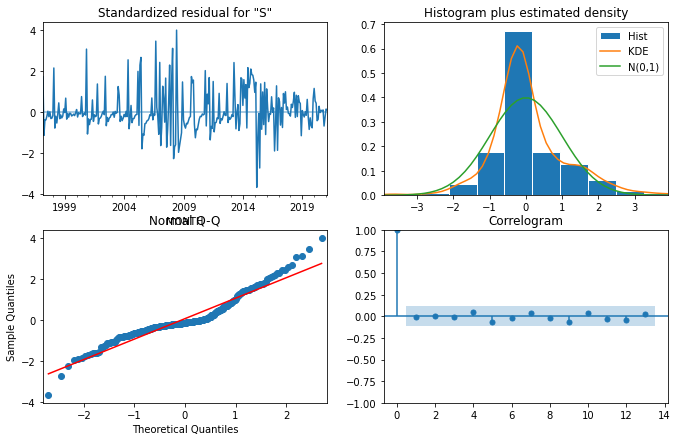

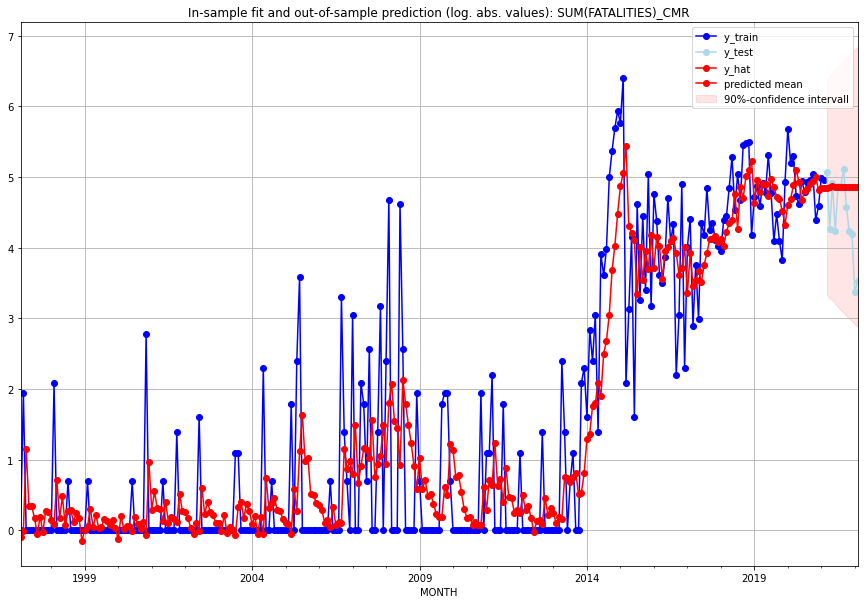

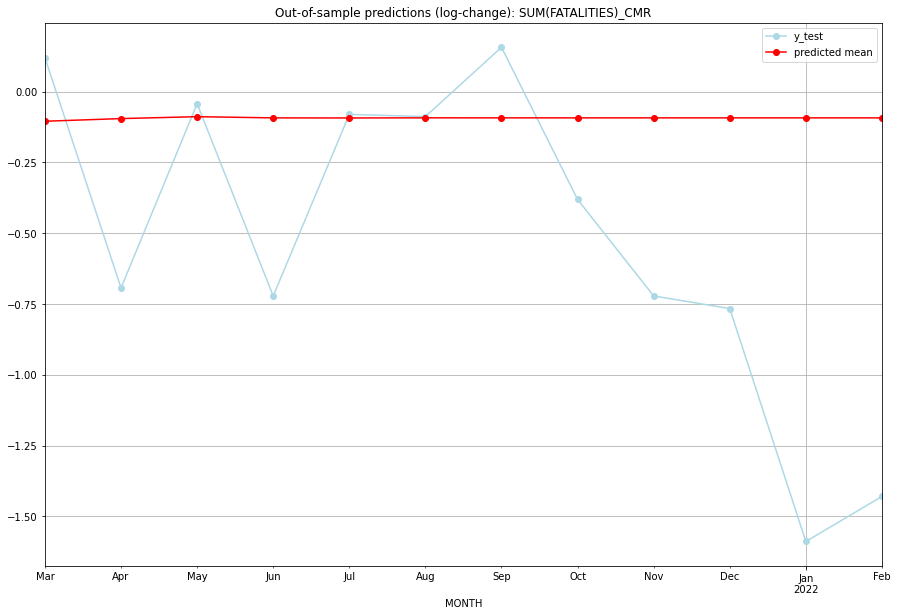

TADDA: 0.5318715153303655
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  126.863217       159.0     -0.104866        0.119347   CMR   
1  2021-04-01  128.070888        70.0     -0.095465       -0.693147   CMR   
2  2021-05-01  128.946060       135.0     -0.088708       -0.043172   CMR   
3  2021-06-01  128.389059        68.0     -0.093003       -0.721721   CMR   
4  2021-07-01  128.348273       130.0     -0.093318       -0.080630   CMR   
5  2021-08-01  128.415426       129.0     -0.092799       -0.088293   CMR   
6  2021-09-01  128.400266       165.0     -0.092917        0.156161   CMR   
7  2021-10-01  128.393506        96.0     -0.092969       -0.381116   CMR   
8  2021-11-01  128.396697        68.0     -0.092944       -0.721721   CMR   
9  2021-12-01  128.396723        65.0     -0.092944       -0.766172   CMR   
10 2022-01-01  128.396258        28.0     -0.092948       -1.588531   CMR   
11 2022-02-01  128.396353    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4655540837766218, 'fold_results': [0.8006783841505157, 0.6627486447766623, 0.3335264196726789, 0.33439406435183266, 0.1964229059314193]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COD   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -535.256
Date:                 Wed, 19 Oct 2022   AIC                           1072.512
Time:                         10:32:54   BIC                           1076.175
Sample:                     02-28-1997   HQIC                          1073.980
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

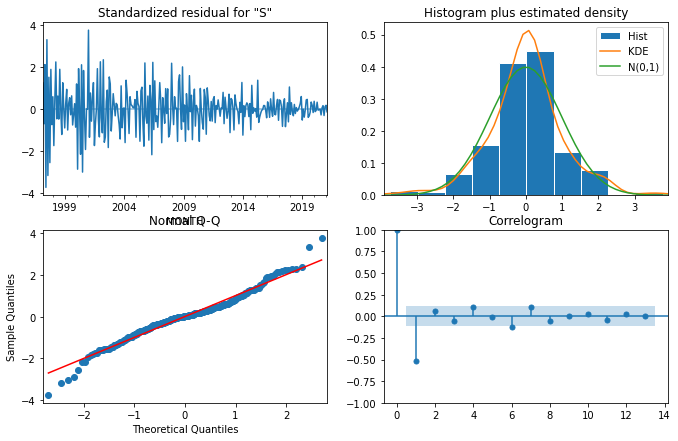

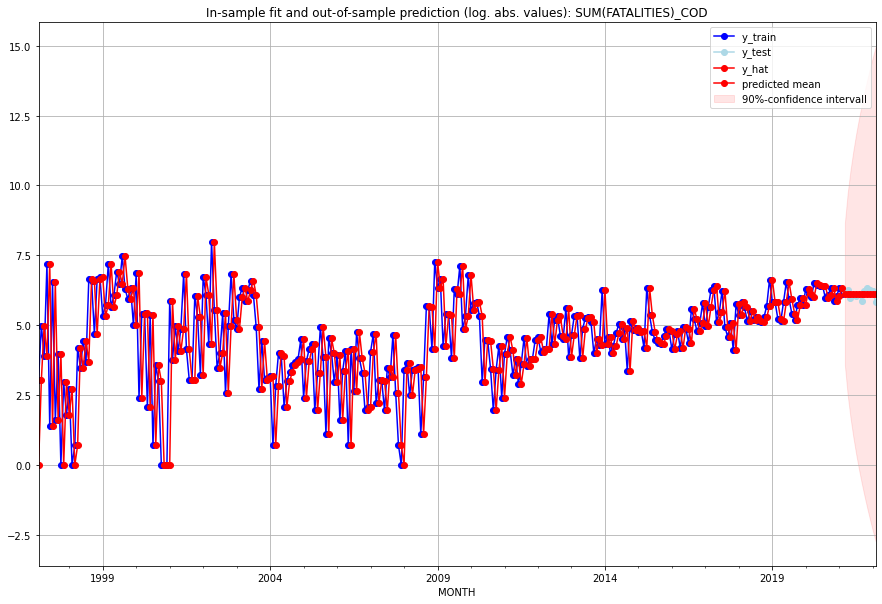

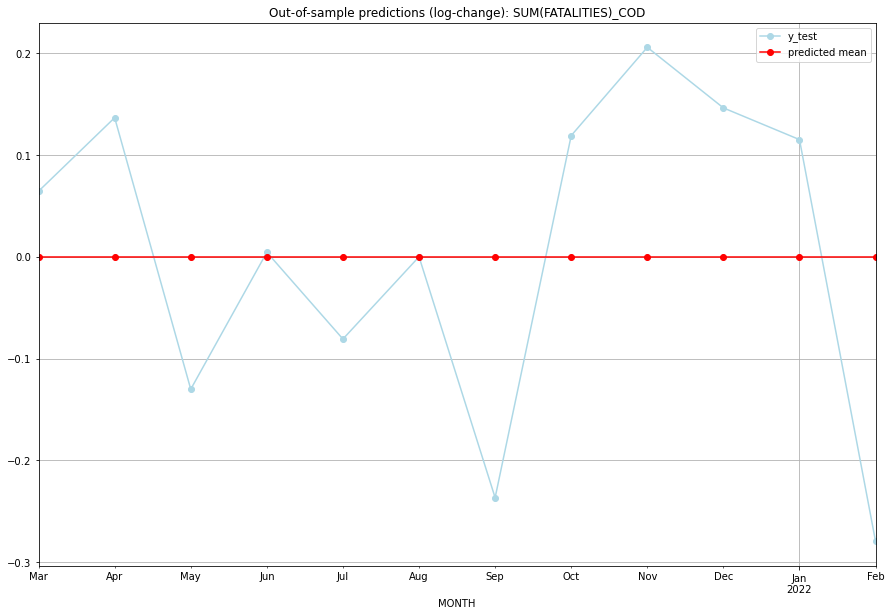

TADDA: 0.1265281636194807
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01     450.0       480.0           0.0        0.064400   COD   
1  2021-04-01     450.0       516.0           0.0        0.136576   COD   
2  2021-05-01     450.0       395.0           0.0       -0.130053   COD   
3  2021-06-01     450.0       452.0           0.0        0.004425   COD   
4  2021-07-01     450.0       415.0           0.0       -0.080782   COD   
5  2021-08-01     450.0       450.0           0.0        0.000000   COD   
6  2021-09-01     450.0       355.0           0.0       -0.236537   COD   
7  2021-10-01     450.0       507.0           0.0        0.119014   COD   
8  2021-11-01     450.0       553.0           0.0        0.205697   COD   
9  2021-12-01     450.0       521.0           0.0        0.146200   COD   
10 2022-01-01     450.0       505.0           0.0        0.115069   COD   
11 2022-02-01     450.0       340.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.49081247332870725, 'fold_results': [0.8251571892640962, 0.46209812037329684, 0.603923382048813, 0.09155102405567582, 0.4713326509016544]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COG   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -387.345
Date:                 Wed, 19 Oct 2022   AIC                            776.690
Time:                         10:33:24   BIC                            780.356
Sample:                     02-28-1997   HQIC                           778.159
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

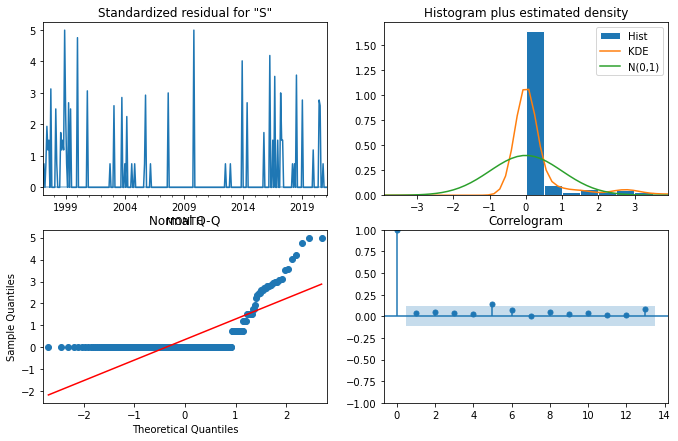

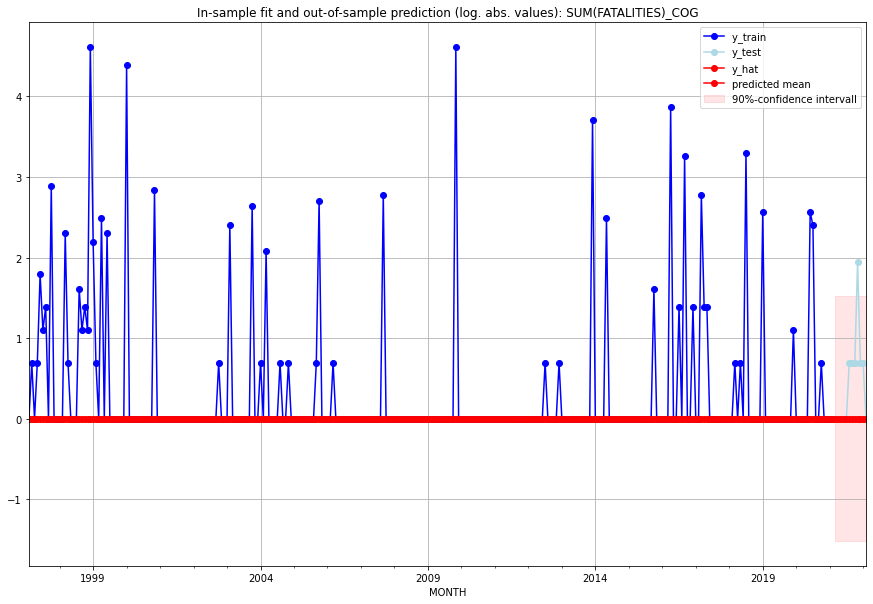

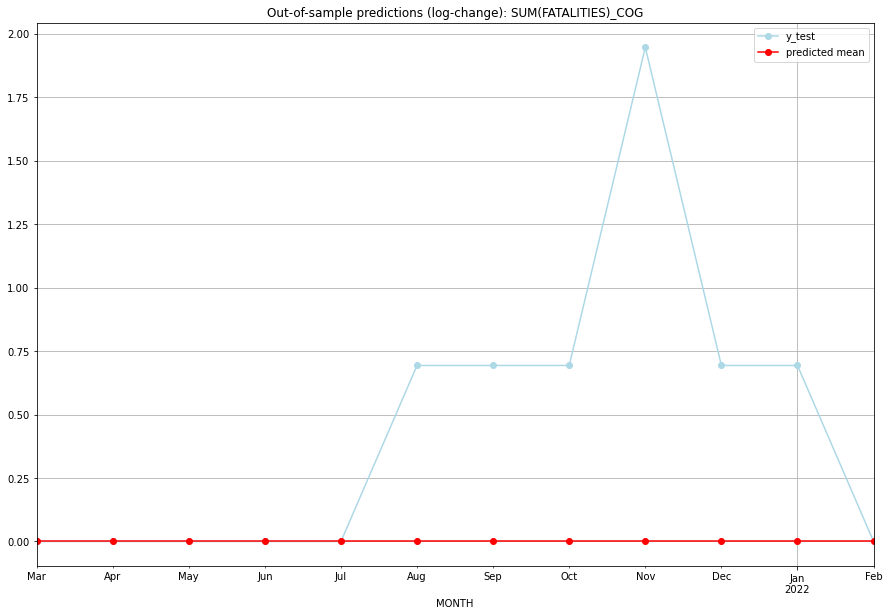

TADDA: 0.4509705043212533
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   COG   
1  2021-04-01       0.0         0.0           0.0        0.000000   COG   
2  2021-05-01       0.0         0.0           0.0        0.000000   COG   
3  2021-06-01       0.0         0.0           0.0        0.000000   COG   
4  2021-07-01       0.0         0.0           0.0        0.000000   COG   
5  2021-08-01       0.0         1.0           0.0        0.693147   COG   
6  2021-09-01       0.0         1.0           0.0        0.693147   COG   
7  2021-10-01       0.0         1.0           0.0        0.693147   COG   
8  2021-11-01       0.0         6.0           0.0        1.945910   COG   
9  2021-12-01       0.0         1.0           0.0        0.693147   COG   
10 2022-01-01       0.0         1.0           0.0        0.693147   COG   
11 2022-02-01       0.0         0.0           0.0    

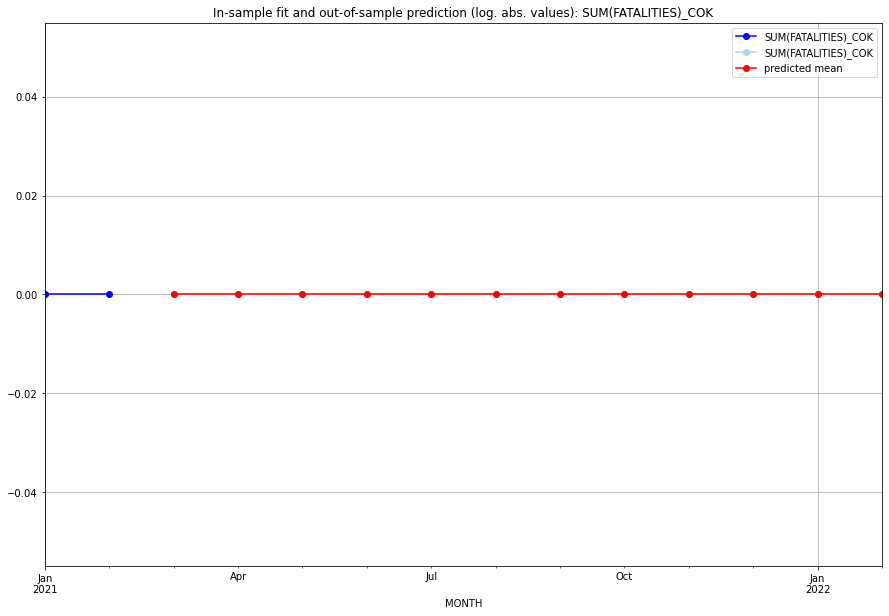

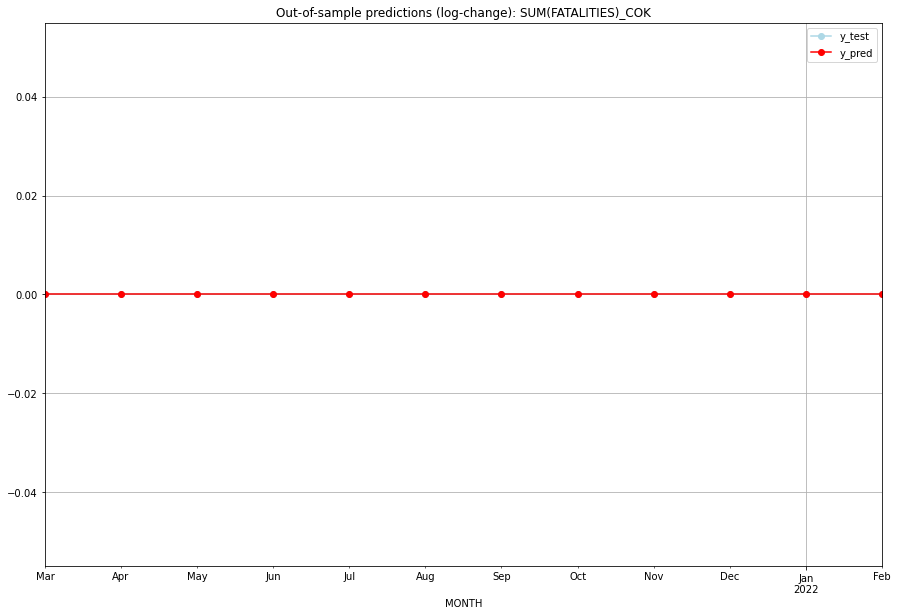

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   COK   
1  2021-04-01       0.0         0.0           0.0             0.0   COK   
2  2021-05-01       0.0         0.0           0.0             0.0   COK   
3  2021-06-01       0.0         0.0           0.0             0.0   COK   
4  2021-07-01       0.0         0.0           0.0             0.0   COK   
5  2021-08-01       0.0         0.0           0.0             0.0   COK   
6  2021-09-01       0.0         0.0           0.0             0.0   COK   
7  2021-10-01       0.0         0.0           0.0             0.0   COK   
8  2021-11-01       0.0         0.0           0.0             0.0   COK   
9  2021-12-01       0.0         0.0           0.0             0.0   COK   
10 2022-01-01       0.0         0.0           0.0             0.0   COK   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.2523478097369584, 'fold_results': [nan, 0.2523478097369584]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COL   No. Observations:                   38
Model:                SARIMAX(2, 1, 3)   Log Likelihood                   2.209
Date:                 Wed, 19 Oct 2022   AIC                             13.582
Time:                         10:33:42   BIC                             28.080
Sample:                     01-31-2018   HQIC                            18.693
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0147      0.024      0.612 

<Figure size 432x288 with 0 Axes>

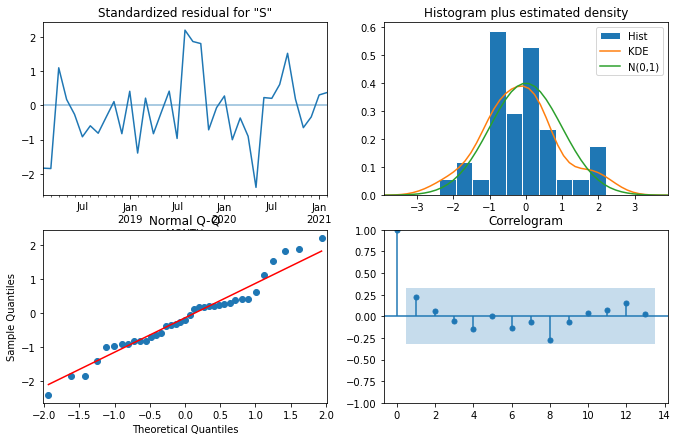

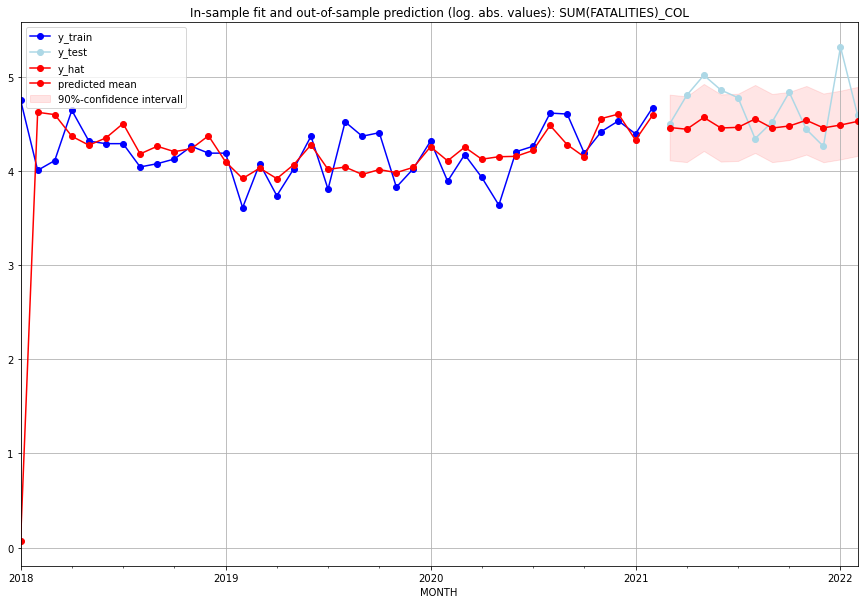

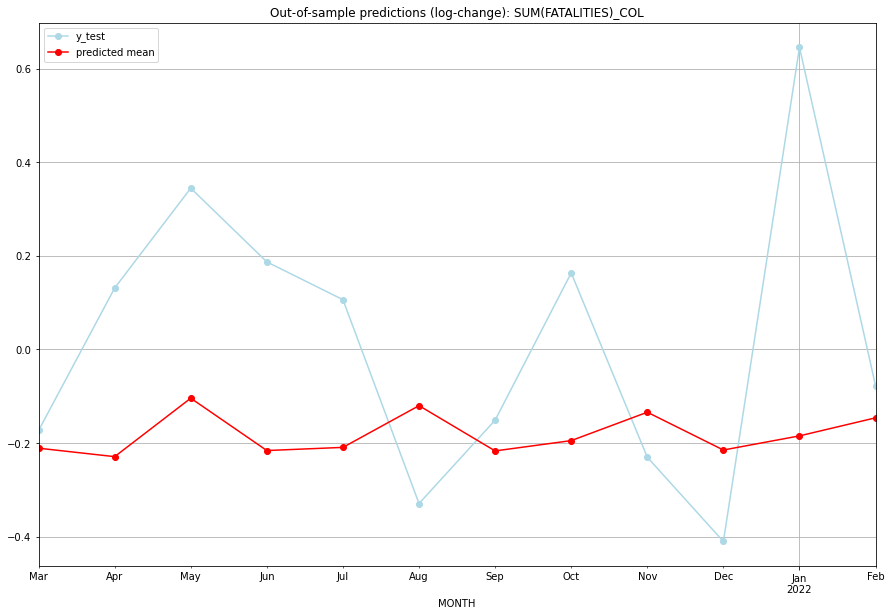

TADDA: 0.37707143385146097
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  85.654349        89.0     -0.210902       -0.173019   COL   
1  2021-04-01  84.104251       121.0     -0.228952        0.131192   COL   
2  2021-05-01  95.419200       150.0     -0.104123        0.344451   COL   
3  2021-06-01  85.223003       128.0     -0.215892        0.186984   COL   
4  2021-07-01  85.804736       118.0     -0.209168        0.106295   COL   
5  2021-08-01  93.899679        76.0     -0.120009       -0.329023   COL   
6  2021-09-01  85.154105        91.0     -0.216691       -0.151040   COL   
7  2021-10-01  87.069154       125.0     -0.194706        0.163453   COL   
8  2021-11-01  92.574931        84.0     -0.134066       -0.230178   COL   
9  2021-12-01  85.318848        70.0     -0.214781       -0.410149   COL   
10 2022-01-01  87.965707       203.0     -0.184578        0.645291   COL   
11 2022-02-01  91.461681        98.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.011552453009332421, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.057762265046662105]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_COM   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                 514.648
Date:                 Wed, 19 Oct 2022   AIC                          -1027.295
Time:                         10:33:54   BIC                          -1023.629
Sample:                     02-28-1997   HQIC                         -1025.826
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0017   1

<Figure size 432x288 with 0 Axes>

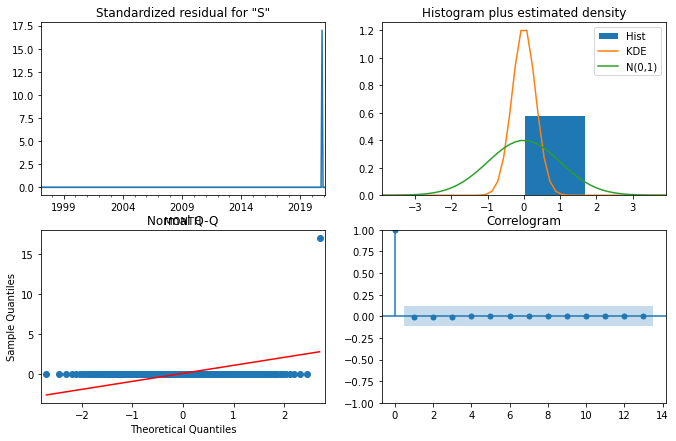

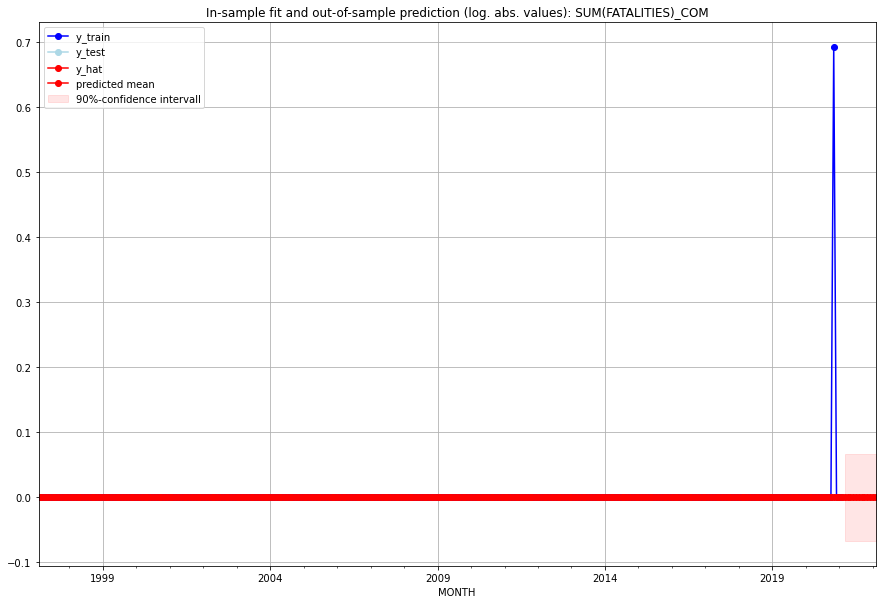

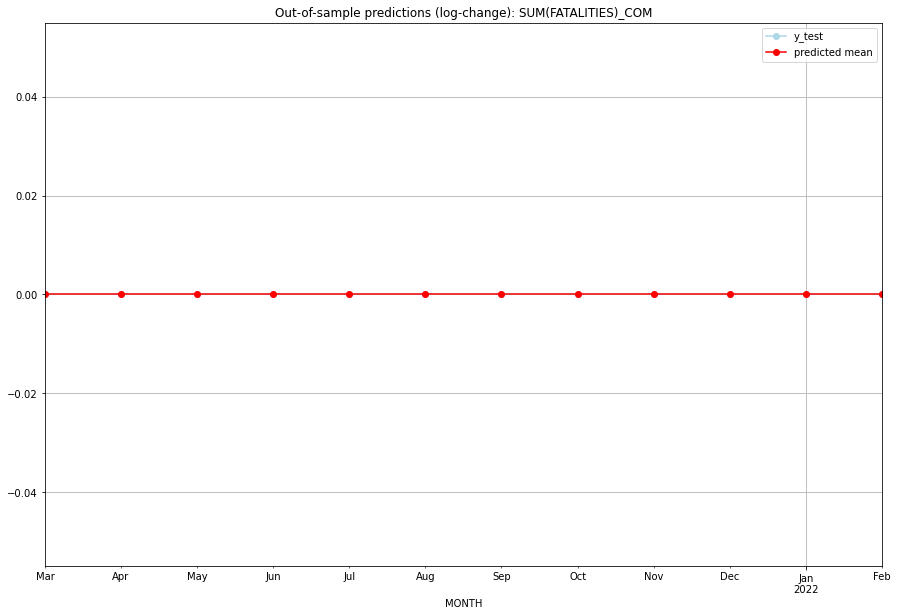

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   COM   
1  2021-04-01       0.0         0.0           0.0             0.0   COM   
2  2021-05-01       0.0         0.0           0.0             0.0   COM   
3  2021-06-01       0.0         0.0           0.0             0.0   COM   
4  2021-07-01       0.0         0.0           0.0             0.0   COM   
5  2021-08-01       0.0         0.0           0.0             0.0   COM   
6  2021-09-01       0.0         0.0           0.0             0.0   COM   
7  2021-10-01       0.0         0.0           0.0             0.0   COM   
8  2021-11-01       0.0         0.0           0.0             0.0   COM   
9  2021-12-01       0.0         0.0           0.0             0.0   COM   
10 2022-01-01       0.0         0.0           0.0             0.0   COM   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

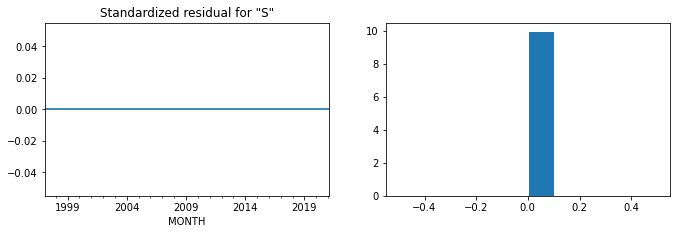

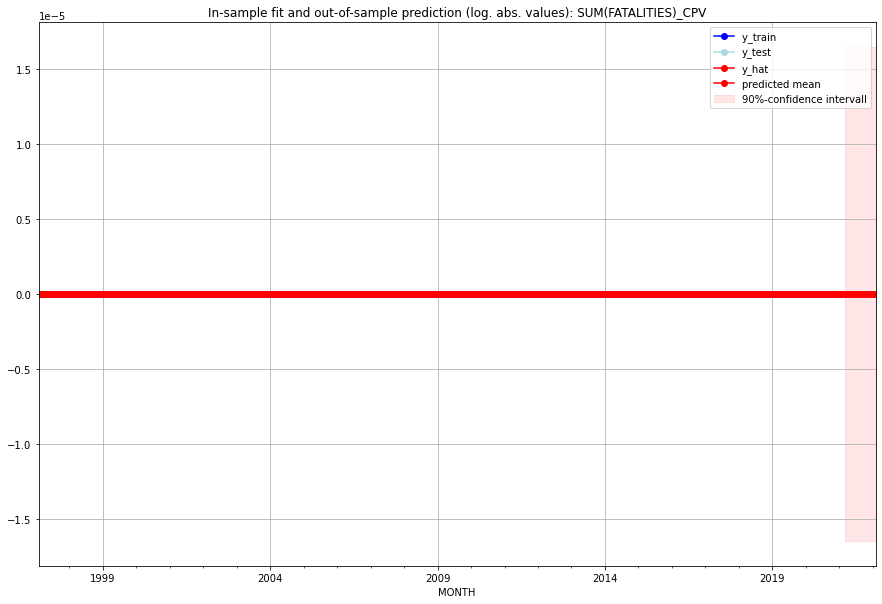

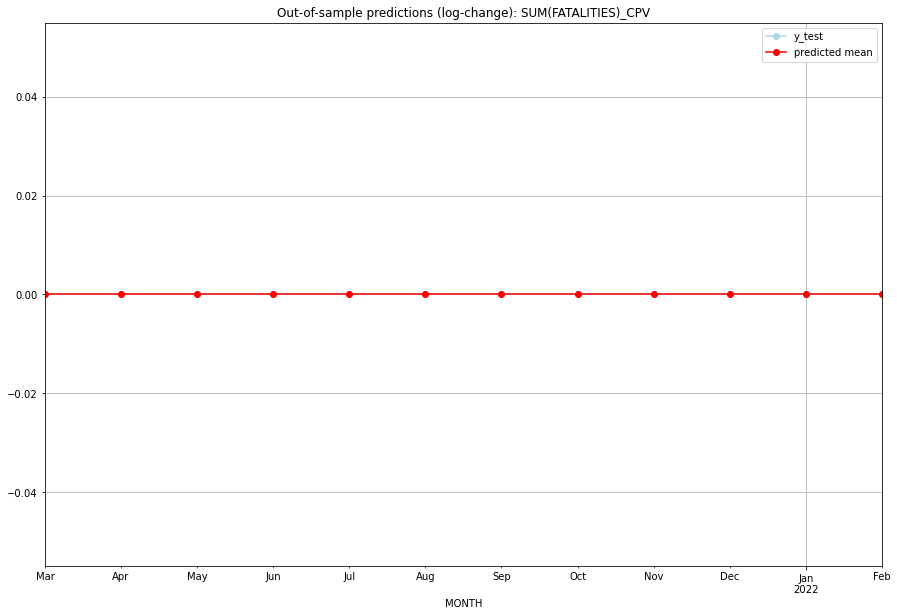

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   CPV   
1  2021-04-01       0.0         0.0           0.0             0.0   CPV   
2  2021-05-01       0.0         0.0           0.0             0.0   CPV   
3  2021-06-01       0.0         0.0           0.0             0.0   CPV   
4  2021-07-01       0.0         0.0           0.0             0.0   CPV   
5  2021-08-01       0.0         0.0           0.0             0.0   CPV   
6  2021-09-01       0.0         0.0           0.0             0.0   CPV   
7  2021-10-01       0.0         0.0           0.0             0.0   CPV   
8  2021-11-01       0.0         0.0           0.0             0.0   CPV   
9  2021-12-01       0.0         0.0           0.0             0.0   CPV   
10 2022-01-01       0.0         0.0           0.0             0.0   CPV   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.36340365233740324, 'fold_results': [0.4479398673070138, 0.2788674373677927]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CRI   No. Observations:                   38
Model:                SARIMAX(1, 0, 2)   Log Likelihood                 -25.446
Date:                 Wed, 19 Oct 2022   AIC                             64.892
Time:                         10:34:18   BIC                             76.355
Sample:                     01-31-2018   HQIC                            68.970
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0112      0

<Figure size 432x288 with 0 Axes>

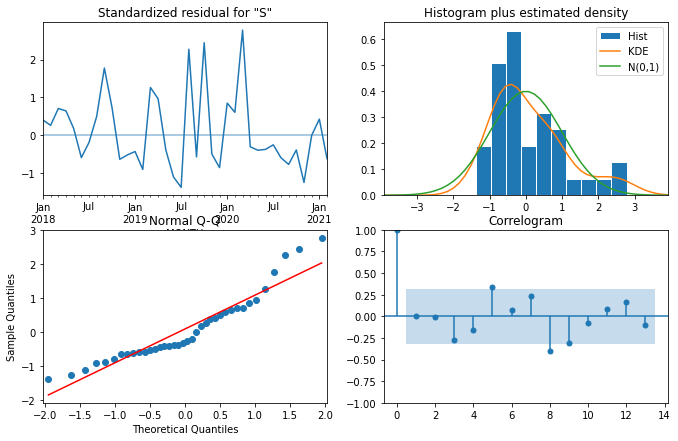

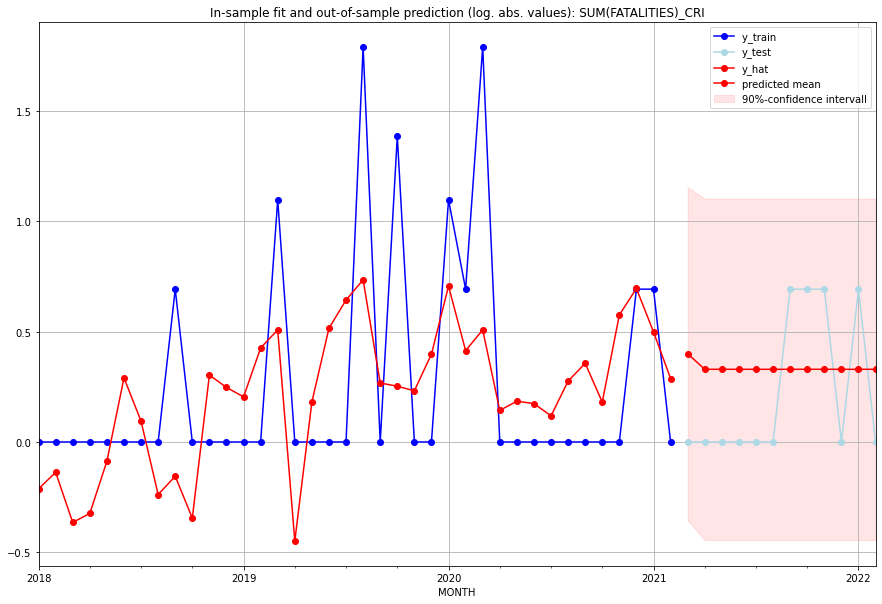

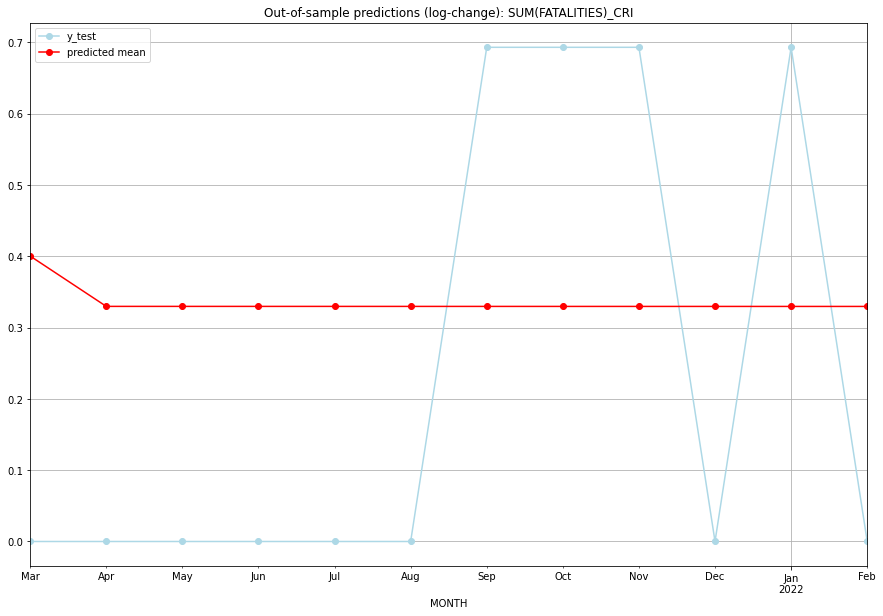

TADDA: 0.3468521477726303
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.492319         0.0      0.400331        0.000000   CRI   
1  2021-04-01  0.390650         0.0      0.329771        0.000000   CRI   
2  2021-05-01  0.390639         0.0      0.329763        0.000000   CRI   
3  2021-06-01  0.390628         0.0      0.329756        0.000000   CRI   
4  2021-07-01  0.390617         0.0      0.329748        0.000000   CRI   
5  2021-08-01  0.390607         0.0      0.329740        0.000000   CRI   
6  2021-09-01  0.390596         1.0      0.329732        0.693147   CRI   
7  2021-10-01  0.390585         1.0      0.329724        0.693147   CRI   
8  2021-11-01  0.390574         1.0      0.329717        0.693147   CRI   
9  2021-12-01  0.390563         0.0      0.329709        0.000000   CRI   
10 2022-01-01  0.390552         1.0      0.329701        0.693147   CRI   
11 2022-02-01  0.390542         0.0      0.329693    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.1613000421211621, 'fold_results': [0.11552453009332421, 0.20707555414900003]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_CUB   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  -6.478
Date:                 Wed, 19 Oct 2022   AIC                             14.955
Time:                         10:34:28   BIC                             16.593
Sample:                     01-31-2018   HQIC                            15.538
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0823      

<Figure size 432x288 with 0 Axes>

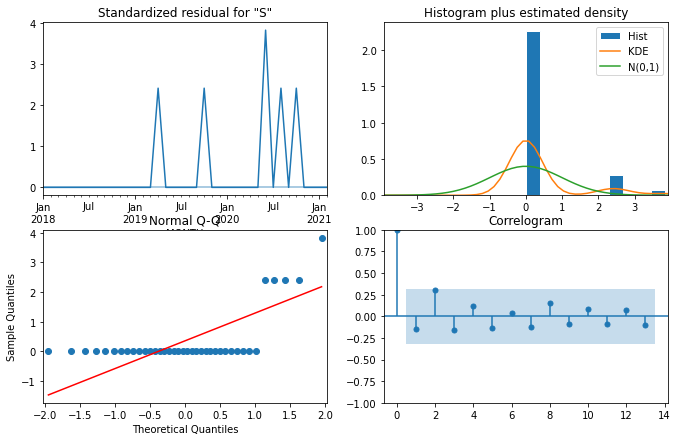

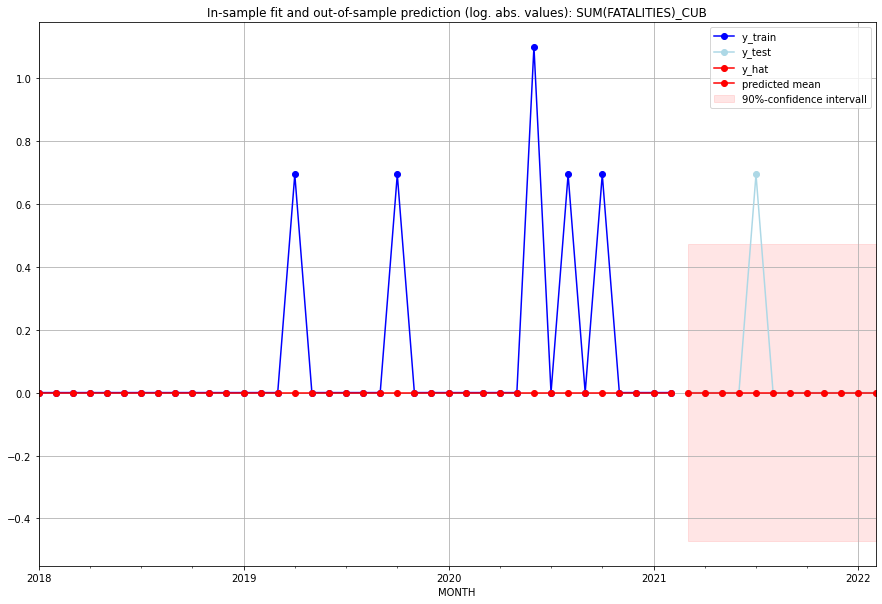

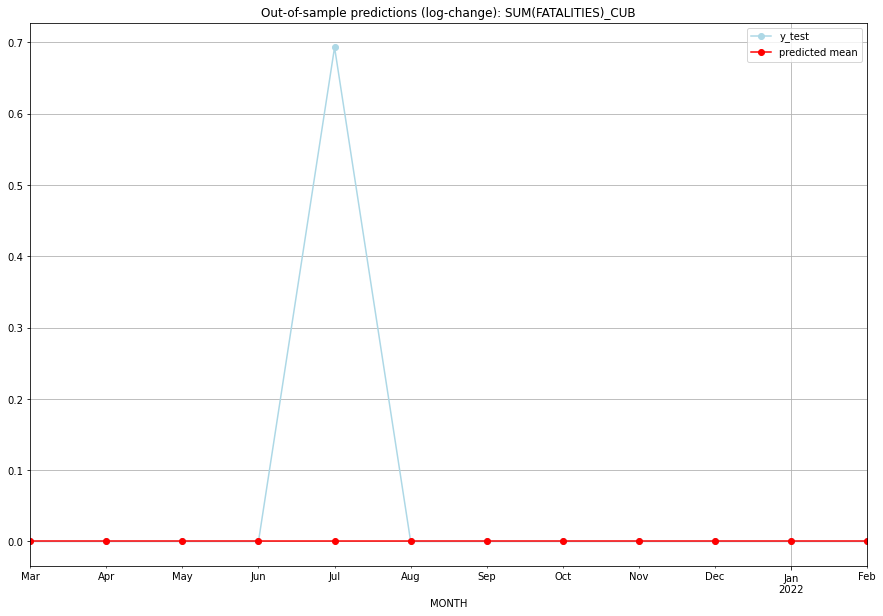

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   CUB   
1  2021-04-01       0.0         0.0           0.0        0.000000   CUB   
2  2021-05-01       0.0         0.0           0.0        0.000000   CUB   
3  2021-06-01       0.0         0.0           0.0        0.000000   CUB   
4  2021-07-01       0.0         1.0           0.0        0.693147   CUB   
5  2021-08-01       0.0         0.0           0.0        0.000000   CUB   
6  2021-09-01       0.0         0.0           0.0        0.000000   CUB   
7  2021-10-01       0.0         0.0           0.0        0.000000   CUB   
8  2021-11-01       0.0         0.0           0.0        0.000000   CUB   
9  2021-12-01       0.0         0.0           0.0        0.000000   CUB   
10 2022-01-01       0.0         0.0           0.0        0.000000   CUB   
11 2022-02-01       0.0         0.0           0.0  

<Figure size 432x288 with 0 Axes>

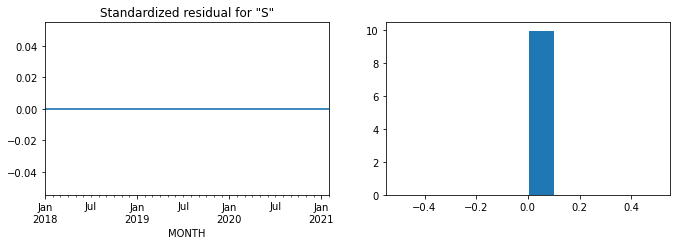

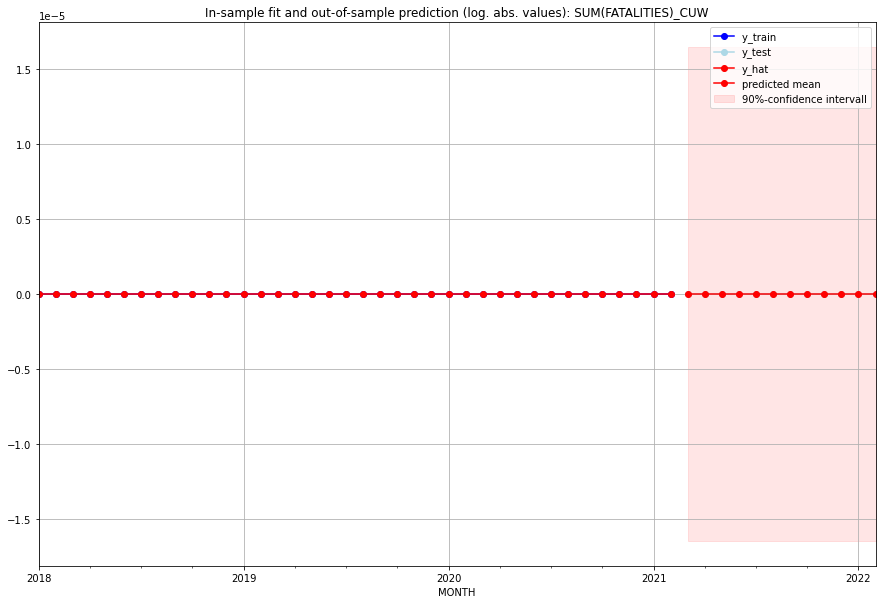

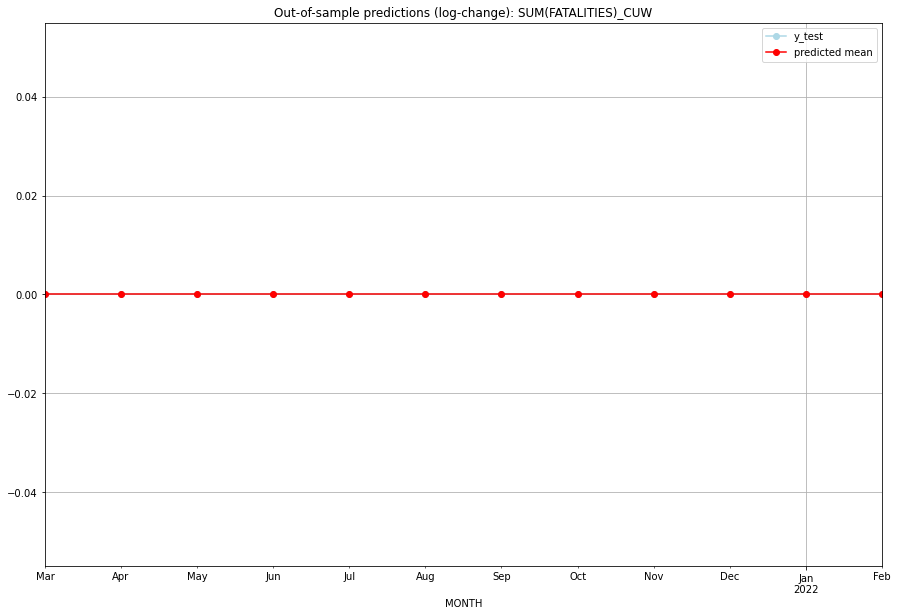

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   CUW   
1  2021-04-01       0.0         0.0           0.0             0.0   CUW   
2  2021-05-01       0.0         0.0           0.0             0.0   CUW   
3  2021-06-01       0.0         0.0           0.0             0.0   CUW   
4  2021-07-01       0.0         0.0           0.0             0.0   CUW   
5  2021-08-01       0.0         0.0           0.0             0.0   CUW   
6  2021-09-01       0.0         0.0           0.0             0.0   CUW   
7  2021-10-01       0.0         0.0           0.0             0.0   CUW   
8  2021-11-01       0.0         0.0           0.0             0.0   CUW   
9  2021-12-01       0.0         0.0           0.0             0.0   CUW   
10 2022-01-01       0.0         0.0           0.0             0.0   CUW   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

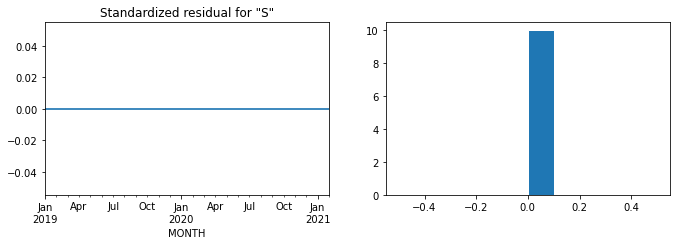

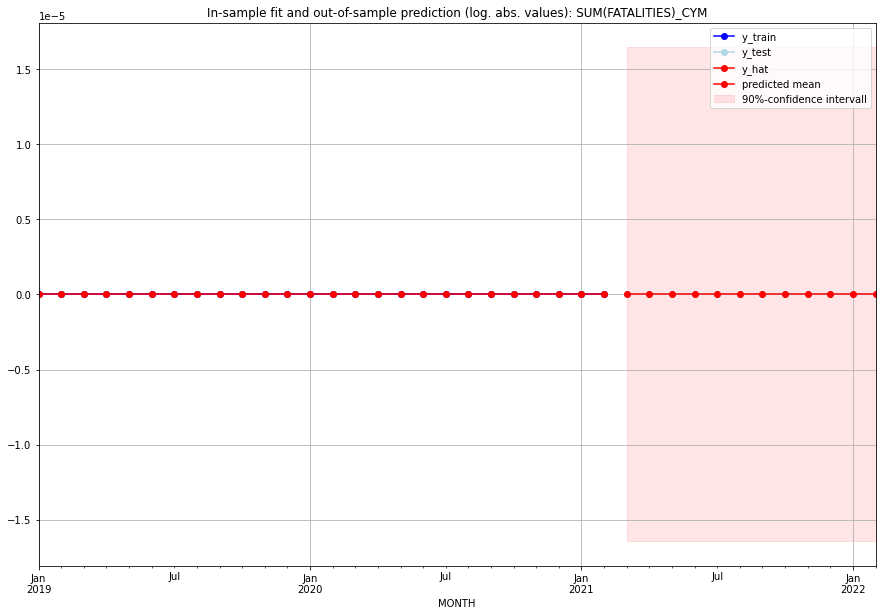

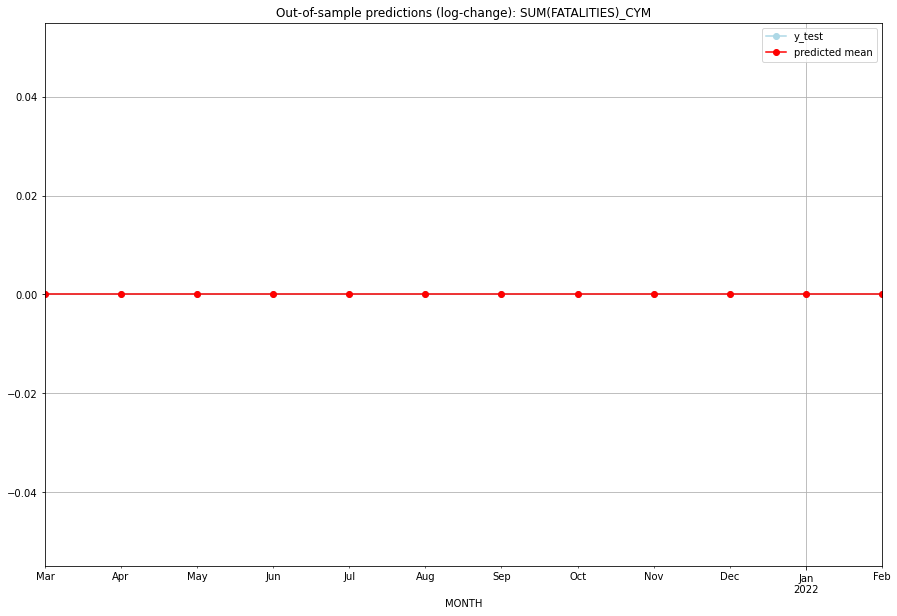

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   CYM   
1  2021-04-01       0.0         0.0           0.0             0.0   CYM   
2  2021-05-01       0.0         0.0           0.0             0.0   CYM   
3  2021-06-01       0.0         0.0           0.0             0.0   CYM   
4  2021-07-01       0.0         0.0           0.0             0.0   CYM   
5  2021-08-01       0.0         0.0           0.0             0.0   CYM   
6  2021-09-01       0.0         0.0           0.0             0.0   CYM   
7  2021-10-01       0.0         0.0           0.0             0.0   CYM   
8  2021-11-01       0.0         0.0           0.0             0.0   CYM   
9  2021-12-01       0.0         0.0           0.0             0.0   CYM   
10 2022-01-01       0.0         0.0           0.0             0.0   CYM   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

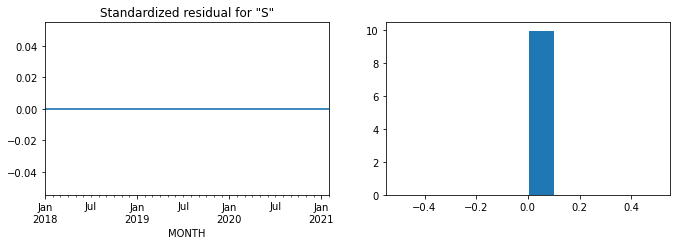

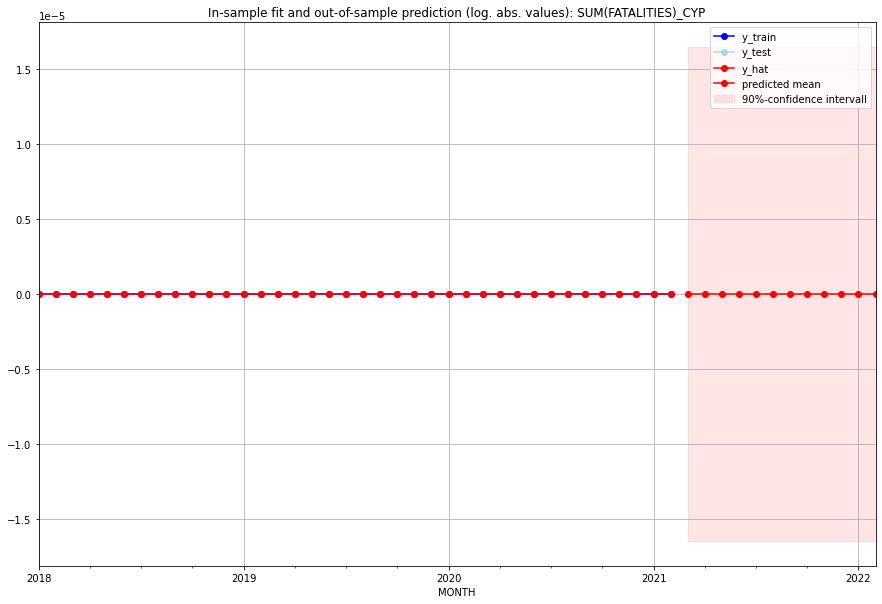

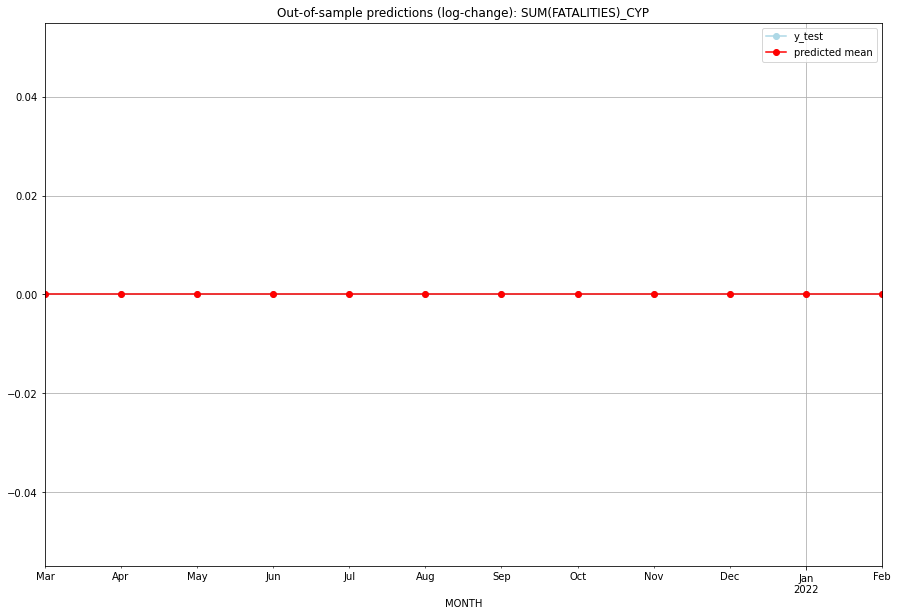

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   CYP   
1  2021-04-01       0.0         0.0           0.0             0.0   CYP   
2  2021-05-01       0.0         0.0           0.0             0.0   CYP   
3  2021-06-01       0.0         0.0           0.0             0.0   CYP   
4  2021-07-01       0.0         0.0           0.0             0.0   CYP   
5  2021-08-01       0.0         0.0           0.0             0.0   CYP   
6  2021-09-01       0.0         0.0           0.0             0.0   CYP   
7  2021-10-01       0.0         0.0           0.0             0.0   CYP   
8  2021-11-01       0.0         0.0           0.0             0.0   CYP   
9  2021-12-01       0.0         0.0           0.0             0.0   CYP   
10 2022-01-01       0.0         0.0           0.0             0.0   CYP   
11 2022-02-01       0.0         0.0           0.0             0.0   

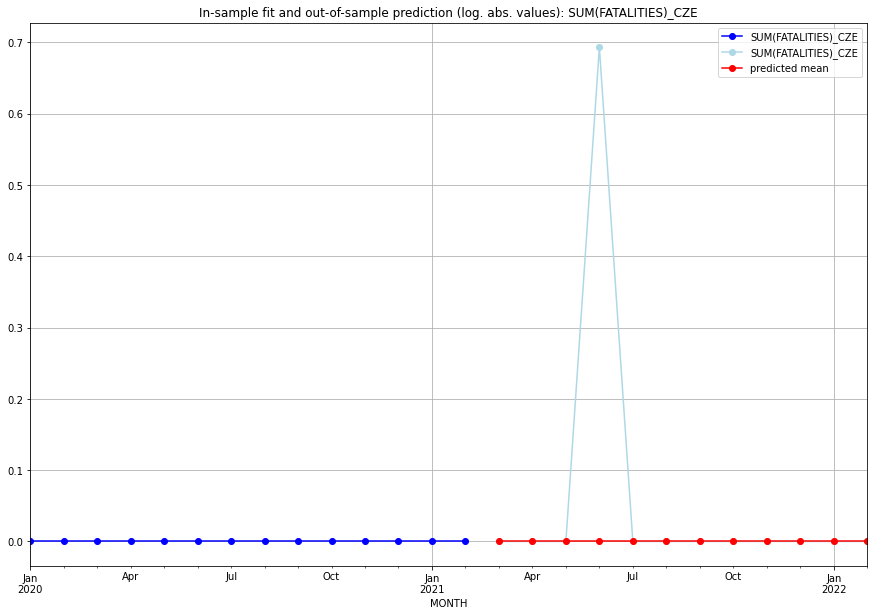

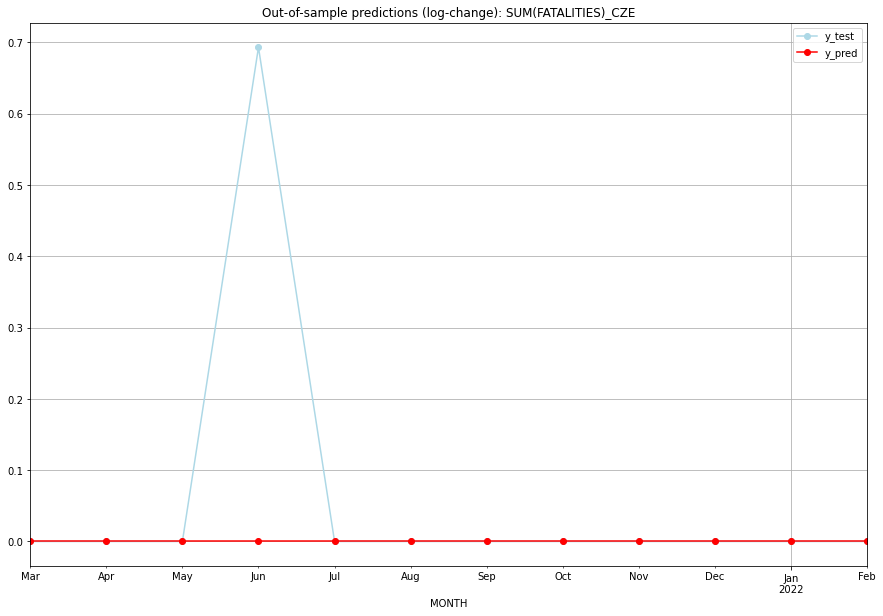

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   CZE   
1  2021-04-01       0.0    0.000000           0.0        0.000000   CZE   
2  2021-05-01       0.0    0.000000           0.0        0.000000   CZE   
3  2021-06-01       0.0    0.693147           0.0        0.693147   CZE   
4  2021-07-01       0.0    0.000000           0.0        0.000000   CZE   
5  2021-08-01       0.0    0.000000           0.0        0.000000   CZE   
6  2021-09-01       0.0    0.000000           0.0        0.000000   CZE   
7  2021-10-01       0.0    0.000000           0.0        0.000000   CZE   
8  2021-11-01       0.0    0.000000           0.0        0.000000   CZE   
9  2021-12-01       0.0    0.000000           0.0        0.000000   CZE   
10 2022-01-01       0.0    0.000000           0.0        0.000000   CZE   
11 2022-02-01       0.0    0.000000           0.0  

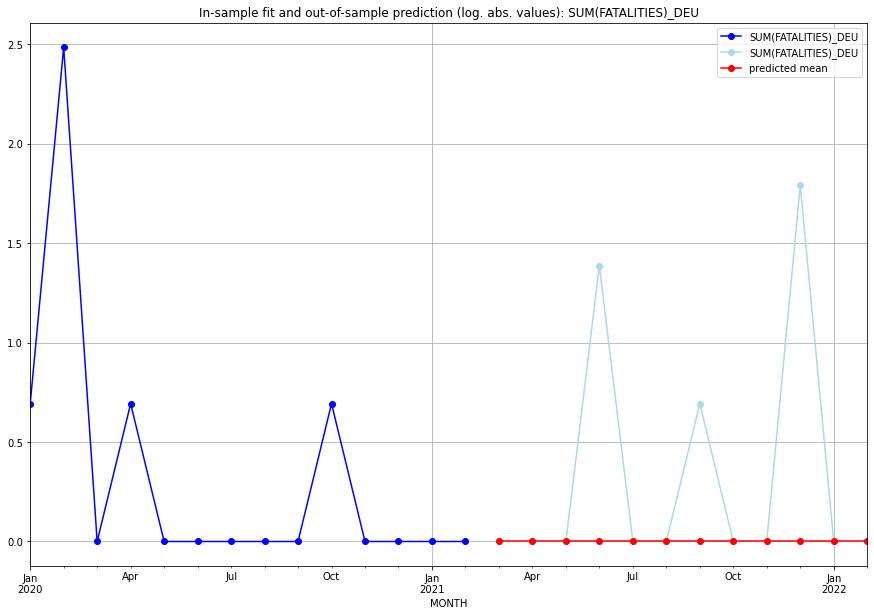

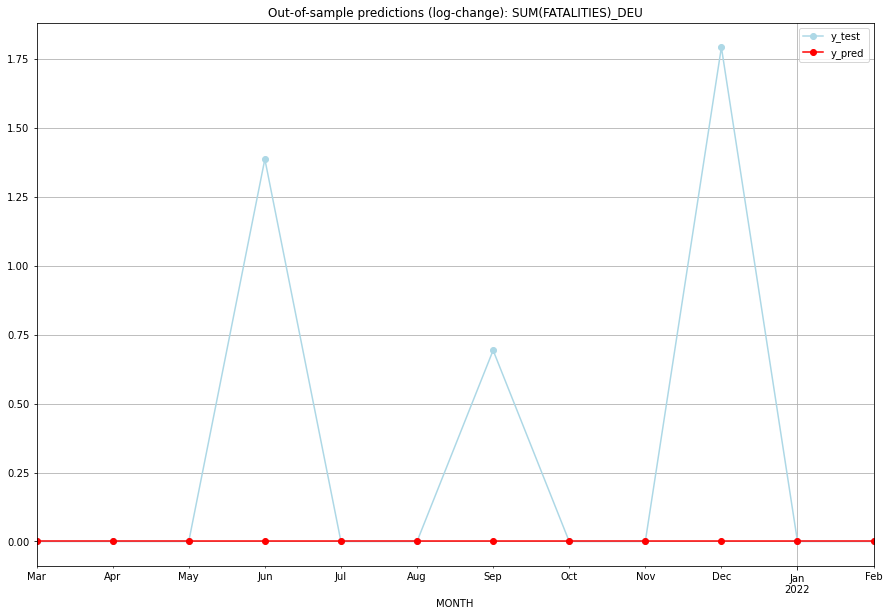

TADDA: 0.3226000842423242
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   DEU   
1  2021-04-01       0.0    0.000000           0.0        0.000000   DEU   
2  2021-05-01       0.0    0.000000           0.0        0.000000   DEU   
3  2021-06-01       0.0    1.386294           0.0        1.386294   DEU   
4  2021-07-01       0.0    0.000000           0.0        0.000000   DEU   
5  2021-08-01       0.0    0.000000           0.0        0.000000   DEU   
6  2021-09-01       0.0    0.693147           0.0        0.693147   DEU   
7  2021-10-01       0.0    0.000000           0.0        0.000000   DEU   
8  2021-11-01       0.0    0.000000           0.0        0.000000   DEU   
9  2021-12-01       0.0    1.791759           0.0        1.791759   DEU   
10 2022-01-01       0.0    0.000000           0.0        0.000000   DEU   
11 2022-02-01       0.0    0.000000           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.052967563839132425, 'fold_results': [0.0, 0.0, 0.0, 0.17328679513998632, 0.09155102405567582]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DJI   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -147.220
Date:                 Wed, 19 Oct 2022   AIC                            296.439
Time:                         10:35:34   BIC                            300.106
Sample:                     02-28-1997   HQIC                           297.909
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2    

<Figure size 432x288 with 0 Axes>

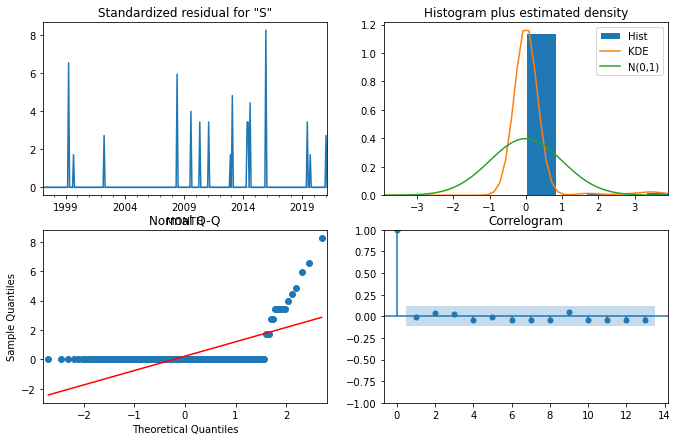

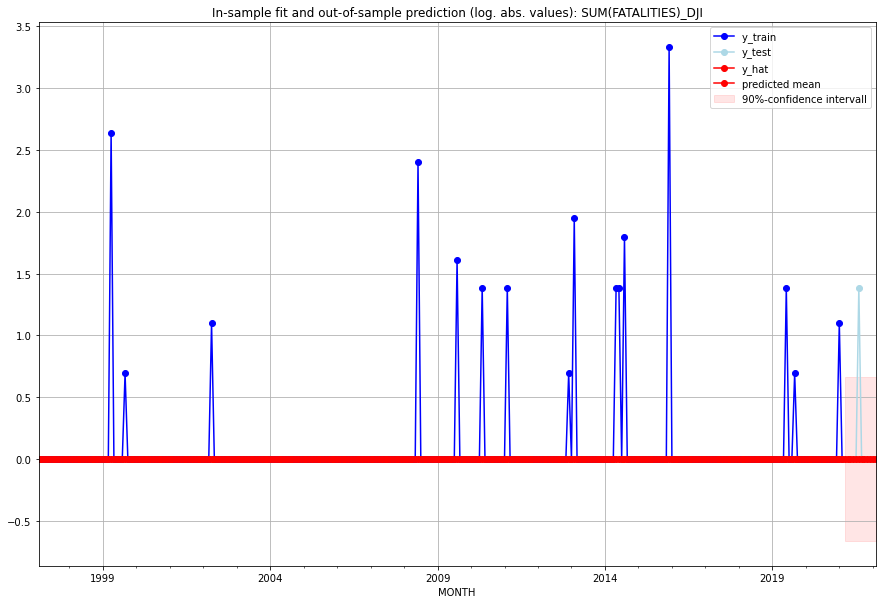

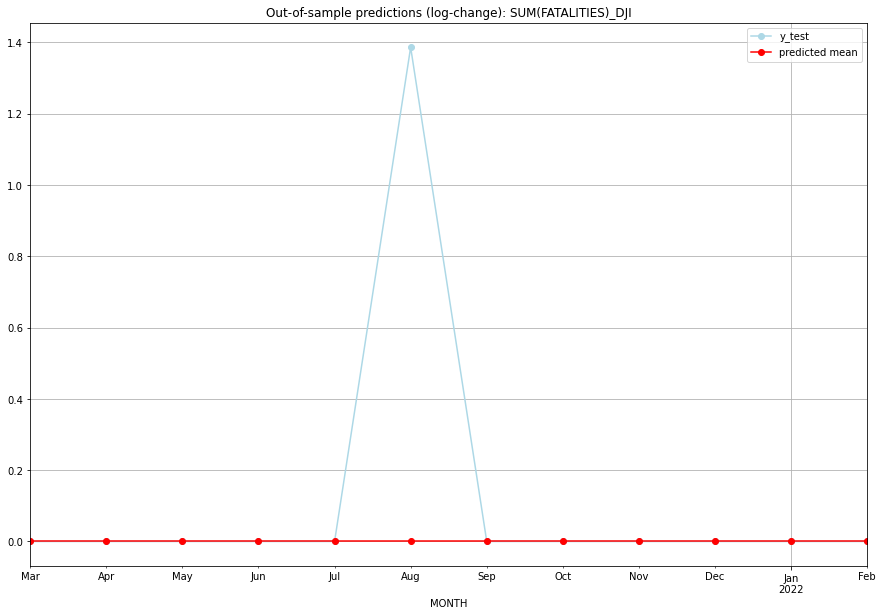

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   DJI   
1  2021-04-01       0.0         0.0           0.0        0.000000   DJI   
2  2021-05-01       0.0         0.0           0.0        0.000000   DJI   
3  2021-06-01       0.0         0.0           0.0        0.000000   DJI   
4  2021-07-01       0.0         0.0           0.0        0.000000   DJI   
5  2021-08-01       0.0         3.0           0.0        1.386294   DJI   
6  2021-09-01       0.0         0.0           0.0        0.000000   DJI   
7  2021-10-01       0.0         0.0           0.0        0.000000   DJI   
8  2021-11-01       0.0         0.0           0.0        0.000000   DJI   
9  2021-12-01       0.0         0.0           0.0        0.000000   DJI   
10 2022-01-01       0.0         0.0           0.0        0.000000   DJI   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.027790674932604443, 'fold_results': [nan, 0.027790674932604443]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DMA   No. Observations:                   38
Model:                SARIMAX(1, 1, 3)   Log Likelihood                  26.537
Date:                 Wed, 19 Oct 2022   AIC                            -43.074
Time:                         10:35:47   BIC                            -35.019
Sample:                     01-31-2018   HQIC                           -40.234
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9469    246.344     -0.

<Figure size 432x288 with 0 Axes>

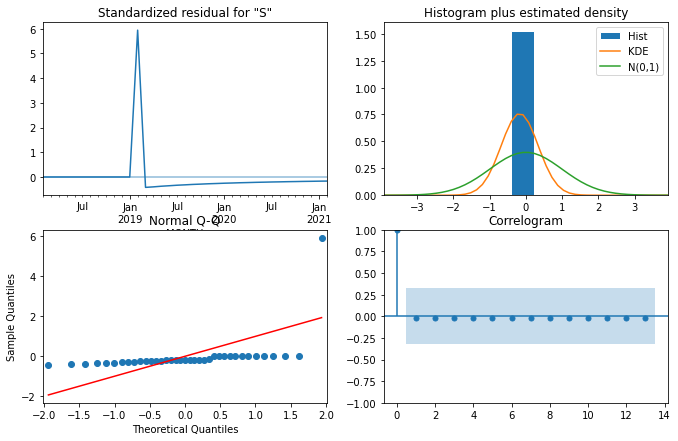

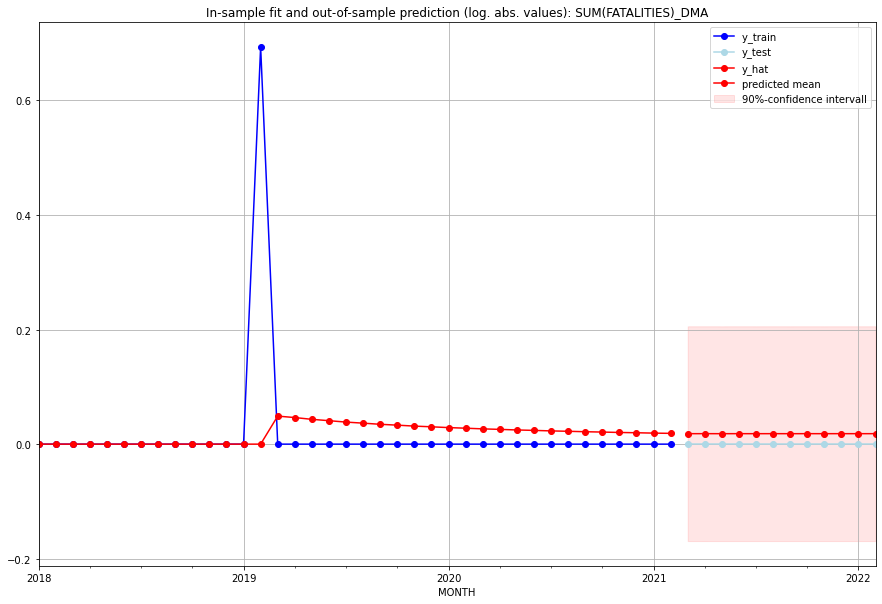

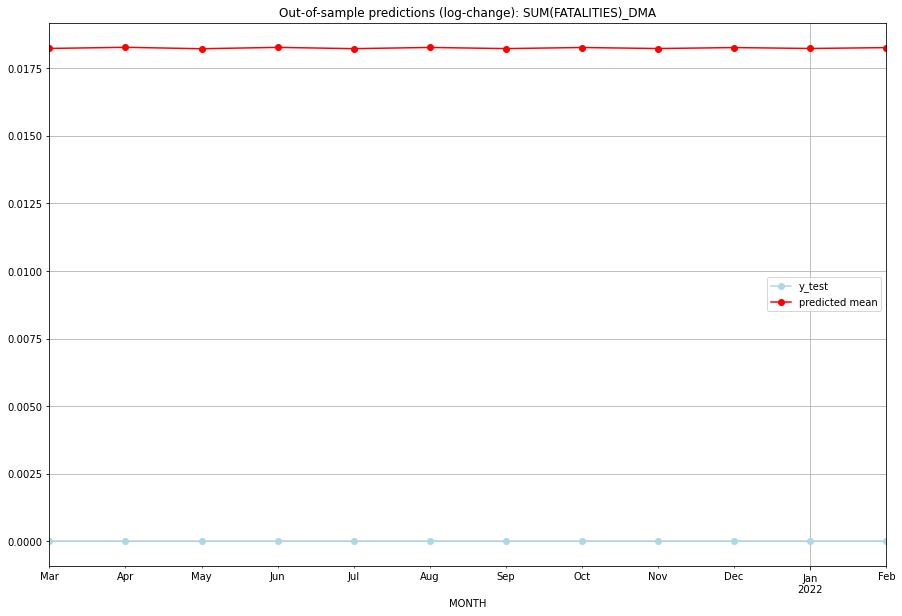

TADDA: 0.01823838932868509
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.018390         0.0      0.018223             0.0   DMA   
1  2021-04-01  0.018432         0.0      0.018265             0.0   DMA   
2  2021-05-01  0.018379         0.0      0.018212             0.0   DMA   
3  2021-06-01  0.018430         0.0      0.018262             0.0   DMA   
4  2021-07-01  0.018382         0.0      0.018215             0.0   DMA   
5  2021-08-01  0.018427         0.0      0.018259             0.0   DMA   
6  2021-09-01  0.018384         0.0      0.018217             0.0   DMA   
7  2021-10-01  0.018425         0.0      0.018257             0.0   DMA   
8  2021-11-01  0.018387         0.0      0.018220             0.0   DMA   
9  2021-12-01  0.018423         0.0      0.018255             0.0   DMA   
10 2022-01-01  0.018388         0.0      0.018221             0.0   DMA   
11 2022-02-01  0.018421         0.0      0.018253   

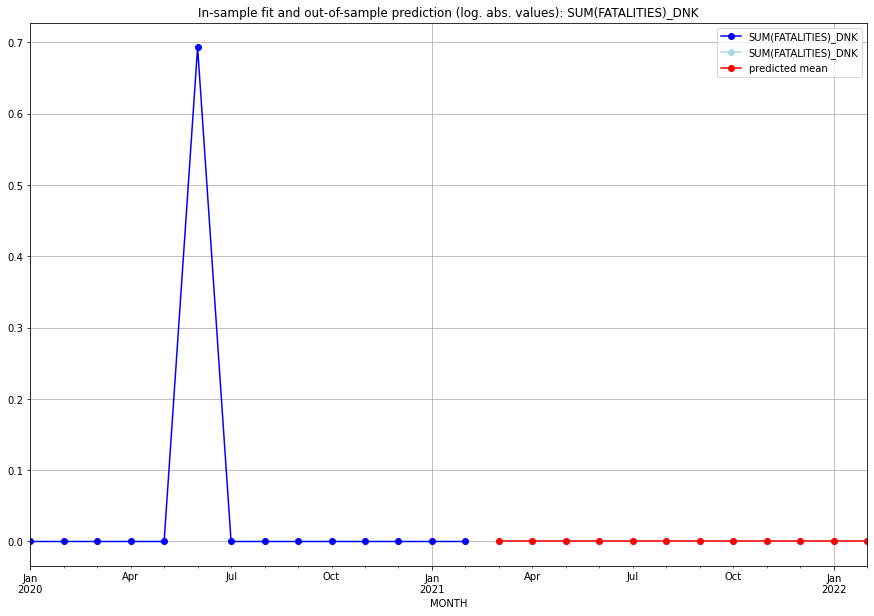

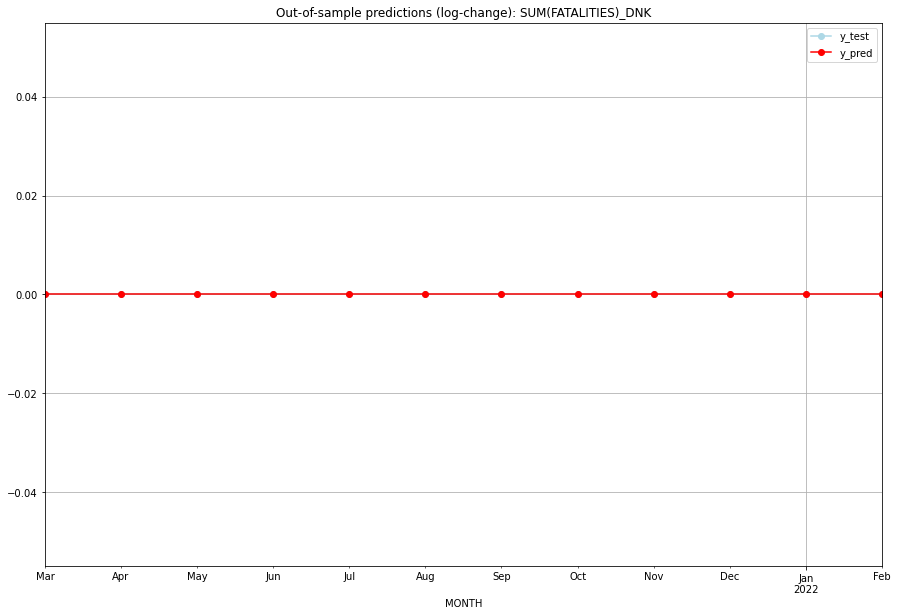

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   DNK   
1  2021-04-01       0.0         0.0           0.0             0.0   DNK   
2  2021-05-01       0.0         0.0           0.0             0.0   DNK   
3  2021-06-01       0.0         0.0           0.0             0.0   DNK   
4  2021-07-01       0.0         0.0           0.0             0.0   DNK   
5  2021-08-01       0.0         0.0           0.0             0.0   DNK   
6  2021-09-01       0.0         0.0           0.0             0.0   DNK   
7  2021-10-01       0.0         0.0           0.0             0.0   DNK   
8  2021-11-01       0.0         0.0           0.0             0.0   DNK   
9  2021-12-01       0.0         0.0           0.0             0.0   DNK   
10 2022-01-01       0.0         0.0           0.0             0.0   DNK   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.4172600897284202, 'fold_results': [0.693976624695853, 0.14054355476098743]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DOM   No. Observations:                   38
Model:                SARIMAX(0, 0, 3)   Log Likelihood                 -36.211
Date:                 Wed, 19 Oct 2022   AIC                             84.421
Time:                         10:36:06   BIC                             94.247
Sample:                     01-31-2018   HQIC                            87.917
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0112      0.

<Figure size 432x288 with 0 Axes>

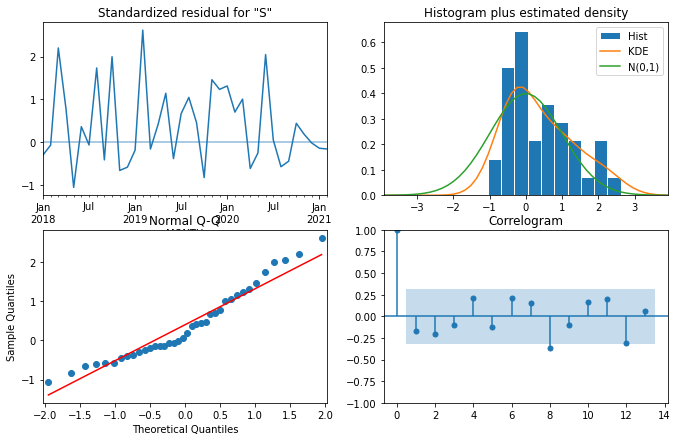

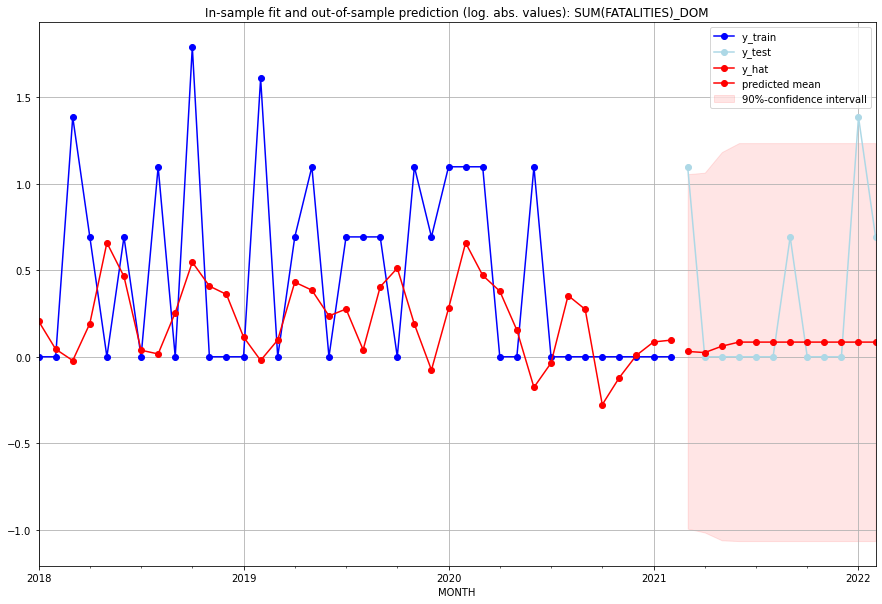

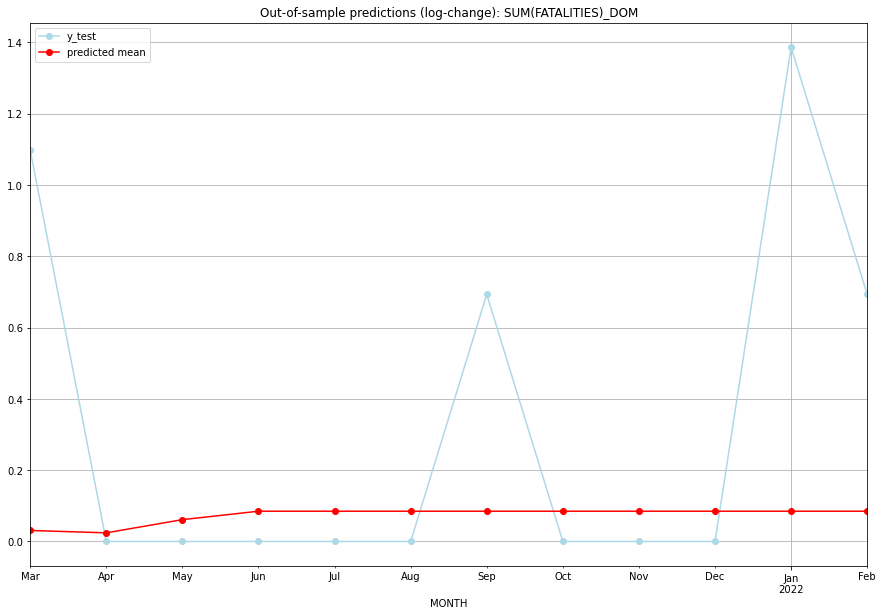

TADDA: 0.34838671404828125
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.031412         2.0      0.030929        1.098612   DOM   
1  2021-04-01  0.024589         0.0      0.024292        0.000000   DOM   
2  2021-05-01  0.063189         0.0      0.061273        0.000000   DOM   
3  2021-06-01  0.088646         0.0      0.084935        0.000000   DOM   
4  2021-07-01  0.088646         0.0      0.084935        0.000000   DOM   
5  2021-08-01  0.088646         0.0      0.084935        0.000000   DOM   
6  2021-09-01  0.088646         1.0      0.084935        0.693147   DOM   
7  2021-10-01  0.088646         0.0      0.084935        0.000000   DOM   
8  2021-11-01  0.088646         0.0      0.084935        0.000000   DOM   
9  2021-12-01  0.088646         0.0      0.084935        0.000000   DOM   
10 2022-01-01  0.088646         3.0      0.084935        1.386294   DOM   
11 2022-02-01  0.088646         1.0      0.084935   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.8532860730591969, 'fold_results': [0.8033724550243934, 0.5721349253933449, 0.8768273439209288, 1.0996013759671908, 0.9144942649901263]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_DZA   No. Observations:                  289
Model:                SARIMAX(3, 0, 1)   Log Likelihood                -438.151
Date:                 Wed, 19 Oct 2022   AIC                            892.302
Time:                         10:36:47   BIC                            921.633
Sample:                     02-28-1997   HQIC                           904.055
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

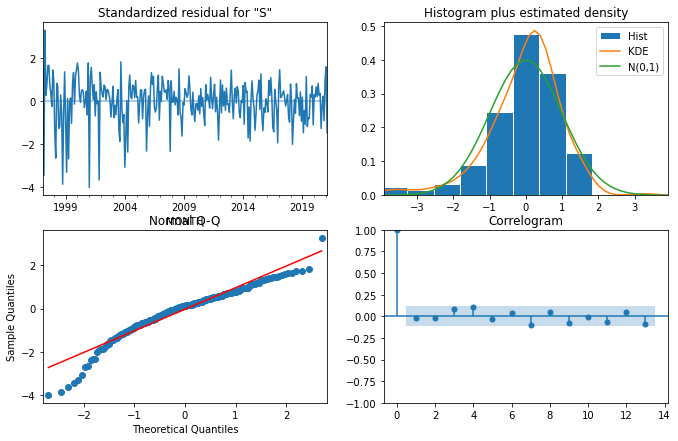

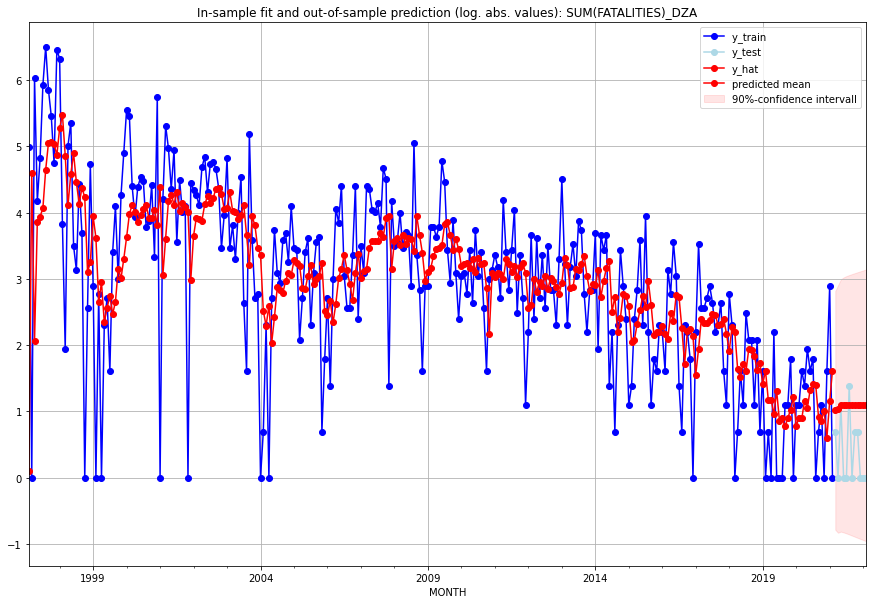

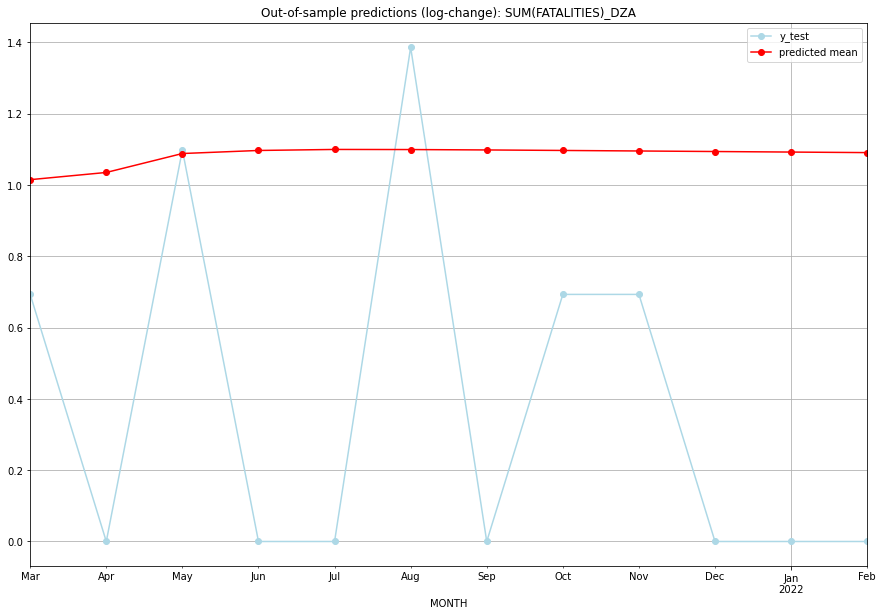

TADDA: 0.7527228491189465
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.759384         1.0      1.015008        0.693147   DZA   
1  2021-04-01  1.815715         0.0      1.035216        0.000000   DZA   
2  2021-05-01  1.969357         2.0      1.088345        1.098612   DZA   
3  2021-06-01  1.994885         0.0      1.096906        0.000000   DZA   
4  2021-07-01  2.003502         0.0      1.099779        0.000000   DZA   
5  2021-08-01  2.002594         3.0      1.099477        1.386294   DZA   
6  2021-09-01  1.999263         0.0      1.098367        0.000000   DZA   
7  2021-10-01  1.995064         1.0      1.096966        0.693147   DZA   
8  2021-11-01  1.990610         1.0      1.095477        0.693147   DZA   
9  2021-12-01  1.986080         0.0      1.093961        0.000000   DZA   
10 2022-01-01  1.981535         0.0      1.092438        0.000000   DZA   
11 2022-02-01  1.976993         0.0      1.090914    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.5268238288718475, 'fold_results': [0.40916929865351986, 0.6444783590901751]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ECU   No. Observations:                   38
Model:                SARIMAX(3, 1, 2)   Log Likelihood                 -41.036
Date:                 Wed, 19 Oct 2022   AIC                             96.072
Time:                         10:36:57   BIC                            107.348
Sample:                     01-31-2018   HQIC                           100.047
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0478      0

<Figure size 432x288 with 0 Axes>

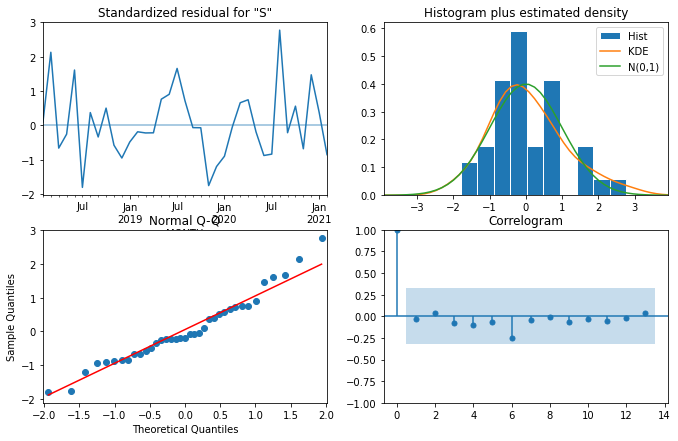

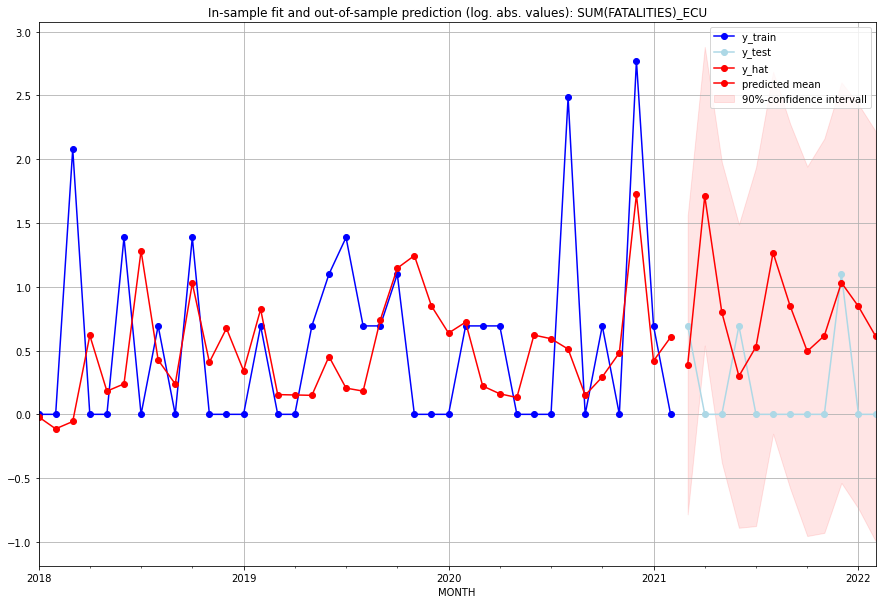

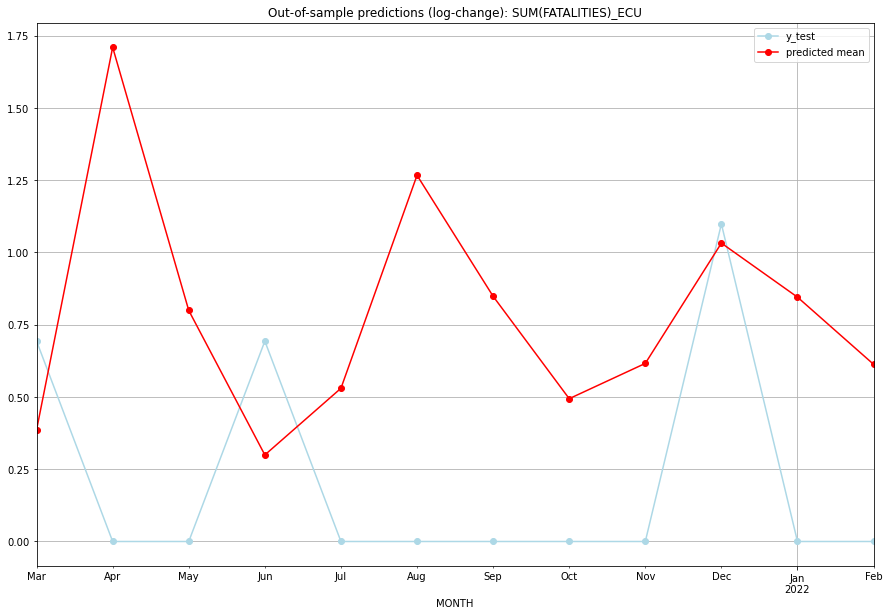

TADDA: 0.7074692851997857
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.471471         1.0      0.386263        0.693147   ECU   
1  2021-04-01  4.527267         0.0      1.709694        0.000000   ECU   
2  2021-05-01  1.223993         0.0      0.799304        0.000000   ECU   
3  2021-06-01  0.349118         1.0      0.299451        0.693147   ECU   
4  2021-07-01  0.698991         0.0      0.530035        0.000000   ECU   
5  2021-08-01  2.549549         0.0      1.266820        0.000000   ECU   
6  2021-09-01  1.335753         0.0      0.848334        0.000000   ECU   
7  2021-10-01  0.638995         0.0      0.494084        0.000000   ECU   
8  2021-11-01  0.851765         0.0      0.616139        0.000000   ECU   
9  2021-12-01  1.807422         2.0      1.032266        1.098612   ECU   
10 2022-01-01  1.328741         0.0      0.845328        0.000000   ECU   
11 2022-02-01  0.845899         0.0      0.612967    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.4179863841013226, 'fold_results': [0.3751261111056627, 0.5579973519687146, 0.5093783637622328, 0.3501880578531647, 0.2972420358168384]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_EGY   No. Observations:                  289
Model:                SARIMAX(1, 0, 1)   Log Likelihood                -405.000
Date:                 Wed, 19 Oct 2022   AIC                            820.000
Time:                         10:37:30   BIC                            838.332
Sample:                     02-28-1997   HQIC                           827.346
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

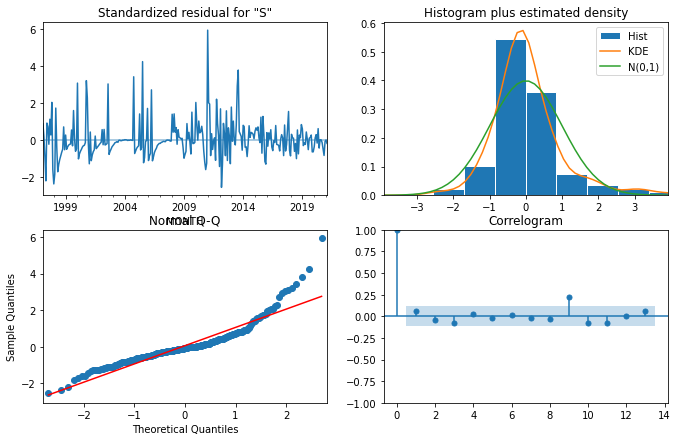

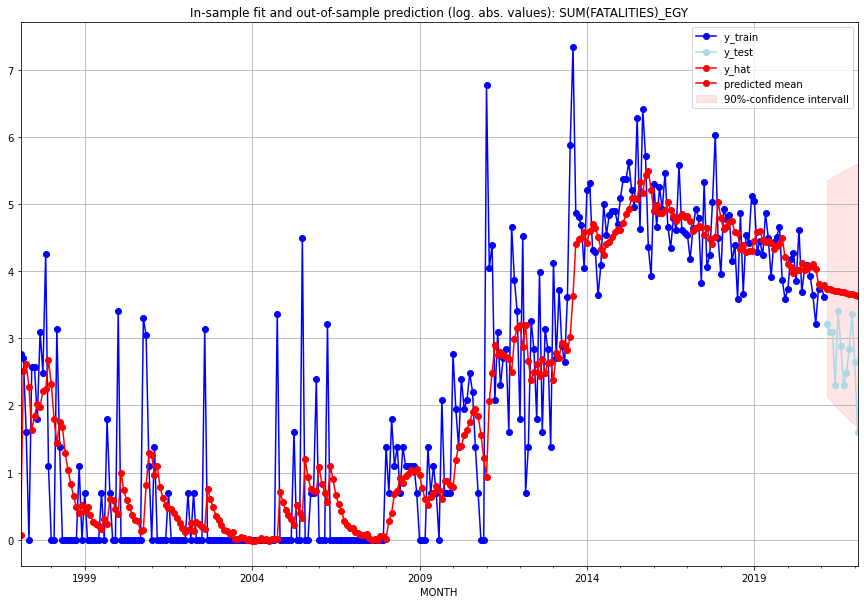

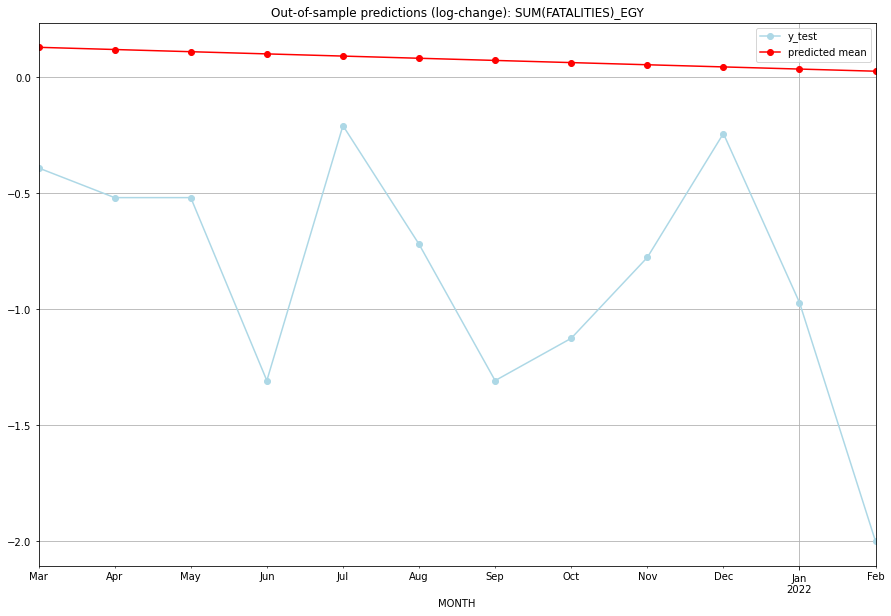

TADDA: 0.9937220642937366
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  41.042165        24.0      0.127755       -0.392042   EGY   
1  2021-04-01  40.645420        21.0      0.118273       -0.519875   EGY   
2  2021-05-01  40.253430        21.0      0.108816       -0.519875   EGY   
3  2021-06-01  39.866128         9.0      0.099384       -1.308333   EGY   
4  2021-07-01  39.483448        29.0      0.089975       -0.209721   EGY   
5  2021-08-01  39.105326        17.0      0.080591       -0.720546   EGY   
6  2021-09-01  38.731699         9.0      0.071231       -1.308333   EGY   
7  2021-10-01  38.362505        11.0      0.061896       -1.126011   EGY   
8  2021-11-01  37.997681        16.0      0.052584       -0.777705   EGY   
9  2021-12-01  37.637168        28.0      0.043297       -0.243622   EGY   
10 2022-01-01  37.280905        13.0      0.034033       -0.971861   EGY   
11 2022-02-01  36.928836         4.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.2314252353088817, 'fold_results': [0.8922883573487465, 0.057762265046662105, 0.1493132891023379, 0.0, 0.057762265046662105]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ERI   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -551.707
Date:                 Wed, 19 Oct 2022   AIC                           1105.415
Time:                         10:37:53   BIC                           1109.081
Sample:                     02-28-1997   HQIC                          1106.884
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------

<Figure size 432x288 with 0 Axes>

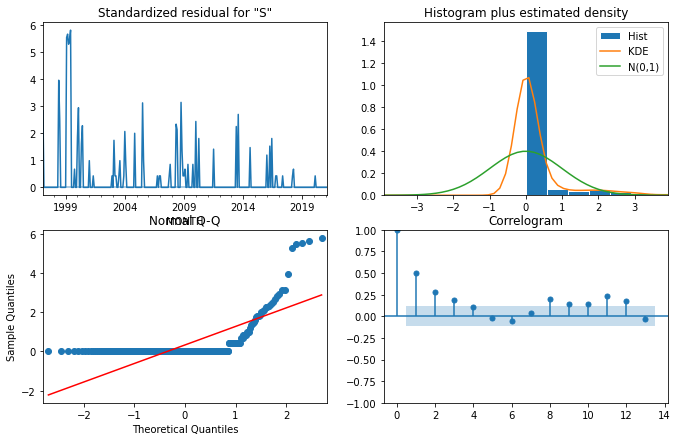

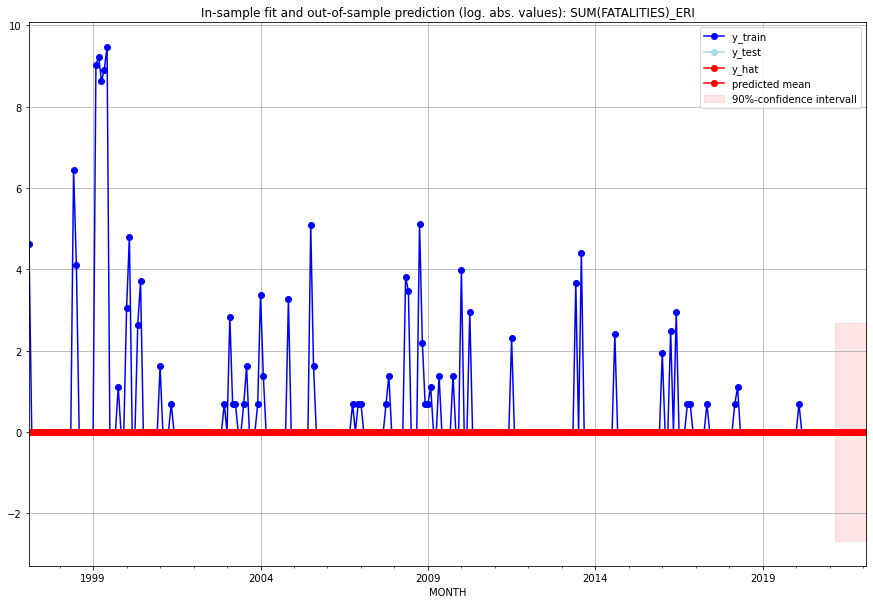

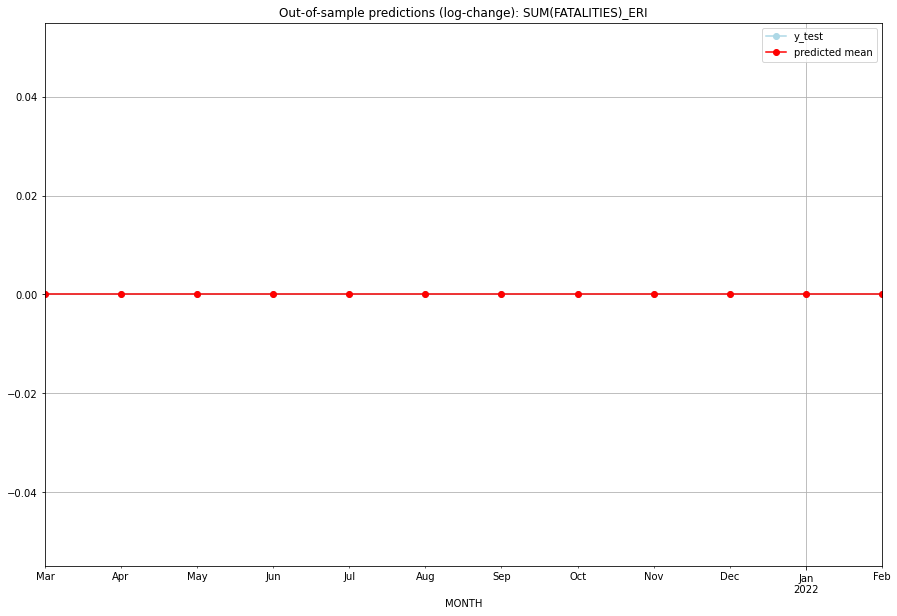

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ERI   
1  2021-04-01       0.0         0.0           0.0             0.0   ERI   
2  2021-05-01       0.0         0.0           0.0             0.0   ERI   
3  2021-06-01       0.0         0.0           0.0             0.0   ERI   
4  2021-07-01       0.0         0.0           0.0             0.0   ERI   
5  2021-08-01       0.0         0.0           0.0             0.0   ERI   
6  2021-09-01       0.0         0.0           0.0             0.0   ERI   
7  2021-10-01       0.0         0.0           0.0             0.0   ERI   
8  2021-11-01       0.0         0.0           0.0             0.0   ERI   
9  2021-12-01       0.0         0.0           0.0             0.0   ERI   
10 2022-01-01       0.0         0.0           0.0             0.0   ERI   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.09917737587646211, 'fold_results': [0.17328679513998632, 0.0, 0.0, 0.1493132891023379, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ESH   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                 -66.106
Date:                 Wed, 19 Oct 2022   AIC                            134.211
Time:                         10:38:23   BIC                            137.878
Sample:                     02-28-1997   HQIC                           135.680
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

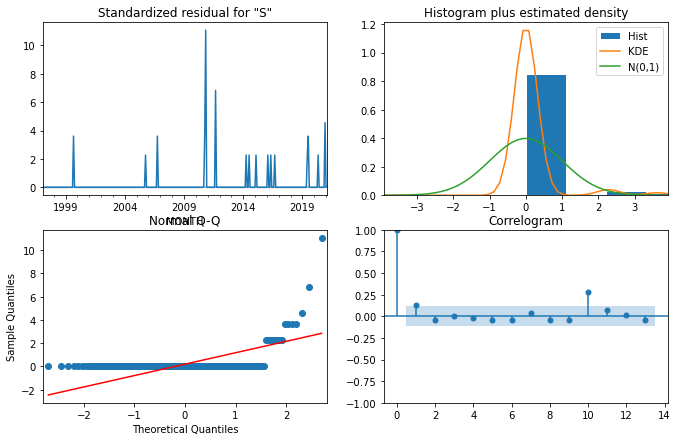

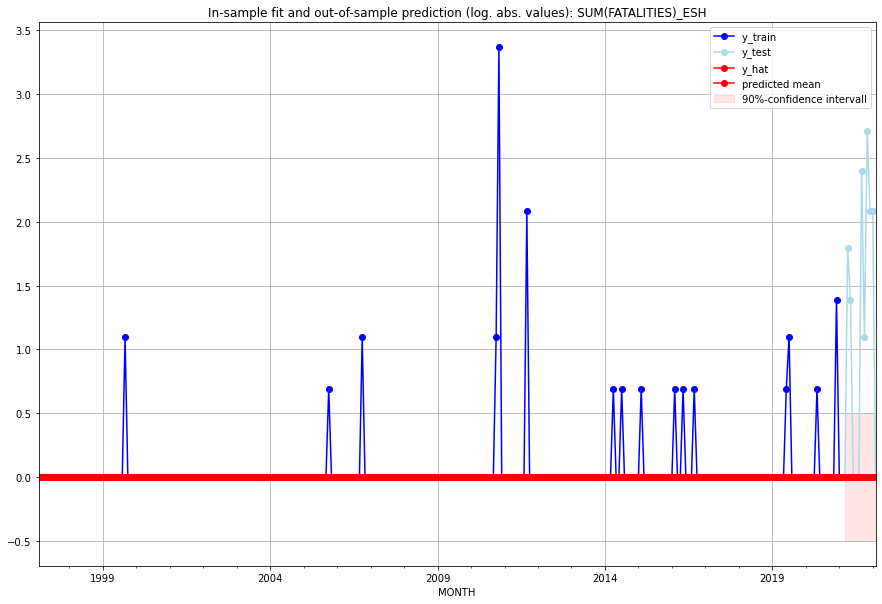

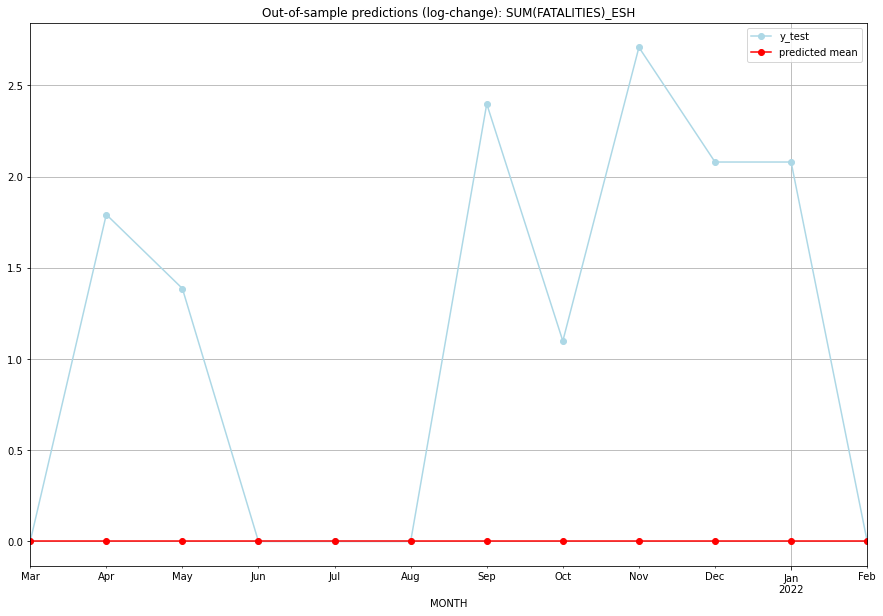

TADDA: 1.1284578896896924
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   ESH   
1  2021-04-01       0.0         5.0           0.0        1.791759   ESH   
2  2021-05-01       0.0         3.0           0.0        1.386294   ESH   
3  2021-06-01       0.0         0.0           0.0        0.000000   ESH   
4  2021-07-01       0.0         0.0           0.0        0.000000   ESH   
5  2021-08-01       0.0         0.0           0.0        0.000000   ESH   
6  2021-09-01       0.0        10.0           0.0        2.397895   ESH   
7  2021-10-01       0.0         2.0           0.0        1.098612   ESH   
8  2021-11-01       0.0        14.0           0.0        2.708050   ESH   
9  2021-12-01       0.0         7.0           0.0        2.079442   ESH   
10 2022-01-01       0.0         7.0           0.0        2.079442   ESH   
11 2022-02-01       0.0         0.0           0.0    

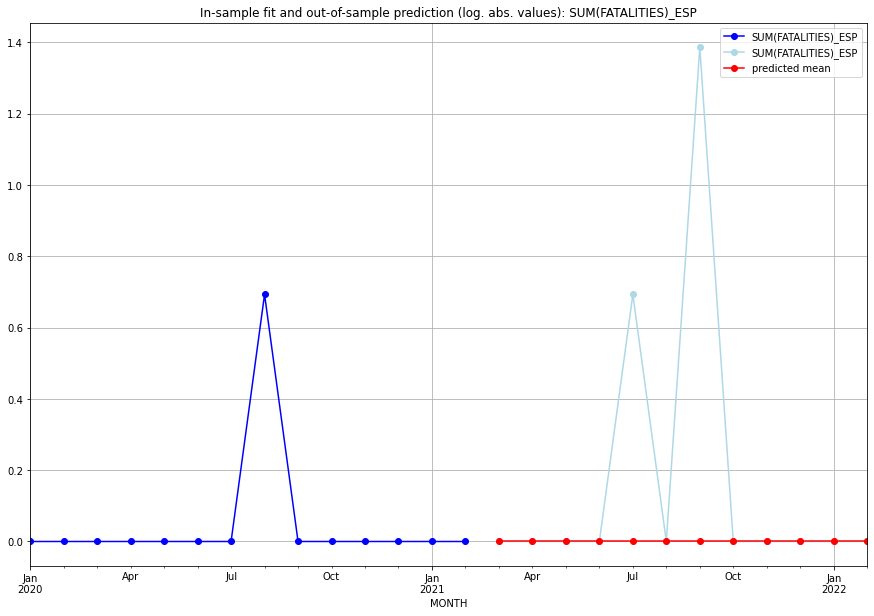

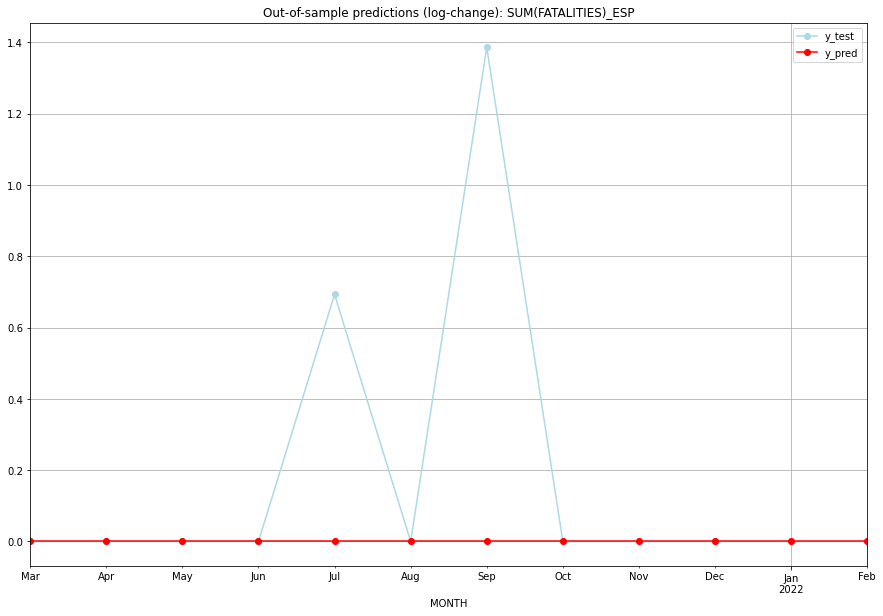

TADDA: 0.17328679513998632
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   ESP   
1  2021-04-01       0.0    0.000000           0.0        0.000000   ESP   
2  2021-05-01       0.0    0.000000           0.0        0.000000   ESP   
3  2021-06-01       0.0    0.000000           0.0        0.000000   ESP   
4  2021-07-01       0.0    0.693147           0.0        0.693147   ESP   
5  2021-08-01       0.0    0.000000           0.0        0.000000   ESP   
6  2021-09-01       0.0    1.386294           0.0        1.386294   ESP   
7  2021-10-01       0.0    0.000000           0.0        0.000000   ESP   
8  2021-11-01       0.0    0.000000           0.0        0.000000   ESP   
9  2021-12-01       0.0    0.000000           0.0        0.000000   ESP   
10 2022-01-01       0.0    0.000000           0.0        0.000000   ESP   
11 2022-02-01       0.0    0.000000           0.0   

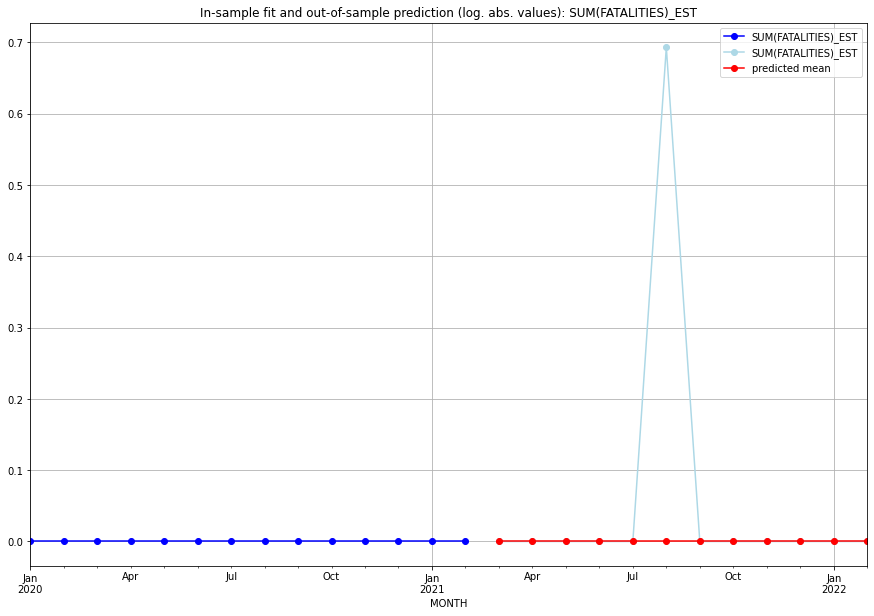

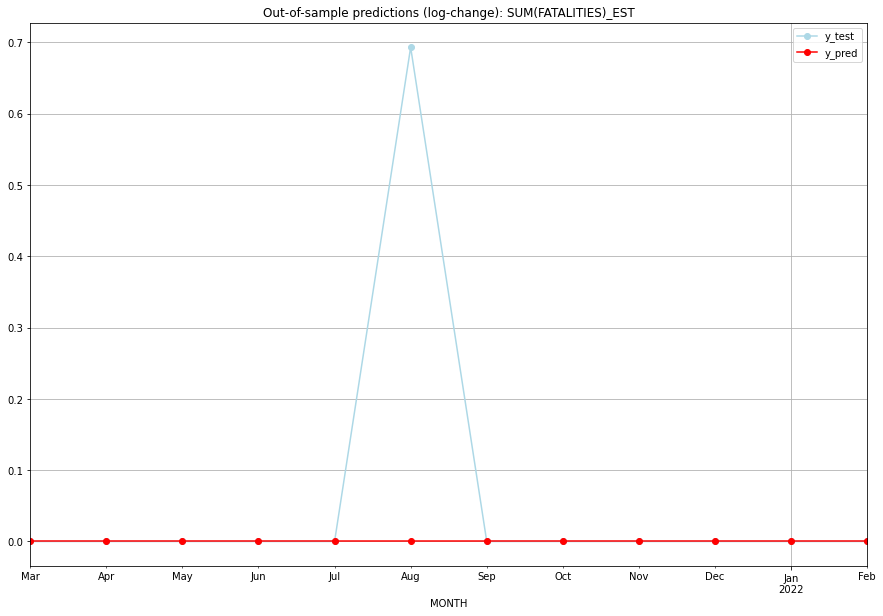

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   EST   
1  2021-04-01       0.0    0.000000           0.0        0.000000   EST   
2  2021-05-01       0.0    0.000000           0.0        0.000000   EST   
3  2021-06-01       0.0    0.000000           0.0        0.000000   EST   
4  2021-07-01       0.0    0.000000           0.0        0.000000   EST   
5  2021-08-01       0.0    0.693147           0.0        0.693147   EST   
6  2021-09-01       0.0    0.000000           0.0        0.000000   EST   
7  2021-10-01       0.0    0.000000           0.0        0.000000   EST   
8  2021-11-01       0.0    0.000000           0.0        0.000000   EST   
9  2021-12-01       0.0    0.000000           0.0        0.000000   EST   
10 2022-01-01       0.0    0.000000           0.0        0.000000   EST   
11 2022-02-01       0.0    0.000000           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6819003992708403, 'fold_results': [0.41727245013451636, 0.5854200718884837, 0.42525603335487355, 0.6804492543827504, 1.3011041865935775]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ETH   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -635.332
Date:                 Wed, 19 Oct 2022   AIC                           1274.665
Time:                         10:38:56   BIC                           1281.991
Sample:                     02-28-1997   HQIC                          1277.601
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

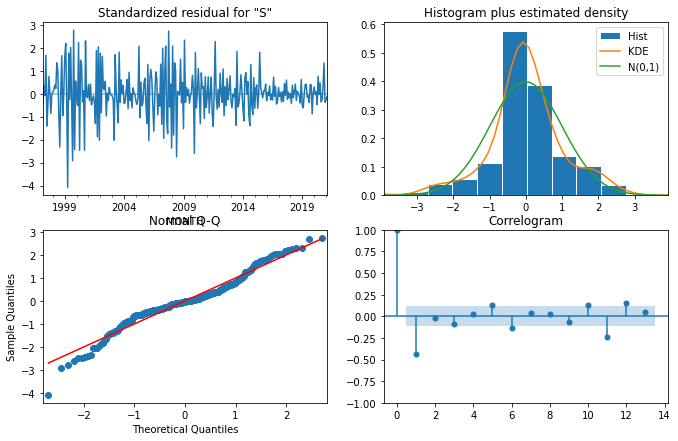

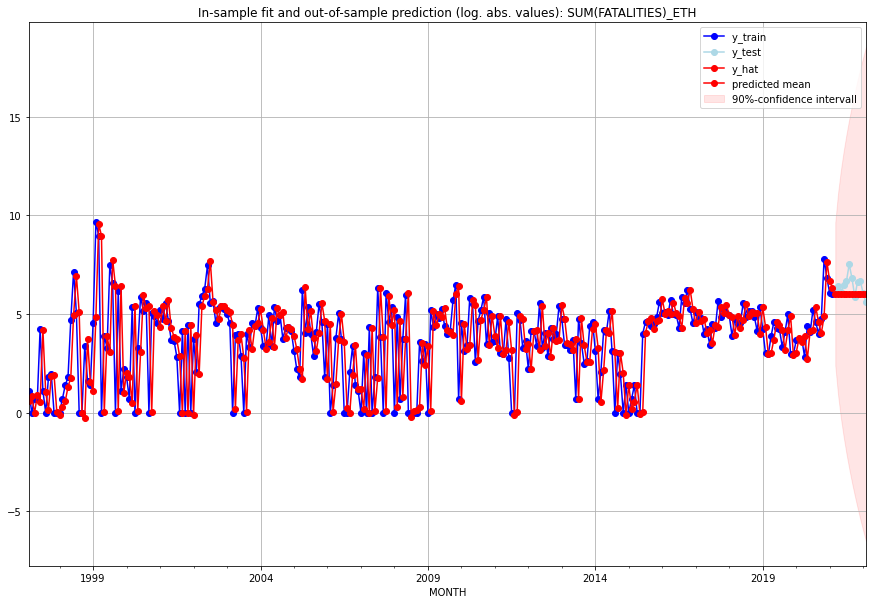

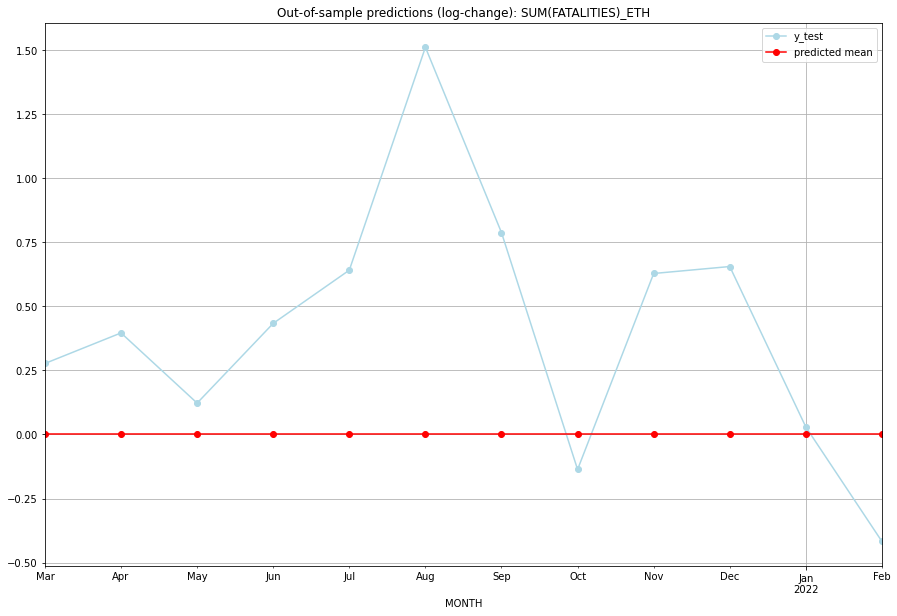

TADDA: 0.5031881874881604
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01     406.0       536.0           0.0        0.277185   ETH   
1  2021-04-01     406.0       604.0           0.0        0.396415   ETH   
2  2021-05-01     406.0       459.0           0.0        0.122413   ETH   
3  2021-06-01     406.0       627.0           0.0        0.433727   ETH   
4  2021-07-01     406.0       772.0           0.0        0.641466   ETH   
5  2021-08-01     406.0      1844.0           0.0        1.511421   ETH   
6  2021-09-01     406.0       894.0           0.0        0.788011   ETH   
7  2021-10-01     406.0       354.0           0.0       -0.136695   ETH   
8  2021-11-01     406.0       762.0           0.0        0.628445   ETH   
9  2021-12-01     406.0       783.0           0.0        0.655596   ETH   
10 2022-01-01     406.0       418.0           0.0        0.029058   ETH   
11 2022-02-01     406.0       267.0           0.0    

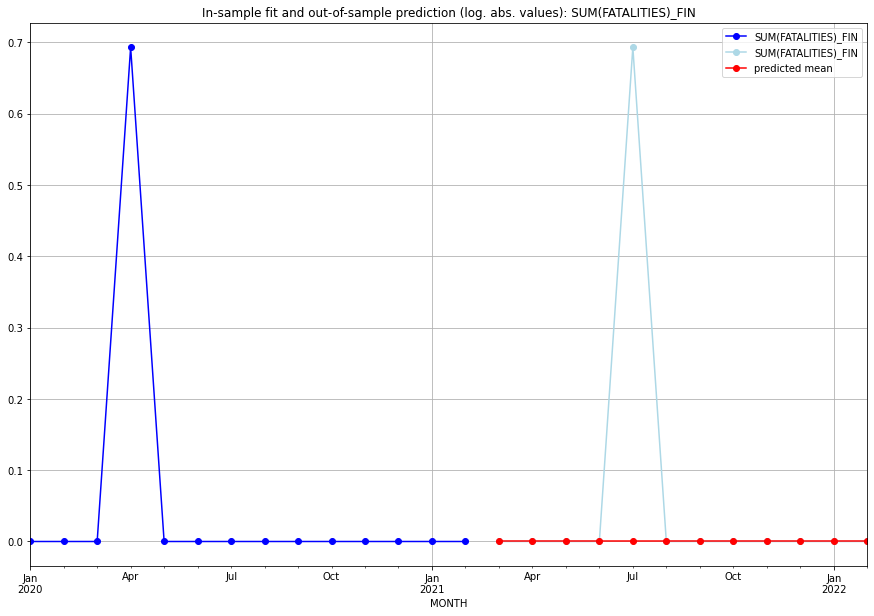

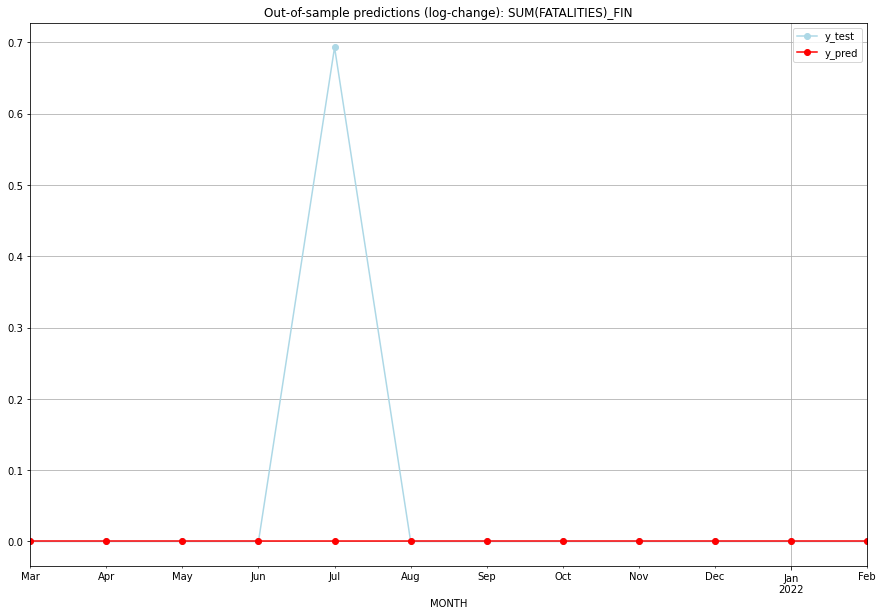

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   FIN   
1  2021-04-01       0.0    0.000000           0.0        0.000000   FIN   
2  2021-05-01       0.0    0.000000           0.0        0.000000   FIN   
3  2021-06-01       0.0    0.000000           0.0        0.000000   FIN   
4  2021-07-01       0.0    0.693147           0.0        0.693147   FIN   
5  2021-08-01       0.0    0.000000           0.0        0.000000   FIN   
6  2021-09-01       0.0    0.000000           0.0        0.000000   FIN   
7  2021-10-01       0.0    0.000000           0.0        0.000000   FIN   
8  2021-11-01       0.0    0.000000           0.0        0.000000   FIN   
9  2021-12-01       0.0    0.000000           0.0        0.000000   FIN   
10 2022-01-01       0.0    0.000000           0.0        0.000000   FIN   
11 2022-02-01       0.0    0.000000           0.0  

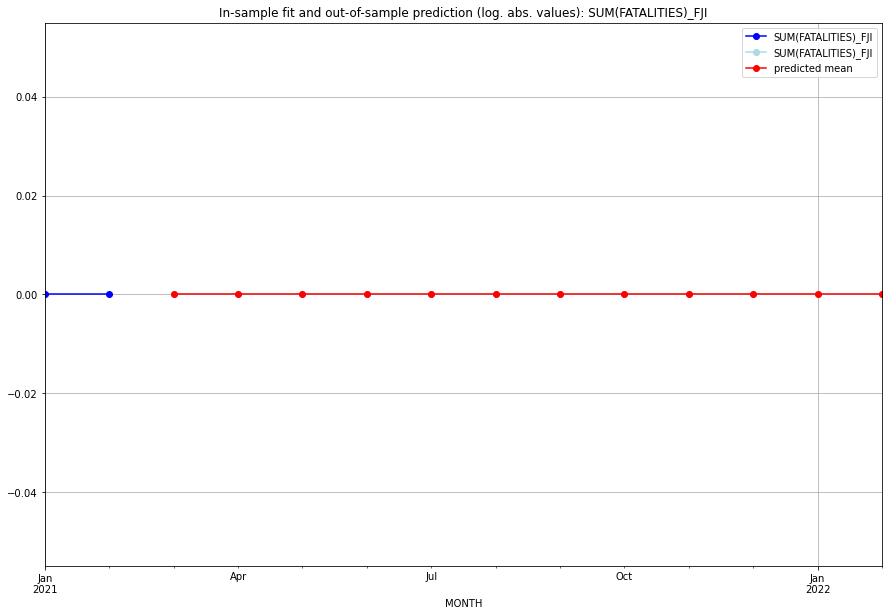

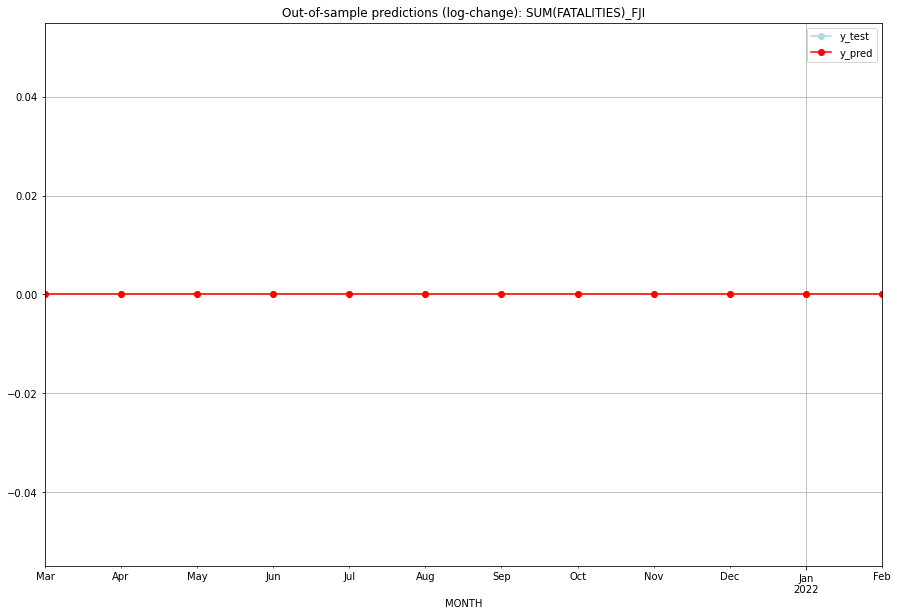

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   FJI   
1  2021-04-01       0.0         0.0           0.0             0.0   FJI   
2  2021-05-01       0.0         0.0           0.0             0.0   FJI   
3  2021-06-01       0.0         0.0           0.0             0.0   FJI   
4  2021-07-01       0.0         0.0           0.0             0.0   FJI   
5  2021-08-01       0.0         0.0           0.0             0.0   FJI   
6  2021-09-01       0.0         0.0           0.0             0.0   FJI   
7  2021-10-01       0.0         0.0           0.0             0.0   FJI   
8  2021-11-01       0.0         0.0           0.0             0.0   FJI   
9  2021-12-01       0.0         0.0           0.0             0.0   FJI   
10 2022-01-01       0.0         0.0           0.0             0.0   FJI   
11 2022-02-01       0.0         0.0           0.0             0.0   

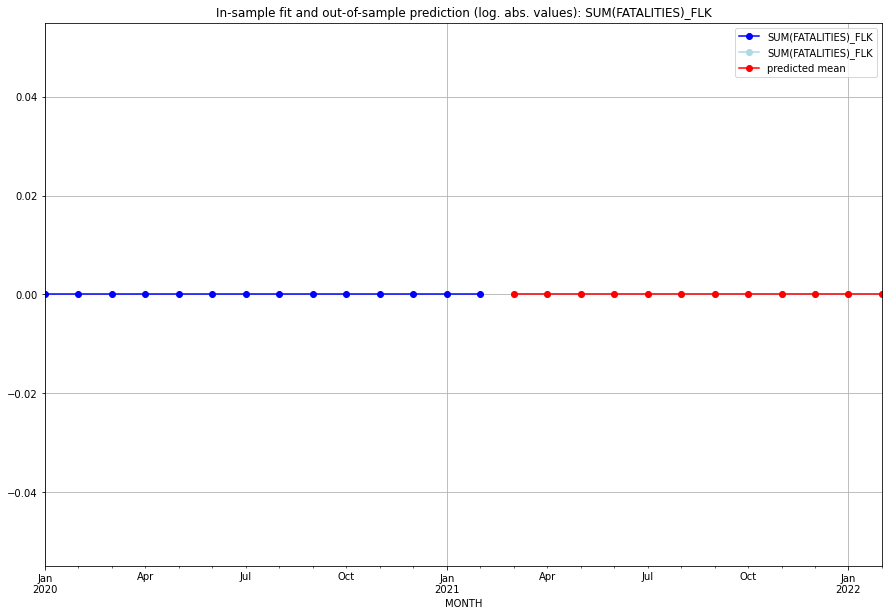

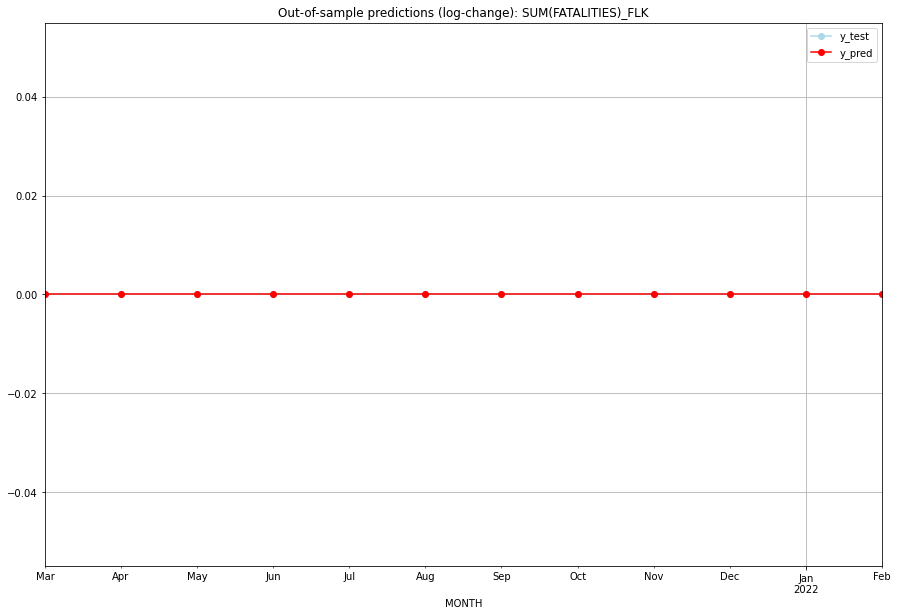

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   FLK   
1  2021-04-01       0.0         0.0           0.0             0.0   FLK   
2  2021-05-01       0.0         0.0           0.0             0.0   FLK   
3  2021-06-01       0.0         0.0           0.0             0.0   FLK   
4  2021-07-01       0.0         0.0           0.0             0.0   FLK   
5  2021-08-01       0.0         0.0           0.0             0.0   FLK   
6  2021-09-01       0.0         0.0           0.0             0.0   FLK   
7  2021-10-01       0.0         0.0           0.0             0.0   FLK   
8  2021-11-01       0.0         0.0           0.0             0.0   FLK   
9  2021-12-01       0.0         0.0           0.0             0.0   FLK   
10 2022-01-01       0.0         0.0           0.0             0.0   FLK   
11 2022-02-01       0.0         0.0           0.0             0.0   

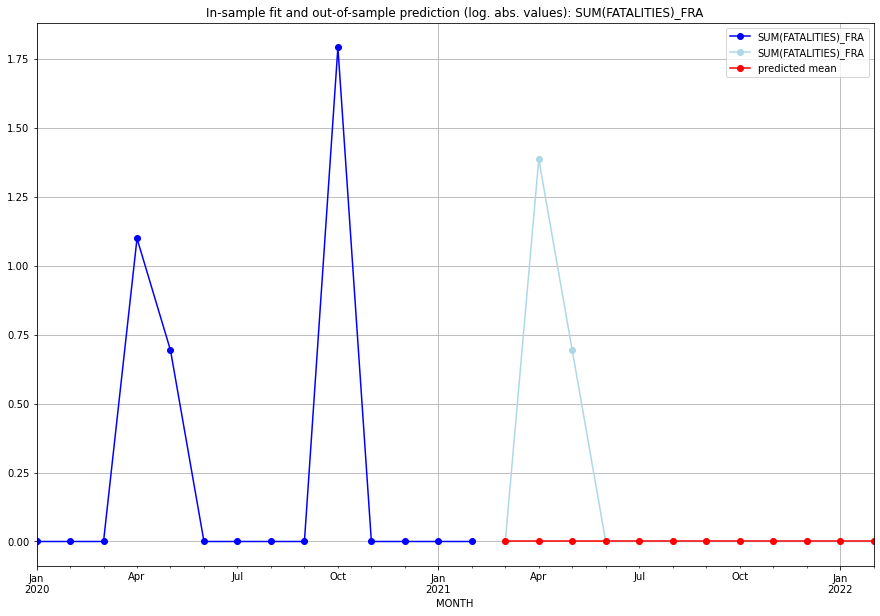

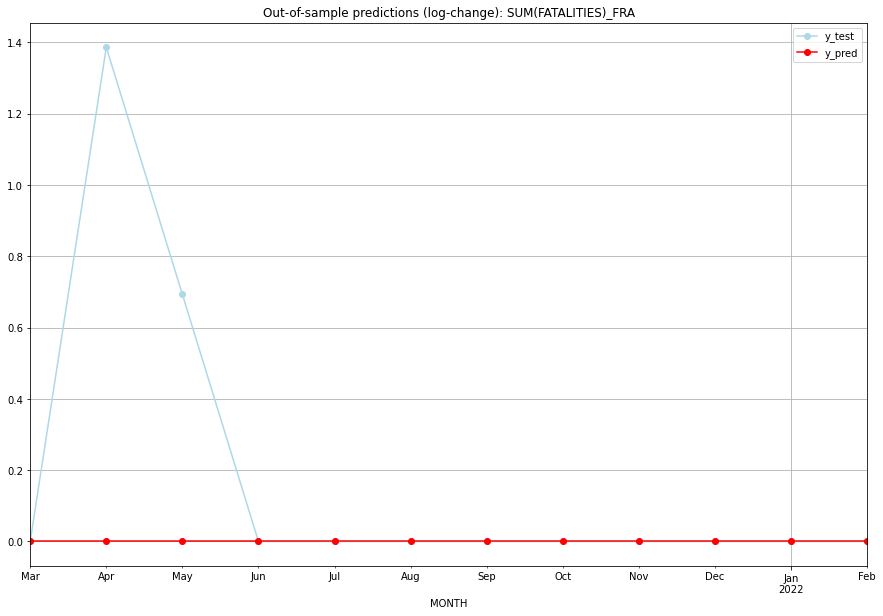

TADDA: 0.17328679513998632
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   FRA   
1  2021-04-01       0.0    1.386294           0.0        1.386294   FRA   
2  2021-05-01       0.0    0.693147           0.0        0.693147   FRA   
3  2021-06-01       0.0    0.000000           0.0        0.000000   FRA   
4  2021-07-01       0.0    0.000000           0.0        0.000000   FRA   
5  2021-08-01       0.0    0.000000           0.0        0.000000   FRA   
6  2021-09-01       0.0    0.000000           0.0        0.000000   FRA   
7  2021-10-01       0.0    0.000000           0.0        0.000000   FRA   
8  2021-11-01       0.0    0.000000           0.0        0.000000   FRA   
9  2021-12-01       0.0    0.000000           0.0        0.000000   FRA   
10 2022-01-01       0.0    0.000000           0.0        0.000000   FRA   
11 2022-02-01       0.0    0.000000           0.0   

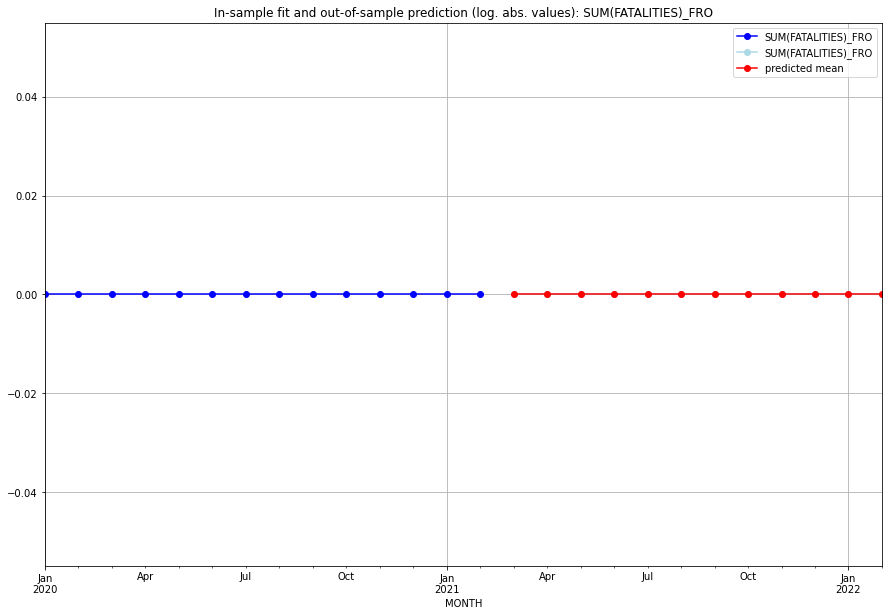

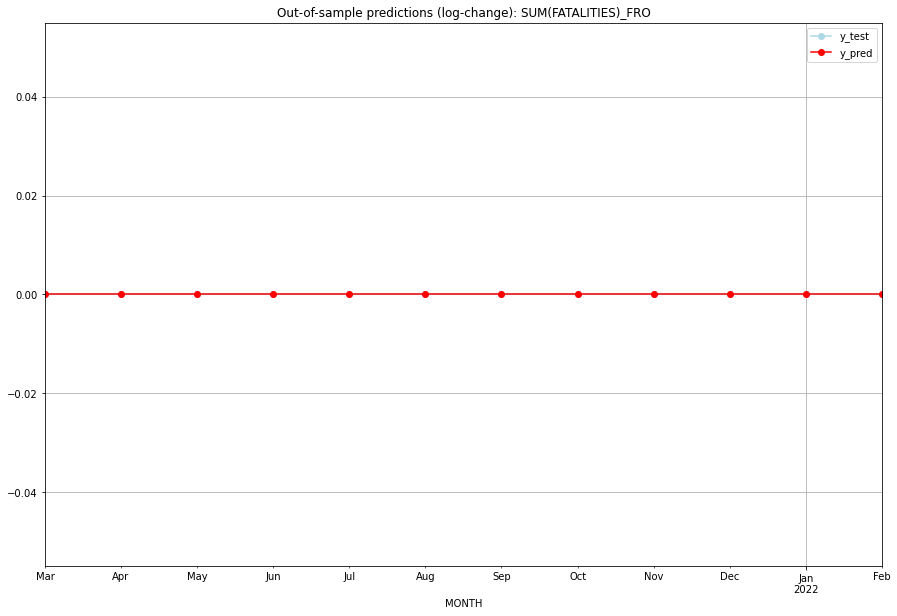

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   FRO   
1  2021-04-01       0.0         0.0           0.0             0.0   FRO   
2  2021-05-01       0.0         0.0           0.0             0.0   FRO   
3  2021-06-01       0.0         0.0           0.0             0.0   FRO   
4  2021-07-01       0.0         0.0           0.0             0.0   FRO   
5  2021-08-01       0.0         0.0           0.0             0.0   FRO   
6  2021-09-01       0.0         0.0           0.0             0.0   FRO   
7  2021-10-01       0.0         0.0           0.0             0.0   FRO   
8  2021-11-01       0.0         0.0           0.0             0.0   FRO   
9  2021-12-01       0.0         0.0           0.0             0.0   FRO   
10 2022-01-01       0.0         0.0           0.0             0.0   FRO   
11 2022-02-01       0.0         0.0           0.0             0.0   

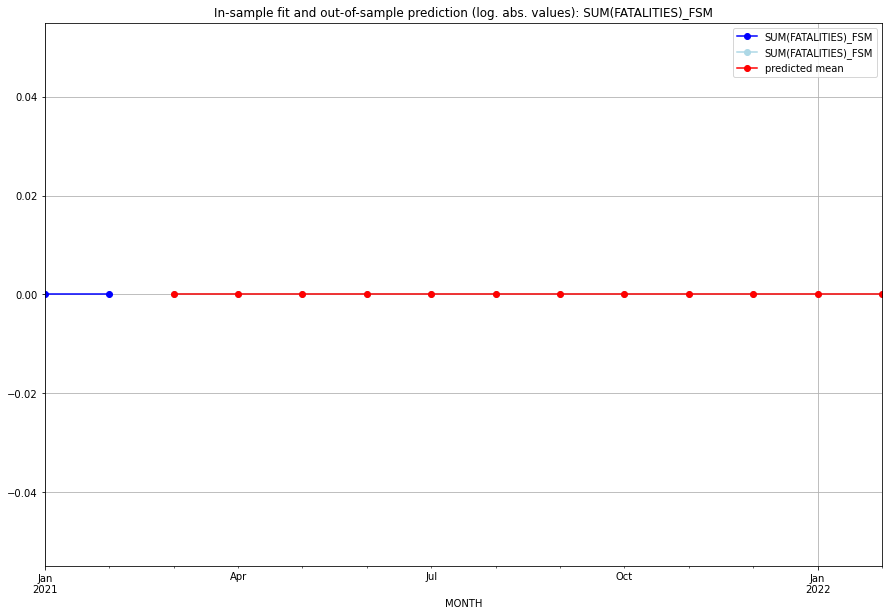

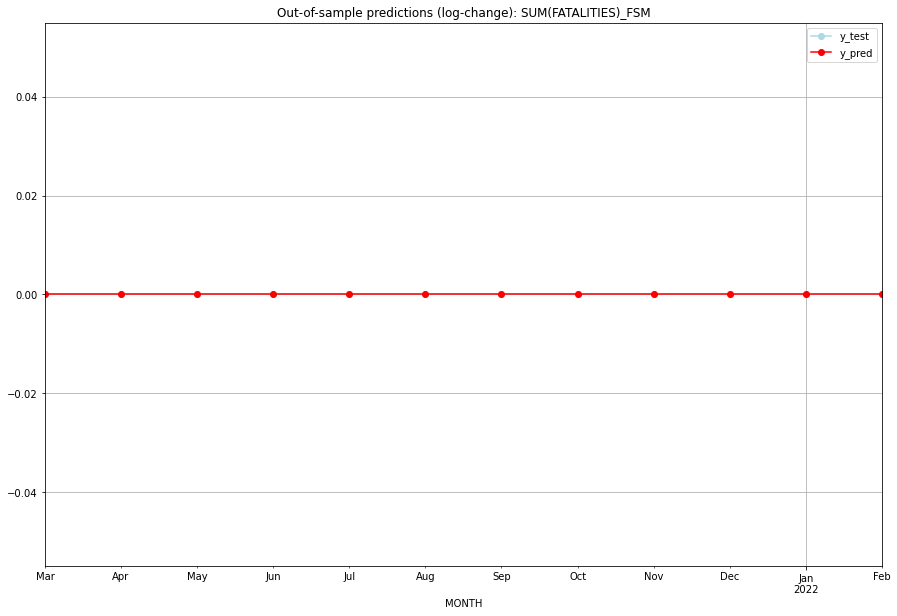

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   FSM   
1  2021-04-01       0.0         0.0           0.0             0.0   FSM   
2  2021-05-01       0.0         0.0           0.0             0.0   FSM   
3  2021-06-01       0.0         0.0           0.0             0.0   FSM   
4  2021-07-01       0.0         0.0           0.0             0.0   FSM   
5  2021-08-01       0.0         0.0           0.0             0.0   FSM   
6  2021-09-01       0.0         0.0           0.0             0.0   FSM   
7  2021-10-01       0.0         0.0           0.0             0.0   FSM   
8  2021-11-01       0.0         0.0           0.0             0.0   FSM   
9  2021-12-01       0.0         0.0           0.0             0.0   FSM   
10 2022-01-01       0.0         0.0           0.0             0.0   FSM   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.1431616647033831, 'fold_results': [0.21992144413460482, 0.057762265046662105, 0.20707555414900003, 0.17328679513998635, 0.057762265046662105]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GAB   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                 -49.955
Date:                 Wed, 19 Oct 2022   AIC                            101.909
Time:                         10:39:58   BIC                            105.576
Sample:                     02-28-1997   HQIC                           103.378
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------

<Figure size 432x288 with 0 Axes>

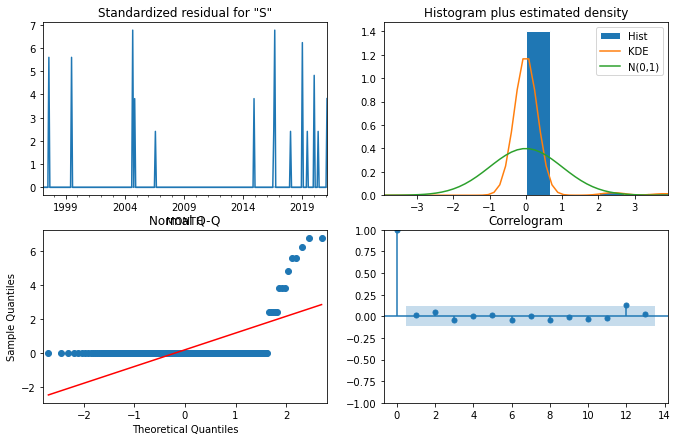

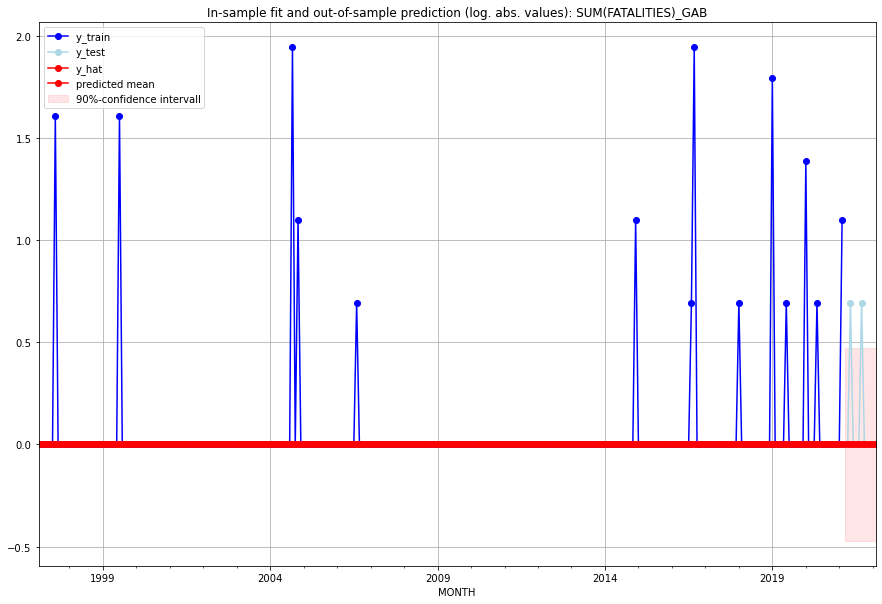

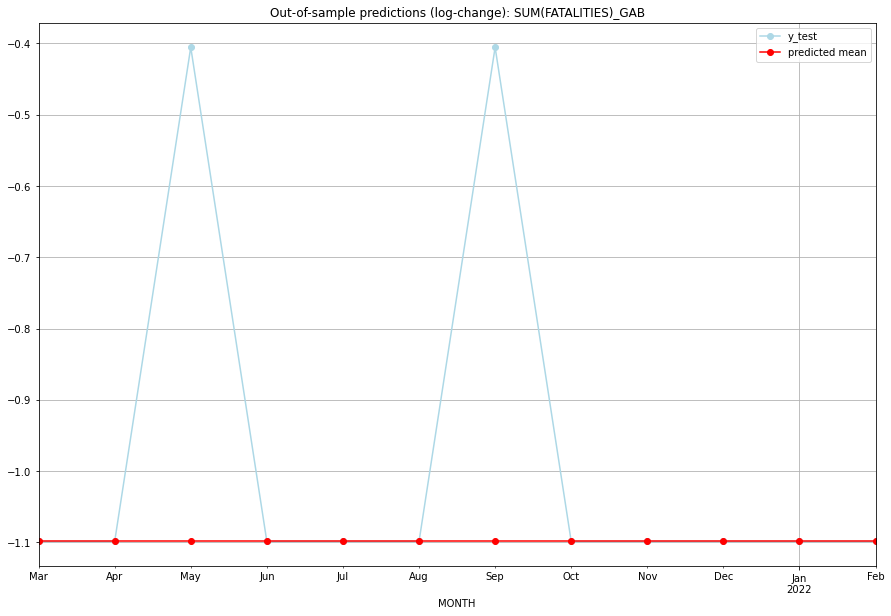

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0     -1.098612       -1.098612   GAB   
1  2021-04-01       0.0         0.0     -1.098612       -1.098612   GAB   
2  2021-05-01       0.0         1.0     -1.098612       -0.405465   GAB   
3  2021-06-01       0.0         0.0     -1.098612       -1.098612   GAB   
4  2021-07-01       0.0         0.0     -1.098612       -1.098612   GAB   
5  2021-08-01       0.0         0.0     -1.098612       -1.098612   GAB   
6  2021-09-01       0.0         1.0     -1.098612       -0.405465   GAB   
7  2021-10-01       0.0         0.0     -1.098612       -1.098612   GAB   
8  2021-11-01       0.0         0.0     -1.098612       -1.098612   GAB   
9  2021-12-01       0.0         0.0     -1.098612       -1.098612   GAB   
10 2022-01-01       0.0         0.0     -1.098612       -1.098612   GAB   
11 2022-02-01       0.0         0.0     -1.098612   

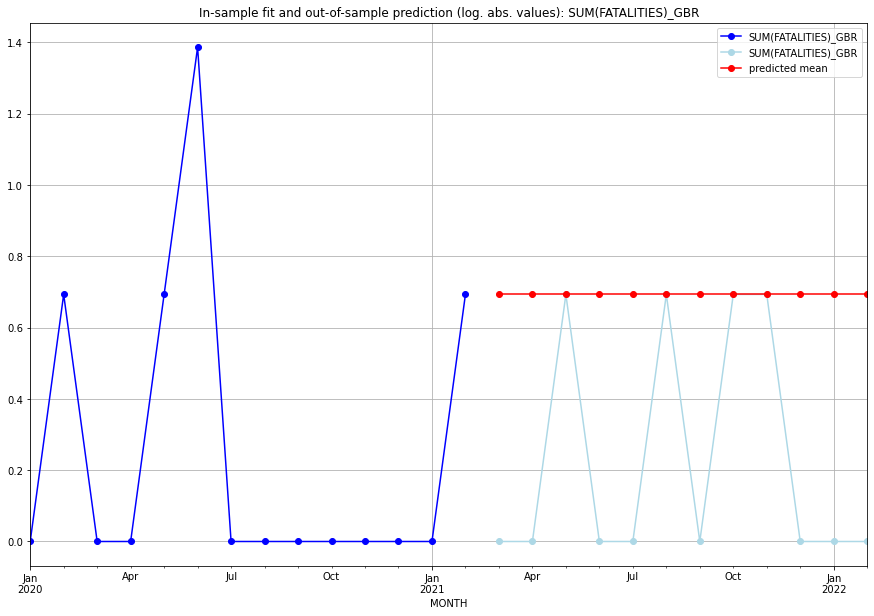

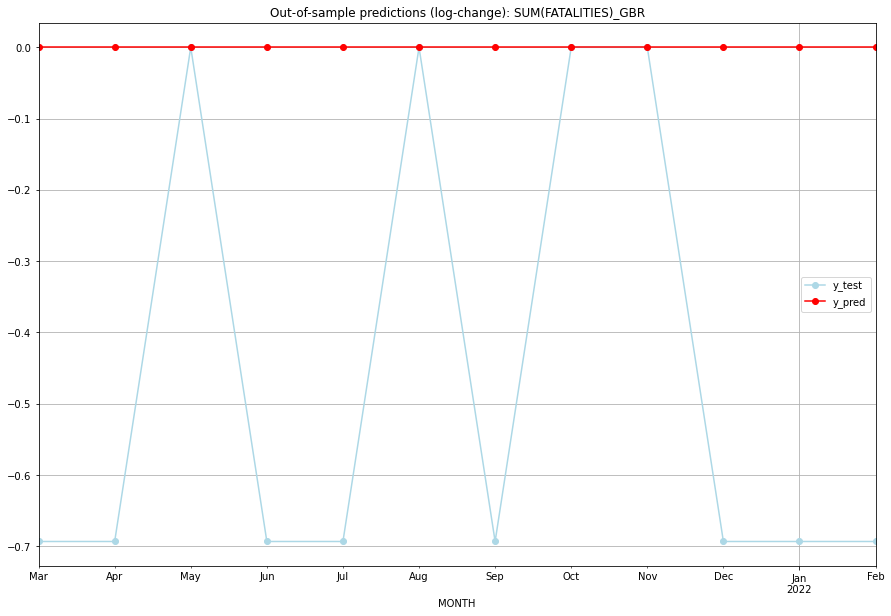

TADDA: 0.46209812037329684
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.693147    0.000000           0.0       -0.693147   GBR   
1  2021-04-01  0.693147    0.000000           0.0       -0.693147   GBR   
2  2021-05-01  0.693147    0.693147           0.0        0.000000   GBR   
3  2021-06-01  0.693147    0.000000           0.0       -0.693147   GBR   
4  2021-07-01  0.693147    0.000000           0.0       -0.693147   GBR   
5  2021-08-01  0.693147    0.693147           0.0        0.000000   GBR   
6  2021-09-01  0.693147    0.000000           0.0       -0.693147   GBR   
7  2021-10-01  0.693147    0.693147           0.0        0.000000   GBR   
8  2021-11-01  0.693147    0.693147           0.0        0.000000   GBR   
9  2021-12-01  0.693147    0.000000           0.0       -0.693147   GBR   
10 2022-01-01  0.693147    0.000000           0.0       -0.693147   GBR   
11 2022-02-01  0.693147    0.000000           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.11552453009332421, 'fold_results': [0.17328679513998632, 0.057762265046662105]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GEO   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  -9.192
Date:                 Wed, 19 Oct 2022   AIC                             20.384
Time:                         10:40:17   BIC                             22.021
Sample:                     01-31-2018   HQIC                            20.966
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0950    

<Figure size 432x288 with 0 Axes>

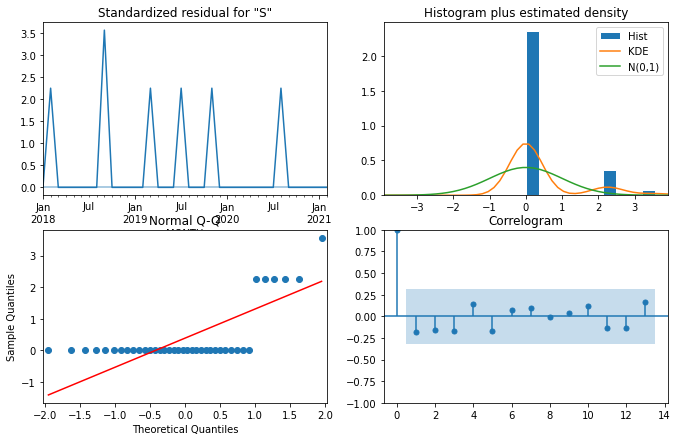

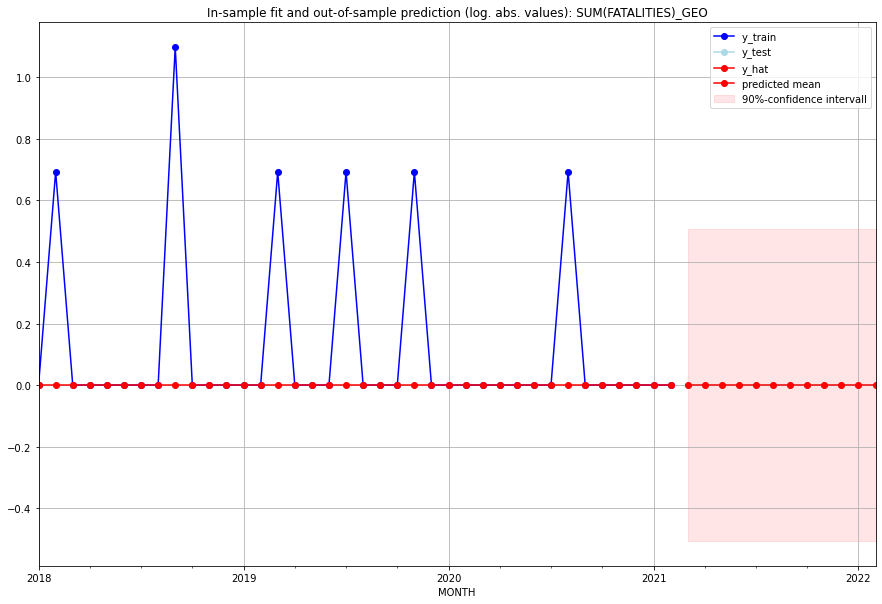

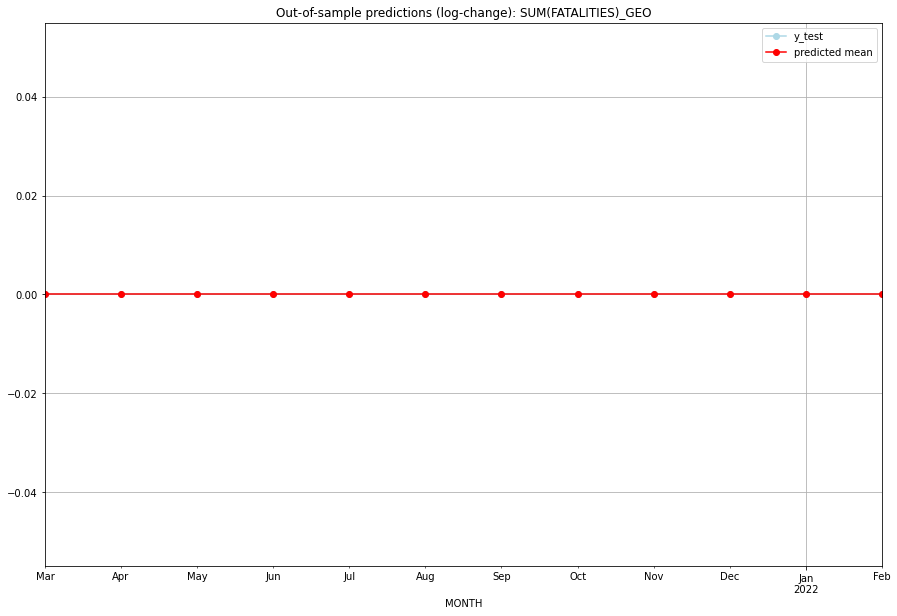

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   GEO   
1  2021-04-01       0.0         0.0           0.0             0.0   GEO   
2  2021-05-01       0.0         0.0           0.0             0.0   GEO   
3  2021-06-01       0.0         0.0           0.0             0.0   GEO   
4  2021-07-01       0.0         0.0           0.0             0.0   GEO   
5  2021-08-01       0.0         0.0           0.0             0.0   GEO   
6  2021-09-01       0.0         0.0           0.0             0.0   GEO   
7  2021-10-01       0.0         0.0           0.0             0.0   GEO   
8  2021-11-01       0.0         0.0           0.0             0.0   GEO   
9  2021-12-01       0.0         0.0           0.0             0.0   GEO   
10 2022-01-01       0.0         0.0           0.0             0.0   GEO   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

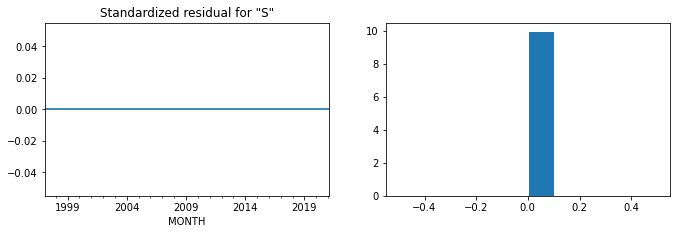

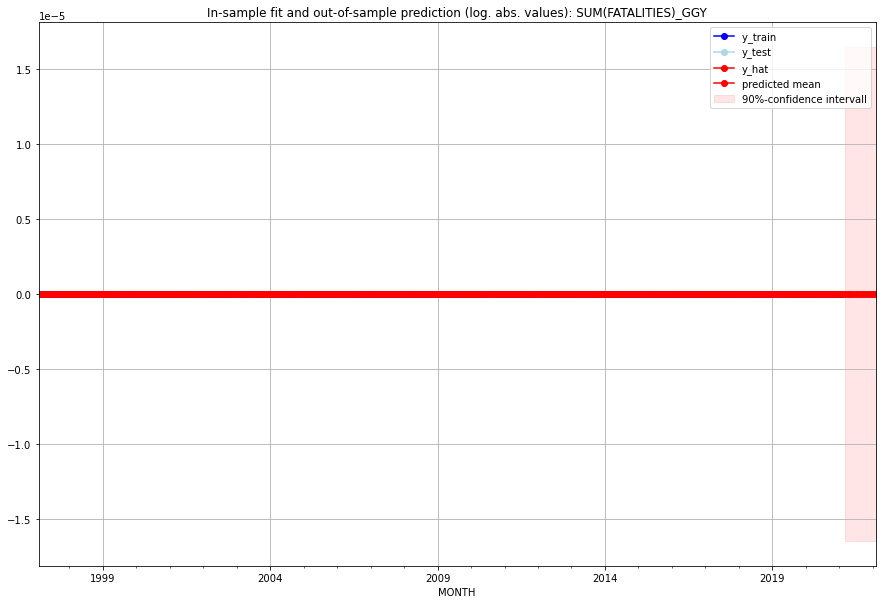

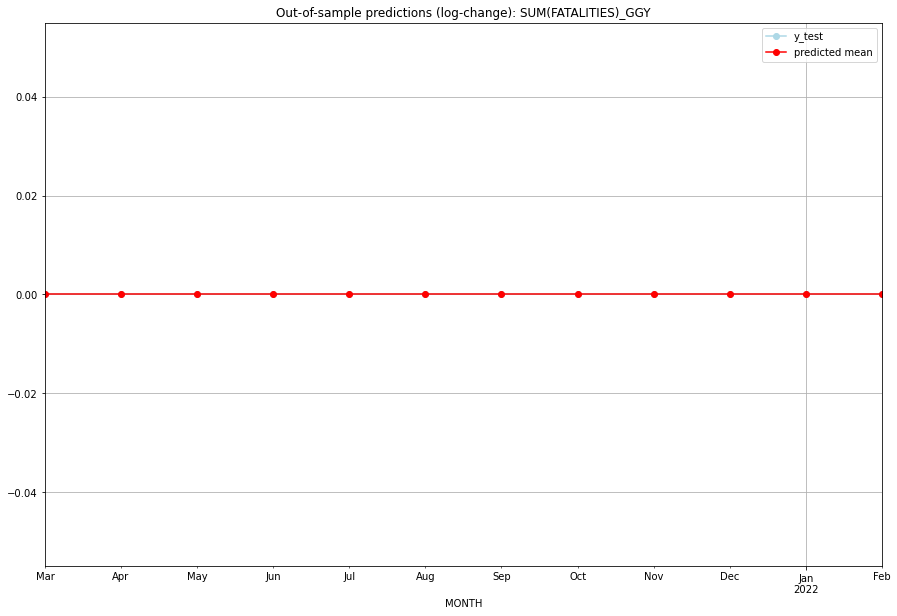

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   GGY   
1  2021-04-01       0.0         0.0           0.0             0.0   GGY   
2  2021-05-01       0.0         0.0           0.0             0.0   GGY   
3  2021-06-01       0.0         0.0           0.0             0.0   GGY   
4  2021-07-01       0.0         0.0           0.0             0.0   GGY   
5  2021-08-01       0.0         0.0           0.0             0.0   GGY   
6  2021-09-01       0.0         0.0           0.0             0.0   GGY   
7  2021-10-01       0.0         0.0           0.0             0.0   GGY   
8  2021-11-01       0.0         0.0           0.0             0.0   GGY   
9  2021-12-01       0.0         0.0           0.0             0.0   GGY   
10 2022-01-01       0.0         0.0           0.0             0.0   GGY   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.7443485707160801, 'fold_results': [0.8499850550710937, 0.9755923096096787, 0.923693326017835, 0.38105947532220524, 0.5914126875595879]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GHA   No. Observations:                  289
Model:                SARIMAX(3, 1, 3)   Log Likelihood                -333.837
Date:                 Wed, 19 Oct 2022   AIC                            687.673
Time:                         10:40:54   BIC                            724.303
Sample:                     02-28-1997   HQIC                           702.352
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

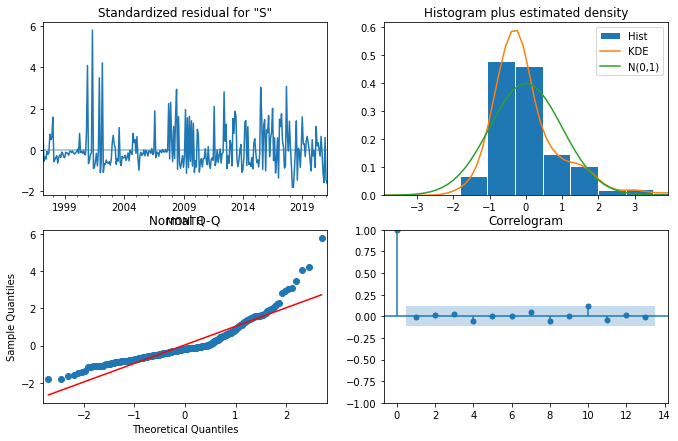

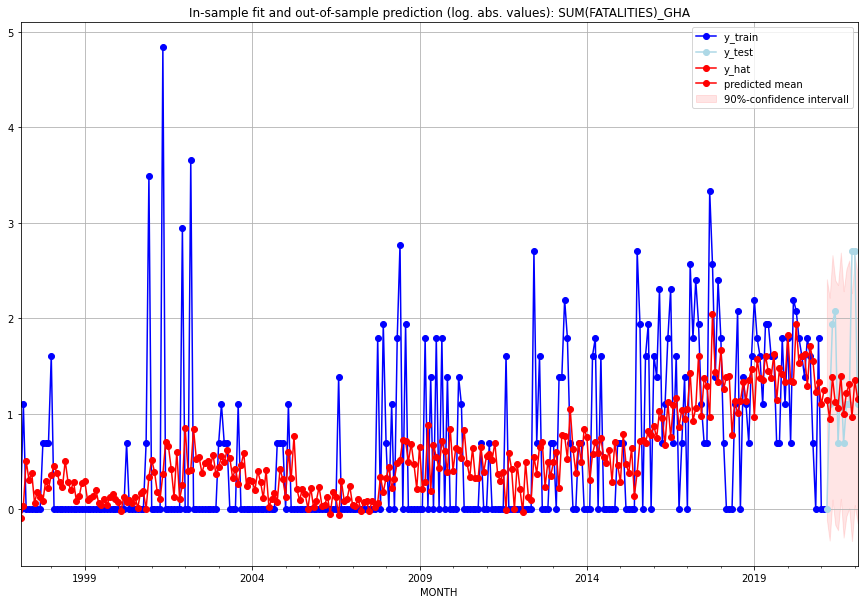

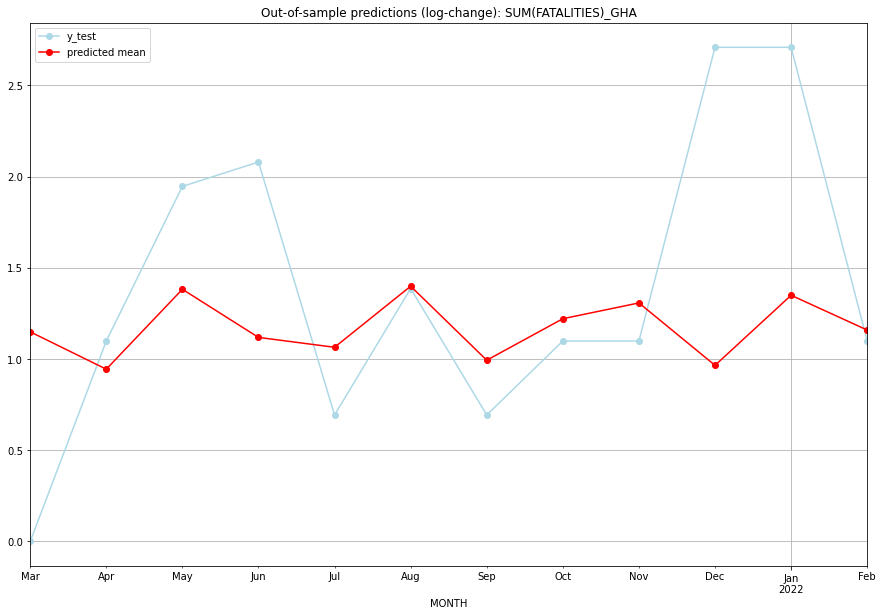

TADDA: 0.5837236132366681
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.154825         0.0      1.148933        0.000000   GHA   
1  2021-04-01  1.570754         2.0      0.944199        1.098612   GHA   
2  2021-05-01  2.983296         6.0      1.382110        1.945910   GHA   
3  2021-06-01  2.059841         7.0      1.118363        2.079442   GHA   
4  2021-07-01  1.898599         1.0      1.064228        0.693147   GHA   
5  2021-08-01  3.051047         3.0      1.398975        1.386294   GHA   
6  2021-09-01  1.700225         1.0      0.993335        0.693147   GHA   
7  2021-10-01  2.389802         2.0      1.220772        1.098612   GHA   
8  2021-11-01  2.696198         2.0      1.307305        1.098612   GHA   
9  2021-12-01  1.625588        14.0      0.965305        2.708050   GHA   
10 2022-01-01  2.854459        14.0      1.349231        2.708050   GHA   
11 2022-02-01  2.185805         2.0      1.158705    

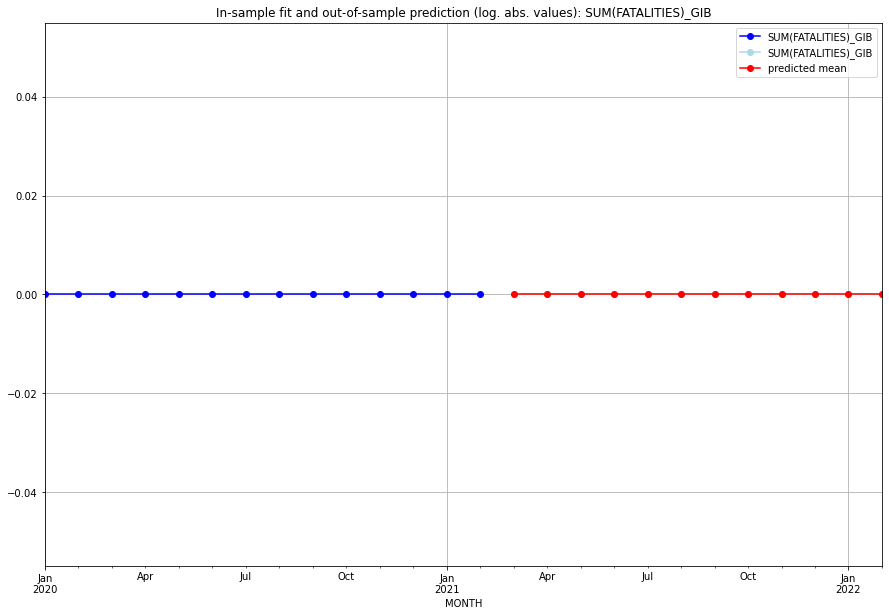

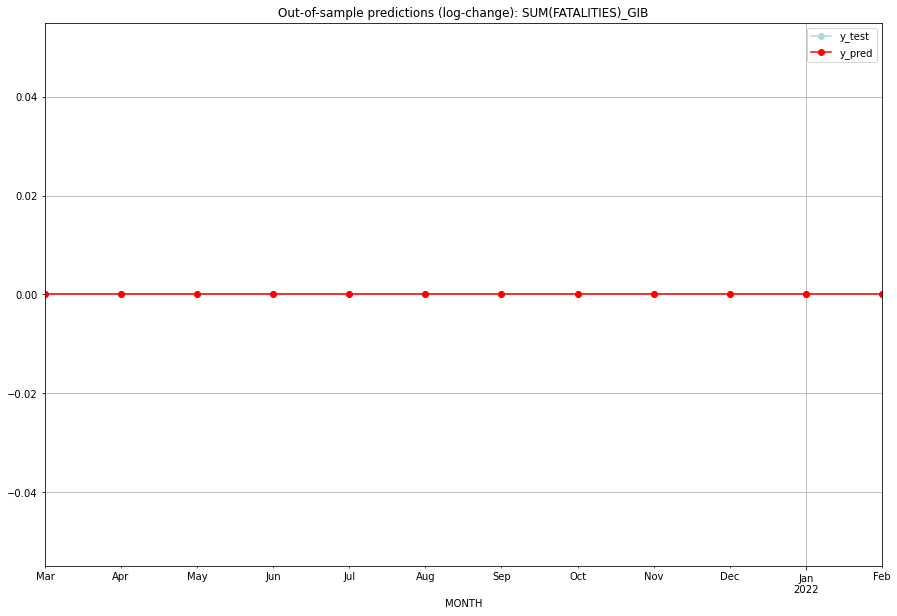

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   GIB   
1  2021-04-01       0.0         0.0           0.0             0.0   GIB   
2  2021-05-01       0.0         0.0           0.0             0.0   GIB   
3  2021-06-01       0.0         0.0           0.0             0.0   GIB   
4  2021-07-01       0.0         0.0           0.0             0.0   GIB   
5  2021-08-01       0.0         0.0           0.0             0.0   GIB   
6  2021-09-01       0.0         0.0           0.0             0.0   GIB   
7  2021-10-01       0.0         0.0           0.0             0.0   GIB   
8  2021-11-01       0.0         0.0           0.0             0.0   GIB   
9  2021-12-01       0.0         0.0           0.0             0.0   GIB   
10 2022-01-01       0.0         0.0           0.0             0.0   GIB   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6835137129286623, 'fold_results': [0.35638884325133796, 0.6530390442379043, 0.5722444403718235, 0.9121274574763203, 0.9237687793059256]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GIN   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -515.810
Date:                 Wed, 19 Oct 2022   AIC                           1033.619
Time:                         10:41:28   BIC                           1037.282
Sample:                     02-28-1997   HQIC                          1035.087
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

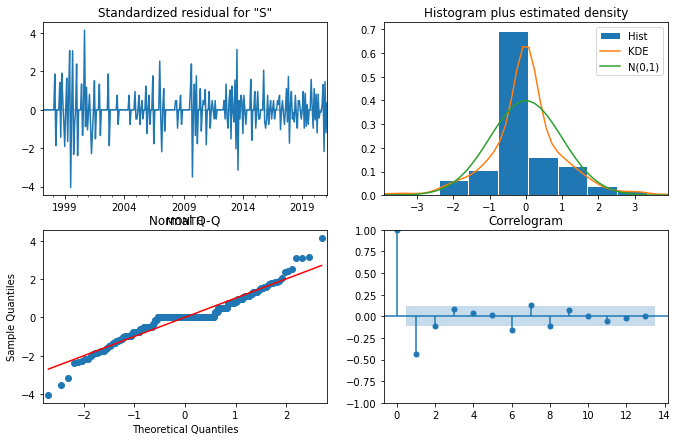

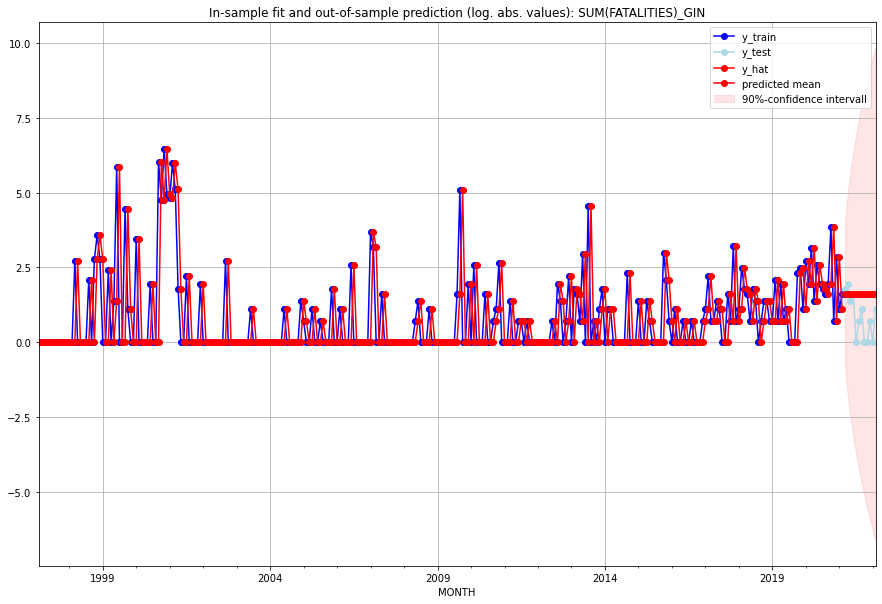

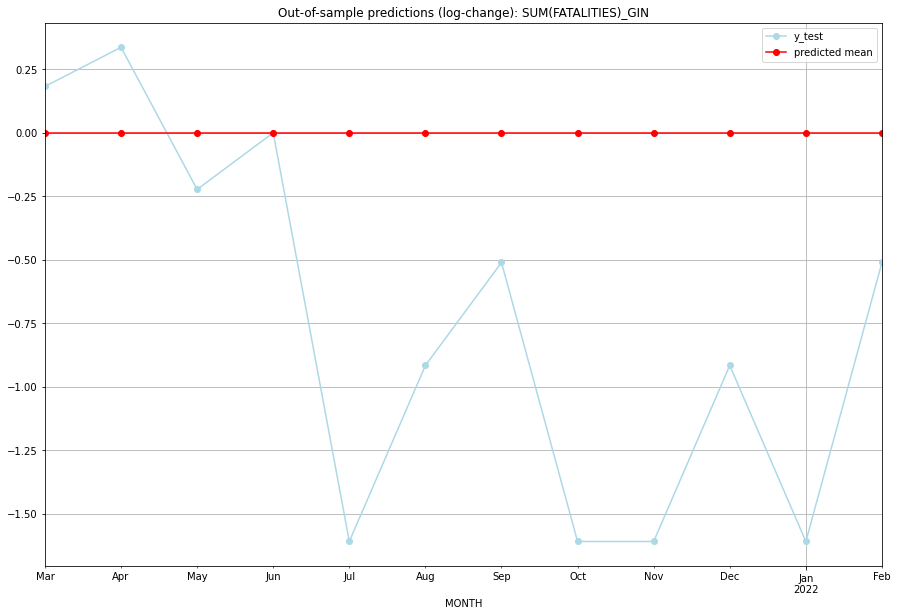

TADDA: 0.8361601421455057
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       4.0         5.0           0.0        0.182322   GIN   
1  2021-04-01       4.0         6.0           0.0        0.336472   GIN   
2  2021-05-01       4.0         3.0           0.0       -0.223144   GIN   
3  2021-06-01       4.0         4.0           0.0        0.000000   GIN   
4  2021-07-01       4.0         0.0           0.0       -1.609438   GIN   
5  2021-08-01       4.0         1.0           0.0       -0.916291   GIN   
6  2021-09-01       4.0         2.0           0.0       -0.510826   GIN   
7  2021-10-01       4.0         0.0           0.0       -1.609438   GIN   
8  2021-11-01       4.0         0.0           0.0       -1.609438   GIN   
9  2021-12-01       4.0         1.0           0.0       -0.916291   GIN   
10 2022-01-01       4.0         0.0           0.0       -1.609438   GIN   
11 2022-02-01       4.0         2.0           0.0    

<Figure size 432x288 with 0 Axes>

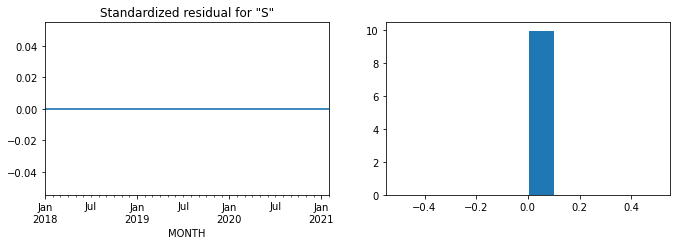

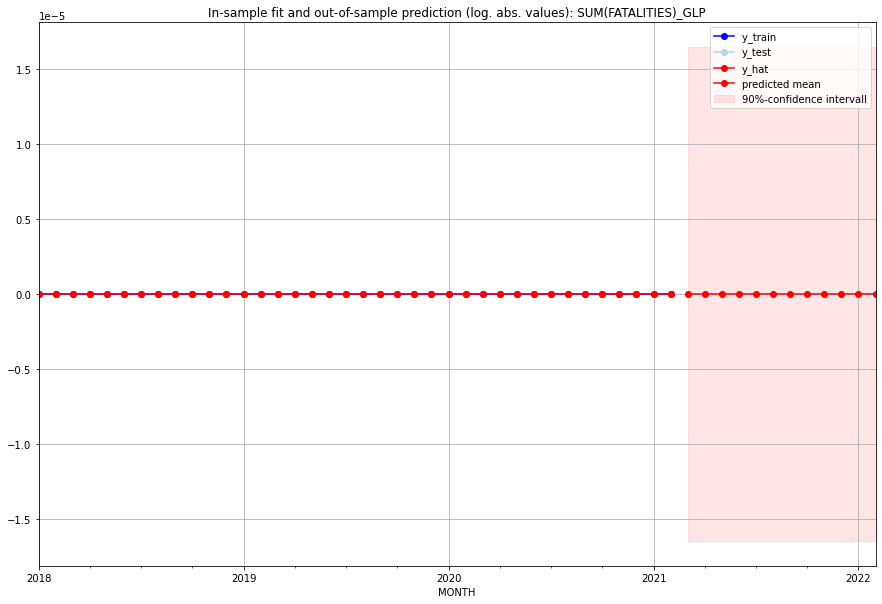

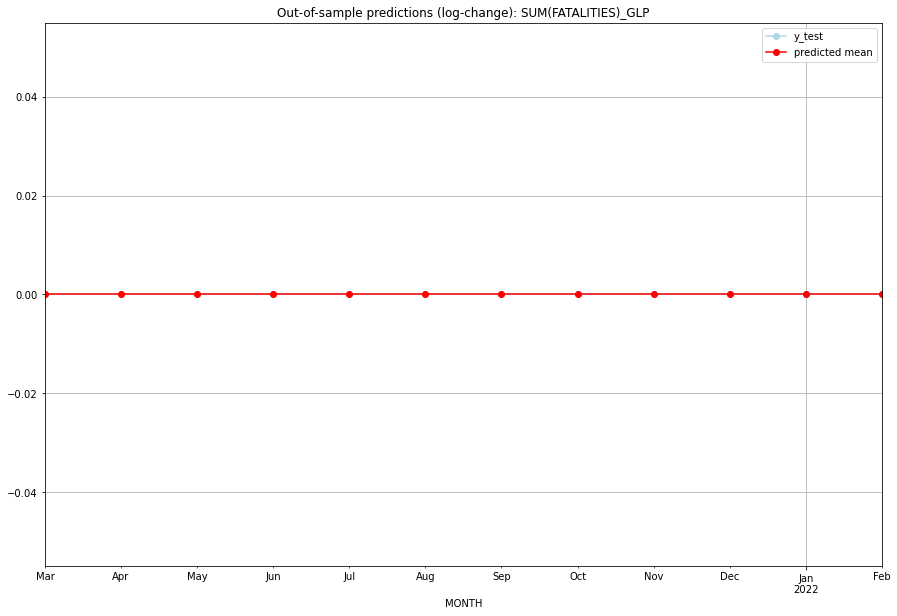

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   GLP   
1  2021-04-01       0.0         0.0           0.0             0.0   GLP   
2  2021-05-01       0.0         0.0           0.0             0.0   GLP   
3  2021-06-01       0.0         0.0           0.0             0.0   GLP   
4  2021-07-01       0.0         0.0           0.0             0.0   GLP   
5  2021-08-01       0.0         0.0           0.0             0.0   GLP   
6  2021-09-01       0.0         0.0           0.0             0.0   GLP   
7  2021-10-01       0.0         0.0           0.0             0.0   GLP   
8  2021-11-01       0.0         0.0           0.0             0.0   GLP   
9  2021-12-01       0.0         0.0           0.0             0.0   GLP   
10 2022-01-01       0.0         0.0           0.0             0.0   GLP   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.14910624710236195, 'fold_results': [0.13411982603617503, 0.2648378191956621, 0.11552453009332421, 0.23104906018664842, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GMB   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -196.003
Date:                 Wed, 19 Oct 2022   AIC                            394.007
Time:                         10:42:13   BIC                            397.673
Sample:                     02-28-1997   HQIC                           395.476
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------

<Figure size 432x288 with 0 Axes>

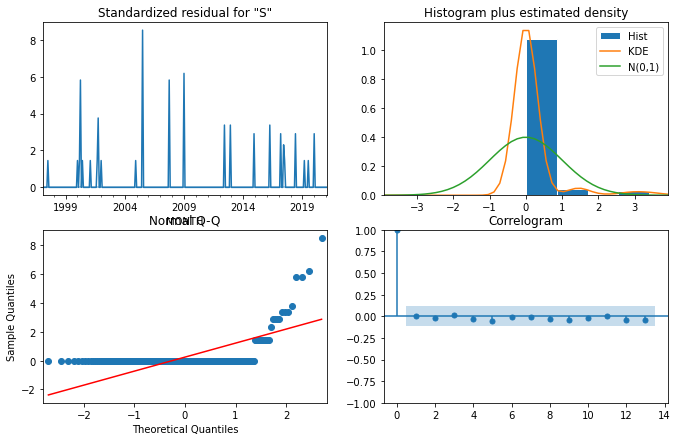

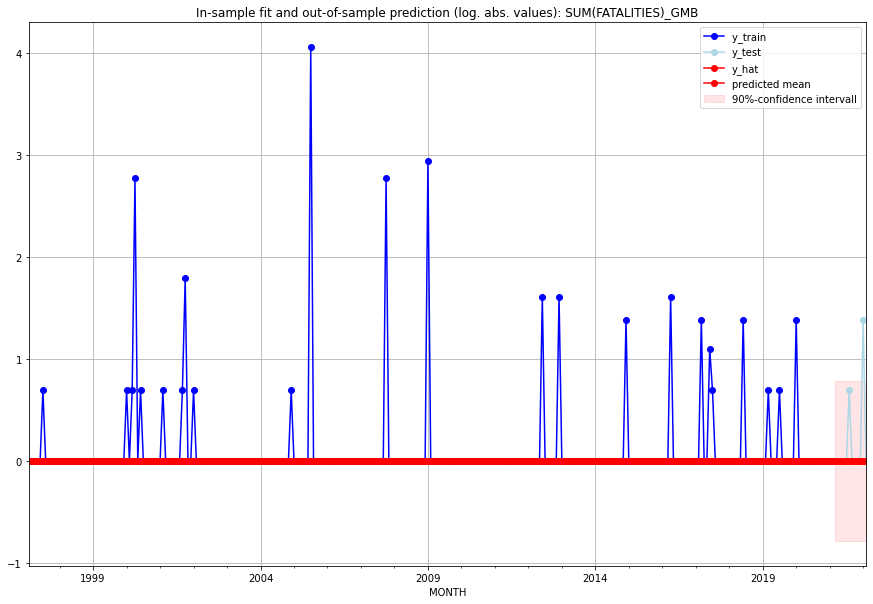

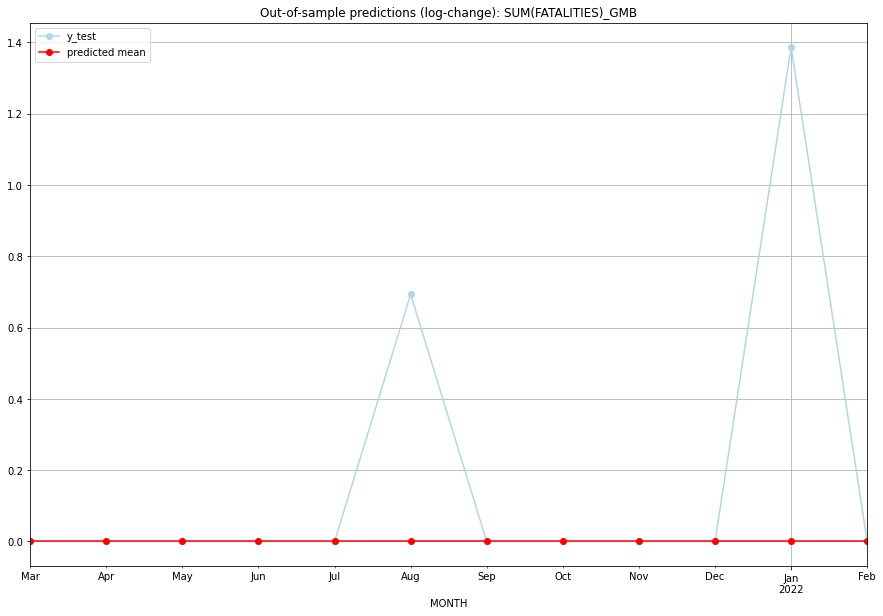

TADDA: 0.17328679513998632
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   GMB   
1  2021-04-01       0.0         0.0           0.0        0.000000   GMB   
2  2021-05-01       0.0         0.0           0.0        0.000000   GMB   
3  2021-06-01       0.0         0.0           0.0        0.000000   GMB   
4  2021-07-01       0.0         0.0           0.0        0.000000   GMB   
5  2021-08-01       0.0         1.0           0.0        0.693147   GMB   
6  2021-09-01       0.0         0.0           0.0        0.000000   GMB   
7  2021-10-01       0.0         0.0           0.0        0.000000   GMB   
8  2021-11-01       0.0         0.0           0.0        0.000000   GMB   
9  2021-12-01       0.0         0.0           0.0        0.000000   GMB   
10 2022-01-01       0.0         3.0           0.0        1.386294   GMB   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0730337772445647, 'fold_results': [0.0, 0.0, 0.0, 0.057762265046662105, 0.30740662117616135]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GNB   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -357.339
Date:                 Wed, 19 Oct 2022   AIC                            716.678
Time:                         10:42:41   BIC                            720.345
Sample:                     02-28-1997   HQIC                           718.147
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2     

<Figure size 432x288 with 0 Axes>

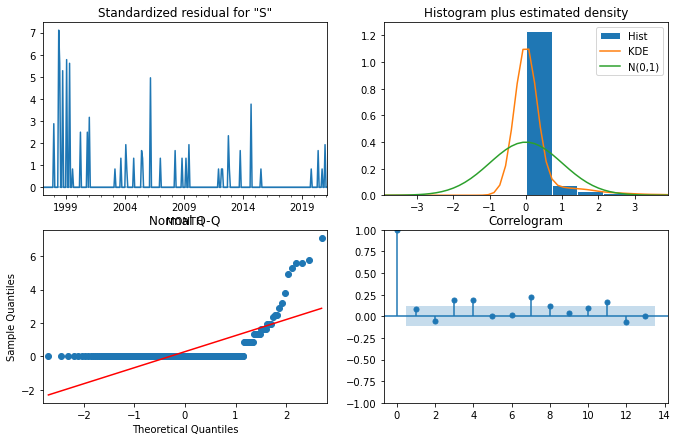

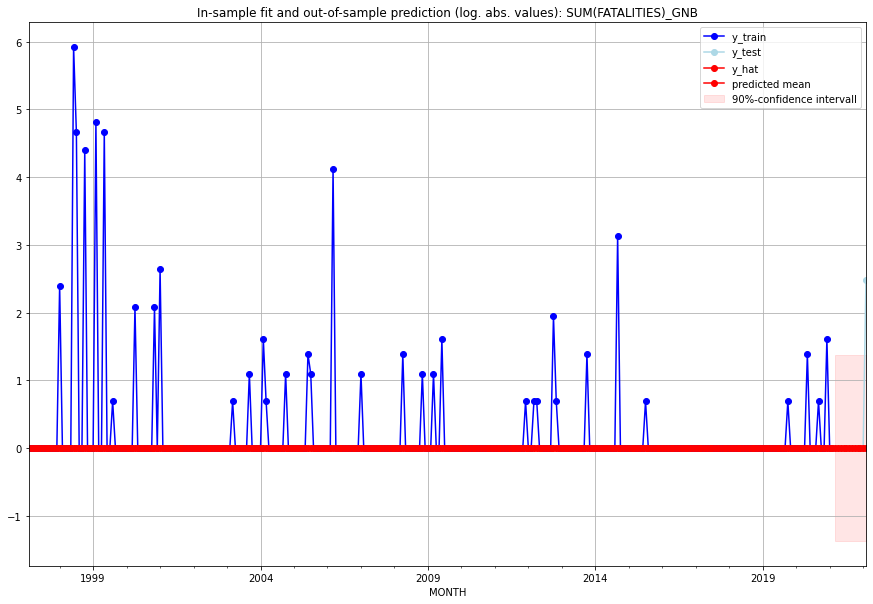

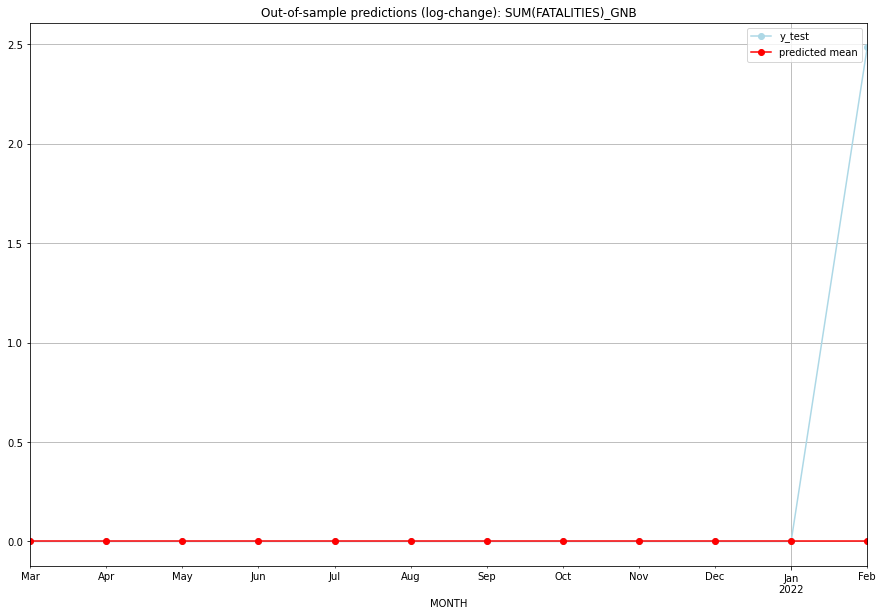

TADDA: 0.20707555414900003
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   GNB   
1  2021-04-01       0.0         0.0           0.0        0.000000   GNB   
2  2021-05-01       0.0         0.0           0.0        0.000000   GNB   
3  2021-06-01       0.0         0.0           0.0        0.000000   GNB   
4  2021-07-01       0.0         0.0           0.0        0.000000   GNB   
5  2021-08-01       0.0         0.0           0.0        0.000000   GNB   
6  2021-09-01       0.0         0.0           0.0        0.000000   GNB   
7  2021-10-01       0.0         0.0           0.0        0.000000   GNB   
8  2021-11-01       0.0         0.0           0.0        0.000000   GNB   
9  2021-12-01       0.0         0.0           0.0        0.000000   GNB   
10 2022-01-01       0.0         0.0           0.0        0.000000   GNB   
11 2022-02-01       0.0        11.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.09438267466893244, 'fold_results': [0.0, 0.29862657820467586, 0.11552453009332421, 0.057762265046662105, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GNQ   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                 -50.960
Date:                 Wed, 19 Oct 2022   AIC                            103.919
Time:                         10:43:14   BIC                            107.586
Sample:                     02-28-1997   HQIC                           105.388
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

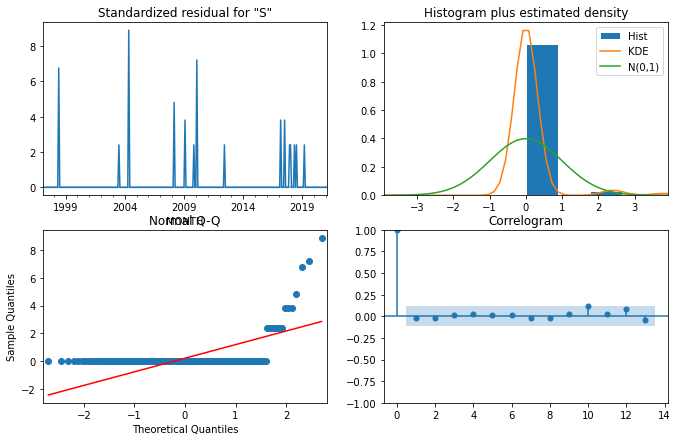

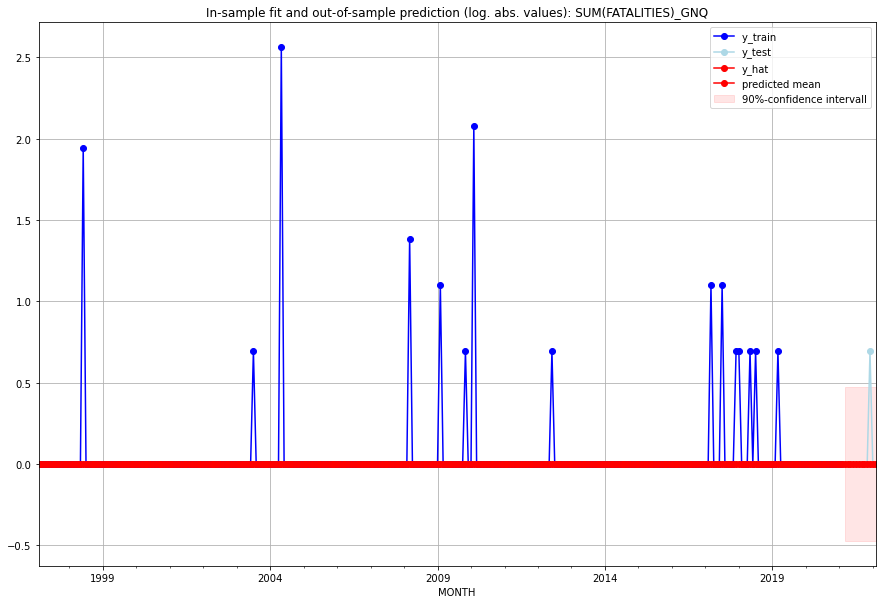

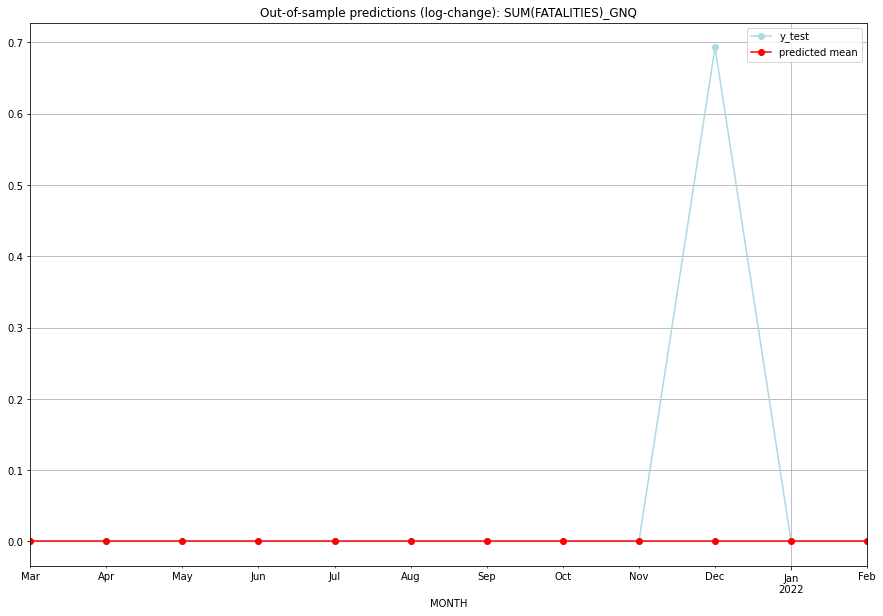

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   GNQ   
1  2021-04-01       0.0         0.0           0.0        0.000000   GNQ   
2  2021-05-01       0.0         0.0           0.0        0.000000   GNQ   
3  2021-06-01       0.0         0.0           0.0        0.000000   GNQ   
4  2021-07-01       0.0         0.0           0.0        0.000000   GNQ   
5  2021-08-01       0.0         0.0           0.0        0.000000   GNQ   
6  2021-09-01       0.0         0.0           0.0        0.000000   GNQ   
7  2021-10-01       0.0         0.0           0.0        0.000000   GNQ   
8  2021-11-01       0.0         0.0           0.0        0.000000   GNQ   
9  2021-12-01       0.0         1.0           0.0        0.693147   GNQ   
10 2022-01-01       0.0         0.0           0.0        0.000000   GNQ   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3291575470704967, 'fold_results': [0.38504418541174174, 0.2732709087292517]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GRC   No. Observations:                   38
Model:                SARIMAX(2, 0, 0)   Log Likelihood                 -24.529
Date:                 Wed, 19 Oct 2022   AIC                             59.057
Time:                         10:43:24   BIC                             67.245
Sample:                     01-31-2018   HQIC                            61.970
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0007      0

<Figure size 432x288 with 0 Axes>

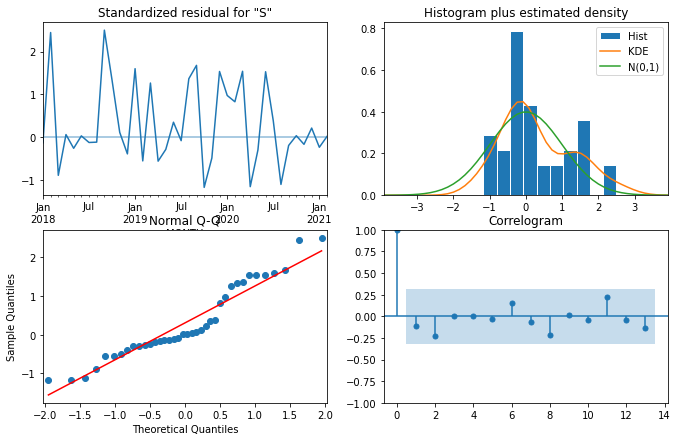

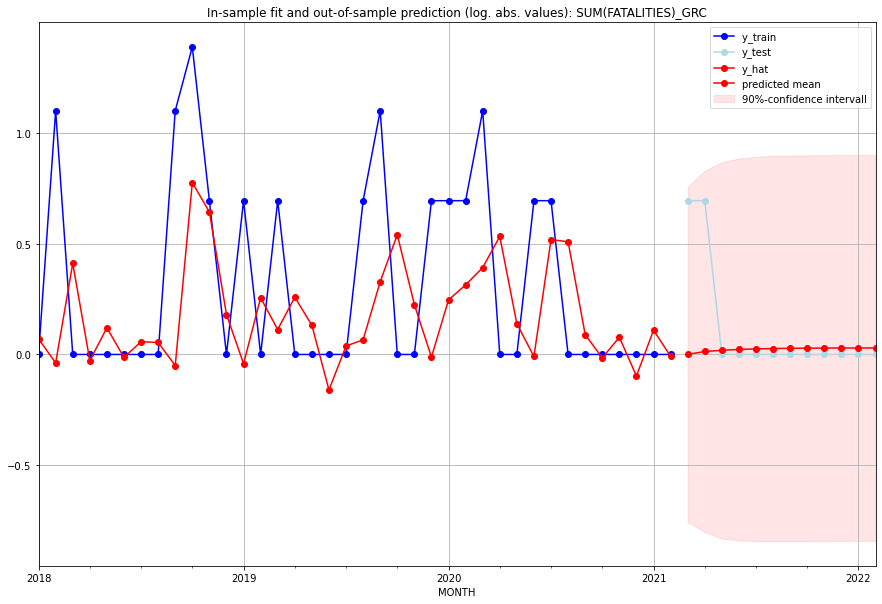

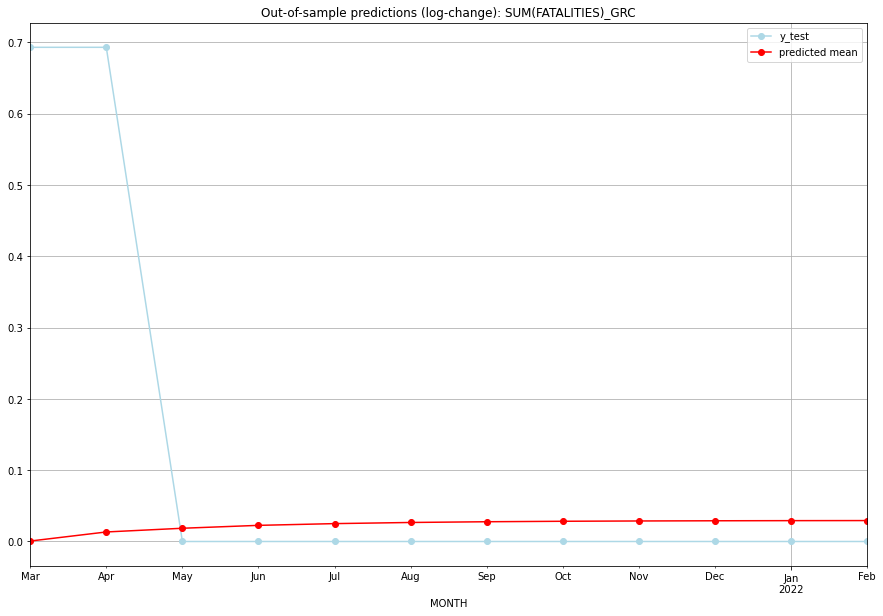

TADDA: 0.13647781489405805
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.000626         1.0      0.000625        0.693147   GRC   
1  2021-04-01  0.013451         1.0      0.013361        0.693147   GRC   
2  2021-05-01  0.018738         0.0      0.018565        0.000000   GRC   
3  2021-06-01  0.022888         0.0      0.022630        0.000000   GRC   
4  2021-07-01  0.025385         0.0      0.025068        0.000000   GRC   
5  2021-08-01  0.027036         0.0      0.026677        0.000000   GRC   
6  2021-09-01  0.028088         0.0      0.027701        0.000000   GRC   
7  2021-10-01  0.028768         0.0      0.028362        0.000000   GRC   
8  2021-11-01  0.029204         0.0      0.028786        0.000000   GRC   
9  2021-12-01  0.029484         0.0      0.029058        0.000000   GRC   
10 2022-01-01  0.029665         0.0      0.029233        0.000000   GRC   
11 2022-02-01  0.029781         0.0      0.029346   

<Figure size 432x288 with 0 Axes>

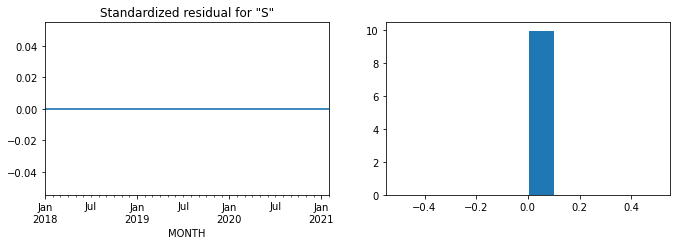

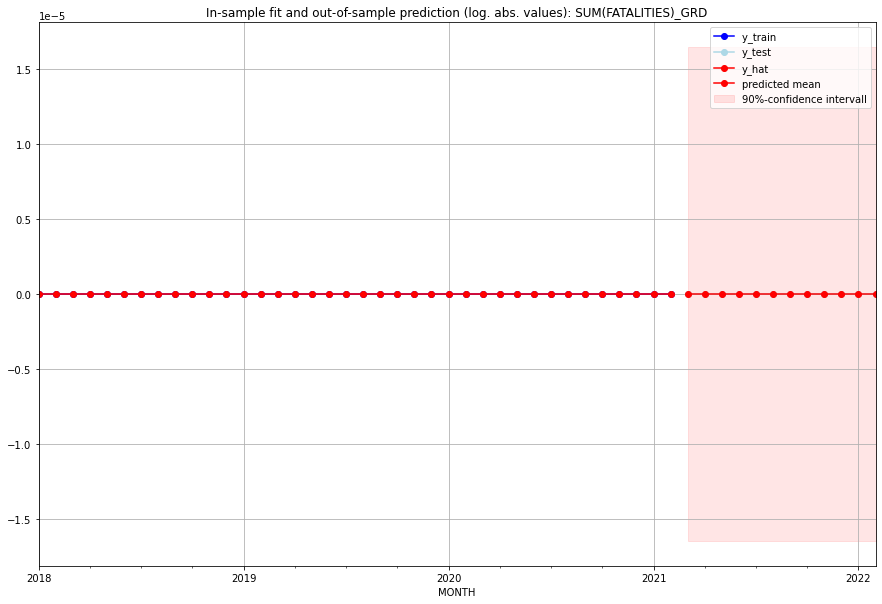

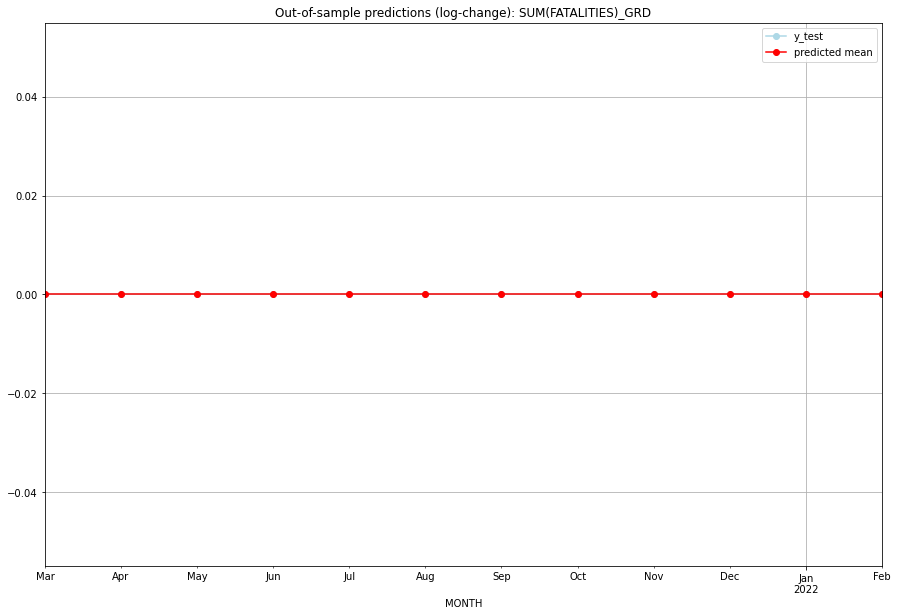

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   GRD   
1  2021-04-01       0.0         0.0           0.0             0.0   GRD   
2  2021-05-01       0.0         0.0           0.0             0.0   GRD   
3  2021-06-01       0.0         0.0           0.0             0.0   GRD   
4  2021-07-01       0.0         0.0           0.0             0.0   GRD   
5  2021-08-01       0.0         0.0           0.0             0.0   GRD   
6  2021-09-01       0.0         0.0           0.0             0.0   GRD   
7  2021-10-01       0.0         0.0           0.0             0.0   GRD   
8  2021-11-01       0.0         0.0           0.0             0.0   GRD   
9  2021-12-01       0.0         0.0           0.0             0.0   GRD   
10 2022-01-01       0.0         0.0           0.0             0.0   GRD   
11 2022-02-01       0.0         0.0           0.0             0.0   

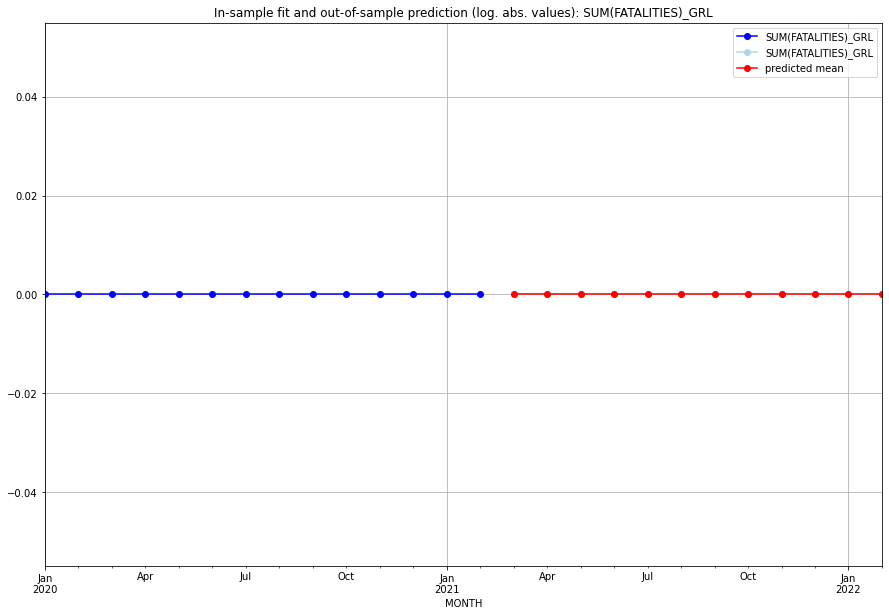

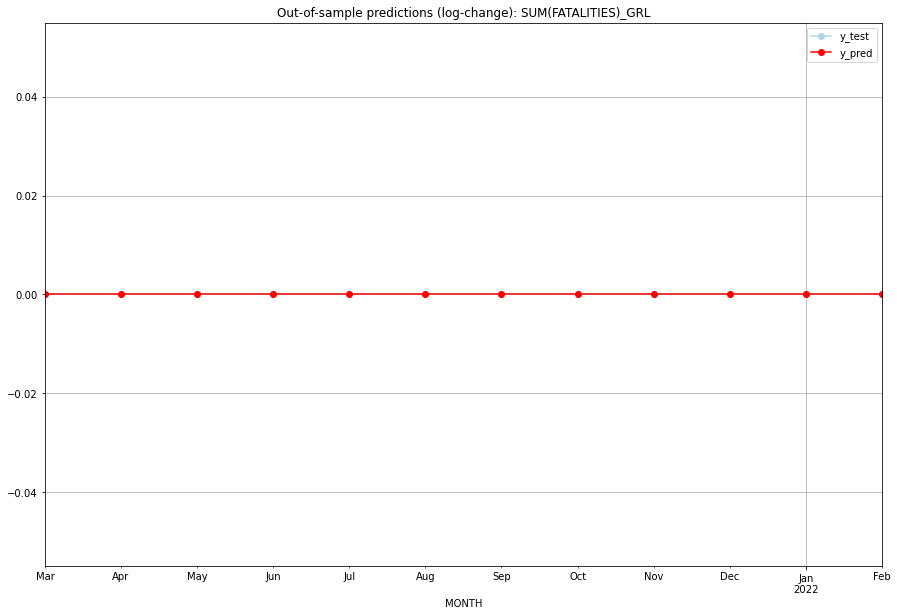

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   GRL   
1  2021-04-01       0.0         0.0           0.0             0.0   GRL   
2  2021-05-01       0.0         0.0           0.0             0.0   GRL   
3  2021-06-01       0.0         0.0           0.0             0.0   GRL   
4  2021-07-01       0.0         0.0           0.0             0.0   GRL   
5  2021-08-01       0.0         0.0           0.0             0.0   GRL   
6  2021-09-01       0.0         0.0           0.0             0.0   GRL   
7  2021-10-01       0.0         0.0           0.0             0.0   GRL   
8  2021-11-01       0.0         0.0           0.0             0.0   GRL   
9  2021-12-01       0.0         0.0           0.0             0.0   GRL   
10 2022-01-01       0.0         0.0           0.0             0.0   GRL   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.30681852901319223, 'fold_results': [0.1823170192759863, 0.4313200387503982]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GTM   No. Observations:                   38
Model:                SARIMAX(2, 0, 2)   Log Likelihood                  -4.562
Date:                 Wed, 19 Oct 2022   AIC                             19.123
Time:                         10:43:48   BIC                             27.311
Sample:                     01-31-2018   HQIC                            22.036
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0016      0

<Figure size 432x288 with 0 Axes>

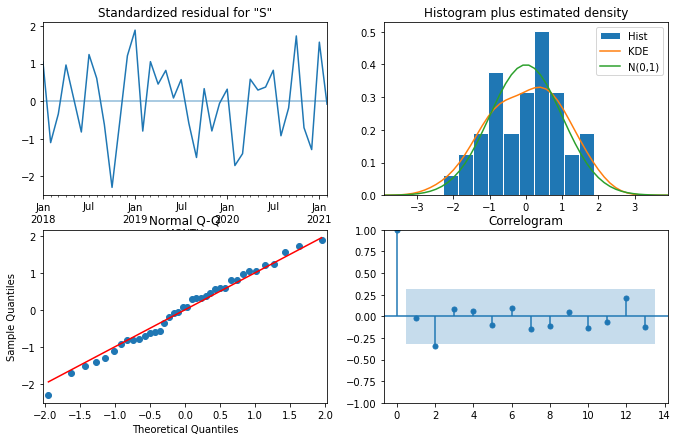

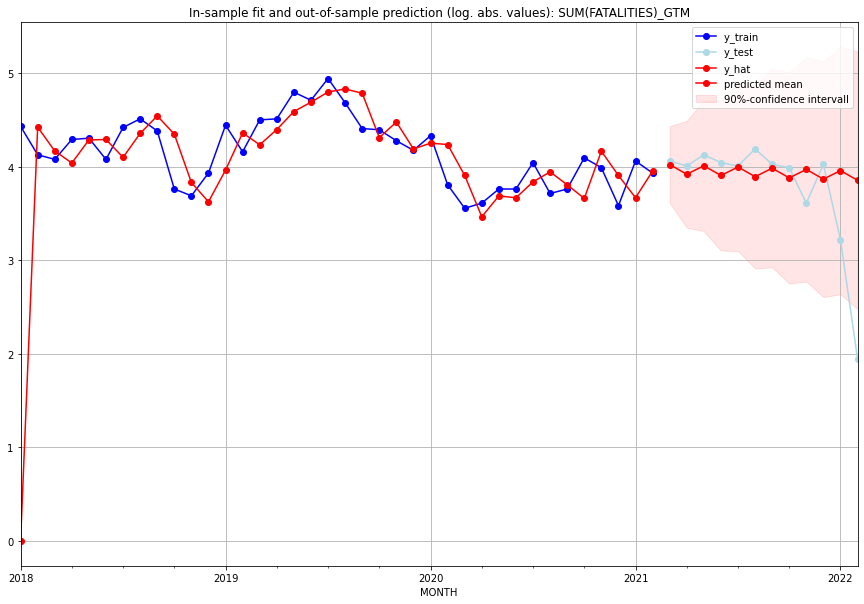

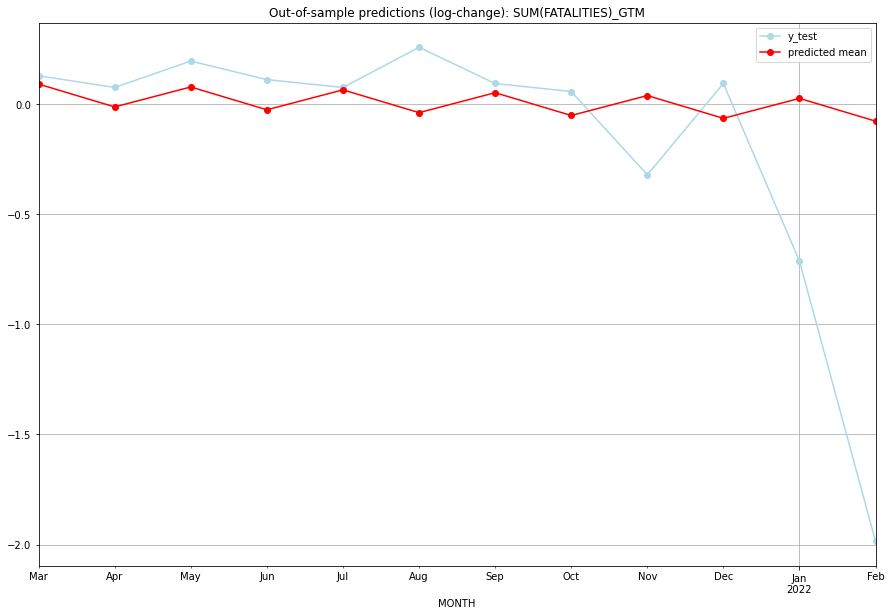

TADDA: 0.3552144940004633
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  54.846595        57.0      0.090783        0.128617   GTM   
1  2021-04-01  49.351155        54.0     -0.012804        0.075508   GTM   
2  2021-05-01  54.122011        61.0      0.077723        0.195309   GTM   
3  2021-06-01  48.699823        56.0     -0.025824        0.111226   GTM   
4  2021-07-01  53.409160        54.0      0.064707        0.075508   GTM   
5  2021-08-01  48.059016        65.0     -0.038802        0.257829   GTM   
6  2021-09-01  52.707822        55.0      0.051733        0.093526   GTM   
7  2021-10-01  47.428537        53.0     -0.051736        0.057158   GTM   
8  2021-11-01  52.017782        36.0      0.038802       -0.320908   GTM   
9  2021-12-01  46.808192        55.0     -0.064629        0.093526   GTM   
10 2022-01-01  51.338828        24.0      0.025913       -0.712950   GTM   
11 2022-02-01  46.197792         6.0     

<Figure size 432x288 with 0 Axes>

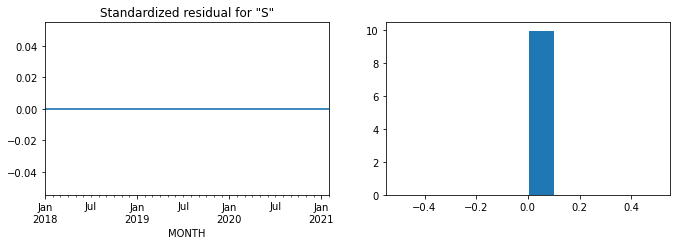

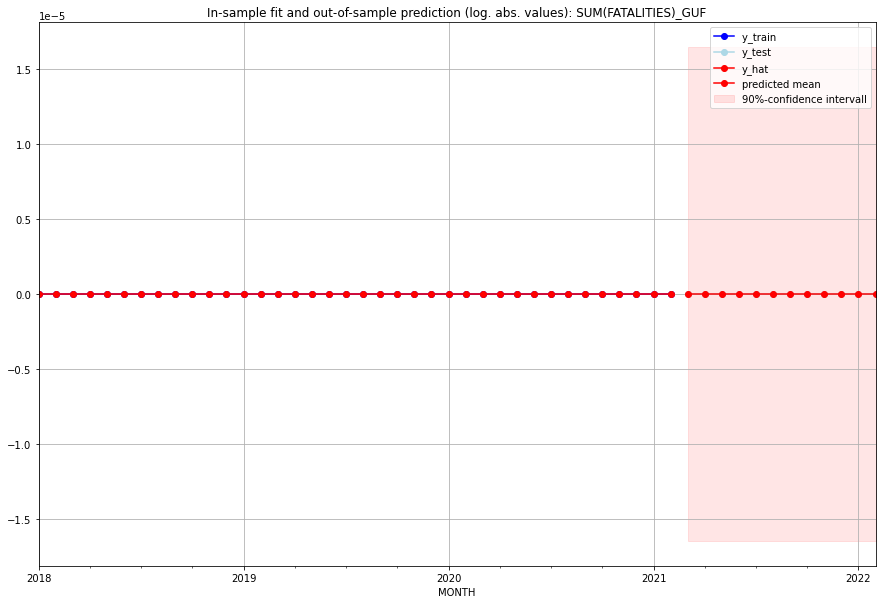

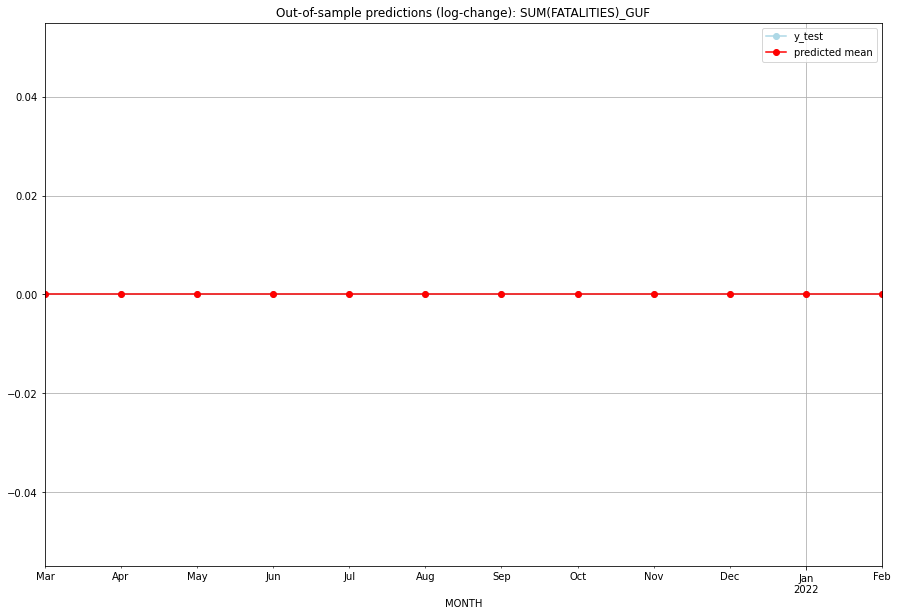

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   GUF   
1  2021-04-01       0.0         0.0           0.0             0.0   GUF   
2  2021-05-01       0.0         0.0           0.0             0.0   GUF   
3  2021-06-01       0.0         0.0           0.0             0.0   GUF   
4  2021-07-01       0.0         0.0           0.0             0.0   GUF   
5  2021-08-01       0.0         0.0           0.0             0.0   GUF   
6  2021-09-01       0.0         0.0           0.0             0.0   GUF   
7  2021-10-01       0.0         0.0           0.0             0.0   GUF   
8  2021-11-01       0.0         0.0           0.0             0.0   GUF   
9  2021-12-01       0.0         0.0           0.0             0.0   GUF   
10 2022-01-01       0.0         0.0           0.0             0.0   GUF   
11 2022-02-01       0.0         0.0           0.0             0.0   

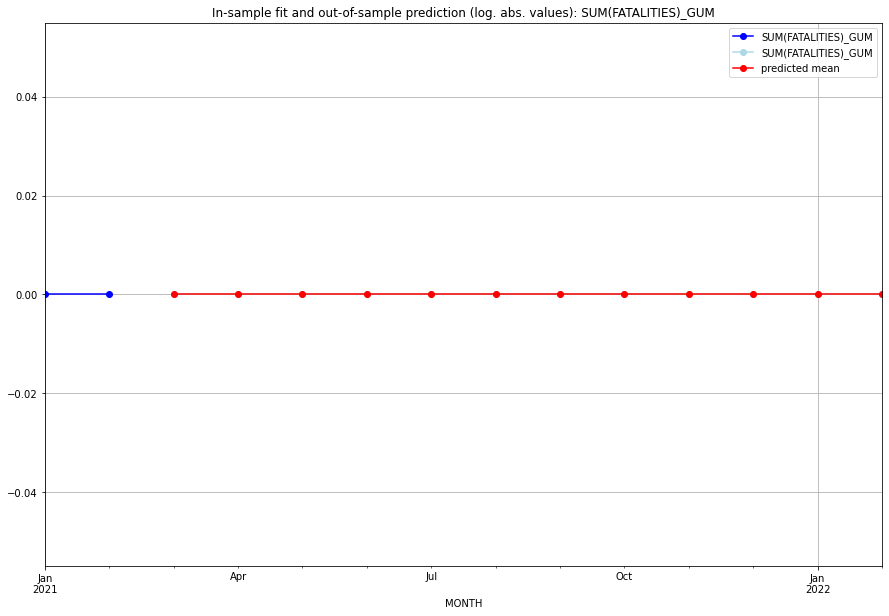

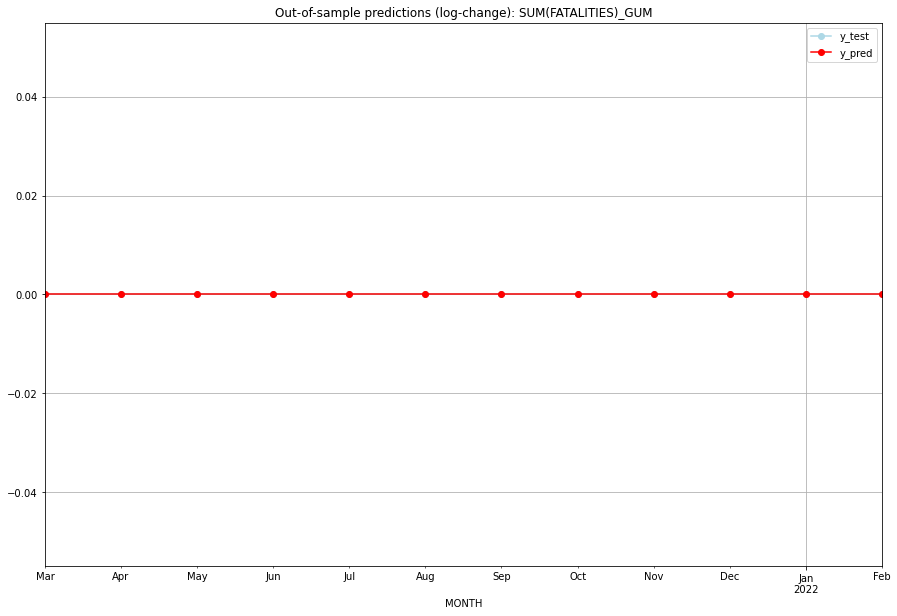

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   GUM   
1  2021-04-01       0.0         0.0           0.0             0.0   GUM   
2  2021-05-01       0.0         0.0           0.0             0.0   GUM   
3  2021-06-01       0.0         0.0           0.0             0.0   GUM   
4  2021-07-01       0.0         0.0           0.0             0.0   GUM   
5  2021-08-01       0.0         0.0           0.0             0.0   GUM   
6  2021-09-01       0.0         0.0           0.0             0.0   GUM   
7  2021-10-01       0.0         0.0           0.0             0.0   GUM   
8  2021-11-01       0.0         0.0           0.0             0.0   GUM   
9  2021-12-01       0.0         0.0           0.0             0.0   GUM   
10 2022-01-01       0.0         0.0           0.0             0.0   GUM   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.12482217806474963, 'fold_results': [0.057762265046662105, 0.19188209108283716]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_GUY   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                 -13.434
Date:                 Wed, 19 Oct 2022   AIC                             28.868
Time:                         10:44:09   BIC                             30.506
Sample:                     01-31-2018   HQIC                            29.451
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1187    

<Figure size 432x288 with 0 Axes>

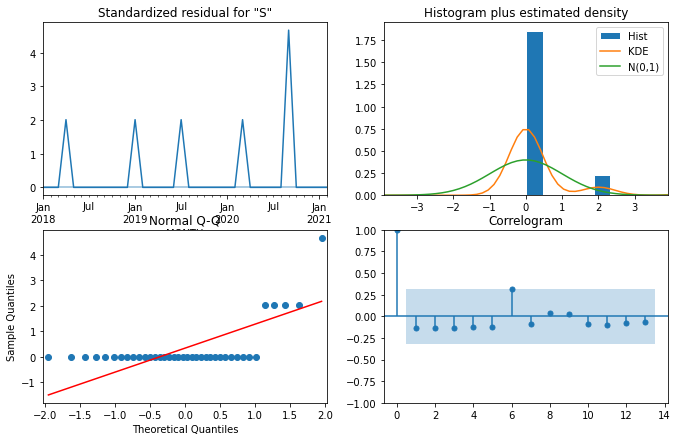

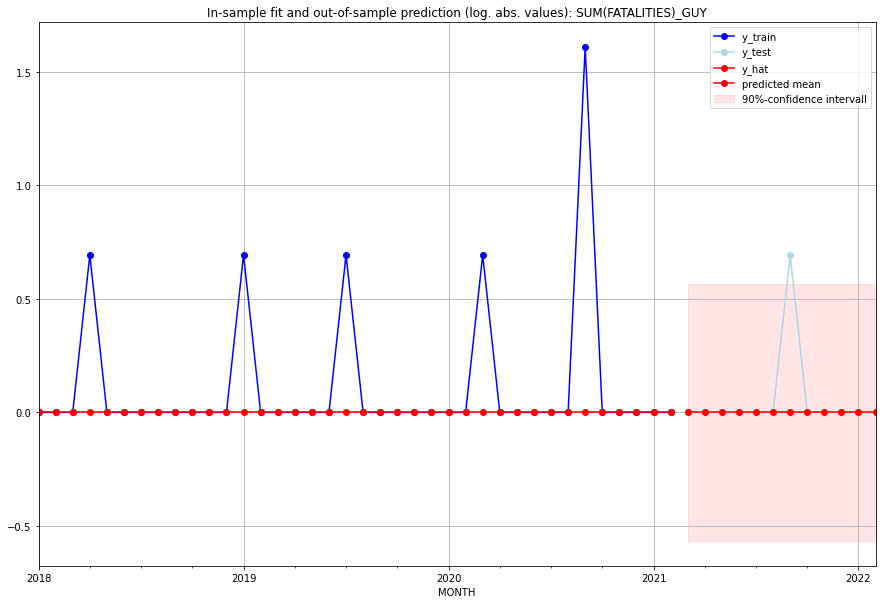

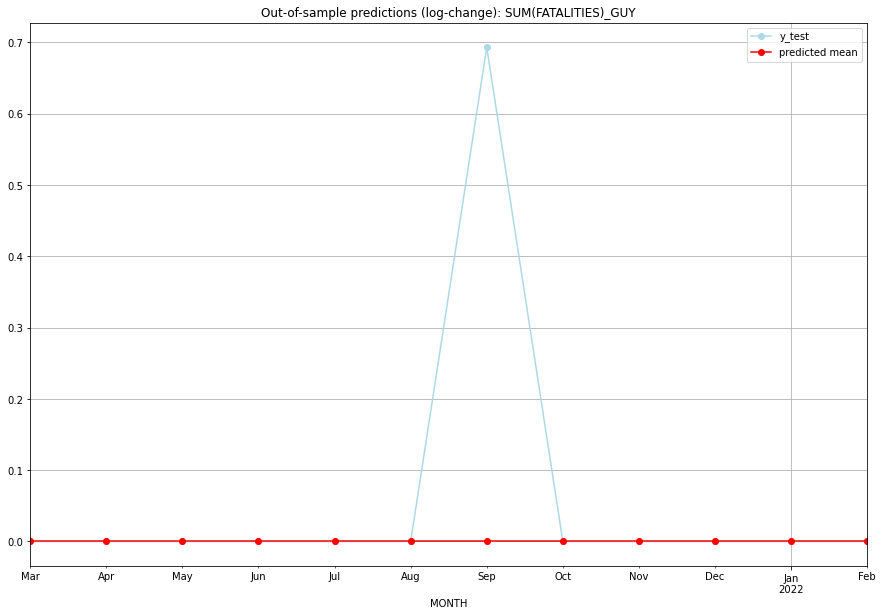

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   GUY   
1  2021-04-01       0.0         0.0           0.0        0.000000   GUY   
2  2021-05-01       0.0         0.0           0.0        0.000000   GUY   
3  2021-06-01       0.0         0.0           0.0        0.000000   GUY   
4  2021-07-01       0.0         0.0           0.0        0.000000   GUY   
5  2021-08-01       0.0         0.0           0.0        0.000000   GUY   
6  2021-09-01       0.0         1.0           0.0        0.693147   GUY   
7  2021-10-01       0.0         0.0           0.0        0.000000   GUY   
8  2021-11-01       0.0         0.0           0.0        0.000000   GUY   
9  2021-12-01       0.0         0.0           0.0        0.000000   GUY   
10 2022-01-01       0.0         0.0           0.0        0.000000   GUY   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.028881132523331052, 'fold_results': [0.057762265046662105, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HKG   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  29.122
Date:                 Wed, 19 Oct 2022   AIC                            -56.244
Time:                         10:44:24   BIC                            -54.606
Sample:                     01-31-2018   HQIC                           -55.661
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0126      0.001     18.

<Figure size 432x288 with 0 Axes>

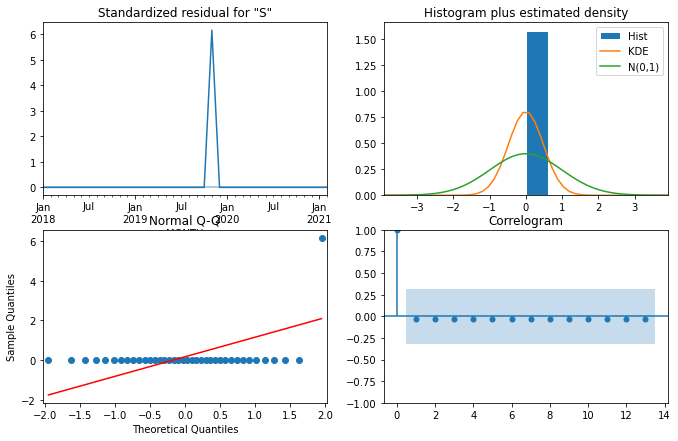

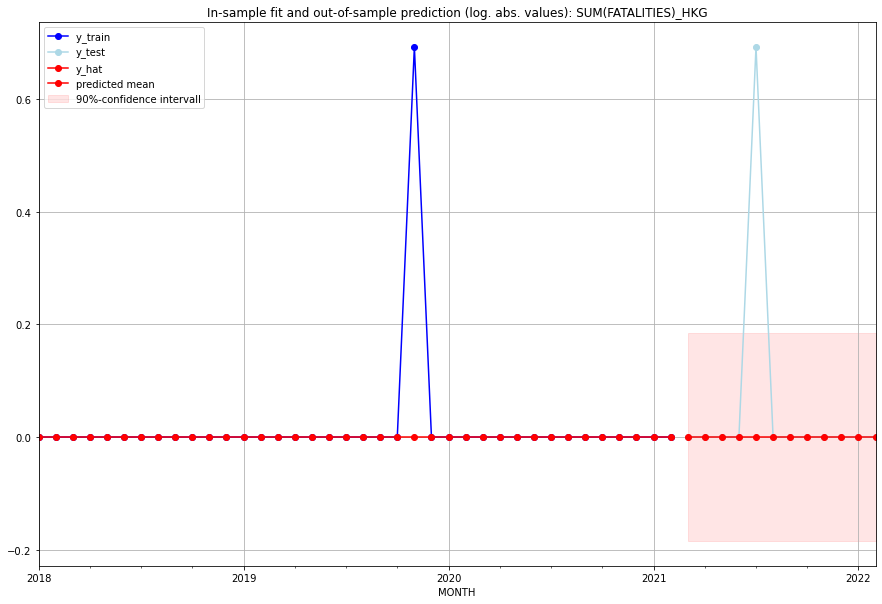

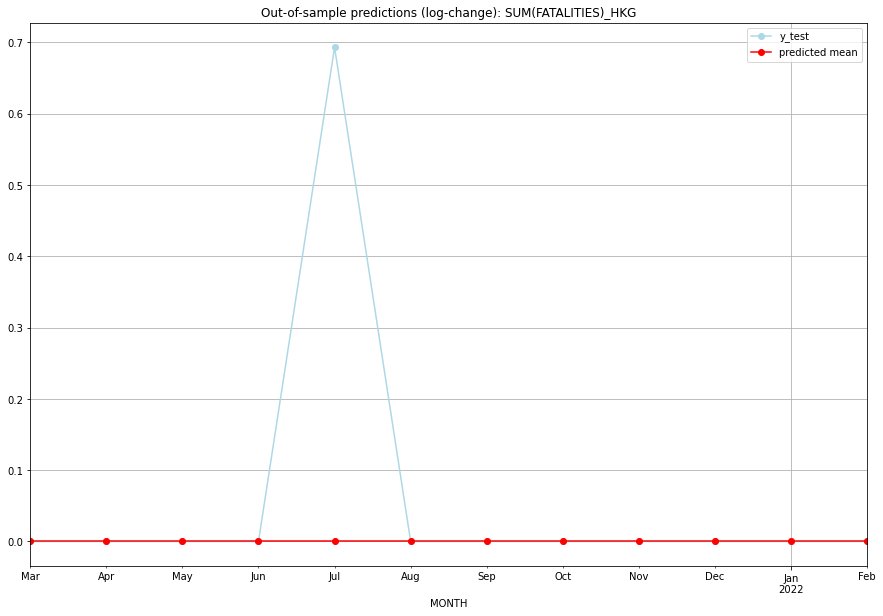

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   HKG   
1  2021-04-01       0.0         0.0           0.0        0.000000   HKG   
2  2021-05-01       0.0         0.0           0.0        0.000000   HKG   
3  2021-06-01       0.0         0.0           0.0        0.000000   HKG   
4  2021-07-01       0.0         1.0           0.0        0.693147   HKG   
5  2021-08-01       0.0         0.0           0.0        0.000000   HKG   
6  2021-09-01       0.0         0.0           0.0        0.000000   HKG   
7  2021-10-01       0.0         0.0           0.0        0.000000   HKG   
8  2021-11-01       0.0         0.0           0.0        0.000000   HKG   
9  2021-12-01       0.0         0.0           0.0        0.000000   HKG   
10 2022-01-01       0.0         0.0           0.0        0.000000   HKG   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.1796918147091713, 'fold_results': [nan, 0.1796918147091713]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HND   No. Observations:                   38
Model:                SARIMAX(3, 1, 3)   Log Likelihood                  -3.362
Date:                 Wed, 19 Oct 2022   AIC                             26.724
Time:                         10:44:39   BIC                             42.833
Sample:                     01-31-2018   HQIC                            32.403
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0360      0.029      1.262 

<Figure size 432x288 with 0 Axes>

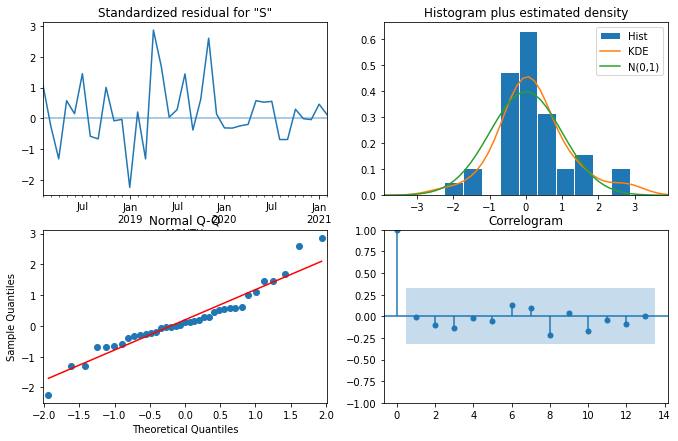

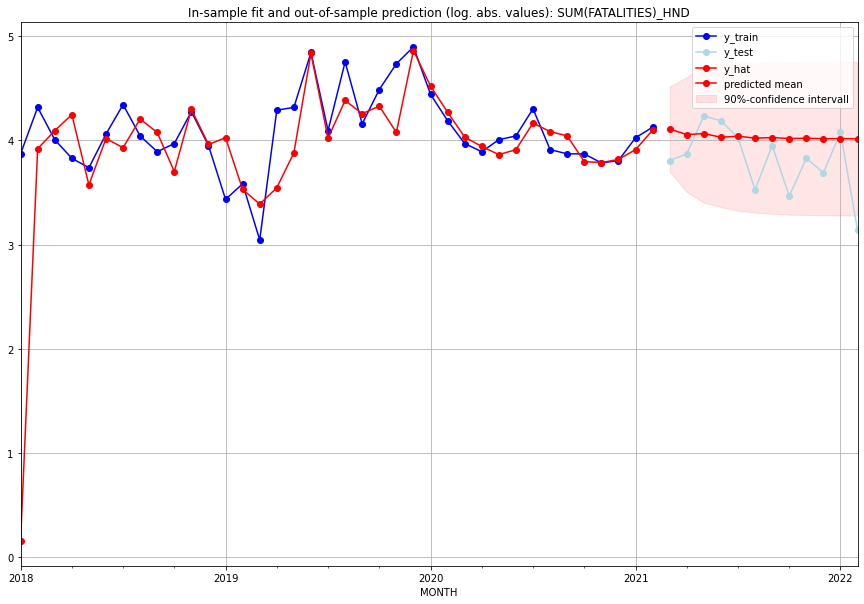

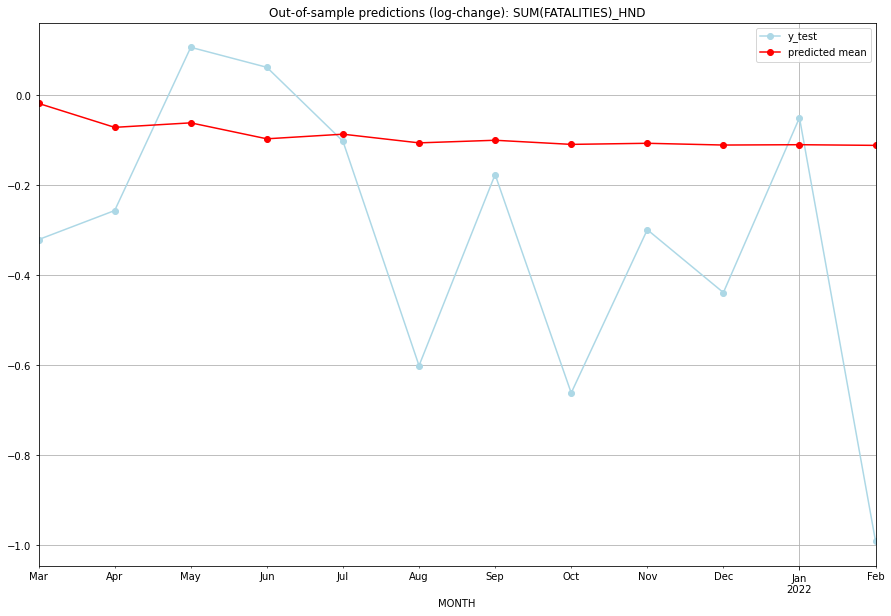

TADDA: 0.2976941958614635
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  59.910196        44.0     -0.017734       -0.320472   HND   
1  2021-04-01  56.751968        47.0     -0.070977       -0.255933   HND   
2  2021-05-01  57.333518        68.0     -0.060958        0.106972   HND   
3  2021-06-01  55.300196        65.0     -0.096436        0.062520   HND   
4  2021-07-01  55.881186        55.0     -0.086170       -0.101783   HND   
5  2021-08-01  54.794490        33.0     -0.105459       -0.600774   HND   
6  2021-09-01  55.118921        51.0     -0.099661       -0.175891   HND   
7  2021-10-01  54.606420        31.0     -0.108836       -0.661398   HND   
8  2021-11-01  54.742604        45.0     -0.106390       -0.298493   HND   
9  2021-12-01  54.525719        39.0     -0.110288       -0.438255   HND   
10 2022-01-01  54.566723        58.0     -0.109550       -0.049597   HND   
11 2022-02-01  54.484685        22.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [nan, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HRV   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                  14.618
Date:                 Wed, 19 Oct 2022   AIC                            -21.236
Time:                         10:44:52   BIC                            -14.792
Sample:                     01-31-2018   HQIC                           -18.964
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.7319      0.133     -5.518      0.000      -0.992      -0

<Figure size 432x288 with 0 Axes>

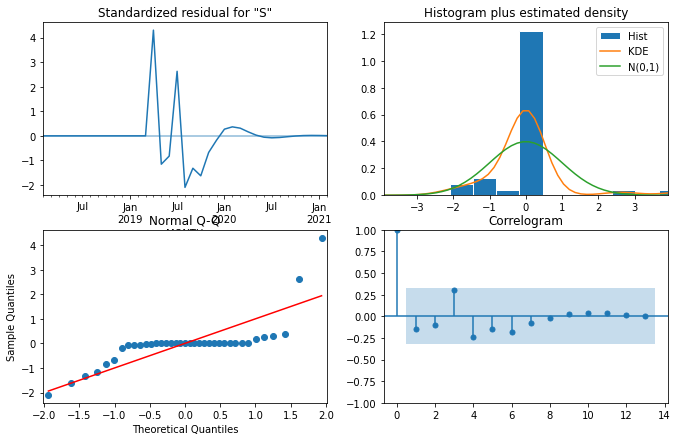

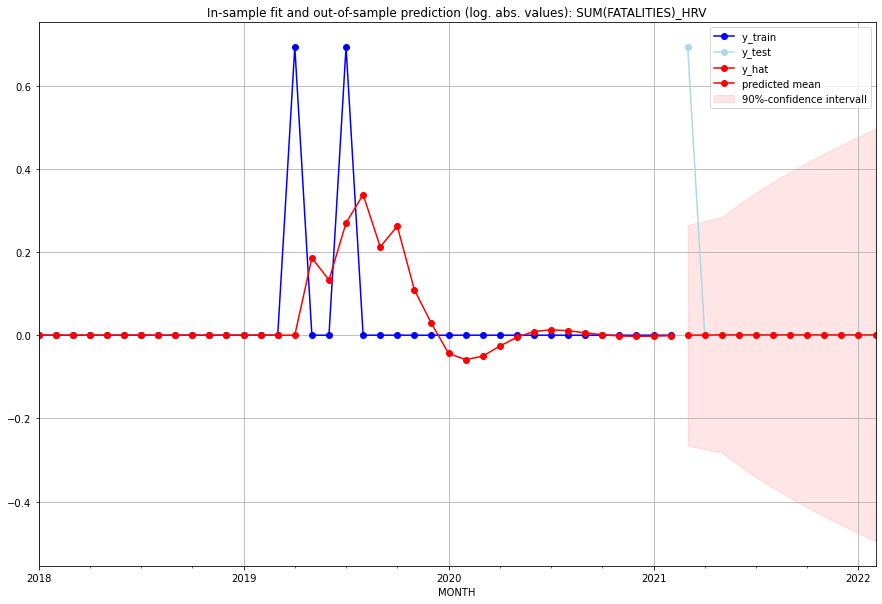

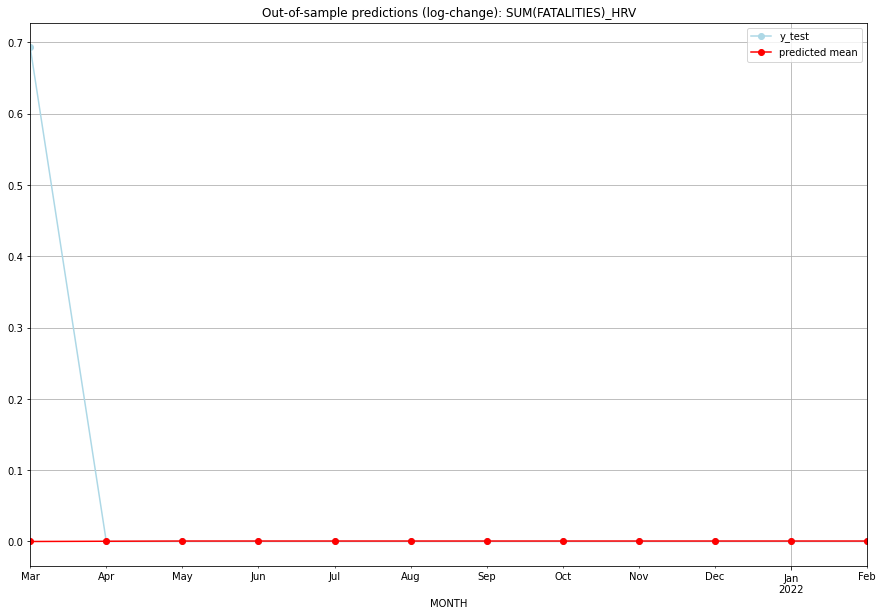

TADDA: 0.058333509986322966
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.000000         1.0      0.000000        0.693147   HRV   
1  2021-04-01  0.000344         0.0      0.000344        0.000000   HRV   
2  2021-05-01  0.000651         0.0      0.000651        0.000000   HRV   
3  2021-06-01  0.000651         0.0      0.000651        0.000000   HRV   
4  2021-07-01  0.000651         0.0      0.000651        0.000000   HRV   
5  2021-08-01  0.000651         0.0      0.000651        0.000000   HRV   
6  2021-09-01  0.000651         0.0      0.000651        0.000000   HRV   
7  2021-10-01  0.000651         0.0      0.000651        0.000000   HRV   
8  2021-11-01  0.000651         0.0      0.000651        0.000000   HRV   
9  2021-12-01  0.000651         0.0      0.000651        0.000000   HRV   
10 2022-01-01  0.000651         0.0      0.000651        0.000000   HRV   
11 2022-02-01  0.000651         0.0      0.000651  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.29090996457587776, 'fold_results': [nan, 0.29090996457587776]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_HTI   No. Observations:                   38
Model:                SARIMAX(2, 1, 3)   Log Likelihood                 -42.760
Date:                 Wed, 19 Oct 2022   AIC                            101.521
Time:                         10:45:03   BIC                            114.408
Sample:                     01-31-2018   HQIC                           106.064
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0181      0.114     -0.15

<Figure size 432x288 with 0 Axes>

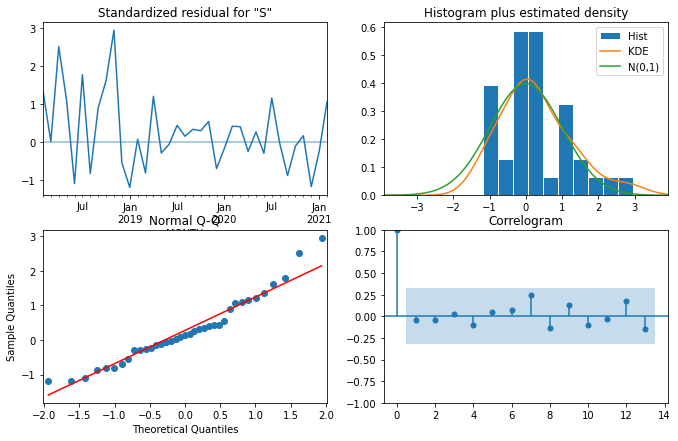

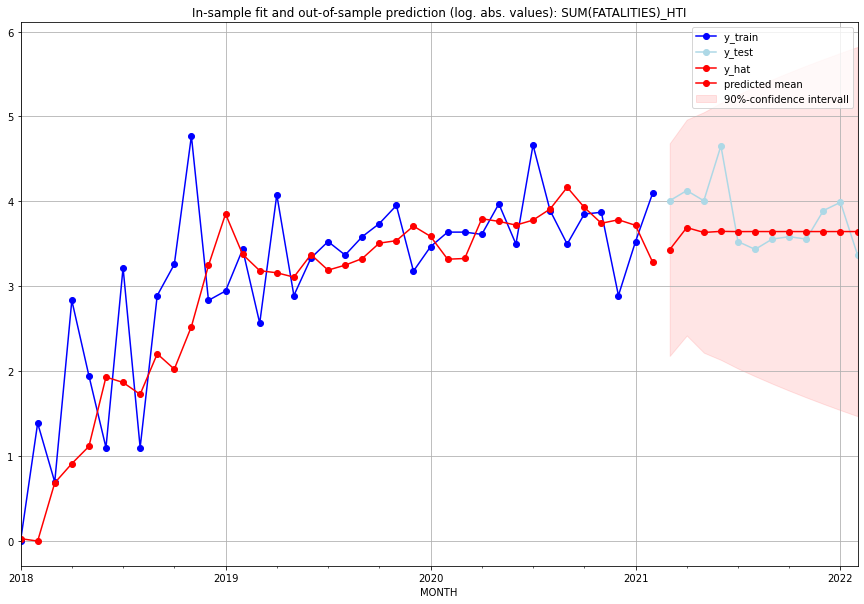

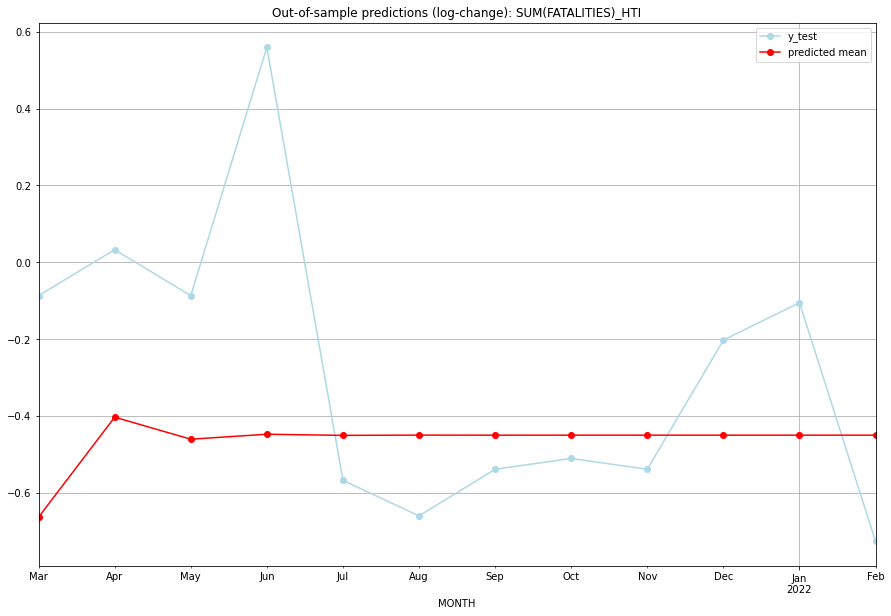

TADDA: 0.3900192625430979
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  29.898783        54.0     -0.663628       -0.087011   HTI   
1  2021-04-01  39.081124        61.0     -0.403439        0.032790   HTI   
2  2021-05-01  36.850146        54.0     -0.460710       -0.087011   HTI   
3  2021-06-01  37.342308       104.0     -0.447791        0.559616   HTI   
4  2021-07-01  37.228293        33.0     -0.450769       -0.567984   HTI   
5  2021-08-01  37.255029        30.0     -0.450070       -0.660357   HTI   
6  2021-09-01  37.248656        34.0     -0.450236       -0.538997   HTI   
7  2021-10-01  37.250193        35.0     -0.450196       -0.510826   HTI   
8  2021-11-01  37.249819        34.0     -0.450206       -0.538997   HTI   
9  2021-12-01  37.249911        48.0     -0.450203       -0.202524   HTI   
10 2022-01-01  37.249888        53.0     -0.450204       -0.105361   HTI   
11 2022-02-01  37.249894        28.0     

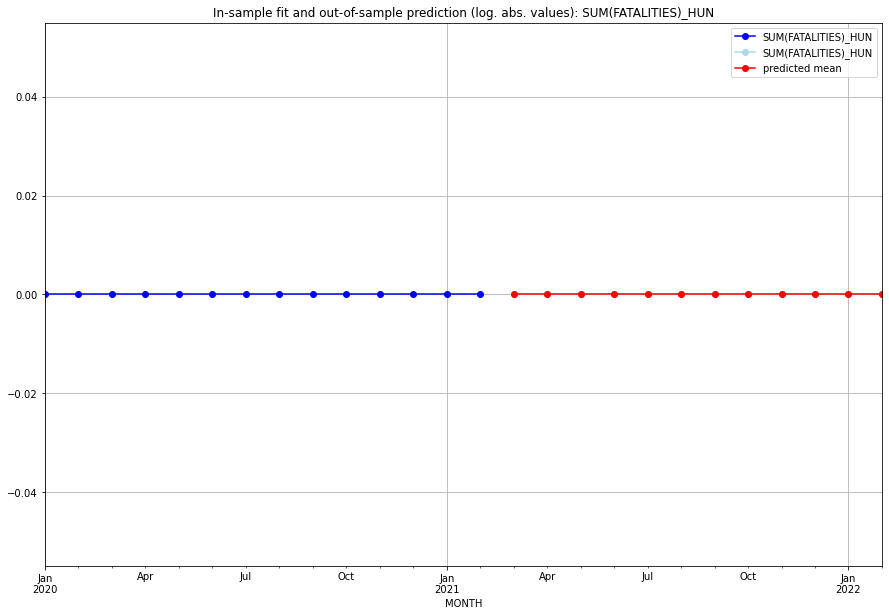

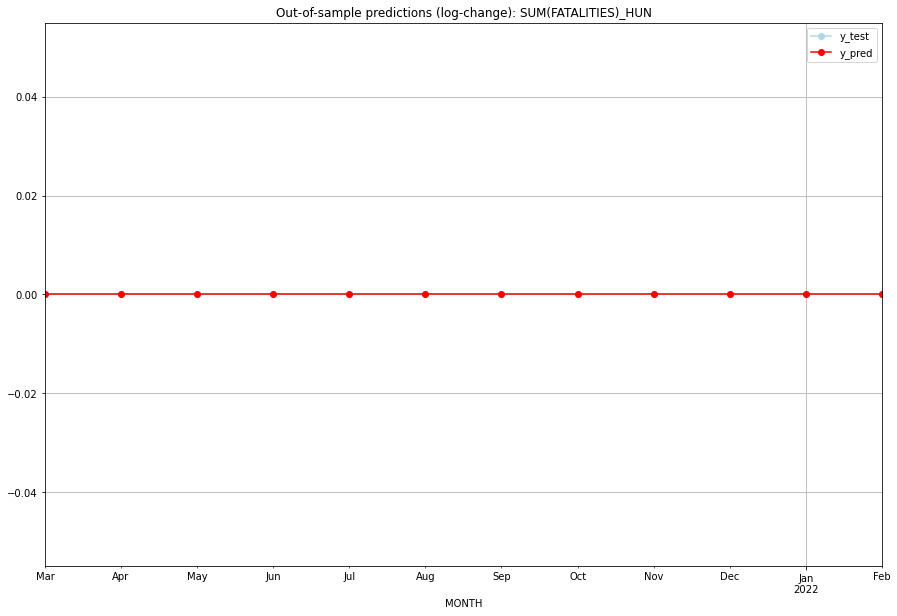

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   HUN   
1  2021-04-01       0.0         0.0           0.0             0.0   HUN   
2  2021-05-01       0.0         0.0           0.0             0.0   HUN   
3  2021-06-01       0.0         0.0           0.0             0.0   HUN   
4  2021-07-01       0.0         0.0           0.0             0.0   HUN   
5  2021-08-01       0.0         0.0           0.0             0.0   HUN   
6  2021-09-01       0.0         0.0           0.0             0.0   HUN   
7  2021-10-01       0.0         0.0           0.0             0.0   HUN   
8  2021-11-01       0.0         0.0           0.0             0.0   HUN   
9  2021-12-01       0.0         0.0           0.0             0.0   HUN   
10 2022-01-01       0.0         0.0           0.0             0.0   HUN   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.6985887919514409, 'fold_results': [0.6728996860684965, 0.5545674947198648, 1.1585582264805157, 0.6866712640528951, 0.4202472884354321]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IDN   No. Observations:                   74
Model:                SARIMAX(1, 1, 2)   Log Likelihood                 -86.430
Date:                 Wed, 19 Oct 2022   AIC                            180.860
Time:                         10:45:35   BIC                            190.022
Sample:                     01-31-2015   HQIC                           184.512
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

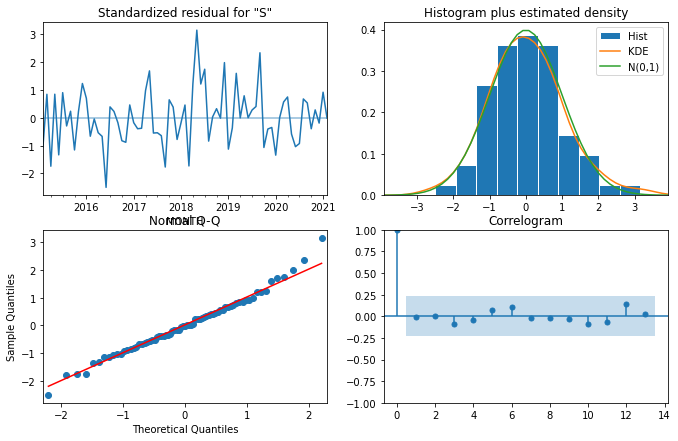

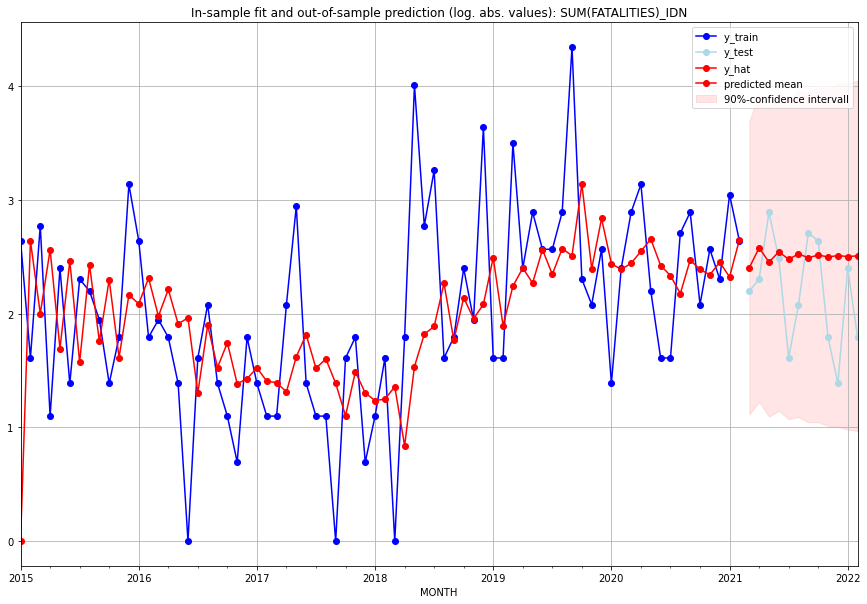

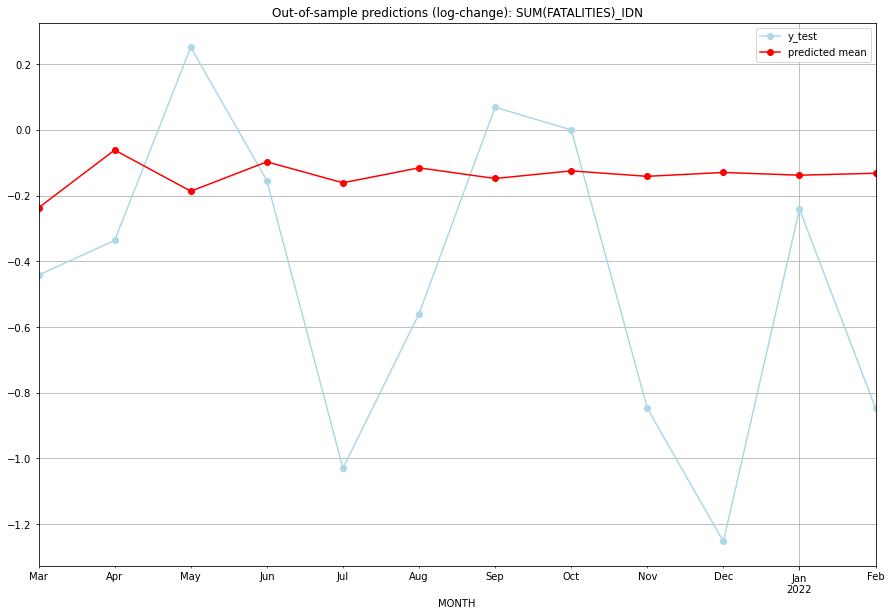

TADDA: 0.4676341984295646
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  10.045308         8.0     -0.237052       -0.441833   IDN   
1  2021-04-01  12.167611         9.0     -0.061297       -0.336472   IDN   
2  2021-05-01  10.616349        17.0     -0.186644        0.251314   IDN   
3  2021-06-01  11.702638        11.0     -0.097248       -0.154151   IDN   
4  2021-07-01  10.918039         4.0     -0.161004       -1.029619   IDN   
5  2021-08-01  11.472469         7.0     -0.115534       -0.559616   IDN   
6  2021-09-01  11.074484        14.0     -0.147963        0.068993   IDN   
7  2021-10-01  11.357001        13.0     -0.124835        0.000000   IDN   
8  2021-11-01  11.154845         5.0     -0.141329       -0.847298   IDN   
9  2021-12-01  11.298679         3.0     -0.129565       -1.252763   IDN   
10 2022-01-01  11.195925        10.0     -0.137955       -0.241162   IDN   
11 2022-02-01  11.269120         5.0     

<Figure size 432x288 with 0 Axes>

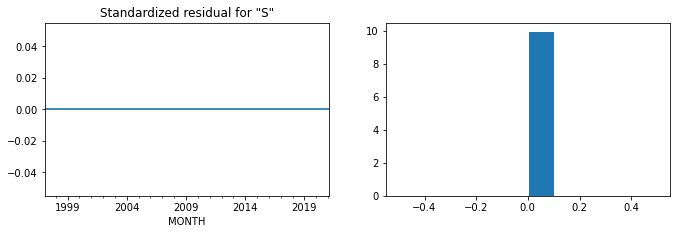

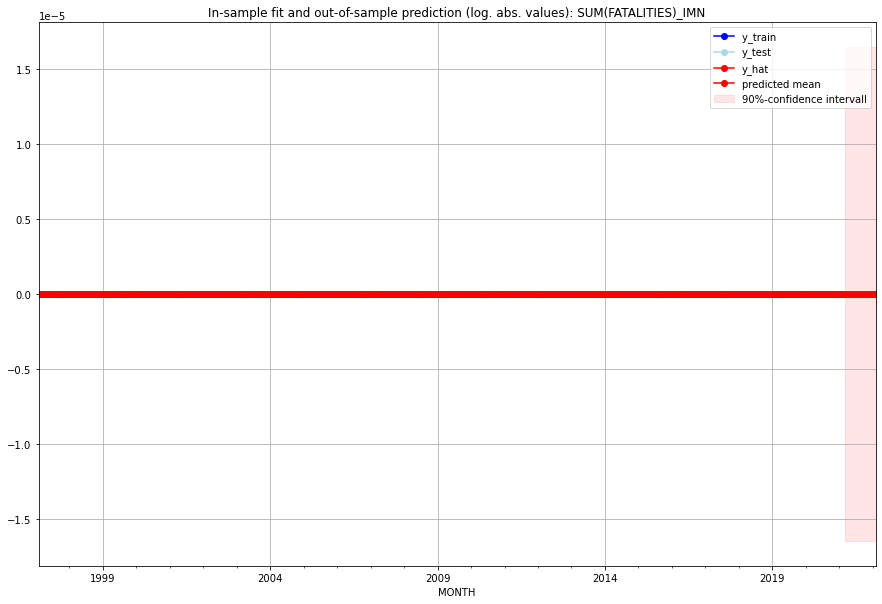

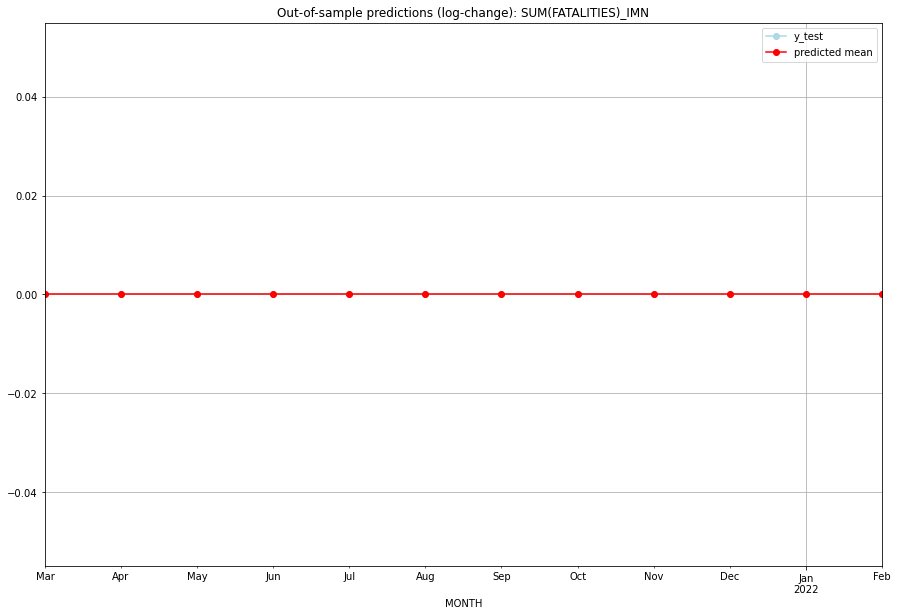

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   IMN   
1  2021-04-01       0.0         0.0           0.0             0.0   IMN   
2  2021-05-01       0.0         0.0           0.0             0.0   IMN   
3  2021-06-01       0.0         0.0           0.0             0.0   IMN   
4  2021-07-01       0.0         0.0           0.0             0.0   IMN   
5  2021-08-01       0.0         0.0           0.0             0.0   IMN   
6  2021-09-01       0.0         0.0           0.0             0.0   IMN   
7  2021-10-01       0.0         0.0           0.0             0.0   IMN   
8  2021-11-01       0.0         0.0           0.0             0.0   IMN   
9  2021-12-01       0.0         0.0           0.0             0.0   IMN   
10 2022-01-01       0.0         0.0           0.0             0.0   IMN   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.27339459004247674, 'fold_results': [0.21706795569138992, 0.24502000488971057, 0.36091898133049377, 0.2705714182583128]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IND   No. Observations:                   62
Model:                SARIMAX(1, 1, 1)   Log Likelihood                 -10.260
Date:                 Wed, 19 Oct 2022   AIC                             30.520
Time:                         10:46:09   BIC                             41.074
Sample:                     01-31-2016   HQIC                            34.656
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

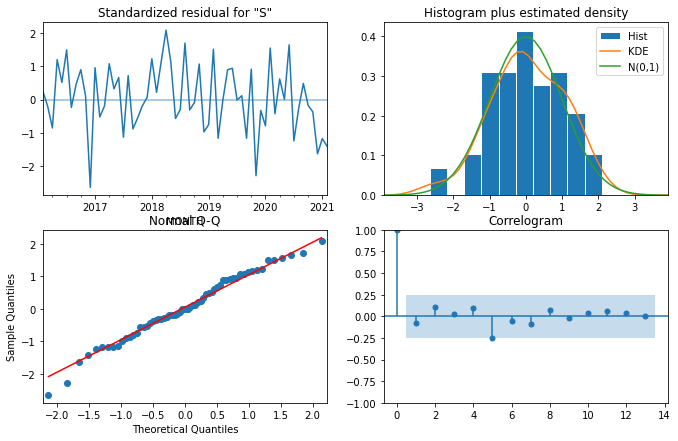

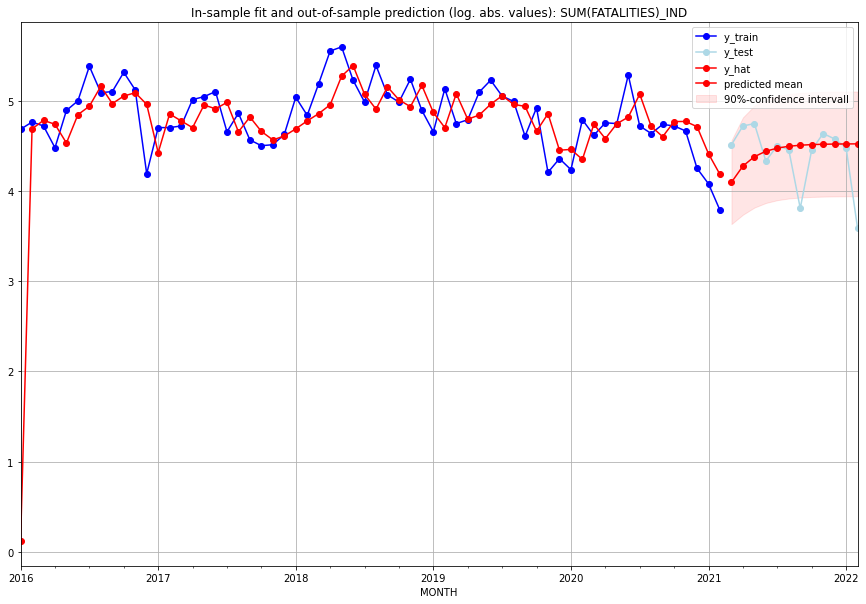

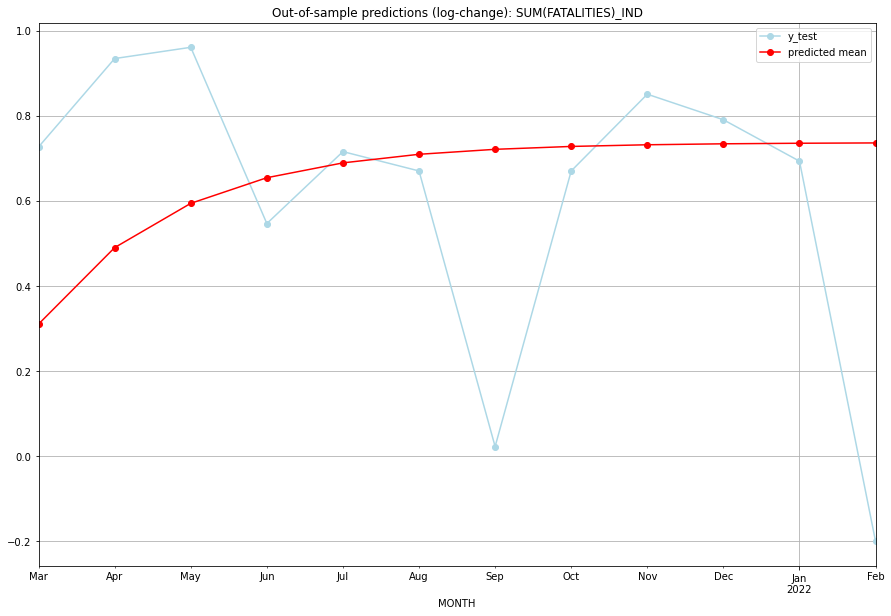

TADDA: 0.3372602773917384
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  59.011096        90.0      0.310340        0.726670   IND   
1  2021-04-01  70.822931       111.0      0.490014        0.934309   IND   
2  2021-05-01  78.696685       114.0      0.594038        0.960742   IND   
3  2021-06-01  83.643967        75.0      0.654264        0.546544   IND   
4  2021-07-01  86.647420        89.0      0.689133        0.715620   IND   
5  2021-08-01  88.434771        85.0      0.709320        0.670158   IND   
6  2021-09-01  89.486188        44.0      0.721008        0.022473   IND   
7  2021-10-01  90.100556        85.0      0.727774        0.670158   IND   
8  2021-11-01  90.458156       102.0      0.731692        0.850539   IND   
9  2021-12-01  90.665833        96.0      0.733960        0.790521   IND   
10 2022-01-01  90.786285        87.0      0.735273        0.693147   IND   
11 2022-02-01  90.856094        35.0     

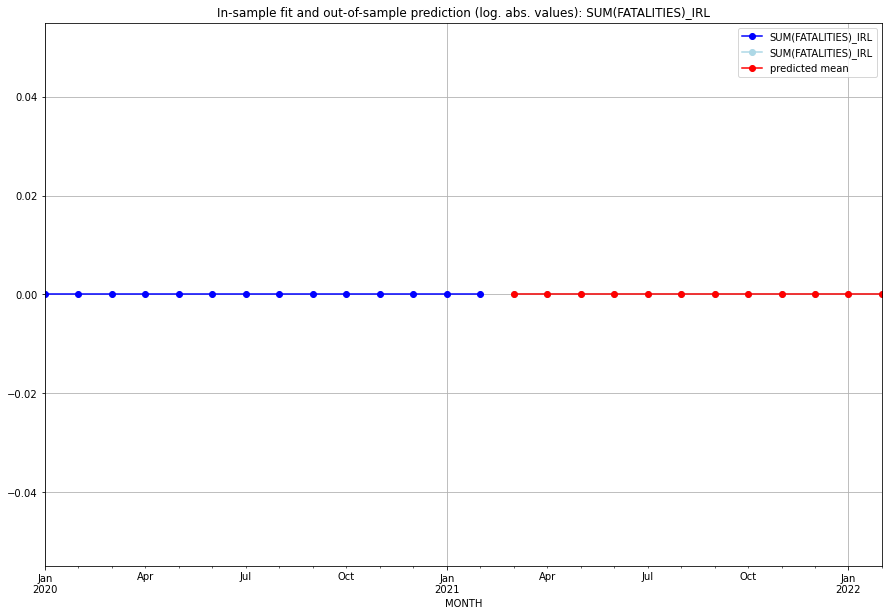

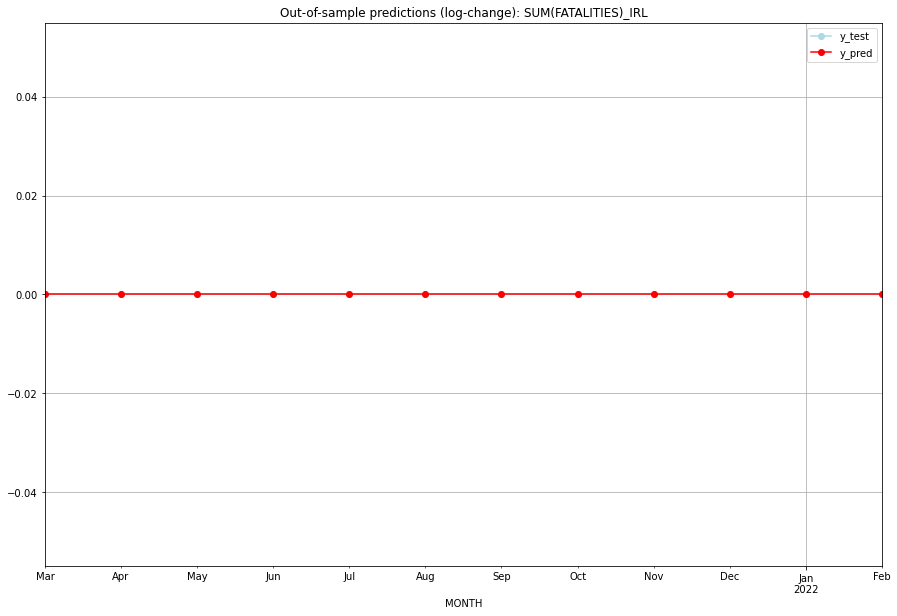

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   IRL   
1  2021-04-01       0.0         0.0           0.0             0.0   IRL   
2  2021-05-01       0.0         0.0           0.0             0.0   IRL   
3  2021-06-01       0.0         0.0           0.0             0.0   IRL   
4  2021-07-01       0.0         0.0           0.0             0.0   IRL   
5  2021-08-01       0.0         0.0           0.0             0.0   IRL   
6  2021-09-01       0.0         0.0           0.0             0.0   IRL   
7  2021-10-01       0.0         0.0           0.0             0.0   IRL   
8  2021-11-01       0.0         0.0           0.0             0.0   IRL   
9  2021-12-01       0.0         0.0           0.0             0.0   IRL   
10 2022-01-01       0.0         0.0           0.0             0.0   IRL   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 1.064064876358721, 'fold_results': [nan, 1.049469403697733, 1.3743620017528386, 0.7683632236255914]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IRN   No. Observations:                   62
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -98.943
Date:                 Wed, 19 Oct 2022   AIC                            211.886
Time:                         10:46:30   BIC                            226.662
Sample:                     01-31-2016   HQIC                           217.677
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

<Figure size 432x288 with 0 Axes>

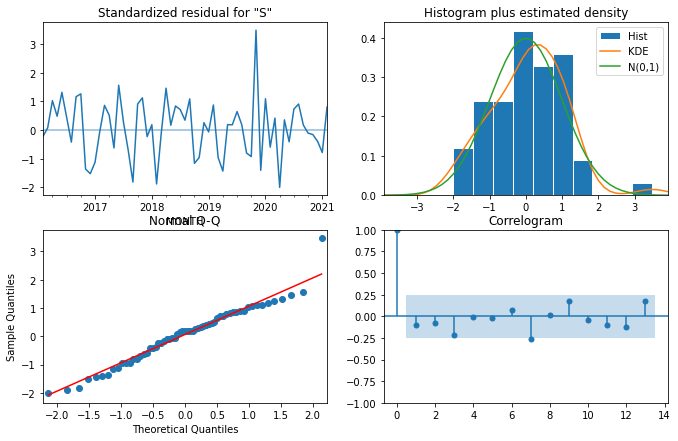

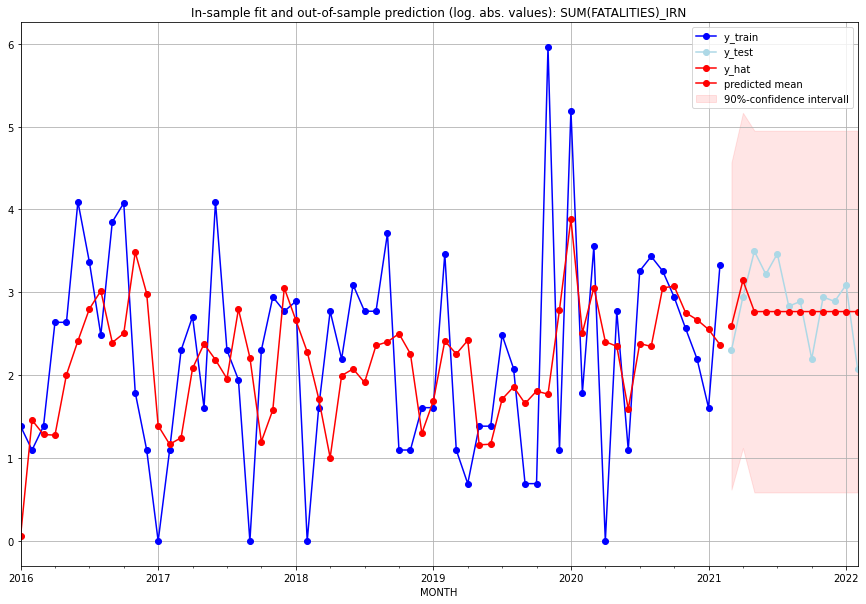

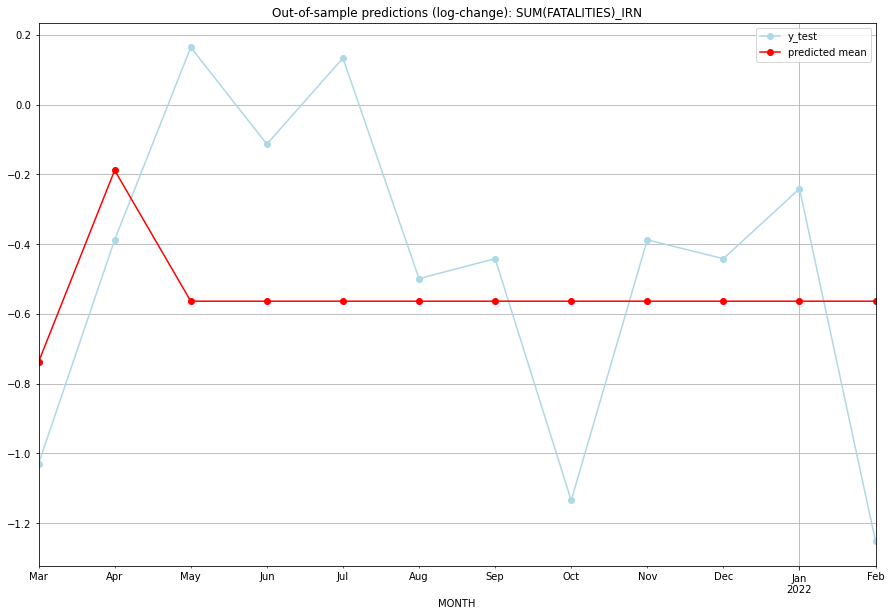

TADDA: 0.4634511640845356
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  12.388273         9.0     -0.737825       -1.029619   IRN   
1  2021-04-01  22.195064        18.0     -0.188265       -0.387766   IRN   
2  2021-05-01  14.935075        32.0     -0.563682        0.164303   IRN   
3  2021-06-01  14.935075        24.0     -0.563682       -0.113329   IRN   
4  2021-07-01  14.935075        31.0     -0.563682        0.133531   IRN   
5  2021-08-01  14.935075        16.0     -0.563682       -0.498991   IRN   
6  2021-09-01  14.935075        17.0     -0.563682       -0.441833   IRN   
7  2021-10-01  14.935075         8.0     -0.563682       -1.134980   IRN   
8  2021-11-01  14.935075        18.0     -0.563682       -0.387766   IRN   
9  2021-12-01  14.935075        17.0     -0.563682       -0.441833   IRN   
10 2022-01-01  14.935075        21.0     -0.563682       -0.241162   IRN   
11 2022-02-01  14.935075         7.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.3269375498020501, 'fold_results': [nan, 0.28958106065245565, 0.41052584770152145, 0.2807057410521732]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_IRQ   No. Observations:                   62
Model:                SARIMAX(2, 1, 3)   Log Likelihood                  -9.110
Date:                 Wed, 19 Oct 2022   AIC                             36.220
Time:                         10:46:54   BIC                             55.217
Sample:                     01-31-2016   HQIC                            43.665
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1

<Figure size 432x288 with 0 Axes>

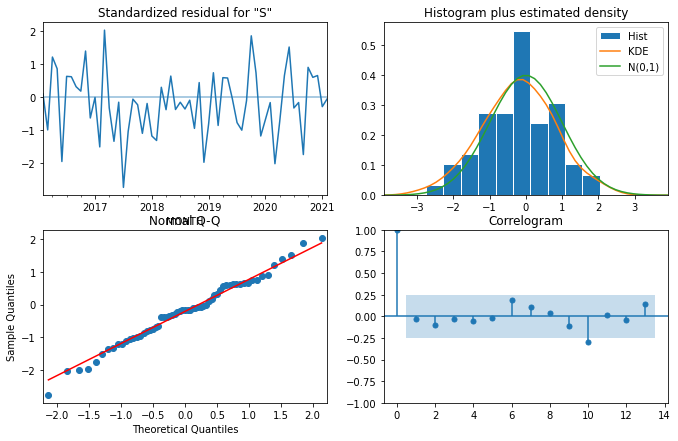

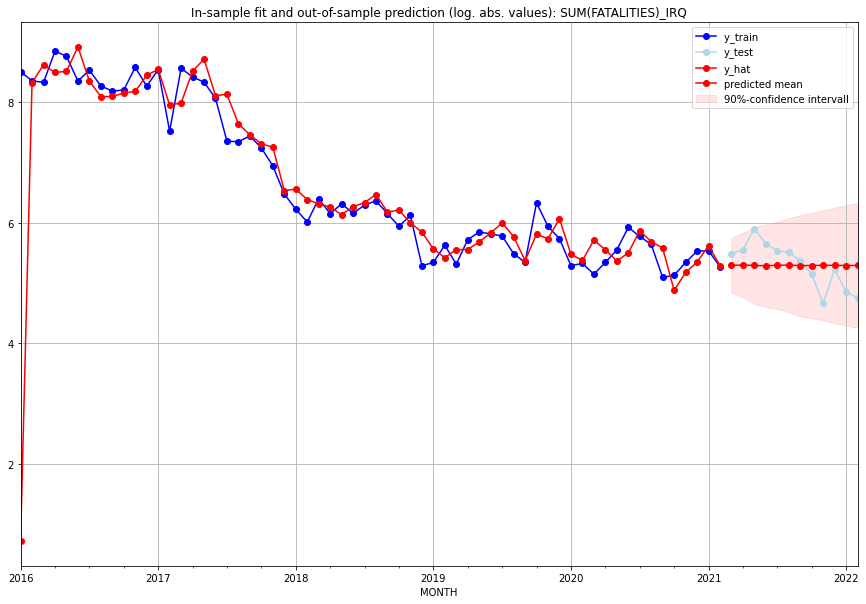

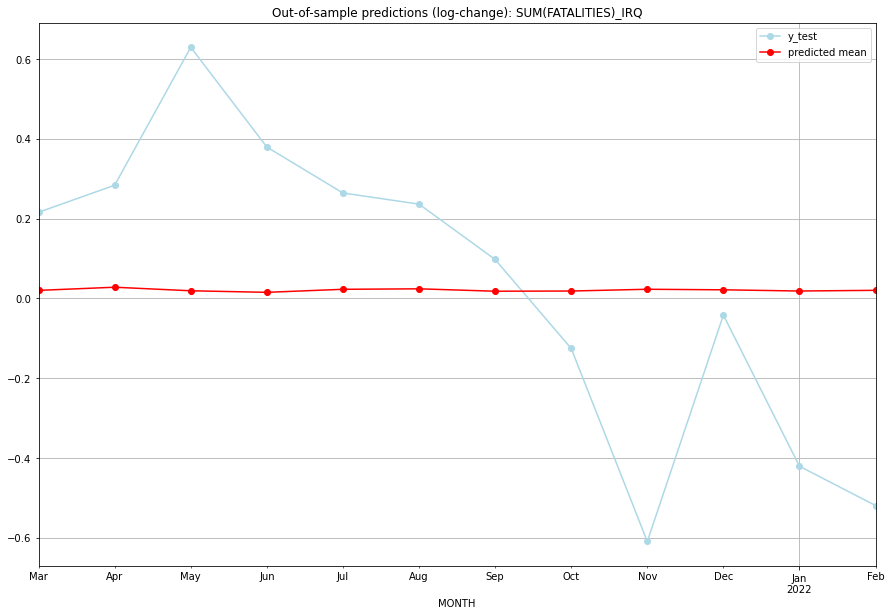

TADDA: 0.3233886501375865
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  197.966008       241.0      0.020134        0.215938   IRQ   
1  2021-04-01  199.541805       258.0      0.028023        0.283829   IRQ   
2  2021-05-01  197.766729       365.0      0.019132        0.629634   IRQ   
3  2021-06-01  196.991740       284.0      0.015226        0.379490   IRQ   
4  2021-07-01  198.503282       253.0      0.022831        0.264335   IRQ   
5  2021-08-01  198.742464       246.0      0.024029        0.236389   IRQ   
6  2021-09-01  197.545045       214.0      0.018016        0.097638   IRQ   
7  2021-10-01  197.640133       171.0      0.018495       -0.125505   IRQ   
8  2021-11-01  198.521236       105.0      0.022921       -0.609560   IRQ   
9  2021-12-01  198.246295       186.0      0.021542       -0.041891   IRQ   
10 2022-01-01  197.645145       127.0      0.018520       -0.420969   IRQ   
11 2022-02-01  197.990114    

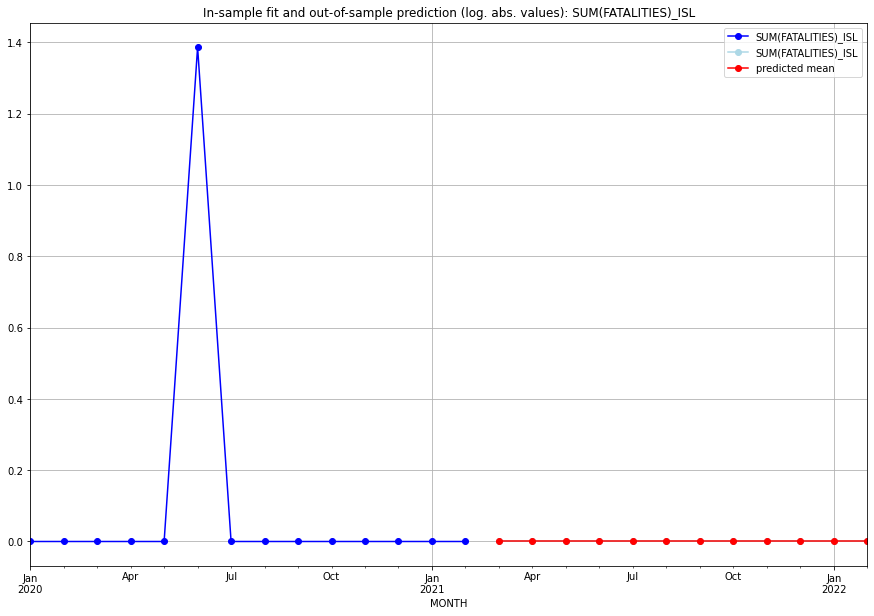

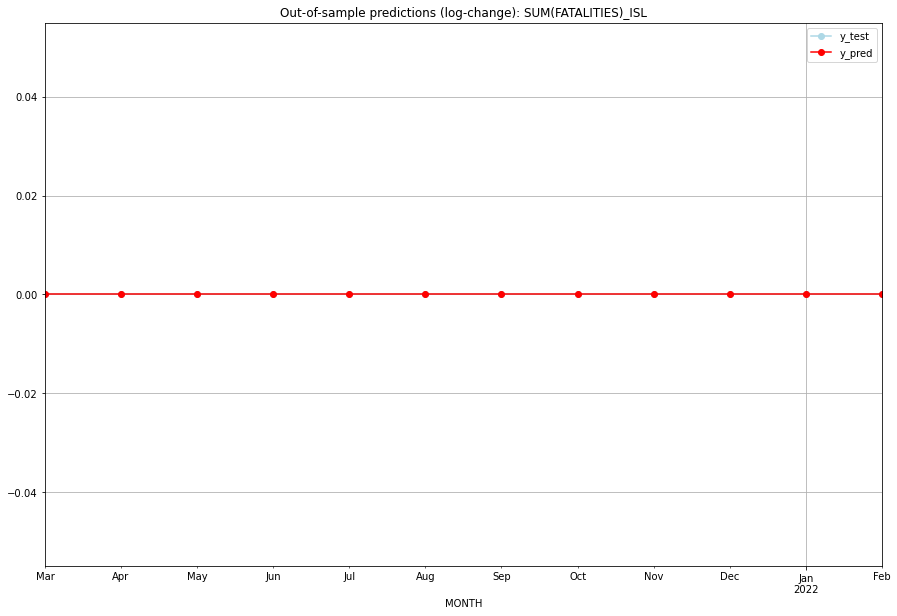

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ISL   
1  2021-04-01       0.0         0.0           0.0             0.0   ISL   
2  2021-05-01       0.0         0.0           0.0             0.0   ISL   
3  2021-06-01       0.0         0.0           0.0             0.0   ISL   
4  2021-07-01       0.0         0.0           0.0             0.0   ISL   
5  2021-08-01       0.0         0.0           0.0             0.0   ISL   
6  2021-09-01       0.0         0.0           0.0             0.0   ISL   
7  2021-10-01       0.0         0.0           0.0             0.0   ISL   
8  2021-11-01       0.0         0.0           0.0             0.0   ISL   
9  2021-12-01       0.0         0.0           0.0             0.0   ISL   
10 2022-01-01       0.0         0.0           0.0             0.0   ISL   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.7105014313108482, 'fold_results': [nan, 0.6245229892176224, 0.6544389021916558, 0.8525424025232665]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ISR   No. Observations:                   62
Model:                SARIMAX(2, 1, 3)   Log Likelihood                 -76.475
Date:                 Wed, 19 Oct 2022   AIC                            166.951
Time:                         10:47:23   BIC                            181.727
Sample:                     01-31-2016   HQIC                           172.742
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1  

<Figure size 432x288 with 0 Axes>

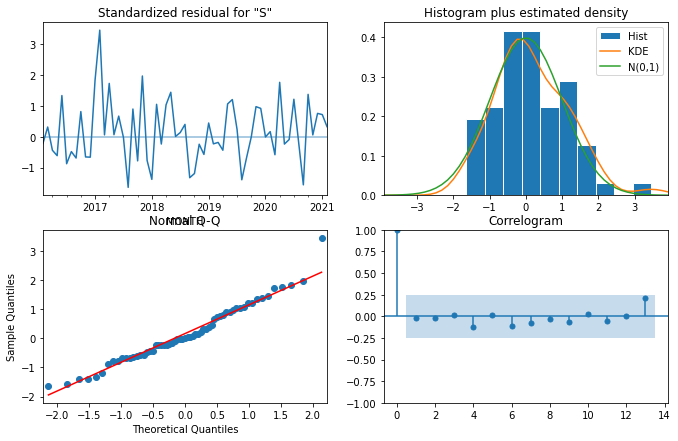

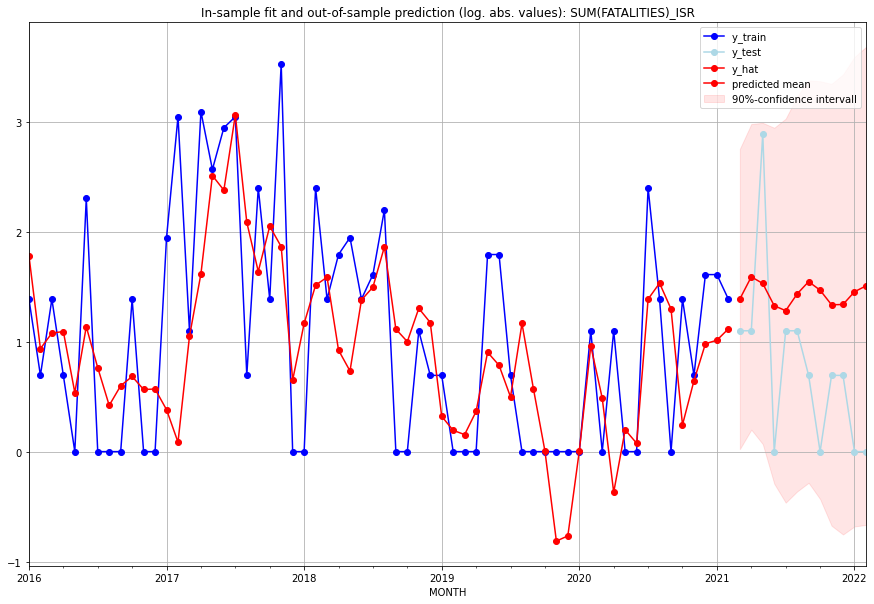

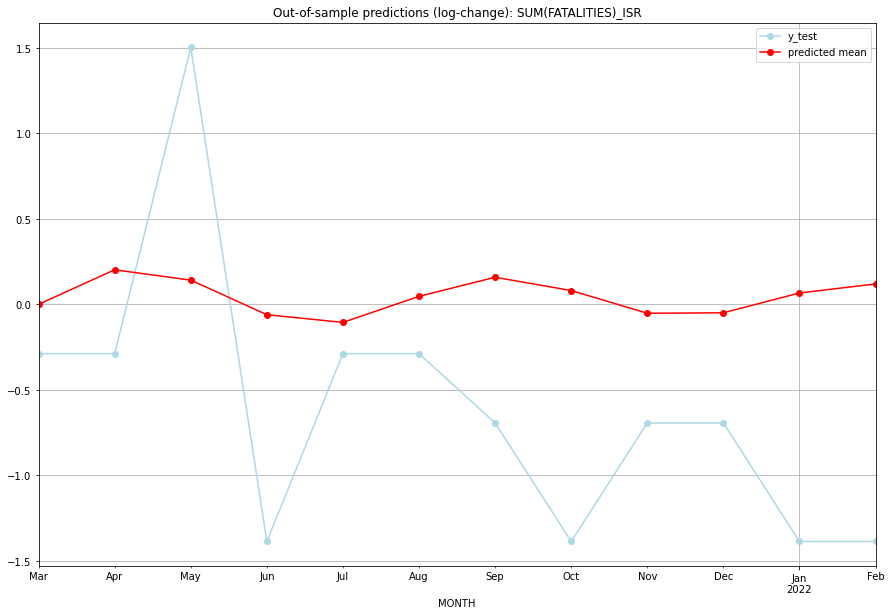

TADDA: 0.9358954131333473
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.004136         2.0      0.001033       -0.287682   ISR   
1  2021-04-01  3.899378         2.0      0.202814       -0.287682   ISR   
2  2021-05-01  3.612301        17.0      0.142433        1.504077   ISR   
3  2021-06-01  2.767365         0.0     -0.059918       -1.386294   ISR   
4  2021-07-01  2.601592         2.0     -0.104918       -0.287682   ISR   
5  2021-08-01  3.194416         2.0      0.047460       -0.287682   ISR   
6  2021-09-01  3.689854         1.0      0.159107       -0.693147   ISR   
7  2021-10-01  3.340079         0.0      0.081598       -1.386294   ISR   
8  2021-11-01  2.799279         1.0     -0.051483       -0.693147   ISR   
9  2021-12-01  2.810288         1.0     -0.048590       -0.693147   ISR   
10 2022-01-01  3.277965         0.0      0.067183       -1.386294   ISR   
11 2022-02-01  3.510600         0.0      0.120136    

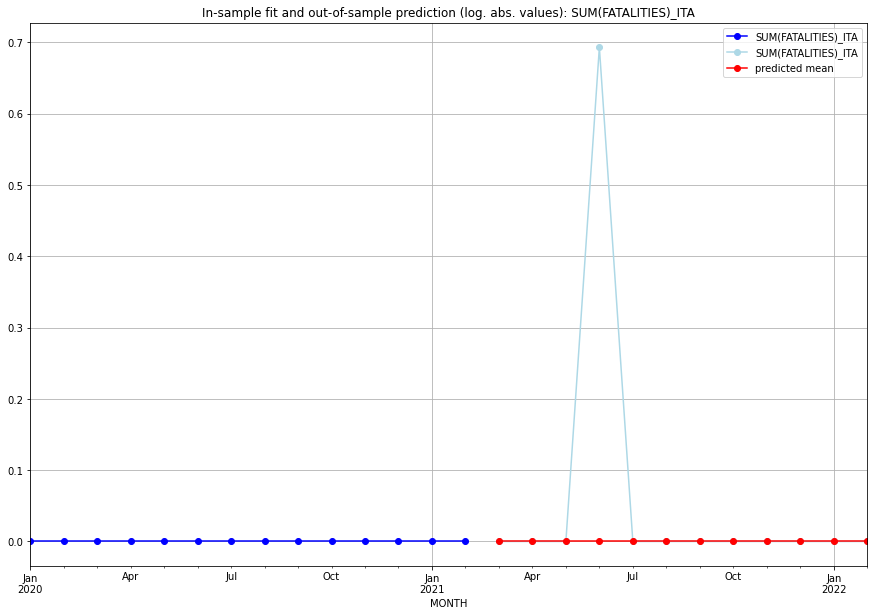

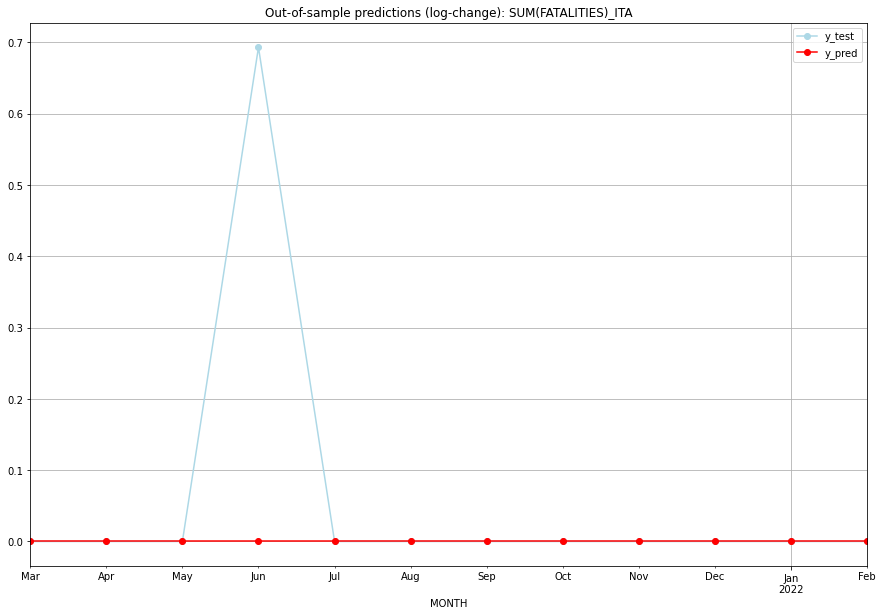

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   ITA   
1  2021-04-01       0.0    0.000000           0.0        0.000000   ITA   
2  2021-05-01       0.0    0.000000           0.0        0.000000   ITA   
3  2021-06-01       0.0    0.693147           0.0        0.693147   ITA   
4  2021-07-01       0.0    0.000000           0.0        0.000000   ITA   
5  2021-08-01       0.0    0.000000           0.0        0.000000   ITA   
6  2021-09-01       0.0    0.000000           0.0        0.000000   ITA   
7  2021-10-01       0.0    0.000000           0.0        0.000000   ITA   
8  2021-11-01       0.0    0.000000           0.0        0.000000   ITA   
9  2021-12-01       0.0    0.000000           0.0        0.000000   ITA   
10 2022-01-01       0.0    0.000000           0.0        0.000000   ITA   
11 2022-02-01       0.0    0.000000           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.26595656117407207, 'fold_results': [0.2401757256823822, 0.2917373966657619]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_JAM   No. Observations:                   38
Model:                SARIMAX(0, 1, 2)   Log Likelihood                  -8.805
Date:                 Wed, 19 Oct 2022   AIC                             23.609
Time:                         10:47:38   BIC                             28.442
Sample:                     01-31-2018   HQIC                            25.313
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -1.0728     10

<Figure size 432x288 with 0 Axes>

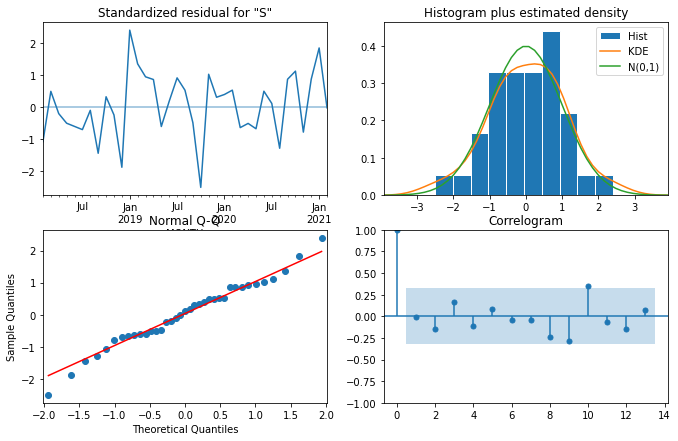

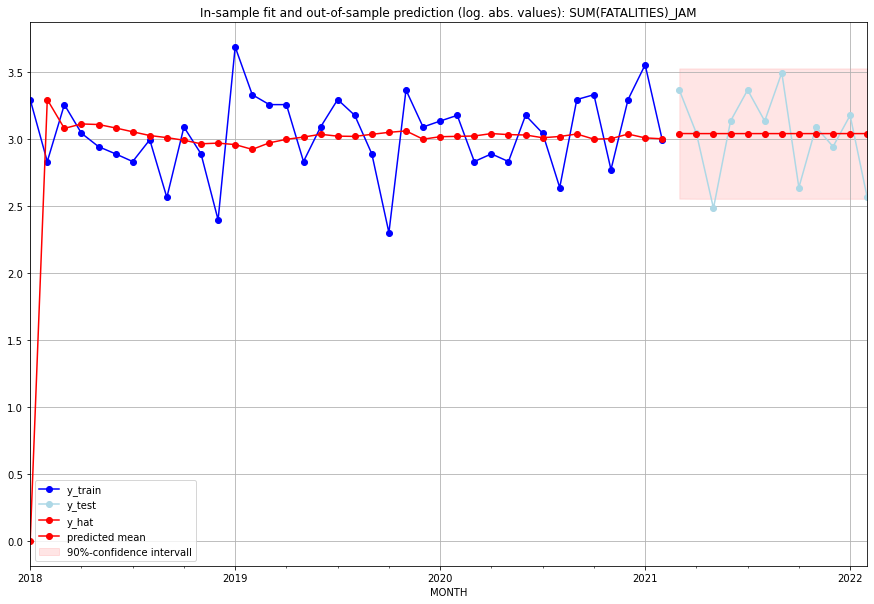

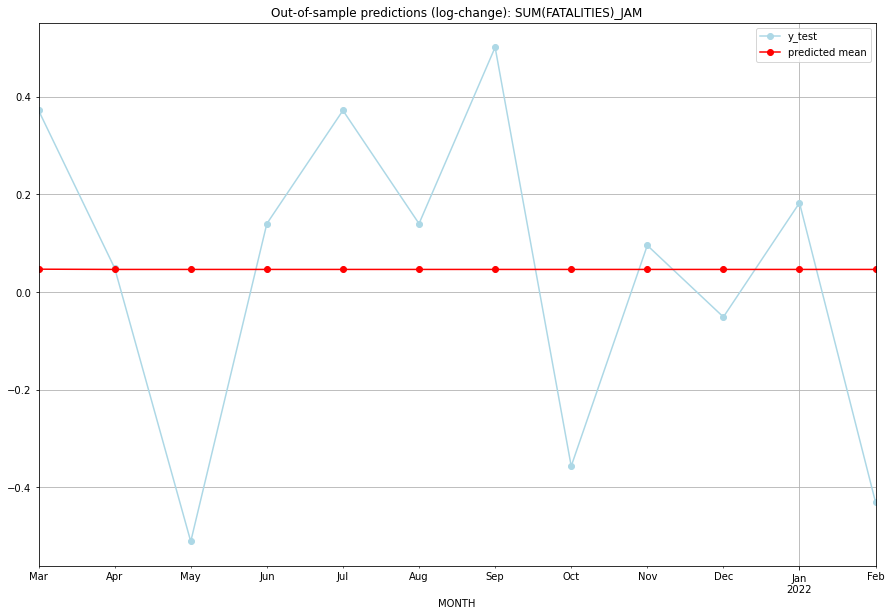

TADDA: 0.2665766002099747
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  19.953893        28.0      0.046592        0.371564   JAM   
1  2021-04-01  19.943298        20.0      0.046086        0.048790   JAM   
2  2021-05-01  19.943298        11.0      0.046086       -0.510826   JAM   
3  2021-06-01  19.943298        22.0      0.046086        0.139762   JAM   
4  2021-07-01  19.943298        28.0      0.046086        0.371564   JAM   
5  2021-08-01  19.943298        22.0      0.046086        0.139762   JAM   
6  2021-09-01  19.943298        32.0      0.046086        0.500775   JAM   
7  2021-10-01  19.943298        13.0      0.046086       -0.356675   JAM   
8  2021-11-01  19.943298        21.0      0.046086        0.095310   JAM   
9  2021-12-01  19.943298        18.0      0.046086       -0.051293   JAM   
10 2022-01-01  19.943298        23.0      0.046086        0.182322   JAM   
11 2022-02-01  19.943298        12.0     

<Figure size 432x288 with 0 Axes>

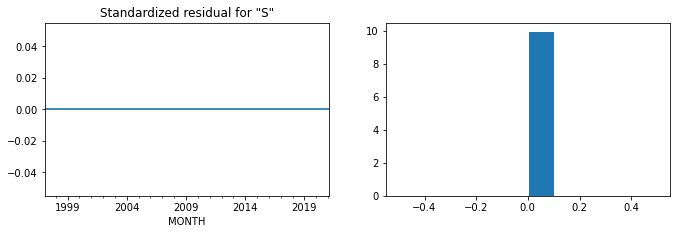

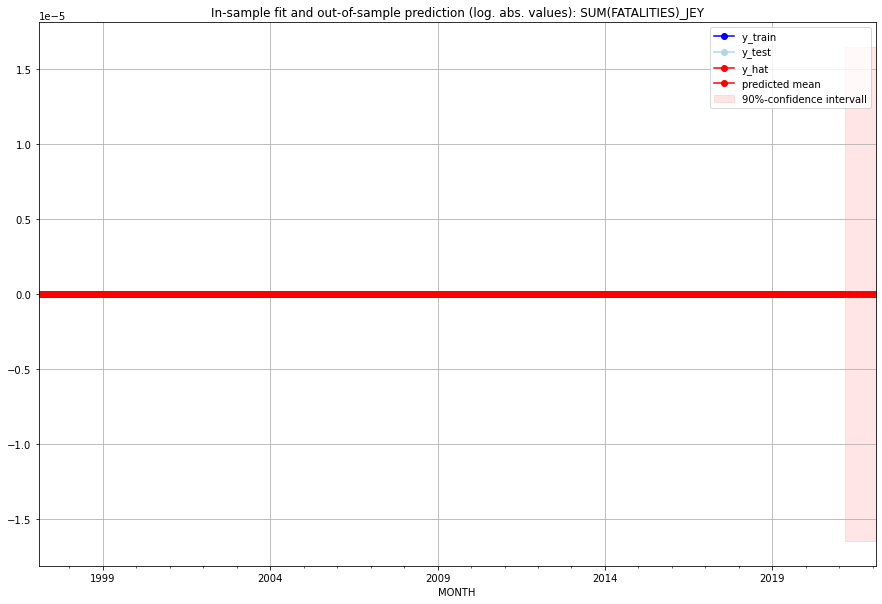

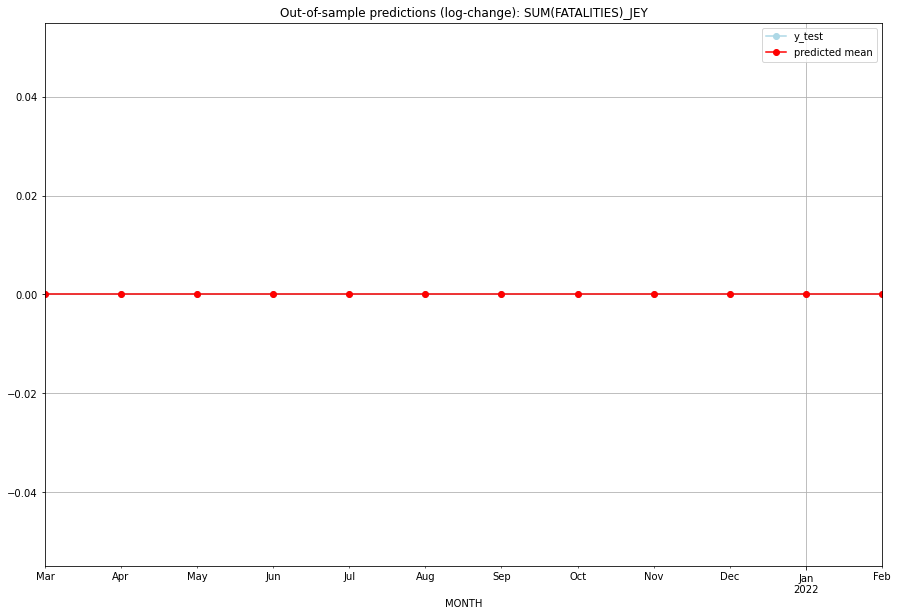

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   JEY   
1  2021-04-01       0.0         0.0           0.0             0.0   JEY   
2  2021-05-01       0.0         0.0           0.0             0.0   JEY   
3  2021-06-01       0.0         0.0           0.0             0.0   JEY   
4  2021-07-01       0.0         0.0           0.0             0.0   JEY   
5  2021-08-01       0.0         0.0           0.0             0.0   JEY   
6  2021-09-01       0.0         0.0           0.0             0.0   JEY   
7  2021-10-01       0.0         0.0           0.0             0.0   JEY   
8  2021-11-01       0.0         0.0           0.0             0.0   JEY   
9  2021-12-01       0.0         0.0           0.0             0.0   JEY   
10 2022-01-01       0.0         0.0           0.0             0.0   JEY   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.3198555027585678, 'fold_results': [nan, 0.2690024048547071, 0.34879064864829973, 0.3417734547726965]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_JOR   No. Observations:                   62
Model:                SARIMAX(1, 1, 3)   Log Likelihood                 -75.105
Date:                 Wed, 19 Oct 2022   AIC                            166.210
Time:                         10:48:04   BIC                            183.097
Sample:                     01-31-2016   HQIC                           172.828
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1 

<Figure size 432x288 with 0 Axes>

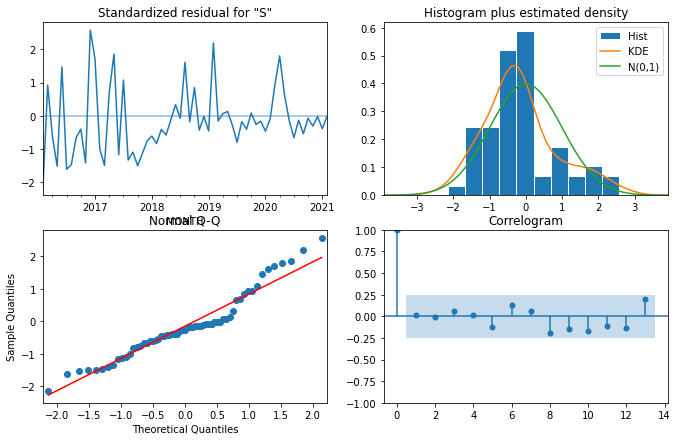

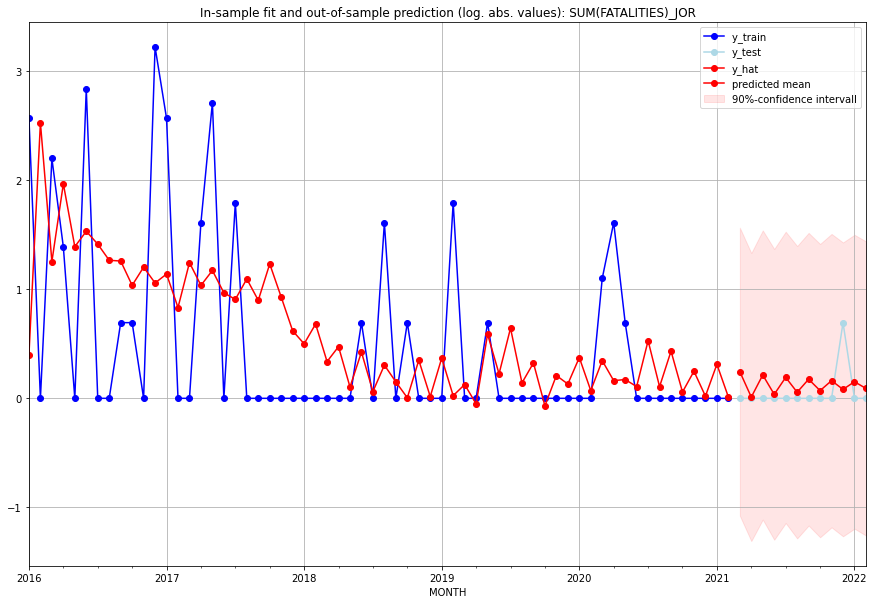

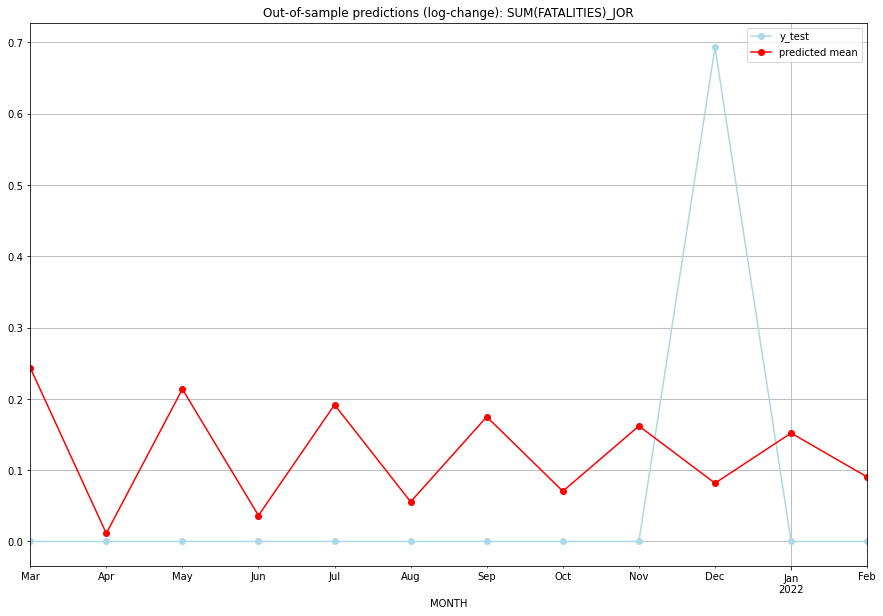

TADDA: 0.16784783253329505
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.276169         0.0      0.243863        0.000000   JOR   
1  2021-04-01  0.011429         0.0      0.011364        0.000000   JOR   
2  2021-05-01  0.238324         0.0      0.213759        0.000000   JOR   
3  2021-06-01  0.037116         0.0      0.036444        0.000000   JOR   
4  2021-07-01  0.211412         0.0      0.191787        0.000000   JOR   
5  2021-08-01  0.057273         0.0      0.055693        0.000000   JOR   
6  2021-09-01  0.191154         0.0      0.174923        0.000000   JOR   
7  2021-10-01  0.073009         0.0      0.070467        0.000000   JOR   
8  2021-11-01  0.175836         0.0      0.161979        0.000000   JOR   
9  2021-12-01  0.085246         1.0      0.081807        0.693147   JOR   
10 2022-01-01  0.164213         0.0      0.152045        0.000000   JOR   
11 2022-02-01  0.094733         0.0      0.090510   

<Figure size 432x288 with 0 Axes>

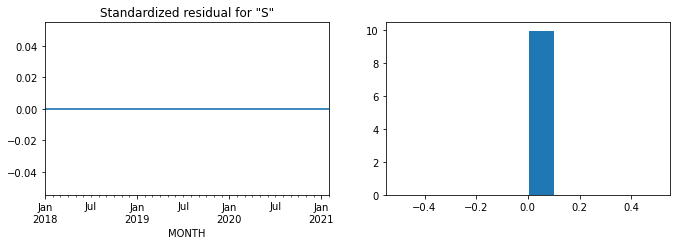

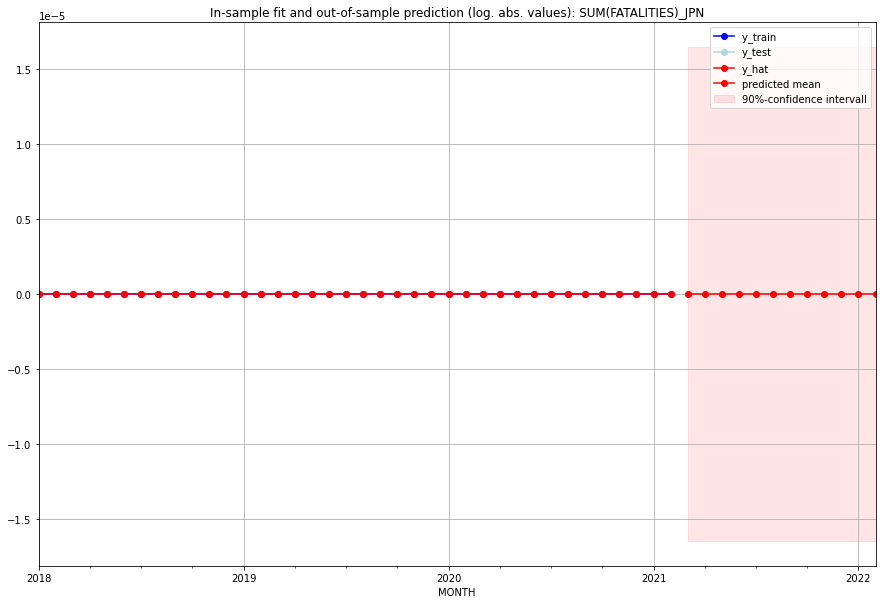

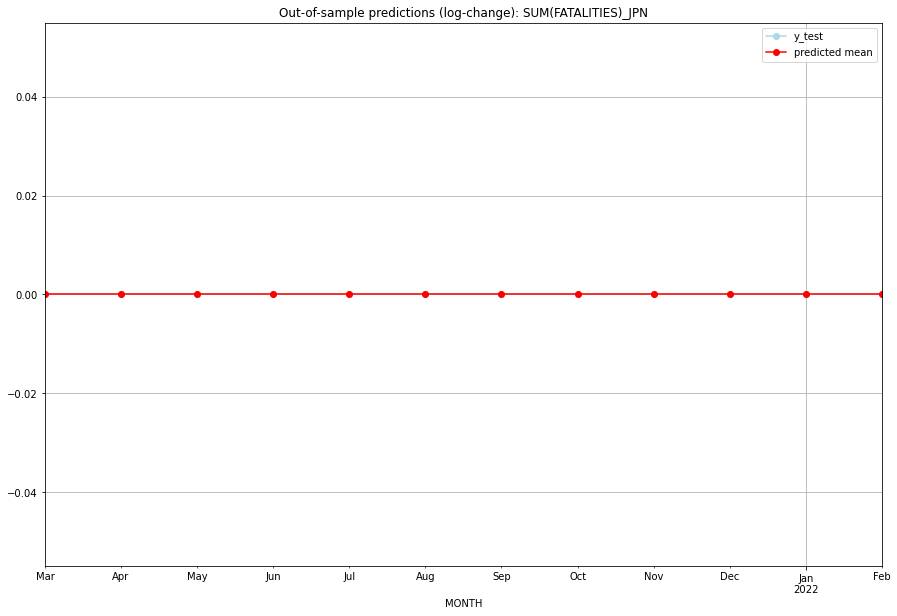

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   JPN   
1  2021-04-01       0.0         0.0           0.0             0.0   JPN   
2  2021-05-01       0.0         0.0           0.0             0.0   JPN   
3  2021-06-01       0.0         0.0           0.0             0.0   JPN   
4  2021-07-01       0.0         0.0           0.0             0.0   JPN   
5  2021-08-01       0.0         0.0           0.0             0.0   JPN   
6  2021-09-01       0.0         0.0           0.0             0.0   JPN   
7  2021-10-01       0.0         0.0           0.0             0.0   JPN   
8  2021-11-01       0.0         0.0           0.0             0.0   JPN   
9  2021-12-01       0.0         0.0           0.0             0.0   JPN   
10 2022-01-01       0.0         0.0           0.0             0.0   JPN   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.30772199717912174, 'fold_results': [0.3167253471786981, 0.2987186471795454]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KAZ   No. Observations:                   38
Model:                SARIMAX(1, 0, 2)   Log Likelihood                 -34.780
Date:                 Wed, 19 Oct 2022   AIC                             77.560
Time:                         10:48:24   BIC                             84.111
Sample:                     01-31-2018   HQIC                            79.891
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.0000      0

<Figure size 432x288 with 0 Axes>

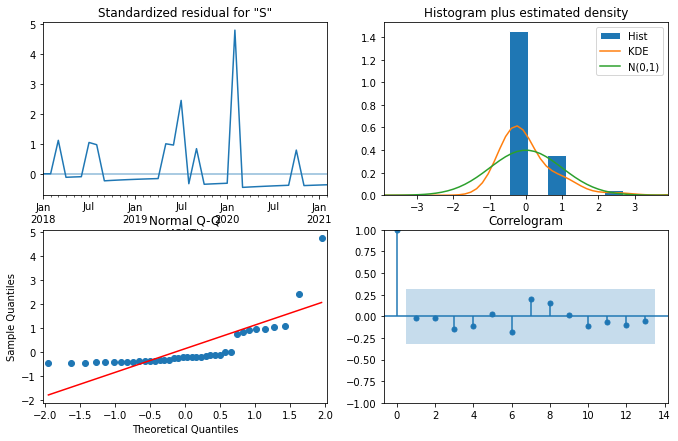

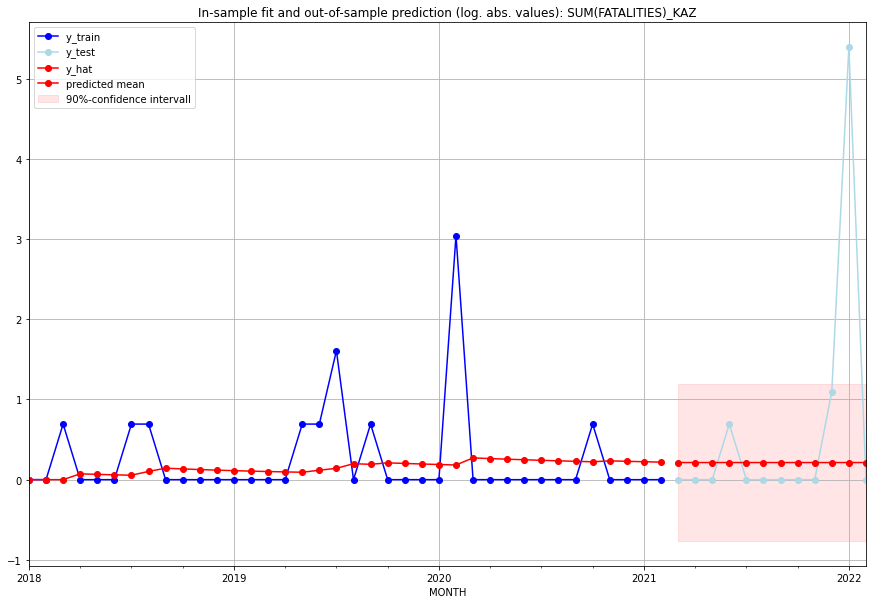

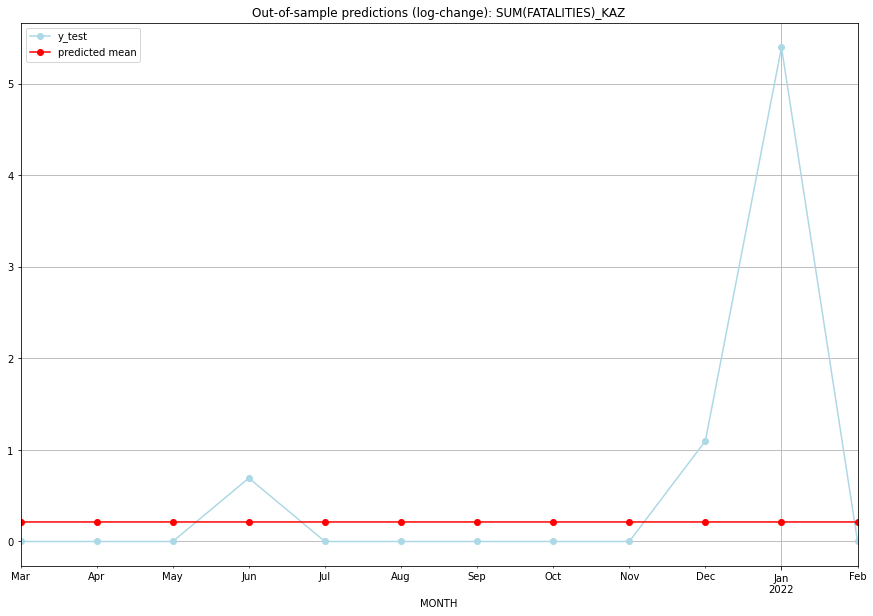

TADDA: 0.7058460798892586
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.237844         0.0      0.213371        0.000000   KAZ   
1  2021-04-01  0.237860         0.0      0.213384        0.000000   KAZ   
2  2021-05-01  0.237856         0.0      0.213380        0.000000   KAZ   
3  2021-06-01  0.237851         1.0      0.213377        0.693147   KAZ   
4  2021-07-01  0.237847         0.0      0.213373        0.000000   KAZ   
5  2021-08-01  0.237842         0.0      0.213370        0.000000   KAZ   
6  2021-09-01  0.237838         0.0      0.213366        0.000000   KAZ   
7  2021-10-01  0.237833         0.0      0.213363        0.000000   KAZ   
8  2021-11-01  0.237829         0.0      0.213359        0.000000   KAZ   
9  2021-12-01  0.237825         2.0      0.213355        1.098612   KAZ   
10 2022-01-01  0.237820       220.0      0.213352        5.398163   KAZ   
11 2022-02-01  0.237816         0.0      0.213348    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.4600301584639486, 'fold_results': [0.6096710541380006, 0.4501156859231867, 0.3424104939982908, 0.5250236130569989, 0.372929945203266]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KEN   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -516.624
Date:                 Wed, 19 Oct 2022   AIC                           1035.248
Time:                         10:48:54   BIC                           1038.911
Sample:                     02-28-1997   HQIC                          1036.716
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

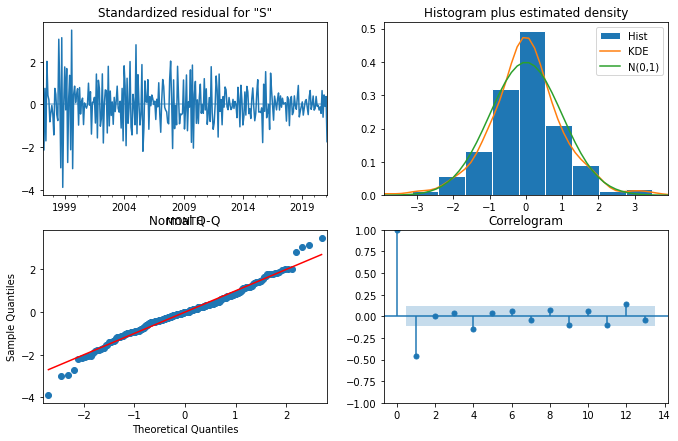

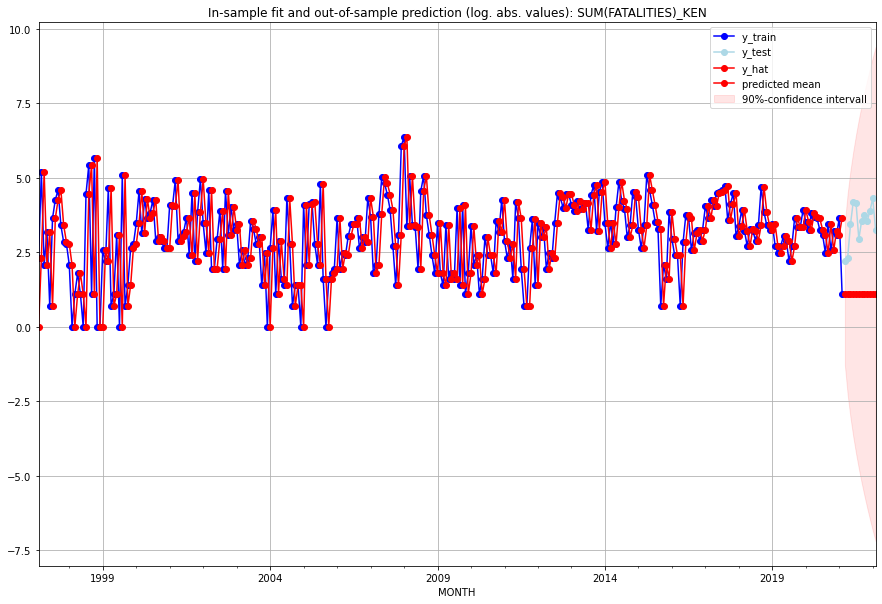

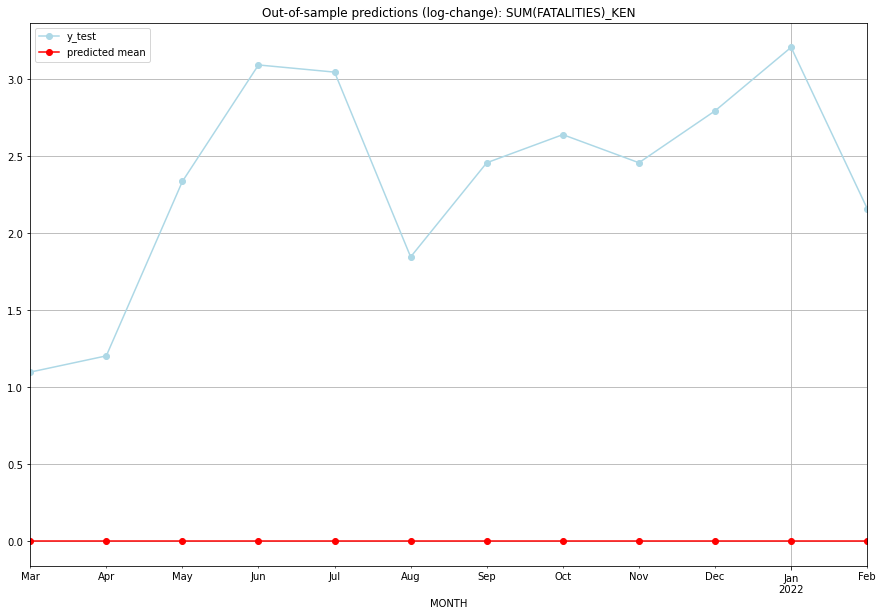

TADDA: 2.360835460748414
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       2.0         8.0  2.220446e-16        1.098612   KEN   
1  2021-04-01       2.0         9.0  2.220446e-16        1.203973   KEN   
2  2021-05-01       2.0        30.0  2.220446e-16        2.335375   KEN   
3  2021-06-01       2.0        65.0  2.220446e-16        3.091042   KEN   
4  2021-07-01       2.0        62.0  2.220446e-16        3.044522   KEN   
5  2021-08-01       2.0        18.0  2.220446e-16        1.845827   KEN   
6  2021-09-01       2.0        34.0  2.220446e-16        2.456736   KEN   
7  2021-10-01       2.0        41.0  2.220446e-16        2.639057   KEN   
8  2021-11-01       2.0        34.0  2.220446e-16        2.456736   KEN   
9  2021-12-01       2.0        48.0  2.220446e-16        2.793208   KEN   
10 2022-01-01       2.0        73.0  2.220446e-16        3.205453   KEN   
11 2022-02-01       2.0        25.0  2.220446e-16     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.21637320212042546, 'fold_results': [0.3411953801851751, 0.09155102405567582]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KGZ   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                 -24.628
Date:                 Wed, 19 Oct 2022   AIC                             51.256
Time:                         10:49:03   BIC                             52.894
Sample:                     01-31-2018   HQIC                            51.839
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.2140      

<Figure size 432x288 with 0 Axes>

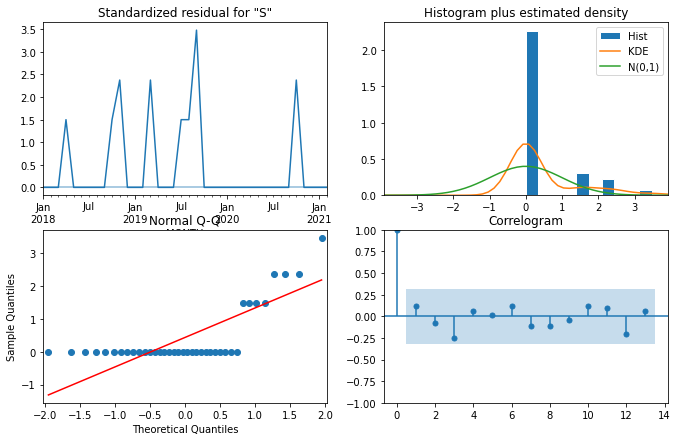

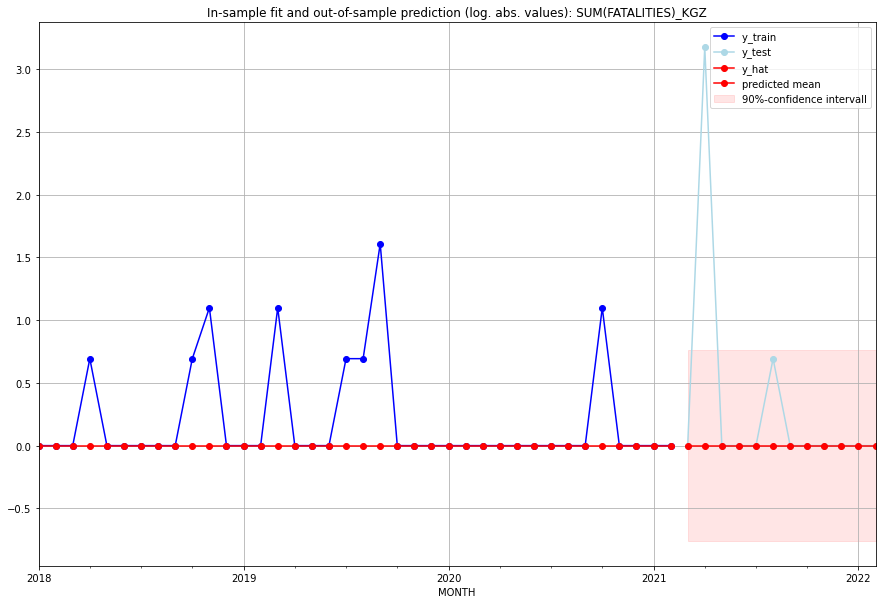

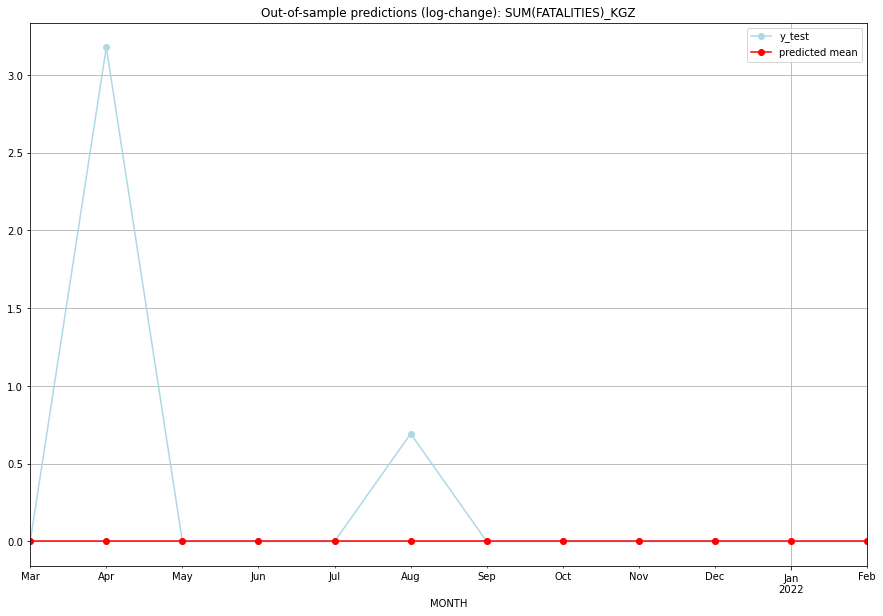

TADDA: 0.3226000842423243
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   KGZ   
1  2021-04-01       0.0        23.0           0.0        3.178054   KGZ   
2  2021-05-01       0.0         0.0           0.0        0.000000   KGZ   
3  2021-06-01       0.0         0.0           0.0        0.000000   KGZ   
4  2021-07-01       0.0         0.0           0.0        0.000000   KGZ   
5  2021-08-01       0.0         1.0           0.0        0.693147   KGZ   
6  2021-09-01       0.0         0.0           0.0        0.000000   KGZ   
7  2021-10-01       0.0         0.0           0.0        0.000000   KGZ   
8  2021-11-01       0.0         0.0           0.0        0.000000   KGZ   
9  2021-12-01       0.0         0.0           0.0        0.000000   KGZ   
10 2022-01-01       0.0         0.0           0.0        0.000000   KGZ   
11 2022-02-01       0.0         0.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.4700339670168791, 'fold_results': [0.3803623492889863, 0.3301828123173895, 0.5917962960819992, 0.25776523142936336, 0.7900631459666574]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KHM   No. Observations:                  134
Model:                SARIMAX(0, 0, 1)   Log Likelihood                -174.568
Date:                 Wed, 19 Oct 2022   AIC                            353.136
Time:                         10:49:25   BIC                            358.931
Sample:                     01-31-2010   HQIC                           355.491
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

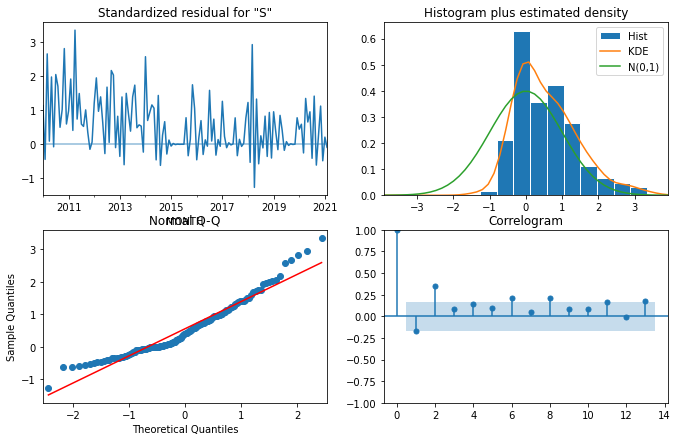

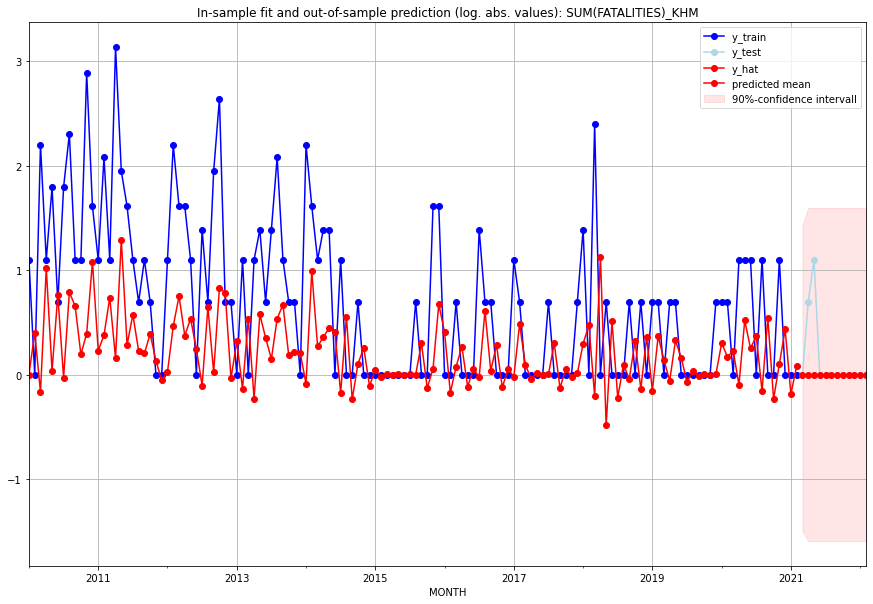

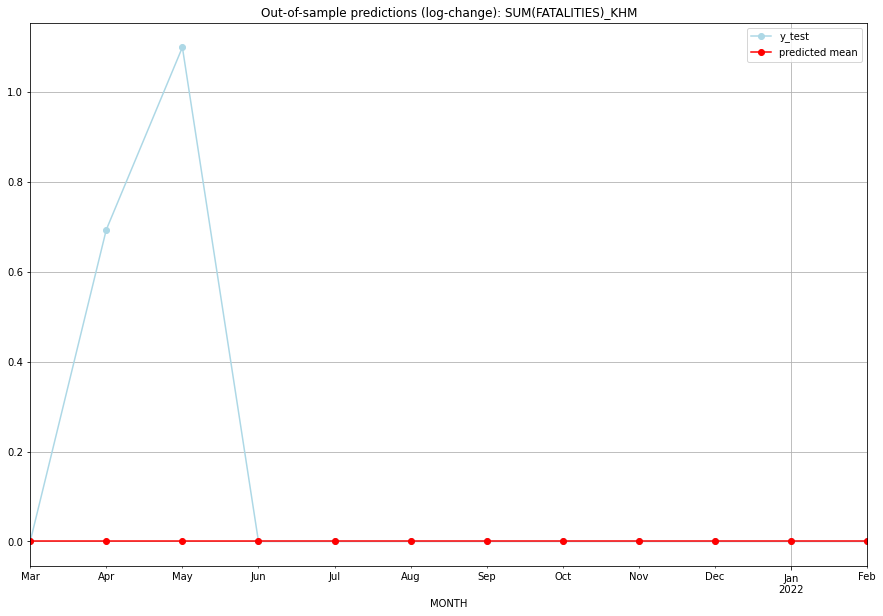

TADDA: 0.1493132891023379
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   KHM   
1  2021-04-01       0.0         1.0           0.0        0.693147   KHM   
2  2021-05-01       0.0         2.0           0.0        1.098612   KHM   
3  2021-06-01       0.0         0.0           0.0        0.000000   KHM   
4  2021-07-01       0.0         0.0           0.0        0.000000   KHM   
5  2021-08-01       0.0         0.0           0.0        0.000000   KHM   
6  2021-09-01       0.0         0.0           0.0        0.000000   KHM   
7  2021-10-01       0.0         0.0           0.0        0.000000   KHM   
8  2021-11-01       0.0         0.0           0.0        0.000000   KHM   
9  2021-12-01       0.0         0.0           0.0        0.000000   KHM   
10 2022-01-01       0.0         0.0           0.0        0.000000   KHM   
11 2022-02-01       0.0         0.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KNA   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  29.122
Date:                 Wed, 19 Oct 2022   AIC                            -56.244
Time:                         10:49:32   BIC                            -54.606
Sample:                     01-31-2018   HQIC                           -55.661
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0126      0.001     18.748      0.000       0.011       0

<Figure size 432x288 with 0 Axes>

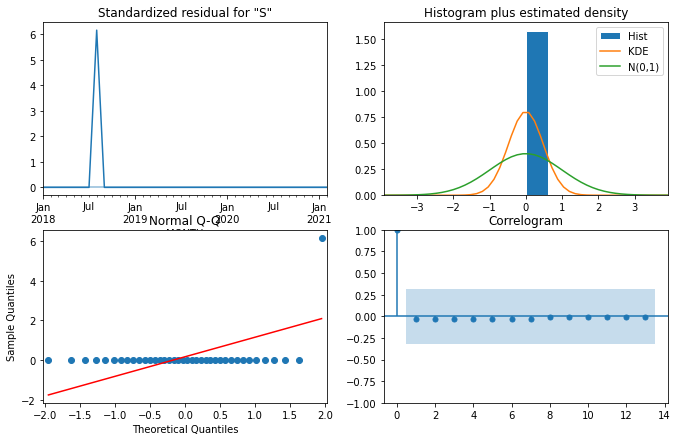

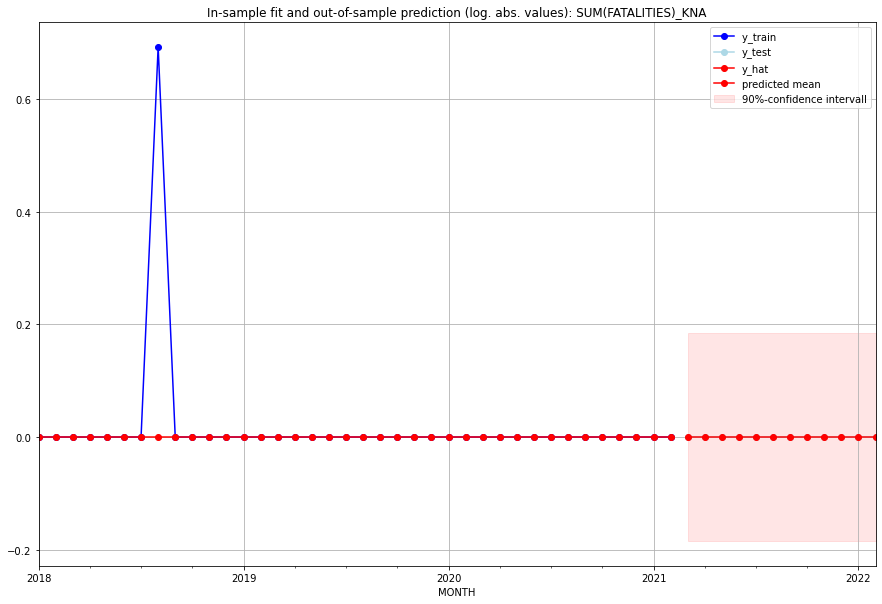

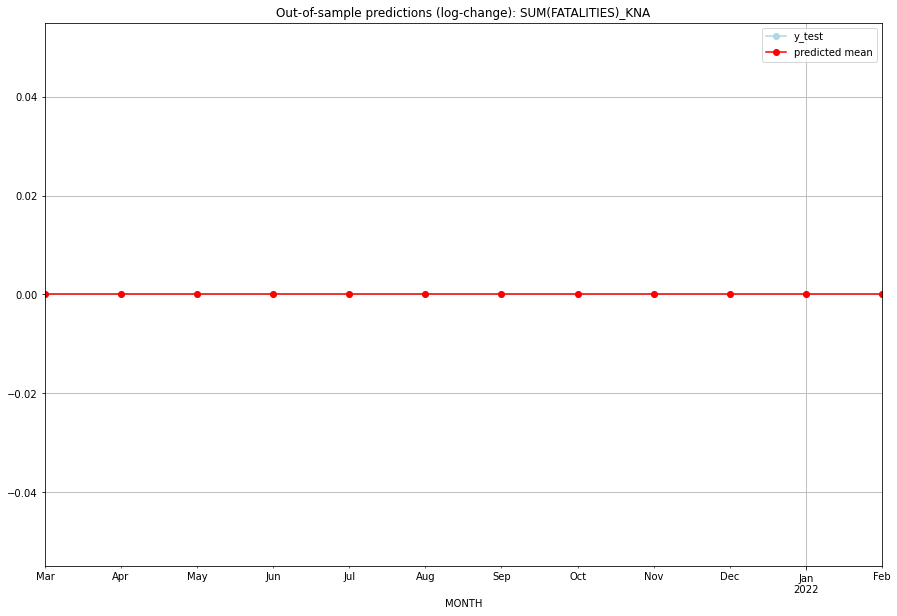

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   KNA   
1  2021-04-01       0.0         0.0           0.0             0.0   KNA   
2  2021-05-01       0.0         0.0           0.0             0.0   KNA   
3  2021-06-01       0.0         0.0           0.0             0.0   KNA   
4  2021-07-01       0.0         0.0           0.0             0.0   KNA   
5  2021-08-01       0.0         0.0           0.0             0.0   KNA   
6  2021-09-01       0.0         0.0           0.0             0.0   KNA   
7  2021-10-01       0.0         0.0           0.0             0.0   KNA   
8  2021-11-01       0.0         0.0           0.0             0.0   KNA   
9  2021-12-01       0.0         0.0           0.0             0.0   KNA   
10 2022-01-01       0.0         0.0           0.0             0.0   KNA   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

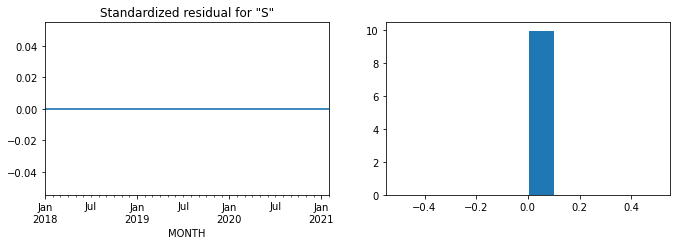

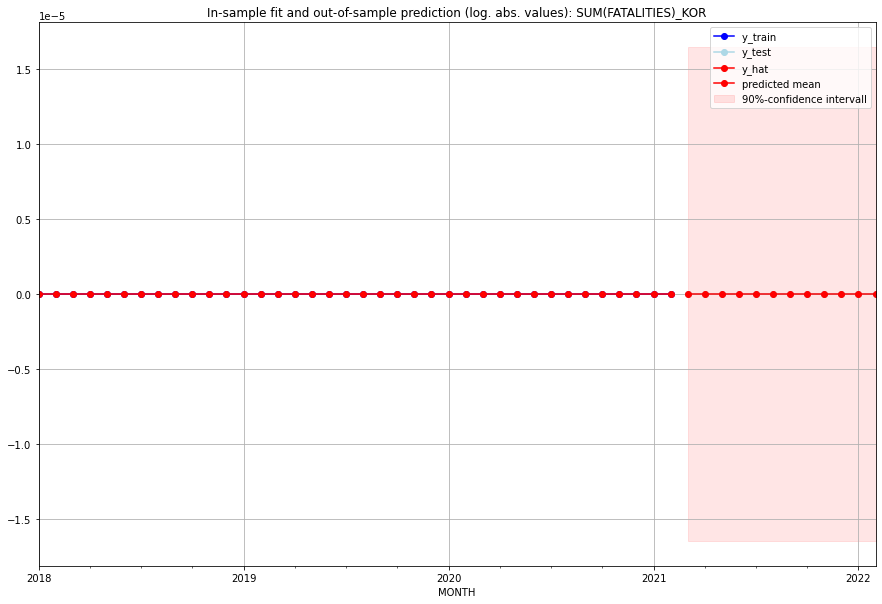

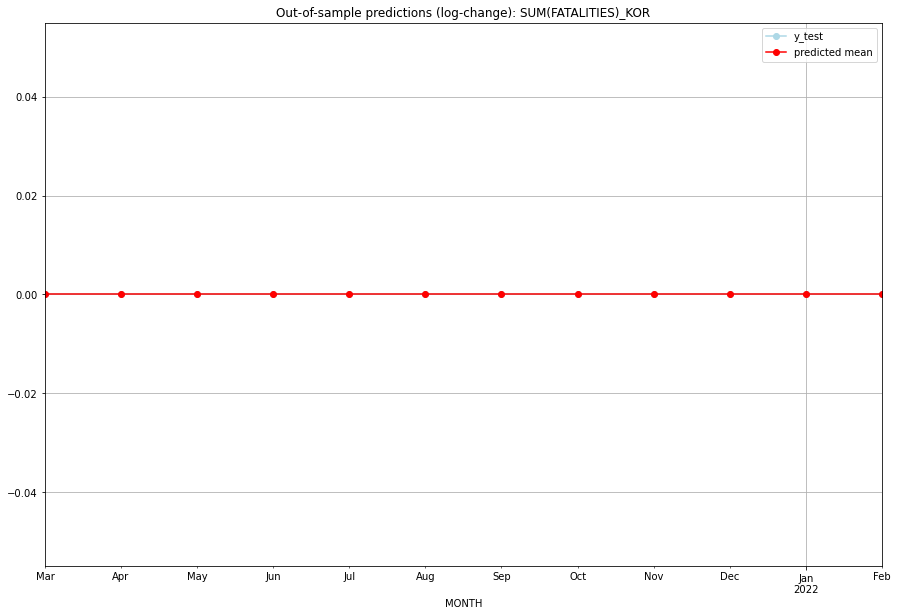

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   KOR   
1  2021-04-01       0.0         0.0           0.0             0.0   KOR   
2  2021-05-01       0.0         0.0           0.0             0.0   KOR   
3  2021-06-01       0.0         0.0           0.0             0.0   KOR   
4  2021-07-01       0.0         0.0           0.0             0.0   KOR   
5  2021-08-01       0.0         0.0           0.0             0.0   KOR   
6  2021-09-01       0.0         0.0           0.0             0.0   KOR   
7  2021-10-01       0.0         0.0           0.0             0.0   KOR   
8  2021-11-01       0.0         0.0           0.0             0.0   KOR   
9  2021-12-01       0.0         0.0           0.0             0.0   KOR   
10 2022-01-01       0.0         0.0           0.0             0.0   KOR   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.014440566261665526, 'fold_results': [0.0, 0.0, 0.0, 0.057762265046662105]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_KWT   No. Observations:                   62
Model:                         SARIMAX   Log Likelihood                  62.691
Date:                 Wed, 19 Oct 2022   AIC                           -123.382
Time:                         10:49:58   BIC                           -121.254
Sample:                     01-31-2016   HQIC                          -122.546
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0077      0.0

<Figure size 432x288 with 0 Axes>

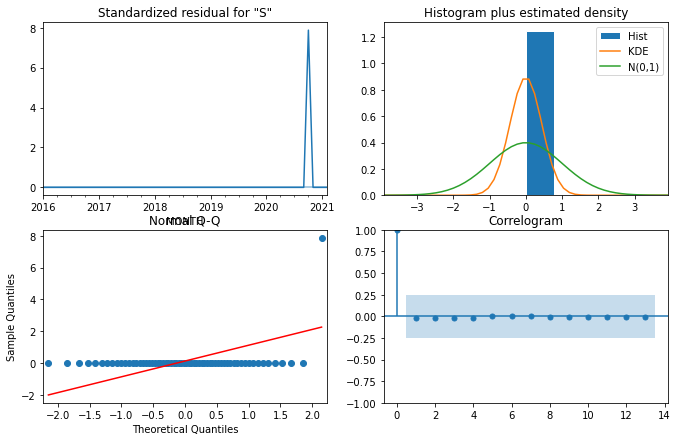

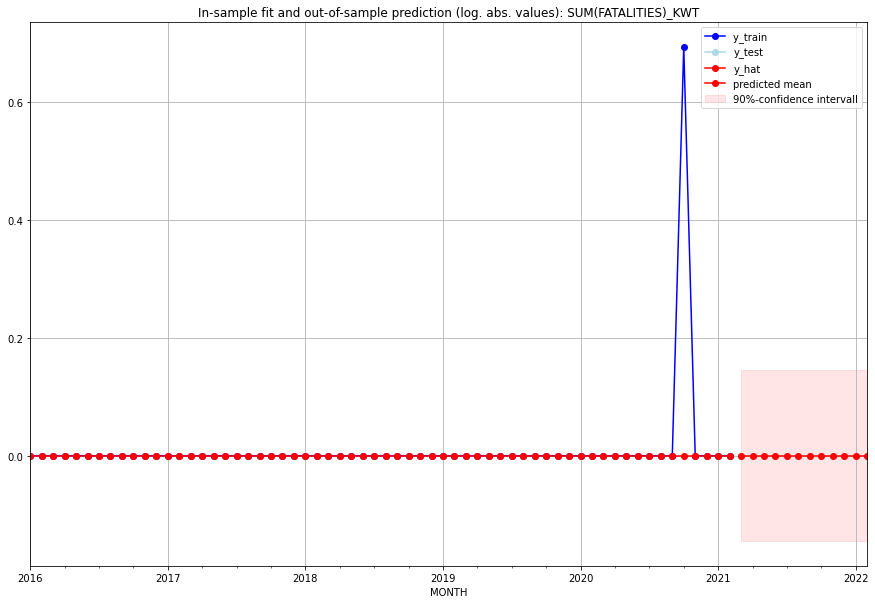

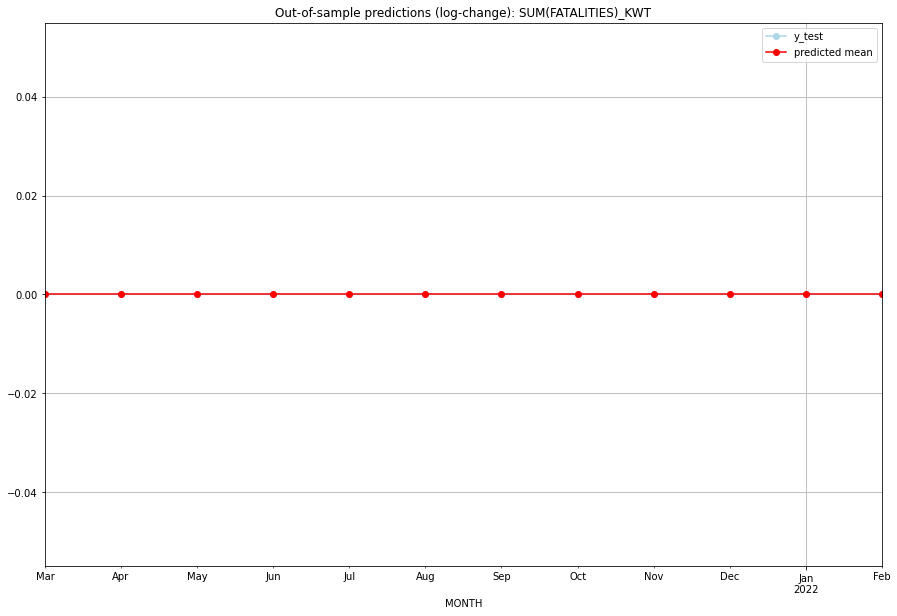

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   KWT   
1  2021-04-01       0.0         0.0           0.0             0.0   KWT   
2  2021-05-01       0.0         0.0           0.0             0.0   KWT   
3  2021-06-01       0.0         0.0           0.0             0.0   KWT   
4  2021-07-01       0.0         0.0           0.0             0.0   KWT   
5  2021-08-01       0.0         0.0           0.0             0.0   KWT   
6  2021-09-01       0.0         0.0           0.0             0.0   KWT   
7  2021-10-01       0.0         0.0           0.0             0.0   KWT   
8  2021-11-01       0.0         0.0           0.0             0.0   KWT   
9  2021-12-01       0.0         0.0           0.0             0.0   KWT   
10 2022-01-01       0.0         0.0           0.0             0.0   KWT   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.17524984573425936, 'fold_results': [0.41415110829800006, 0.23104906018664842, 0.0, 0.11552453009332421, 0.11552453009332421]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LAO   No. Observations:                  134
Model:                         SARIMAX   Log Likelihood                 -65.286
Date:                 Wed, 19 Oct 2022   AIC                            132.571
Time:                         10:50:23   BIC                            135.469
Sample:                     01-31-2010   HQIC                           133.749
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------

<Figure size 432x288 with 0 Axes>

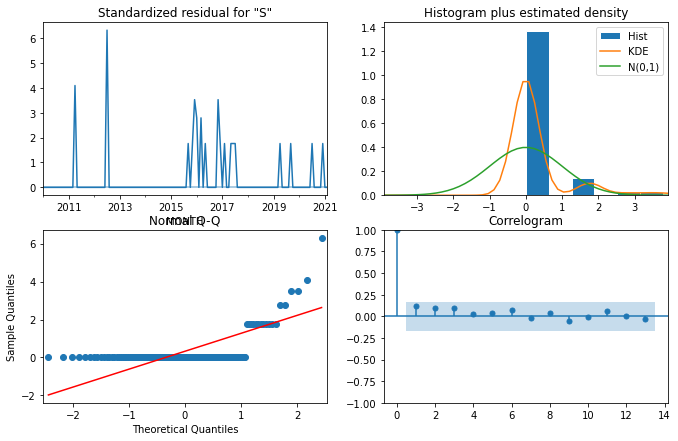

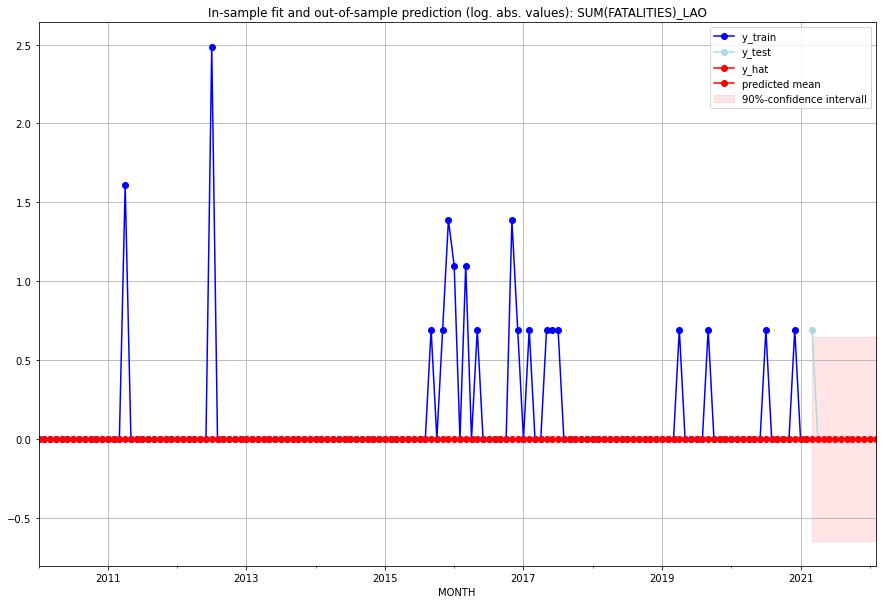

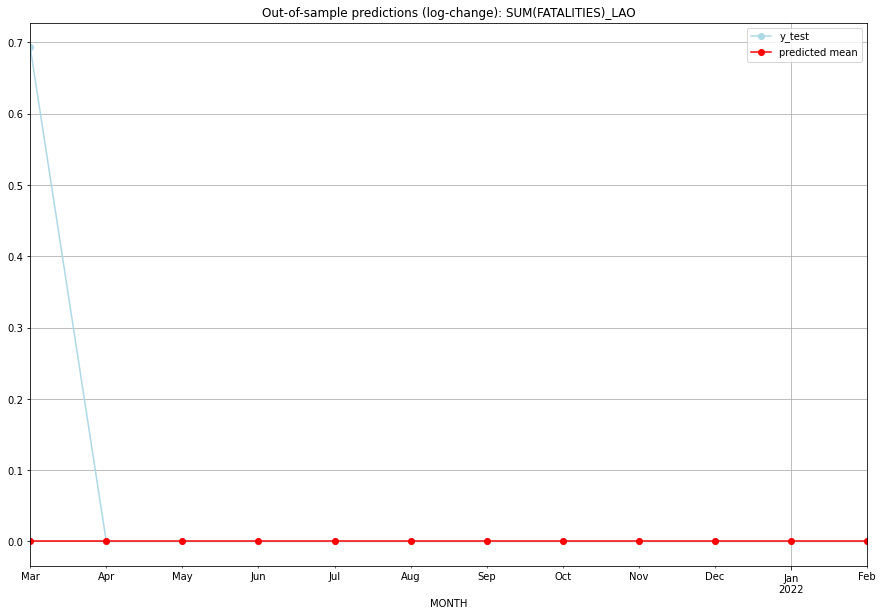

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   LAO   
1  2021-04-01       0.0         0.0           0.0        0.000000   LAO   
2  2021-05-01       0.0         0.0           0.0        0.000000   LAO   
3  2021-06-01       0.0         0.0           0.0        0.000000   LAO   
4  2021-07-01       0.0         0.0           0.0        0.000000   LAO   
5  2021-08-01       0.0         0.0           0.0        0.000000   LAO   
6  2021-09-01       0.0         0.0           0.0        0.000000   LAO   
7  2021-10-01       0.0         0.0           0.0        0.000000   LAO   
8  2021-11-01       0.0         0.0           0.0        0.000000   LAO   
9  2021-12-01       0.0         0.0           0.0        0.000000   LAO   
10 2022-01-01       0.0         0.0           0.0        0.000000   LAO   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.6581784949890611, 'fold_results': [nan, 0.5226045846769553, 0.5698844764170584, 0.8820464238731698]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LBN   No. Observations:                   62
Model:                SARIMAX(1, 1, 3)   Log Likelihood                 -78.718
Date:                 Wed, 19 Oct 2022   AIC                            173.436
Time:                         10:50:42   BIC                            190.323
Sample:                     01-31-2016   HQIC                           180.055
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1  

<Figure size 432x288 with 0 Axes>

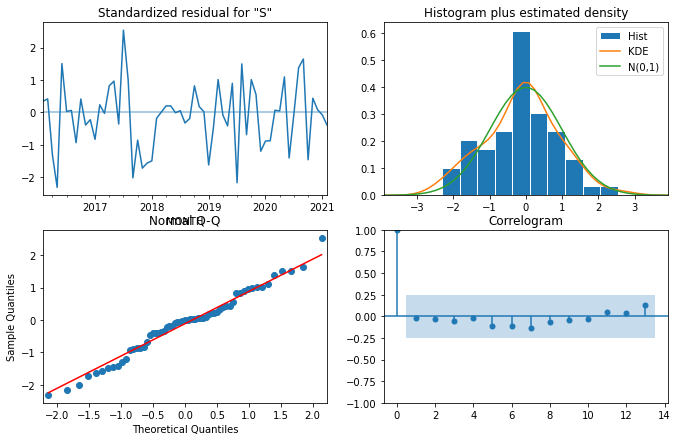

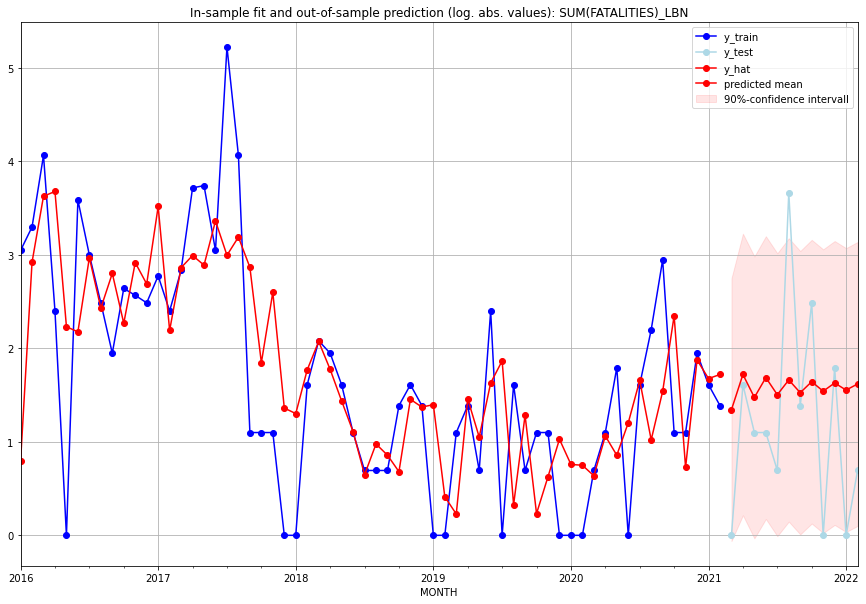

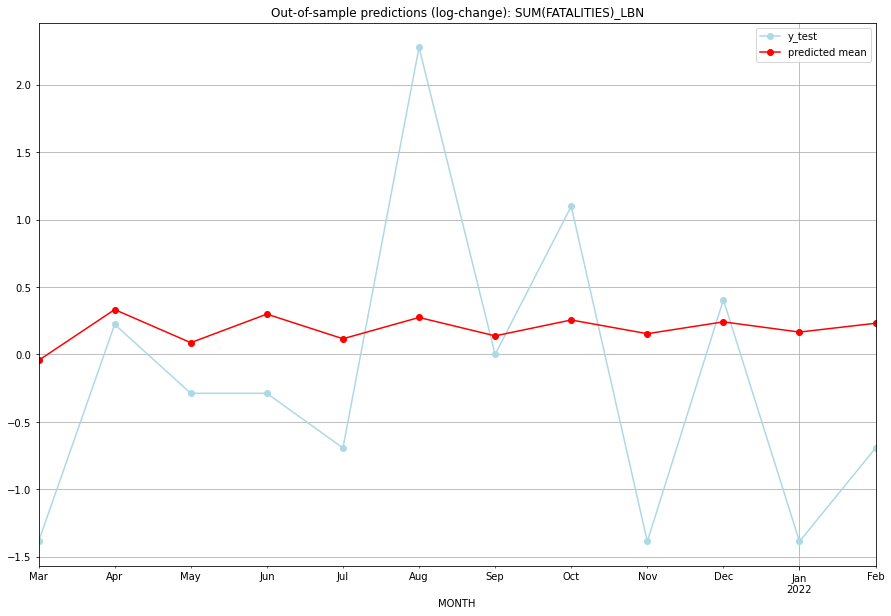

TADDA: 0.9537880389953189
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.829123         0.0     -0.043659       -1.386294   LBN   
1  2021-04-01  4.579832         4.0      0.332864        0.223144   LBN   
2  2021-05-01  3.366669         2.0      0.087706       -0.287682   LBN   
3  2021-06-01  4.396088         2.0      0.299380       -0.287682   LBN   
4  2021-07-01  3.494757         1.0      0.116617       -0.693147   LBN   
5  2021-08-01  4.263056        38.0      0.274418        2.277267   LBN   
6  2021-09-01  3.592683         3.0      0.138170        0.000000   LBN   
7  2021-10-01  4.166021        11.0      0.255808        1.098612   LBN   
8  2021-11-01  3.667072         0.0      0.154237       -1.386294   LBN   
9  2021-12-01  4.094849         5.0      0.241936        0.405465   LBN   
10 2022-01-01  3.723310         0.0      0.166216       -1.386294   LBN   
11 2022-02-01  4.042429         1.0      0.231594    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.3567096332239187, 'fold_results': [0.46209812037329684, 0.3554860599295475, 0.23104906018664842, 0.6193903955367764, 0.11552453009332421]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LBR   No. Observations:                  289
Model:                SARIMAX(1, 0, 0)   Log Likelihood                -386.398
Date:                 Wed, 19 Oct 2022   AIC                            776.795
Time:                         10:51:16   BIC                            784.128
Sample:                     02-28-1997   HQIC                           779.734
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

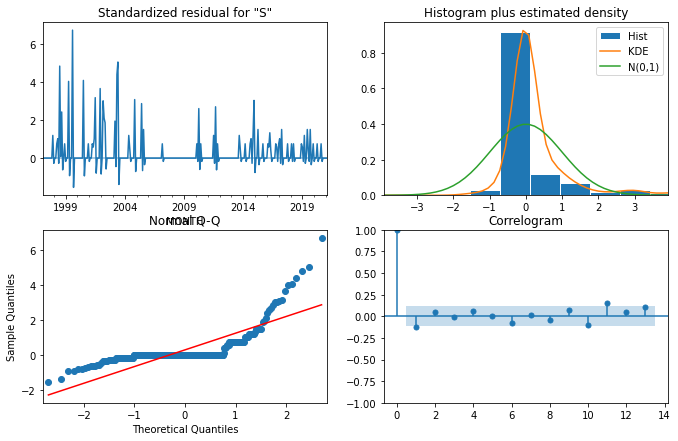

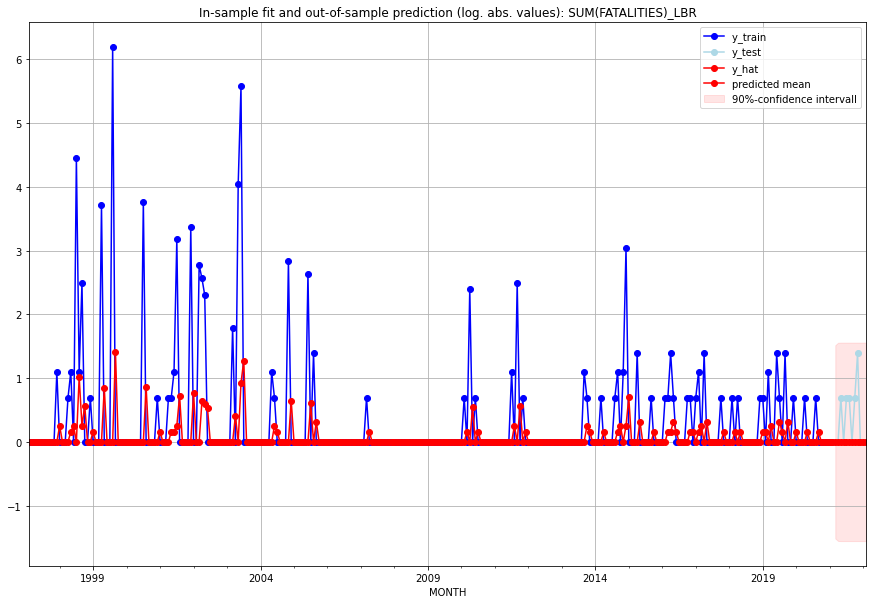

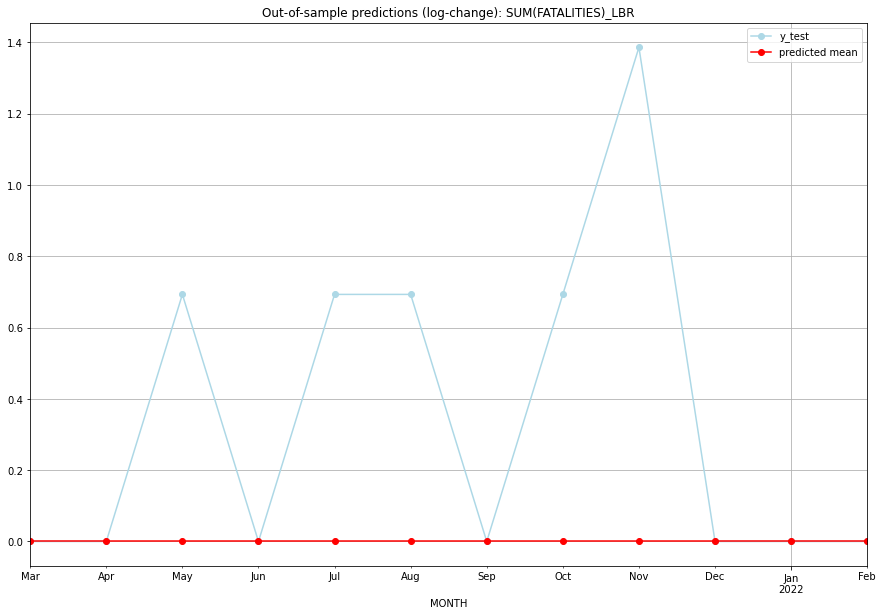

TADDA: 0.34657359027997264
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   LBR   
1  2021-04-01       0.0         0.0           0.0        0.000000   LBR   
2  2021-05-01       0.0         1.0           0.0        0.693147   LBR   
3  2021-06-01       0.0         0.0           0.0        0.000000   LBR   
4  2021-07-01       0.0         1.0           0.0        0.693147   LBR   
5  2021-08-01       0.0         1.0           0.0        0.693147   LBR   
6  2021-09-01       0.0         0.0           0.0        0.000000   LBR   
7  2021-10-01       0.0         1.0           0.0        0.693147   LBR   
8  2021-11-01       0.0         3.0           0.0        1.386294   LBR   
9  2021-12-01       0.0         0.0           0.0        0.000000   LBR   
10 2022-01-01       0.0         0.0           0.0        0.000000   LBR   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.905234008743945, 'fold_results': [0.6100515499958105, 0.9239853665546217, 0.46135333981708393, 0.7738332359401121, 1.7569465514120974]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LBY   No. Observations:                  289
Model:                SARIMAX(3, 1, 2)   Log Likelihood                -370.654
Date:                 Wed, 19 Oct 2022   AIC                            757.309
Time:                         10:51:46   BIC                            786.612
Sample:                     02-28-1997   HQIC                           769.052
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

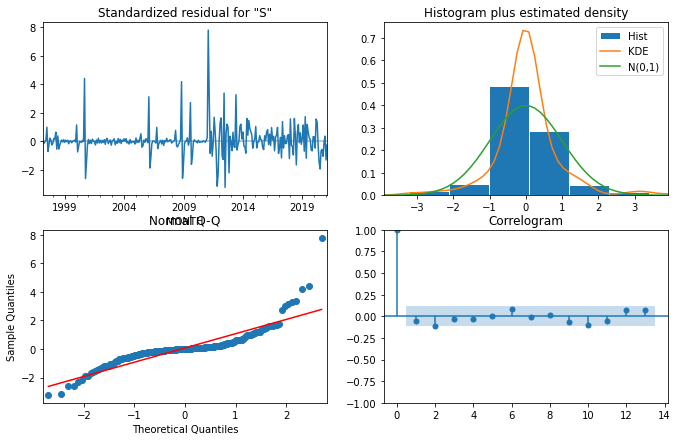

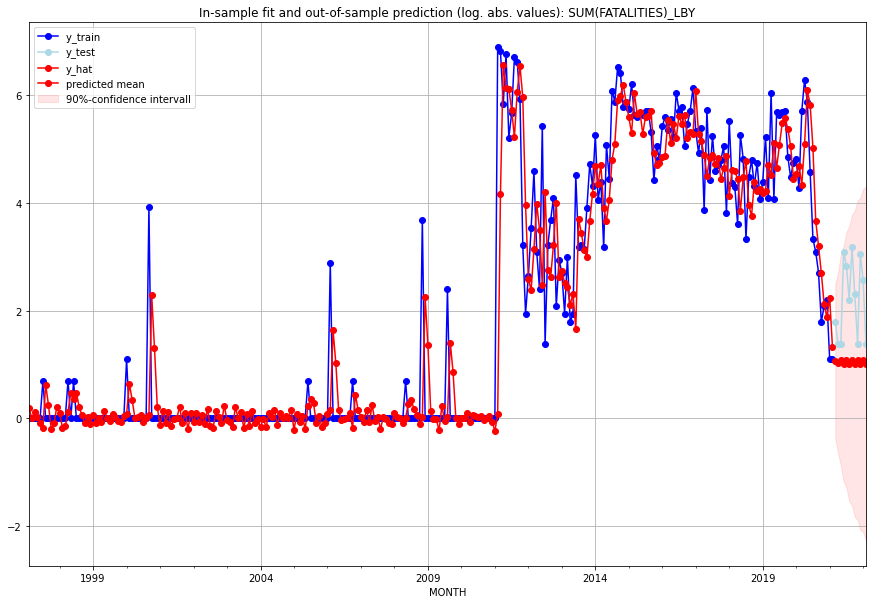

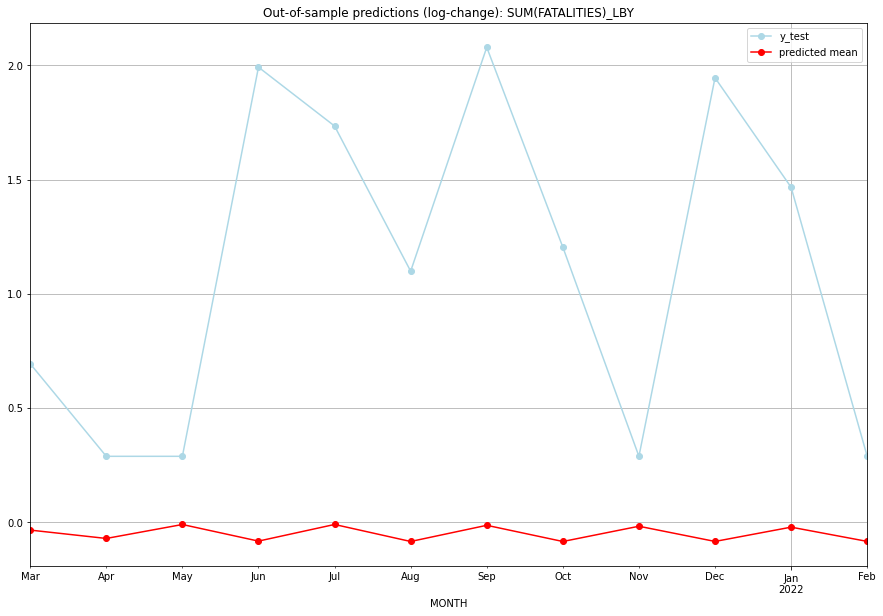

TADDA: 1.2155051412903104
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.895365         5.0     -0.035501        0.693147   LBY   
1  2021-04-01  1.791141         3.0     -0.072162        0.287682   LBY   
2  2021-05-01  1.967141         3.0     -0.011013        0.287682   LBY   
3  2021-06-01  1.758888        21.0     -0.083785        1.992430   LBY   
4  2021-07-01  1.967510        16.0     -0.010889        1.734601   LBY   
5  2021-08-01  1.754355         8.0     -0.085429        1.098612   LBY   
6  2021-09-01  1.956601        23.0     -0.014572        2.079442   LBY   
7  2021-10-01  1.754268         9.0     -0.085461        1.203973   LBY   
8  2021-11-01  1.944505         3.0     -0.018672        0.287682   LBY   
9  2021-12-01  1.754817        20.0     -0.085261        1.945910   LBY   
10 2022-01-01  1.932844        12.0     -0.022640        1.466337   LBY   
11 2022-02-01  1.755382         3.0     -0.085056    

<Figure size 432x288 with 0 Axes>

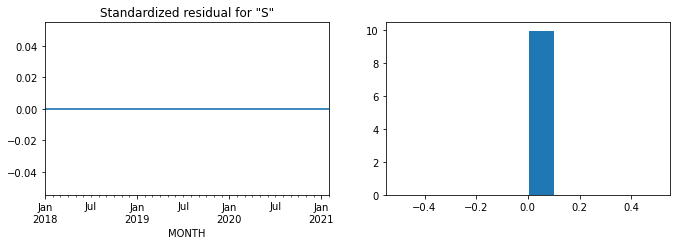

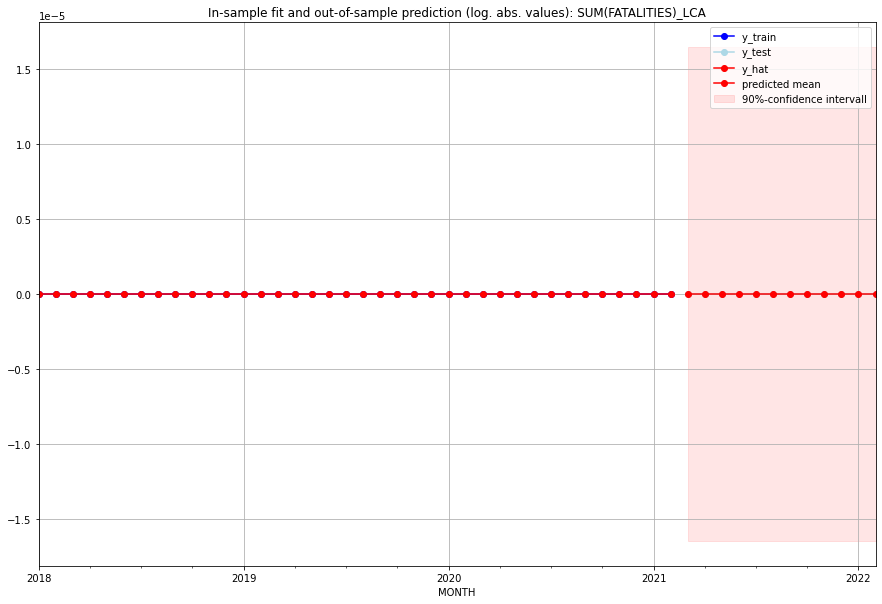

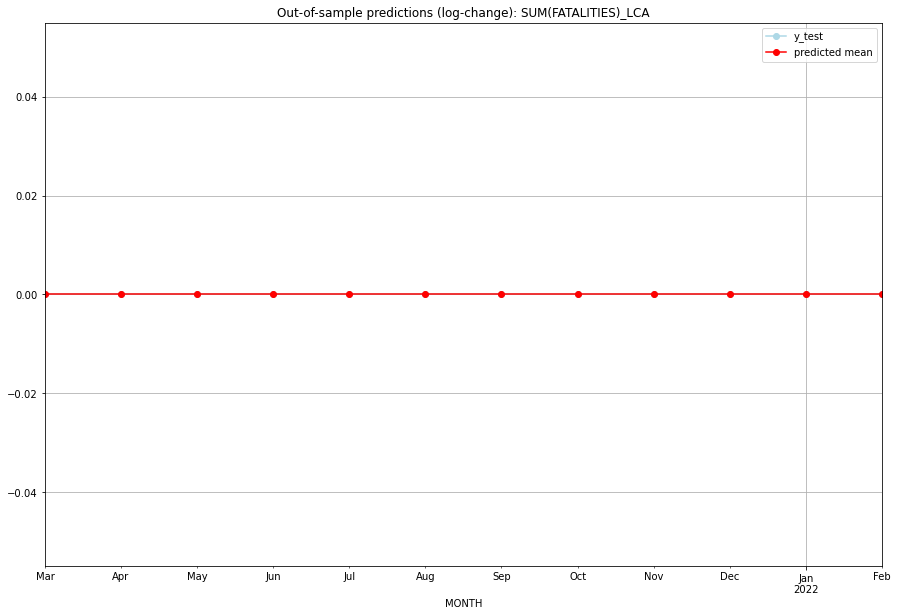

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   LCA   
1  2021-04-01       0.0         0.0           0.0             0.0   LCA   
2  2021-05-01       0.0         0.0           0.0             0.0   LCA   
3  2021-06-01       0.0         0.0           0.0             0.0   LCA   
4  2021-07-01       0.0         0.0           0.0             0.0   LCA   
5  2021-08-01       0.0         0.0           0.0             0.0   LCA   
6  2021-09-01       0.0         0.0           0.0             0.0   LCA   
7  2021-10-01       0.0         0.0           0.0             0.0   LCA   
8  2021-11-01       0.0         0.0           0.0             0.0   LCA   
9  2021-12-01       0.0         0.0           0.0             0.0   LCA   
10 2022-01-01       0.0         0.0           0.0             0.0   LCA   
11 2022-02-01       0.0         0.0           0.0             0.0   

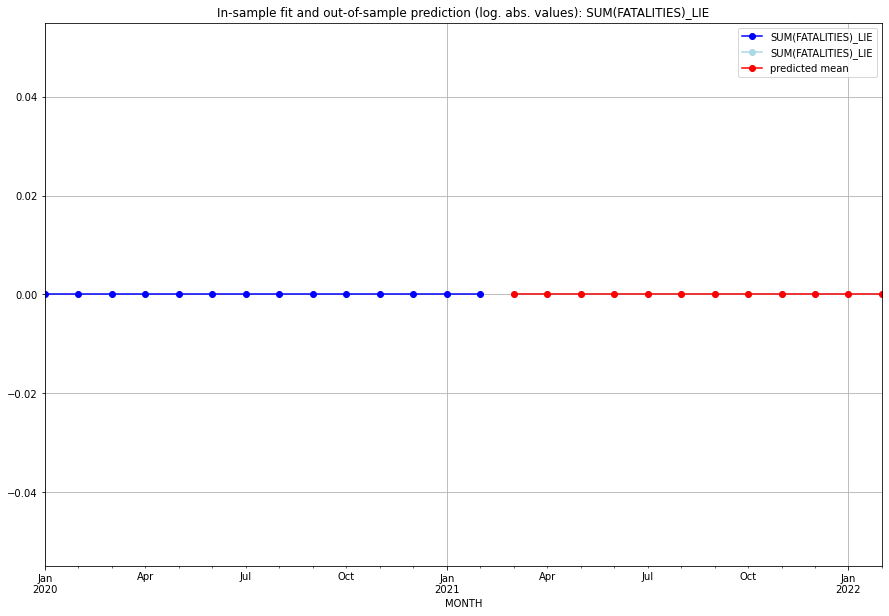

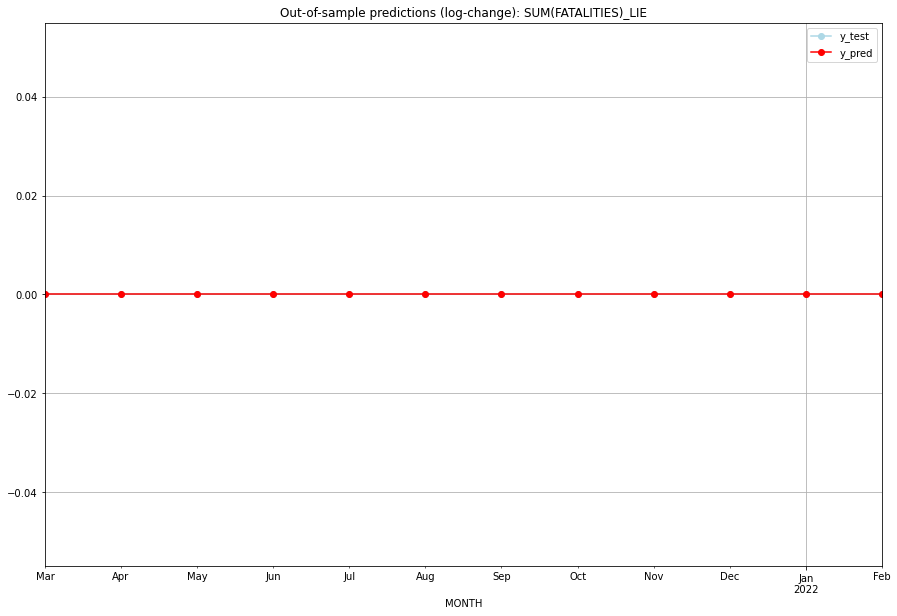

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   LIE   
1  2021-04-01       0.0         0.0           0.0             0.0   LIE   
2  2021-05-01       0.0         0.0           0.0             0.0   LIE   
3  2021-06-01       0.0         0.0           0.0             0.0   LIE   
4  2021-07-01       0.0         0.0           0.0             0.0   LIE   
5  2021-08-01       0.0         0.0           0.0             0.0   LIE   
6  2021-09-01       0.0         0.0           0.0             0.0   LIE   
7  2021-10-01       0.0         0.0           0.0             0.0   LIE   
8  2021-11-01       0.0         0.0           0.0             0.0   LIE   
9  2021-12-01       0.0         0.0           0.0             0.0   LIE   
10 2022-01-01       0.0         0.0           0.0             0.0   LIE   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5951532345418479, 'fold_results': [0.6114114094756348, 0.1493132891023379, 0.5033545592731179, 1.0549532194685738, 0.6567336953895752]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LKA   No. Observations:                  134
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -192.565
Date:                 Wed, 19 Oct 2022   AIC                            387.130
Time:                         10:52:25   BIC                            390.020
Sample:                     01-31-2010   HQIC                           388.305
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

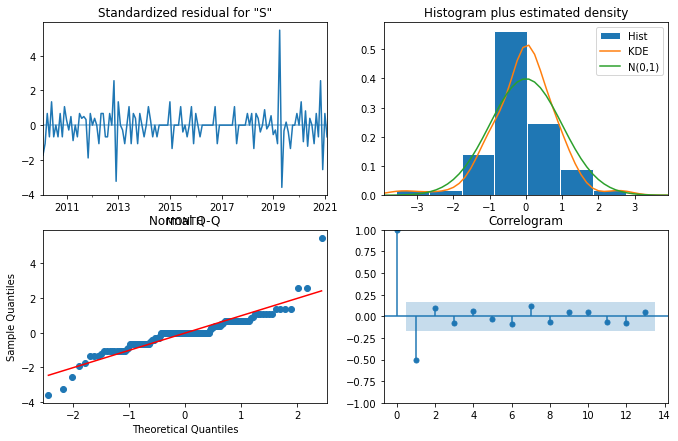

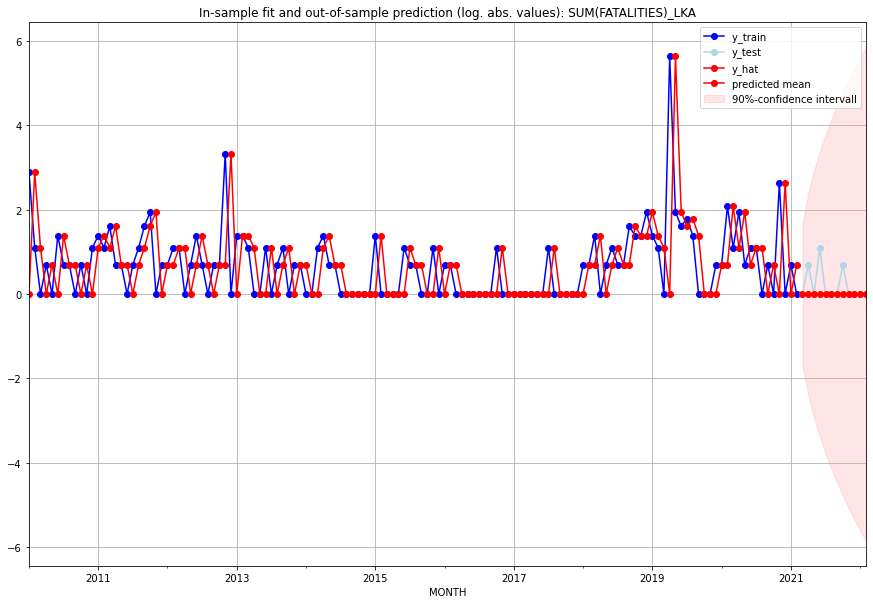

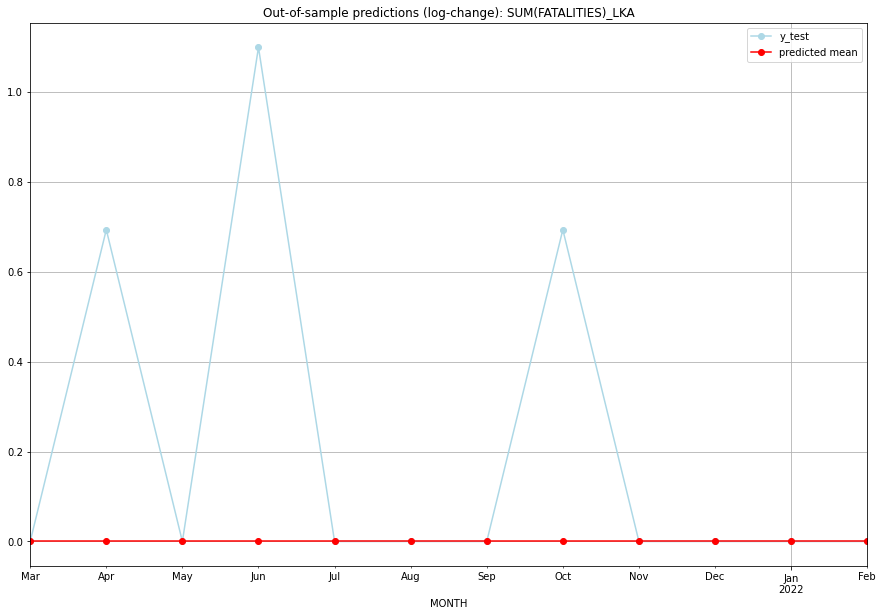

TADDA: 0.20707555414900003
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   LKA   
1  2021-04-01       0.0         1.0           0.0        0.693147   LKA   
2  2021-05-01       0.0         0.0           0.0        0.000000   LKA   
3  2021-06-01       0.0         2.0           0.0        1.098612   LKA   
4  2021-07-01       0.0         0.0           0.0        0.000000   LKA   
5  2021-08-01       0.0         0.0           0.0        0.000000   LKA   
6  2021-09-01       0.0         0.0           0.0        0.000000   LKA   
7  2021-10-01       0.0         1.0           0.0        0.693147   LKA   
8  2021-11-01       0.0         0.0           0.0        0.000000   LKA   
9  2021-12-01       0.0         0.0           0.0        0.000000   LKA   
10 2022-01-01       0.0         0.0           0.0        0.000000   LKA   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.14431154589483228, 'fold_results': [0.13411982603617503, 0.17328679513998632, 0.0, 0.29862657820467586, 0.11552453009332421]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_LSO   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -215.594
Date:                 Wed, 19 Oct 2022   AIC                            433.187
Time:                         10:52:58   BIC                            436.854
Sample:                     02-28-1997   HQIC                           434.656
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------

<Figure size 432x288 with 0 Axes>

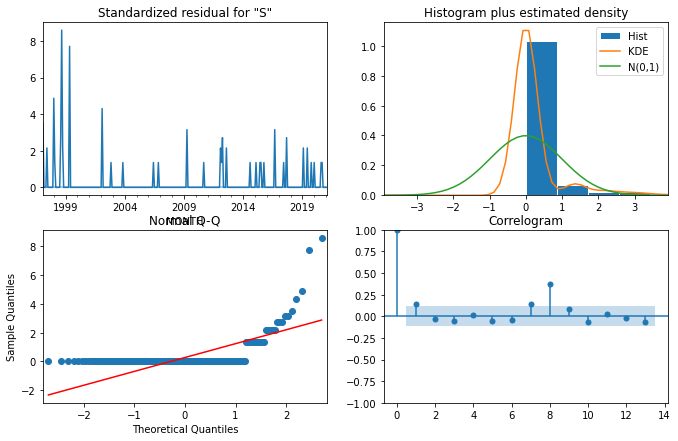

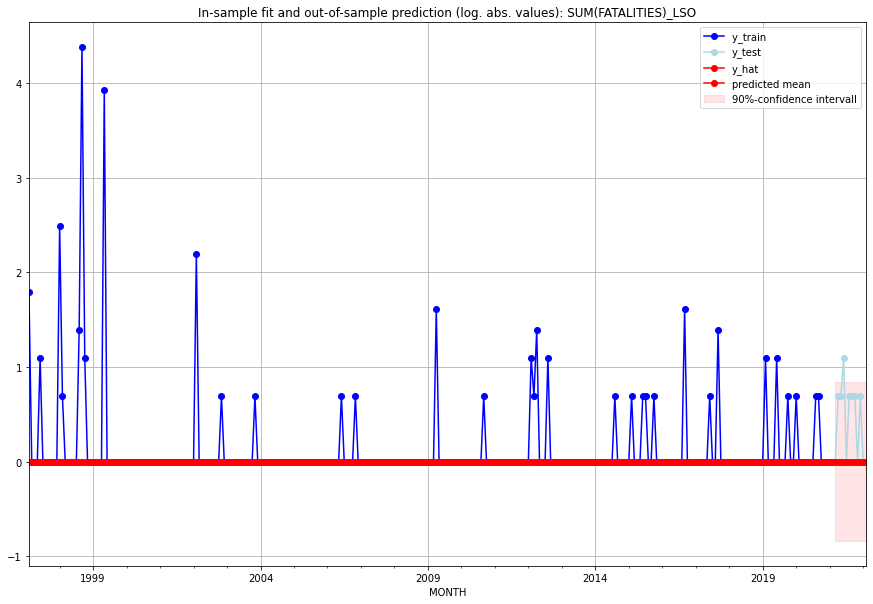

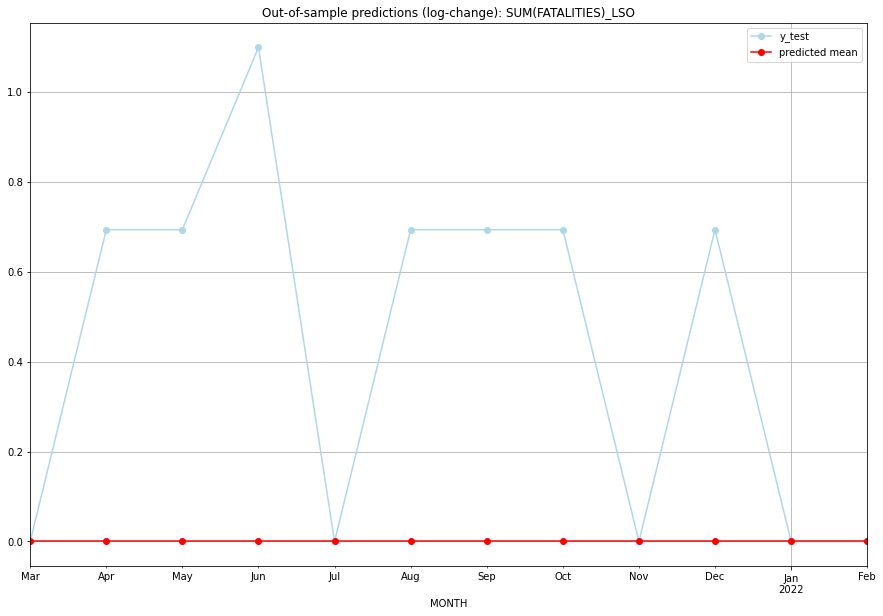

TADDA: 0.4381246143356485
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   LSO   
1  2021-04-01       0.0         1.0           0.0        0.693147   LSO   
2  2021-05-01       0.0         1.0           0.0        0.693147   LSO   
3  2021-06-01       0.0         2.0           0.0        1.098612   LSO   
4  2021-07-01       0.0         0.0           0.0        0.000000   LSO   
5  2021-08-01       0.0         1.0           0.0        0.693147   LSO   
6  2021-09-01       0.0         1.0           0.0        0.693147   LSO   
7  2021-10-01       0.0         1.0           0.0        0.693147   LSO   
8  2021-11-01       0.0         0.0           0.0        0.000000   LSO   
9  2021-12-01       0.0         1.0           0.0        0.693147   LSO   
10 2022-01-01       0.0         0.0           0.0        0.000000   LSO   
11 2022-02-01       0.0         0.0           0.0    

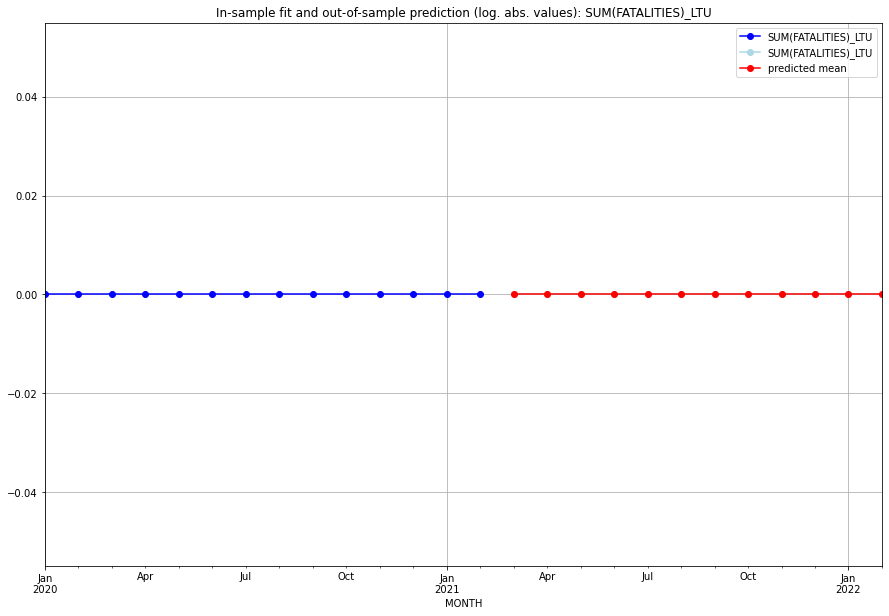

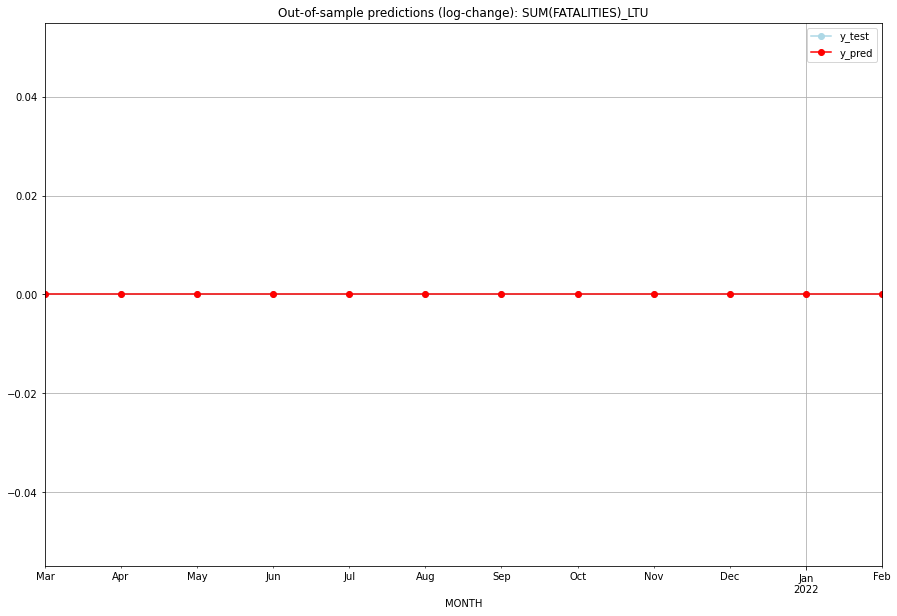

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   LTU   
1  2021-04-01       0.0         0.0           0.0             0.0   LTU   
2  2021-05-01       0.0         0.0           0.0             0.0   LTU   
3  2021-06-01       0.0         0.0           0.0             0.0   LTU   
4  2021-07-01       0.0         0.0           0.0             0.0   LTU   
5  2021-08-01       0.0         0.0           0.0             0.0   LTU   
6  2021-09-01       0.0         0.0           0.0             0.0   LTU   
7  2021-10-01       0.0         0.0           0.0             0.0   LTU   
8  2021-11-01       0.0         0.0           0.0             0.0   LTU   
9  2021-12-01       0.0         0.0           0.0             0.0   LTU   
10 2022-01-01       0.0         0.0           0.0             0.0   LTU   
11 2022-02-01       0.0         0.0           0.0             0.0   

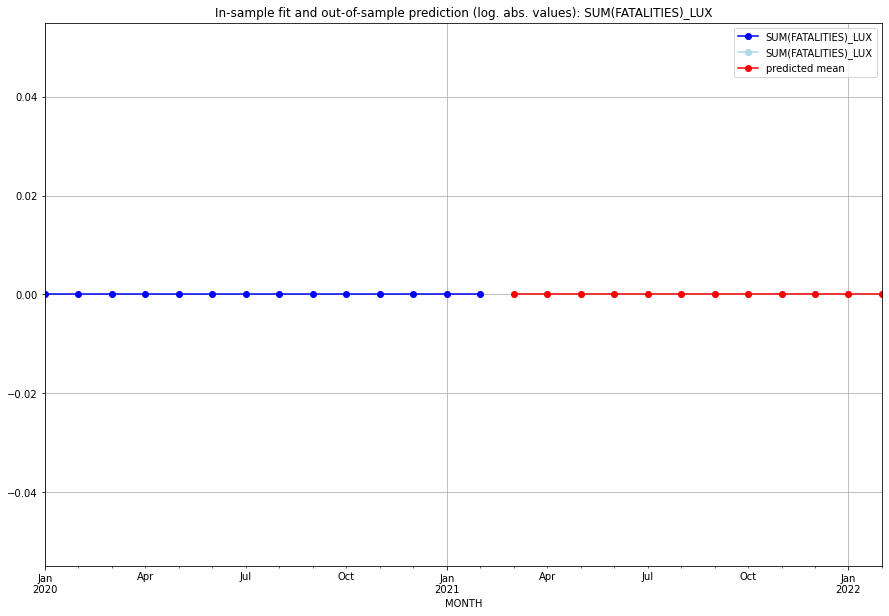

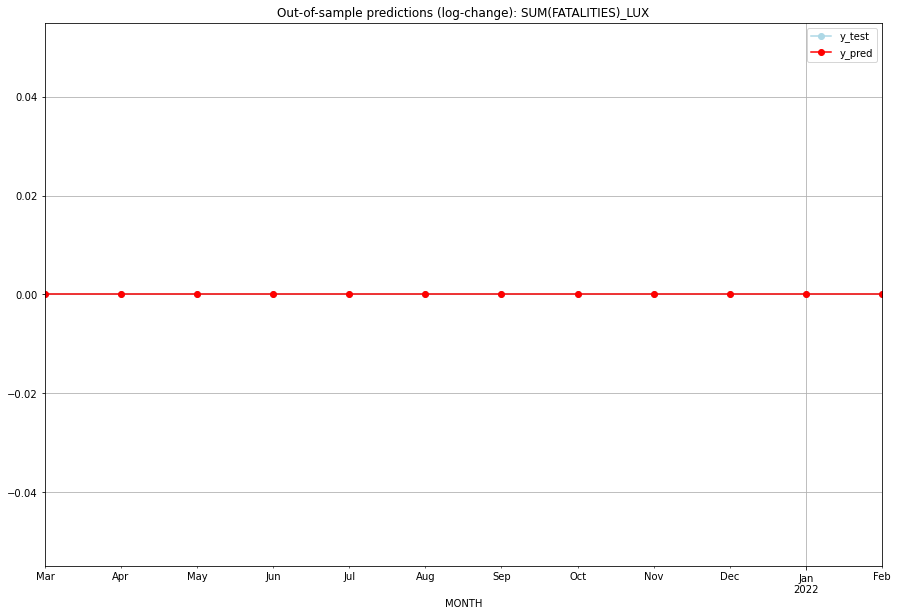

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   LUX   
1  2021-04-01       0.0         0.0           0.0             0.0   LUX   
2  2021-05-01       0.0         0.0           0.0             0.0   LUX   
3  2021-06-01       0.0         0.0           0.0             0.0   LUX   
4  2021-07-01       0.0         0.0           0.0             0.0   LUX   
5  2021-08-01       0.0         0.0           0.0             0.0   LUX   
6  2021-09-01       0.0         0.0           0.0             0.0   LUX   
7  2021-10-01       0.0         0.0           0.0             0.0   LUX   
8  2021-11-01       0.0         0.0           0.0             0.0   LUX   
9  2021-12-01       0.0         0.0           0.0             0.0   LUX   
10 2022-01-01       0.0         0.0           0.0             0.0   LUX   
11 2022-02-01       0.0         0.0           0.0             0.0   

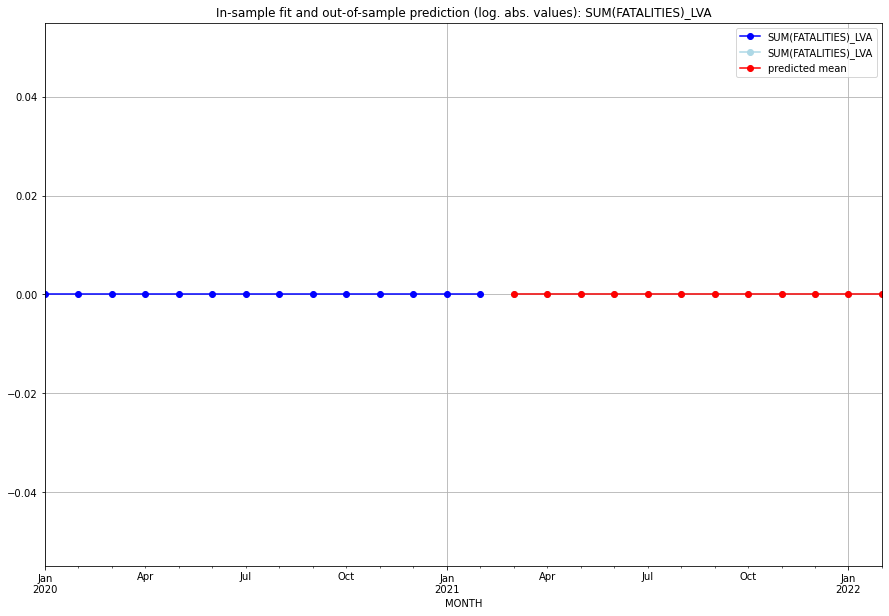

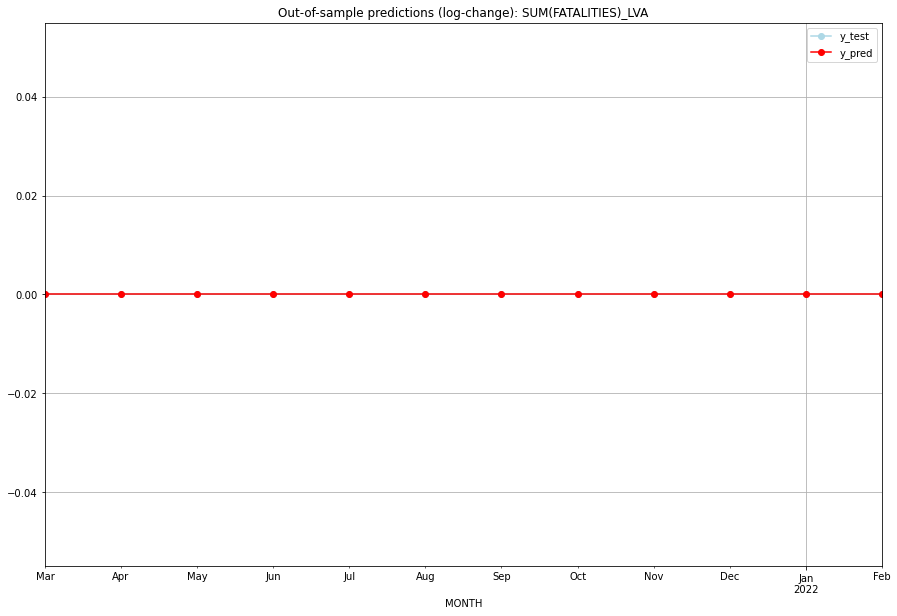

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   LVA   
1  2021-04-01       0.0         0.0           0.0             0.0   LVA   
2  2021-05-01       0.0         0.0           0.0             0.0   LVA   
3  2021-06-01       0.0         0.0           0.0             0.0   LVA   
4  2021-07-01       0.0         0.0           0.0             0.0   LVA   
5  2021-08-01       0.0         0.0           0.0             0.0   LVA   
6  2021-09-01       0.0         0.0           0.0             0.0   LVA   
7  2021-10-01       0.0         0.0           0.0             0.0   LVA   
8  2021-11-01       0.0         0.0           0.0             0.0   LVA   
9  2021-12-01       0.0         0.0           0.0             0.0   LVA   
10 2022-01-01       0.0         0.0           0.0             0.0   LVA   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

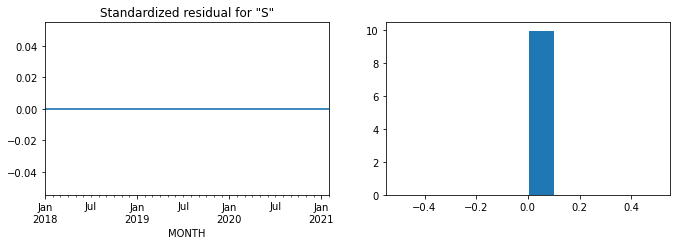

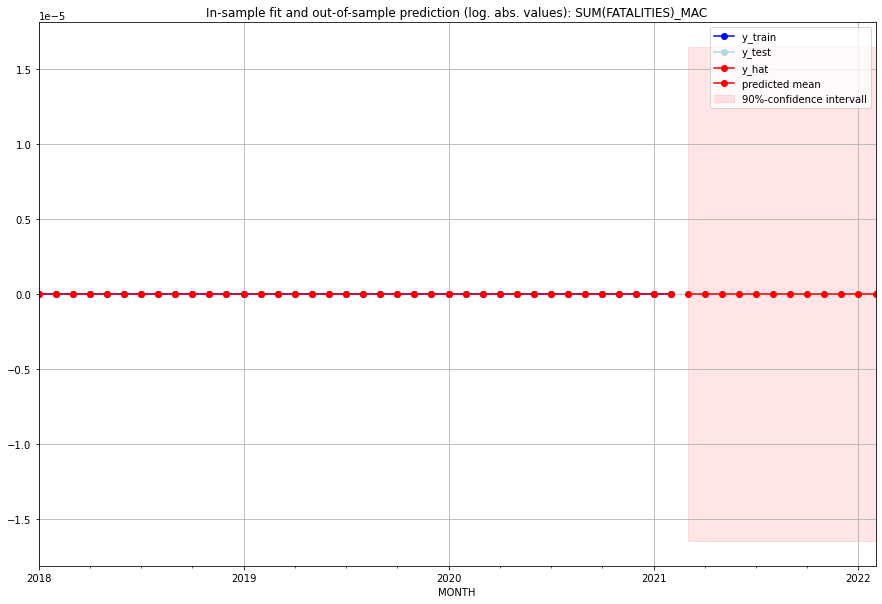

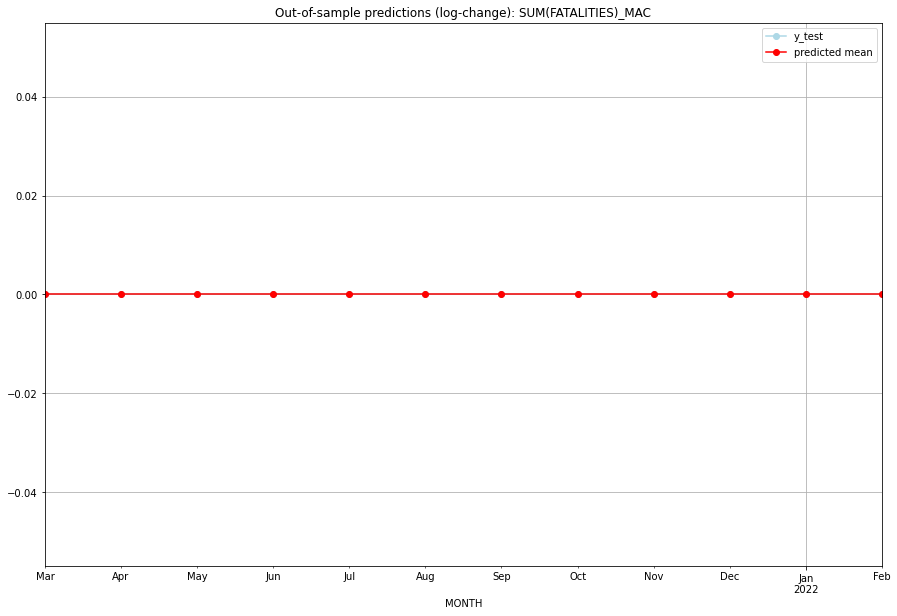

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MAC   
1  2021-04-01       0.0         0.0           0.0             0.0   MAC   
2  2021-05-01       0.0         0.0           0.0             0.0   MAC   
3  2021-06-01       0.0         0.0           0.0             0.0   MAC   
4  2021-07-01       0.0         0.0           0.0             0.0   MAC   
5  2021-08-01       0.0         0.0           0.0             0.0   MAC   
6  2021-09-01       0.0         0.0           0.0             0.0   MAC   
7  2021-10-01       0.0         0.0           0.0             0.0   MAC   
8  2021-11-01       0.0         0.0           0.0             0.0   MAC   
9  2021-12-01       0.0         0.0           0.0             0.0   MAC   
10 2022-01-01       0.0         0.0           0.0             0.0   MAC   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.14255553730053516, 'fold_results': [0.0, 0.20707555414900003, 0.35638884325133796, 0.1493132891023379, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MAR   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -185.334
Date:                 Wed, 19 Oct 2022   AIC                            372.667
Time:                         10:53:47   BIC                            376.333
Sample:                     02-28-1997   HQIC                           374.136
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

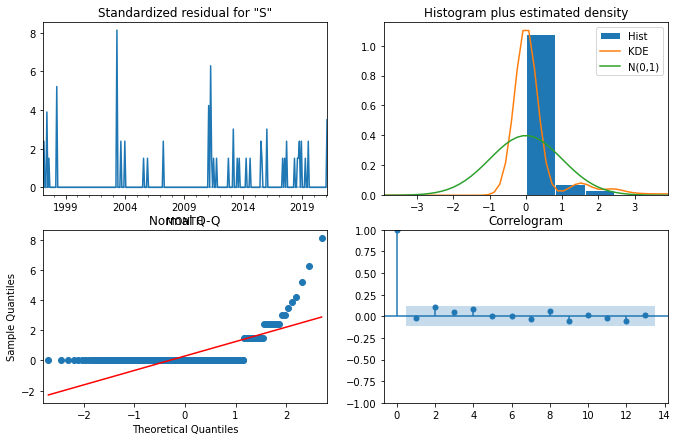

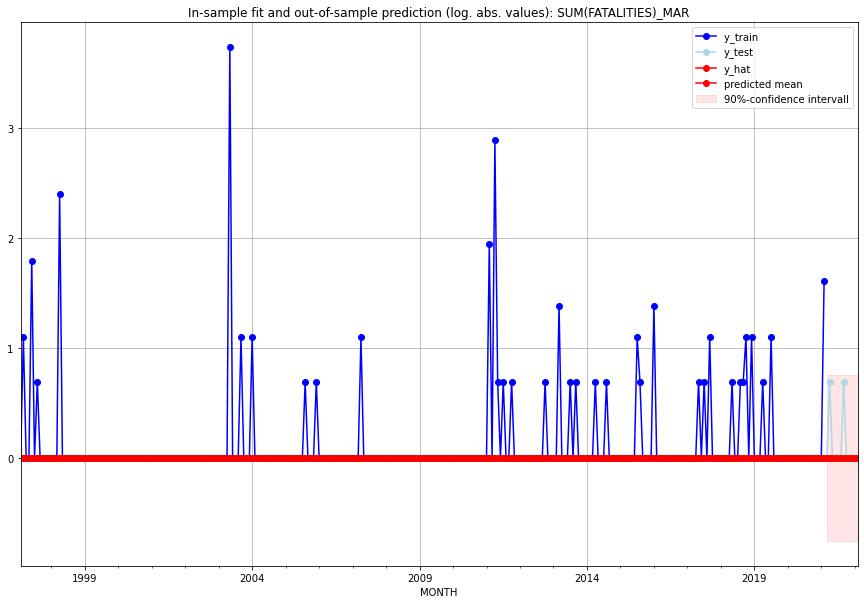

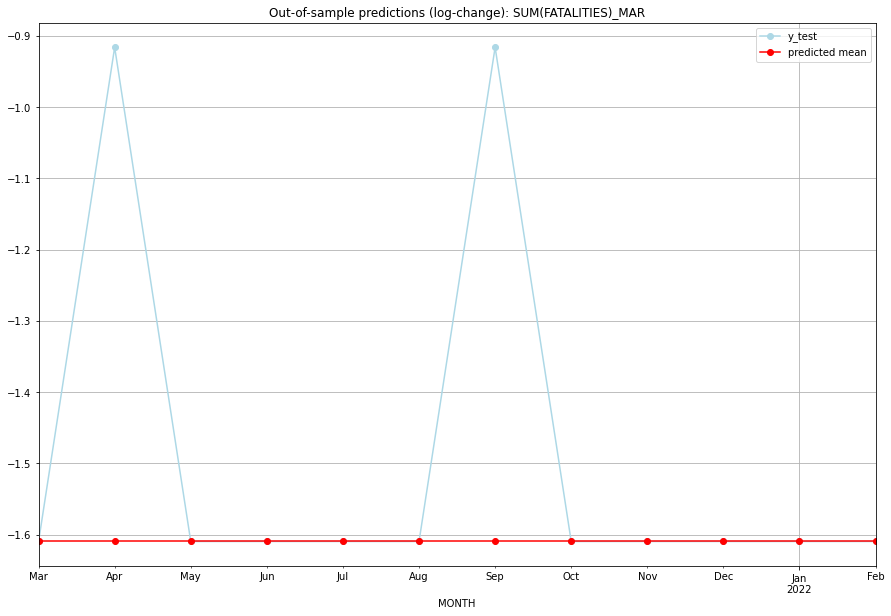

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0     -1.609438       -1.609438   MAR   
1  2021-04-01       0.0         1.0     -1.609438       -0.916291   MAR   
2  2021-05-01       0.0         0.0     -1.609438       -1.609438   MAR   
3  2021-06-01       0.0         0.0     -1.609438       -1.609438   MAR   
4  2021-07-01       0.0         0.0     -1.609438       -1.609438   MAR   
5  2021-08-01       0.0         0.0     -1.609438       -1.609438   MAR   
6  2021-09-01       0.0         1.0     -1.609438       -0.916291   MAR   
7  2021-10-01       0.0         0.0     -1.609438       -1.609438   MAR   
8  2021-11-01       0.0         0.0     -1.609438       -1.609438   MAR   
9  2021-12-01       0.0         0.0     -1.609438       -1.609438   MAR   
10 2022-01-01       0.0         0.0     -1.609438       -1.609438   MAR   
11 2022-02-01       0.0         0.0     -1.609438   

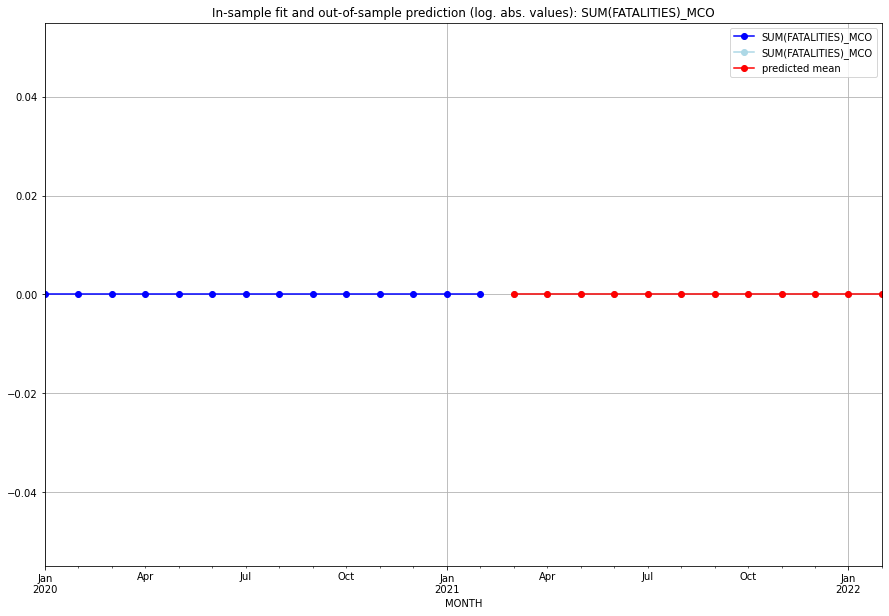

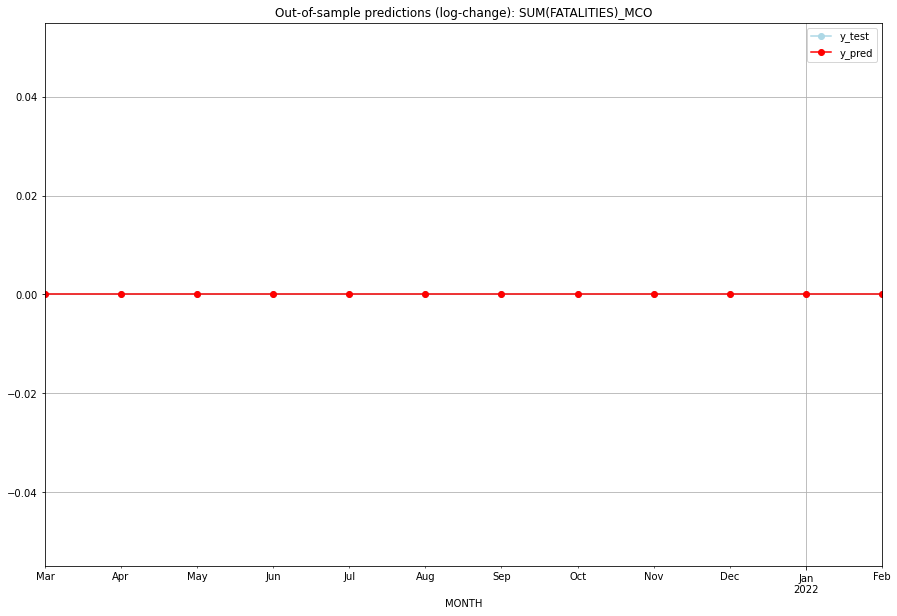

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MCO   
1  2021-04-01       0.0         0.0           0.0             0.0   MCO   
2  2021-05-01       0.0         0.0           0.0             0.0   MCO   
3  2021-06-01       0.0         0.0           0.0             0.0   MCO   
4  2021-07-01       0.0         0.0           0.0             0.0   MCO   
5  2021-08-01       0.0         0.0           0.0             0.0   MCO   
6  2021-09-01       0.0         0.0           0.0             0.0   MCO   
7  2021-10-01       0.0         0.0           0.0             0.0   MCO   
8  2021-11-01       0.0         0.0           0.0             0.0   MCO   
9  2021-12-01       0.0         0.0           0.0             0.0   MCO   
10 2022-01-01       0.0         0.0           0.0             0.0   MCO   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

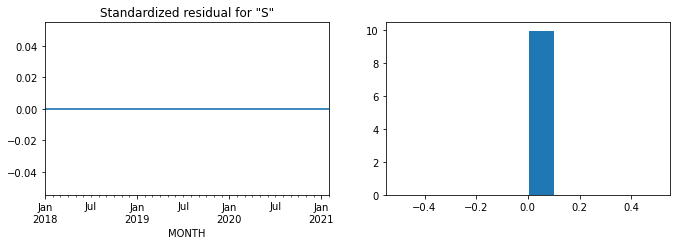

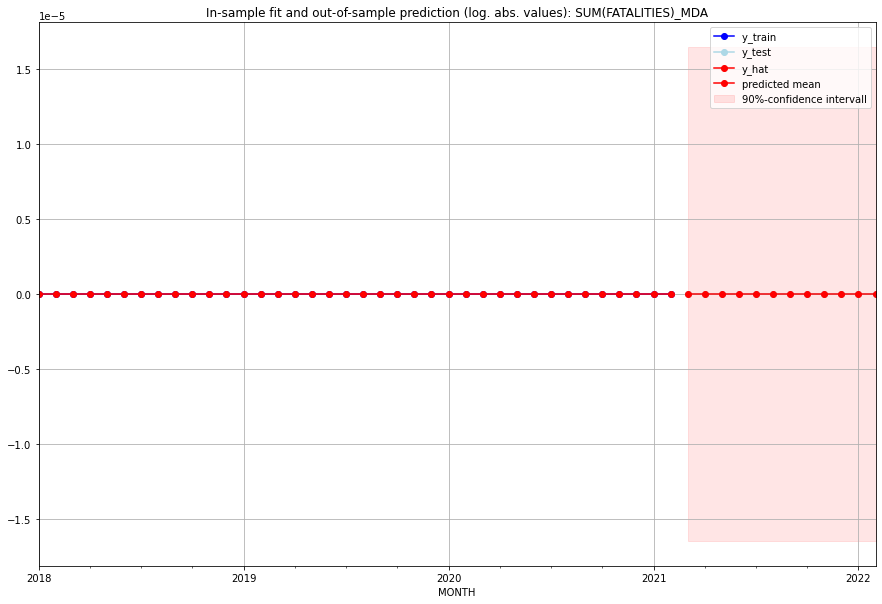

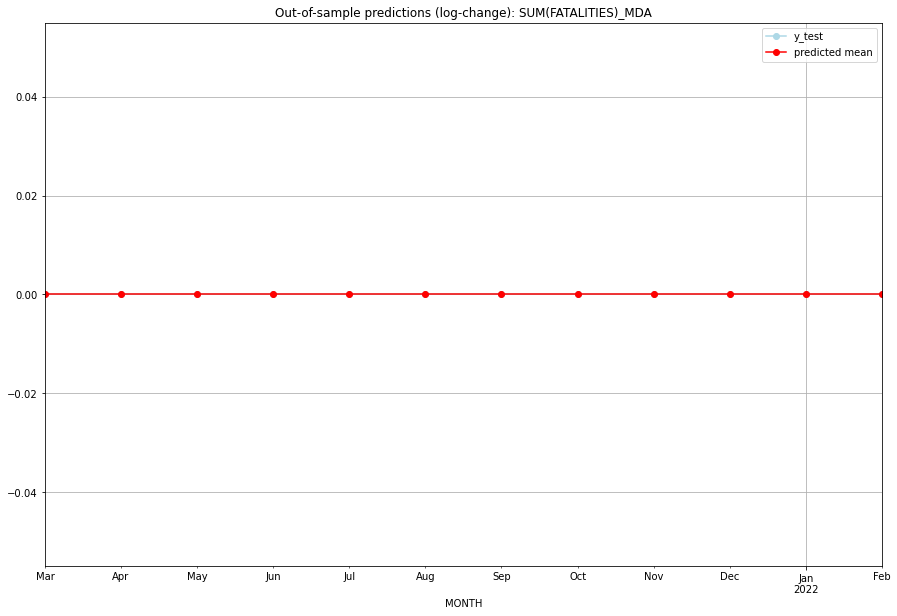

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MDA   
1  2021-04-01       0.0         0.0           0.0             0.0   MDA   
2  2021-05-01       0.0         0.0           0.0             0.0   MDA   
3  2021-06-01       0.0         0.0           0.0             0.0   MDA   
4  2021-07-01       0.0         0.0           0.0             0.0   MDA   
5  2021-08-01       0.0         0.0           0.0             0.0   MDA   
6  2021-09-01       0.0         0.0           0.0             0.0   MDA   
7  2021-10-01       0.0         0.0           0.0             0.0   MDA   
8  2021-11-01       0.0         0.0           0.0             0.0   MDA   
9  2021-12-01       0.0         0.0           0.0             0.0   MDA   
10 2022-01-01       0.0         0.0           0.0             0.0   MDA   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.7549703286591043, 'fold_results': [1.0532978648547762, 0.5566134830115996, 0.7625294761378055, 0.8131863113109228, 0.5892245079804171]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MDG   No. Observations:                  289
Model:                SARIMAX(3, 1, 3)   Log Likelihood                -354.551
Date:                 Wed, 19 Oct 2022   AIC                            723.103
Time:                         10:54:08   BIC                            748.744
Sample:                     02-28-1997   HQIC                           733.378
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

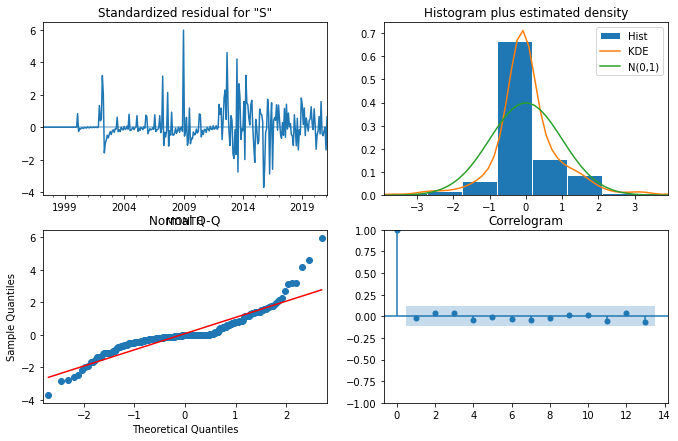

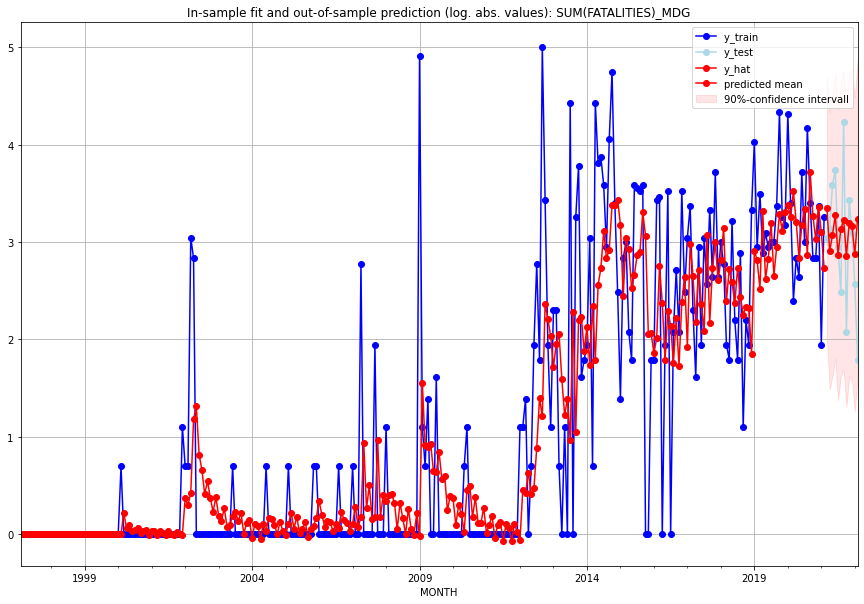

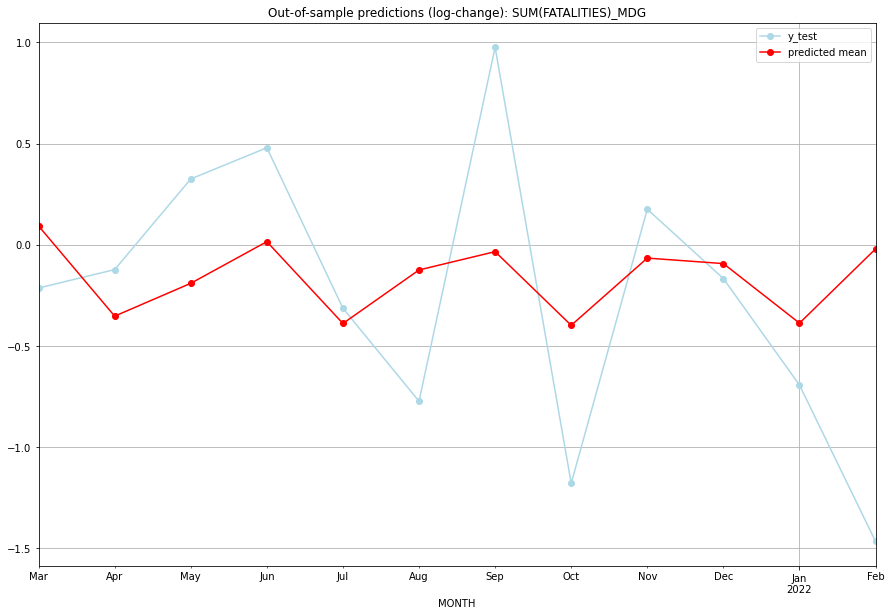

TADDA: 0.5401625501414217
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  27.535691        20.0      0.093059       -0.213574   MDG   
1  2021-04-01  17.274364        22.0     -0.352597       -0.122602   MDG   
2  2021-05-01  20.493326        35.0     -0.190354        0.325422   MDG   
3  2021-06-01  25.406252        41.0      0.015504        0.479573   MDG   
4  2021-07-01  16.623289        18.0     -0.388875       -0.313658   MDG   
5  2021-08-01  21.959460        11.0     -0.124366       -0.773190   MDG   
6  2021-09-01  24.133983        68.0     -0.033876        0.976010   MDG   
7  2021-10-01  16.464510         7.0     -0.397926       -1.178655   MDG   
8  2021-11-01  23.346265        30.0     -0.065718        0.175891   MDG   
9  2021-12-01  22.694453        21.0     -0.092856       -0.167054   MDG   
10 2022-01-01  16.652028        12.0     -0.387246       -0.693147   MDG   
11 2022-02-01  24.479265         5.0     

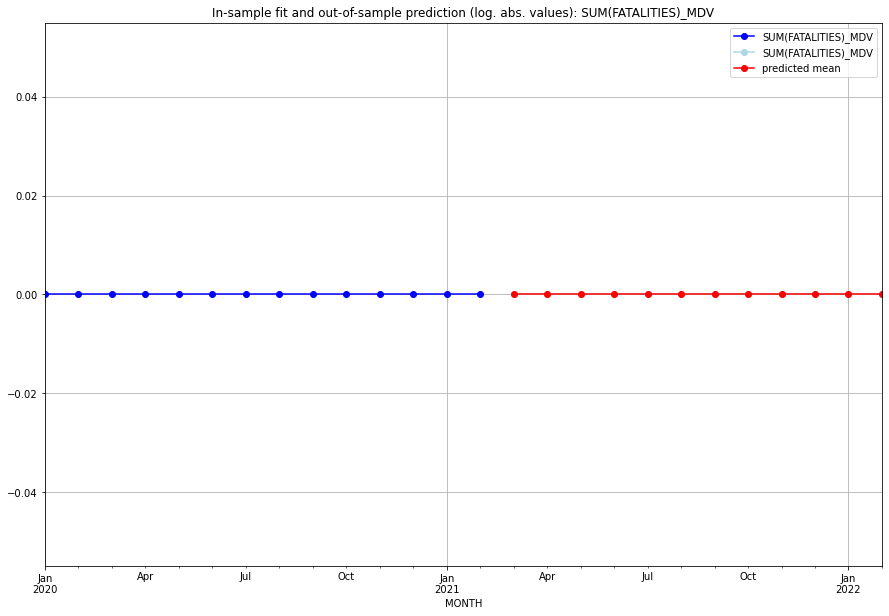

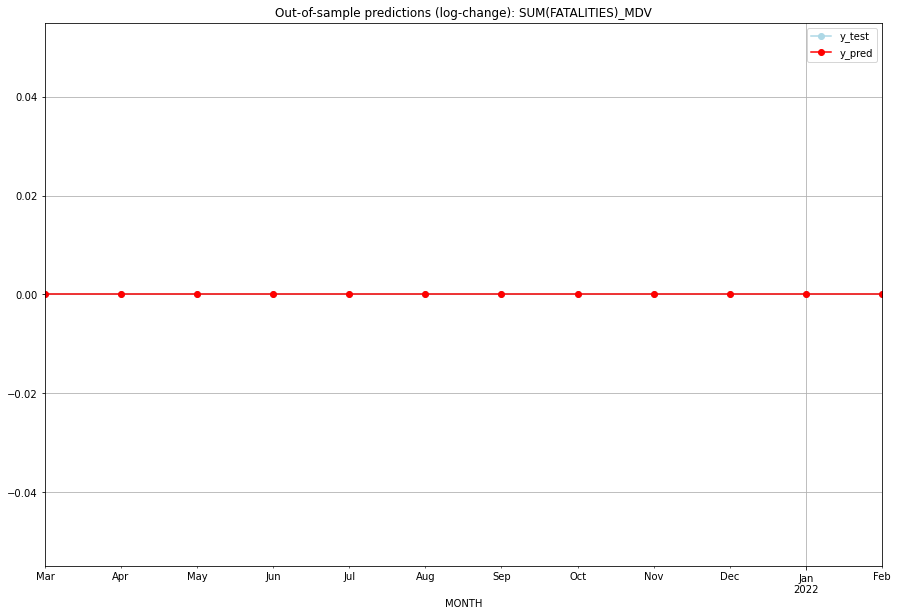

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MDV   
1  2021-04-01       0.0         0.0           0.0             0.0   MDV   
2  2021-05-01       0.0         0.0           0.0             0.0   MDV   
3  2021-06-01       0.0         0.0           0.0             0.0   MDV   
4  2021-07-01       0.0         0.0           0.0             0.0   MDV   
5  2021-08-01       0.0         0.0           0.0             0.0   MDV   
6  2021-09-01       0.0         0.0           0.0             0.0   MDV   
7  2021-10-01       0.0         0.0           0.0             0.0   MDV   
8  2021-11-01       0.0         0.0           0.0             0.0   MDV   
9  2021-12-01       0.0         0.0           0.0             0.0   MDV   
10 2022-01-01       0.0         0.0           0.0             0.0   MDV   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.09704017814342951, 'fold_results': [nan, 0.09704017814342951]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MEX   No. Observations:                   38
Model:                SARIMAX(3, 1, 3)   Log Likelihood                  25.592
Date:                 Wed, 19 Oct 2022   AIC                            -37.184
Time:                         10:54:32   BIC                            -25.907
Sample:                     01-31-2018   HQIC                           -33.208
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0874      1.428      0.06

<Figure size 432x288 with 0 Axes>

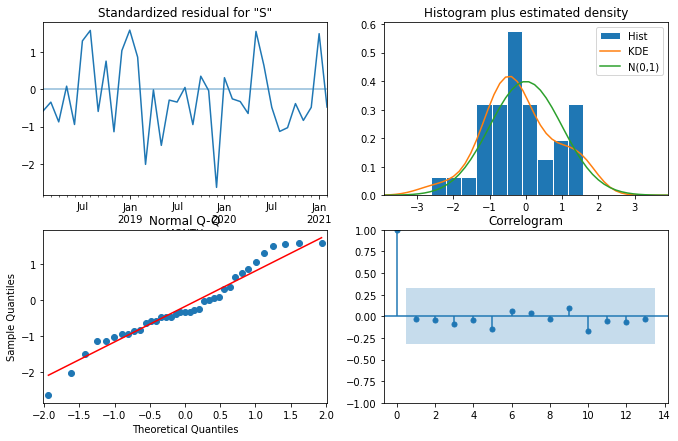

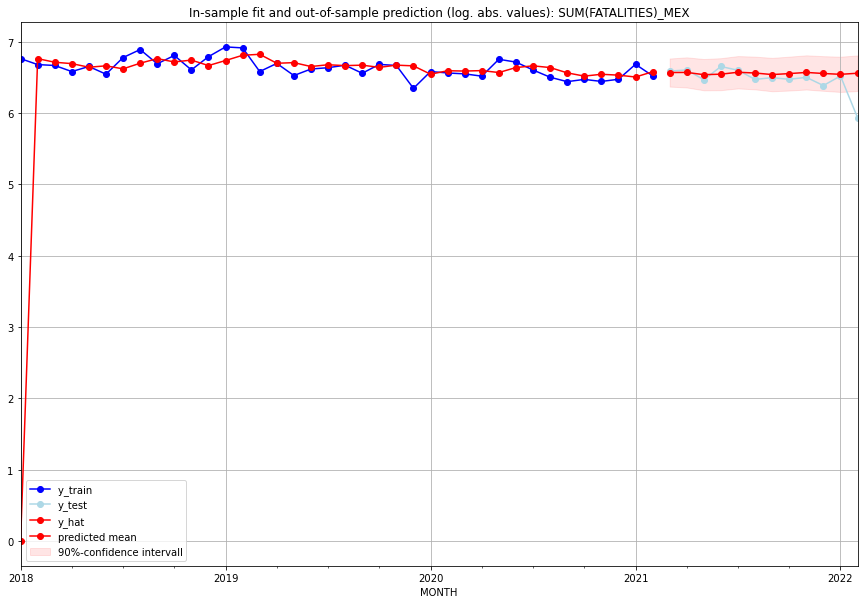

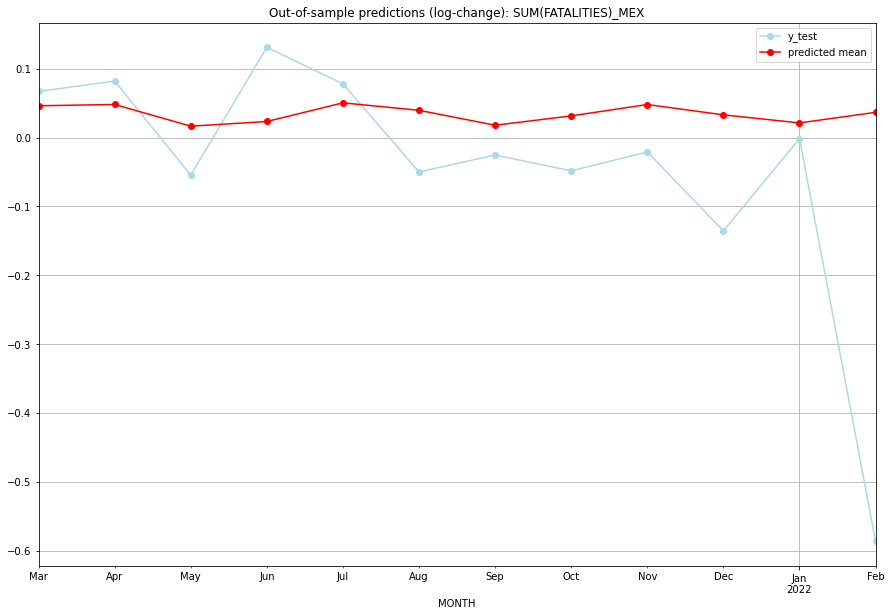

TADDA: 0.13025691036435041
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  709.046083       724.0      0.046183        0.067024   MEX   
1  2021-04-01  710.396783       735.0      0.048083        0.082083   MEX   
2  2021-05-01  688.309991       641.0      0.016544       -0.054559   MEX   
3  2021-06-01  693.010655       772.0      0.023340        0.131132   MEX   
4  2021-07-01  712.087973       732.0      0.050458        0.077998   MEX   
5  2021-08-01  704.397555       644.0      0.039614       -0.049897   MEX   
6  2021-09-01  689.240027       660.0      0.017892       -0.025393   MEX   
7  2021-10-01  698.687526       645.0      0.031487       -0.048348   MEX   
8  2021-11-01  710.348655       663.0      0.048015       -0.020865   MEX   
9  2021-12-01  699.742244       591.0      0.032993       -0.135641   MEX   
10 2022-01-01  691.592052       676.0      0.021294       -0.001476   MEX   
11 2022-02-01  702.322311   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MKD   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  29.122
Date:                 Wed, 19 Oct 2022   AIC                            -56.244
Time:                         10:54:45   BIC                            -54.606
Sample:                     01-31-2018   HQIC                           -55.661
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0126      0.001     18.748      0.000       0.011       0

<Figure size 432x288 with 0 Axes>

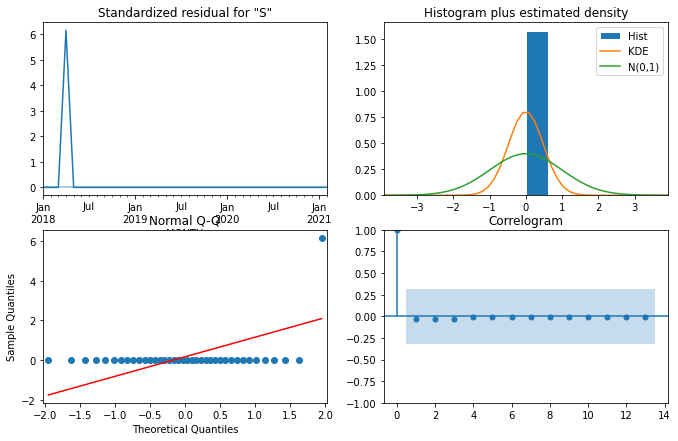

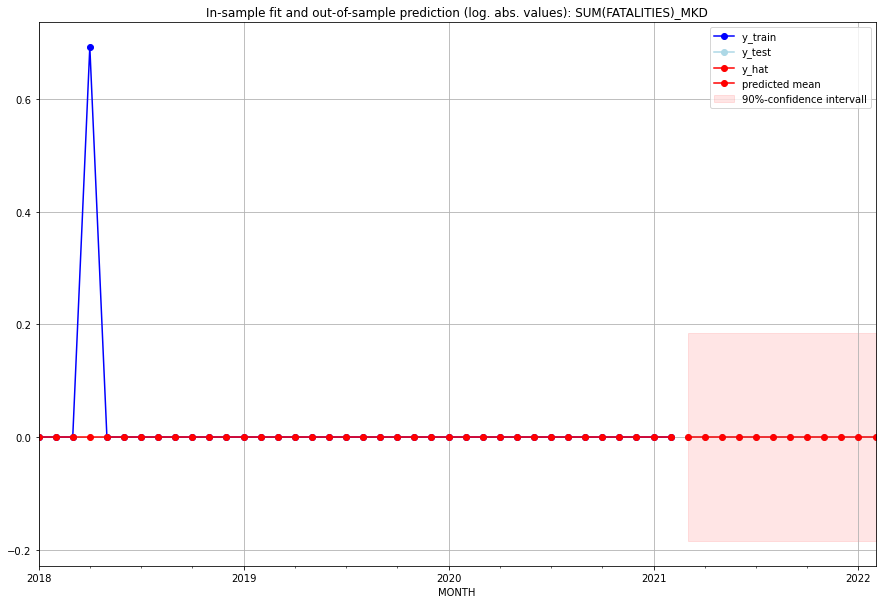

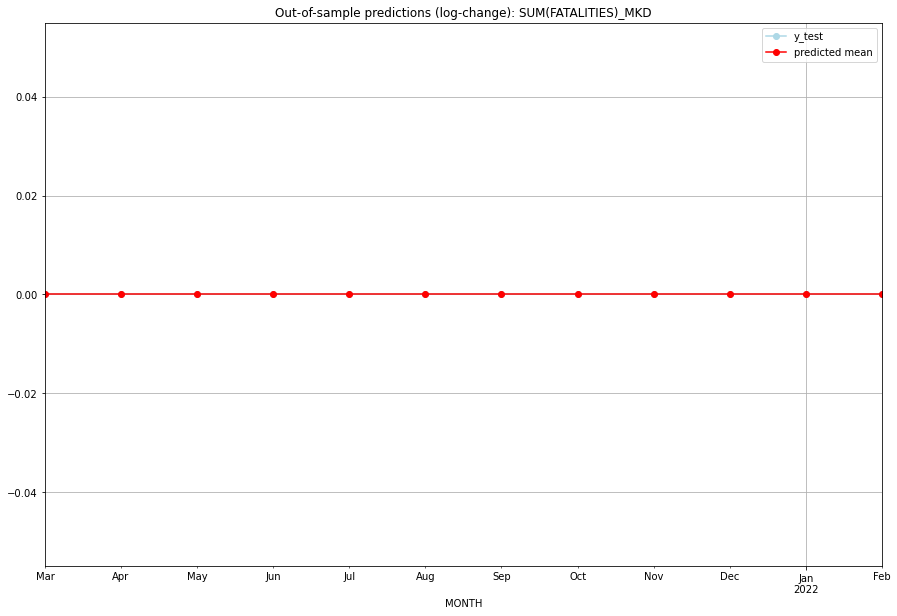

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MKD   
1  2021-04-01       0.0         0.0           0.0             0.0   MKD   
2  2021-05-01       0.0         0.0           0.0             0.0   MKD   
3  2021-06-01       0.0         0.0           0.0             0.0   MKD   
4  2021-07-01       0.0         0.0           0.0             0.0   MKD   
5  2021-08-01       0.0         0.0           0.0             0.0   MKD   
6  2021-09-01       0.0         0.0           0.0             0.0   MKD   
7  2021-10-01       0.0         0.0           0.0             0.0   MKD   
8  2021-11-01       0.0         0.0           0.0             0.0   MKD   
9  2021-12-01       0.0         0.0           0.0             0.0   MKD   
10 2022-01-01       0.0         0.0           0.0             0.0   MKD   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5457495344965784, 'fold_results': [0.4945014613941599, 0.4822170611128183, 0.9141757187548168, 0.3953172996421665, 0.4425361315789306]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MLI   No. Observations:                  289
Model:                SARIMAX(1, 1, 0)   Log Likelihood                -434.888
Date:                 Wed, 19 Oct 2022   AIC                            879.776
Time:                         10:55:17   BIC                            898.091
Sample:                     02-28-1997   HQIC                           887.116
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

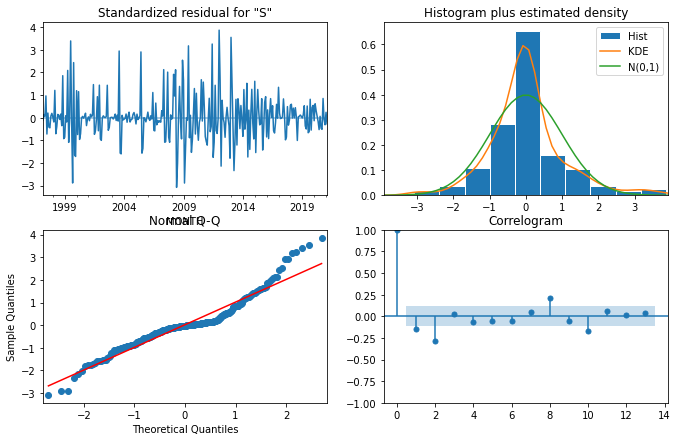

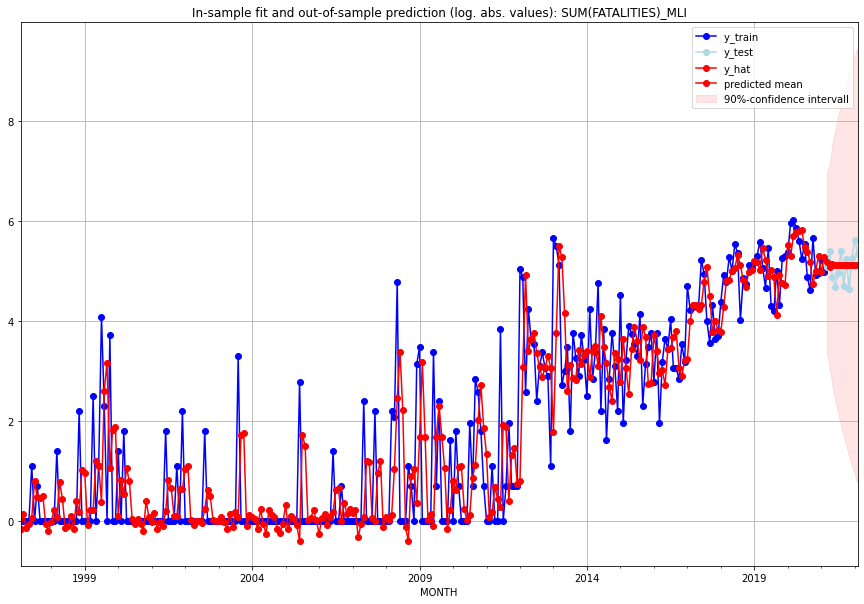

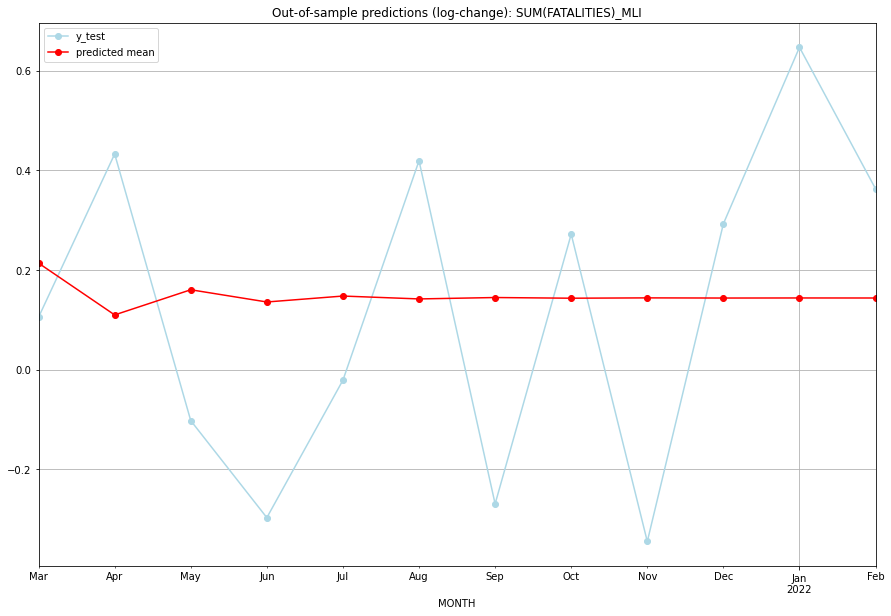

TADDA: 0.35071278424242497
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  177.319444       159.0      0.213763        0.105361   MLI   
1  2021-04-01  159.726294       221.0      0.109890        0.432864   MLI   
2  2021-05-01  168.047219       129.0      0.160365       -0.102279   MLI   
3  2021-06-01  163.951375       106.0      0.135837       -0.296984   MLI   
4  2021-07-01  165.929117       140.0      0.147756       -0.021053   MLI   
5  2021-08-01  164.965131       218.0      0.141964        0.419258   MLI   
6  2021-09-01  165.432862       109.0      0.144779       -0.269333   MLI   
7  2021-10-01  165.205414       188.0      0.143411        0.271934   MLI   
8  2021-11-01  165.315899       101.0      0.144076       -0.344840   MLI   
9  2021-12-01  165.262202       192.0      0.143753        0.292877   MLI   
10 2022-01-01  165.288293       274.0      0.143910        0.646958   MLI   
11 2022-02-01  165.275614   

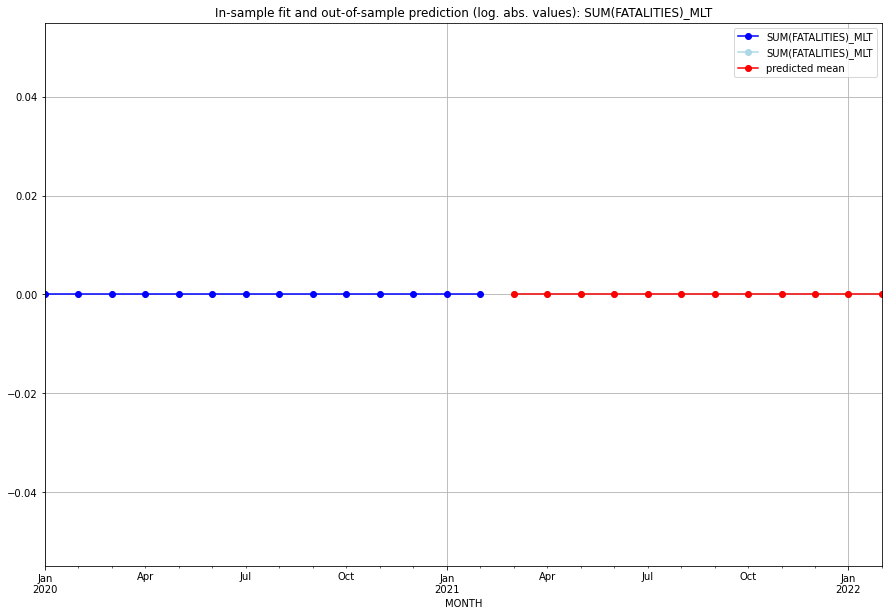

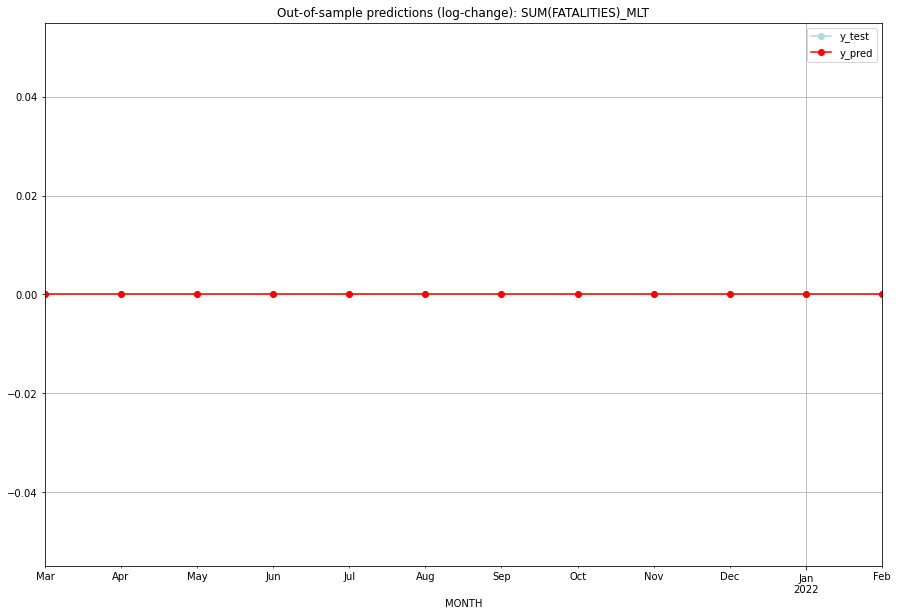

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MLT   
1  2021-04-01       0.0         0.0           0.0             0.0   MLT   
2  2021-05-01       0.0         0.0           0.0             0.0   MLT   
3  2021-06-01       0.0         0.0           0.0             0.0   MLT   
4  2021-07-01       0.0         0.0           0.0             0.0   MLT   
5  2021-08-01       0.0         0.0           0.0             0.0   MLT   
6  2021-09-01       0.0         0.0           0.0             0.0   MLT   
7  2021-10-01       0.0         0.0           0.0             0.0   MLT   
8  2021-11-01       0.0         0.0           0.0             0.0   MLT   
9  2021-12-01       0.0         0.0           0.0             0.0   MLT   
10 2022-01-01       0.0         0.0           0.0             0.0   MLT   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.9234454769390563, 'fold_results': [0.9050028390805833, 1.1930793015248335, 0.7865530620171114, 0.7059922162639228, 1.02659996580883]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MMR   No. Observations:                  134
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -204.376
Date:                 Wed, 19 Oct 2022   AIC                            410.753
Time:                         10:55:45   BIC                            413.643
Sample:                     01-31-2010   HQIC                           411.927
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------

<Figure size 432x288 with 0 Axes>

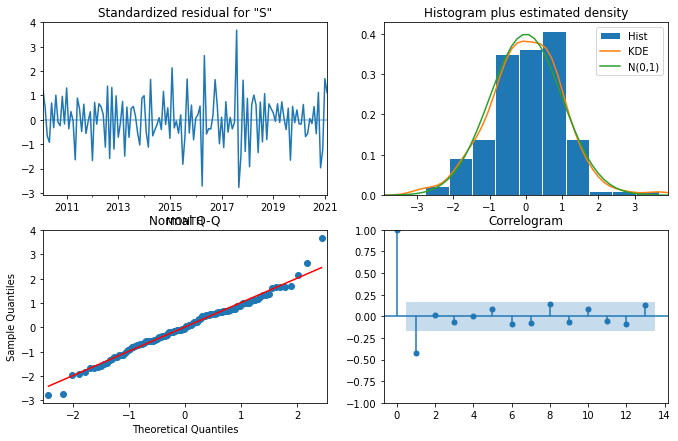

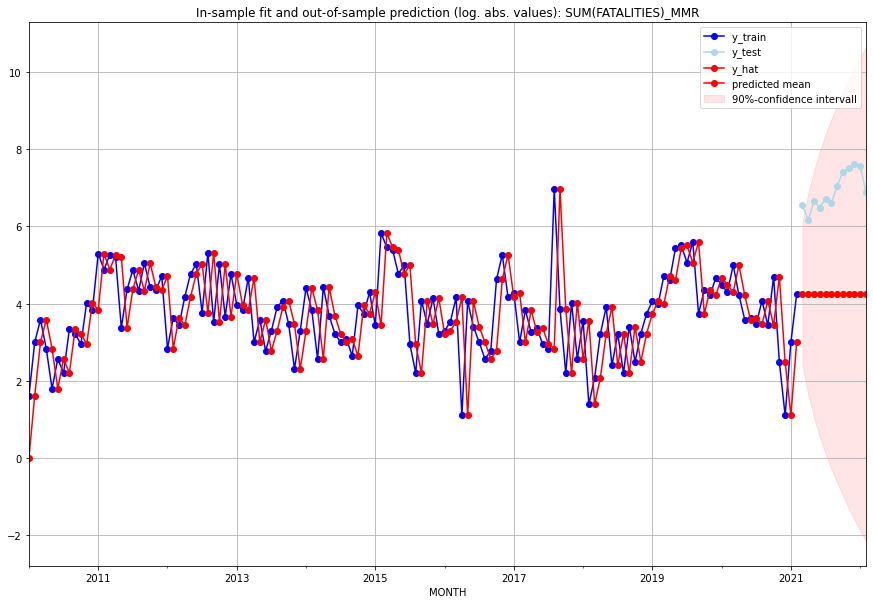

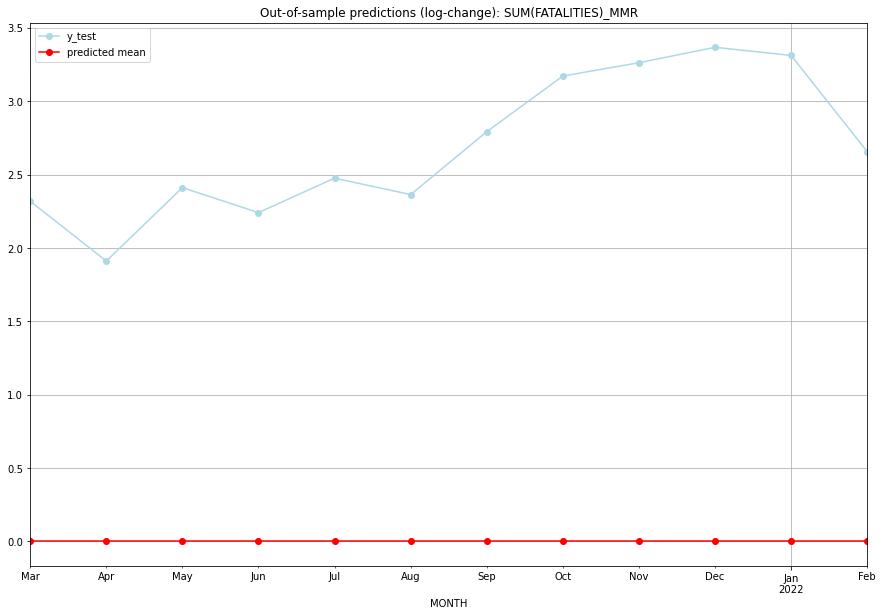

TADDA: 2.6898895287240205
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      69.0       710.0           0.0        2.318177   MMR   
1  2021-04-01      69.0       472.0           0.0        1.910600   MMR   
2  2021-05-01      69.0       779.0           0.0        2.410799   MMR   
3  2021-06-01      69.0       657.0           0.0        2.240710   MMR   
4  2021-07-01      69.0       831.0           0.0        2.475337   MMR   
5  2021-08-01      69.0       743.0           0.0        2.363546   MMR   
6  2021-09-01      69.0      1141.0           0.0        2.792041   MMR   
7  2021-10-01      69.0      1667.0           0.0        3.170885   MMR   
8  2021-11-01      69.0      1826.0           0.0        3.261935   MMR   
9  2021-12-01      69.0      2028.0           0.0        3.366803   MMR   
10 2022-01-01      69.0      1919.0           0.0        3.311585   MMR   
11 2022-02-01      69.0       996.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MNE   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  15.952
Date:                 Wed, 19 Oct 2022   AIC                            -29.904
Time:                         10:56:02   BIC                            -28.267
Sample:                     01-31-2018   HQIC                           -29.322
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0253      0.002     13.077      0.000       0.021       0

<Figure size 432x288 with 0 Axes>

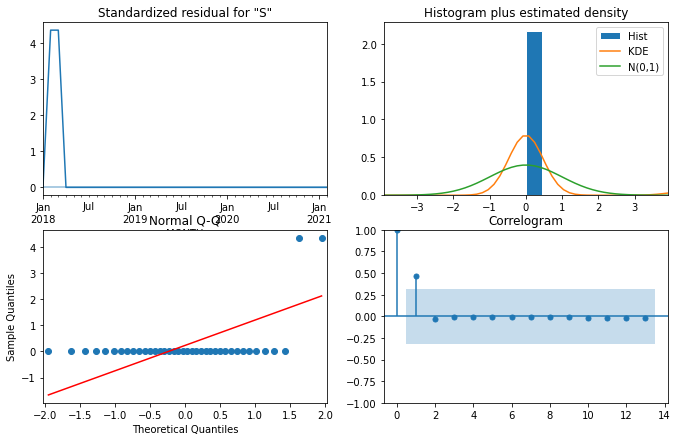

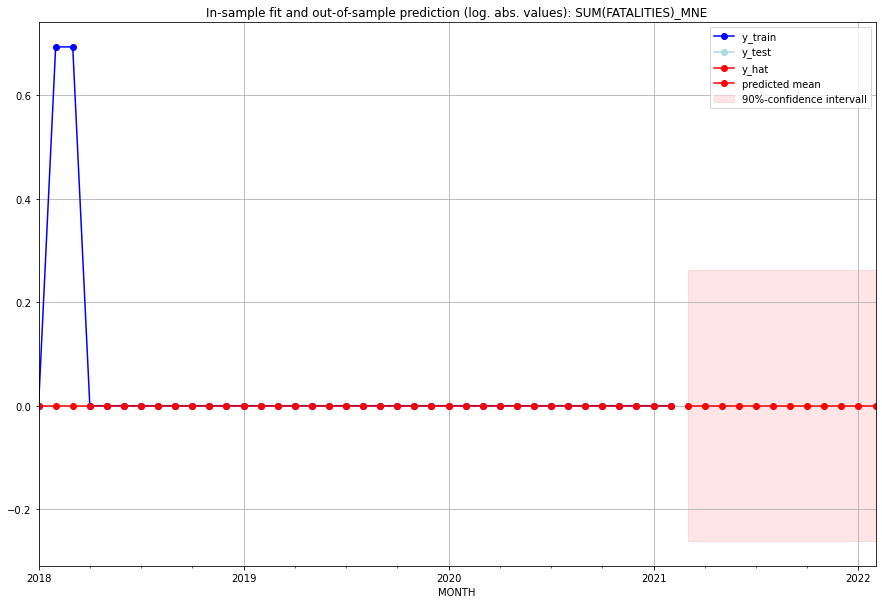

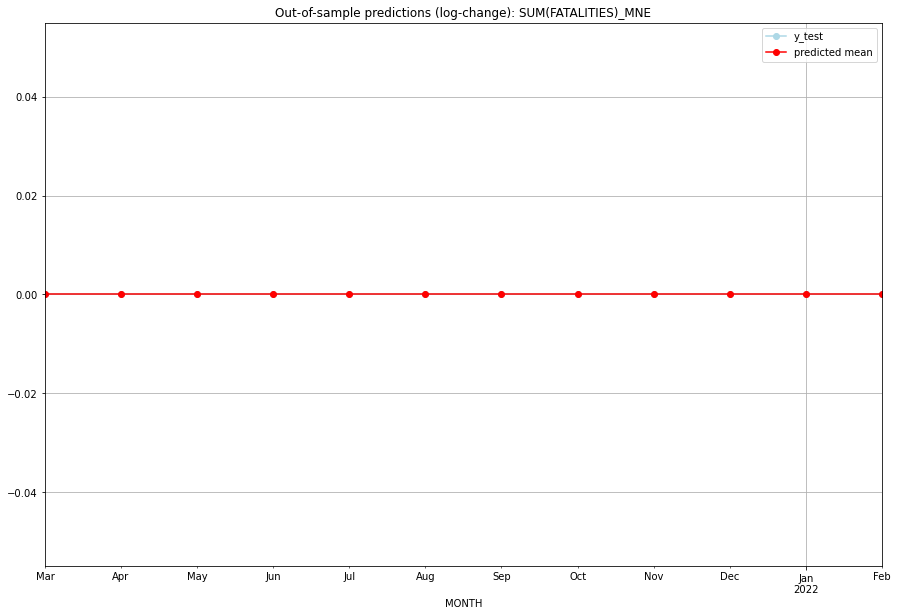

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MNE   
1  2021-04-01       0.0         0.0           0.0             0.0   MNE   
2  2021-05-01       0.0         0.0           0.0             0.0   MNE   
3  2021-06-01       0.0         0.0           0.0             0.0   MNE   
4  2021-07-01       0.0         0.0           0.0             0.0   MNE   
5  2021-08-01       0.0         0.0           0.0             0.0   MNE   
6  2021-09-01       0.0         0.0           0.0             0.0   MNE   
7  2021-10-01       0.0         0.0           0.0             0.0   MNE   
8  2021-11-01       0.0         0.0           0.0             0.0   MNE   
9  2021-12-01       0.0         0.0           0.0             0.0   MNE   
10 2022-01-01       0.0         0.0           0.0             0.0   MNE   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MNG   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  29.122
Date:                 Wed, 19 Oct 2022   AIC                            -56.244
Time:                         10:56:18   BIC                            -54.606
Sample:                     01-31-2018   HQIC                           -55.661
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0126      0.001     18.748      0.000       0.011       0

<Figure size 432x288 with 0 Axes>

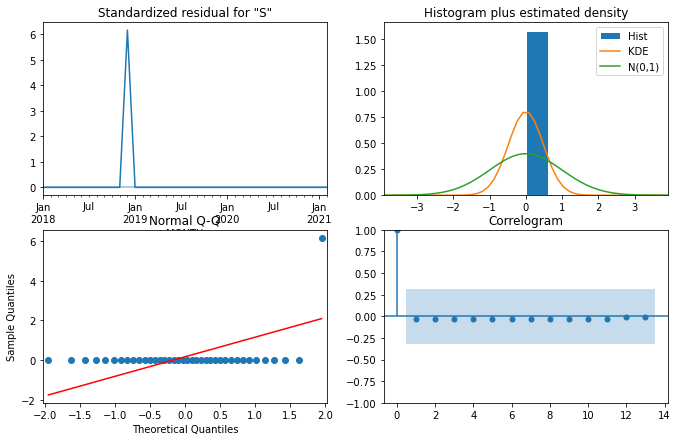

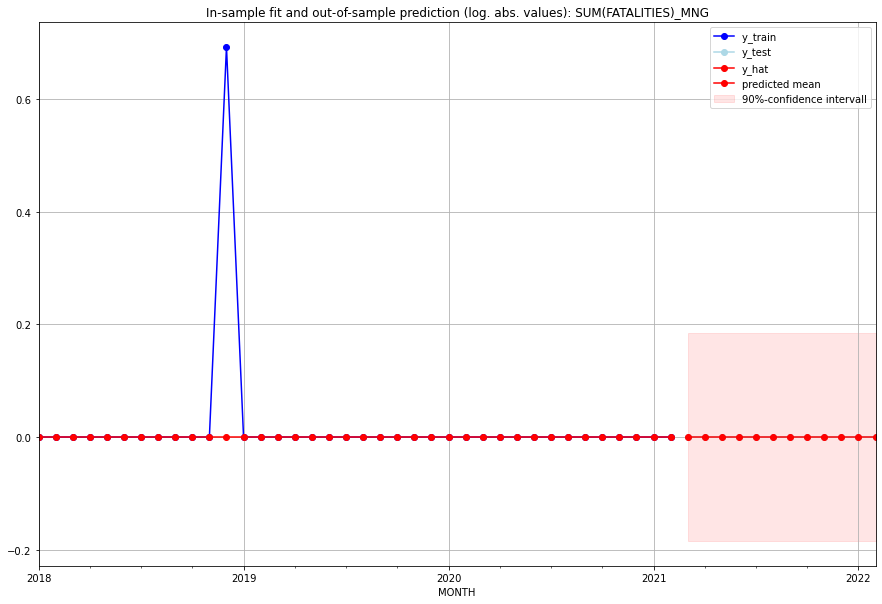

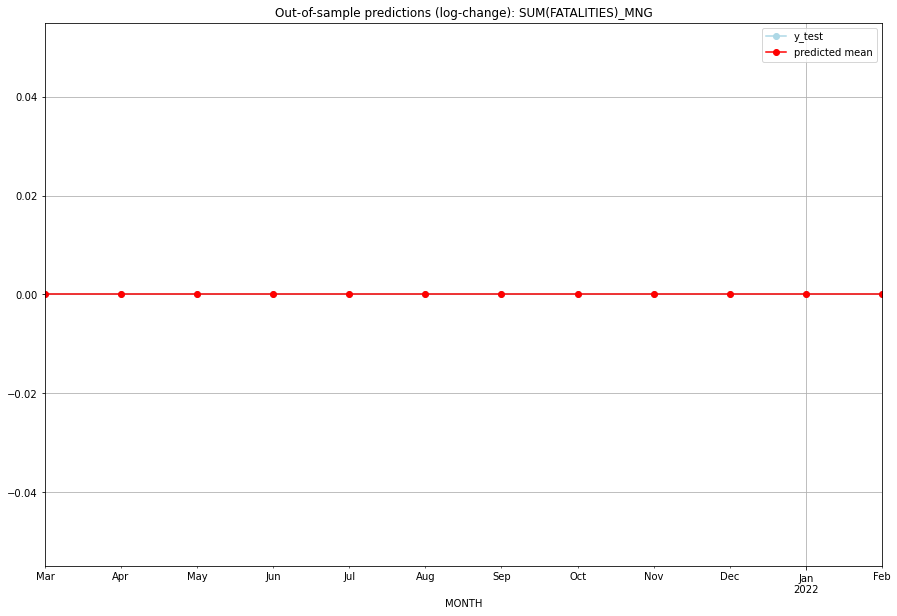

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MNG   
1  2021-04-01       0.0         0.0           0.0             0.0   MNG   
2  2021-05-01       0.0         0.0           0.0             0.0   MNG   
3  2021-06-01       0.0         0.0           0.0             0.0   MNG   
4  2021-07-01       0.0         0.0           0.0             0.0   MNG   
5  2021-08-01       0.0         0.0           0.0             0.0   MNG   
6  2021-09-01       0.0         0.0           0.0             0.0   MNG   
7  2021-10-01       0.0         0.0           0.0             0.0   MNG   
8  2021-11-01       0.0         0.0           0.0             0.0   MNG   
9  2021-12-01       0.0         0.0           0.0             0.0   MNG   
10 2022-01-01       0.0         0.0           0.0             0.0   MNG   
11 2022-02-01       0.0         0.0           0.0             0.0   

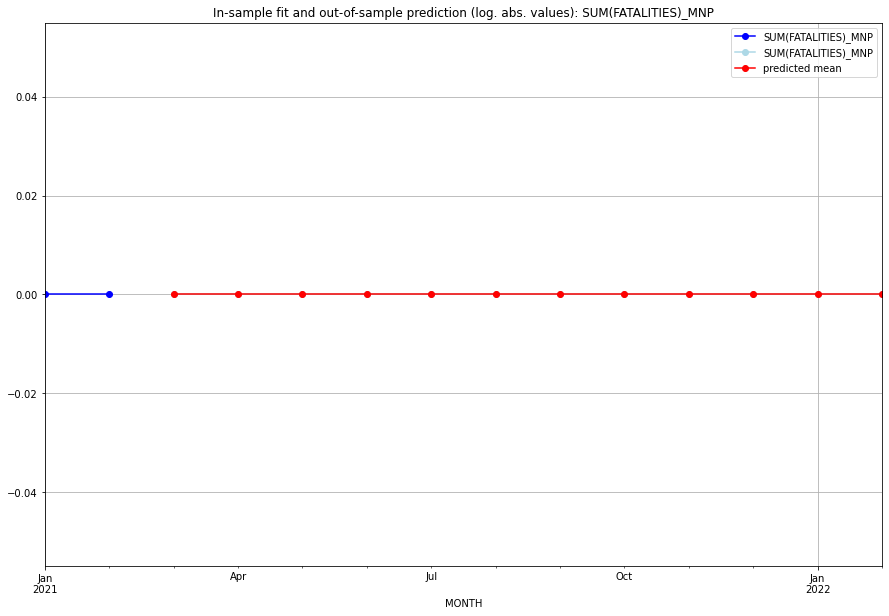

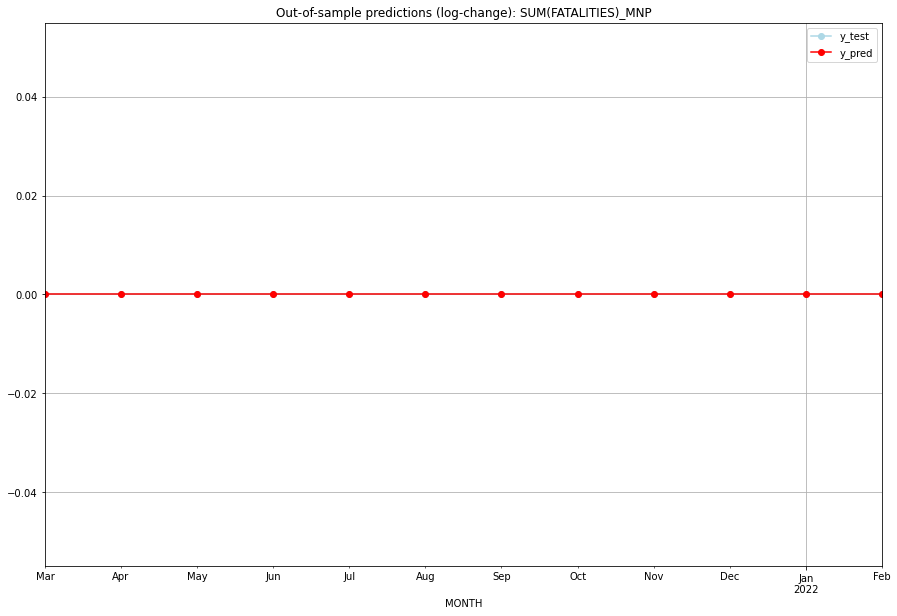

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MNP   
1  2021-04-01       0.0         0.0           0.0             0.0   MNP   
2  2021-05-01       0.0         0.0           0.0             0.0   MNP   
3  2021-06-01       0.0         0.0           0.0             0.0   MNP   
4  2021-07-01       0.0         0.0           0.0             0.0   MNP   
5  2021-08-01       0.0         0.0           0.0             0.0   MNP   
6  2021-09-01       0.0         0.0           0.0             0.0   MNP   
7  2021-10-01       0.0         0.0           0.0             0.0   MNP   
8  2021-11-01       0.0         0.0           0.0             0.0   MNP   
9  2021-12-01       0.0         0.0           0.0             0.0   MNP   
10 2022-01-01       0.0         0.0           0.0             0.0   MNP   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.7742585088447522, 'fold_results': [0.9449691432819649, 0.40574654189287834, 0.872119398376325, 0.8250088365655807, 0.8234486241070121]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MOZ   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -346.386
Date:                 Wed, 19 Oct 2022   AIC                            700.772
Time:                         10:56:59   BIC                            715.424
Sample:                     02-28-1997   HQIC                           706.644
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

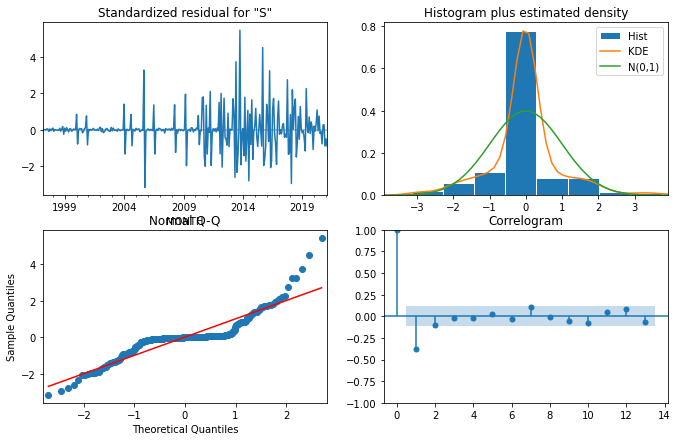

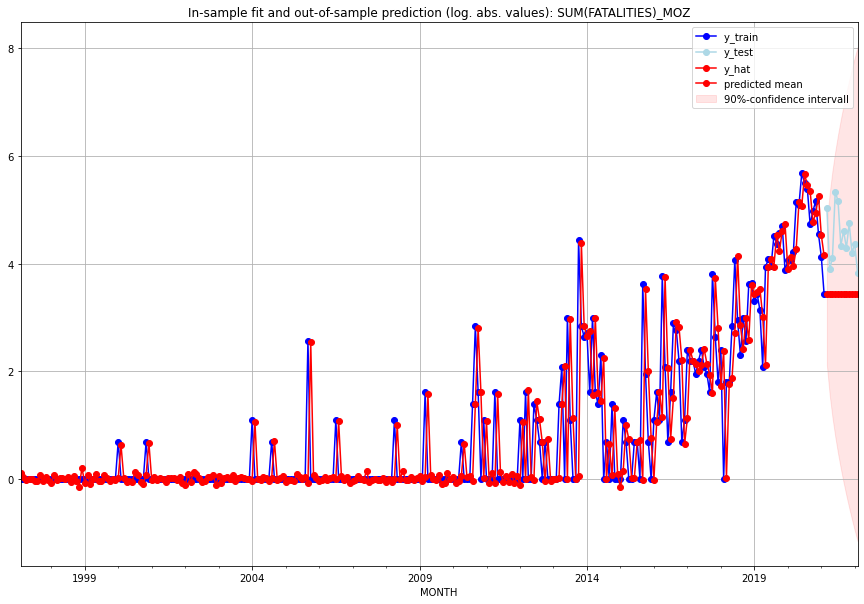

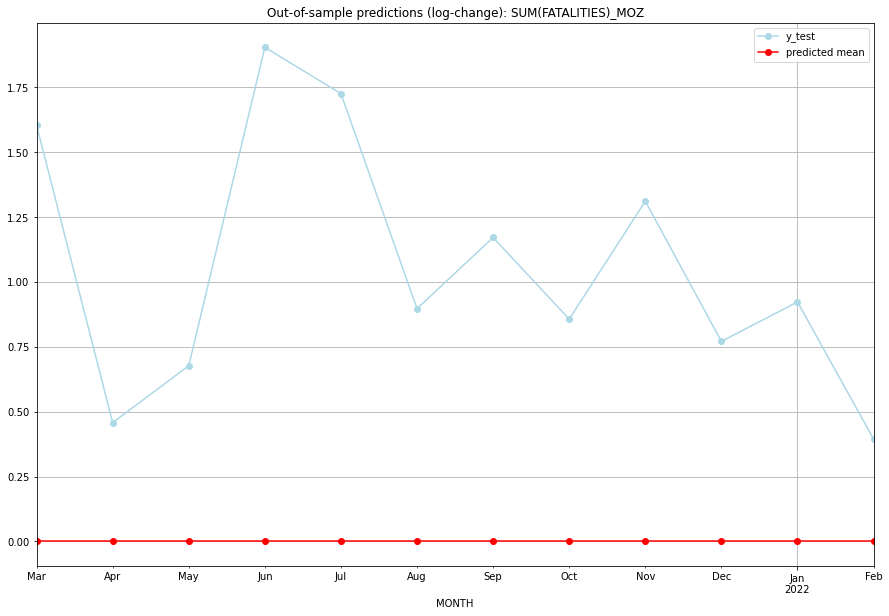

TADDA: 1.0574776356789486
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      30.0       153.0 -4.440892e-16        1.602965   MOZ   
1  2021-04-01      30.0        48.0 -4.440892e-16        0.457833   MOZ   
2  2021-05-01      30.0        60.0 -4.440892e-16        0.676887   MOZ   
3  2021-06-01      30.0       207.0 -4.440892e-16        1.903551   MOZ   
4  2021-07-01      30.0       173.0 -4.440892e-16        1.725068   MOZ   
5  2021-08-01      30.0        75.0 -4.440892e-16        0.896746   MOZ   
6  2021-09-01      30.0        99.0 -4.440892e-16        1.171183   MOZ   
7  2021-10-01      30.0        72.0 -4.440892e-16        0.856472   MOZ   
8  2021-11-01      30.0       114.0 -4.440892e-16        1.310945   MOZ   
9  2021-12-01      30.0        66.0 -4.440892e-16        0.770705   MOZ   
10 2022-01-01      30.0        77.0 -4.440892e-16        0.922722   MOZ   
11 2022-02-01      30.0        45.0 -4.440892e-16    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.14255553730053516, 'fold_results': [0.0, 0.09155102405567582, 0.1493132891023379, 0.1493132891023379, 0.3226000842423242]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MRT   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -214.031
Date:                 Wed, 19 Oct 2022   AIC                            430.061
Time:                         10:57:29   BIC                            433.728
Sample:                     02-28-1997   HQIC                           431.530
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

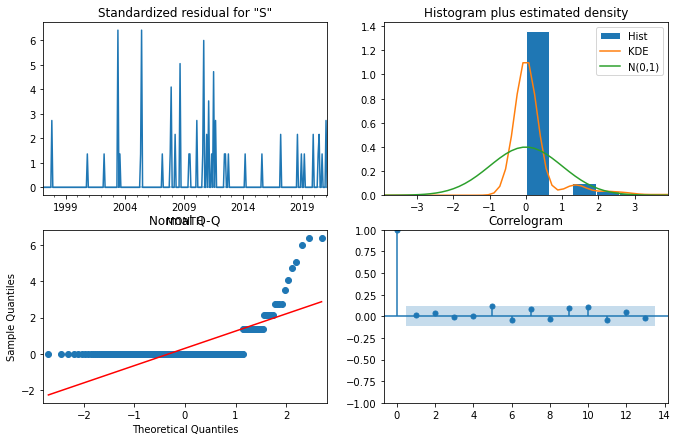

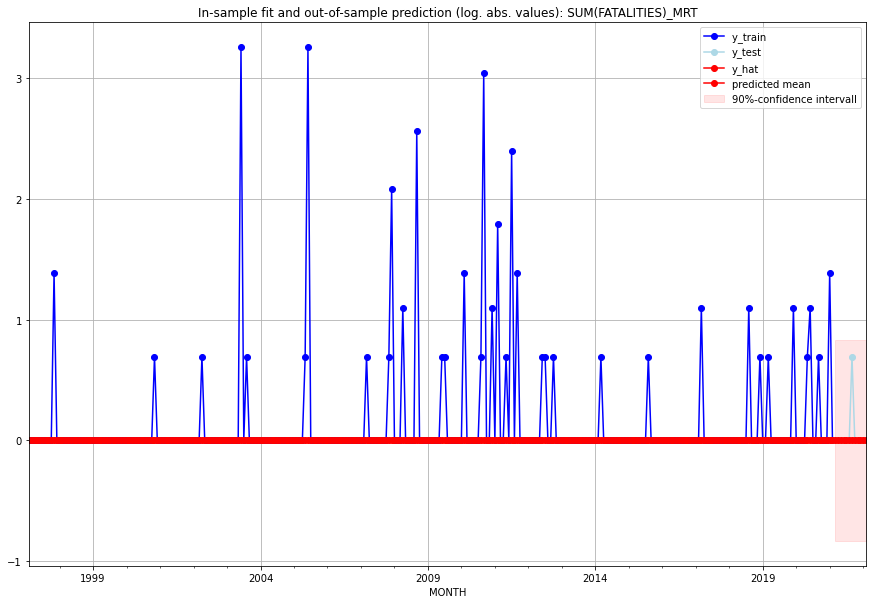

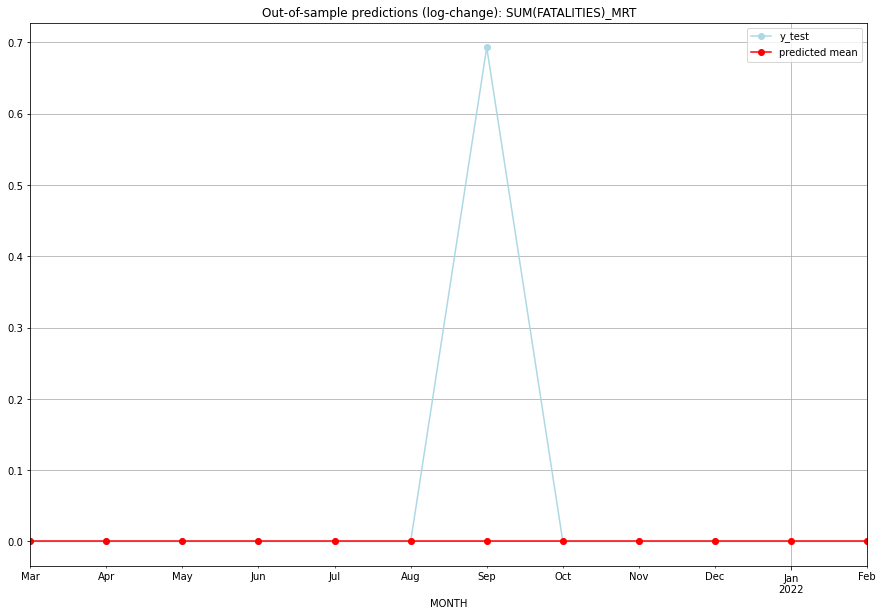

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   MRT   
1  2021-04-01       0.0         0.0           0.0        0.000000   MRT   
2  2021-05-01       0.0         0.0           0.0        0.000000   MRT   
3  2021-06-01       0.0         0.0           0.0        0.000000   MRT   
4  2021-07-01       0.0         0.0           0.0        0.000000   MRT   
5  2021-08-01       0.0         0.0           0.0        0.000000   MRT   
6  2021-09-01       0.0         1.0           0.0        0.693147   MRT   
7  2021-10-01       0.0         0.0           0.0        0.000000   MRT   
8  2021-11-01       0.0         0.0           0.0        0.000000   MRT   
9  2021-12-01       0.0         0.0           0.0        0.000000   MRT   
10 2022-01-01       0.0         0.0           0.0        0.000000   MRT   
11 2022-02-01       0.0         0.0           0.0  

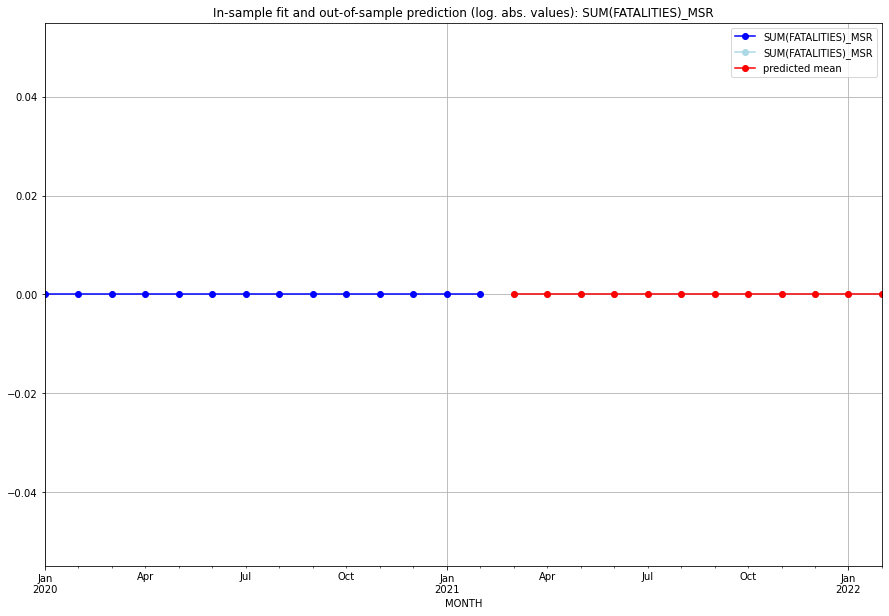

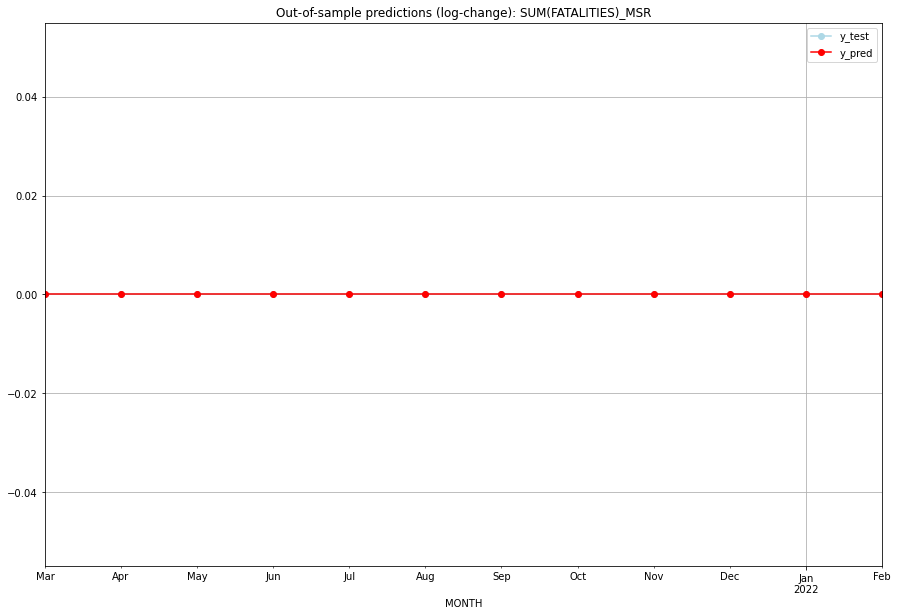

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MSR   
1  2021-04-01       0.0         0.0           0.0             0.0   MSR   
2  2021-05-01       0.0         0.0           0.0             0.0   MSR   
3  2021-06-01       0.0         0.0           0.0             0.0   MSR   
4  2021-07-01       0.0         0.0           0.0             0.0   MSR   
5  2021-08-01       0.0         0.0           0.0             0.0   MSR   
6  2021-09-01       0.0         0.0           0.0             0.0   MSR   
7  2021-10-01       0.0         0.0           0.0             0.0   MSR   
8  2021-11-01       0.0         0.0           0.0             0.0   MSR   
9  2021-12-01       0.0         0.0           0.0             0.0   MSR   
10 2022-01-01       0.0         0.0           0.0             0.0   MSR   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

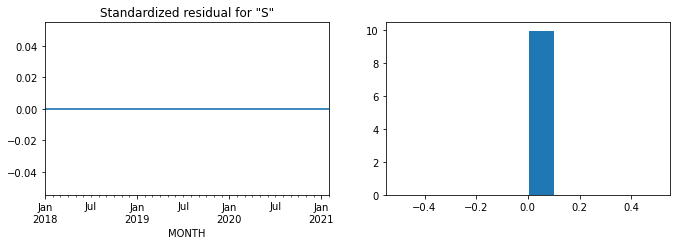

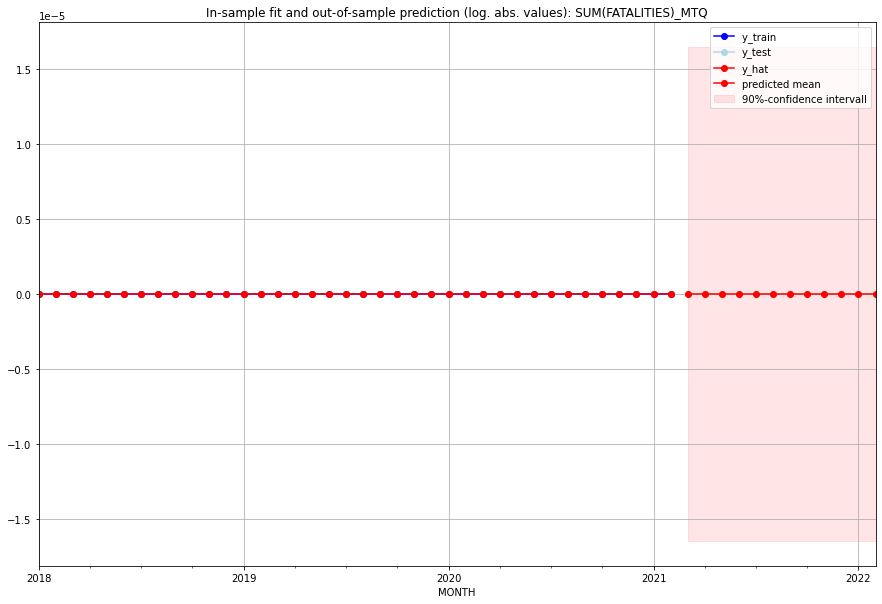

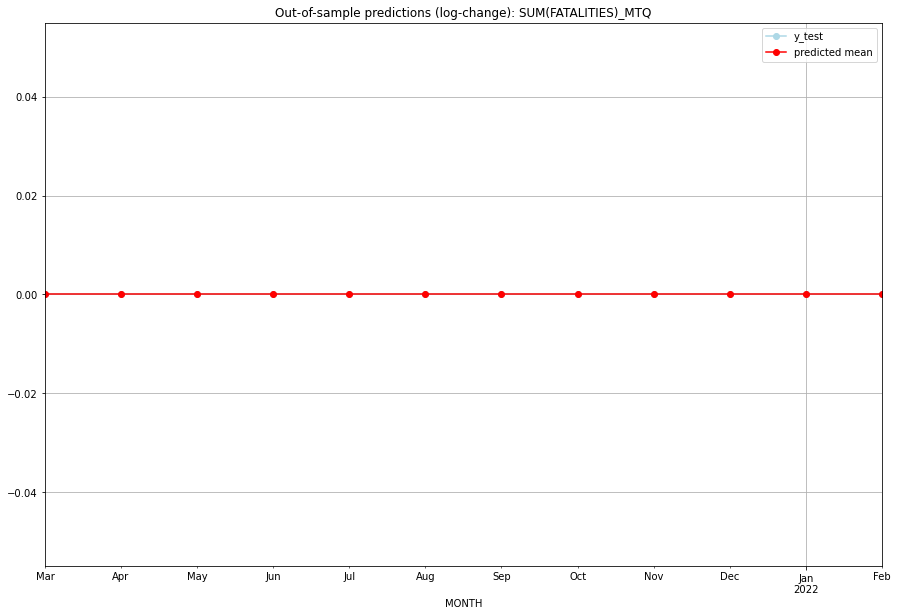

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   MTQ   
1  2021-04-01       0.0         0.0           0.0             0.0   MTQ   
2  2021-05-01       0.0         0.0           0.0             0.0   MTQ   
3  2021-06-01       0.0         0.0           0.0             0.0   MTQ   
4  2021-07-01       0.0         0.0           0.0             0.0   MTQ   
5  2021-08-01       0.0         0.0           0.0             0.0   MTQ   
6  2021-09-01       0.0         0.0           0.0             0.0   MTQ   
7  2021-10-01       0.0         0.0           0.0             0.0   MTQ   
8  2021-11-01       0.0         0.0           0.0             0.0   MTQ   
9  2021-12-01       0.0         0.0           0.0             0.0   MTQ   
10 2022-01-01       0.0         0.0           0.0             0.0   MTQ   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.03465735902799726, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MUS   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                 355.898
Date:                 Wed, 19 Oct 2022   AIC                           -709.796
Time:                         10:58:00   BIC                           -706.130
Sample:                     02-28-1997   HQIC                          -708.327
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0050   6.0

<Figure size 432x288 with 0 Axes>

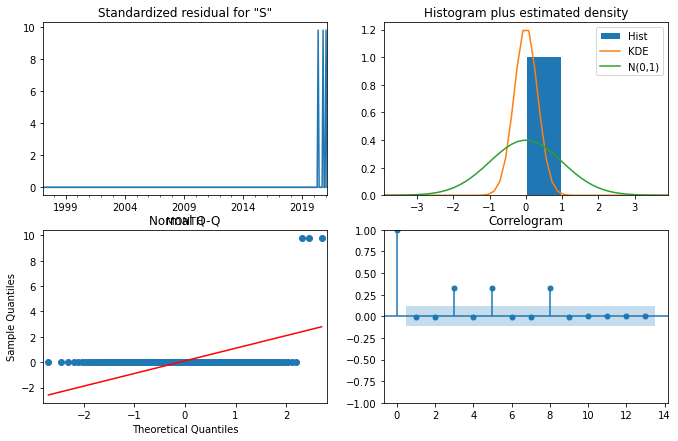

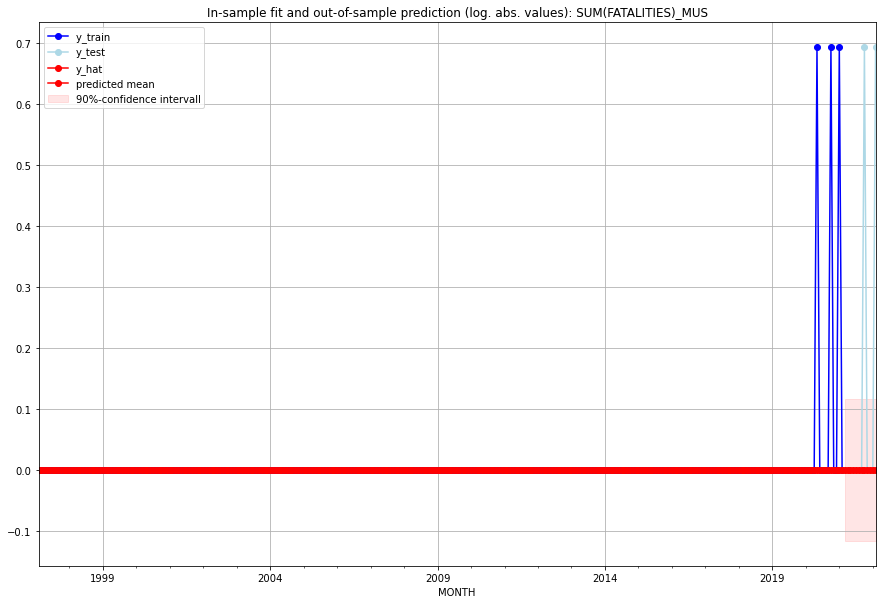

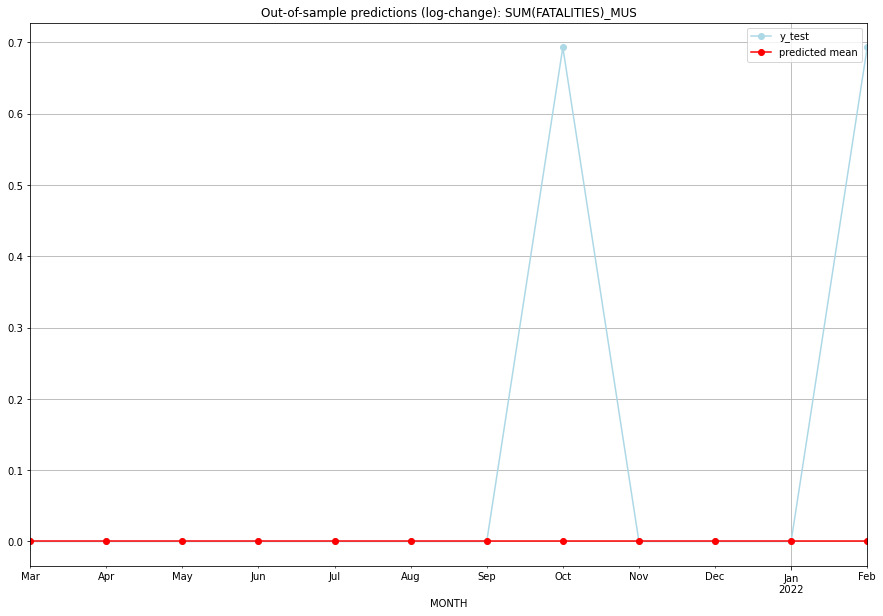

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   MUS   
1  2021-04-01       0.0         0.0           0.0        0.000000   MUS   
2  2021-05-01       0.0         0.0           0.0        0.000000   MUS   
3  2021-06-01       0.0         0.0           0.0        0.000000   MUS   
4  2021-07-01       0.0         0.0           0.0        0.000000   MUS   
5  2021-08-01       0.0         0.0           0.0        0.000000   MUS   
6  2021-09-01       0.0         0.0           0.0        0.000000   MUS   
7  2021-10-01       0.0         1.0           0.0        0.693147   MUS   
8  2021-11-01       0.0         0.0           0.0        0.000000   MUS   
9  2021-12-01       0.0         0.0           0.0        0.000000   MUS   
10 2022-01-01       0.0         0.0           0.0        0.000000   MUS   
11 2022-02-01       0.0         1.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.714314369601227, 'fold_results': [0.8244531013902191, 0.5669361006037191, 0.6357811633260319, 0.6552349503677358, 0.8891665323184289]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MWI   No. Observations:                  289
Model:                SARIMAX(0, 1, 1)   Log Likelihood                -190.440
Date:                 Wed, 19 Oct 2022   AIC                            384.879
Time:                         10:58:28   BIC                            392.205
Sample:                     02-28-1997   HQIC                           387.815
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

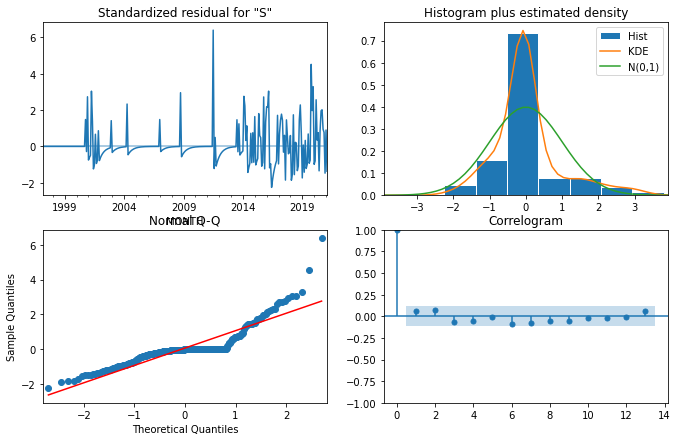

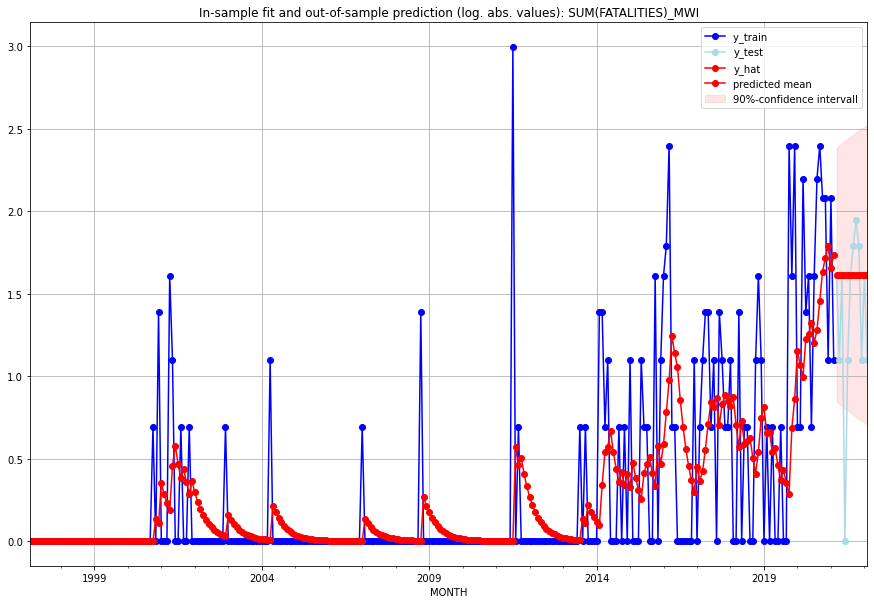

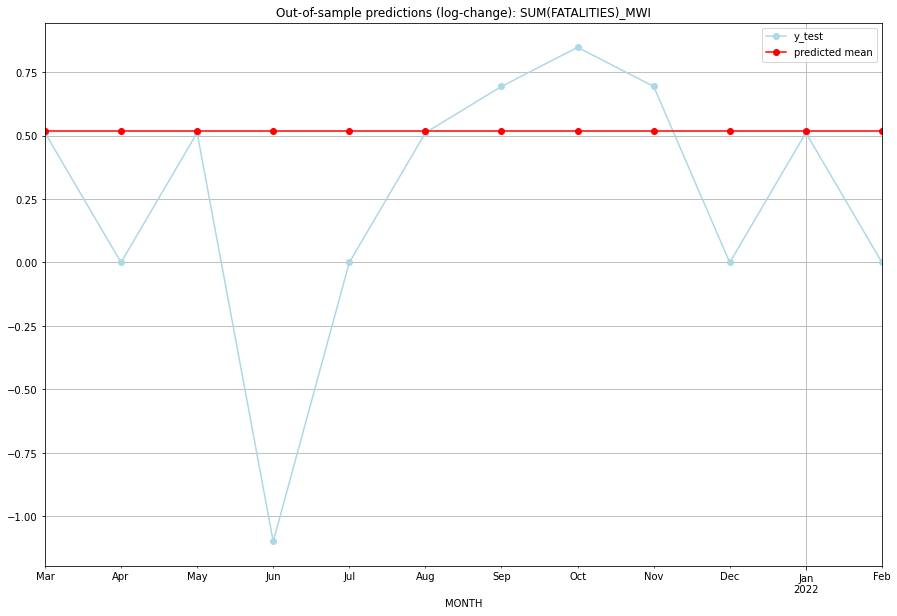

TADDA: 0.40882545649335217
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  4.029533         4.0      0.516715        0.510826   MWI   
1  2021-04-01  4.029533         2.0      0.516715        0.000000   MWI   
2  2021-05-01  4.029533         4.0      0.516715        0.510826   MWI   
3  2021-06-01  4.029533         0.0      0.516715       -1.098612   MWI   
4  2021-07-01  4.029533         2.0      0.516715        0.000000   MWI   
5  2021-08-01  4.029533         4.0      0.516715        0.510826   MWI   
6  2021-09-01  4.029533         5.0      0.516715        0.693147   MWI   
7  2021-10-01  4.029533         6.0      0.516715        0.847298   MWI   
8  2021-11-01  4.029533         5.0      0.516715        0.693147   MWI   
9  2021-12-01  4.029533         2.0      0.516715        0.000000   MWI   
10 2022-01-01  4.029533         4.0      0.516715        0.510826   MWI   
11 2022-02-01  4.029533         2.0      0.516715   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.2990487751466858, 'fold_results': [0.4248107551533853, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_MYS   No. Observations:                   38
Model:                SARIMAX(0, 0, 2)   Log Likelihood                 -29.084
Date:                 Wed, 19 Oct 2022   AIC                             64.168
Time:                         10:58:40   BIC                             69.081
Sample:                     01-31-2018   HQIC                            65.916
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.5066      0

<Figure size 432x288 with 0 Axes>

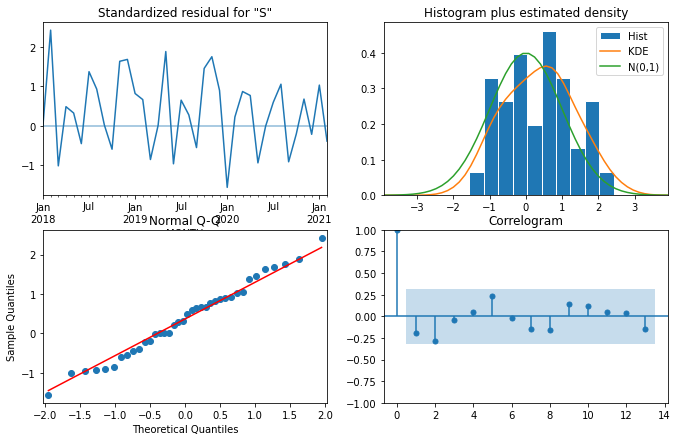

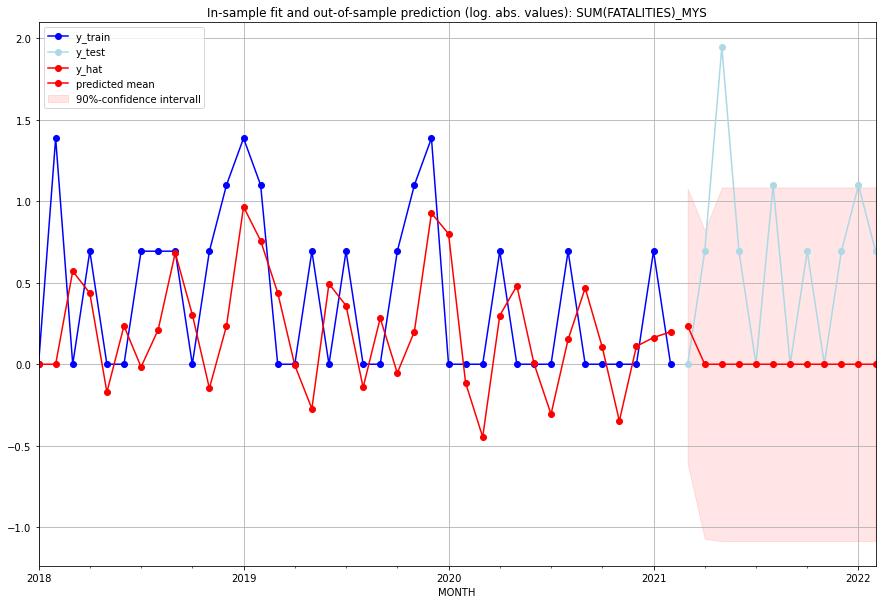

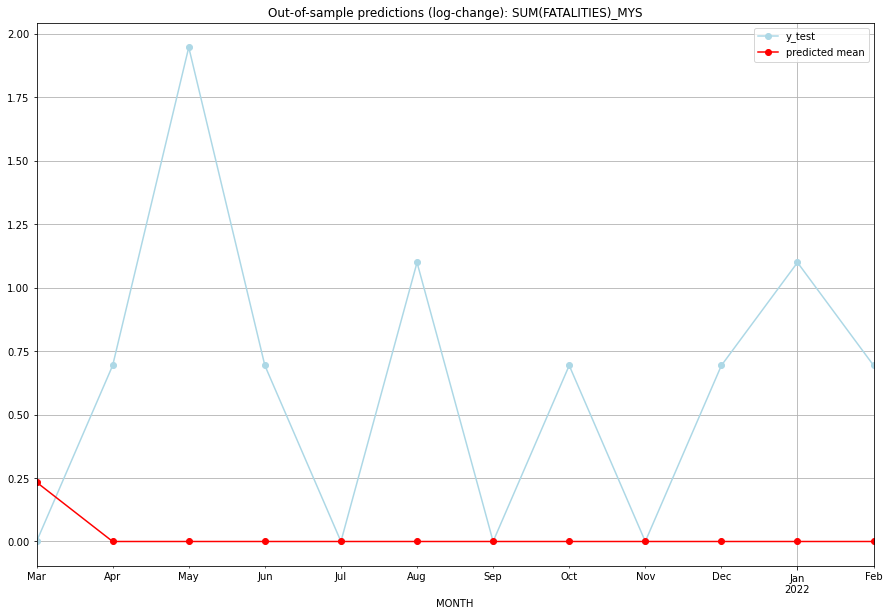

TADDA: 0.6535183881002025
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.262823         0.0       0.23335        0.000000   MYS   
1  2021-04-01  0.000000         1.0       0.00000        0.693147   MYS   
2  2021-05-01  0.000000         6.0       0.00000        1.945910   MYS   
3  2021-06-01  0.000000         1.0       0.00000        0.693147   MYS   
4  2021-07-01  0.000000         0.0       0.00000        0.000000   MYS   
5  2021-08-01  0.000000         2.0       0.00000        1.098612   MYS   
6  2021-09-01  0.000000         0.0       0.00000        0.000000   MYS   
7  2021-10-01  0.000000         1.0       0.00000        0.693147   MYS   
8  2021-11-01  0.000000         0.0       0.00000        0.000000   MYS   
9  2021-12-01  0.000000         1.0       0.00000        0.693147   MYS   
10 2022-01-01  0.000000         2.0       0.00000        1.098612   MYS   
11 2022-02-01  0.000000         1.0       0.00000    

<Figure size 432x288 with 0 Axes>

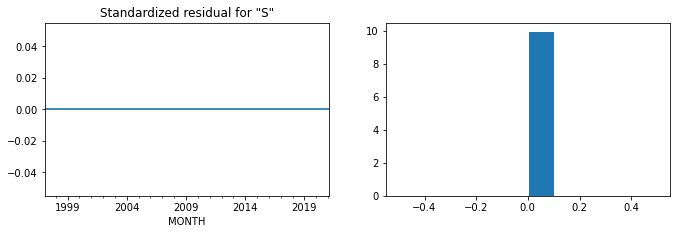

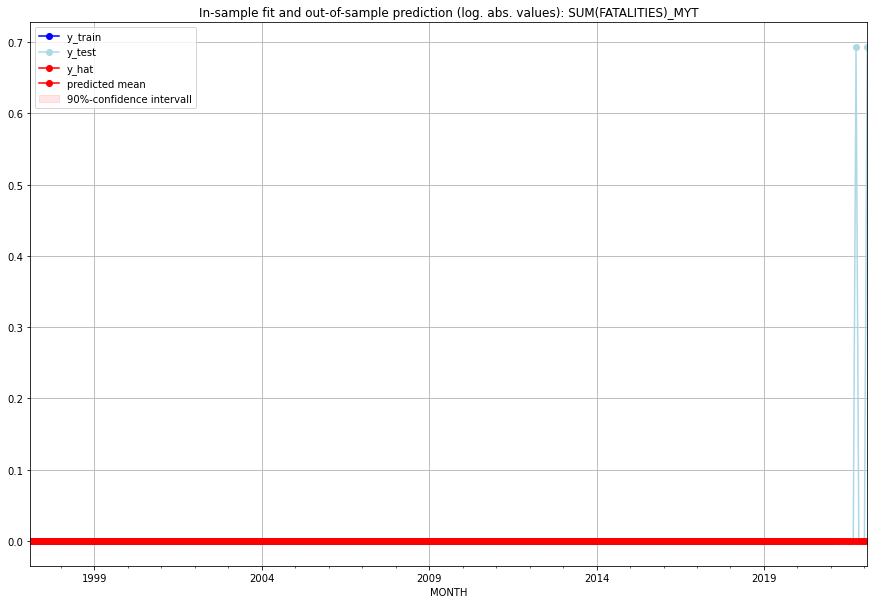

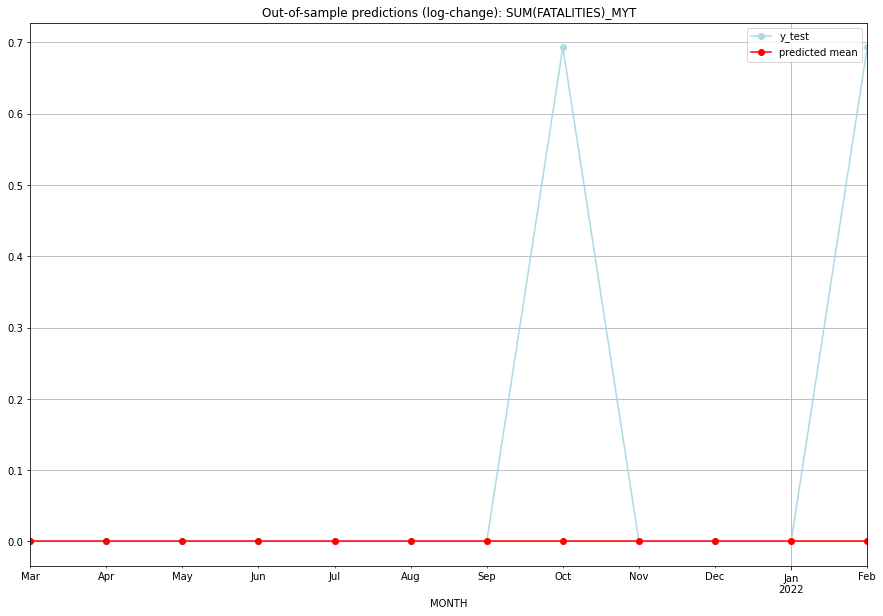

TADDA: 0.11552453009332421
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   MYT   
1  2021-04-01       0.0         0.0           0.0        0.000000   MYT   
2  2021-05-01       0.0         0.0           0.0        0.000000   MYT   
3  2021-06-01       0.0         0.0           0.0        0.000000   MYT   
4  2021-07-01       0.0         0.0           0.0        0.000000   MYT   
5  2021-08-01       0.0         0.0           0.0        0.000000   MYT   
6  2021-09-01       0.0         0.0           0.0        0.000000   MYT   
7  2021-10-01       0.0         1.0           0.0        0.693147   MYT   
8  2021-11-01       0.0         0.0           0.0        0.000000   MYT   
9  2021-12-01       0.0         0.0           0.0        0.000000   MYT   
10 2022-01-01       0.0         0.0           0.0        0.000000   MYT   
11 2022-02-01       0.0         1.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.07600752272352058, 'fold_results': [0.0, 0.11519979442194077, 0.057762265046662105, 0.20707555414900003, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NAM   No. Observations:                  289
Model:                SARIMAX(0, 0, 3)   Log Likelihood                -215.465
Date:                 Wed, 19 Oct 2022   AIC                            444.930
Time:                         10:59:27   BIC                            470.595
Sample:                     02-28-1997   HQIC                           455.214
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

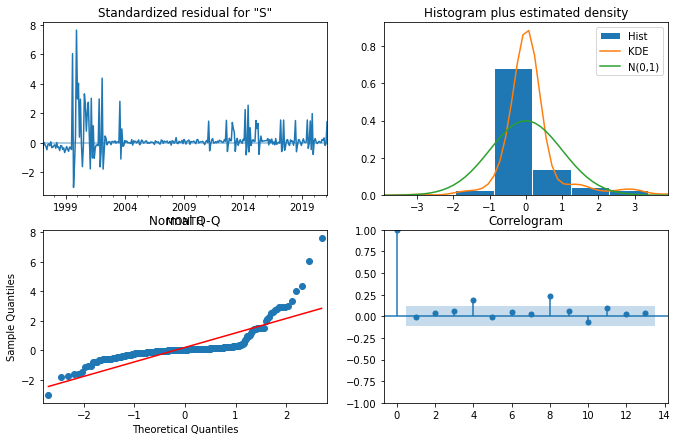

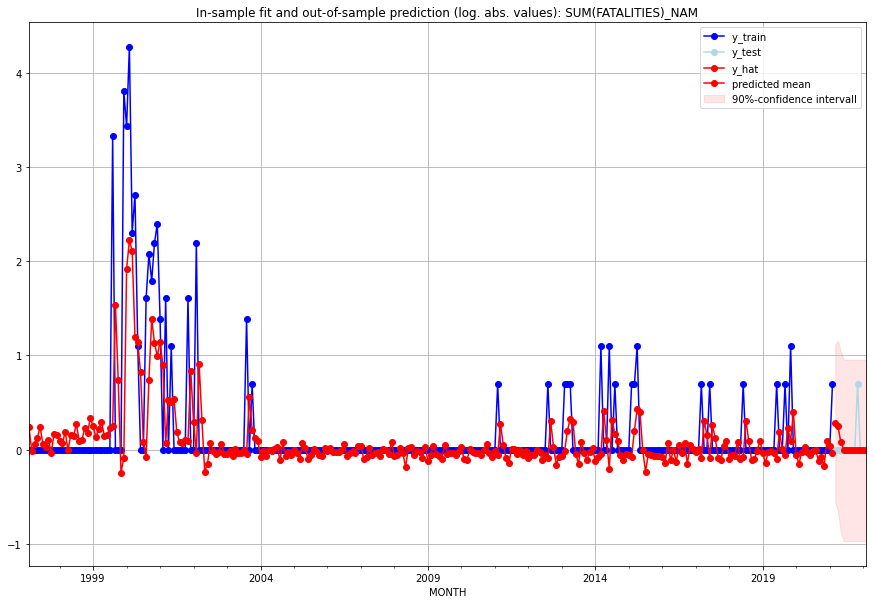

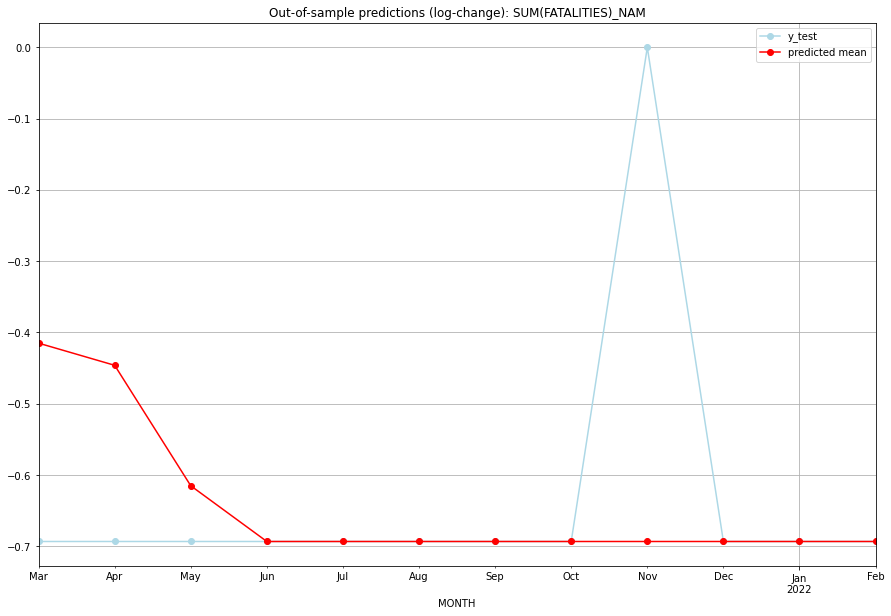

TADDA: 0.10804986246464358
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.320733         0.0     -0.414960       -0.693147   NAM   
1  2021-04-01  0.280330         0.0     -0.446029       -0.693147   NAM   
2  2021-05-01  0.081281         0.0     -0.615001       -0.693147   NAM   
3  2021-06-01  0.000000         0.0     -0.693147       -0.693147   NAM   
4  2021-07-01  0.000000         0.0     -0.693147       -0.693147   NAM   
5  2021-08-01  0.000000         0.0     -0.693147       -0.693147   NAM   
6  2021-09-01  0.000000         0.0     -0.693147       -0.693147   NAM   
7  2021-10-01  0.000000         0.0     -0.693147       -0.693147   NAM   
8  2021-11-01  0.000000         1.0     -0.693147        0.000000   NAM   
9  2021-12-01  0.000000         0.0     -0.693147       -0.693147   NAM   
10 2022-01-01  0.000000         0.0     -0.693147       -0.693147   NAM   
11 2022-02-01  0.000000         0.0     -0.693147   

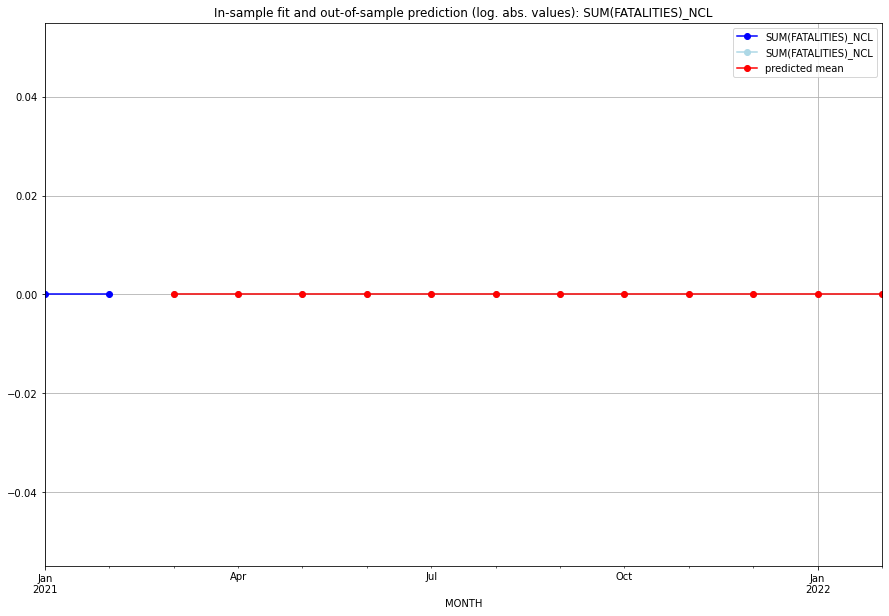

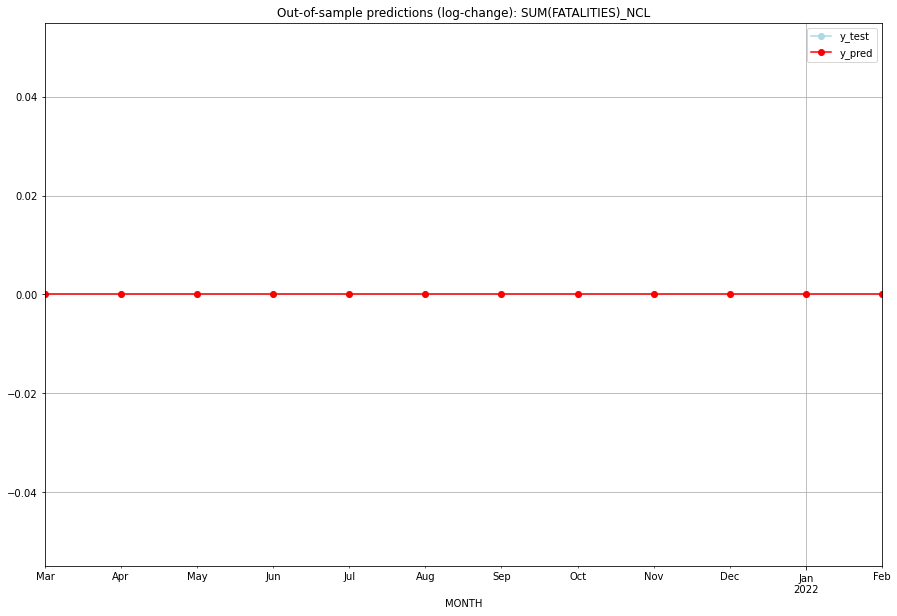

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   NCL   
1  2021-04-01       0.0         0.0           0.0             0.0   NCL   
2  2021-05-01       0.0         0.0           0.0             0.0   NCL   
3  2021-06-01       0.0         0.0           0.0             0.0   NCL   
4  2021-07-01       0.0         0.0           0.0             0.0   NCL   
5  2021-08-01       0.0         0.0           0.0             0.0   NCL   
6  2021-09-01       0.0         0.0           0.0             0.0   NCL   
7  2021-10-01       0.0         0.0           0.0             0.0   NCL   
8  2021-11-01       0.0         0.0           0.0             0.0   NCL   
9  2021-12-01       0.0         0.0           0.0             0.0   NCL   
10 2022-01-01       0.0         0.0           0.0             0.0   NCL   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 1.0146289388718404, 'fold_results': [1.0377297404832628, 1.0603870148981855, 1.177298717169633, 1.0802797469408782, 0.7174494748672425]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NER   No. Observations:                  289
Model:                SARIMAX(3, 1, 1)   Log Likelihood                -427.093
Date:                 Wed, 19 Oct 2022   AIC                            868.187
Time:                         10:59:56   BIC                            893.828
Sample:                     02-28-1997   HQIC                           878.462
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

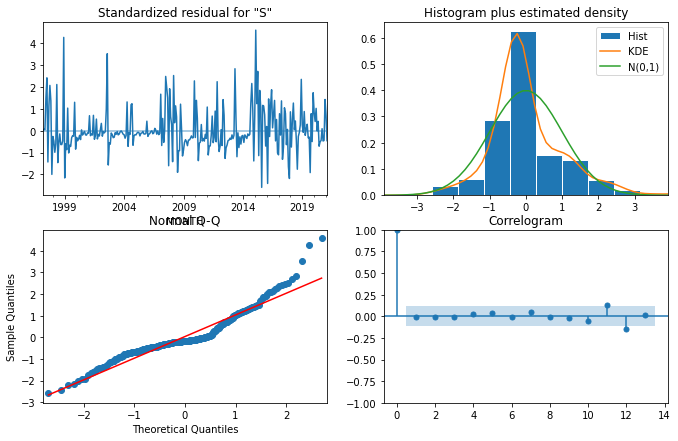

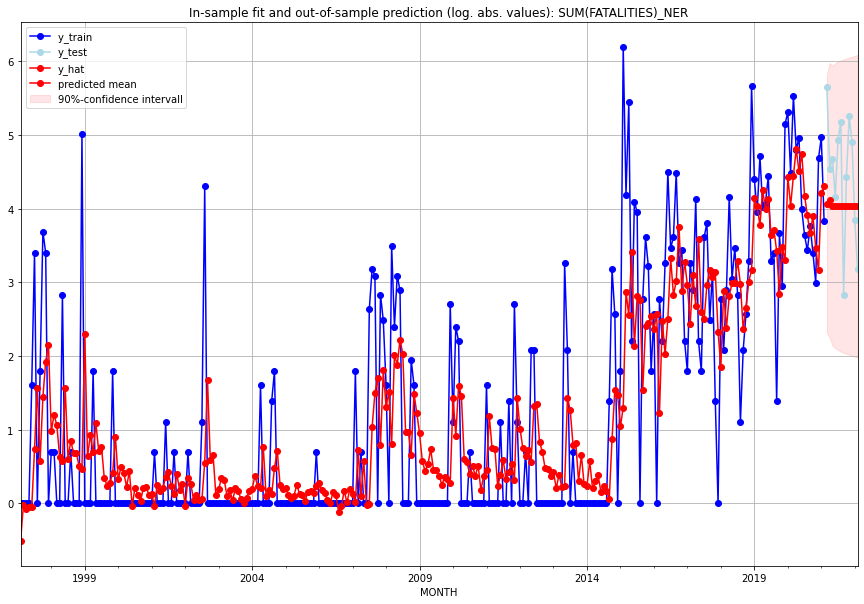

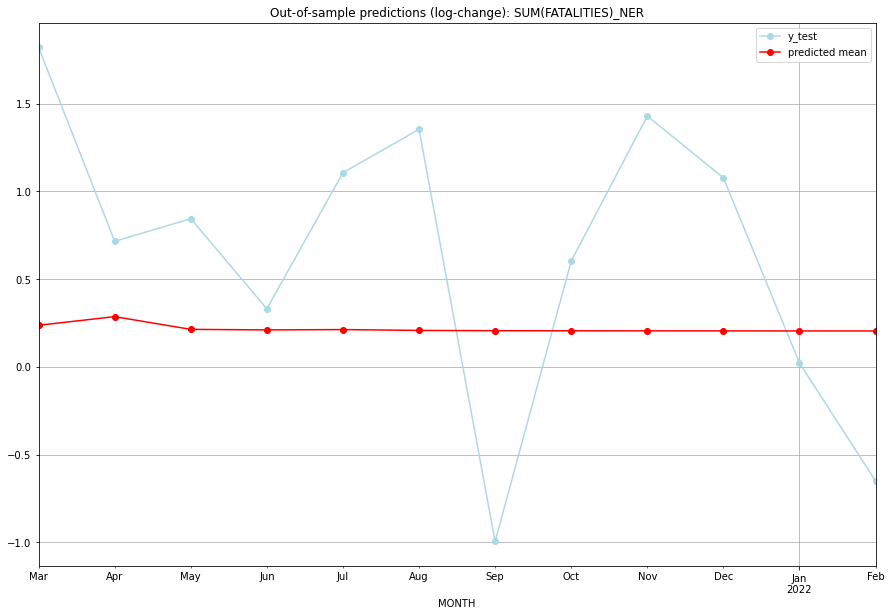

TADDA: 0.8287824579092372
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  57.273699       283.0      0.236509        1.820333   NER   
1  2021-04-01  60.215224        93.0      0.285755        0.714653   NER   
2  2021-05-01  55.936993       106.0      0.213304        0.844187   NER   
3  2021-06-01  55.751923        63.0      0.210048        0.330242   NER   
4  2021-07-01  55.865060       138.0      0.212040        1.105833   NER   
5  2021-08-01  55.592249       177.0      0.207231        1.353142   NER   
6  2021-09-01  55.500020        16.0      0.205600       -0.995428   NER   
7  2021-10-01  55.478725        83.0      0.205223        0.602175   NER   
8  2021-11-01  55.451506       191.0      0.204741        1.428854   NER   
9  2021-12-01  55.436514       134.0      0.204475        1.076633   NER   
10 2022-01-01  55.430285        46.0      0.204365        0.021506   NER   
11 2022-02-01  55.426302        23.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.3997063846307848, 'fold_results': [0.4984453874765094, 0.35947405916741904, 0.24736857468264994, 0.3553581367656415, 0.537885765061704]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NGA   No. Observations:                  289
Model:                SARIMAX(0, 1, 3)   Log Likelihood                -418.155
Date:                 Wed, 19 Oct 2022   AIC                            850.310
Time:                         11:00:34   BIC                            875.951
Sample:                     02-28-1997   HQIC                           860.586
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

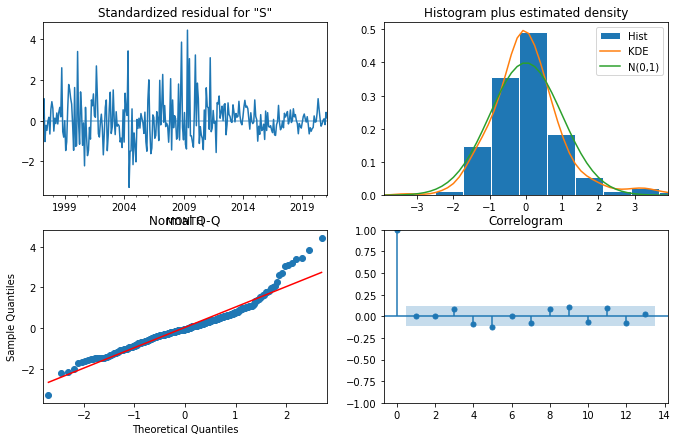

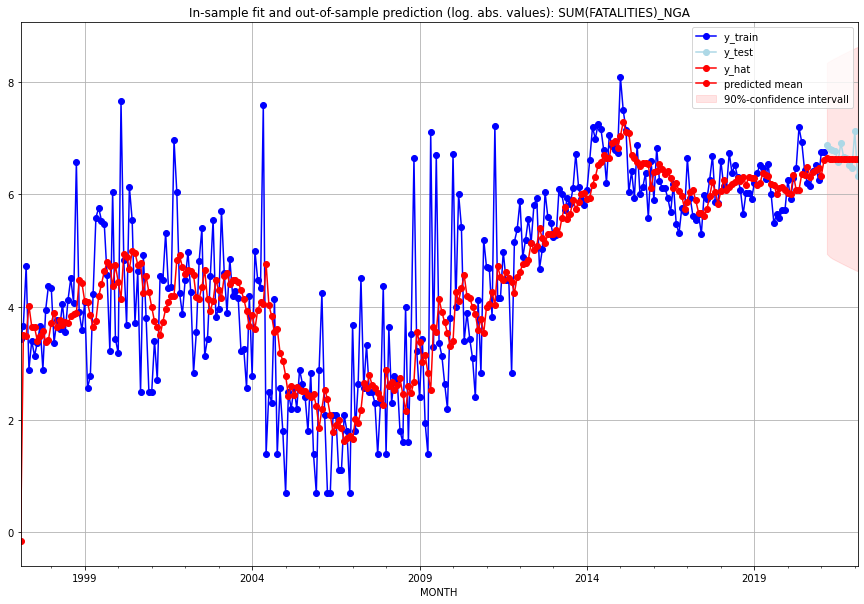

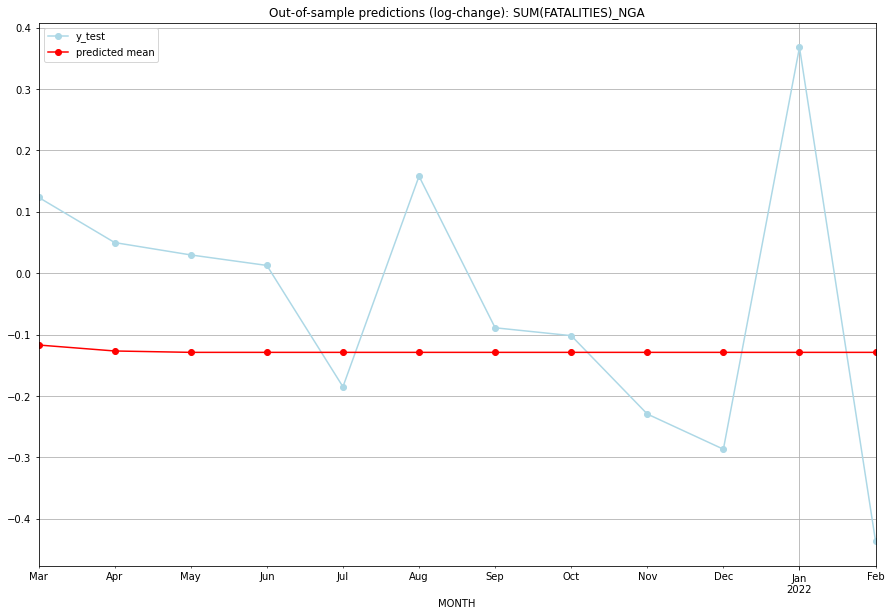

TADDA: 0.2457360848601636
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  763.257747       971.0     -0.116864        0.123587   NGA   
1  2021-04-01  755.862572       902.0     -0.126587        0.049954   NGA   
2  2021-05-01  754.174028       884.0     -0.128821        0.029819   NGA   
3  2021-06-01  754.174028       869.0     -0.128821        0.012724   NGA   
4  2021-07-01  754.174028       713.0     -0.128821       -0.184886   NGA   
5  2021-08-01  754.174028      1005.0     -0.128821        0.157968   NGA   
6  2021-09-01  754.174028       785.0     -0.128821       -0.088812   NGA   
7  2021-10-01  754.174028       775.0     -0.128821       -0.101616   NGA   
8  2021-11-01  754.174028       682.0     -0.128821       -0.229274   NGA   
9  2021-12-01  754.174028       644.0     -0.128821       -0.286519   NGA   
10 2022-01-01  754.174028      1240.0     -0.128821        0.367904   NGA   
11 2022-02-01  754.174028    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.598397500917085, 'fold_results': [0.6419364885857896, 0.5548585132483804]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NIC   No. Observations:                   38
Model:                SARIMAX(1, 0, 0)   Log Likelihood                 -55.923
Date:                 Wed, 19 Oct 2022   AIC                            121.845
Time:                         11:00:42   BIC                            130.033
Sample:                     01-31-2018   HQIC                           124.759
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0147      0.1

<Figure size 432x288 with 0 Axes>

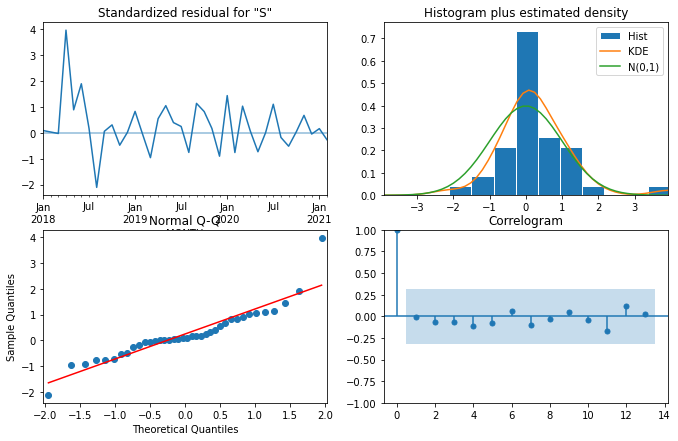

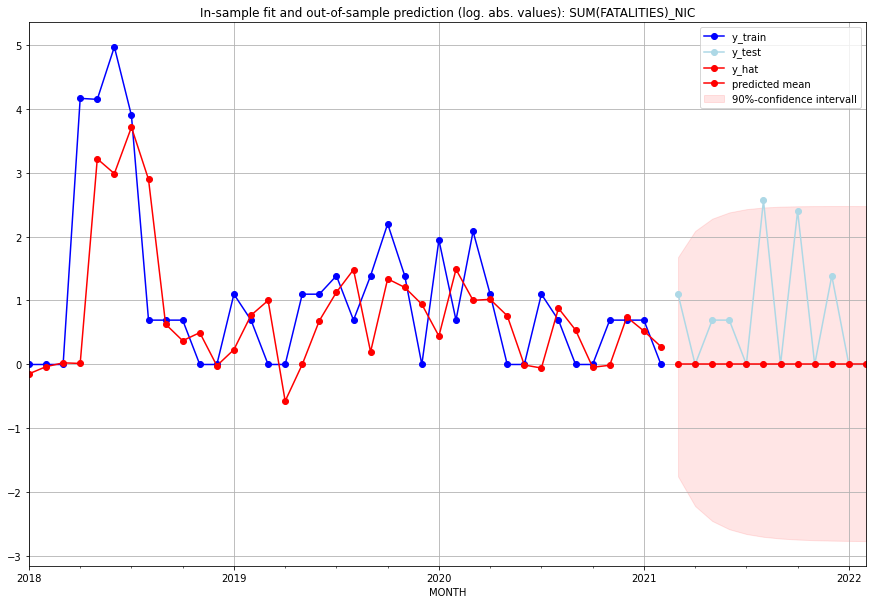

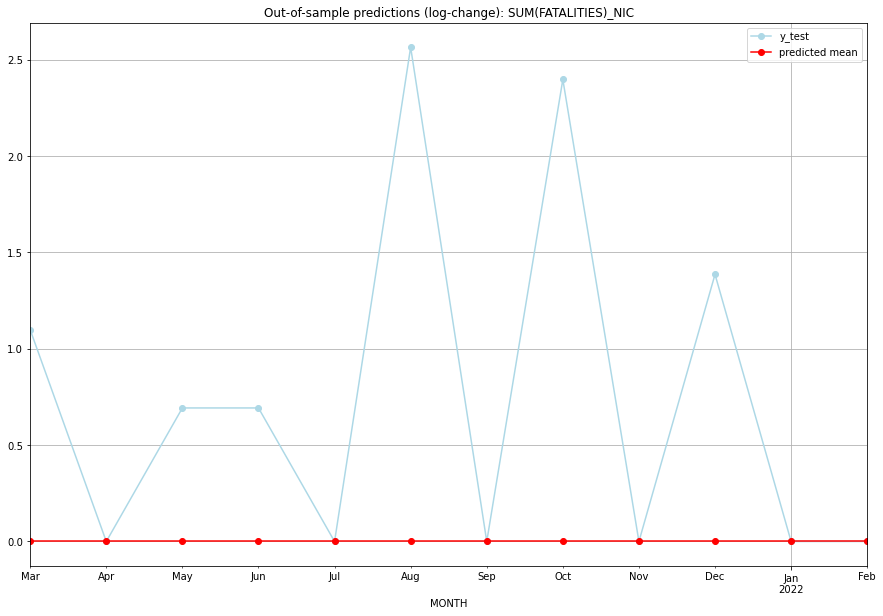

TADDA: 0.7361704700973165
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         2.0           0.0        1.098612   NIC   
1  2021-04-01       0.0         0.0           0.0        0.000000   NIC   
2  2021-05-01       0.0         1.0           0.0        0.693147   NIC   
3  2021-06-01       0.0         1.0           0.0        0.693147   NIC   
4  2021-07-01       0.0         0.0           0.0        0.000000   NIC   
5  2021-08-01       0.0        12.0           0.0        2.564949   NIC   
6  2021-09-01       0.0         0.0           0.0        0.000000   NIC   
7  2021-10-01       0.0        10.0           0.0        2.397895   NIC   
8  2021-11-01       0.0         0.0           0.0        0.000000   NIC   
9  2021-12-01       0.0         3.0           0.0        1.386294   NIC   
10 2022-01-01       0.0         0.0           0.0        0.000000   NIC   
11 2022-02-01       0.0         0.0           0.0    

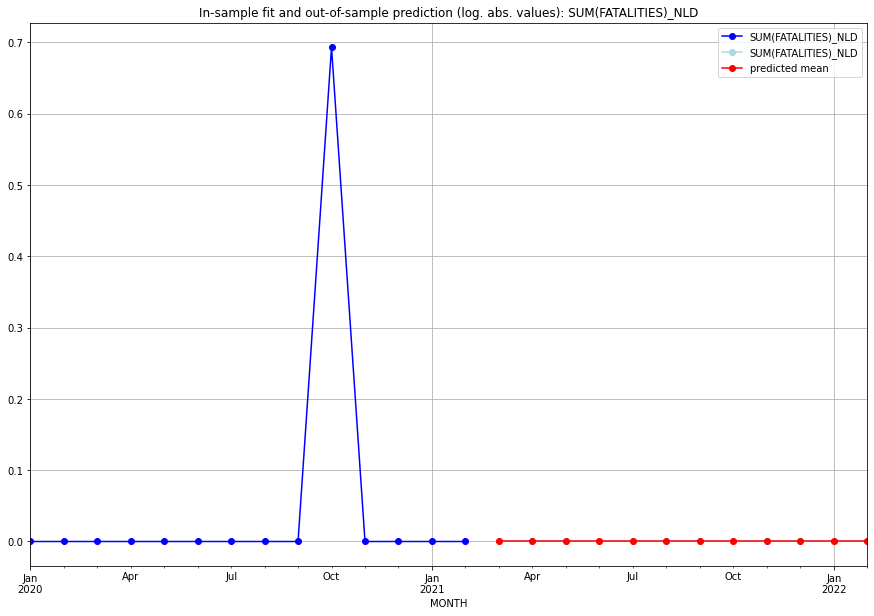

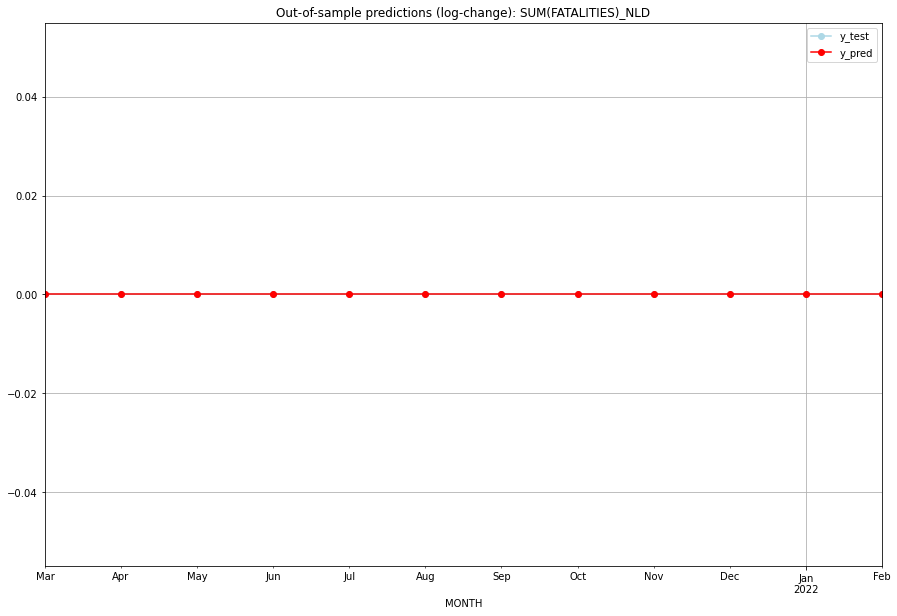

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   NLD   
1  2021-04-01       0.0         0.0           0.0             0.0   NLD   
2  2021-05-01       0.0         0.0           0.0             0.0   NLD   
3  2021-06-01       0.0         0.0           0.0             0.0   NLD   
4  2021-07-01       0.0         0.0           0.0             0.0   NLD   
5  2021-08-01       0.0         0.0           0.0             0.0   NLD   
6  2021-09-01       0.0         0.0           0.0             0.0   NLD   
7  2021-10-01       0.0         0.0           0.0             0.0   NLD   
8  2021-11-01       0.0         0.0           0.0             0.0   NLD   
9  2021-12-01       0.0         0.0           0.0             0.0   NLD   
10 2022-01-01       0.0         0.0           0.0             0.0   NLD   
11 2022-02-01       0.0         0.0           0.0             0.0   

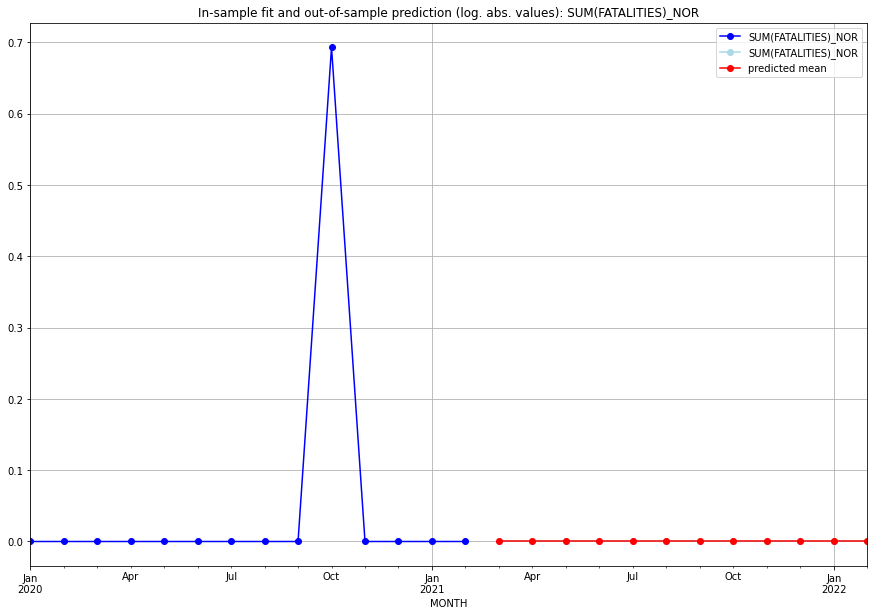

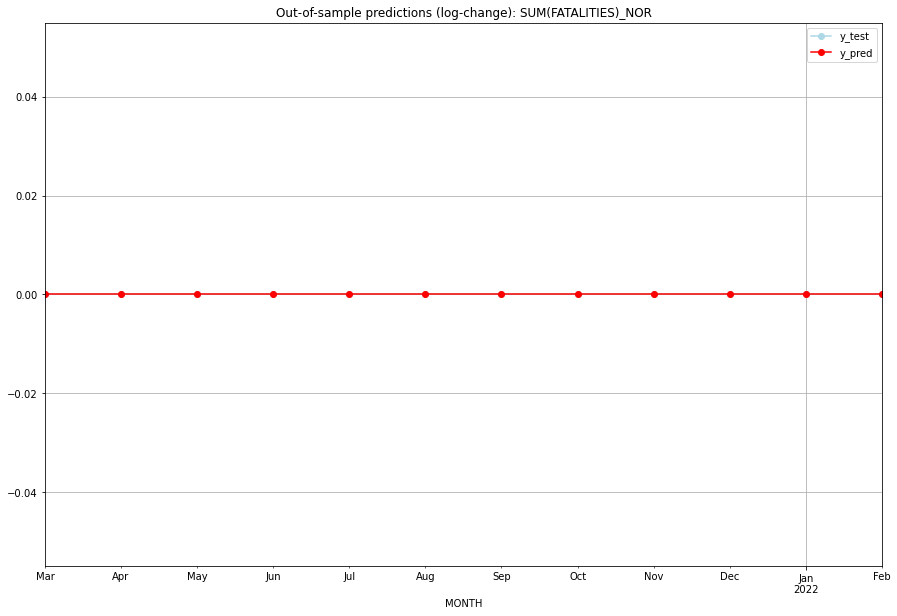

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   NOR   
1  2021-04-01       0.0         0.0           0.0             0.0   NOR   
2  2021-05-01       0.0         0.0           0.0             0.0   NOR   
3  2021-06-01       0.0         0.0           0.0             0.0   NOR   
4  2021-07-01       0.0         0.0           0.0             0.0   NOR   
5  2021-08-01       0.0         0.0           0.0             0.0   NOR   
6  2021-09-01       0.0         0.0           0.0             0.0   NOR   
7  2021-10-01       0.0         0.0           0.0             0.0   NOR   
8  2021-11-01       0.0         0.0           0.0             0.0   NOR   
9  2021-12-01       0.0         0.0           0.0             0.0   NOR   
10 2022-01-01       0.0         0.0           0.0             0.0   NOR   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5765701957670375, 'fold_results': [0.18310204811135164, 0.7029624335313107, 0.6060331993808373, 0.6315306322830604, 0.7592226655286275]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_NPL   No. Observations:                  134
Model:                         SARIMAX   Log Likelihood                -185.359
Date:                 Wed, 19 Oct 2022   AIC                            376.717
Time:                         11:01:14   BIC                            385.411
Sample:                     01-31-2010   HQIC                           380.250
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

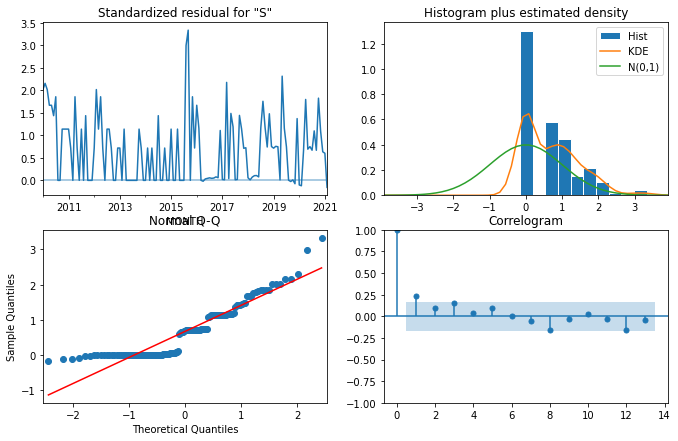

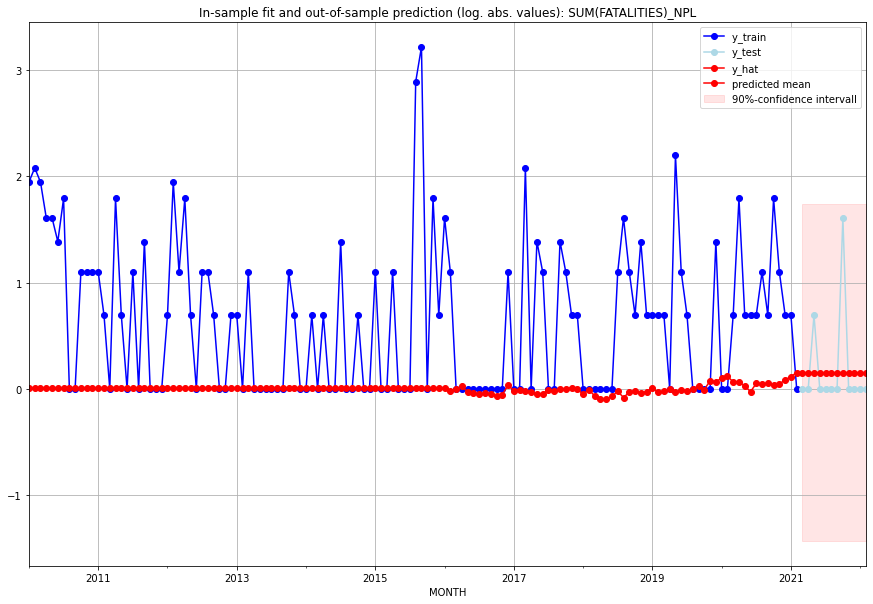

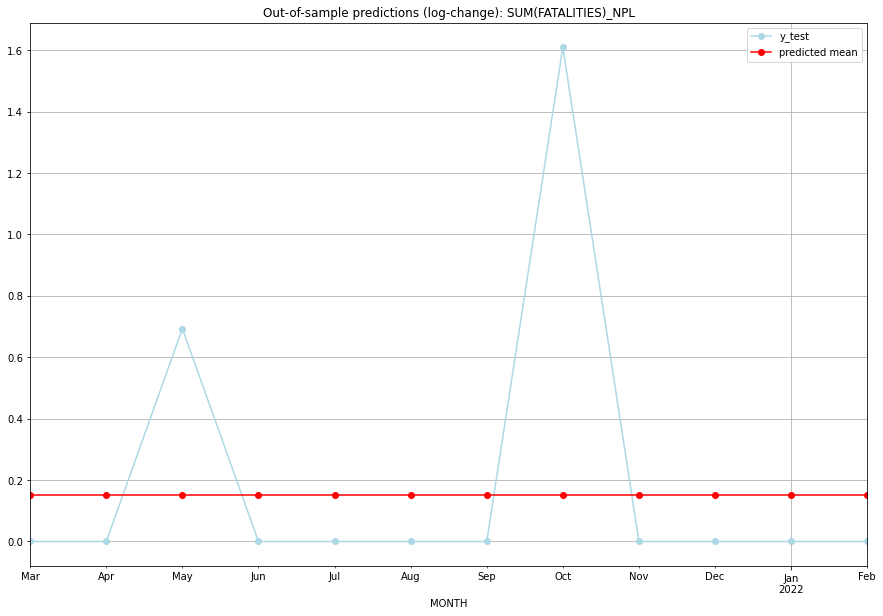

TADDA: 0.29370950577887656
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.165023         0.0      0.152741        0.000000   NPL   
1  2021-04-01  0.165023         0.0      0.152741        0.000000   NPL   
2  2021-05-01  0.165023         1.0      0.152741        0.693147   NPL   
3  2021-06-01  0.165023         0.0      0.152741        0.000000   NPL   
4  2021-07-01  0.165023         0.0      0.152741        0.000000   NPL   
5  2021-08-01  0.165023         0.0      0.152741        0.000000   NPL   
6  2021-09-01  0.165023         0.0      0.152741        0.000000   NPL   
7  2021-10-01  0.165023         4.0      0.152741        1.609438   NPL   
8  2021-11-01  0.165023         0.0      0.152741        0.000000   NPL   
9  2021-12-01  0.165023         0.0      0.152741        0.000000   NPL   
10 2022-01-01  0.165023         0.0      0.152741        0.000000   NPL   
11 2022-02-01  0.165023         0.0      0.152741   

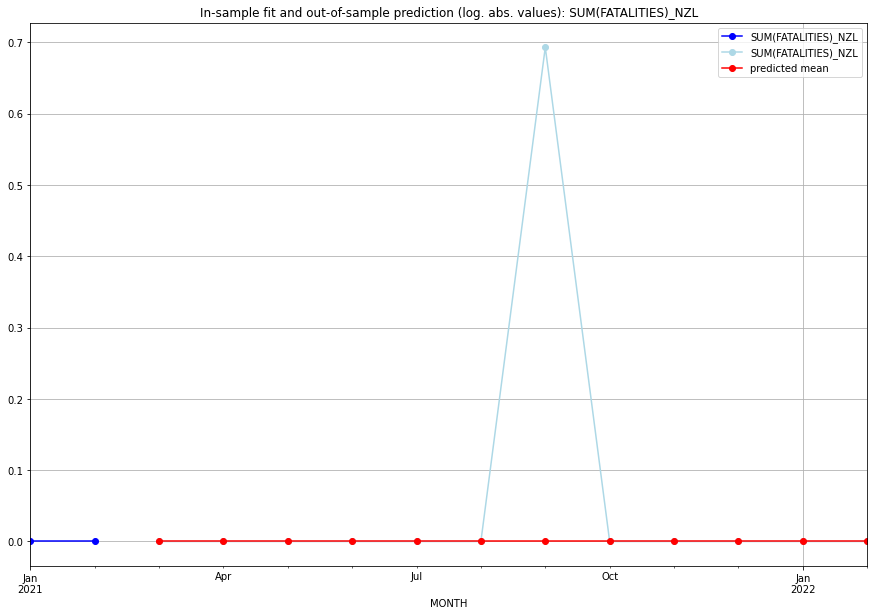

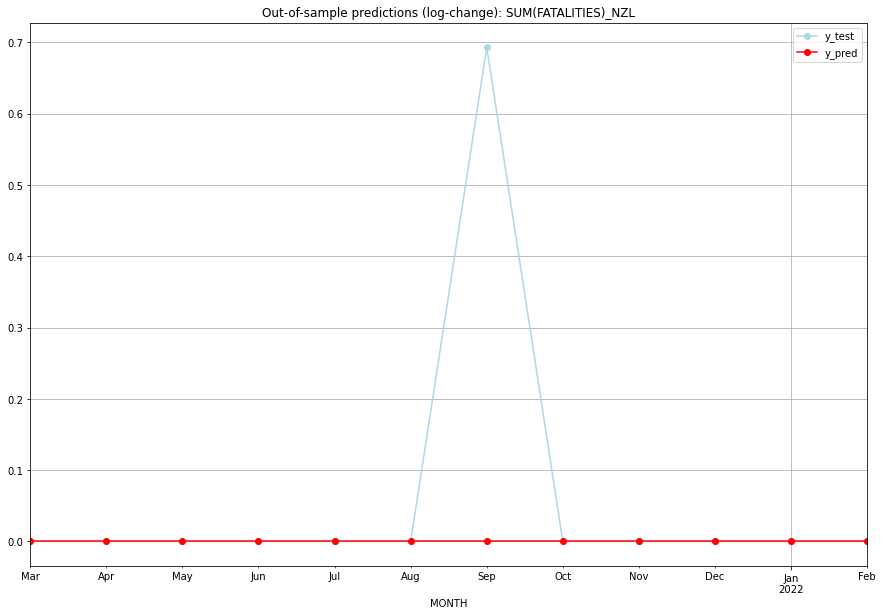

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   NZL   
1  2021-04-01       0.0    0.000000           0.0        0.000000   NZL   
2  2021-05-01       0.0    0.000000           0.0        0.000000   NZL   
3  2021-06-01       0.0    0.000000           0.0        0.000000   NZL   
4  2021-07-01       0.0    0.000000           0.0        0.000000   NZL   
5  2021-08-01       0.0    0.000000           0.0        0.000000   NZL   
6  2021-09-01       0.0    0.693147           0.0        0.693147   NZL   
7  2021-10-01       0.0    0.000000           0.0        0.000000   NZL   
8  2021-11-01       0.0    0.000000           0.0        0.000000   NZL   
9  2021-12-01       0.0    0.000000           0.0        0.000000   NZL   
10 2022-01-01       0.0    0.000000           0.0        0.000000   NZL   
11 2022-02-01       0.0    0.000000           0.0  

<Figure size 432x288 with 0 Axes>

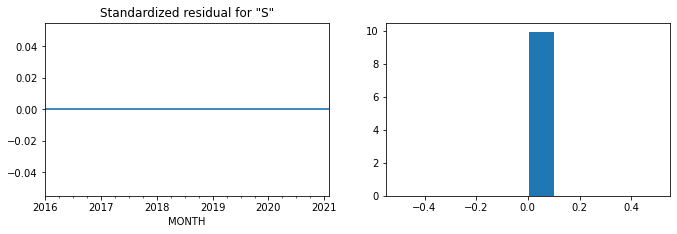

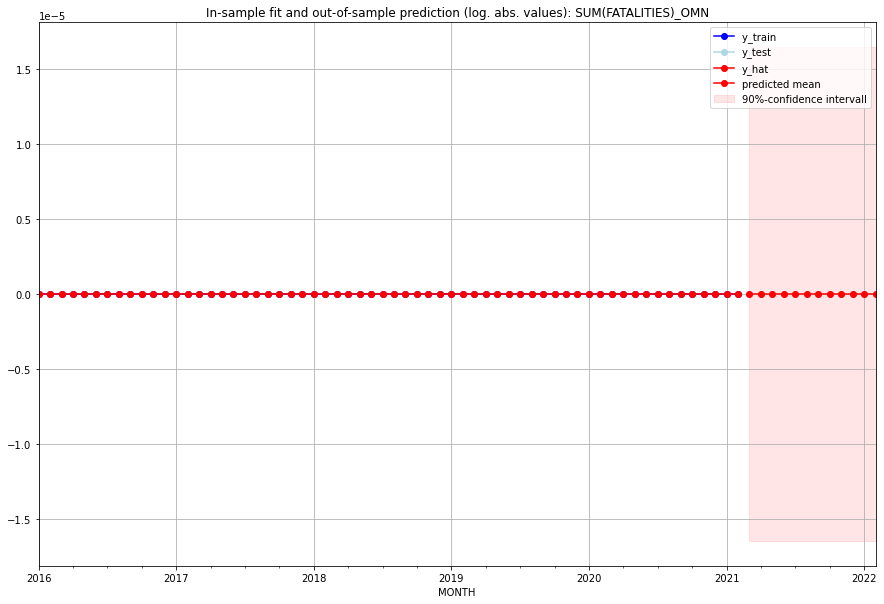

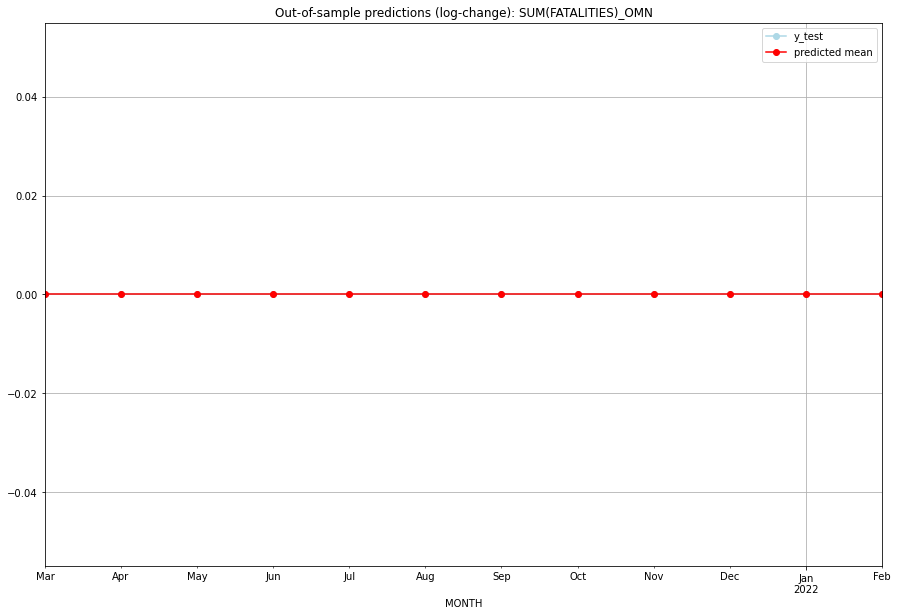

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   OMN   
1  2021-04-01       0.0         0.0           0.0             0.0   OMN   
2  2021-05-01       0.0         0.0           0.0             0.0   OMN   
3  2021-06-01       0.0         0.0           0.0             0.0   OMN   
4  2021-07-01       0.0         0.0           0.0             0.0   OMN   
5  2021-08-01       0.0         0.0           0.0             0.0   OMN   
6  2021-09-01       0.0         0.0           0.0             0.0   OMN   
7  2021-10-01       0.0         0.0           0.0             0.0   OMN   
8  2021-11-01       0.0         0.0           0.0             0.0   OMN   
9  2021-12-01       0.0         0.0           0.0             0.0   OMN   
10 2022-01-01       0.0         0.0           0.0             0.0   OMN   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.332505097850062, 'fold_results': [0.43517968531620127, 0.37906413475476225, 0.2974716985720824, 0.25085817186630155, 0.29995179874096267]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PAK   No. Observations:                  134
Model:                SARIMAX(2, 0, 1)   Log Likelihood                 -76.917
Date:                 Wed, 19 Oct 2022   AIC                            161.835
Time:                         11:01:48   BIC                            173.426
Sample:                     01-31-2010   HQIC                           166.545
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

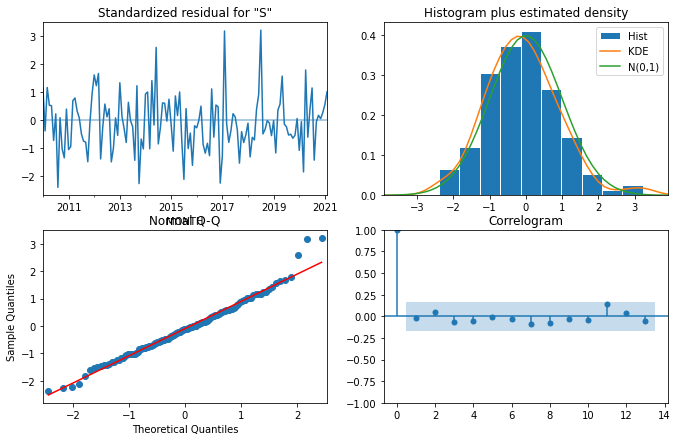

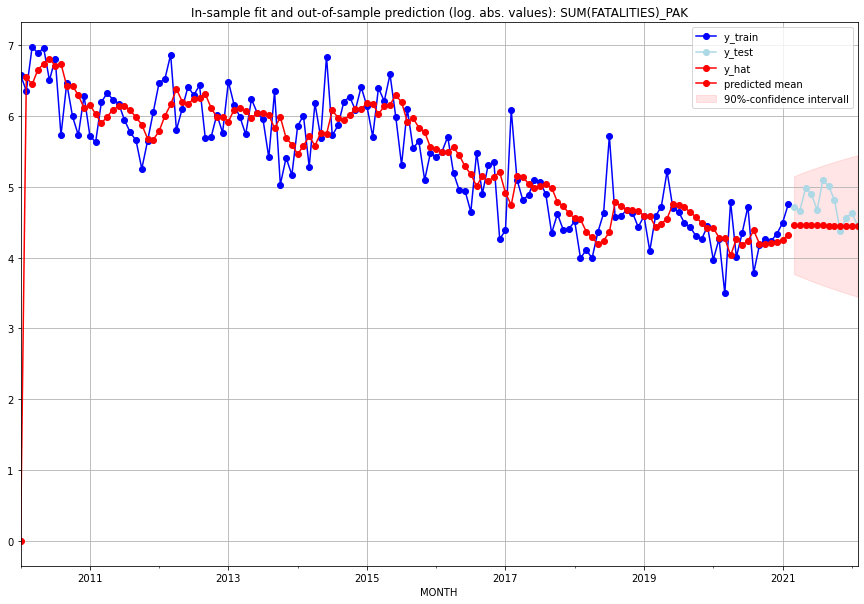

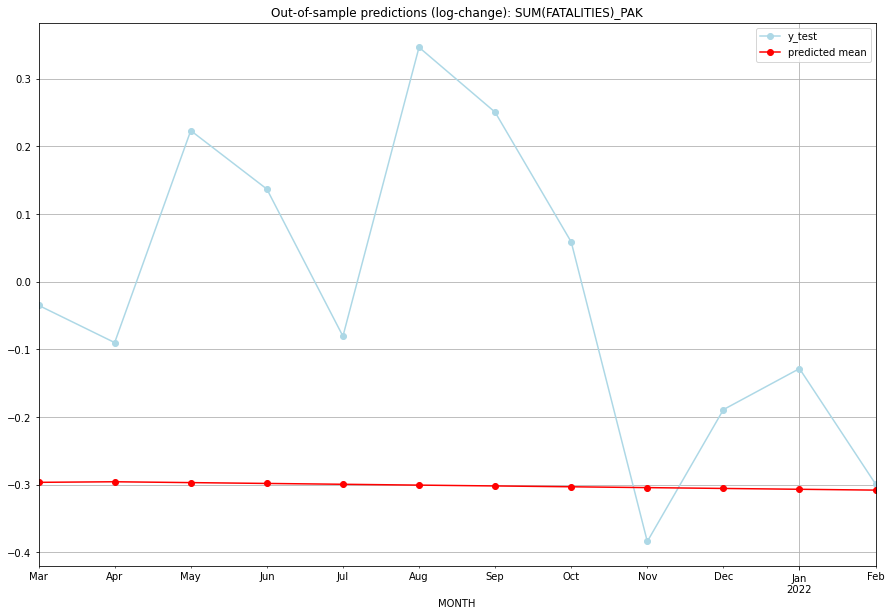

TADDA: 0.42399420577160046
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  85.218122       111.0     -0.296710       -0.035091   PAK   
1  2021-04-01  85.290763       105.0     -0.295868       -0.090151   PAK   
2  2021-05-01  85.183137       144.0     -0.297116        0.223144   PAK   
3  2021-06-01  85.076939       132.0     -0.298349        0.136759   PAK   
4  2021-07-01  84.970893       106.0     -0.299581       -0.080761   PAK   
5  2021-08-01  84.865006       163.0     -0.300814        0.346276   PAK   
6  2021-09-01  84.759279       148.0     -0.302046        0.250356   PAK   
7  2021-10-01  84.653712       122.0     -0.303278        0.058594   PAK   
8  2021-11-01  84.548303        78.0     -0.304509       -0.384142   PAK   
9  2021-12-01  84.443054        95.0     -0.305740       -0.189242   PAK   
10 2022-01-01  84.337963       101.0     -0.306971       -0.128617   PAK   
11 2022-02-01  84.233030        85.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.17328679513998632, 'fold_results': [0.17328679513998632, 0.17328679513998632]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PAN   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                 -12.625
Date:                 Wed, 19 Oct 2022   AIC                             27.251
Time:                         11:02:00   BIC                             28.888
Sample:                     01-31-2018   HQIC                            27.833
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1138     

<Figure size 432x288 with 0 Axes>

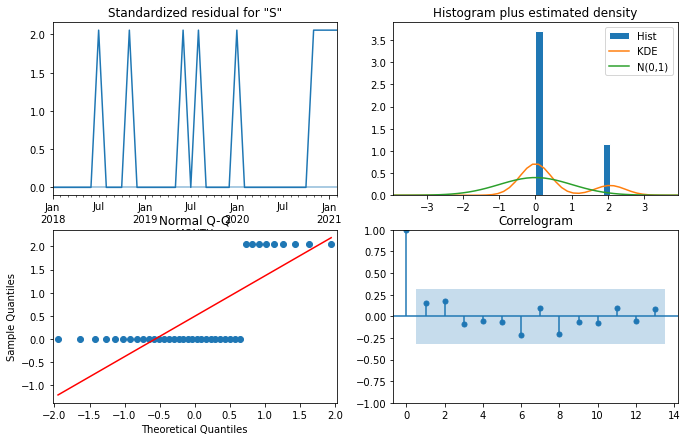

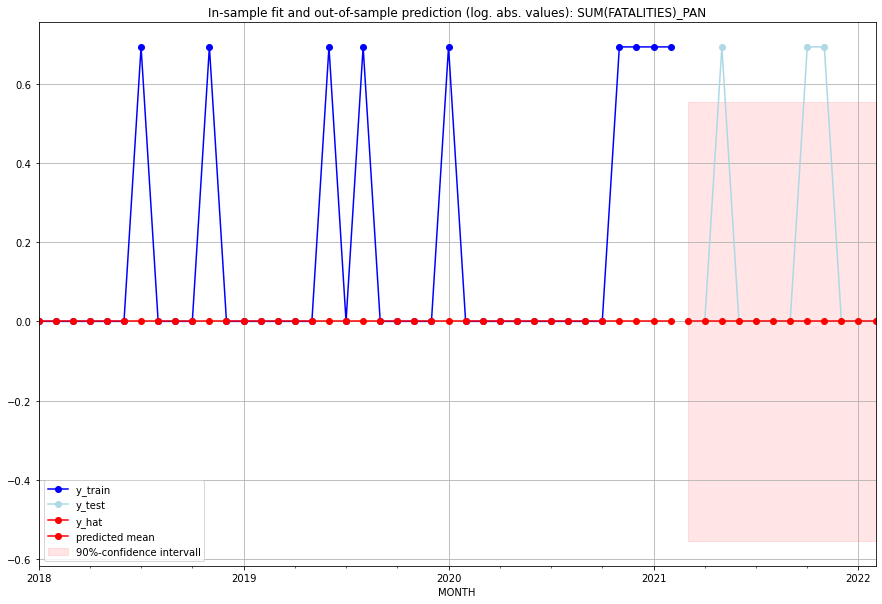

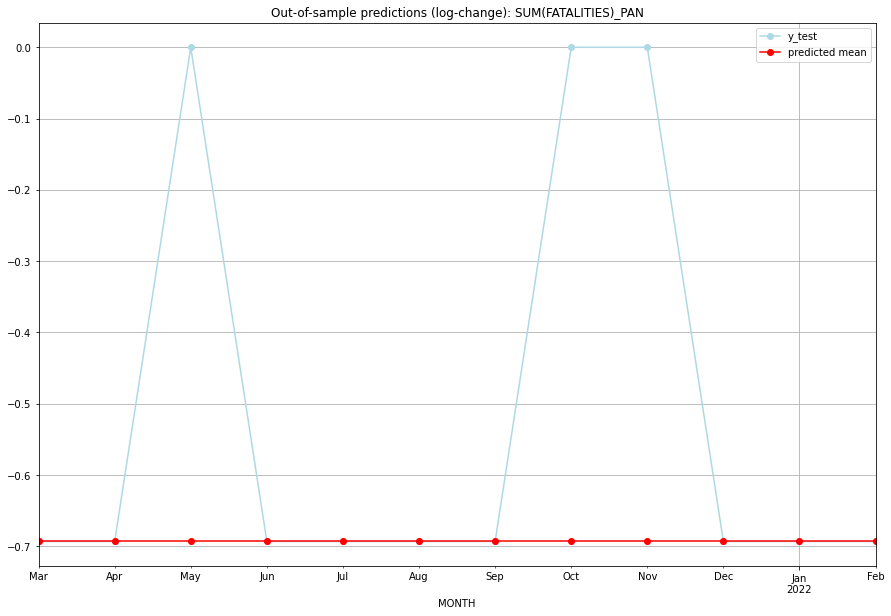

TADDA: 0.17328679513998632
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0     -0.693147       -0.693147   PAN   
1  2021-04-01       0.0         0.0     -0.693147       -0.693147   PAN   
2  2021-05-01       0.0         1.0     -0.693147        0.000000   PAN   
3  2021-06-01       0.0         0.0     -0.693147       -0.693147   PAN   
4  2021-07-01       0.0         0.0     -0.693147       -0.693147   PAN   
5  2021-08-01       0.0         0.0     -0.693147       -0.693147   PAN   
6  2021-09-01       0.0         0.0     -0.693147       -0.693147   PAN   
7  2021-10-01       0.0         1.0     -0.693147        0.000000   PAN   
8  2021-11-01       0.0         1.0     -0.693147        0.000000   PAN   
9  2021-12-01       0.0         0.0     -0.693147       -0.693147   PAN   
10 2022-01-01       0.0         0.0     -0.693147       -0.693147   PAN   
11 2022-02-01       0.0         0.0     -0.693147   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.6732924450752381, 'fold_results': [nan, 0.6732924450752381]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PER   No. Observations:                   38
Model:                SARIMAX(2, 1, 3)   Log Likelihood                 -40.141
Date:                 Wed, 19 Oct 2022   AIC                             96.281
Time:                         11:02:11   BIC                            109.169
Sample:                     01-31-2018   HQIC                           100.825
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0446      0.047      0.944 

<Figure size 432x288 with 0 Axes>

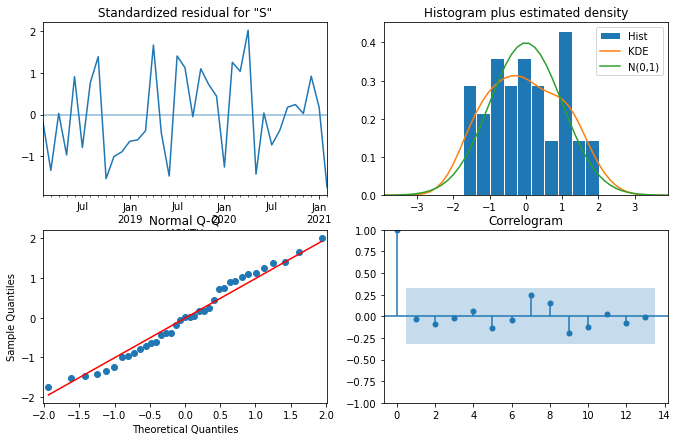

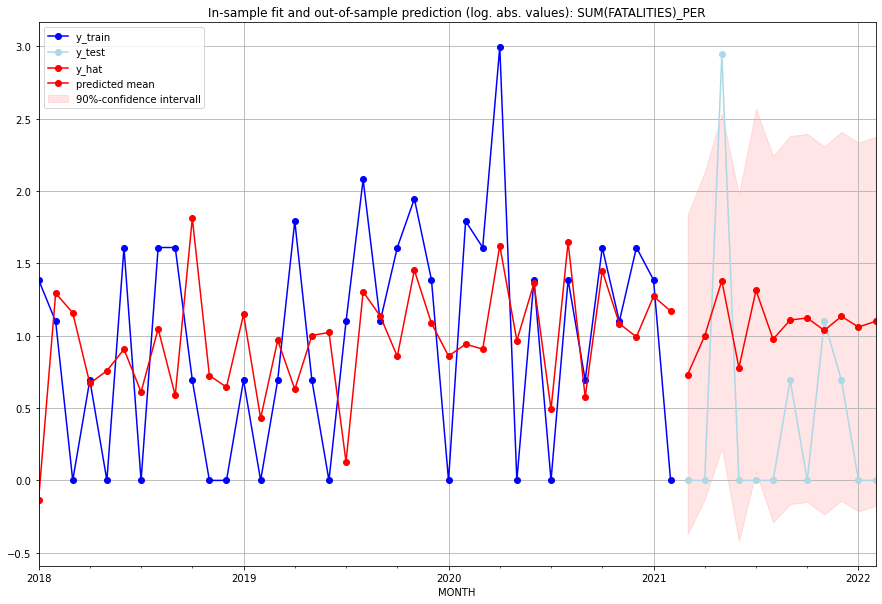

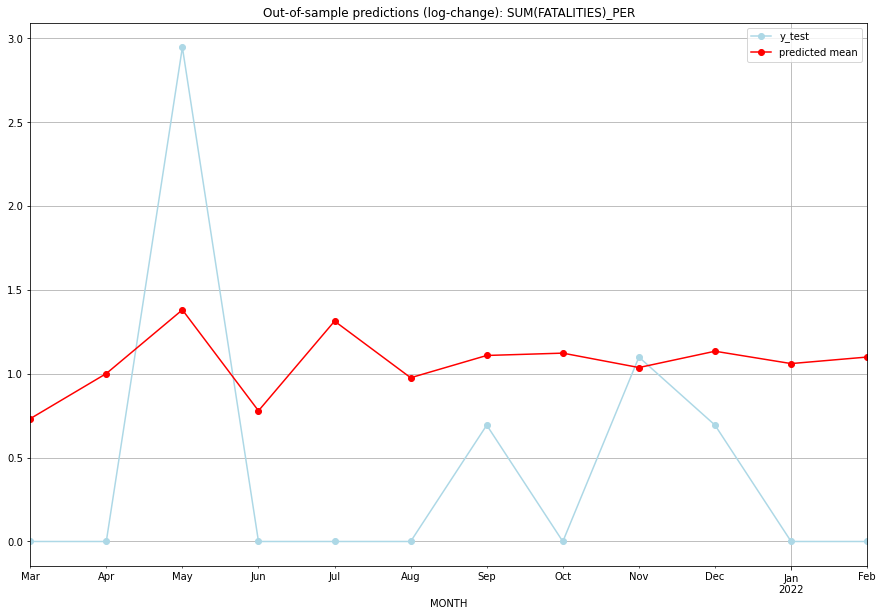

TADDA: 0.8802497527465402
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.078383         0.0      0.731590        0.000000   PER   
1  2021-04-01  1.719800         0.0      1.000558        0.000000   PER   
2  2021-05-01  2.975790        18.0      1.380224        2.944439   PER   
3  2021-06-01  1.178660         0.0      0.778710        0.000000   PER   
4  2021-07-01  2.717440         0.0      1.313035        0.000000   PER   
5  2021-08-01  1.653006         0.0      0.975693        0.000000   PER   
6  2021-09-01  2.029399         1.0      1.108364        0.693147   PER   
7  2021-10-01  2.071840         0.0      1.122277        0.000000   PER   
8  2021-11-01  1.819117         2.0      1.036424        1.098612   PER   
9  2021-12-01  2.106863         1.0      1.133613        0.693147   PER   
10 2022-01-01  1.886411         0.0      1.060014        0.000000   PER   
11 2022-02-01  2.001260         0.0      1.099032    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.21171691327514577, 'fold_results': [nan, 0.2549779086074284, 0.14381768173488263, 0.23635514948312633]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PHL   No. Observations:                   62
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -33.349
Date:                 Wed, 19 Oct 2022   AIC                             74.697
Time:                         11:02:30   BIC                             83.141
Sample:                     01-31-2016   HQIC                            78.006
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
m

<Figure size 432x288 with 0 Axes>

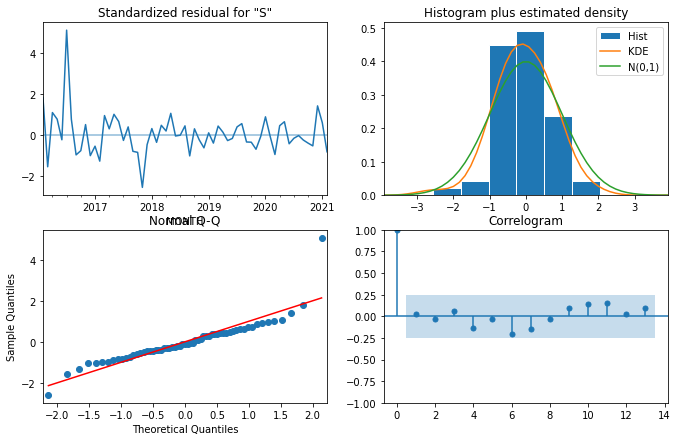

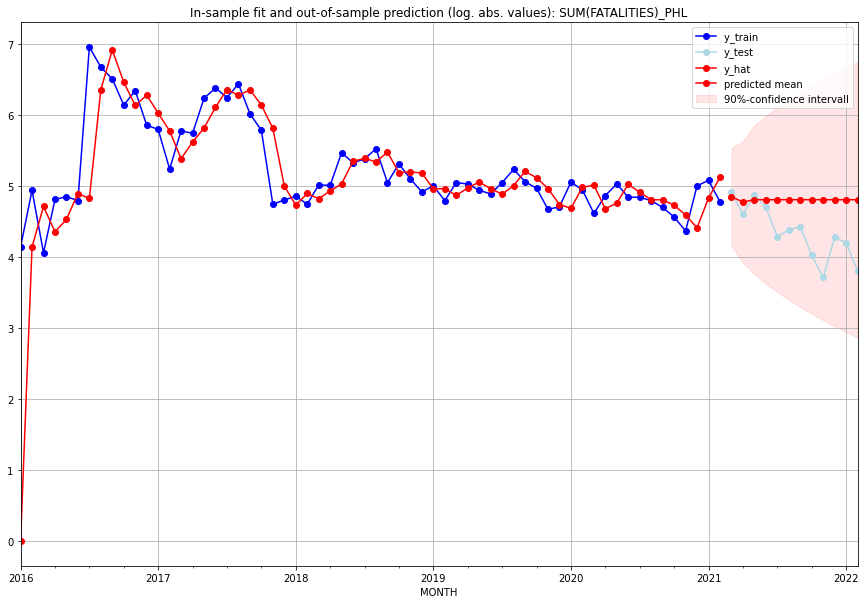

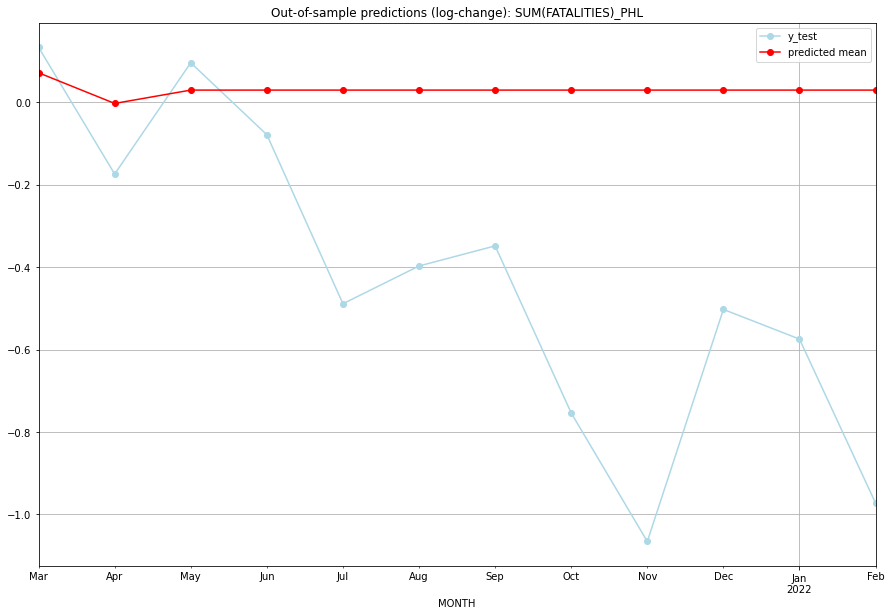

TADDA: 0.5013166486665894
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  126.851638       135.0      0.071747        0.133531   PHL   
1  2021-04-01  117.684574        99.0     -0.002654       -0.173953   PHL   
2  2021-05-01  121.589898       130.0      0.029721        0.096074   PHL   
3  2021-06-01  121.589898       109.0      0.029721       -0.078643   PHL   
4  2021-07-01  121.589898        72.0      0.029721       -0.488664   PHL   
5  2021-08-01  121.589898        79.0      0.029721       -0.397097   PHL   
6  2021-09-01  121.589898        83.0      0.029721       -0.348307   PHL   
7  2021-10-01  121.589898        55.0      0.029721       -0.753772   PHL   
8  2021-11-01  121.589898        40.0      0.029721       -1.065551   PHL   
9  2021-12-01  121.589898        71.0      0.029721       -0.502457   PHL   
10 2022-01-01  121.589898        66.0      0.029721       -0.574431   PHL   
11 2022-02-01  121.589898    

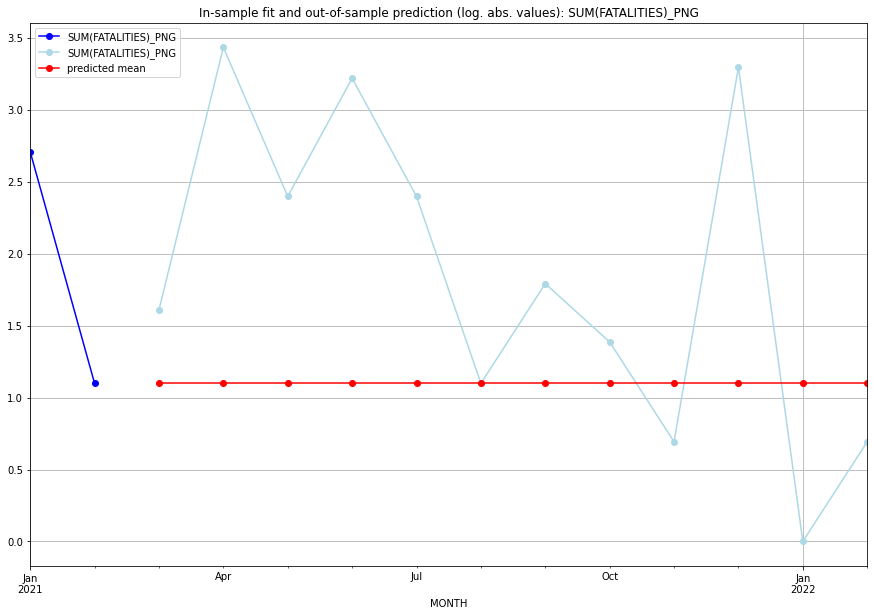

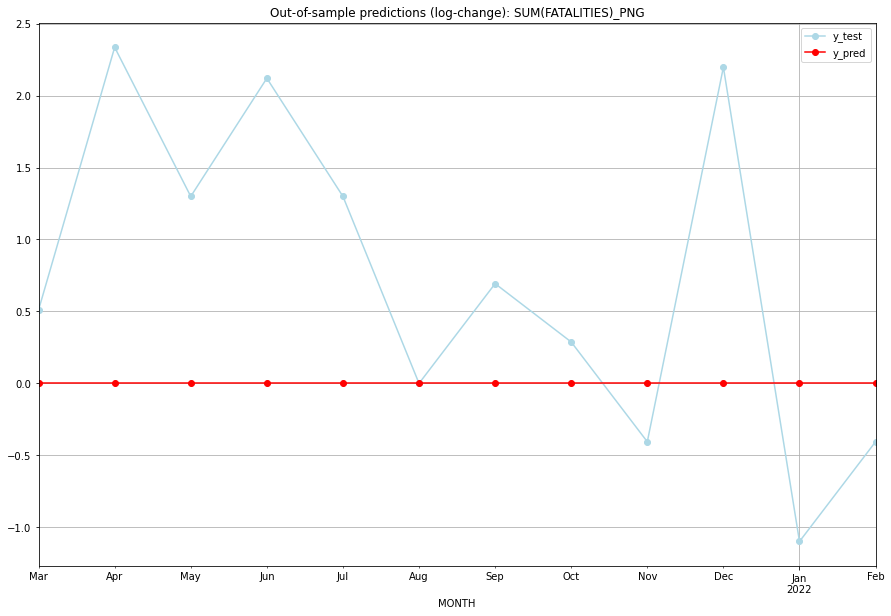

TADDA: 1.054385531606335
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.098612    1.609438           0.0        0.510826   PNG   
1  2021-04-01  1.098612    3.433987           0.0        2.335375   PNG   
2  2021-05-01  1.098612    2.397895           0.0        1.299283   PNG   
3  2021-06-01  1.098612    3.218876           0.0        2.120264   PNG   
4  2021-07-01  1.098612    2.397895           0.0        1.299283   PNG   
5  2021-08-01  1.098612    1.098612           0.0        0.000000   PNG   
6  2021-09-01  1.098612    1.791759           0.0        0.693147   PNG   
7  2021-10-01  1.098612    1.386294           0.0        0.287682   PNG   
8  2021-11-01  1.098612    0.693147           0.0       -0.405465   PNG   
9  2021-12-01  1.098612    3.295837           0.0        2.197225   PNG   
10 2022-01-01  1.098612    0.000000           0.0       -1.098612   PNG   
11 2022-02-01  1.098612    0.693147           0.0     

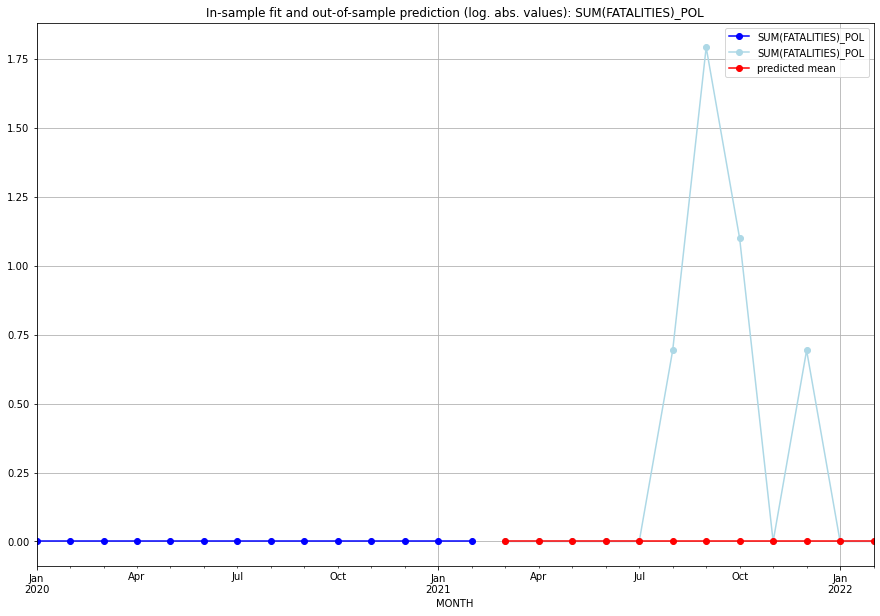

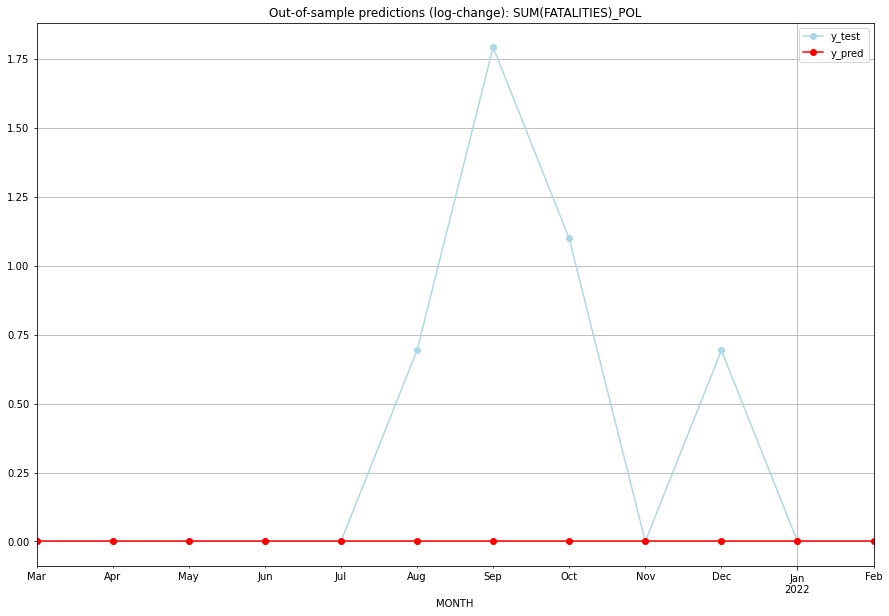

TADDA: 0.35638884325133796
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0    0.000000           0.0        0.000000   POL   
1  2021-04-01       0.0    0.000000           0.0        0.000000   POL   
2  2021-05-01       0.0    0.000000           0.0        0.000000   POL   
3  2021-06-01       0.0    0.000000           0.0        0.000000   POL   
4  2021-07-01       0.0    0.000000           0.0        0.000000   POL   
5  2021-08-01       0.0    0.693147           0.0        0.693147   POL   
6  2021-09-01       0.0    1.791759           0.0        1.791759   POL   
7  2021-10-01       0.0    1.098612           0.0        1.098612   POL   
8  2021-11-01       0.0    0.000000           0.0        0.000000   POL   
9  2021-12-01       0.0    0.693147           0.0        0.693147   POL   
10 2022-01-01       0.0    0.000000           0.0        0.000000   POL   
11 2022-02-01       0.0    0.000000           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.4753493193289153, 'fold_results': [nan, 0.4753493193289153]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PRI   No. Observations:                   38
Model:                SARIMAX(2, 1, 3)   Log Likelihood                 -28.109
Date:                 Wed, 19 Oct 2022   AIC                             68.217
Time:                         11:02:54   BIC                             77.883
Sample:                     01-31-2018   HQIC                            71.625
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.0315      0.296     -3.482 

<Figure size 432x288 with 0 Axes>

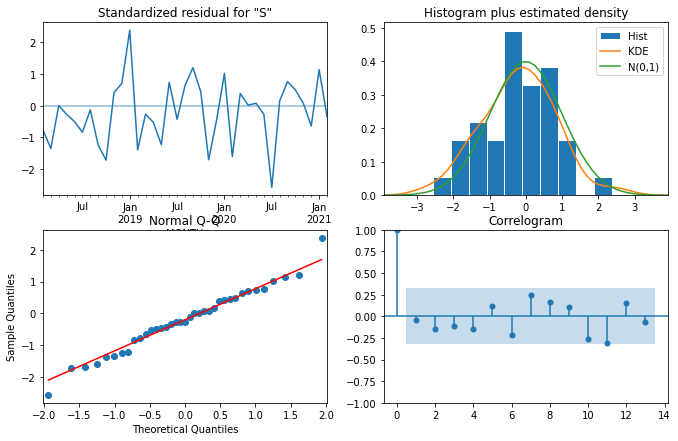

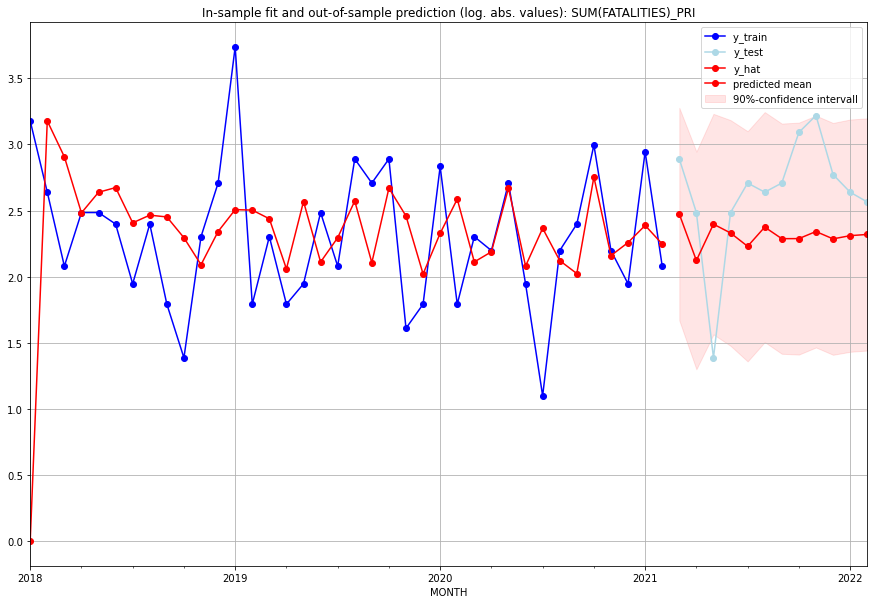

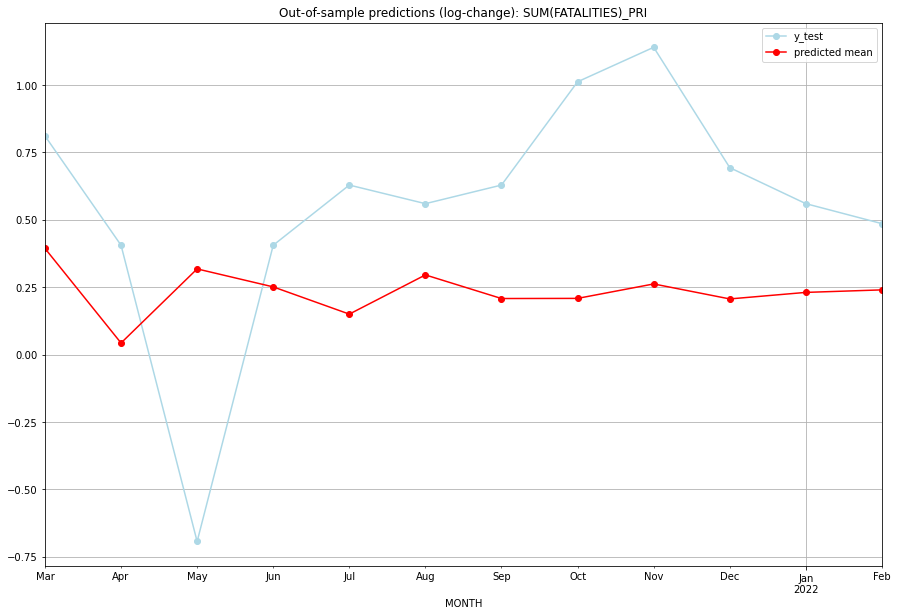

TADDA: 0.5140397749884901
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  10.860156        17.0      0.393743        0.810930   PRI   
1  2021-04-01   7.350973        11.0      0.042937        0.405465   PRI   
2  2021-05-01   9.991478         3.0      0.317679       -0.693147   PRI   
3  2021-06-01   9.282593        11.0      0.251011        0.405465   PRI   
4  2021-07-01   8.295001        14.0      0.150035        0.628609   PRI   
5  2021-08-01   9.749167        13.0      0.295387        0.559616   PRI   
6  2021-09-01   8.848093        14.0      0.207836        0.628609   PRI   
7  2021-10-01   8.853103        21.0      0.208345        1.011601   PRI   
8  2021-11-01   9.395302        24.0      0.261912        1.139434   PRI   
9  2021-12-01   8.833374        15.0      0.206341        0.693147   PRI   
10 2022-01-01   9.074536        13.0      0.230569        0.559616   PRI   
11 2022-02-01   9.169085        12.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.37156692192576624, 'fold_results': [0.28343311513851294, 0.45970072871301954]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PRK   No. Observations:                   38
Model:                SARIMAX(2, 0, 3)   Log Likelihood                 -25.199
Date:                 Wed, 19 Oct 2022   AIC                             68.397
Time:                         11:03:06   BIC                             83.135
Sample:                     01-31-2018   HQIC                            73.641
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0682     

<Figure size 432x288 with 0 Axes>

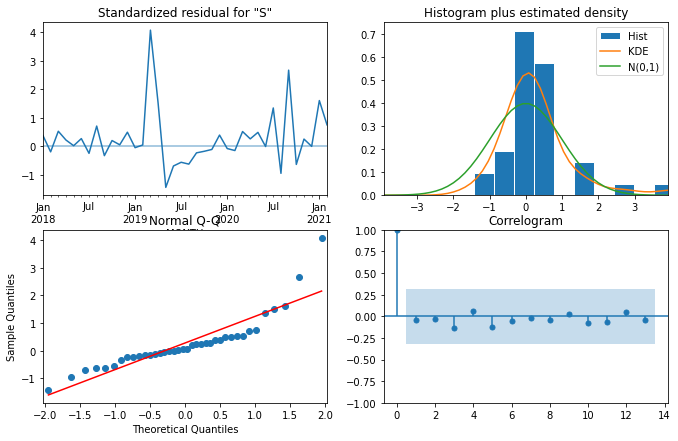

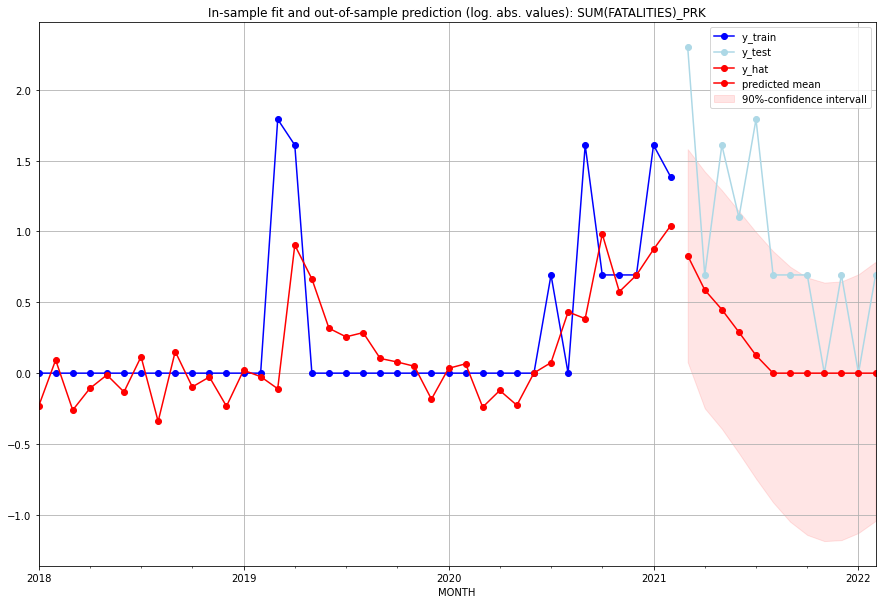

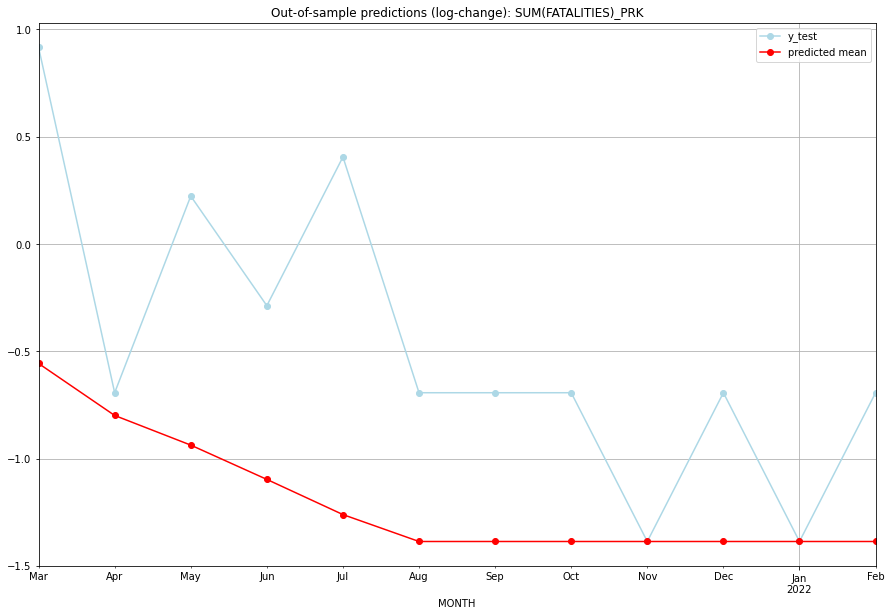

TADDA: 0.9529750630943541
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.292090         9.0     -0.556830        0.916291   PRK   
1  2021-04-01  0.799000         1.0     -0.799064       -0.693147   PRK   
2  2021-05-01  0.566886         4.0     -0.937204        0.223144   PRK   
3  2021-06-01  0.335492         2.0     -1.096995       -0.287682   PRK   
4  2021-07-01  0.133613         5.0     -1.260884        0.405465   PRK   
5  2021-08-01  0.000000         1.0     -1.386294       -0.693147   PRK   
6  2021-09-01  0.000000         1.0     -1.386294       -0.693147   PRK   
7  2021-10-01  0.000000         1.0     -1.386294       -0.693147   PRK   
8  2021-11-01  0.000000         0.0     -1.386294       -1.386294   PRK   
9  2021-12-01  0.000000         1.0     -1.386294       -0.693147   PRK   
10 2022-01-01  0.000000         0.0     -1.386294       -1.386294   PRK   
11 2022-02-01  0.000000         1.0     -1.386294    

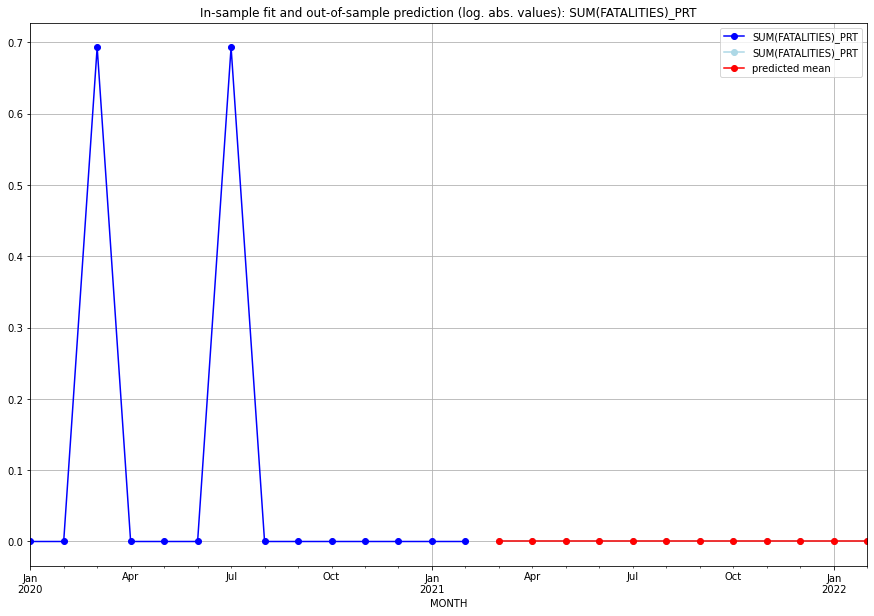

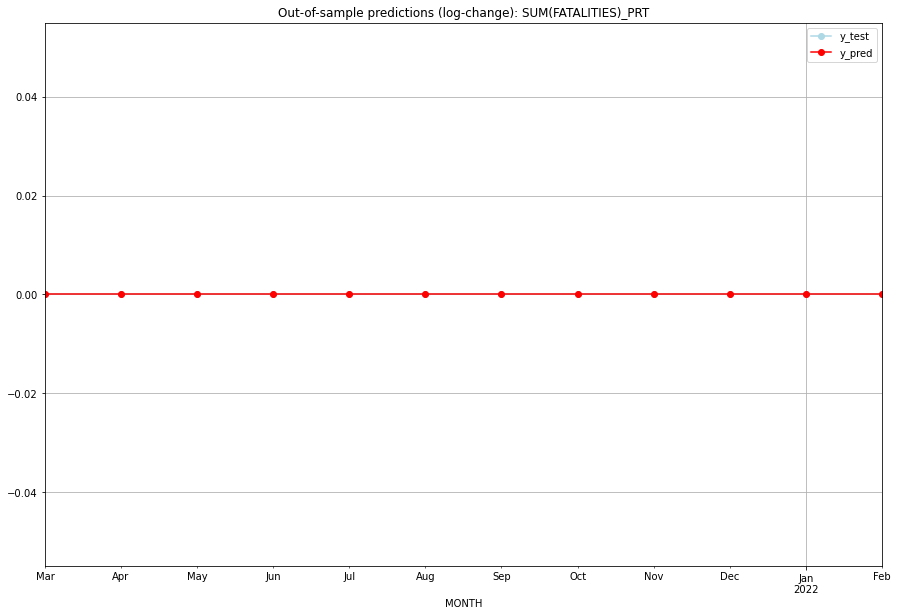

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   PRT   
1  2021-04-01       0.0         0.0           0.0             0.0   PRT   
2  2021-05-01       0.0         0.0           0.0             0.0   PRT   
3  2021-06-01       0.0         0.0           0.0             0.0   PRT   
4  2021-07-01       0.0         0.0           0.0             0.0   PRT   
5  2021-08-01       0.0         0.0           0.0             0.0   PRT   
6  2021-09-01       0.0         0.0           0.0             0.0   PRT   
7  2021-10-01       0.0         0.0           0.0             0.0   PRT   
8  2021-11-01       0.0         0.0           0.0             0.0   PRT   
9  2021-12-01       0.0         0.0           0.0             0.0   PRT   
10 2022-01-01       0.0         0.0           0.0             0.0   PRT   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.40693836028184766, 'fold_results': [nan, 0.40693836028184766]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PRY   No. Observations:                   38
Model:                SARIMAX(3, 1, 3)   Log Likelihood                 -33.579
Date:                 Wed, 19 Oct 2022   AIC                             87.159
Time:                         11:03:29   BIC                            103.268
Sample:                     01-31-2018   HQIC                            92.838
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0469      0.053     -0.87

<Figure size 432x288 with 0 Axes>

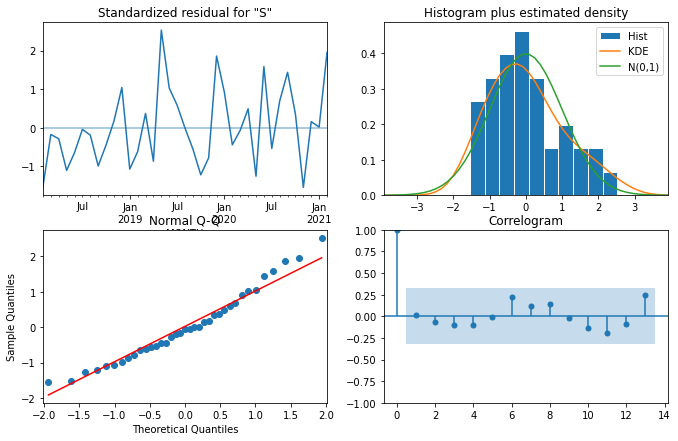

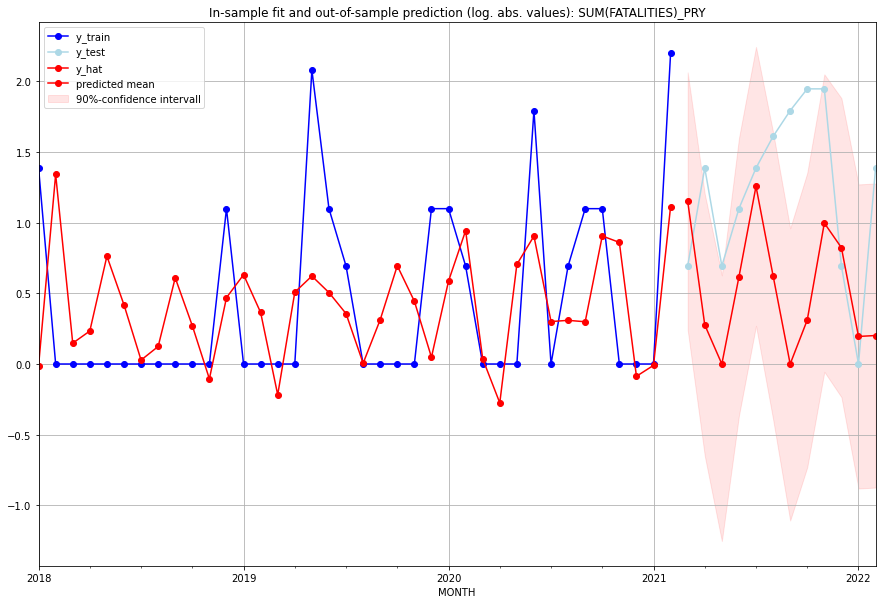

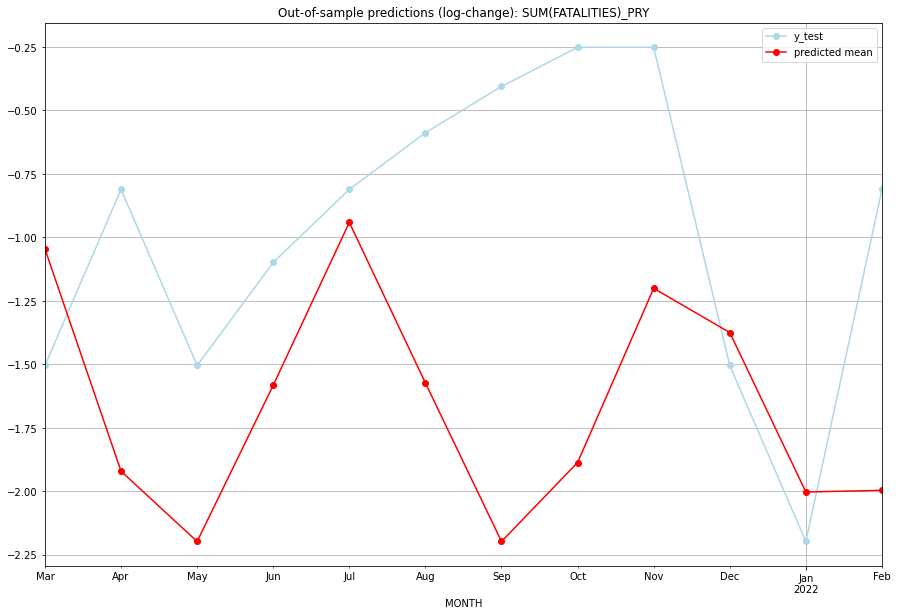

TADDA: 0.8120825944222455
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.163901         1.0     -1.045419       -1.504077   PRY   
1  2021-04-01  0.318679         3.0     -1.920594       -0.810930   PRY   
2  2021-05-01  0.000000         1.0     -2.197225       -1.504077   PRY   
3  2021-06-01  0.850049         2.0     -1.582013       -1.098612   PRY   
4  2021-07-01  2.512694         3.0     -0.940841       -0.810930   PRY   
5  2021-08-01  0.866915         4.0     -1.572937       -0.587787   PRY   
6  2021-09-01  0.000000         5.0     -2.197225       -0.405465   PRY   
7  2021-10-01  0.364726         6.0     -1.886271       -0.251314   PRY   
8  2021-11-01  1.709774         6.0     -1.200359       -0.251314   PRY   
9  2021-12-01  1.276854         1.0     -1.374430       -1.504077   PRY   
10 2022-01-01  0.215124         0.0     -2.002378       -2.197225   PRY   
11 2022-02-01  0.223224         3.0     -1.995735    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6243109002257534, 'fold_results': [0.5558930782790926, 0.5890733062474913, 0.9063137262875257, 0.44596349008890424]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_PSE   No. Observations:                   62
Model:                SARIMAX(0, 1, 0)   Log Likelihood                 -87.538
Date:                 Wed, 19 Oct 2022   AIC                            177.077
Time:                         11:03:50   BIC                            179.188
Sample:                     01-31-2016   HQIC                           177.904
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

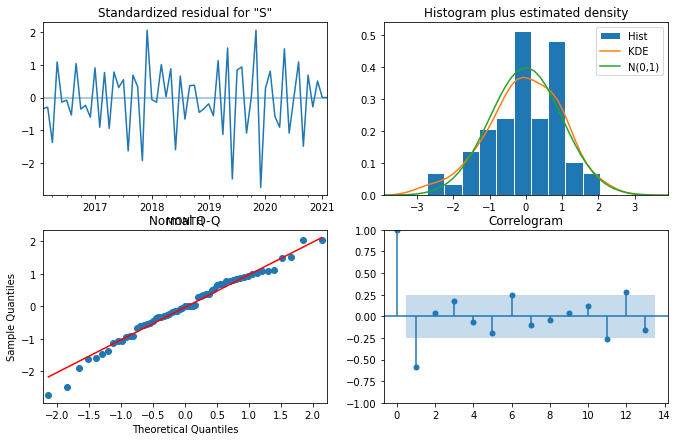

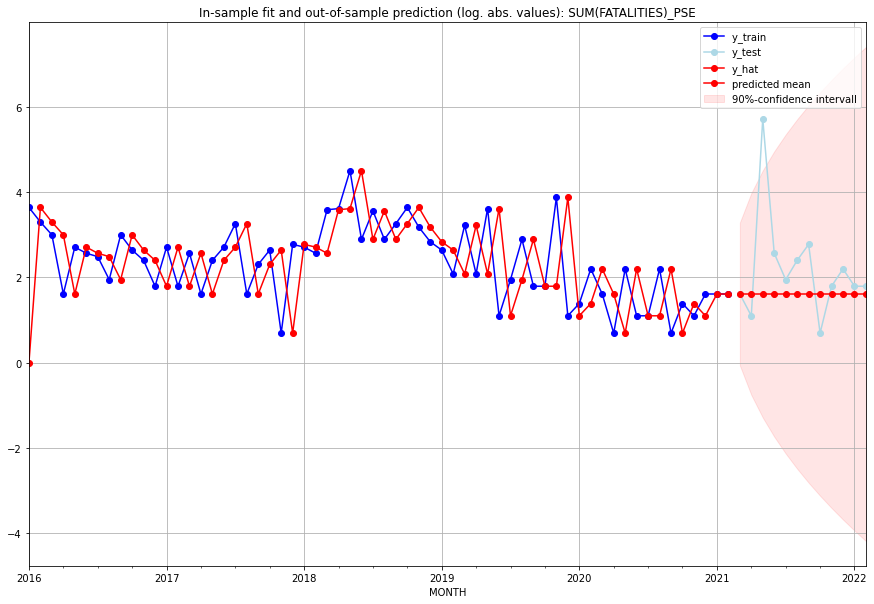

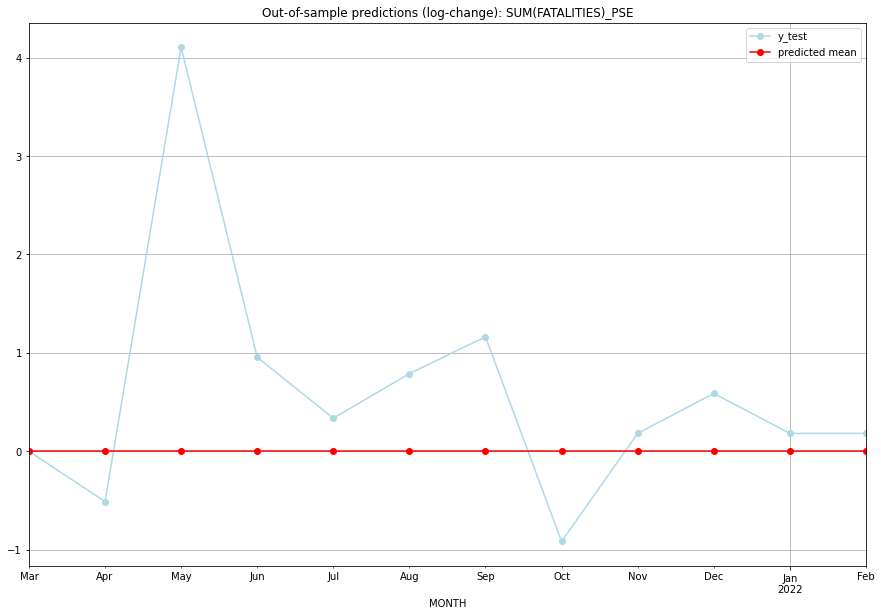

TADDA: 0.8258128696514998
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       4.0         4.0           0.0        0.000000   PSE   
1  2021-04-01       4.0         2.0           0.0       -0.510826   PSE   
2  2021-05-01       4.0       302.0           0.0        4.104295   PSE   
3  2021-06-01       4.0        12.0           0.0        0.955511   PSE   
4  2021-07-01       4.0         6.0           0.0        0.336472   PSE   
5  2021-08-01       4.0        10.0           0.0        0.788457   PSE   
6  2021-09-01       4.0        15.0           0.0        1.163151   PSE   
7  2021-10-01       4.0         1.0           0.0       -0.916291   PSE   
8  2021-11-01       4.0         5.0           0.0        0.182322   PSE   
9  2021-12-01       4.0         8.0           0.0        0.587787   PSE   
10 2022-01-01       4.0         5.0           0.0        0.182322   PSE   
11 2022-02-01       4.0         5.0           0.0    

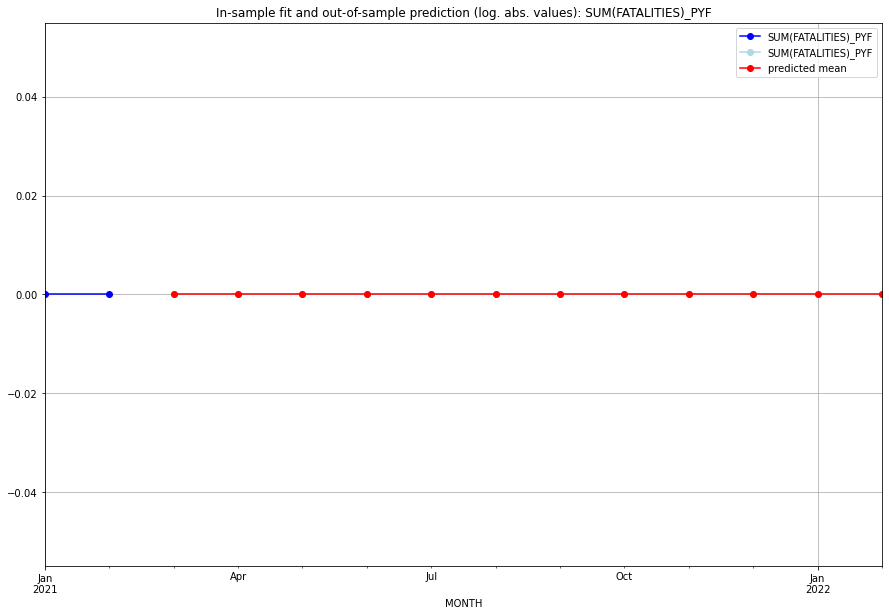

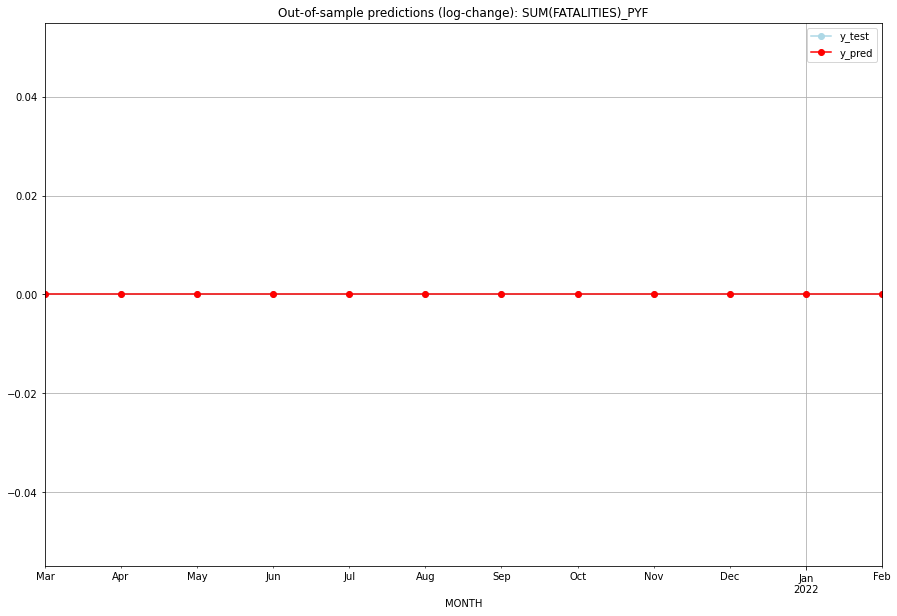

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   PYF   
1  2021-04-01       0.0         0.0           0.0             0.0   PYF   
2  2021-05-01       0.0         0.0           0.0             0.0   PYF   
3  2021-06-01       0.0         0.0           0.0             0.0   PYF   
4  2021-07-01       0.0         0.0           0.0             0.0   PYF   
5  2021-08-01       0.0         0.0           0.0             0.0   PYF   
6  2021-09-01       0.0         0.0           0.0             0.0   PYF   
7  2021-10-01       0.0         0.0           0.0             0.0   PYF   
8  2021-11-01       0.0         0.0           0.0             0.0   PYF   
9  2021-12-01       0.0         0.0           0.0             0.0   PYF   
10 2022-01-01       0.0         0.0           0.0             0.0   PYF   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

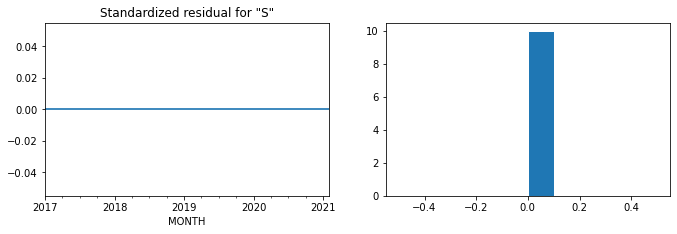

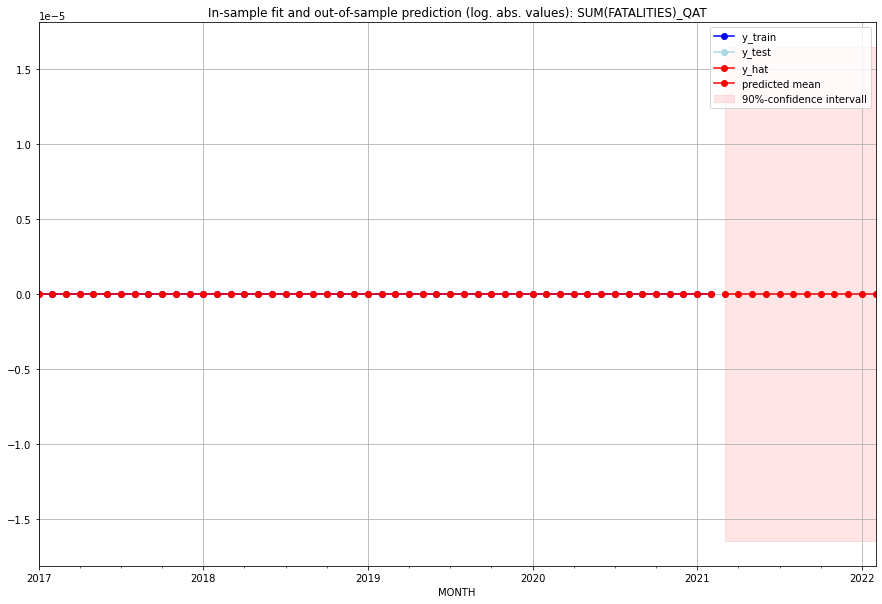

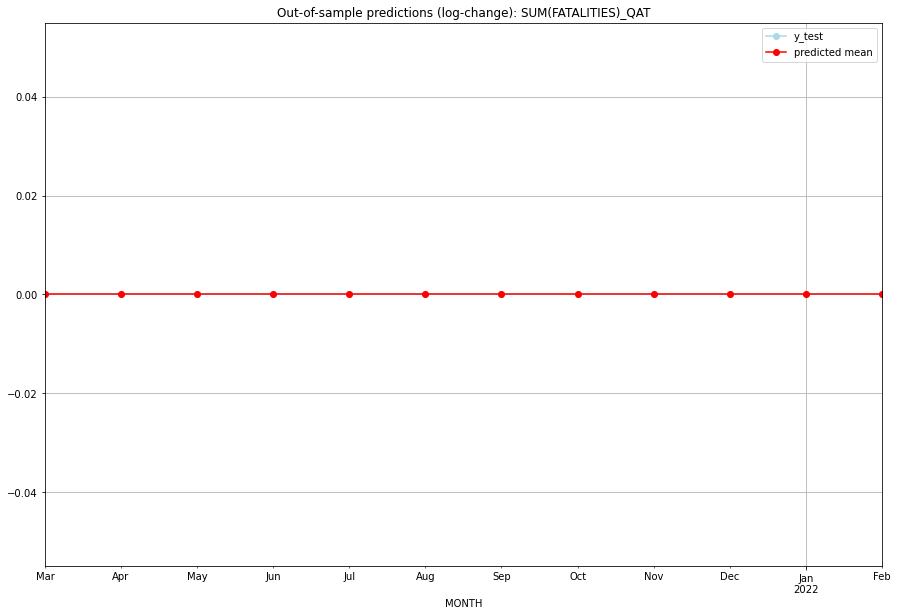

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   QAT   
1  2021-04-01       0.0         0.0           0.0             0.0   QAT   
2  2021-05-01       0.0         0.0           0.0             0.0   QAT   
3  2021-06-01       0.0         0.0           0.0             0.0   QAT   
4  2021-07-01       0.0         0.0           0.0             0.0   QAT   
5  2021-08-01       0.0         0.0           0.0             0.0   QAT   
6  2021-09-01       0.0         0.0           0.0             0.0   QAT   
7  2021-10-01       0.0         0.0           0.0             0.0   QAT   
8  2021-11-01       0.0         0.0           0.0             0.0   QAT   
9  2021-12-01       0.0         0.0           0.0             0.0   QAT   
10 2022-01-01       0.0         0.0           0.0             0.0   QAT   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

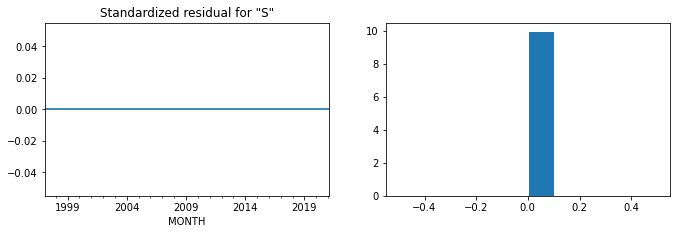

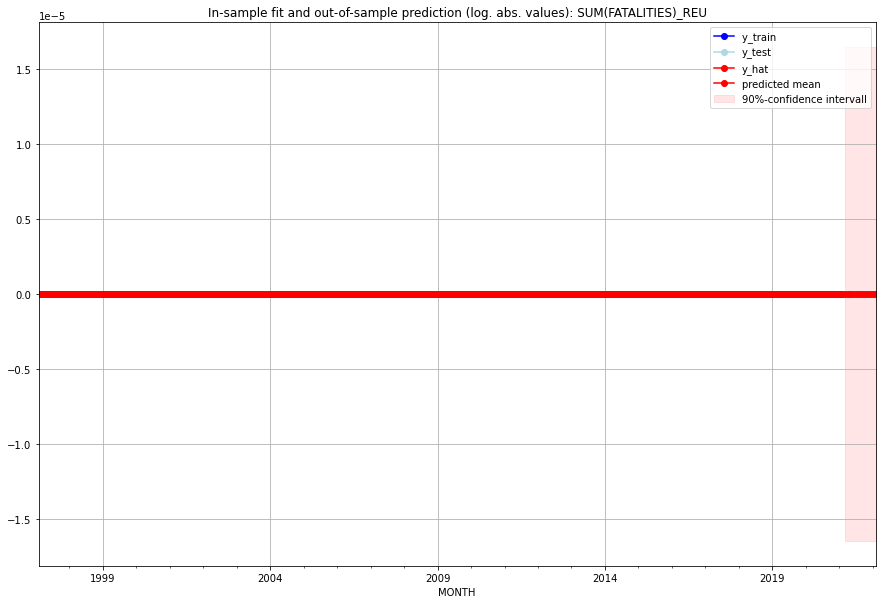

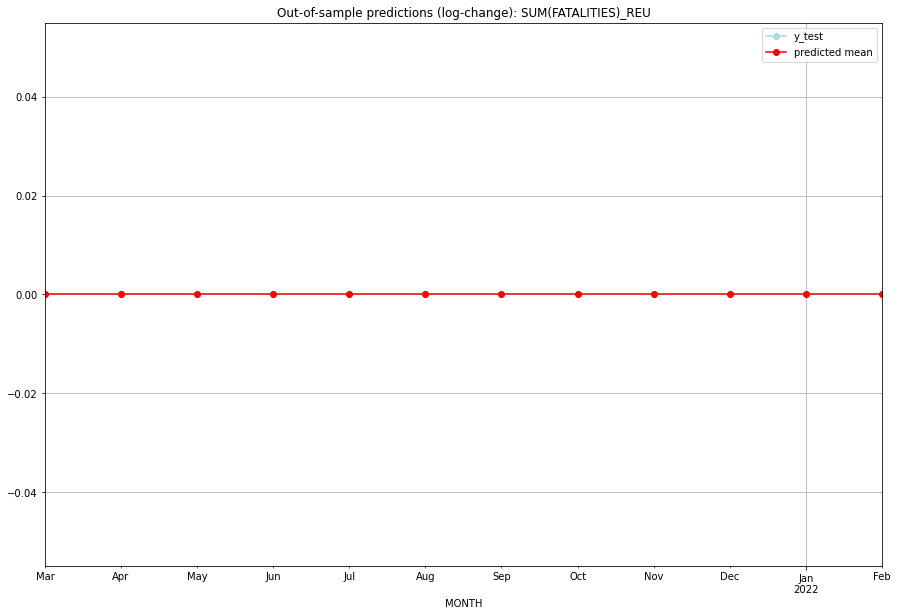

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   REU   
1  2021-04-01       0.0         0.0           0.0             0.0   REU   
2  2021-05-01       0.0         0.0           0.0             0.0   REU   
3  2021-06-01       0.0         0.0           0.0             0.0   REU   
4  2021-07-01       0.0         0.0           0.0             0.0   REU   
5  2021-08-01       0.0         0.0           0.0             0.0   REU   
6  2021-09-01       0.0         0.0           0.0             0.0   REU   
7  2021-10-01       0.0         0.0           0.0             0.0   REU   
8  2021-11-01       0.0         0.0           0.0             0.0   REU   
9  2021-12-01       0.0         0.0           0.0             0.0   REU   
10 2022-01-01       0.0         0.0           0.0             0.0   REU   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.08664339756999316, 'fold_results': [0.057762265046662105, 0.11552453009332421]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ROU   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                  -1.457
Date:                 Wed, 19 Oct 2022   AIC                              4.915
Time:                         11:04:12   BIC                              6.552
Sample:                     01-31-2018   HQIC                             5.497
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0632    

<Figure size 432x288 with 0 Axes>

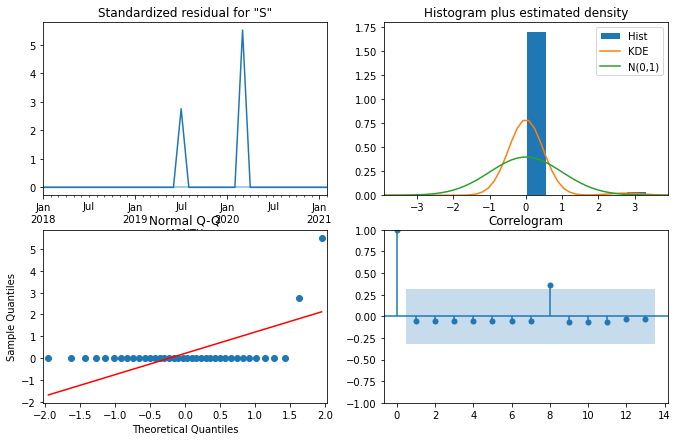

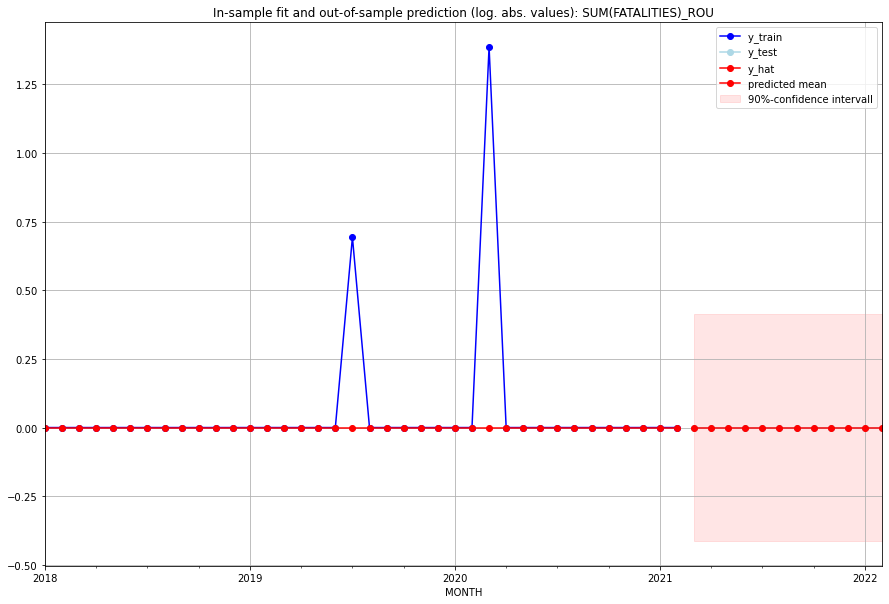

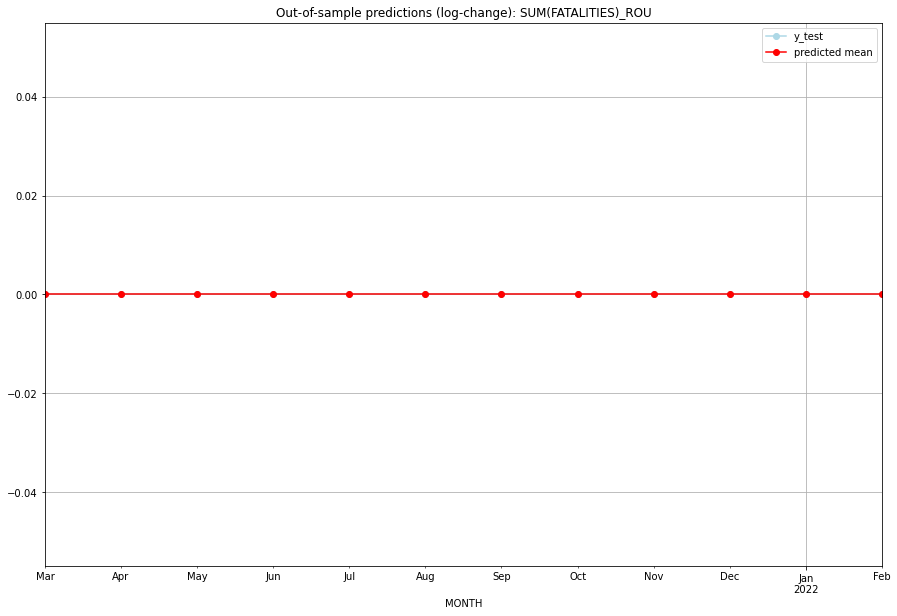

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   ROU   
1  2021-04-01       0.0         0.0           0.0             0.0   ROU   
2  2021-05-01       0.0         0.0           0.0             0.0   ROU   
3  2021-06-01       0.0         0.0           0.0             0.0   ROU   
4  2021-07-01       0.0         0.0           0.0             0.0   ROU   
5  2021-08-01       0.0         0.0           0.0             0.0   ROU   
6  2021-09-01       0.0         0.0           0.0             0.0   ROU   
7  2021-10-01       0.0         0.0           0.0             0.0   ROU   
8  2021-11-01       0.0         0.0           0.0             0.0   ROU   
9  2021-12-01       0.0         0.0           0.0             0.0   ROU   
10 2022-01-01       0.0         0.0           0.0             0.0   ROU   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.8121570663313893, 'fold_results': [nan, 0.8121570663313893]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_RUS   No. Observations:                   38
Model:                SARIMAX(3, 1, 3)   Log Likelihood                 -41.264
Date:                 Wed, 19 Oct 2022   AIC                            100.528
Time:                         11:04:21   BIC                            115.026
Sample:                     01-31-2018   HQIC                           105.639
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0381      0.063     -0.602 

<Figure size 432x288 with 0 Axes>

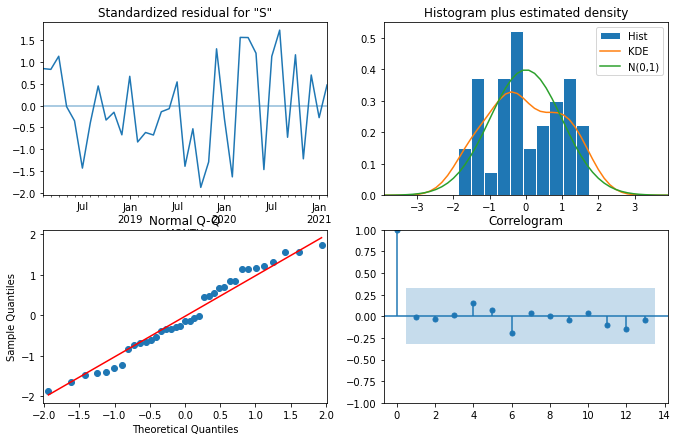

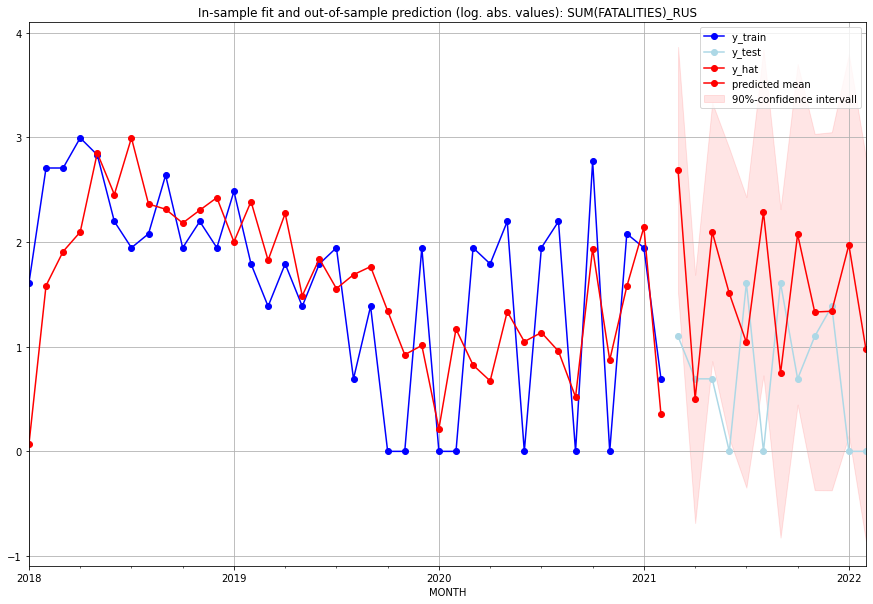

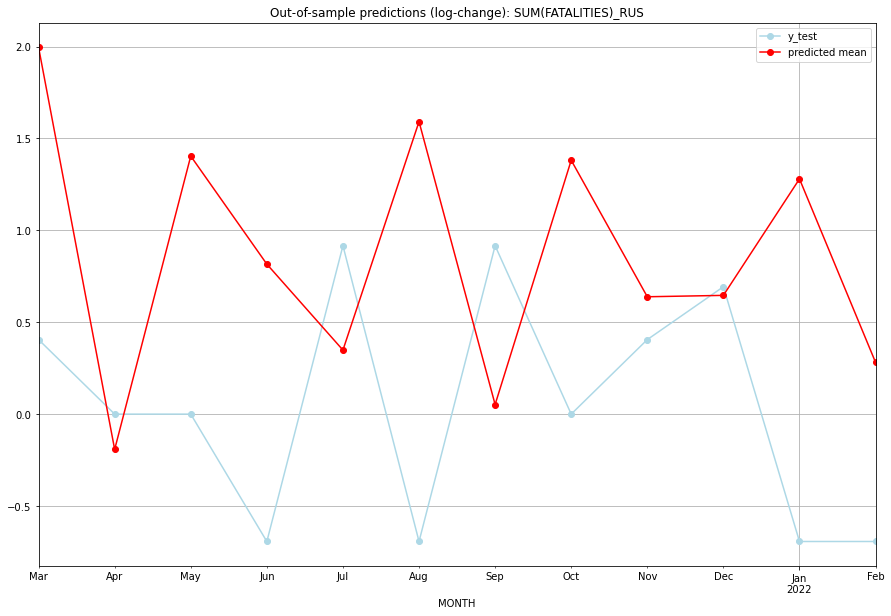

TADDA: 1.4158791222077658
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  13.719802         2.0      1.996046        0.405465   RUS   
1  2021-04-01   0.650440         1.0     -0.192105        0.000000   RUS   
2  2021-05-01   7.143809         1.0      1.404111        0.000000   RUS   
3  2021-06-01   3.523368         0.0      0.816110       -0.693147   RUS   
4  2021-07-01   1.833788         4.0      0.348467        0.916291   RUS   
5  2021-08-01   8.822496         0.0      1.591528       -0.693147   RUS   
6  2021-09-01   1.107178         4.0      0.052202        0.916291   RUS   
7  2021-10-01   6.960807         1.0      1.381383        0.000000   RUS   
8  2021-11-01   2.787661         2.0      0.638601        0.405465   RUS   
9  2021-12-01   2.816316         3.0      0.646138        0.693147   RUS   
10 2022-01-01   6.192194         0.0      1.279849       -0.693147   RUS   
11 2022-02-01   1.649899         0.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (2, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.7066442375762313, 'fold_results': [0.27009312910818933, 0.6778416786250664, 0.9165963913106087, 0.9407654316042398, 0.7279245572330524]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_RWA   No. Observations:                  289
Model:                SARIMAX(2, 0, 0)   Log Likelihood                -448.884
Date:                 Wed, 19 Oct 2022   AIC                            905.767
Time:                         11:04:43   BIC                            920.433
Sample:                     02-28-1997   HQIC                           911.644
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

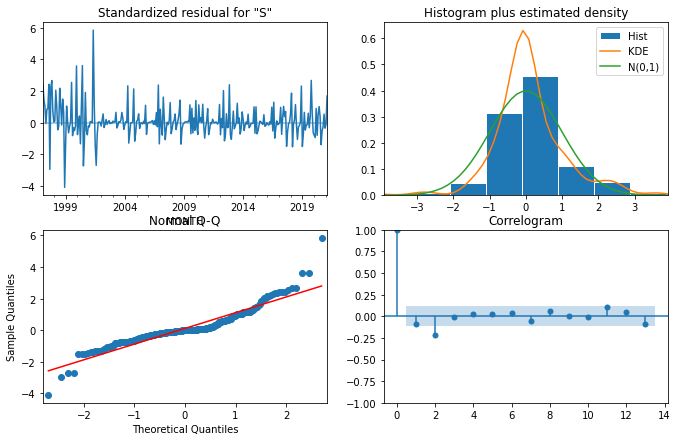

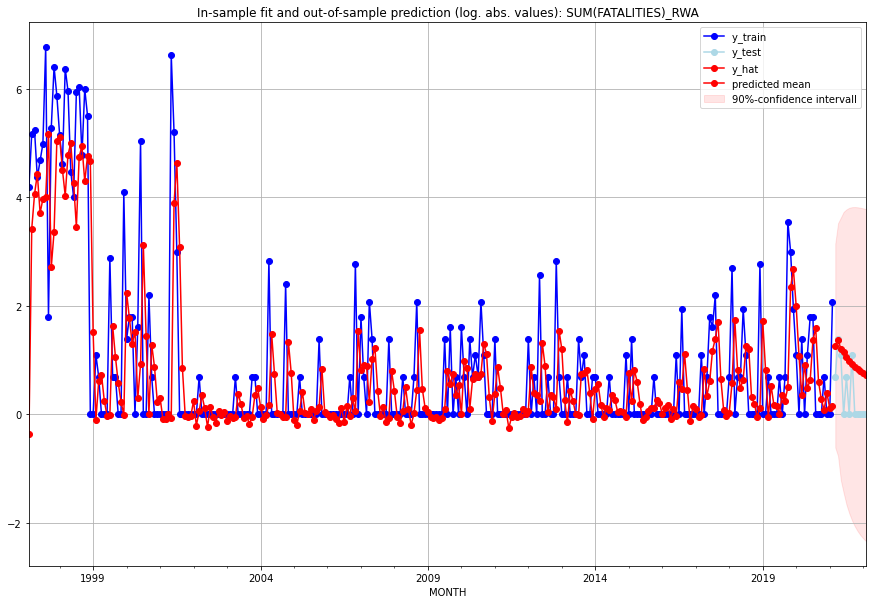

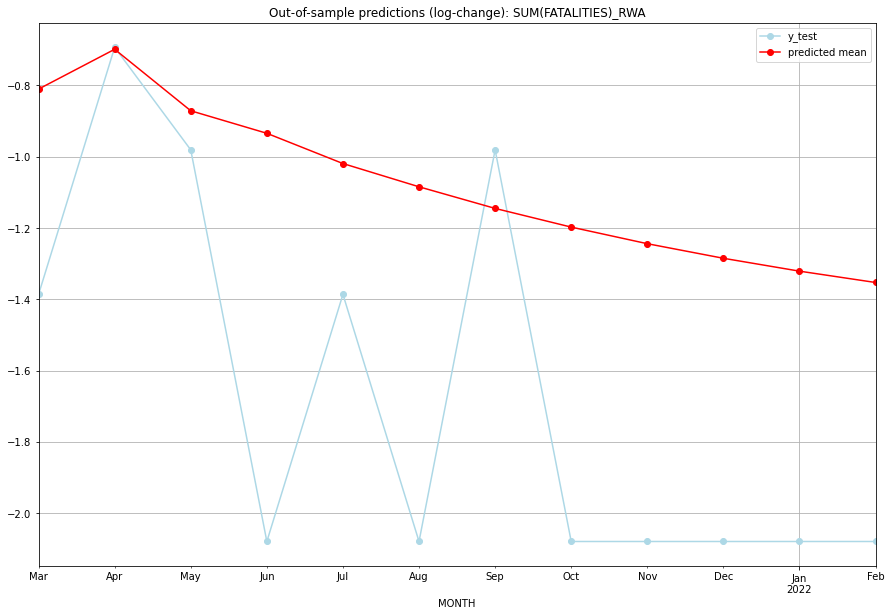

TADDA: 0.6132715778903757
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  2.557671         1.0     -0.810335       -1.386294   RWA   
1  2021-04-01  2.977878         3.0     -0.698693       -0.693147   RWA   
2  2021-05-01  2.347701         2.0     -0.871168       -0.980829   RWA   
3  2021-06-01  2.142691         0.0     -0.934362       -2.079442   RWA   
4  2021-07-01  1.887050         1.0     -1.019206       -1.386294   RWA   
5  2021-08-01  1.704728         0.0     -1.084440       -2.079442   RWA   
6  2021-09-01  1.545591         2.0     -1.145079       -0.980829   RWA   
7  2021-10-01  1.415575         0.0     -1.197504       -2.079442   RWA   
8  2021-11-01  1.305707         0.0     -1.244054       -2.079442   RWA   
9  2021-12-01  1.213254         0.0     -1.284978       -2.079442   RWA   
10 2022-01-01  1.134757         0.0     -1.321089       -2.079442   RWA   
11 2022-02-01  1.067899         0.0     -1.352909    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.7691544659353295, 'fold_results': [1.2624509409372646, 0.31430108805742735, 0.45714533974261173, 1.0427204950040148, nan]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SAU   No. Observations:                   74
Model:                SARIMAX(2, 0, 2)   Log Likelihood                -116.883
Date:                 Wed, 19 Oct 2022   AIC                            247.765
Time:                         11:05:04   BIC                            263.894
Sample:                     01-31-2015   HQIC                           254.199
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

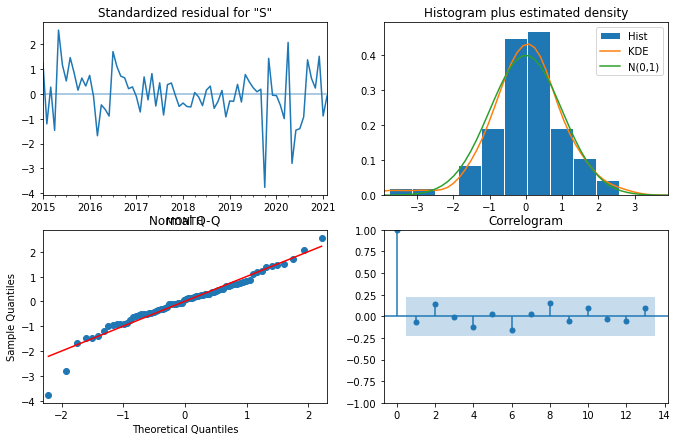

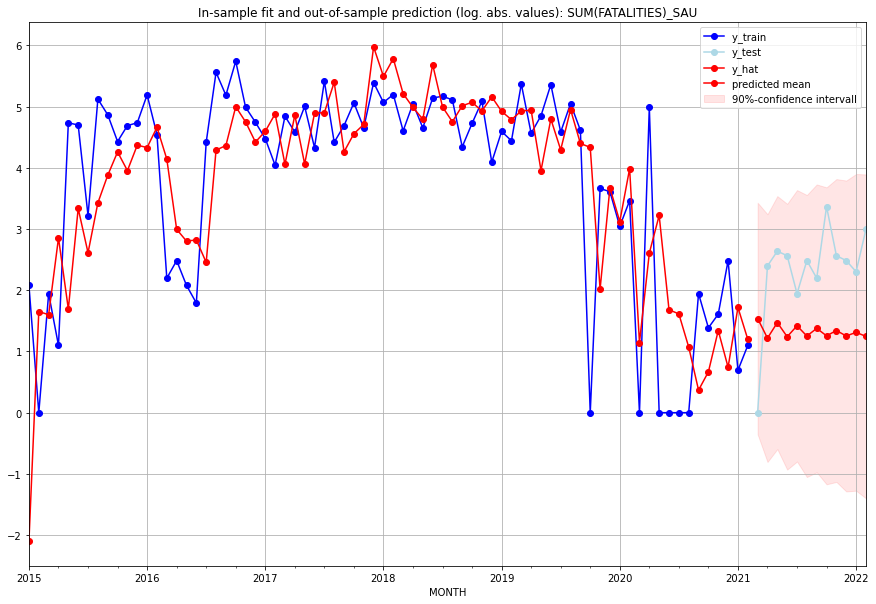

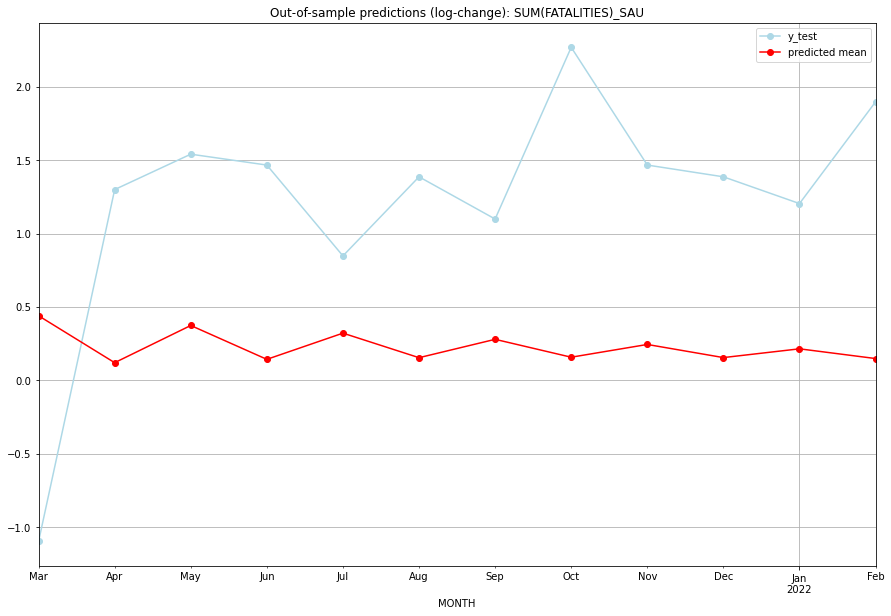

TADDA: 1.2942702646587825
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  3.655520         0.0      0.439441       -1.098612   SAU   
1  2021-04-01  2.381770        10.0      0.119787        1.299283   SAU   
2  2021-05-01  3.357417        13.0      0.373267        1.540445   SAU   
3  2021-06-01  2.459496        12.0      0.142511        1.466337   SAU   
4  2021-07-01  3.135764         6.0      0.321060        0.847298   SAU   
5  2021-08-01  2.498830        11.0      0.153816        1.386294   SAU   
6  2021-09-01  2.964961         8.0      0.278884        1.098612   SAU   
7  2021-10-01  2.510075        28.0      0.157025        2.268684   SAU   
8  2021-11-01  2.828758        12.0      0.243928        1.466337   SAU   
9  2021-12-01  2.501252        11.0      0.154508        1.386294   SAU   
10 2022-01-01  2.716554         9.0      0.214185        1.203973   SAU   
11 2022-02-01  2.478393        19.0      0.147958    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.7196842532262098, 'fold_results': [0.9112838006798712, 0.584747358002045, 0.7385361990671423, 0.5310115579559673, 0.8328423504260228]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SDN   No. Observations:                  289
Model:                SARIMAX(2, 0, 1)   Log Likelihood                -498.135
Date:                 Wed, 19 Oct 2022   AIC                           1008.269
Time:                         11:05:35   BIC                           1030.268
Sample:                     02-28-1997   HQIC                          1017.084
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

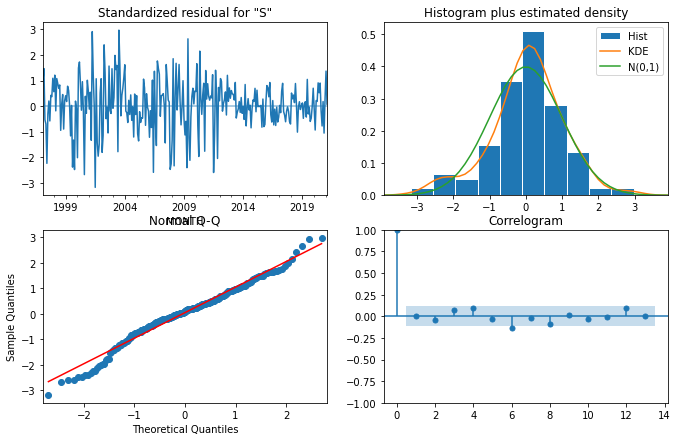

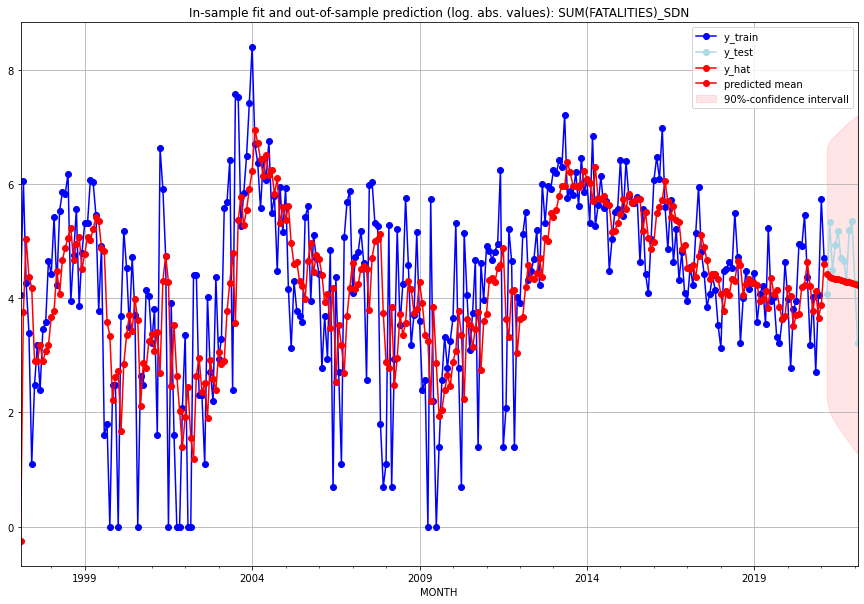

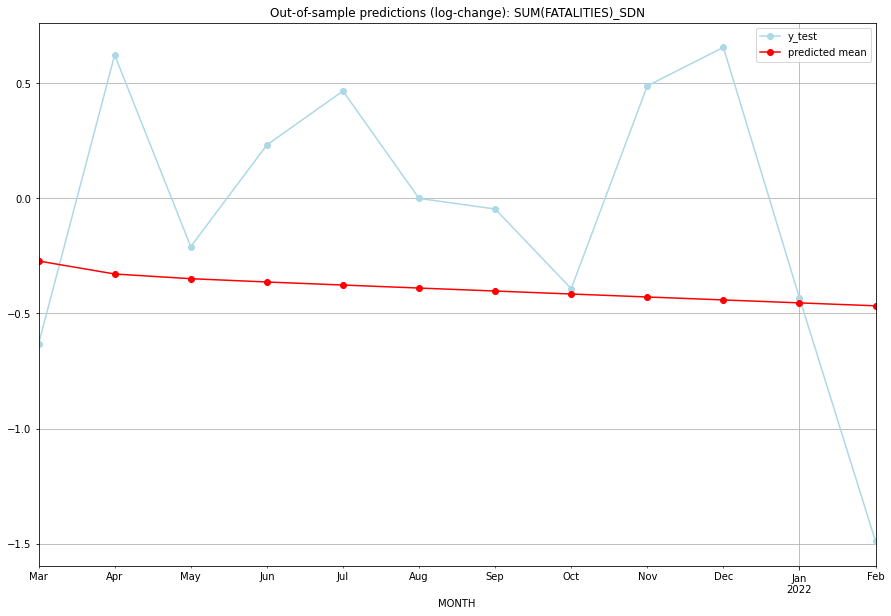

TADDA: 0.7213122492163982
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  83.561985        58.0     -0.272045       -0.631993   SDN   
1  2021-04-01  78.922363       206.0     -0.328474        0.623189   SDN   
2  2021-05-01  77.310296        89.0     -0.348851       -0.209721   SDN   
3  2021-06-01  76.197085       139.0     -0.363169        0.232112   SDN   
4  2021-07-01  75.179582       176.0     -0.376437        0.466620   SDN   
5  2021-08-01  74.191447       110.0     -0.389493        0.000000   SDN   
6  2021-09-01  73.221496       105.0     -0.402476       -0.046091   SDN   
7  2021-10-01  72.267631        74.0     -0.415411       -0.392042   SDN   
8  2021-11-01  71.329262       180.0     -0.428301        0.488967   SDN   
9  2021-12-01  70.406049       213.0     -0.441148        0.656446   SDN   
10 2022-01-01  69.497700        71.0     -0.453950       -0.432864   SDN   
11 2022-02-01  68.603936        24.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 0, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.31478555131716485, 'fold_results': [0.5413010246017241, 0.28881132523331055, 0.41140006953710007, 0.18310204811135164, 0.1493132891023379]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SEN   No. Observations:                  289
Model:                SARIMAX(0, 0, 2)   Log Likelihood                -434.034
Date:                 Wed, 19 Oct 2022   AIC                            876.069
Time:                         11:05:54   BIC                            890.734
Sample:                     02-28-1997   HQIC                           881.945
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------

<Figure size 432x288 with 0 Axes>

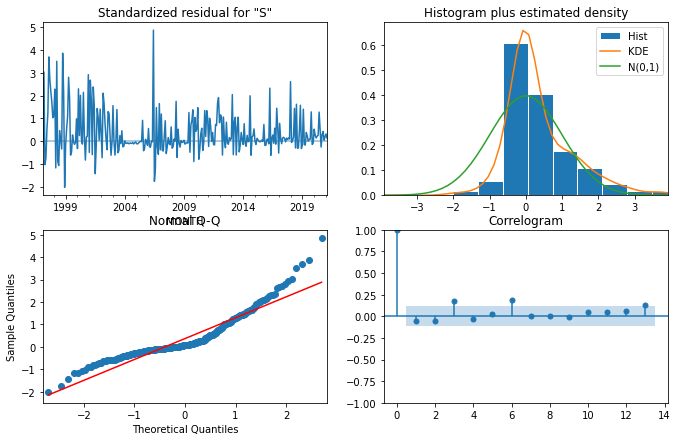

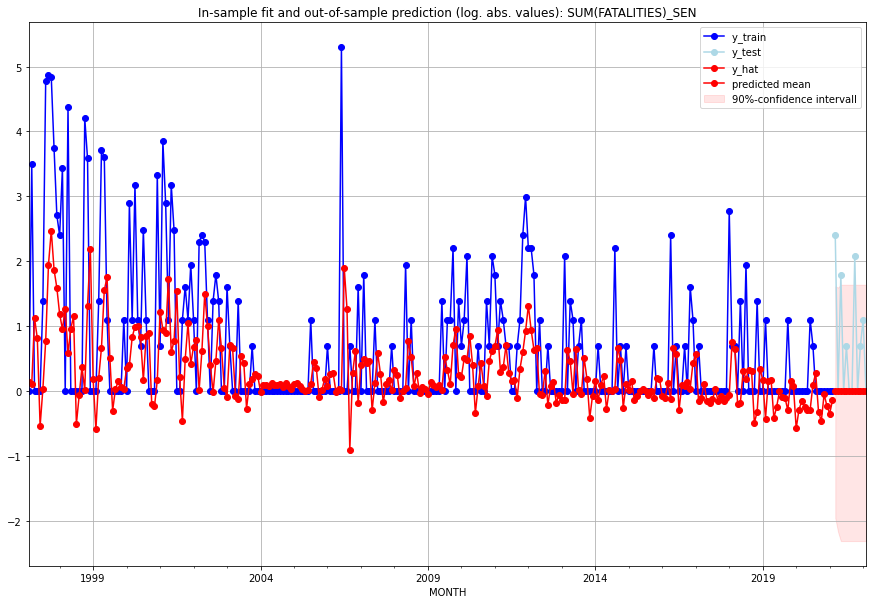

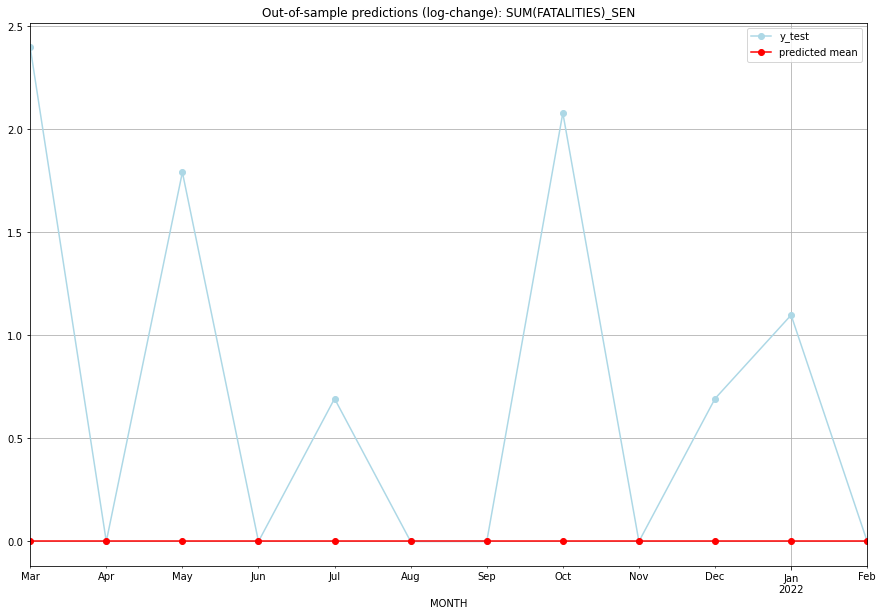

TADDA: 0.7295002444578551
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0        10.0           0.0        2.397895   SEN   
1  2021-04-01       0.0         0.0           0.0        0.000000   SEN   
2  2021-05-01       0.0         5.0           0.0        1.791759   SEN   
3  2021-06-01       0.0         0.0           0.0        0.000000   SEN   
4  2021-07-01       0.0         1.0           0.0        0.693147   SEN   
5  2021-08-01       0.0         0.0           0.0        0.000000   SEN   
6  2021-09-01       0.0         0.0           0.0        0.000000   SEN   
7  2021-10-01       0.0         7.0           0.0        2.079442   SEN   
8  2021-11-01       0.0         0.0           0.0        0.000000   SEN   
9  2021-12-01       0.0         1.0           0.0        0.693147   SEN   
10 2022-01-01       0.0         2.0           0.0        1.098612   SEN   
11 2022-02-01       0.0         0.0           0.0    

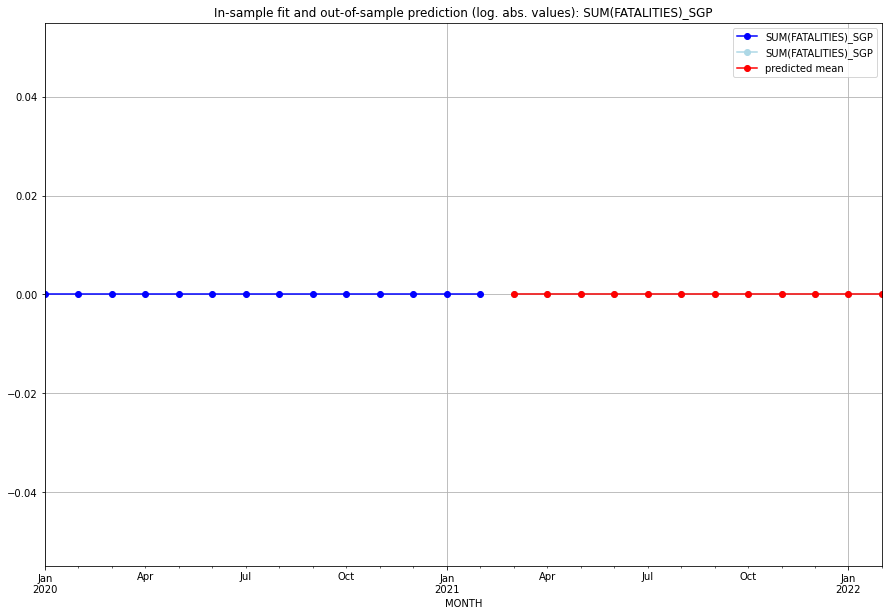

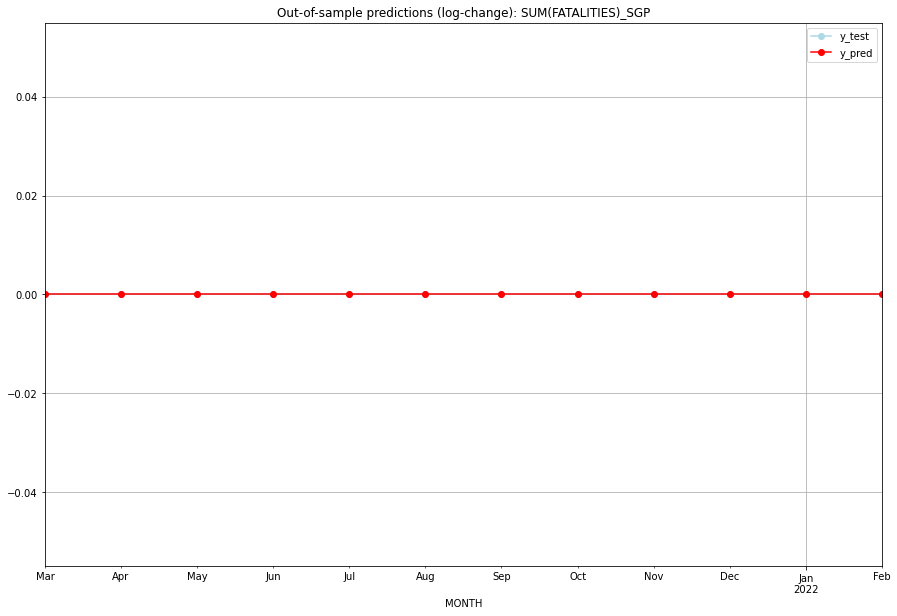

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SGP   
1  2021-04-01       0.0         0.0           0.0             0.0   SGP   
2  2021-05-01       0.0         0.0           0.0             0.0   SGP   
3  2021-06-01       0.0         0.0           0.0             0.0   SGP   
4  2021-07-01       0.0         0.0           0.0             0.0   SGP   
5  2021-08-01       0.0         0.0           0.0             0.0   SGP   
6  2021-09-01       0.0         0.0           0.0             0.0   SGP   
7  2021-10-01       0.0         0.0           0.0             0.0   SGP   
8  2021-11-01       0.0         0.0           0.0             0.0   SGP   
9  2021-12-01       0.0         0.0           0.0             0.0   SGP   
10 2022-01-01       0.0         0.0           0.0             0.0   SGP   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

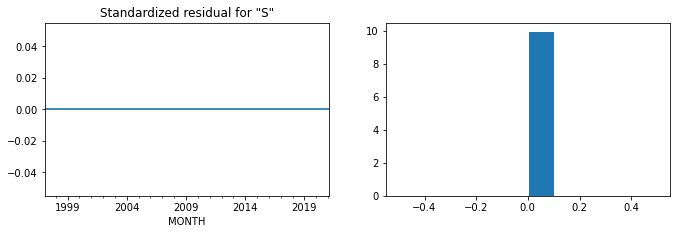

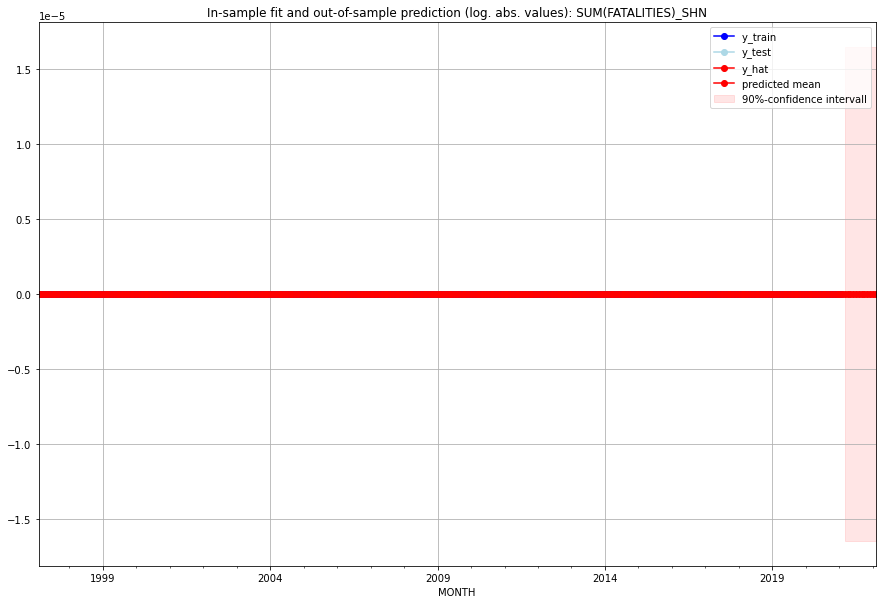

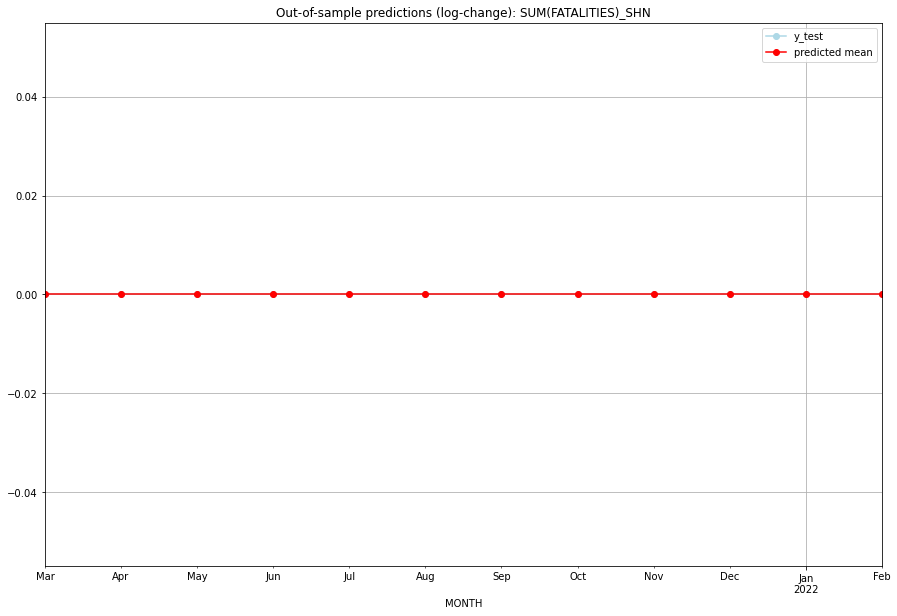

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SHN   
1  2021-04-01       0.0         0.0           0.0             0.0   SHN   
2  2021-05-01       0.0         0.0           0.0             0.0   SHN   
3  2021-06-01       0.0         0.0           0.0             0.0   SHN   
4  2021-07-01       0.0         0.0           0.0             0.0   SHN   
5  2021-08-01       0.0         0.0           0.0             0.0   SHN   
6  2021-09-01       0.0         0.0           0.0             0.0   SHN   
7  2021-10-01       0.0         0.0           0.0             0.0   SHN   
8  2021-11-01       0.0         0.0           0.0             0.0   SHN   
9  2021-12-01       0.0         0.0           0.0             0.0   SHN   
10 2022-01-01       0.0         0.0           0.0             0.0   SHN   
11 2022-02-01       0.0         0.0           0.0             0.0   

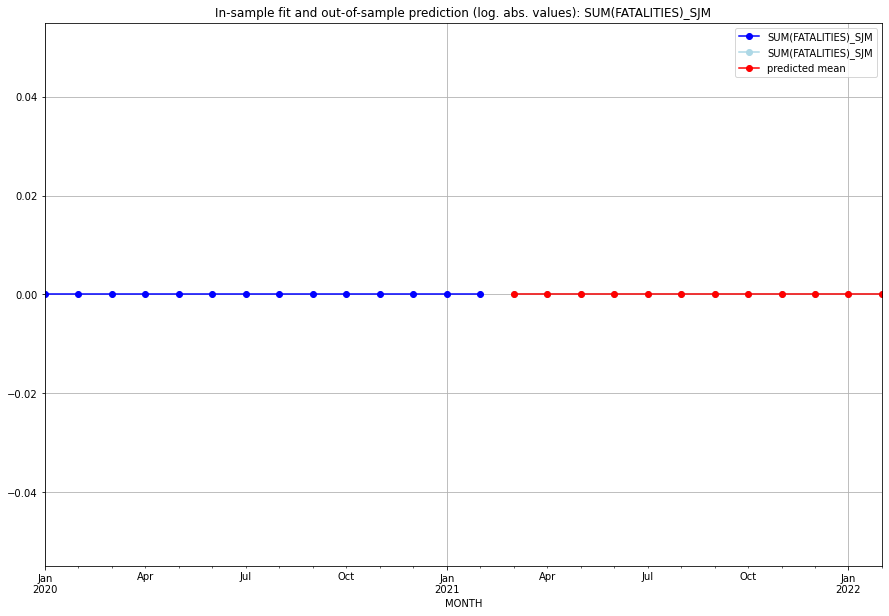

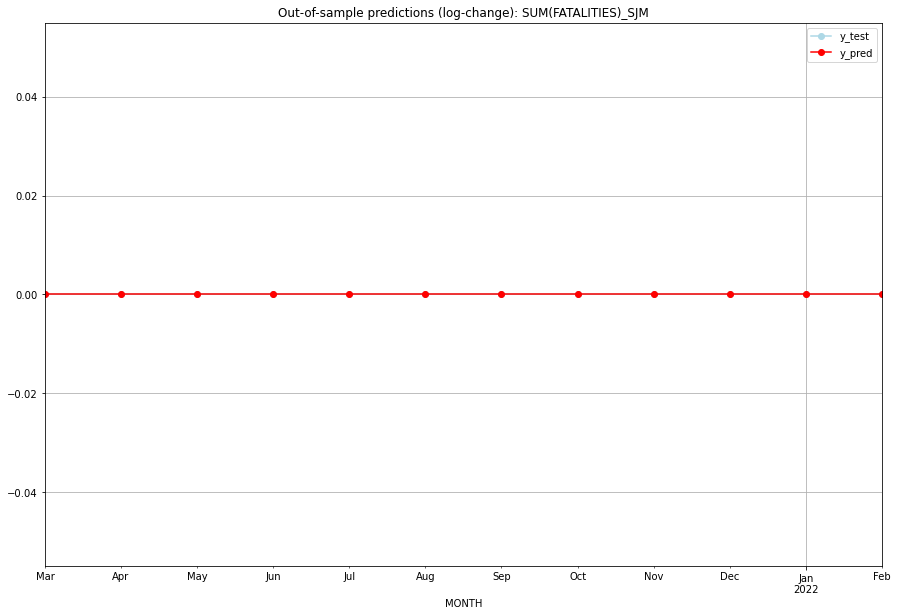

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SJM   
1  2021-04-01       0.0         0.0           0.0             0.0   SJM   
2  2021-05-01       0.0         0.0           0.0             0.0   SJM   
3  2021-06-01       0.0         0.0           0.0             0.0   SJM   
4  2021-07-01       0.0         0.0           0.0             0.0   SJM   
5  2021-08-01       0.0         0.0           0.0             0.0   SJM   
6  2021-09-01       0.0         0.0           0.0             0.0   SJM   
7  2021-10-01       0.0         0.0           0.0             0.0   SJM   
8  2021-11-01       0.0         0.0           0.0             0.0   SJM   
9  2021-12-01       0.0         0.0           0.0             0.0   SJM   
10 2022-01-01       0.0         0.0           0.0             0.0   SJM   
11 2022-02-01       0.0         0.0           0.0             0.0   

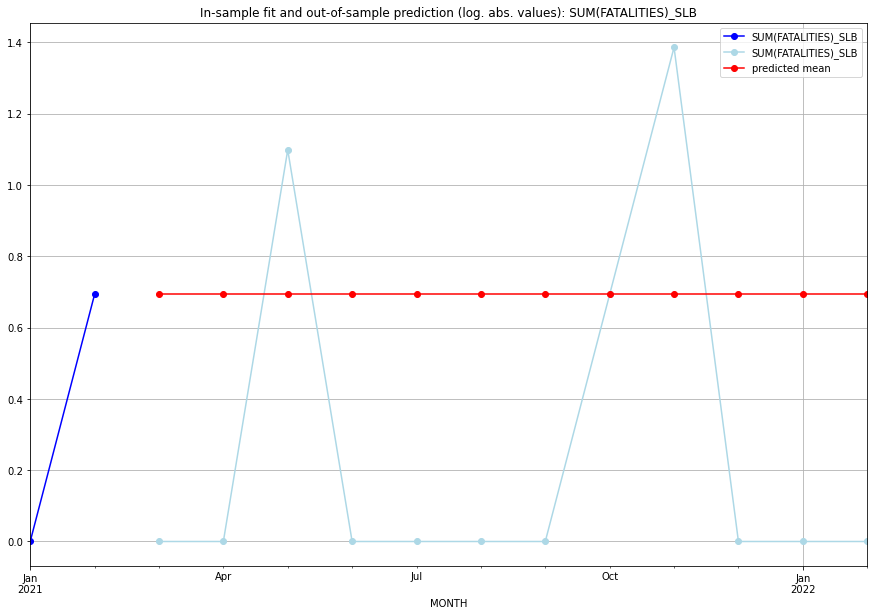

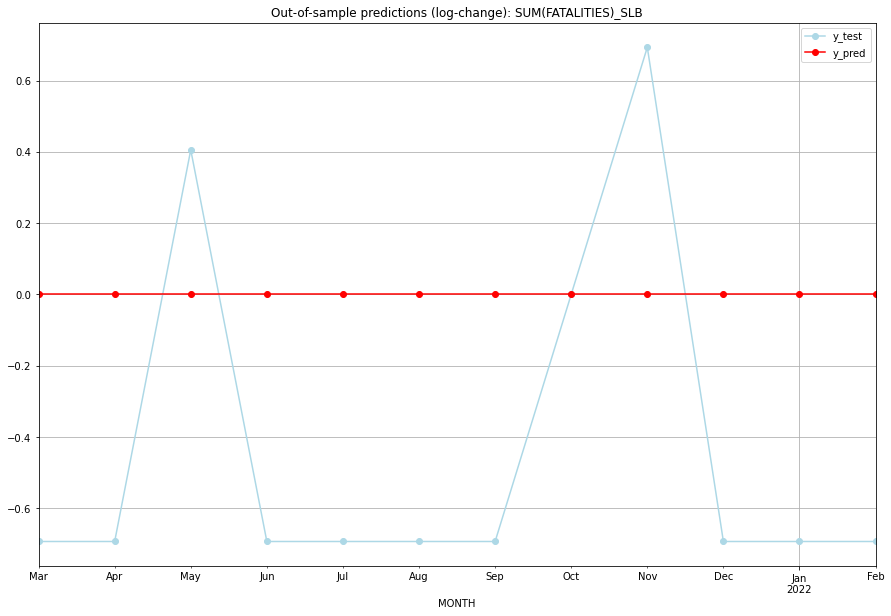

TADDA: 0.6114114094756348
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.693147    0.000000           0.0       -0.693147   SLB   
1  2021-04-01  0.693147    0.000000           0.0       -0.693147   SLB   
2  2021-05-01  0.693147    1.098612           0.0        0.405465   SLB   
3  2021-06-01  0.693147    0.000000           0.0       -0.693147   SLB   
4  2021-07-01  0.693147    0.000000           0.0       -0.693147   SLB   
5  2021-08-01  0.693147    0.000000           0.0       -0.693147   SLB   
6  2021-09-01  0.693147    0.000000           0.0       -0.693147   SLB   
7  2021-10-01  0.693147    0.693147           0.0        0.000000   SLB   
8  2021-11-01  0.693147    1.386294           0.0        0.693147   SLB   
9  2021-12-01  0.693147    0.000000           0.0       -0.693147   SLB   
10 2022-01-01  0.693147    0.000000           0.0       -0.693147   SLB   
11 2022-02-01  0.693147    0.000000           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5183132048188941, 'fold_results': [0.28343311513884334, 0.24127306107360666, 0.5199520493614457, 0.43145683944885116, 1.1154509590717236]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SLE   No. Observations:                  289
Model:                SARIMAX(2, 0, 1)   Log Likelihood                -220.979
Date:                 Wed, 19 Oct 2022   AIC                            449.958
Time:                         11:06:43   BIC                            464.624
Sample:                     02-28-1997   HQIC                           455.835
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

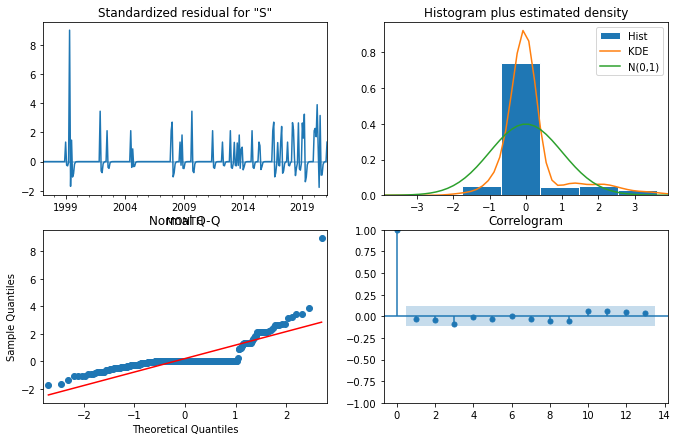

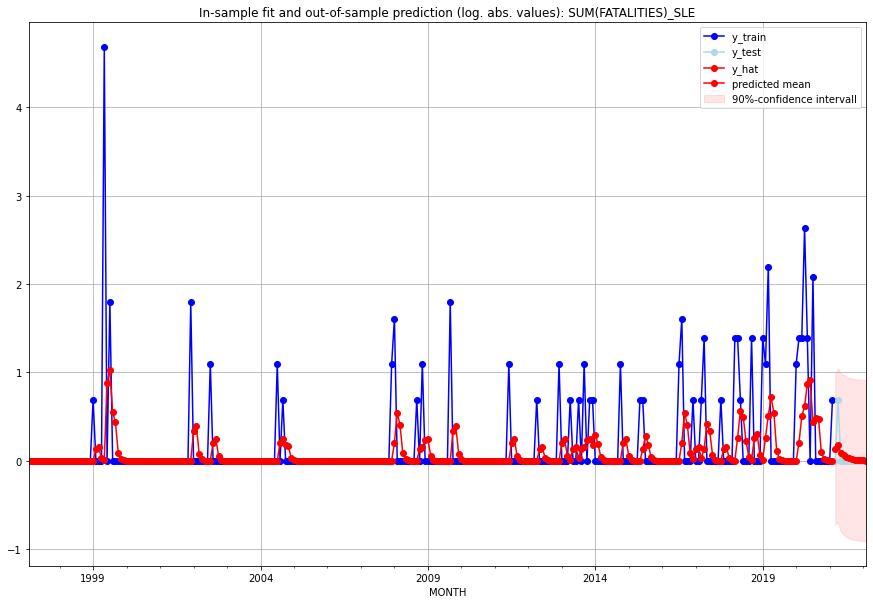

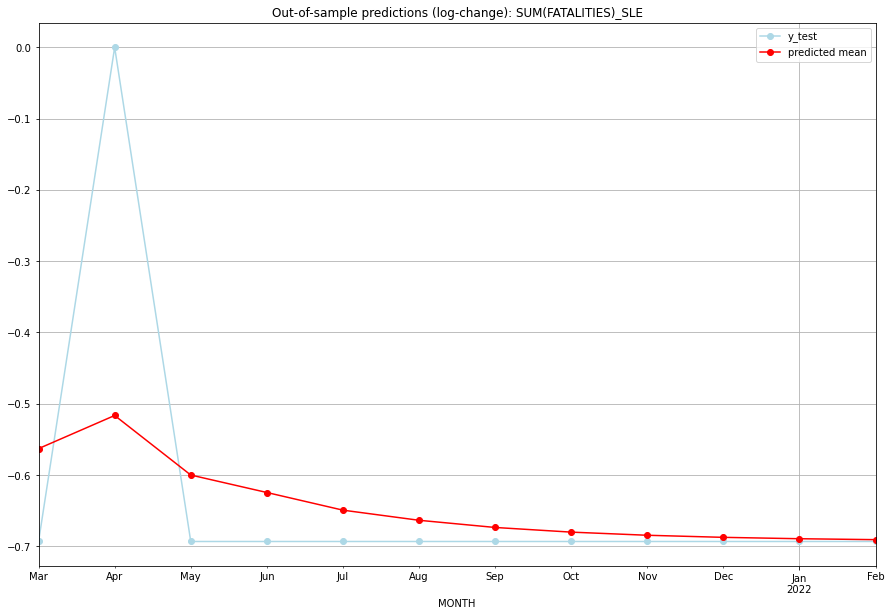

TADDA: 0.07801181161452965
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.139145         0.0     -0.562869       -0.693147   SLE   
1  2021-04-01  0.193318         1.0     -0.516410        0.000000   SLE   
2  2021-05-01  0.097707         0.0     -0.599924       -0.693147   SLE   
3  2021-06-01  0.071129         0.0     -0.624434       -0.693147   SLE   
4  2021-07-01  0.044926         0.0     -0.649202       -0.693147   SLE   
5  2021-08-01  0.030197         0.0     -0.663397       -0.693147   SLE   
6  2021-09-01  0.019870         0.0     -0.673472       -0.693147   SLE   
7  2021-10-01  0.013223         0.0     -0.680011       -0.693147   SLE   
8  2021-11-01  0.008775         0.0     -0.684411       -0.693147   SLE   
9  2021-12-01  0.005837         0.0     -0.687328       -0.693147   SLE   
10 2022-01-01  0.003882         0.0     -0.689273       -0.693147   SLE   
11 2022-02-01  0.002583         0.0     -0.690568   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.4602368817997323, 'fold_results': [0.38450830396988994, 0.5359654596295748]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SLV   No. Observations:                   38
Model:                SARIMAX(3, 1, 2)   Log Likelihood                 -10.033
Date:                 Wed, 19 Oct 2022   AIC                             38.067
Time:                         11:06:53   BIC                             52.565
Sample:                     01-31-2018   HQIC                            43.178
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0693      0

<Figure size 432x288 with 0 Axes>

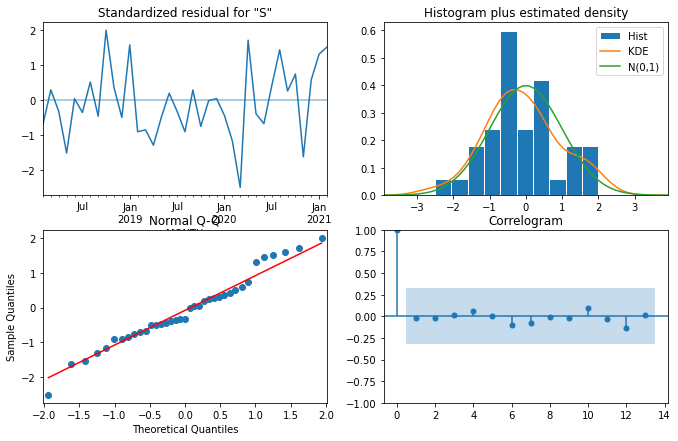

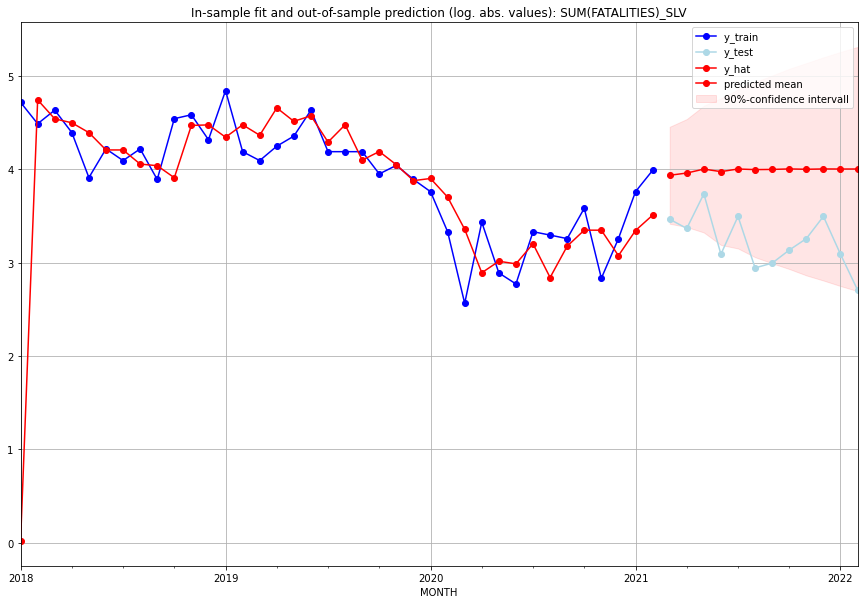

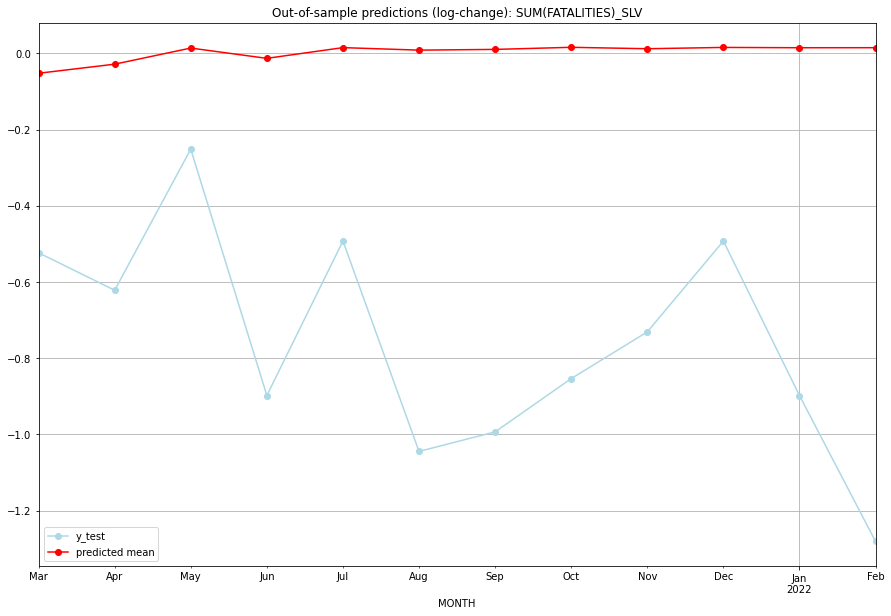

TADDA: 0.7691233651875348
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  50.255170        31.0     -0.052168       -0.523248   SLV   
1  2021-04-01  51.490392        28.0     -0.028354       -0.621688   SLV   
2  2021-05-01  53.758180        41.0      0.013943       -0.251314   SLV   
3  2021-06-01  52.300044        21.0     -0.013047       -0.897942   SLV   
4  2021-07-01  53.821038        32.0      0.015090       -0.492476   SLV   
5  2021-08-01  53.462216        18.0      0.008523       -1.044545   SLV   
6  2021-09-01  53.566100        19.0      0.010429       -0.993252   SLV   
7  2021-10-01  53.866514        22.0      0.015919       -0.853490   SLV   
8  2021-11-01  53.662469        25.0      0.012193       -0.730888   SLV   
9  2021-12-01  53.849538        32.0      0.015610       -0.492476   SLV   
10 2022-01-01  53.805446        21.0      0.014806       -0.897942   SLV   
11 2022-02-01  53.811424        14.0     

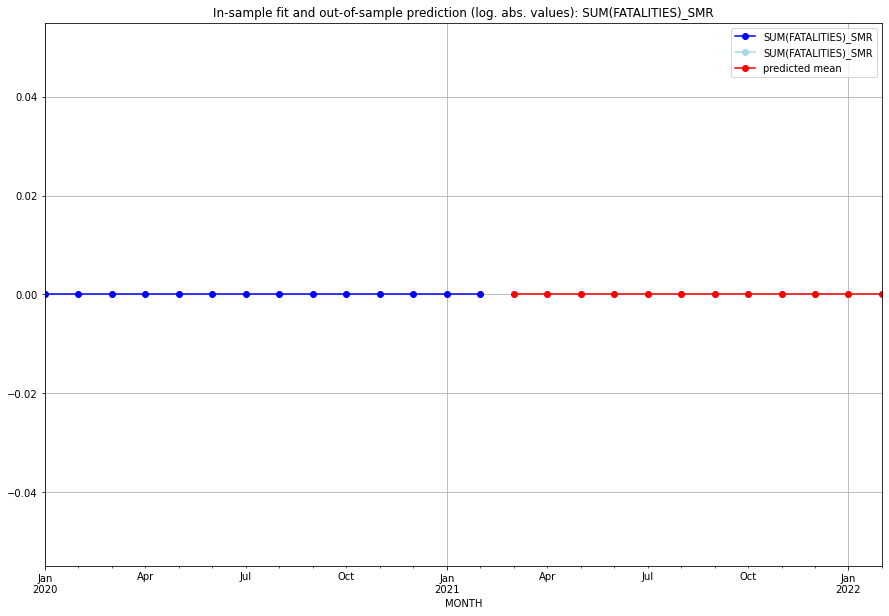

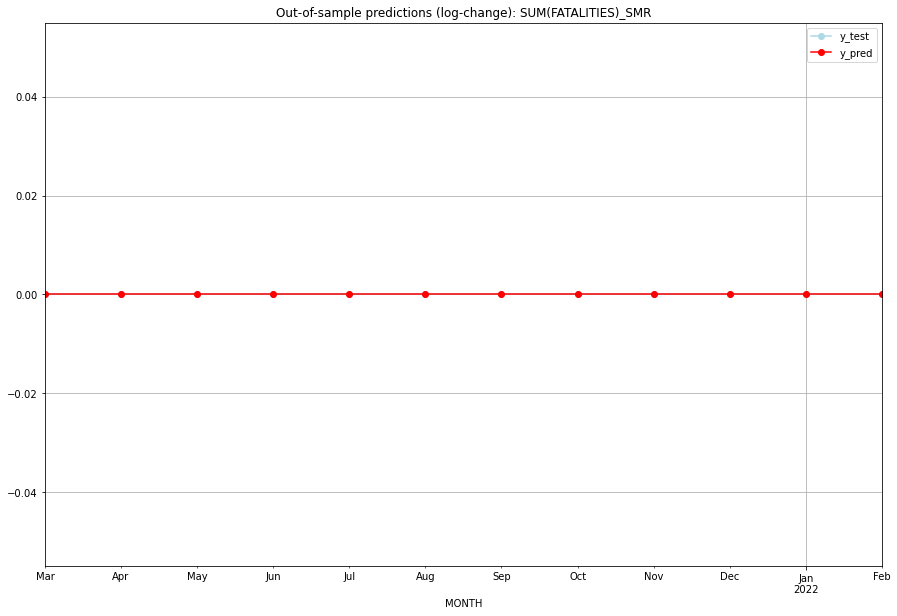

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SMR   
1  2021-04-01       0.0         0.0           0.0             0.0   SMR   
2  2021-05-01       0.0         0.0           0.0             0.0   SMR   
3  2021-06-01       0.0         0.0           0.0             0.0   SMR   
4  2021-07-01       0.0         0.0           0.0             0.0   SMR   
5  2021-08-01       0.0         0.0           0.0             0.0   SMR   
6  2021-09-01       0.0         0.0           0.0             0.0   SMR   
7  2021-10-01       0.0         0.0           0.0             0.0   SMR   
8  2021-11-01       0.0         0.0           0.0             0.0   SMR   
9  2021-12-01       0.0         0.0           0.0             0.0   SMR   
10 2022-01-01       0.0         0.0           0.0             0.0   SMR   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.23167300007808134, 'fold_results': [0.1651273091517115, 0.21798512924871657, 0.1793142319553159, 0.4907191836195352, 0.1052191464151276]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SOM   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -431.320
Date:                 Wed, 19 Oct 2022   AIC                            864.640
Time:                         11:07:19   BIC                            868.303
Sample:                     02-28-1997   HQIC                           866.108
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

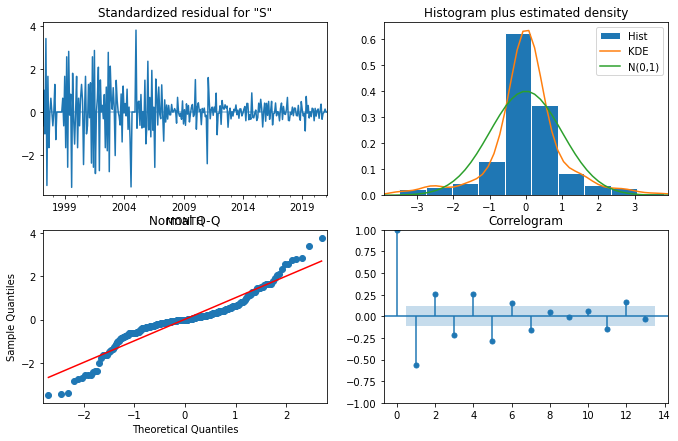

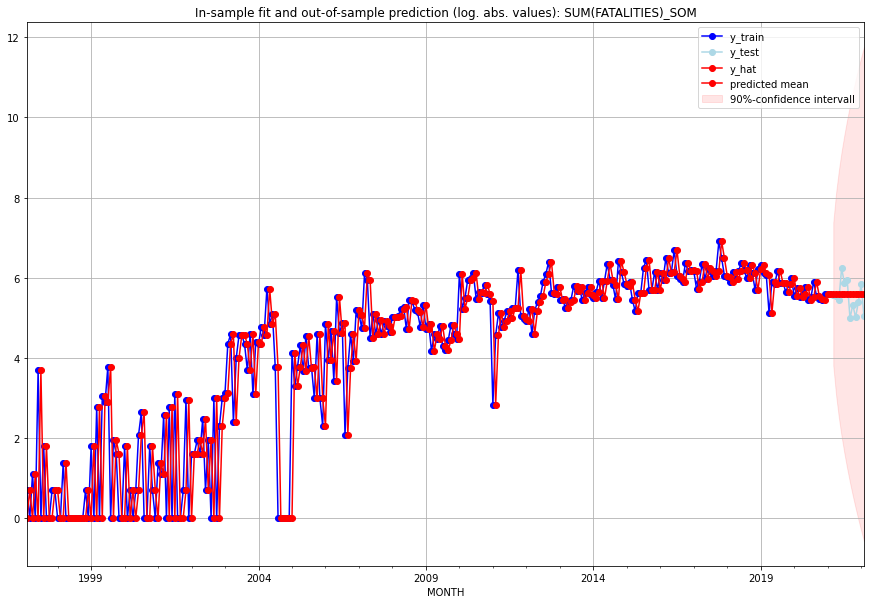

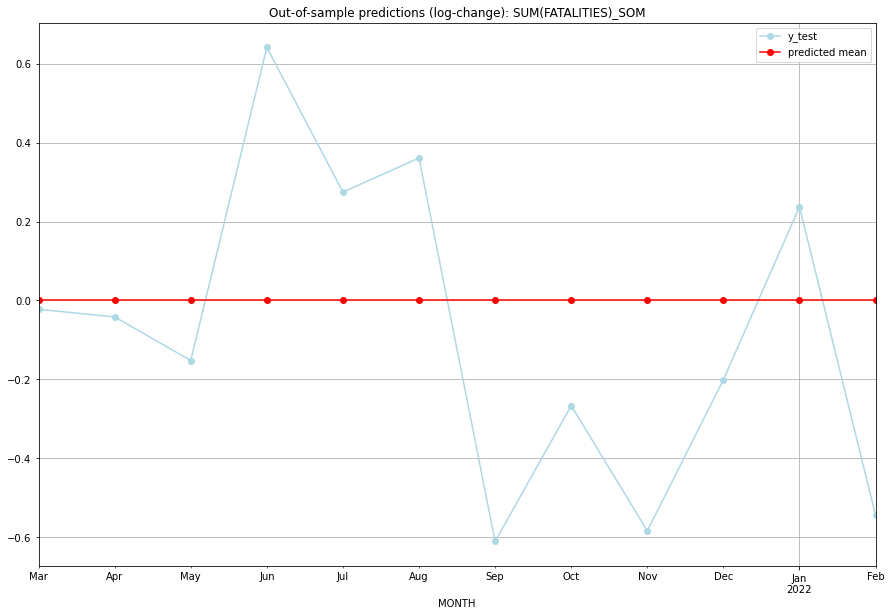

TADDA: 0.3282582418896612
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01     268.0       262.0           0.0       -0.022557   SOM   
1  2021-04-01     268.0       257.0           0.0       -0.041752   SOM   
2  2021-05-01     268.0       230.0           0.0       -0.152294   SOM   
3  2021-06-01     268.0       510.0           0.0        0.641658   SOM   
4  2021-07-01     268.0       353.0           0.0        0.274586   SOM   
5  2021-08-01     268.0       385.0           0.0        0.361126   SOM   
6  2021-09-01     268.0       145.0           0.0       -0.611105   SOM   
7  2021-10-01     268.0       205.0           0.0       -0.266835   SOM   
8  2021-11-01     268.0       149.0           0.0       -0.584076   SOM   
9  2021-12-01     268.0       219.0           0.0       -0.201084   SOM   
10 2022-01-01     268.0       340.0           0.0        0.237171   SOM   
11 2022-02-01     268.0       155.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.009953088880993714, 'fold_results': [nan, 0.009953088880993714]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SRB   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                  -4.313
Date:                 Wed, 19 Oct 2022   AIC                             22.626
Time:                         11:07:30   BIC                             33.902
Sample:                     01-31-2018   HQIC                            26.601
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0443      0.028      1.

<Figure size 432x288 with 0 Axes>

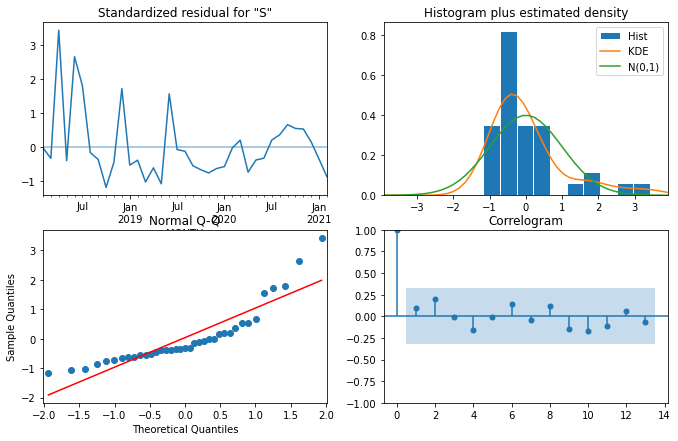

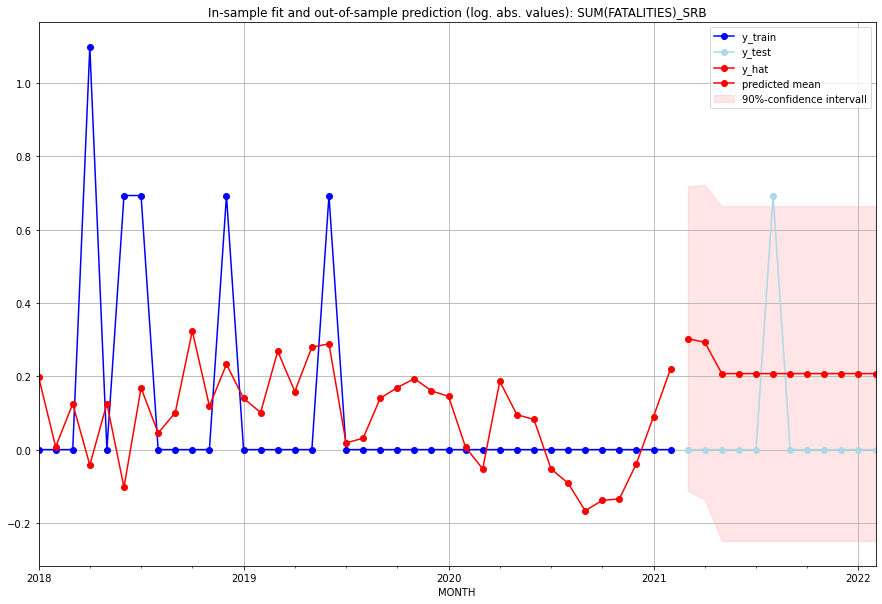

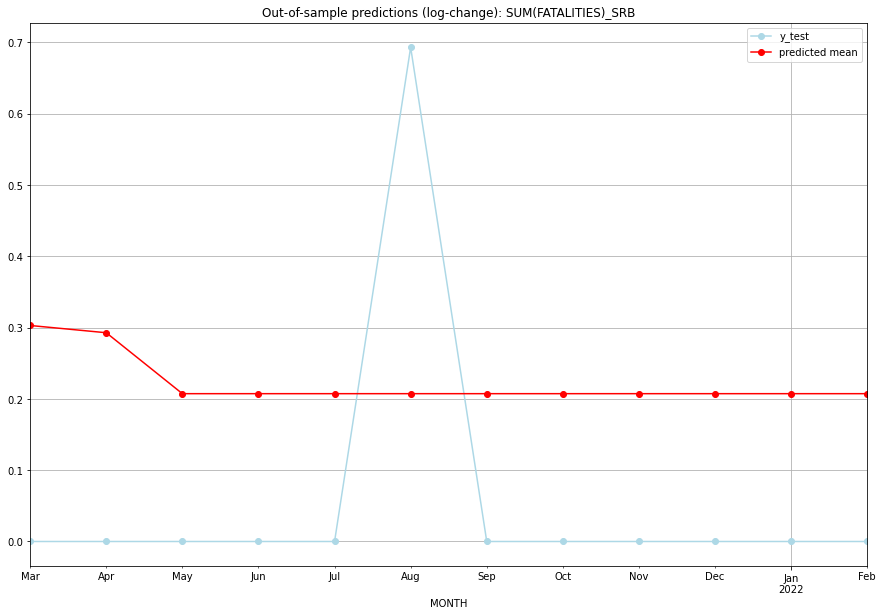

TADDA: 0.24562564103896448
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.353862         0.0      0.302961        0.000000   SRB   
1  2021-04-01  0.340167         0.0      0.292794        0.000000   SRB   
2  2021-05-01  0.230383         0.0      0.207326        0.000000   SRB   
3  2021-06-01  0.230383         0.0      0.207326        0.000000   SRB   
4  2021-07-01  0.230383         0.0      0.207326        0.000000   SRB   
5  2021-08-01  0.230383         1.0      0.207326        0.693147   SRB   
6  2021-09-01  0.230383         0.0      0.207326        0.000000   SRB   
7  2021-10-01  0.230383         0.0      0.207326        0.000000   SRB   
8  2021-11-01  0.230383         0.0      0.207326        0.000000   SRB   
9  2021-12-01  0.230383         0.0      0.207326        0.000000   SRB   
10 2022-01-01  0.230383         0.0      0.207326        0.000000   SRB   
11 2022-02-01  0.230383         0.0      0.207326   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.686366454478496, 'fold_results': [0.6197792332873515, 0.47714879712830743, 0.9603649924810657, 0.5537910948478973, 0.8207481546478581]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SSD   No. Observations:                  289
Model:                SARIMAX(0, 1, 1)   Log Likelihood                -556.025
Date:                 Wed, 19 Oct 2022   AIC                           1116.050
Time:                         11:07:47   BIC                           1123.376
Sample:                     02-28-1997   HQIC                          1118.986
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

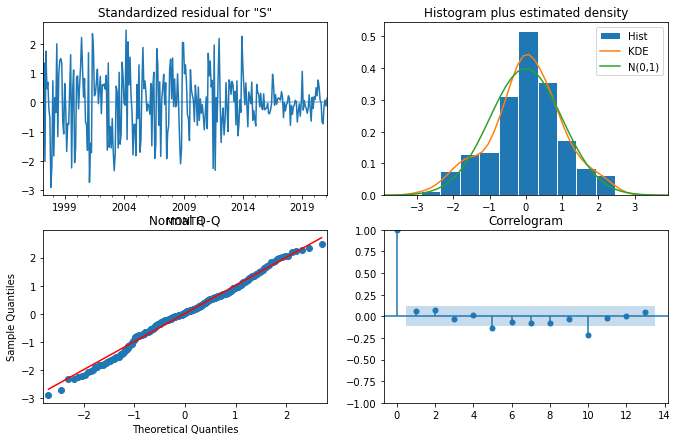

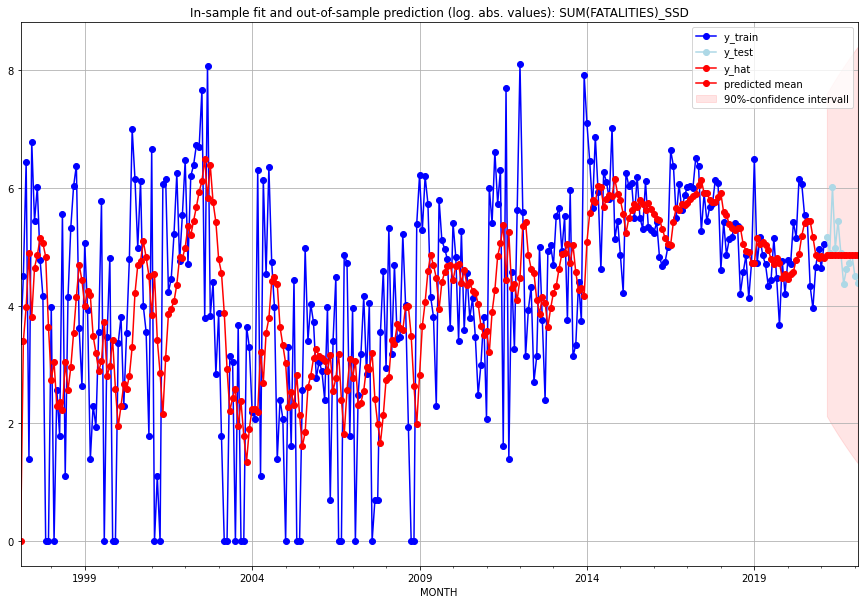

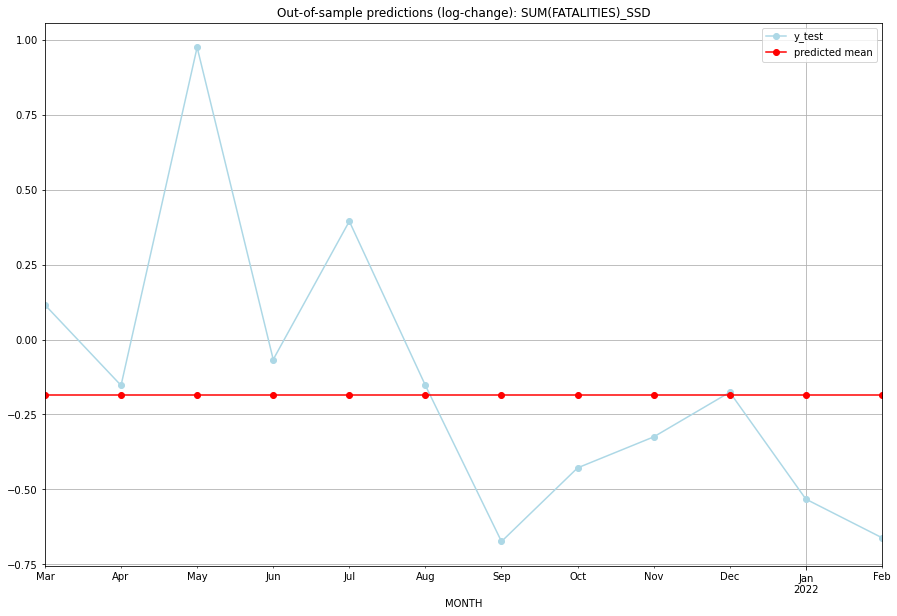

TADDA: 0.3730740627943927
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  127.975891       173.0       -0.1838        0.115630   SSD   
1  2021-04-01  127.975891       132.0       -0.1838       -0.153076   SSD   
2  2021-05-01  127.975891       410.0       -0.1838        0.975168   SSD   
3  2021-06-01  127.975891       144.0       -0.1838       -0.066691   SSD   
4  2021-07-01  127.975891       229.0       -0.1838        0.394654   SSD   
5  2021-08-01  127.975891       132.0       -0.1838       -0.153076   SSD   
6  2021-09-01  127.975891        78.0       -0.1838       -0.673977   SSD   
7  2021-10-01  127.975891       100.0       -0.1838       -0.428305   SSD   
8  2021-11-01  127.975891       111.0       -0.1838       -0.324926   SSD   
9  2021-12-01  127.975891       129.0       -0.1838       -0.175891   SSD   
10 2022-01-01  127.975891        90.0       -0.1838       -0.532566   SSD   
11 2022-02-01  127.975891    

<Figure size 432x288 with 0 Axes>

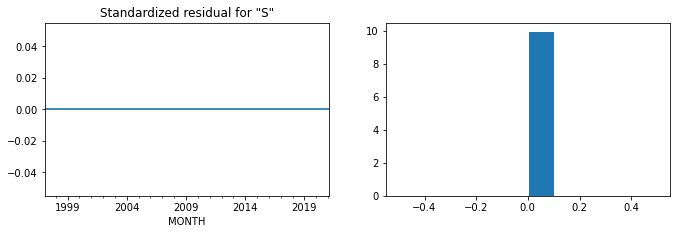

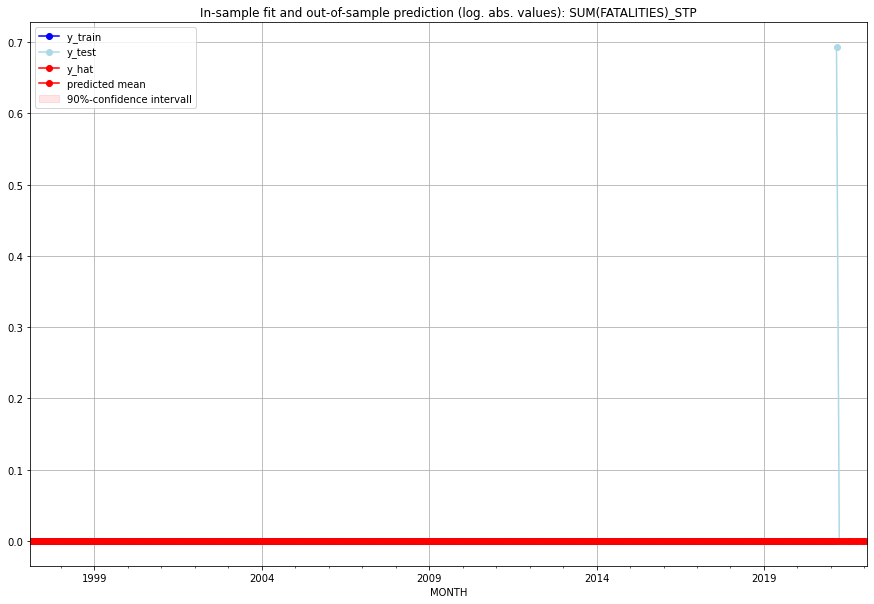

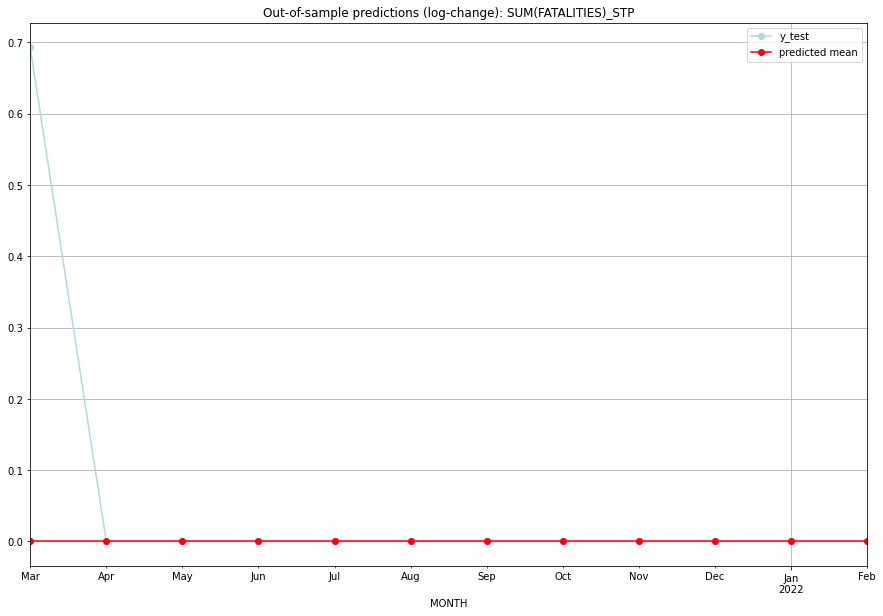

TADDA: 0.057762265046662105
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   STP   
1  2021-04-01       0.0         0.0           0.0        0.000000   STP   
2  2021-05-01       0.0         0.0           0.0        0.000000   STP   
3  2021-06-01       0.0         0.0           0.0        0.000000   STP   
4  2021-07-01       0.0         0.0           0.0        0.000000   STP   
5  2021-08-01       0.0         0.0           0.0        0.000000   STP   
6  2021-09-01       0.0         0.0           0.0        0.000000   STP   
7  2021-10-01       0.0         0.0           0.0        0.000000   STP   
8  2021-11-01       0.0         0.0           0.0        0.000000   STP   
9  2021-12-01       0.0         0.0           0.0        0.000000   STP   
10 2022-01-01       0.0         0.0           0.0        0.000000   STP   
11 2022-02-01       0.0         0.0           0.0  

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.19018117464449316, 'fold_results': [0.3226000842423242, 0.057762265046662105]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SUR   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                 -13.677
Date:                 Wed, 19 Oct 2022   AIC                             29.354
Time:                         11:07:59   BIC                             30.991
Sample:                     01-31-2018   HQIC                            29.936
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1203     

<Figure size 432x288 with 0 Axes>

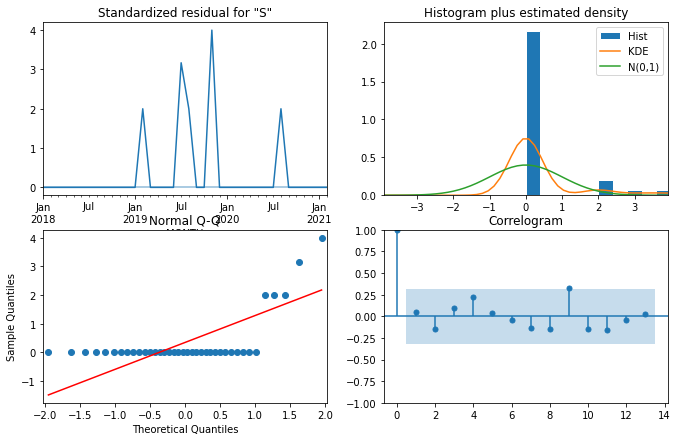

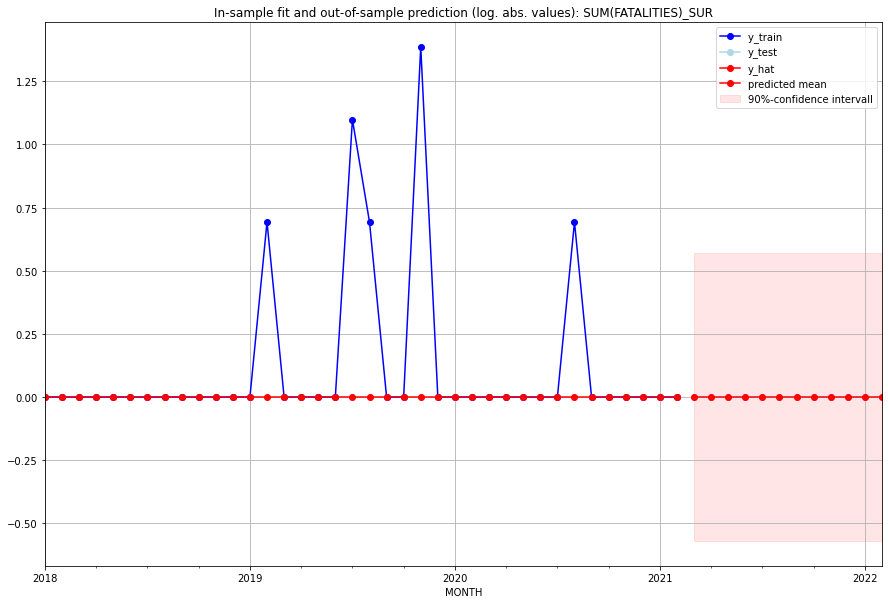

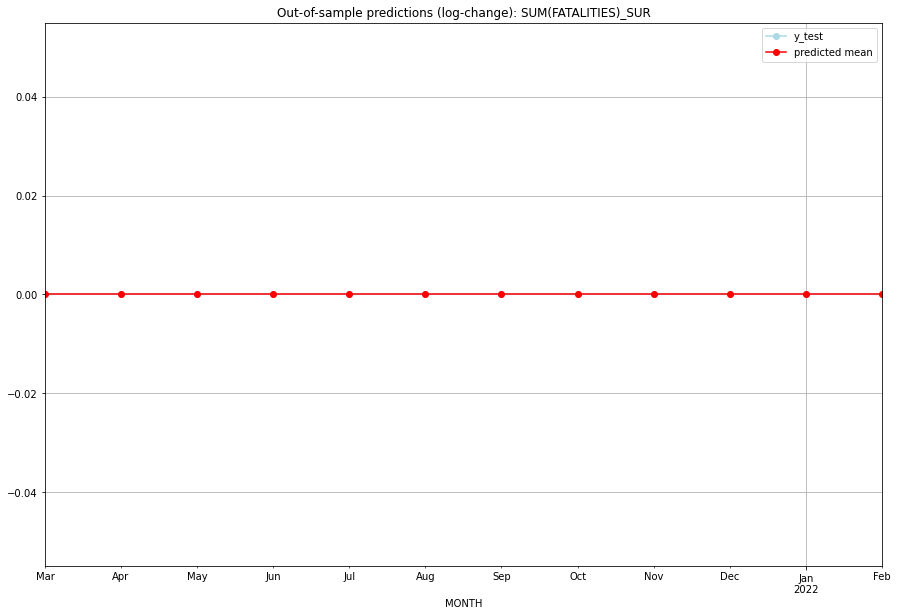

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SUR   
1  2021-04-01       0.0         0.0           0.0             0.0   SUR   
2  2021-05-01       0.0         0.0           0.0             0.0   SUR   
3  2021-06-01       0.0         0.0           0.0             0.0   SUR   
4  2021-07-01       0.0         0.0           0.0             0.0   SUR   
5  2021-08-01       0.0         0.0           0.0             0.0   SUR   
6  2021-09-01       0.0         0.0           0.0             0.0   SUR   
7  2021-10-01       0.0         0.0           0.0             0.0   SUR   
8  2021-11-01       0.0         0.0           0.0             0.0   SUR   
9  2021-12-01       0.0         0.0           0.0             0.0   SUR   
10 2022-01-01       0.0         0.0           0.0             0.0   SUR   
11 2022-02-01       0.0         0.0           0.0             0.0   

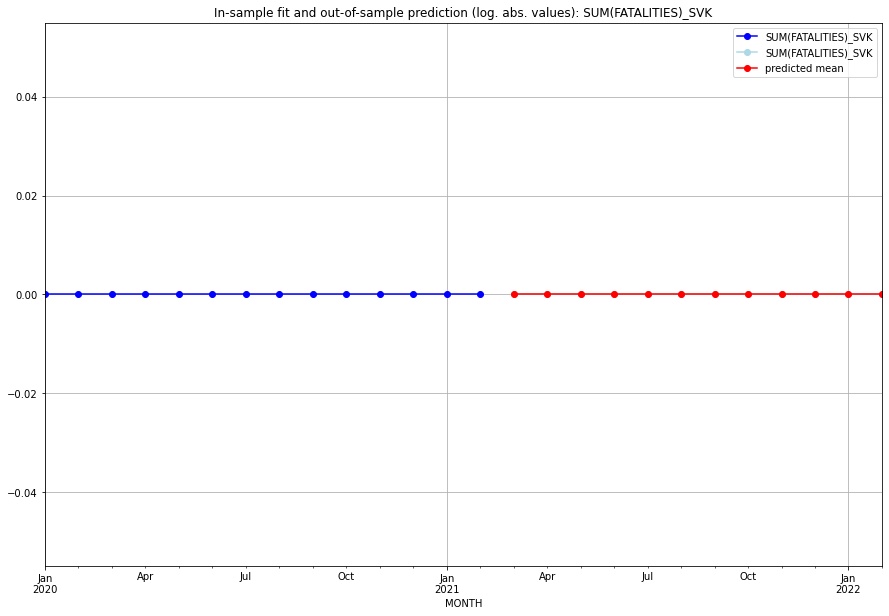

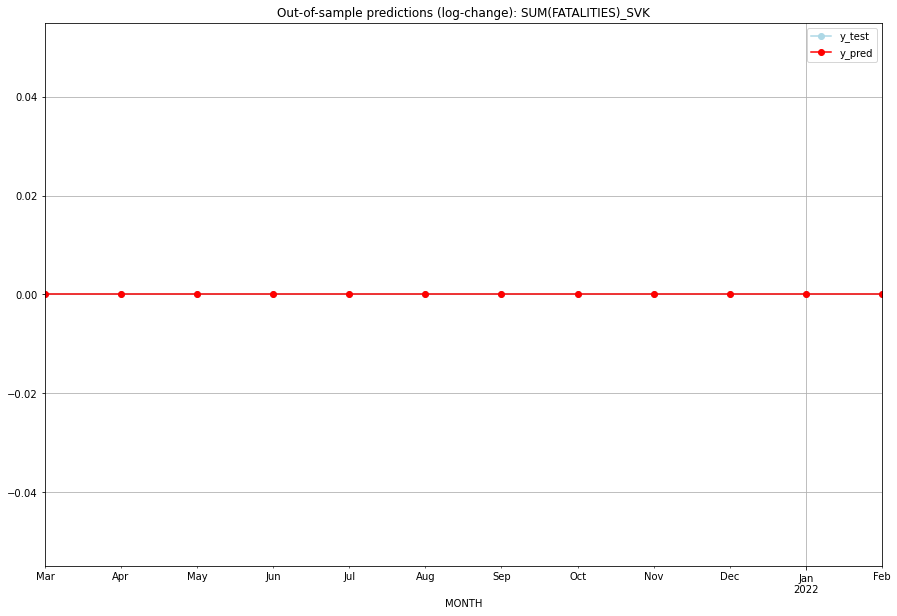

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SVK   
1  2021-04-01       0.0         0.0           0.0             0.0   SVK   
2  2021-05-01       0.0         0.0           0.0             0.0   SVK   
3  2021-06-01       0.0         0.0           0.0             0.0   SVK   
4  2021-07-01       0.0         0.0           0.0             0.0   SVK   
5  2021-08-01       0.0         0.0           0.0             0.0   SVK   
6  2021-09-01       0.0         0.0           0.0             0.0   SVK   
7  2021-10-01       0.0         0.0           0.0             0.0   SVK   
8  2021-11-01       0.0         0.0           0.0             0.0   SVK   
9  2021-12-01       0.0         0.0           0.0             0.0   SVK   
10 2022-01-01       0.0         0.0           0.0             0.0   SVK   
11 2022-02-01       0.0         0.0           0.0             0.0   

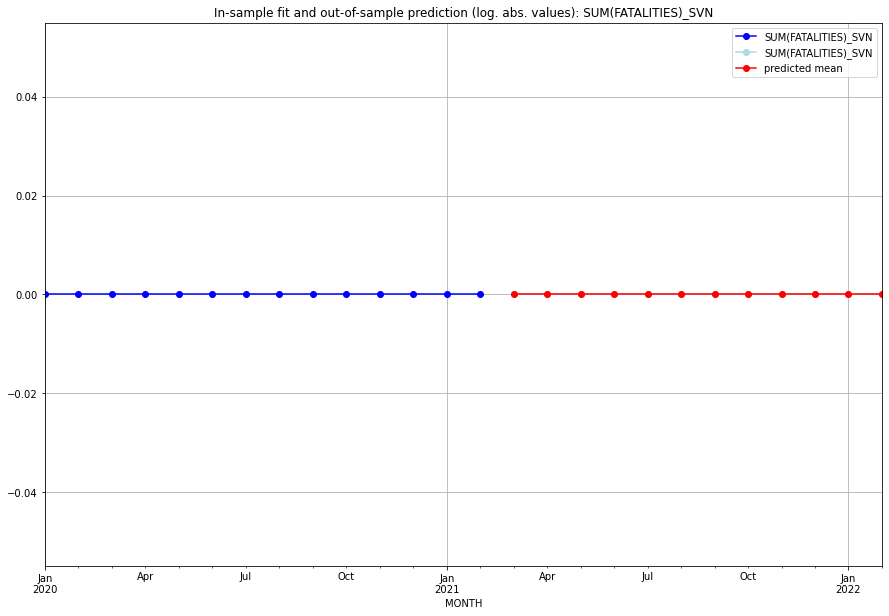

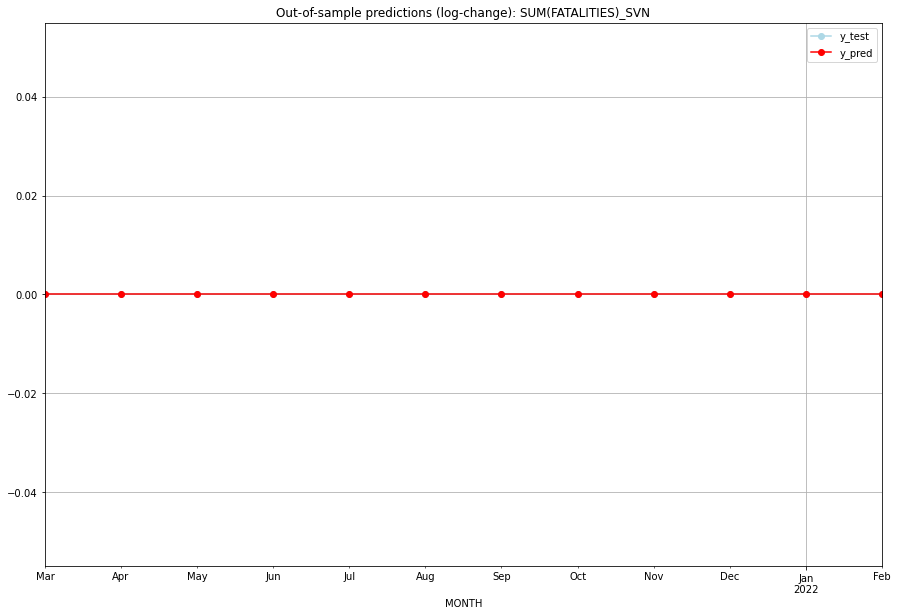

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SVN   
1  2021-04-01       0.0         0.0           0.0             0.0   SVN   
2  2021-05-01       0.0         0.0           0.0             0.0   SVN   
3  2021-06-01       0.0         0.0           0.0             0.0   SVN   
4  2021-07-01       0.0         0.0           0.0             0.0   SVN   
5  2021-08-01       0.0         0.0           0.0             0.0   SVN   
6  2021-09-01       0.0         0.0           0.0             0.0   SVN   
7  2021-10-01       0.0         0.0           0.0             0.0   SVN   
8  2021-11-01       0.0         0.0           0.0             0.0   SVN   
9  2021-12-01       0.0         0.0           0.0             0.0   SVN   
10 2022-01-01       0.0         0.0           0.0             0.0   SVN   
11 2022-02-01       0.0         0.0           0.0             0.0   

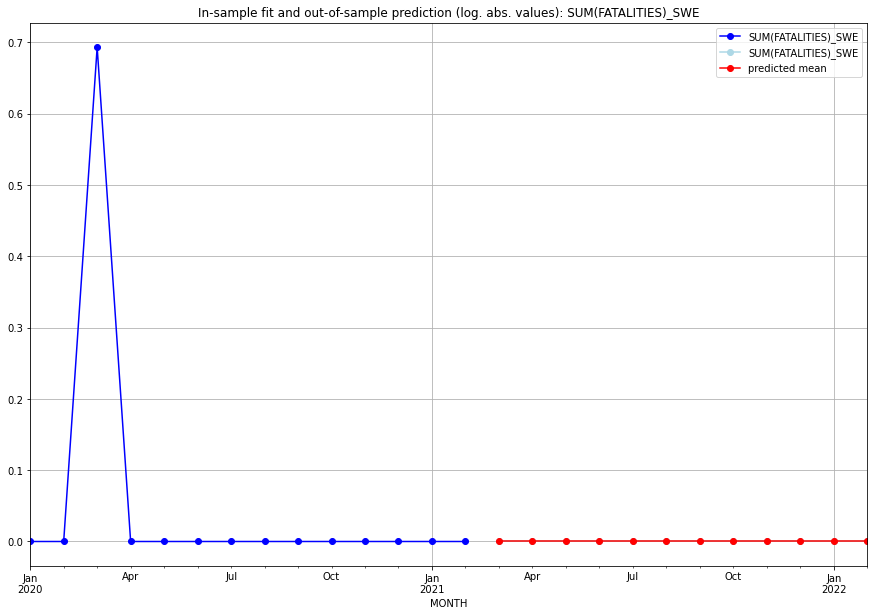

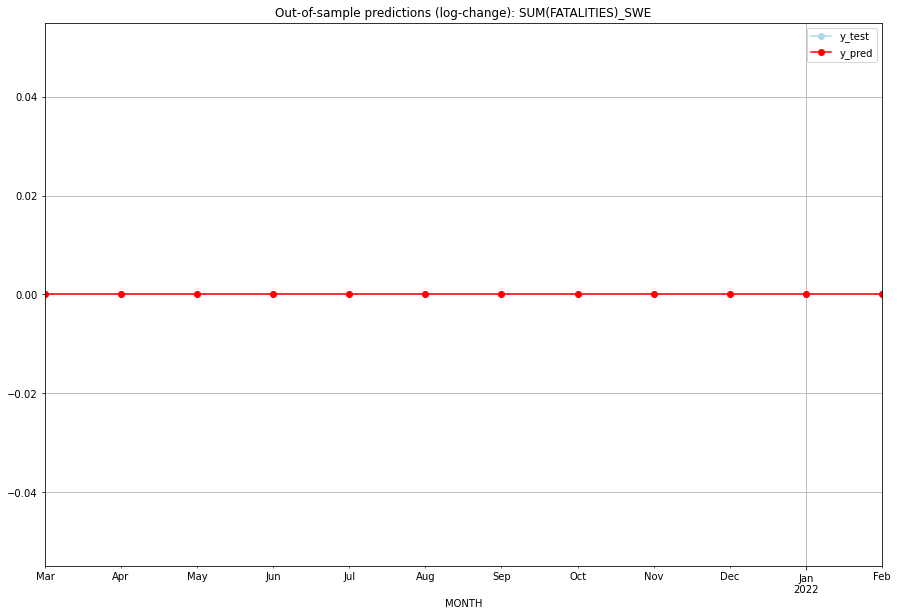

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SWE   
1  2021-04-01       0.0         0.0           0.0             0.0   SWE   
2  2021-05-01       0.0         0.0           0.0             0.0   SWE   
3  2021-06-01       0.0         0.0           0.0             0.0   SWE   
4  2021-07-01       0.0         0.0           0.0             0.0   SWE   
5  2021-08-01       0.0         0.0           0.0             0.0   SWE   
6  2021-09-01       0.0         0.0           0.0             0.0   SWE   
7  2021-10-01       0.0         0.0           0.0             0.0   SWE   
8  2021-11-01       0.0         0.0           0.0             0.0   SWE   
9  2021-12-01       0.0         0.0           0.0             0.0   SWE   
10 2022-01-01       0.0         0.0           0.0             0.0   SWE   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.09634572526320548, 'fold_results': [0.0, 0.0, 0.0, 0.1493132891023379, 0.33241533721368954]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SWZ   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                  25.189
Date:                 Wed, 19 Oct 2022   AIC                            -48.378
Time:                         11:08:30   BIC                            -44.711
Sample:                     02-28-1997   HQIC                           -46.908
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2      

<Figure size 432x288 with 0 Axes>

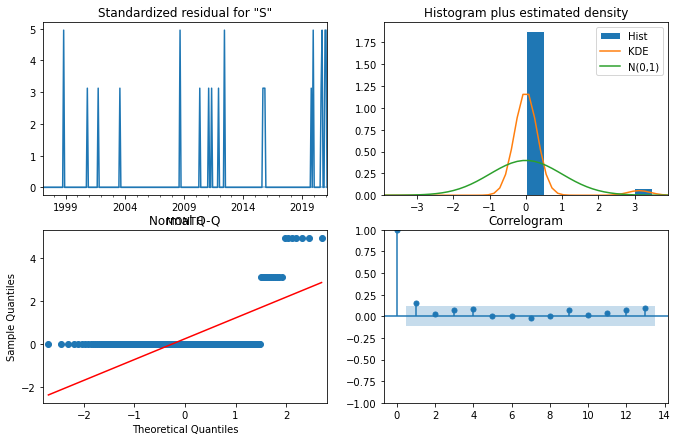

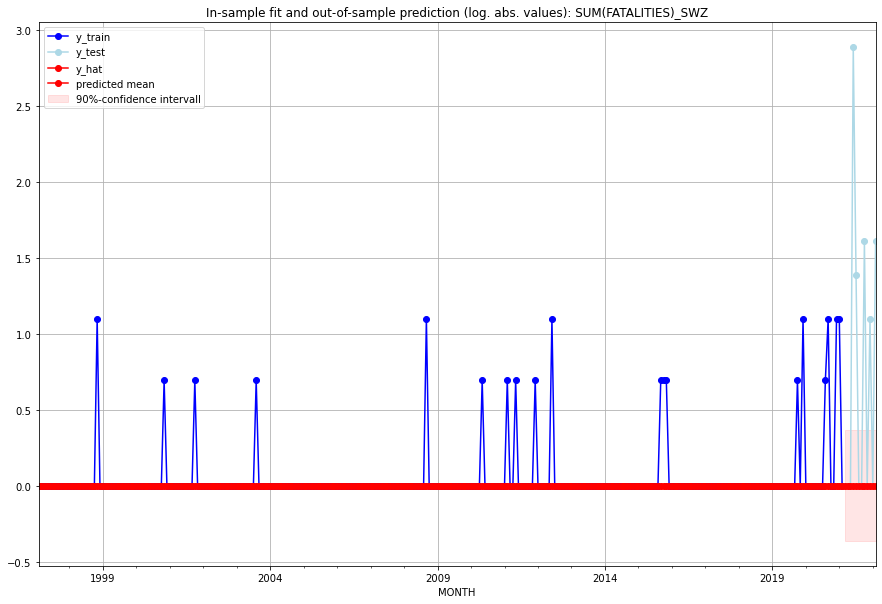

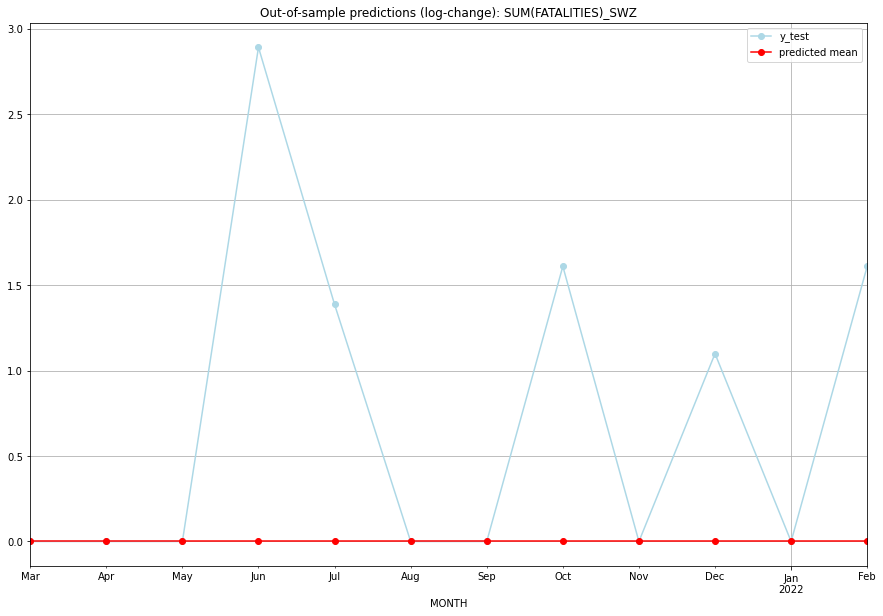

TADDA: 0.7161795193793639
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   SWZ   
1  2021-04-01       0.0         0.0           0.0        0.000000   SWZ   
2  2021-05-01       0.0         0.0           0.0        0.000000   SWZ   
3  2021-06-01       0.0        17.0           0.0        2.890372   SWZ   
4  2021-07-01       0.0         3.0           0.0        1.386294   SWZ   
5  2021-08-01       0.0         0.0           0.0        0.000000   SWZ   
6  2021-09-01       0.0         0.0           0.0        0.000000   SWZ   
7  2021-10-01       0.0         4.0           0.0        1.609438   SWZ   
8  2021-11-01       0.0         0.0           0.0        0.000000   SWZ   
9  2021-12-01       0.0         2.0           0.0        1.098612   SWZ   
10 2022-01-01       0.0         0.0           0.0        0.000000   SWZ   
11 2022-02-01       0.0         4.0           0.0    

<Figure size 432x288 with 0 Axes>

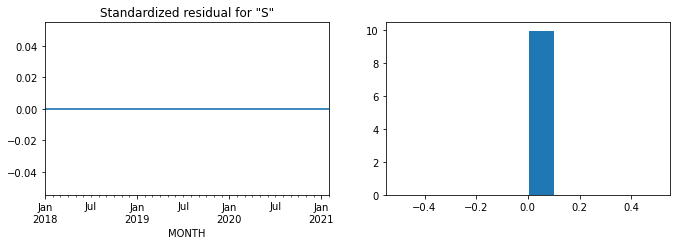

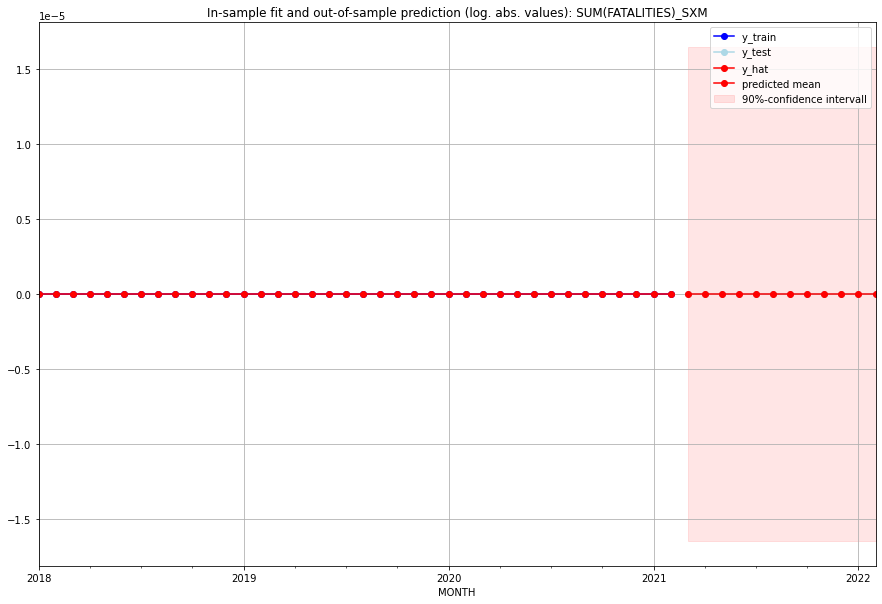

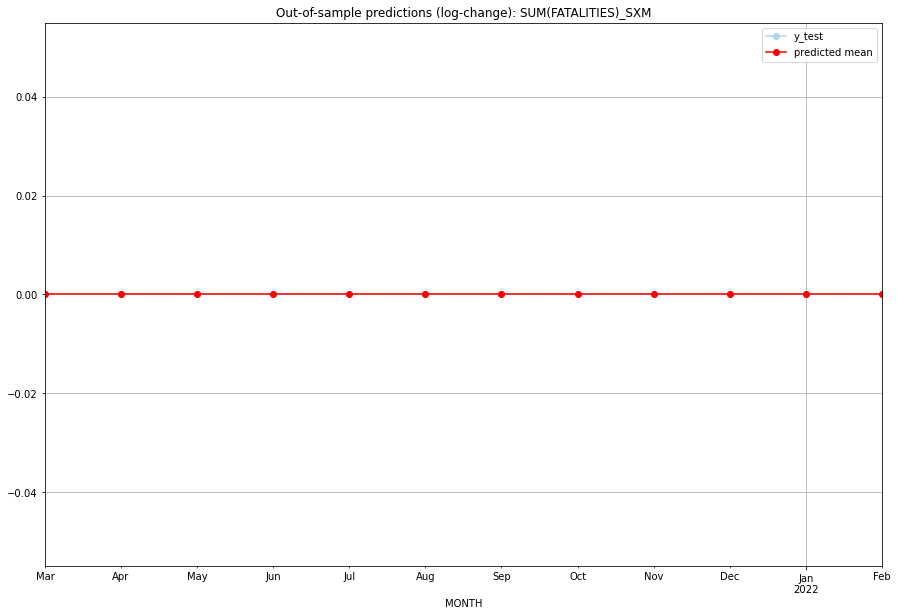

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SXM   
1  2021-04-01       0.0         0.0           0.0             0.0   SXM   
2  2021-05-01       0.0         0.0           0.0             0.0   SXM   
3  2021-06-01       0.0         0.0           0.0             0.0   SXM   
4  2021-07-01       0.0         0.0           0.0             0.0   SXM   
5  2021-08-01       0.0         0.0           0.0             0.0   SXM   
6  2021-09-01       0.0         0.0           0.0             0.0   SXM   
7  2021-10-01       0.0         0.0           0.0             0.0   SXM   
8  2021-11-01       0.0         0.0           0.0             0.0   SXM   
9  2021-12-01       0.0         0.0           0.0             0.0   SXM   
10 2022-01-01       0.0         0.0           0.0             0.0   SXM   
11 2022-02-01       0.0         0.0           0.0             0.0   

<Figure size 432x288 with 0 Axes>

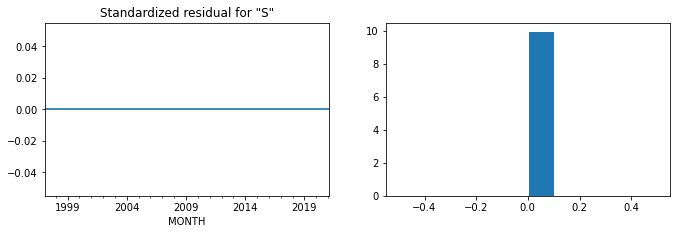

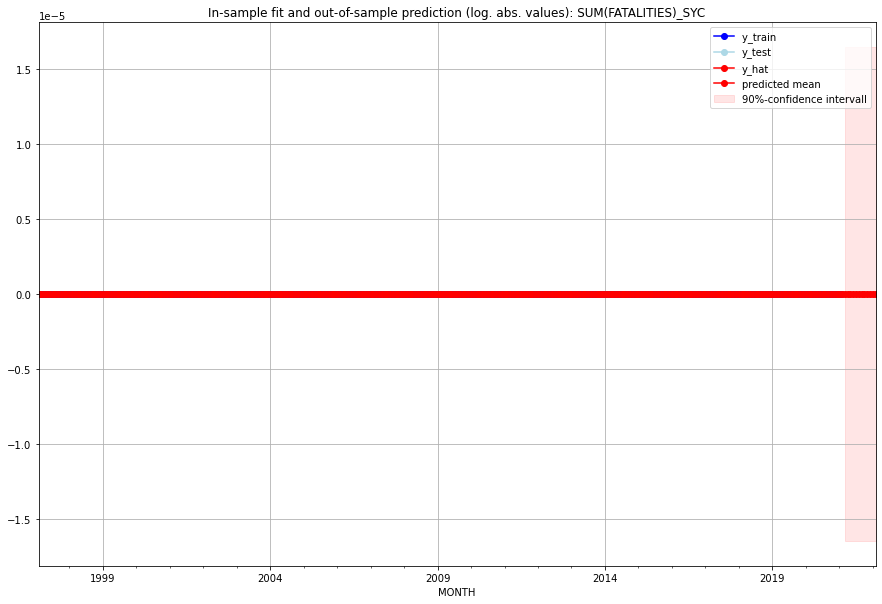

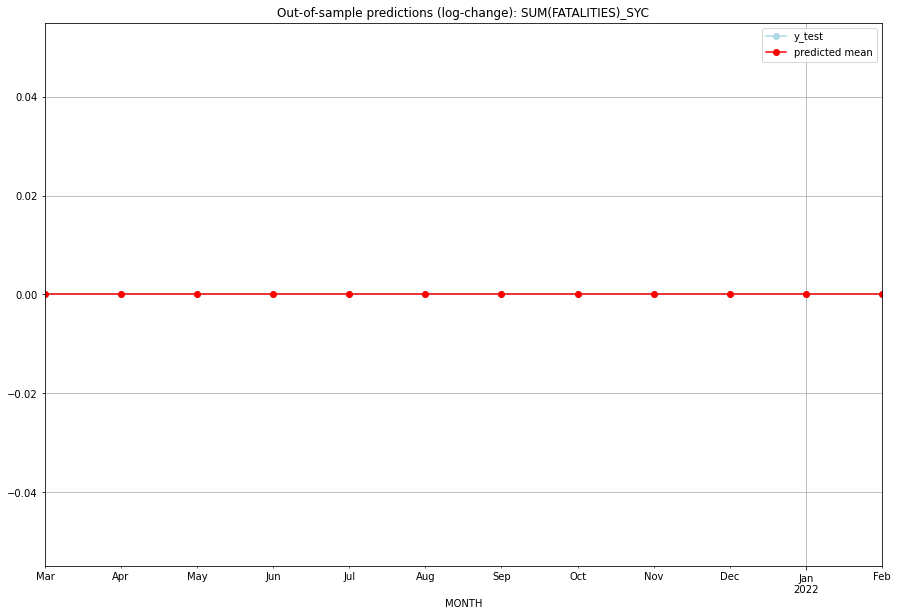

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   SYC   
1  2021-04-01       0.0         0.0           0.0             0.0   SYC   
2  2021-05-01       0.0         0.0           0.0             0.0   SYC   
3  2021-06-01       0.0         0.0           0.0             0.0   SYC   
4  2021-07-01       0.0         0.0           0.0             0.0   SYC   
5  2021-08-01       0.0         0.0           0.0             0.0   SYC   
6  2021-09-01       0.0         0.0           0.0             0.0   SYC   
7  2021-10-01       0.0         0.0           0.0             0.0   SYC   
8  2021-11-01       0.0         0.0           0.0             0.0   SYC   
9  2021-12-01       0.0         0.0           0.0             0.0   SYC   
10 2022-01-01       0.0         0.0           0.0             0.0   SYC   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.4072980238928028, 'fold_results': [nan, 0.3250412387875005, 0.48955480899810505]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_SYR   No. Observations:                   50
Model:                SARIMAX(3, 1, 3)   Log Likelihood                 -18.704
Date:                 Wed, 19 Oct 2022   AIC                             51.409
Time:                         11:08:49   BIC                             64.651
Sample:                     01-31-2017   HQIC                            56.433
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8548  

<Figure size 432x288 with 0 Axes>

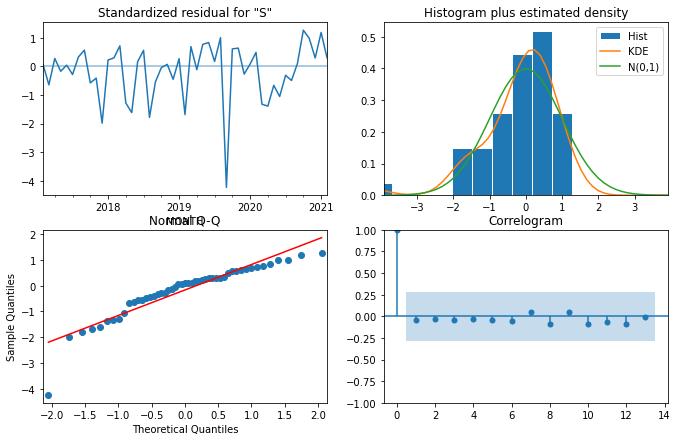

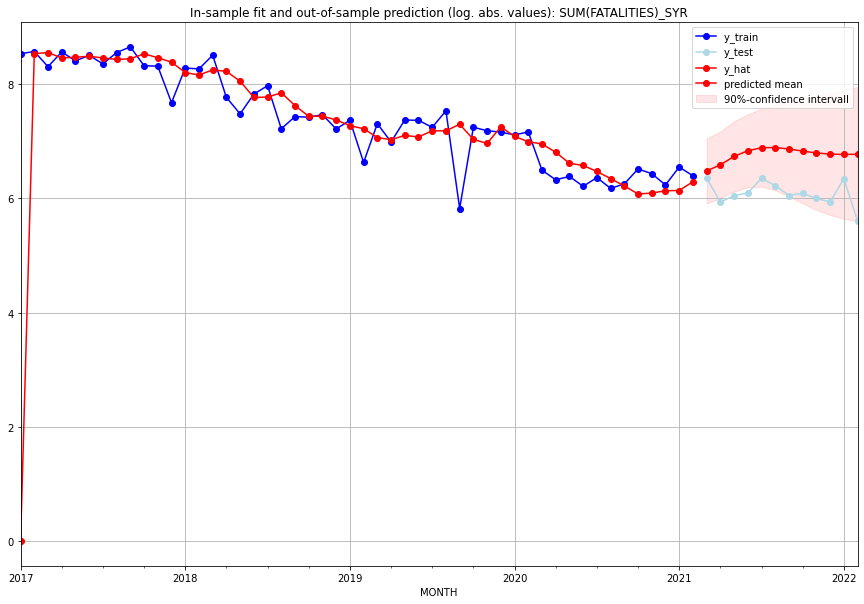

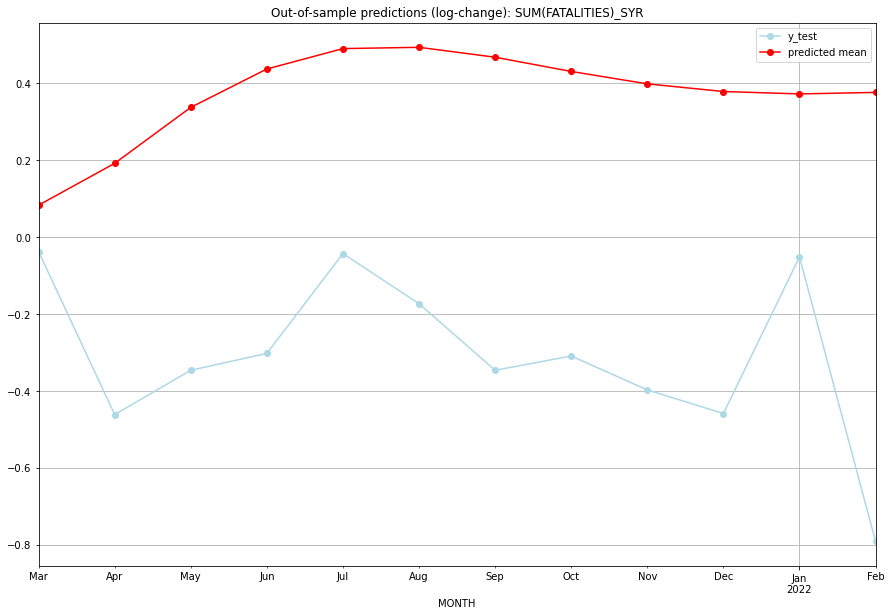

TADDA: 1.053087104822821
Evaluation finished.
        MONTH    FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  648.855003       575.0      0.083159       -0.037483   SYR   
1  2021-04-01  723.594258       376.0      0.192021       -0.461346   SYR   
2  2021-05-01  837.108639       422.0      0.337557       -0.346219   SYR   
3  2021-06-01  925.072696       441.0      0.437362       -0.302281   SYR   
4  2021-07-01  975.554630       572.0      0.490440       -0.042705   SYR   
5  2021-08-01  978.829530       502.0      0.493788       -0.173001   SYR   
6  2021-09-01  953.889883       422.0      0.468005       -0.346219   SYR   
7  2021-10-01  919.212829       438.0      0.431014       -0.309091   SYR   
8  2021-11-01  889.992557       401.0      0.398745       -0.397139   SYR   
9  2021-12-01  872.419299       377.0      0.378825       -0.458697   SYR   
10 2022-01-01  866.961154       567.0      0.372556       -0.051469   SYR   
11 2022-02-01  870.382421     

<Figure size 432x288 with 0 Axes>

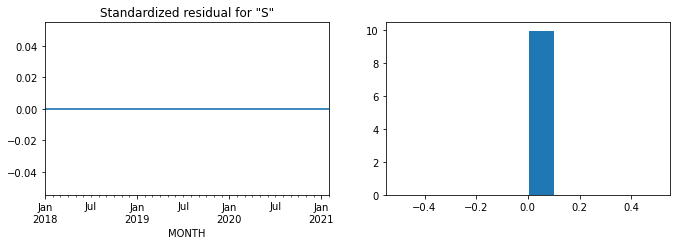

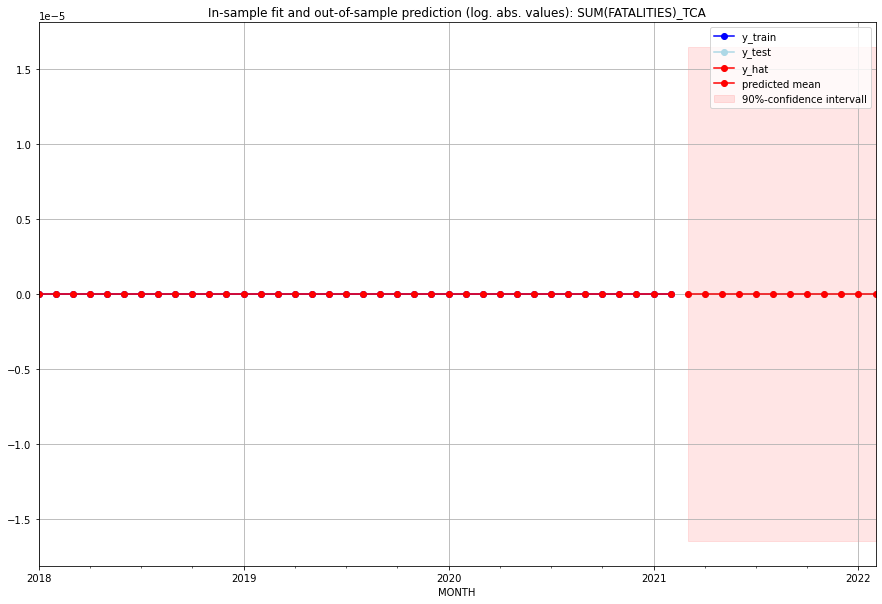

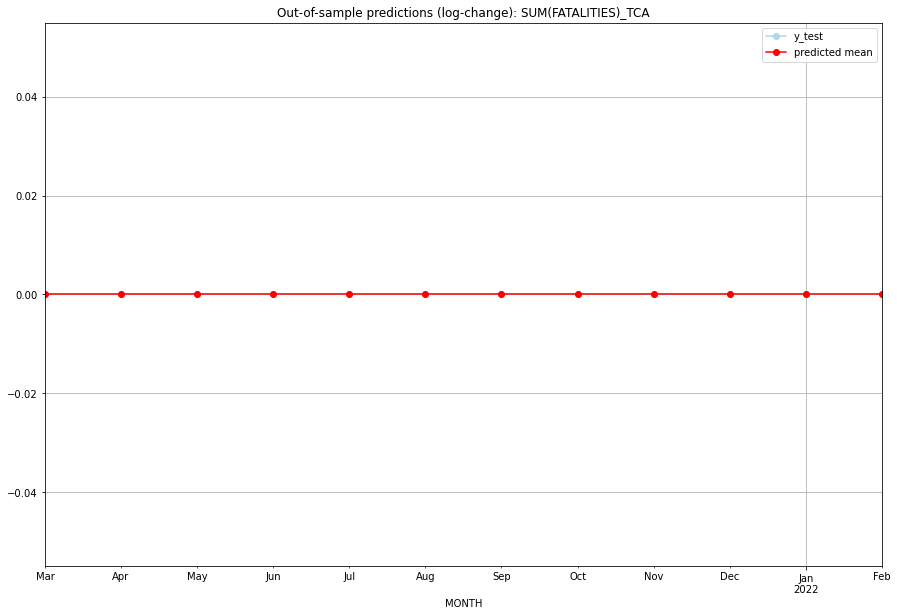

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   TCA   
1  2021-04-01       0.0         0.0           0.0             0.0   TCA   
2  2021-05-01       0.0         0.0           0.0             0.0   TCA   
3  2021-06-01       0.0         0.0           0.0             0.0   TCA   
4  2021-07-01       0.0         0.0           0.0             0.0   TCA   
5  2021-08-01       0.0         0.0           0.0             0.0   TCA   
6  2021-09-01       0.0         0.0           0.0             0.0   TCA   
7  2021-10-01       0.0         0.0           0.0             0.0   TCA   
8  2021-11-01       0.0         0.0           0.0             0.0   TCA   
9  2021-12-01       0.0         0.0           0.0             0.0   TCA   
10 2022-01-01       0.0         0.0           0.0             0.0   TCA   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 1.3178910531633037, 'fold_results': [1.7575778013236338, 1.5961538913482498, 1.3776372135379795, 1.127050099916352, 0.7310362596903027]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TCD   No. Observations:                  289
Model:                SARIMAX(1, 1, 1)   Log Likelihood                -570.439
Date:                 Wed, 19 Oct 2022   AIC                           1150.878
Time:                         11:09:08   BIC                           1169.193
Sample:                     02-28-1997   HQIC                          1158.218
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

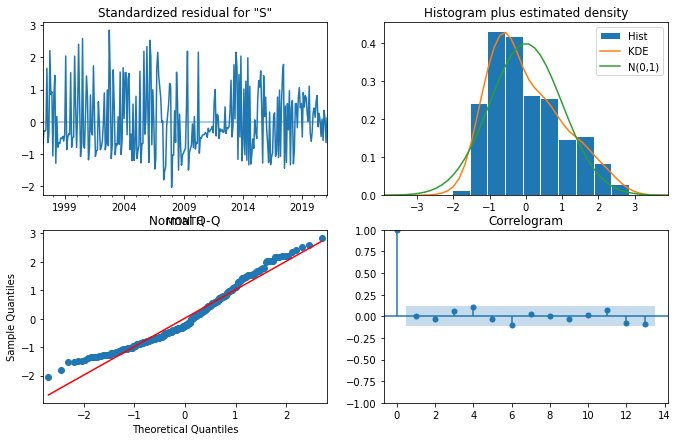

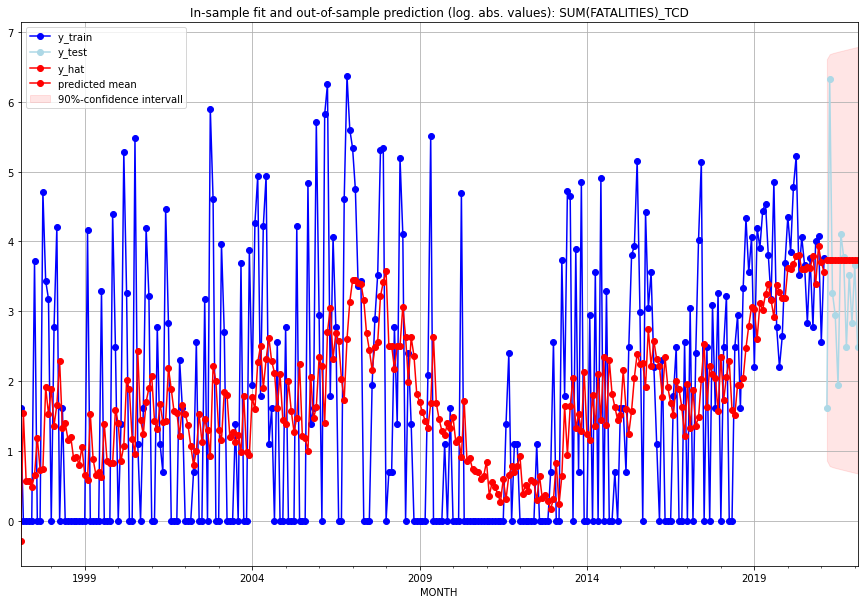

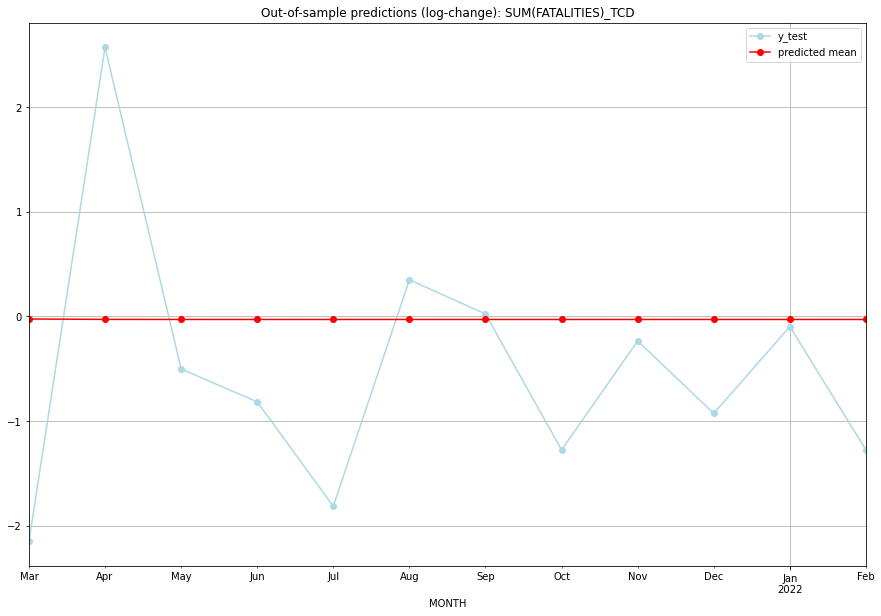

TADDA: 0.9966197063888075
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  40.941074         4.0     -0.024934       -2.151762   TCD   
1  2021-04-01  40.778876       562.0     -0.028809        2.572080   TCD   
2  2021-05-01  40.753727        25.0     -0.029411       -0.503104   TCD   
3  2021-06-01  40.749821        18.0     -0.029505       -0.816761   TCD   
4  2021-07-01  40.749214         6.0     -0.029520       -1.815290   TCD   
5  2021-08-01  40.749119        60.0     -0.029522        0.349674   TCD   
6  2021-09-01  40.749105        43.0     -0.029522        0.022990   TCD   
7  2021-10-01  40.749102        11.0     -0.029522       -1.276293   TCD   
8  2021-11-01  40.749102        33.0     -0.029522       -0.234840   TCD   
9  2021-12-01  40.749102        16.0     -0.029522       -0.927987   TCD   
10 2022-01-01  40.749102        38.0     -0.029522       -0.097638   TCD   
11 2022-02-01  40.749102        11.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5143346159005393, 'fold_results': [0.35638884325133796, 1.0164207235526577, 0.19188209108283716, 0.3226000842423243, 0.6843813373735396]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TGO   No. Observations:                  289
Model:                SARIMAX(1, 0, 0)   Log Likelihood                -234.578
Date:                 Wed, 19 Oct 2022   AIC                            473.155
Time:                         11:09:34   BIC                            480.488
Sample:                     02-28-1997   HQIC                           476.094
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

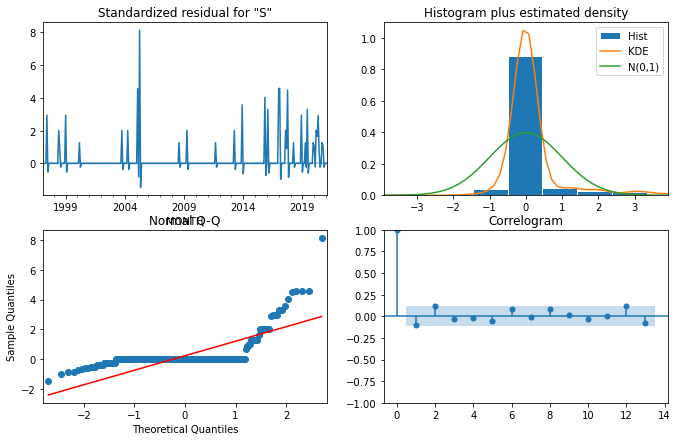

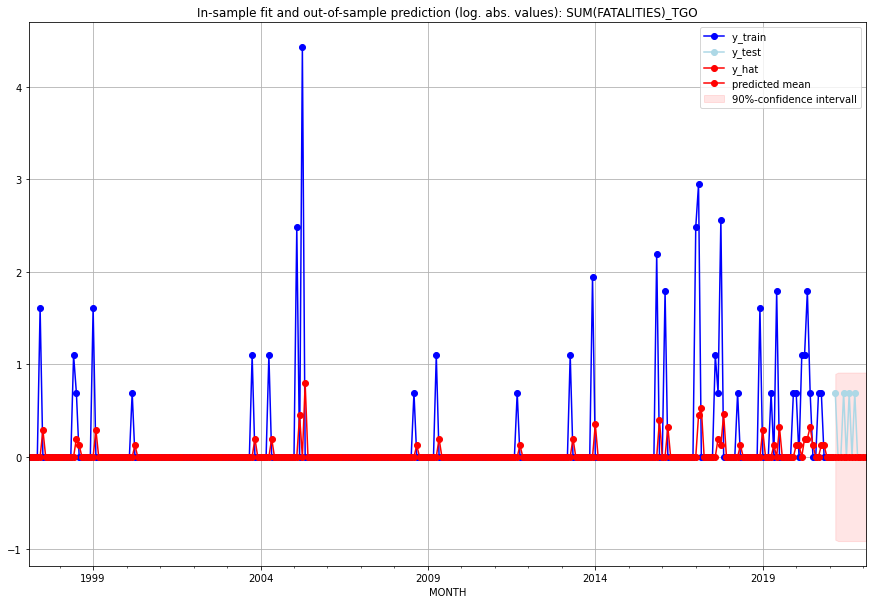

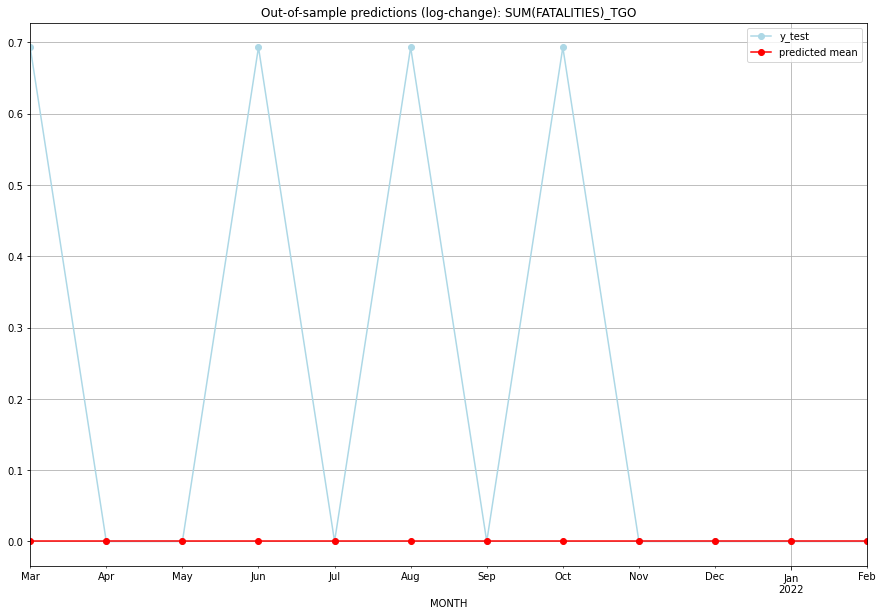

TADDA: 0.23104906018664842
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         1.0           0.0        0.693147   TGO   
1  2021-04-01       0.0         0.0           0.0        0.000000   TGO   
2  2021-05-01       0.0         0.0           0.0        0.000000   TGO   
3  2021-06-01       0.0         1.0           0.0        0.693147   TGO   
4  2021-07-01       0.0         0.0           0.0        0.000000   TGO   
5  2021-08-01       0.0         1.0           0.0        0.693147   TGO   
6  2021-09-01       0.0         0.0           0.0        0.000000   TGO   
7  2021-10-01       0.0         1.0           0.0        0.693147   TGO   
8  2021-11-01       0.0         0.0           0.0        0.000000   TGO   
9  2021-12-01       0.0         0.0           0.0        0.000000   TGO   
10 2022-01-01       0.0         0.0           0.0        0.000000   TGO   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5539636014539085, 'fold_results': [0.5787364471024031, 0.5398209247973644, 0.27517393790029987, 0.5347745303849721, 0.8413121670845033]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_THA   No. Observations:                  134
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -119.738
Date:                 Wed, 19 Oct 2022   AIC                            241.477
Time:                         11:09:48   BIC                            244.367
Sample:                     01-31-2010   HQIC                           242.651
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

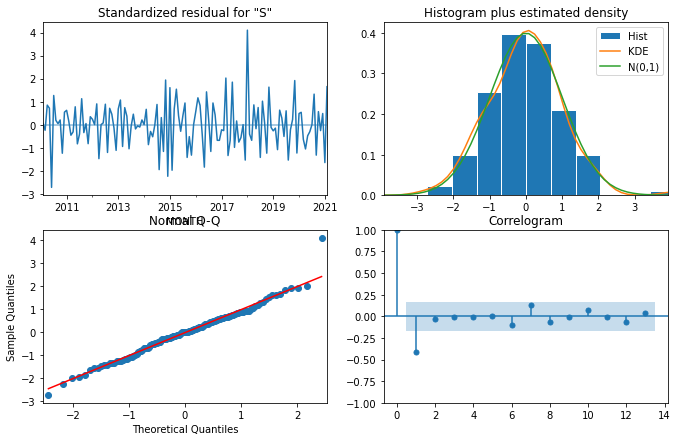

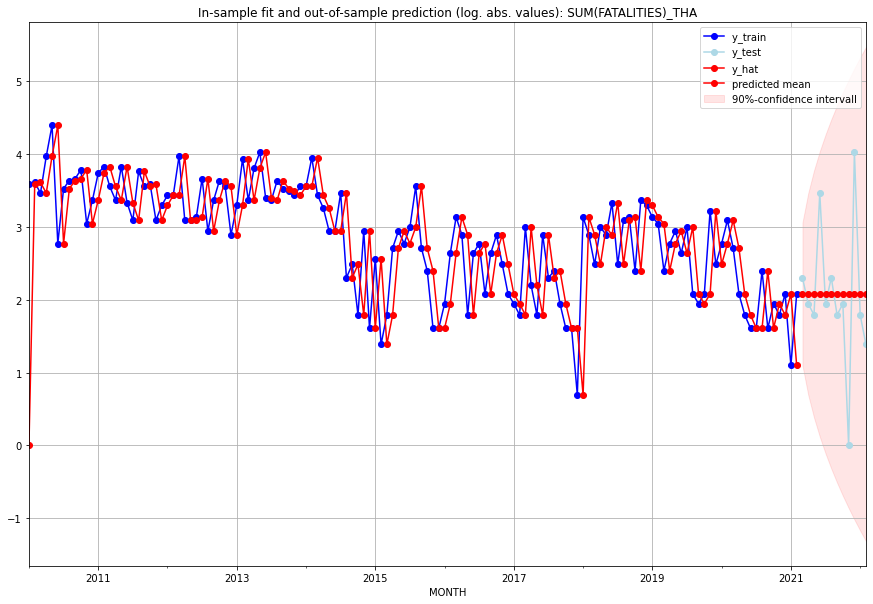

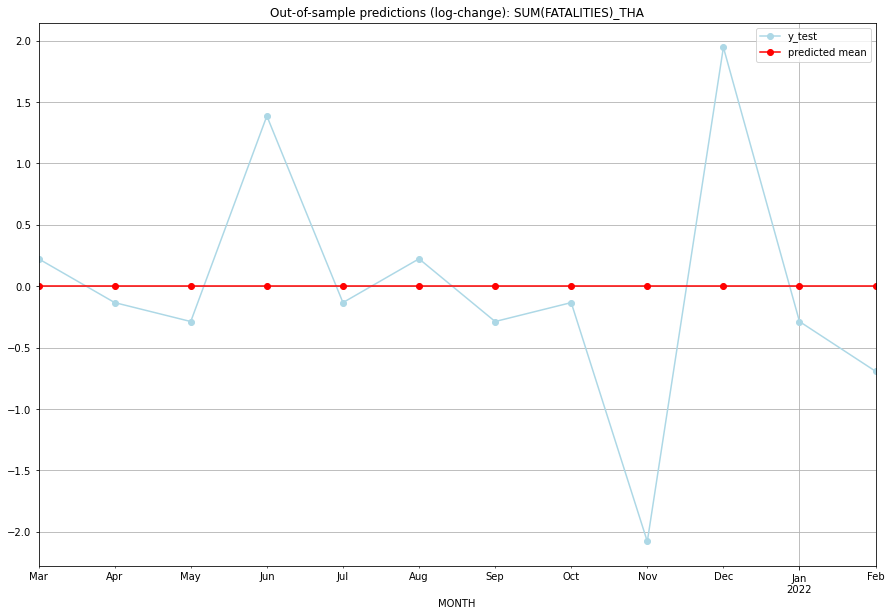

TADDA: 0.6512267275226932
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       7.0         9.0           0.0        0.223144   THA   
1  2021-04-01       7.0         6.0           0.0       -0.133531   THA   
2  2021-05-01       7.0         5.0           0.0       -0.287682   THA   
3  2021-06-01       7.0        31.0           0.0        1.386294   THA   
4  2021-07-01       7.0         6.0           0.0       -0.133531   THA   
5  2021-08-01       7.0         9.0           0.0        0.223144   THA   
6  2021-09-01       7.0         5.0           0.0       -0.287682   THA   
7  2021-10-01       7.0         6.0           0.0       -0.133531   THA   
8  2021-11-01       7.0         0.0           0.0       -2.079442   THA   
9  2021-12-01       7.0        55.0           0.0        1.945910   THA   
10 2022-01-01       7.0         5.0           0.0       -0.287682   THA   
11 2022-02-01       7.0         3.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5901424578024879, 'fold_results': [1.0647603855116514, 0.11552453009332421]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TJK   No. Observations:                   38
Model:                SARIMAX(1, 1, 0)   Log Likelihood                 -60.213
Date:                 Wed, 19 Oct 2022   AIC                            124.427
Time:                         11:09:53   BIC                            127.649
Sample:                     01-31-2018   HQIC                           125.563
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.6178      0

<Figure size 432x288 with 0 Axes>

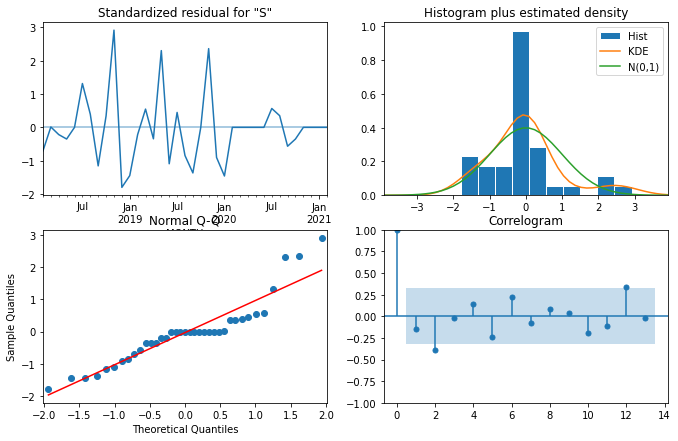

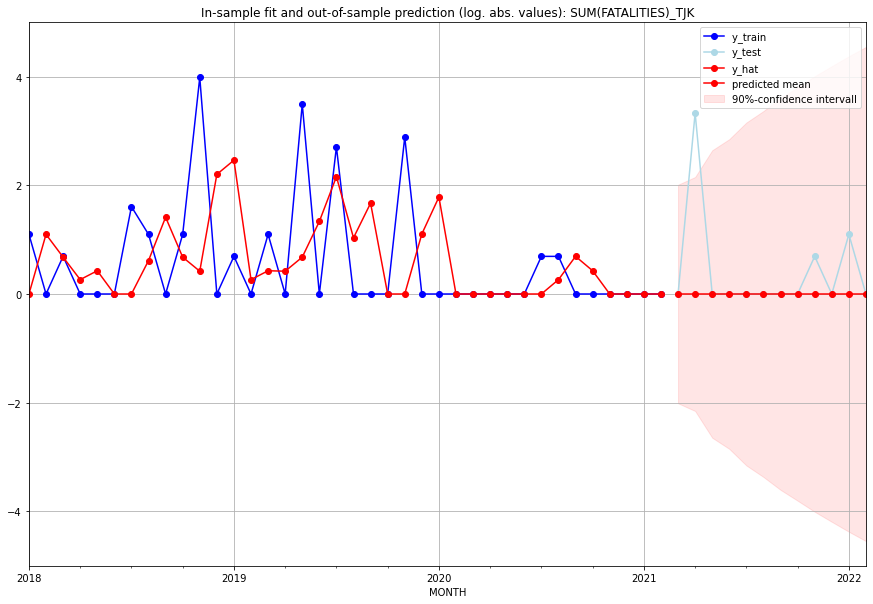

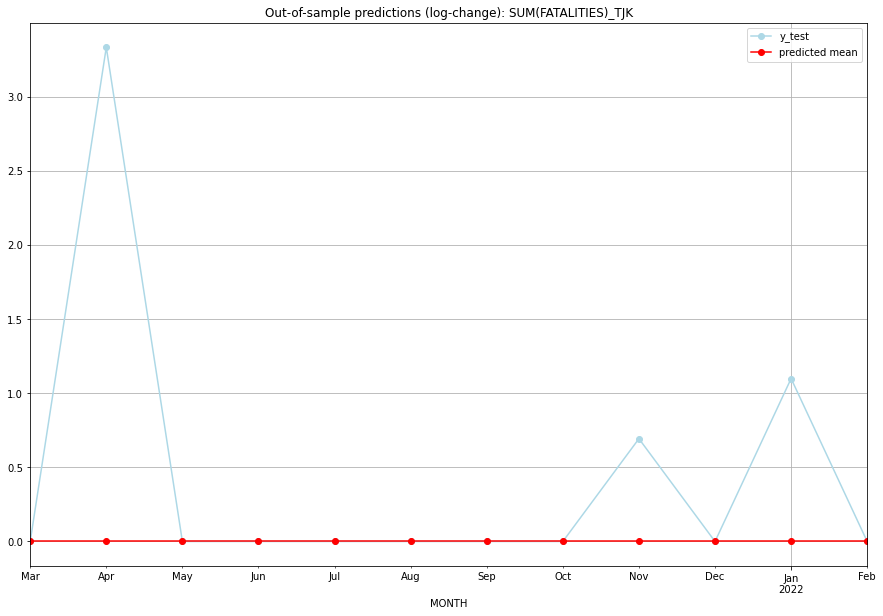

TADDA: 0.4269969982836049
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0  7.326517e-50        0.000000   TJK   
1  2021-04-01       0.0        27.0  9.472334e-50        3.332205   TJK   
2  2021-05-01       0.0         0.0  8.146686e-50        0.000000   TJK   
3  2021-06-01       0.0         0.0  8.965648e-50        0.000000   TJK   
4  2021-07-01       0.0         0.0  8.459708e-50        0.000000   TJK   
5  2021-08-01       0.0         0.0  8.772269e-50        0.000000   TJK   
6  2021-09-01       0.0         0.0  8.579174e-50        0.000000   TJK   
7  2021-10-01       0.0         0.0  8.698465e-50        0.000000   TJK   
8  2021-11-01       0.0         1.0  8.624769e-50        0.693147   TJK   
9  2021-12-01       0.0         0.0  8.670297e-50        0.000000   TJK   
10 2022-01-01       0.0         2.0  8.642171e-50        1.098612   TJK   
11 2022-02-01       0.0         0.0  8.659546e-50    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.057762265046662105, 'fold_results': [nan, 0.057762265046662105]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TKM   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                 -34.246
Date:                 Wed, 19 Oct 2022   AIC                             80.492
Time:                         11:10:05   BIC                             90.157
Sample:                     01-31-2018   HQIC                            83.899
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0415      0.120     -0.

<Figure size 432x288 with 0 Axes>

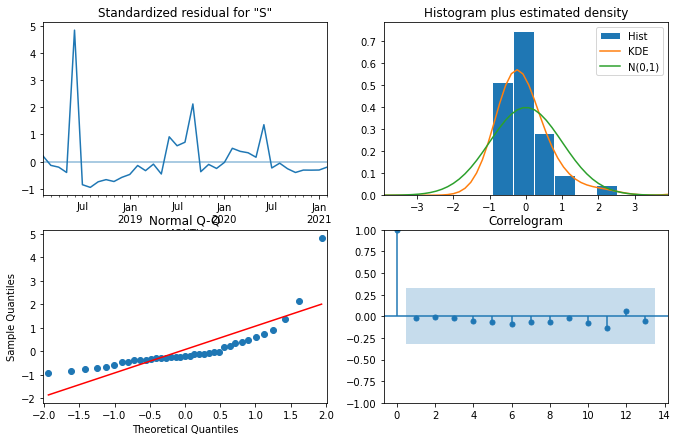

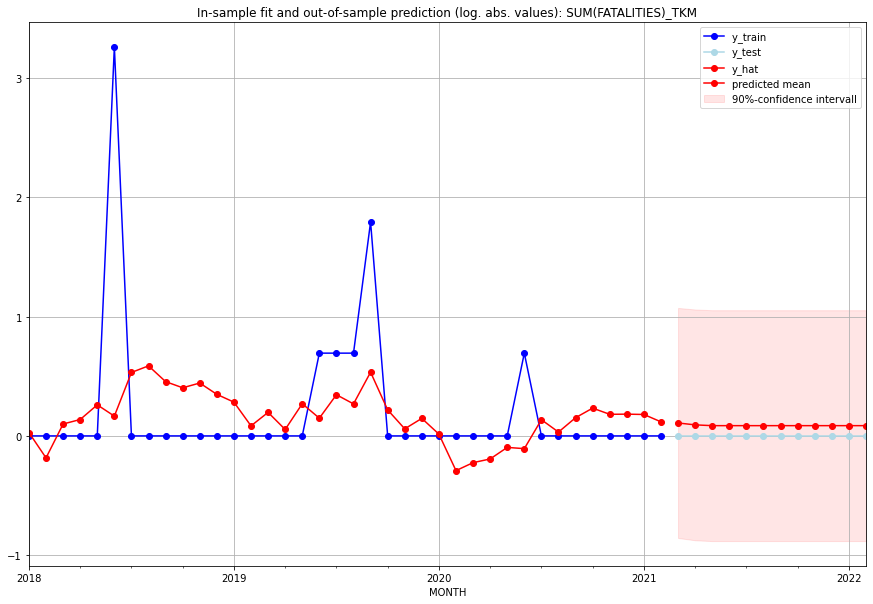

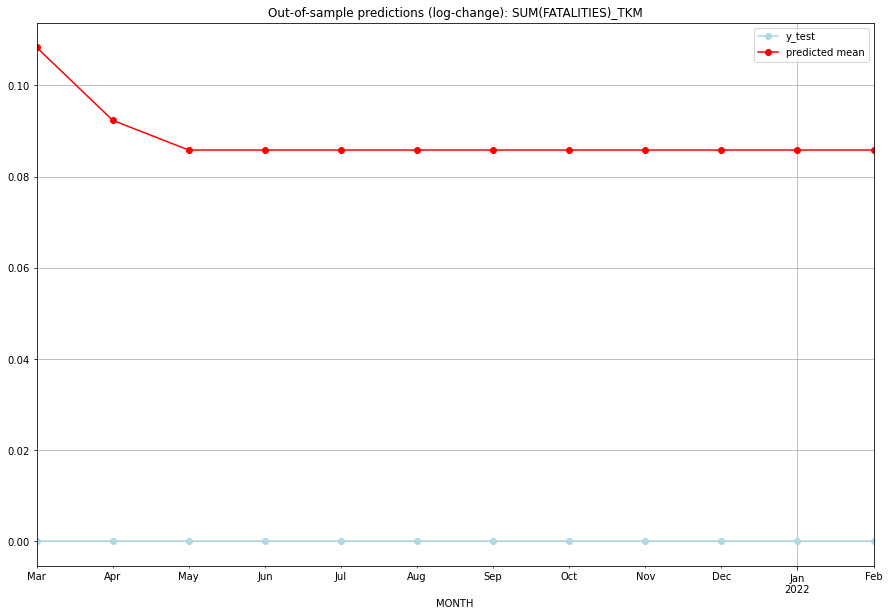

TADDA: 0.08823360789216256
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.114419         0.0      0.108333             0.0   TKM   
1  2021-04-01  0.096725         0.0      0.092329             0.0   TKM   
2  2021-05-01  0.089604         0.0      0.085814             0.0   TKM   
3  2021-06-01  0.089604         0.0      0.085814             0.0   TKM   
4  2021-07-01  0.089604         0.0      0.085814             0.0   TKM   
5  2021-08-01  0.089604         0.0      0.085814             0.0   TKM   
6  2021-09-01  0.089604         0.0      0.085814             0.0   TKM   
7  2021-10-01  0.089604         0.0      0.085814             0.0   TKM   
8  2021-11-01  0.089604         0.0      0.085814             0.0   TKM   
9  2021-12-01  0.089604         0.0      0.085814             0.0   TKM   
10 2022-01-01  0.089604         0.0      0.085814             0.0   TKM   
11 2022-02-01  0.089604         0.0      0.085814   

<Figure size 432x288 with 0 Axes>

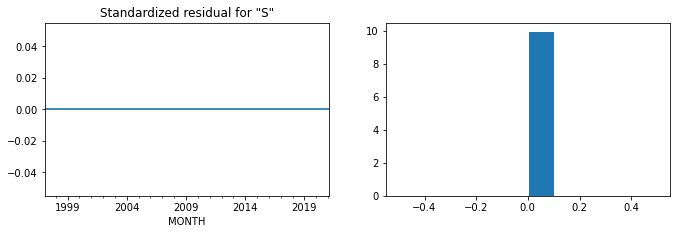

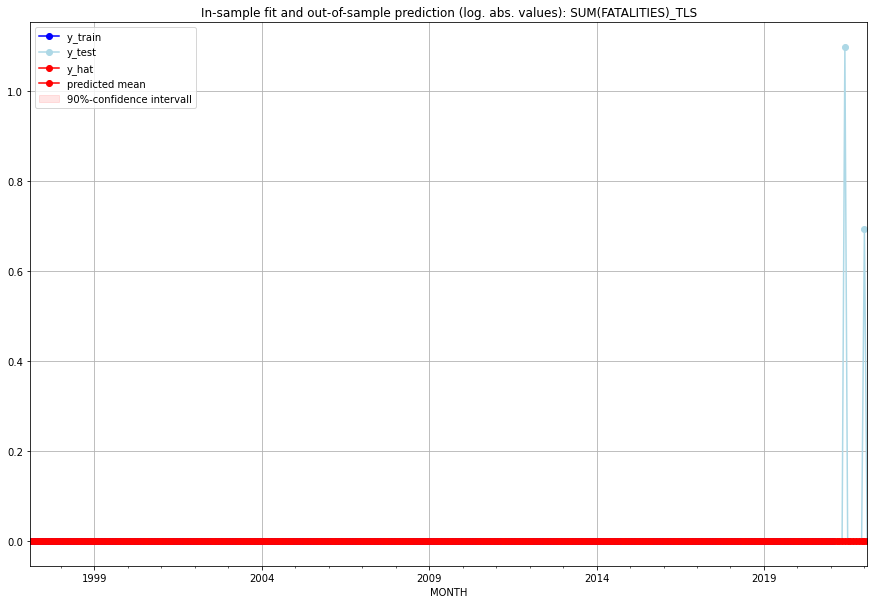

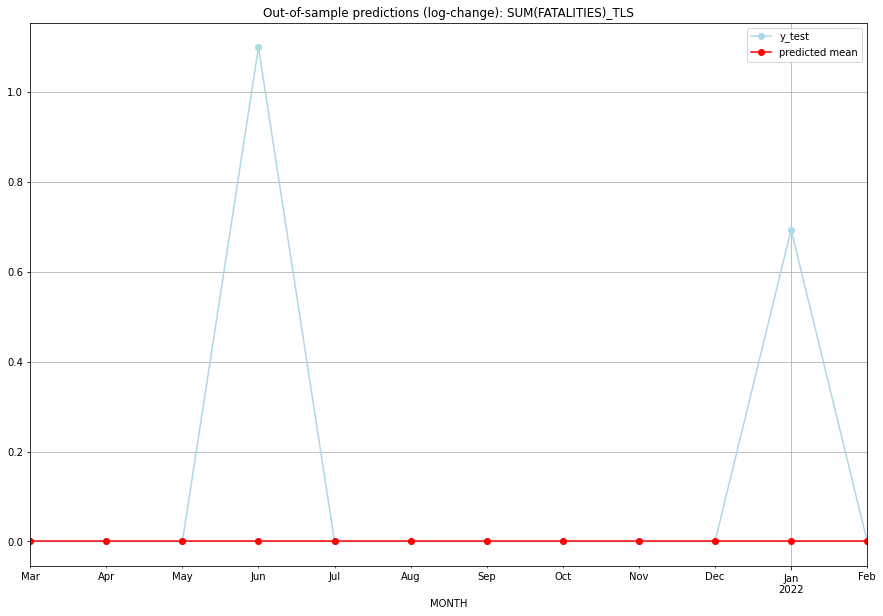

TADDA: 0.1493132891023379
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   TLS   
1  2021-04-01       0.0         0.0           0.0        0.000000   TLS   
2  2021-05-01       0.0         0.0           0.0        0.000000   TLS   
3  2021-06-01       0.0         2.0           0.0        1.098612   TLS   
4  2021-07-01       0.0         0.0           0.0        0.000000   TLS   
5  2021-08-01       0.0         0.0           0.0        0.000000   TLS   
6  2021-09-01       0.0         0.0           0.0        0.000000   TLS   
7  2021-10-01       0.0         0.0           0.0        0.000000   TLS   
8  2021-11-01       0.0         0.0           0.0        0.000000   TLS   
9  2021-12-01       0.0         0.0           0.0        0.000000   TLS   
10 2022-01-01       0.0         1.0           0.0        0.693147   TLS   
11 2022-02-01       0.0         0.0           0.0    

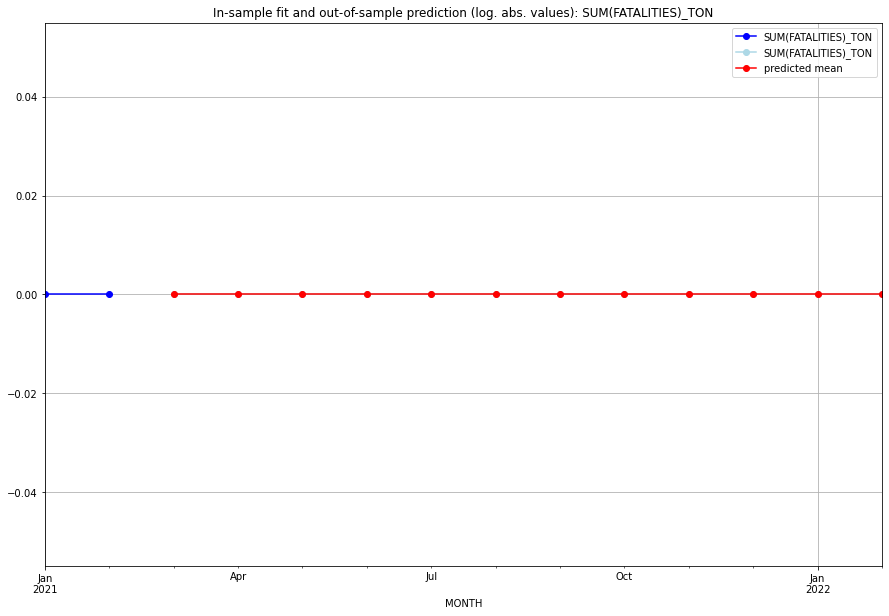

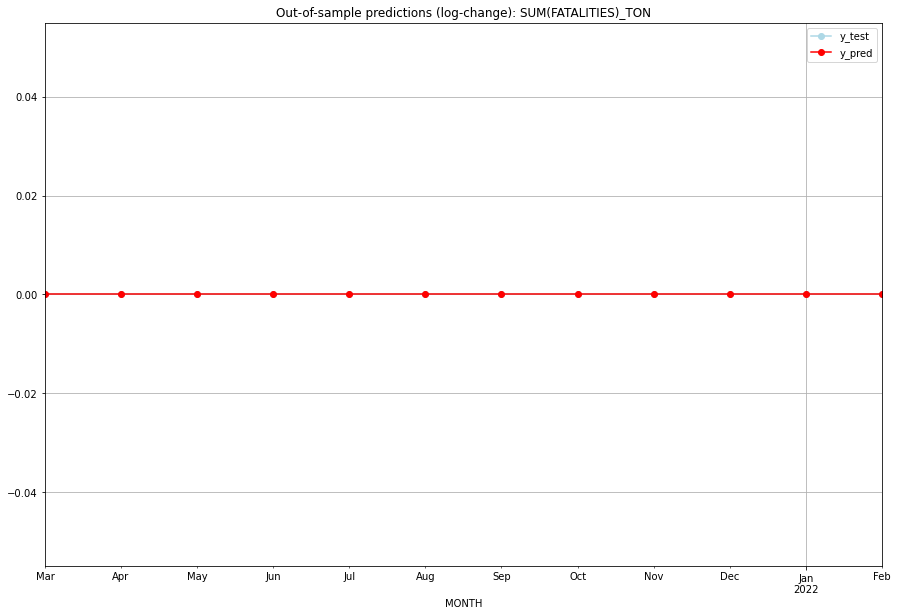

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   TON   
1  2021-04-01       0.0         0.0           0.0             0.0   TON   
2  2021-05-01       0.0         0.0           0.0             0.0   TON   
3  2021-06-01       0.0         0.0           0.0             0.0   TON   
4  2021-07-01       0.0         0.0           0.0             0.0   TON   
5  2021-08-01       0.0         0.0           0.0             0.0   TON   
6  2021-09-01       0.0         0.0           0.0             0.0   TON   
7  2021-10-01       0.0         0.0           0.0             0.0   TON   
8  2021-11-01       0.0         0.0           0.0             0.0   TON   
9  2021-12-01       0.0         0.0           0.0             0.0   TON   
10 2022-01-01       0.0         0.0           0.0             0.0   TON   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (3, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5112529757927595, 'fold_results': [0.4986994838526, 0.5238064677329192]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TTO   No. Observations:                   38
Model:                SARIMAX(3, 0, 0)   Log Likelihood                 -35.136
Date:                 Wed, 19 Oct 2022   AIC                             78.273
Time:                         11:10:14   BIC                             84.823
Sample:                     01-31-2018   HQIC                            80.604
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.4843      0.200

<Figure size 432x288 with 0 Axes>

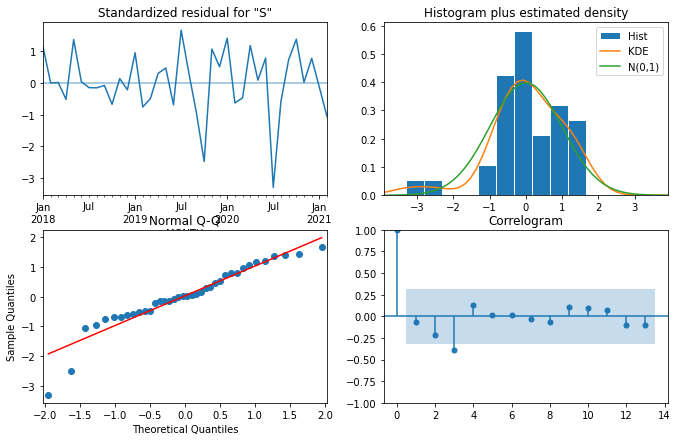

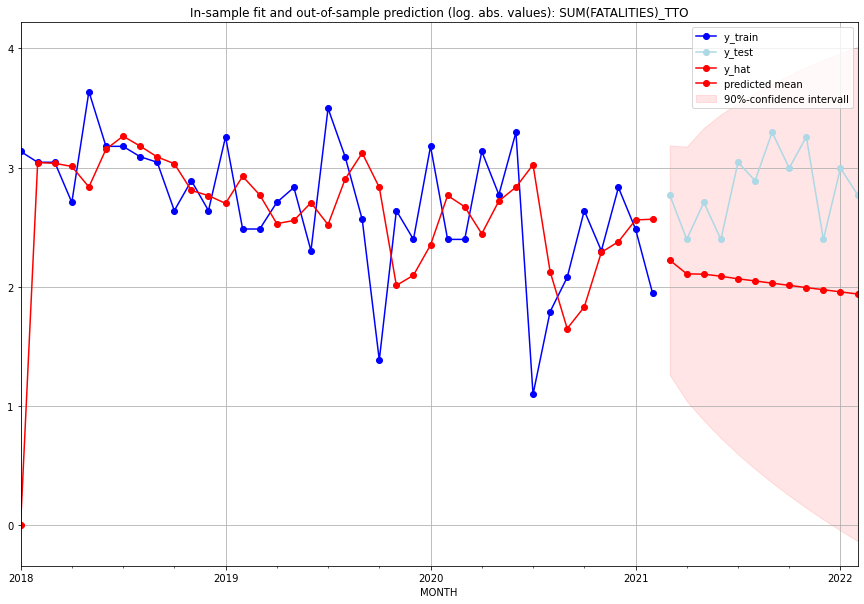

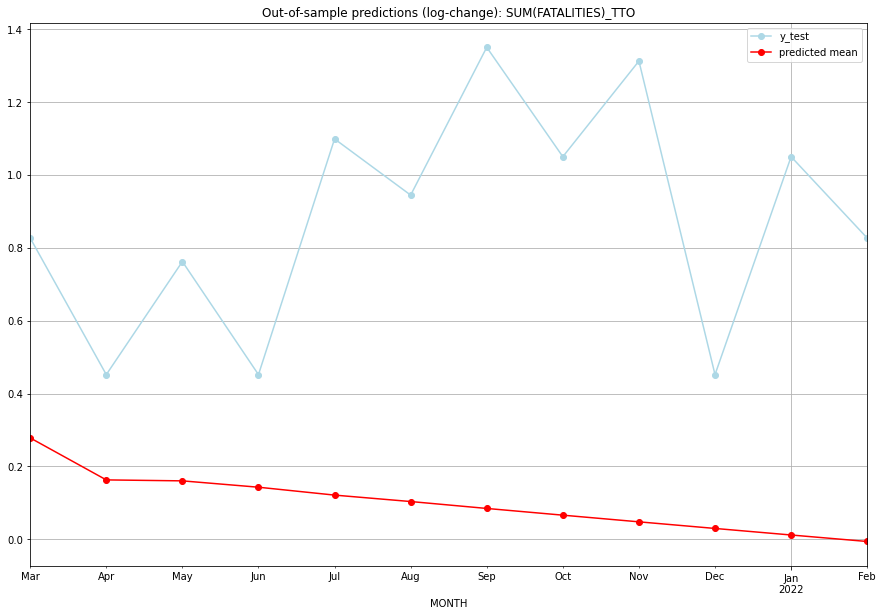

TADDA: 0.7813735790810549
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  8.246198        15.0      0.278302        0.826679   TTO   
1  2021-04-01  7.240370        10.0      0.163135        0.451985   TTO   
2  2021-05-01  7.218701        14.0      0.160502        0.762140   TTO   
3  2021-06-01  7.076697        10.0      0.143073        0.451985   TTO   
4  2021-07-01  6.903765        20.0      0.121429        1.098612   TTO   
5  2021-08-01  6.765473        17.0      0.103777        0.944462   TTO   
6  2021-09-01  6.619718        26.0      0.084829        1.349927   TTO   
7  2021-10-01  6.480483        19.0      0.066387        1.049822   TTO   
8  2021-11-01  6.344923        25.0      0.048099        1.312186   TTO   
9  2021-12-01  6.212814        10.0      0.029949        0.451985   TTO   
10 2022-01-01  6.084363        19.0      0.011980        1.049822   TTO   
11 2022-02-01  5.959302        15.0     -0.005831    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (2, 0, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.573521485695005, 'fold_results': [0.8332105292037205, 0.5602213328114237, 0.44335126277509285, 0.4737763856899431, 0.557047917994845]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TUN   No. Observations:                  289
Model:                SARIMAX(2, 0, 3)   Log Likelihood                -305.300
Date:                 Wed, 19 Oct 2022   AIC                            622.599
Time:                         11:10:28   BIC                            644.598
Sample:                     02-28-1997   HQIC                           631.414
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------

<Figure size 432x288 with 0 Axes>

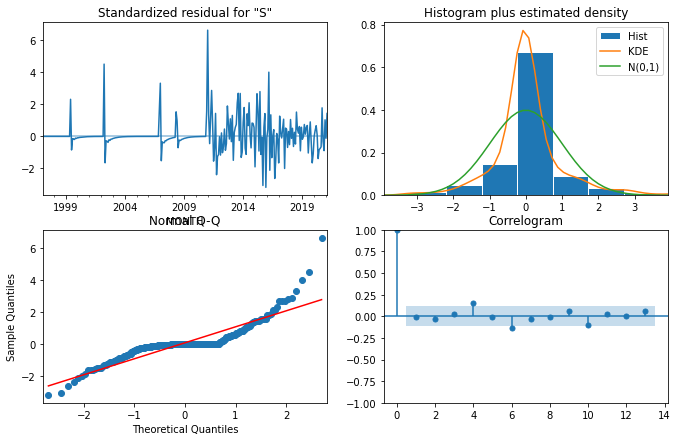

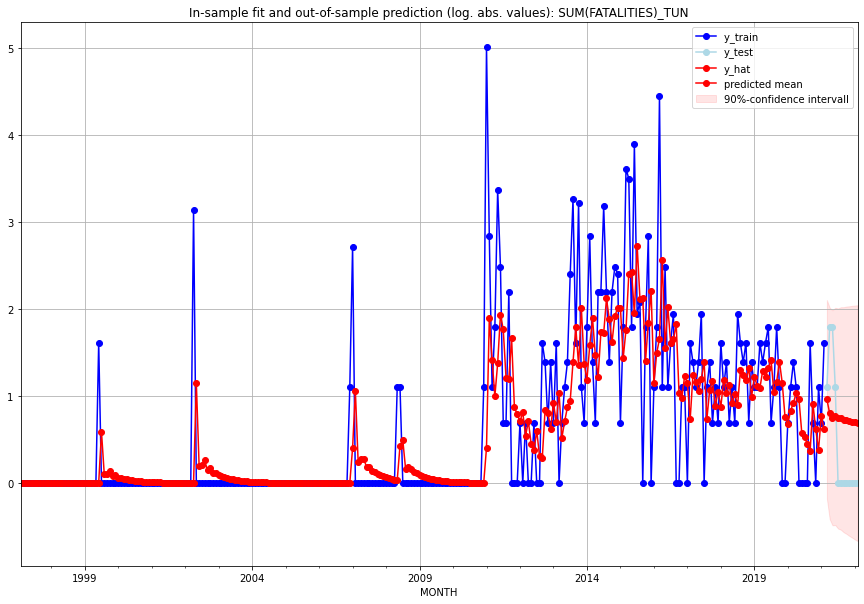

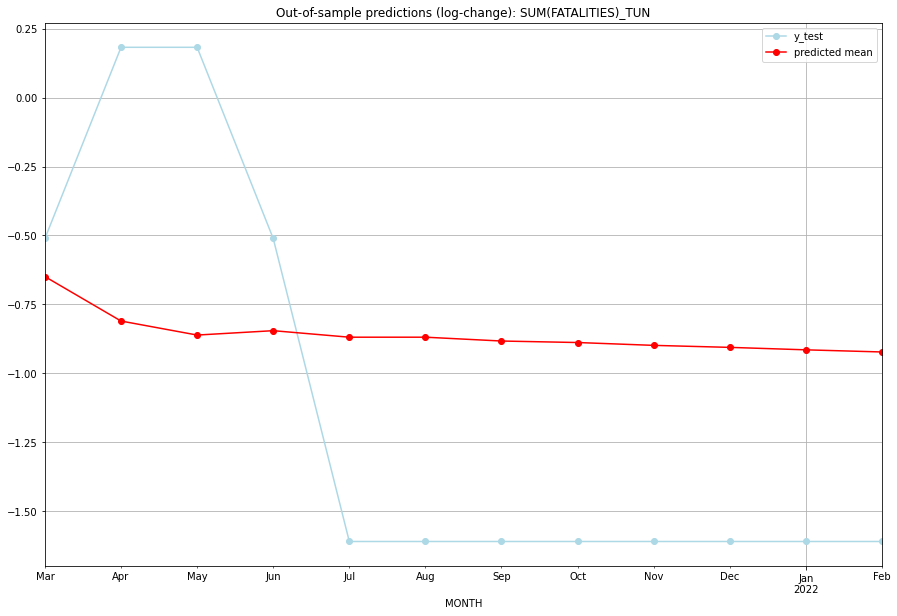

TADDA: 0.8254925063691313
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.612699         2.0     -0.649054       -0.510826   TUN   
1  2021-04-01  1.223971         5.0     -0.810143        0.182322   TUN   
2  2021-05-01  1.113760         5.0     -0.860970        0.182322   TUN   
3  2021-06-01  1.147595         2.0     -0.845089       -0.510826   TUN   
4  2021-07-01  1.097372         0.0     -0.868753       -1.609438   TUN   
5  2021-08-01  1.097466         0.0     -0.868708       -1.609438   TUN   
6  2021-09-01  1.068504         0.0     -0.882612       -1.609438   TUN   
7  2021-10-01  1.057288         0.0     -0.888049       -1.609438   TUN   
8  2021-11-01  1.036172         0.0     -0.898366       -1.609438   TUN   
9  2021-12-01  1.021459         0.0     -0.905619       -1.609438   TUN   
10 2022-01-01  1.003508         0.0     -0.914538       -1.609438   TUN   
11 2022-02-01  0.987998         0.0     -0.922310    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 1.0125348163476708, 'fold_results': [nan, 0.8636054950474951, 0.9820429853576685, 1.1919559686378491]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TUR   No. Observations:                   62
Model:                SARIMAX(1, 1, 3)   Log Likelihood                 -62.195
Date:                 Wed, 19 Oct 2022   AIC                            138.390
Time:                         11:10:36   BIC                            153.166
Sample:                     01-31-2016   HQIC                           144.181
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1  

<Figure size 432x288 with 0 Axes>

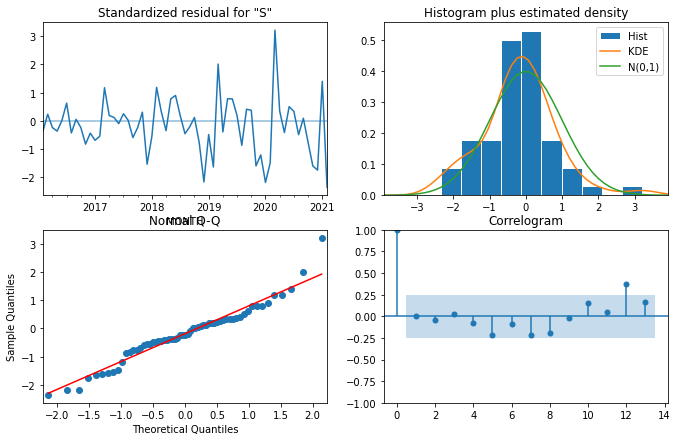

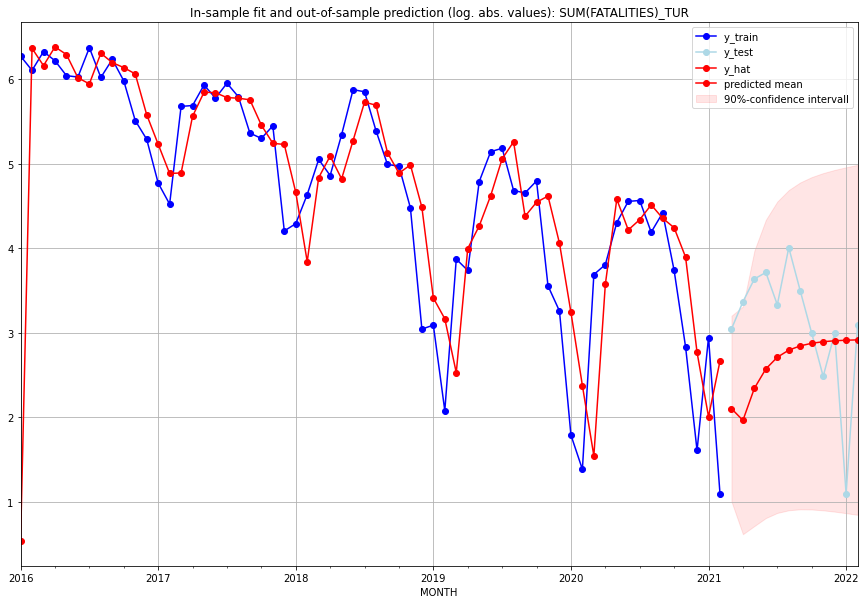

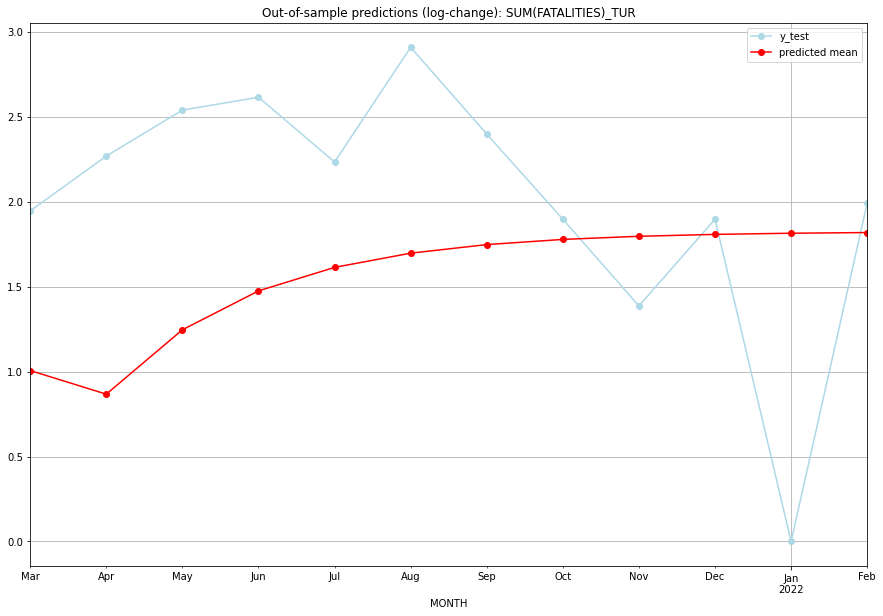

TADDA: 0.8219858048813076
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01   7.205821        20.0      1.006232        1.945910   TUR   
1  2021-04-01   6.139943        28.0      0.867092        2.268684   TUR   
2  2021-05-01   9.429154        37.0      1.245993        2.538974   TUR   
3  2021-06-01  12.112638        40.0      1.474964        2.614960   TUR   
4  2021-07-01  14.058537        27.0      1.613333        2.233592   TUR   
5  2021-08-01  15.371826        54.0      1.696950        2.908721   TUR   
6  2021-09-01  16.220353        32.0      1.747480        2.397895   TUR   
7  2021-10-01  16.754297        19.0      1.778015        1.897120   TUR   
8  2021-11-01  17.084955        11.0      1.796468        1.386294   TUR   
9  2021-12-01  17.287751        19.0      1.807619        1.897120   TUR   
10 2022-01-01  17.411403         2.0      1.814358        0.000000   TUR   
11 2022-02-01  17.486531        21.0     

<Figure size 432x288 with 0 Axes>

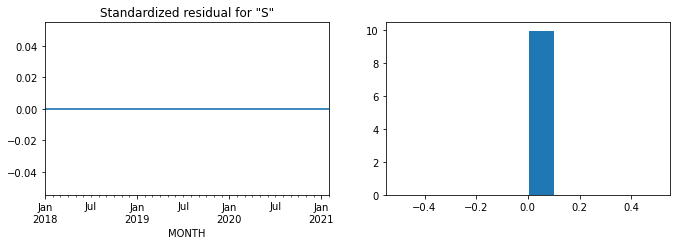

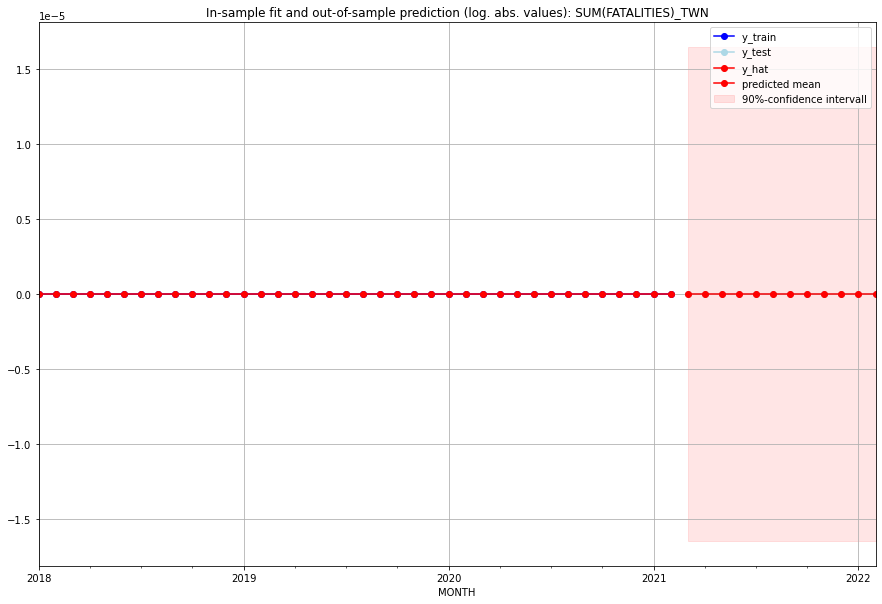

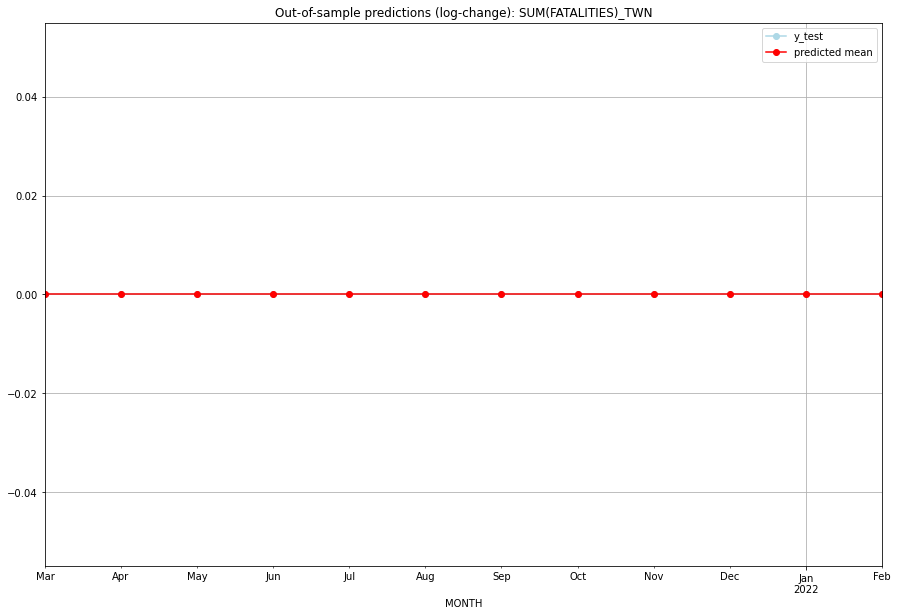

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   TWN   
1  2021-04-01       0.0         0.0           0.0             0.0   TWN   
2  2021-05-01       0.0         0.0           0.0             0.0   TWN   
3  2021-06-01       0.0         0.0           0.0             0.0   TWN   
4  2021-07-01       0.0         0.0           0.0             0.0   TWN   
5  2021-08-01       0.0         0.0           0.0             0.0   TWN   
6  2021-09-01       0.0         0.0           0.0             0.0   TWN   
7  2021-10-01       0.0         0.0           0.0             0.0   TWN   
8  2021-11-01       0.0         0.0           0.0             0.0   TWN   
9  2021-12-01       0.0         0.0           0.0             0.0   TWN   
10 2022-01-01       0.0         0.0           0.0             0.0   TWN   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 1), (0, 0, 0, 0), 'n'], 'cv_score': 1.0554062964525541, 'fold_results': [0.8018421569065021, 1.5472708038929472, 0.9410876302103034, 0.7496466757589674, 1.2371842154940516]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_TZA   No. Observations:                  289
Model:                SARIMAX(0, 1, 1)   Log Likelihood                -409.603
Date:                 Wed, 19 Oct 2022   AIC                            823.207
Time:                         11:11:00   BIC                            830.533
Sample:                     02-28-1997   HQIC                           826.142
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------

<Figure size 432x288 with 0 Axes>

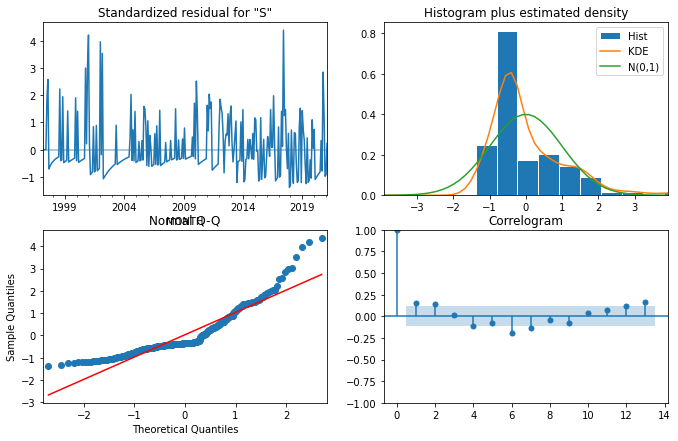

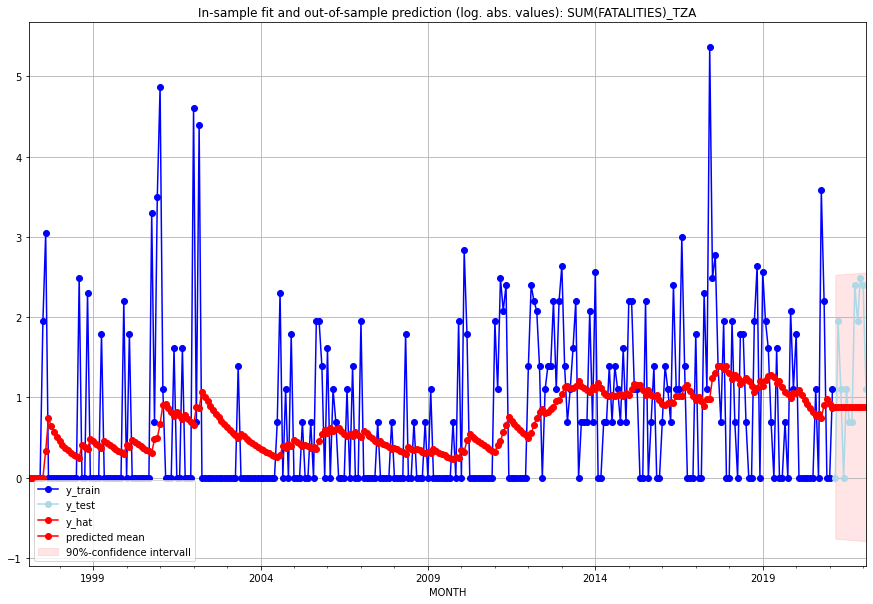

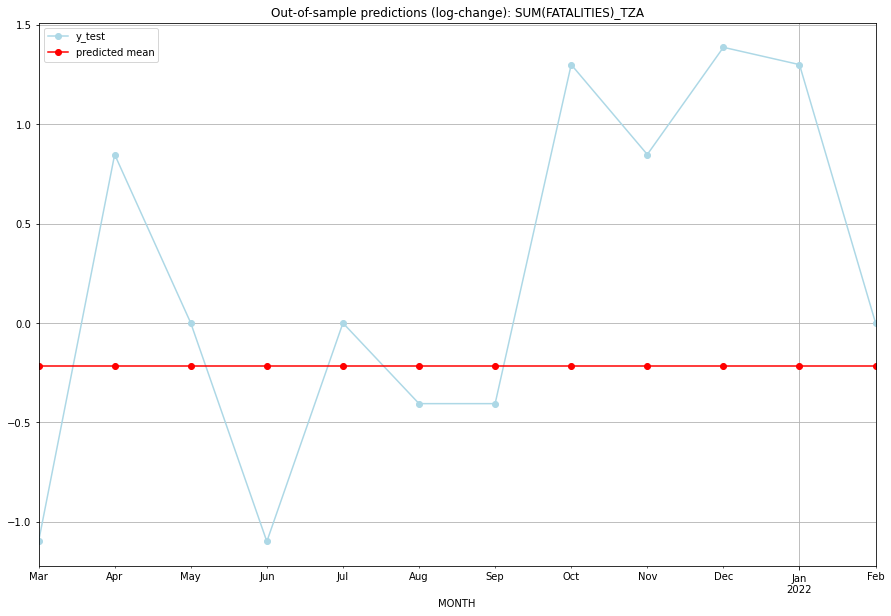

TADDA: 0.8858109920385827
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.417711         0.0     -0.215791       -1.098612   TZA   
1  2021-04-01  1.417711         6.0     -0.215791        0.847298   TZA   
2  2021-05-01  1.417711         2.0     -0.215791        0.000000   TZA   
3  2021-06-01  1.417711         0.0     -0.215791       -1.098612   TZA   
4  2021-07-01  1.417711         2.0     -0.215791        0.000000   TZA   
5  2021-08-01  1.417711         1.0     -0.215791       -0.405465   TZA   
6  2021-09-01  1.417711         1.0     -0.215791       -0.405465   TZA   
7  2021-10-01  1.417711        10.0     -0.215791        1.299283   TZA   
8  2021-11-01  1.417711         6.0     -0.215791        0.847298   TZA   
9  2021-12-01  1.417711        11.0     -0.215791        1.386294   TZA   
10 2022-01-01  1.417711        10.0     -0.215791        1.299283   TZA   
11 2022-02-01  1.417711         2.0     -0.215791    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6942697717144355, 'fold_results': [1.0028587664728958, 1.0477222482707786, 0.37194705474261003, 0.3539413956299396, 0.6948793934559528]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_UGA   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -486.596
Date:                 Wed, 19 Oct 2022   AIC                            975.191
Time:                         11:11:19   BIC                            978.854
Sample:                     02-28-1997   HQIC                           976.659
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

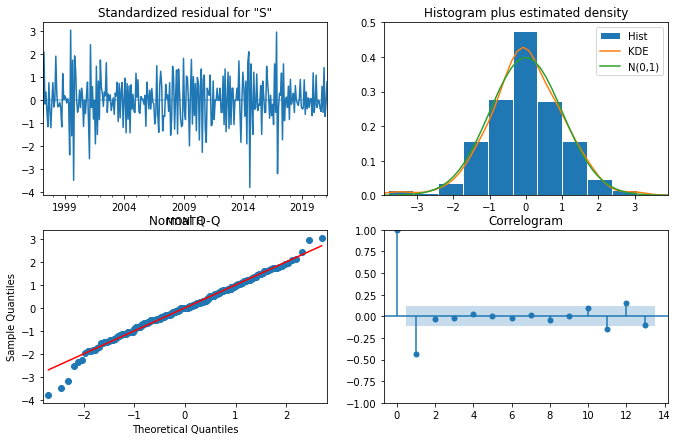

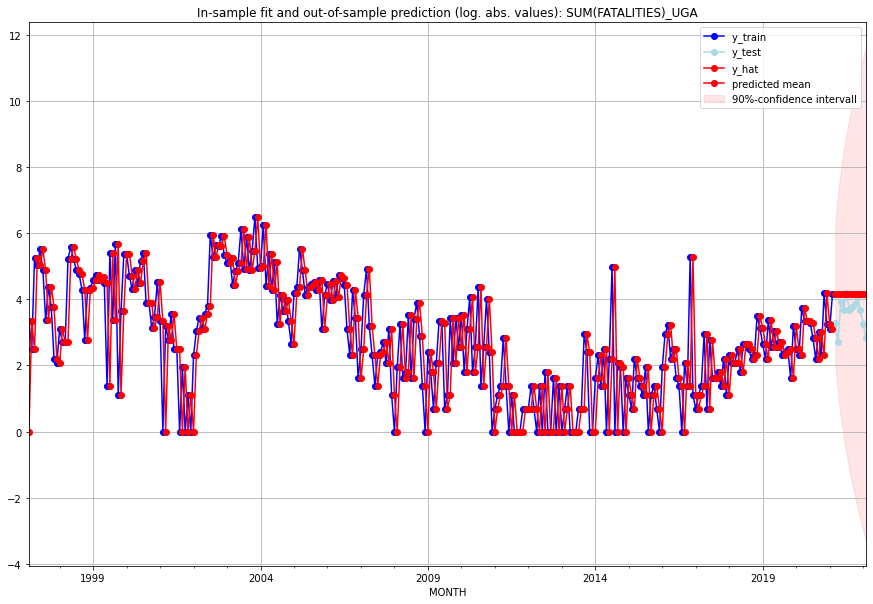

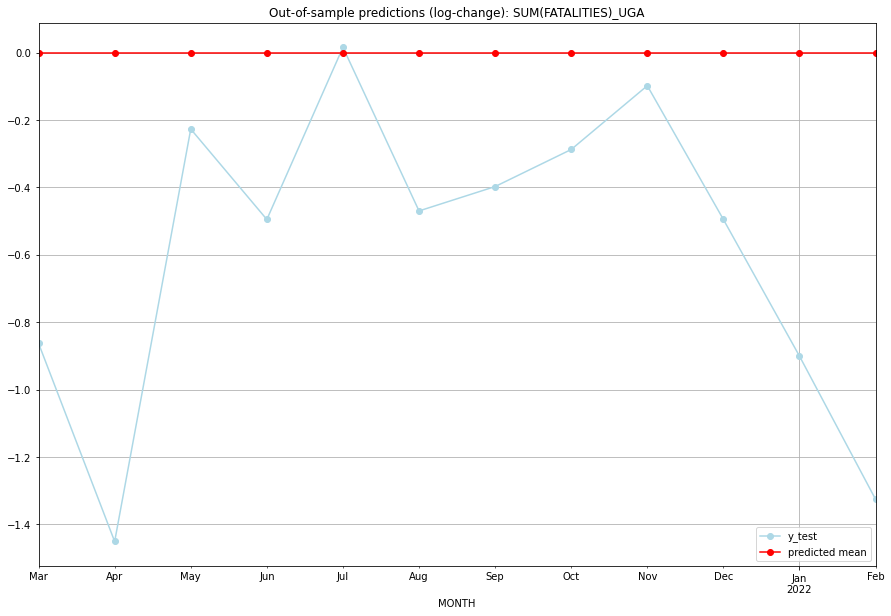

TADDA: 0.5856123865052247
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      63.0        26.0           0.0       -0.863046   UGA   
1  2021-04-01      63.0        14.0           0.0       -1.450833   UGA   
2  2021-05-01      63.0        50.0           0.0       -0.227057   UGA   
3  2021-06-01      63.0        38.0           0.0       -0.495321   UGA   
4  2021-07-01      63.0        64.0           0.0        0.015504   UGA   
5  2021-08-01      63.0        39.0           0.0       -0.470004   UGA   
6  2021-09-01      63.0        42.0           0.0       -0.397683   UGA   
7  2021-10-01      63.0        47.0           0.0       -0.287682   UGA   
8  2021-11-01      63.0        57.0           0.0       -0.098440   UGA   
9  2021-12-01      63.0        38.0           0.0       -0.495321   UGA   
10 2022-01-01      63.0        25.0           0.0       -0.900787   UGA   
11 2022-02-01      63.0        16.0           0.0    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 1), (0, 0, 0, 0), 'n'], 'cv_score': 0.5001980470432141, 'fold_results': [0.3414215464048693, 0.6589745476815588]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_UKR   No. Observations:                   38
Model:                SARIMAX(1, 0, 1)   Log Likelihood                 -25.594
Date:                 Wed, 19 Oct 2022   AIC                             61.189
Time:                         11:11:25   BIC                             69.377
Sample:                     01-31-2018   HQIC                            64.102
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0428      0.

<Figure size 432x288 with 0 Axes>

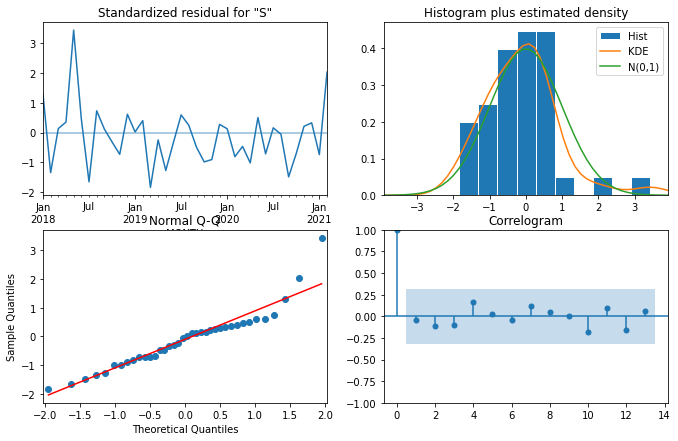

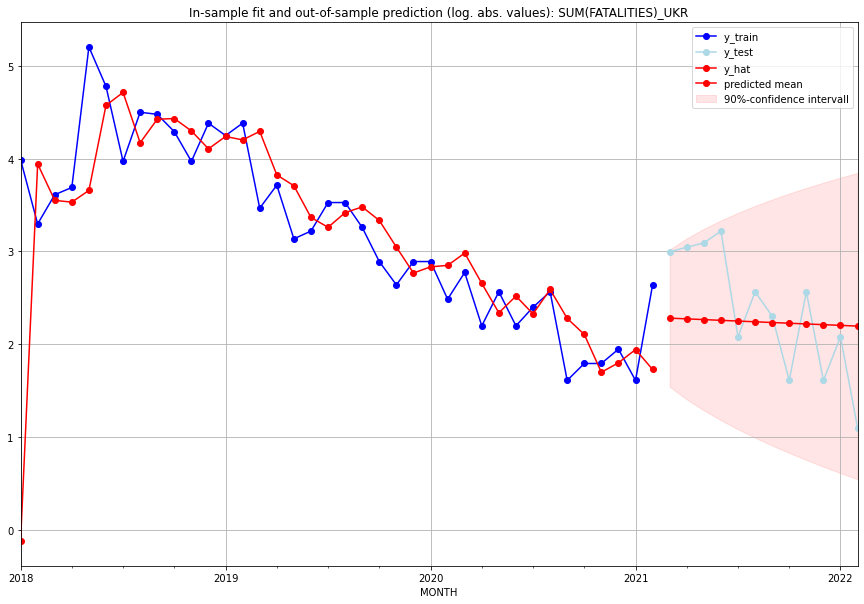

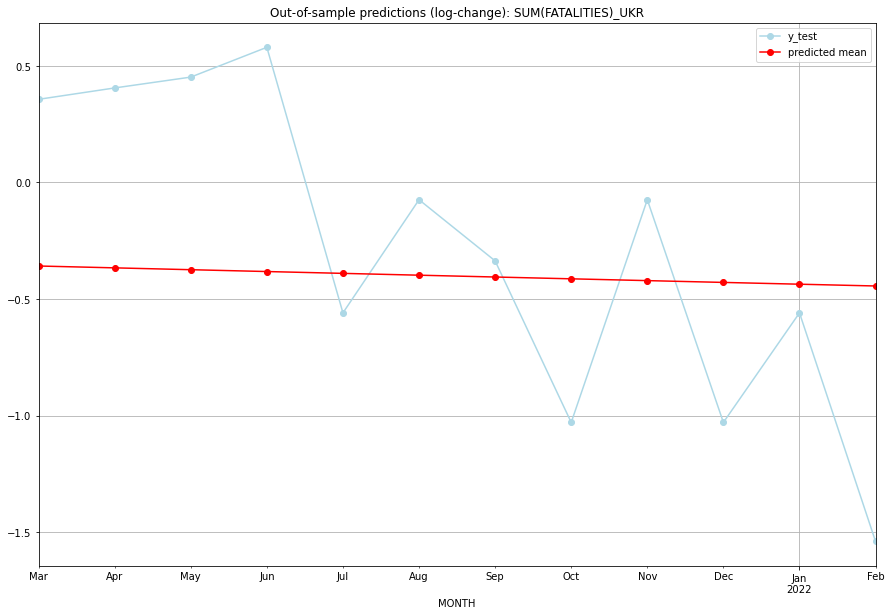

TADDA: 0.6752270808272574
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  8.782280        19.0     -0.358485        0.356675   UKR   
1  2021-04-01  8.704885        20.0     -0.366428        0.405465   UKR   
2  2021-05-01  8.628397        21.0     -0.374341        0.451985   UKR   
3  2021-06-01  8.552801        24.0     -0.382223        0.579818   UKR   
4  2021-07-01  8.478087         7.0     -0.390075       -0.559616   UKR   
5  2021-08-01  8.404241        12.0     -0.397897       -0.074108   UKR   
6  2021-09-01  8.331251         9.0     -0.405688       -0.336472   UKR   
7  2021-10-01  8.259104         4.0     -0.413450       -1.029619   UKR   
8  2021-11-01  8.187790        12.0     -0.421182       -0.074108   UKR   
9  2021-12-01  8.117296         4.0     -0.428884       -1.029619   UKR   
10 2022-01-01  8.047611         7.0     -0.436557       -0.559616   UKR   
11 2022-02-01  7.978723         2.0     -0.444200    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [3, (3, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.0053410901769499475, 'fold_results': [nan, 0.0053410901769499475]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_URY   No. Observations:                   38
Model:                SARIMAX(3, 1, 3)   Log Likelihood                  17.716
Date:                 Wed, 19 Oct 2022   AIC                            -15.432
Time:                         11:11:32   BIC                              0.677
Sample:                     01-31-2018   HQIC                            -9.753
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0391      0.013     -

<Figure size 432x288 with 0 Axes>

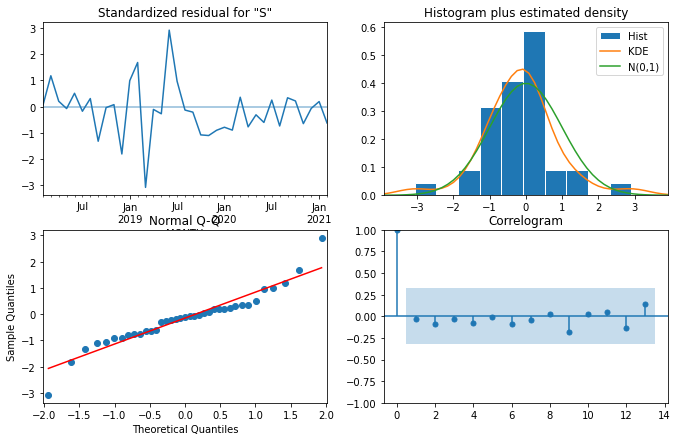

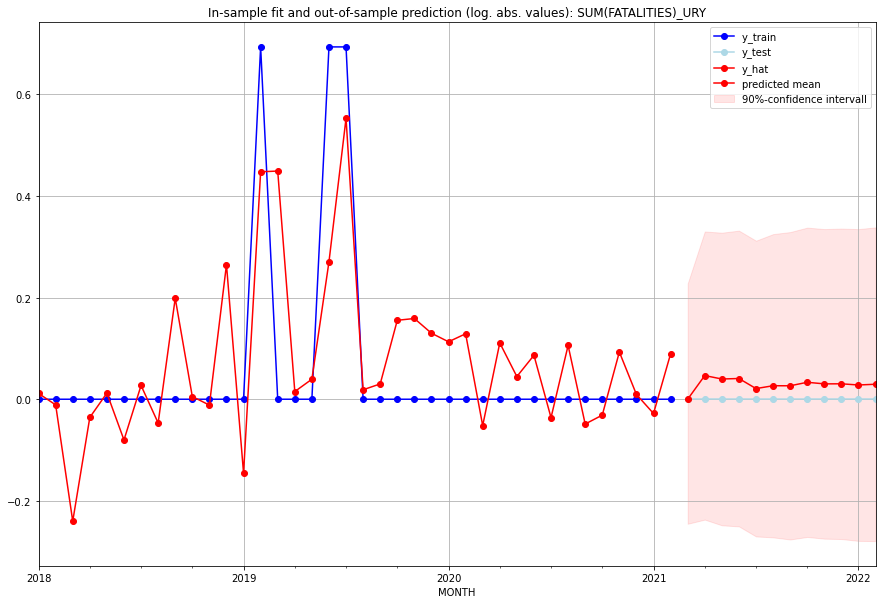

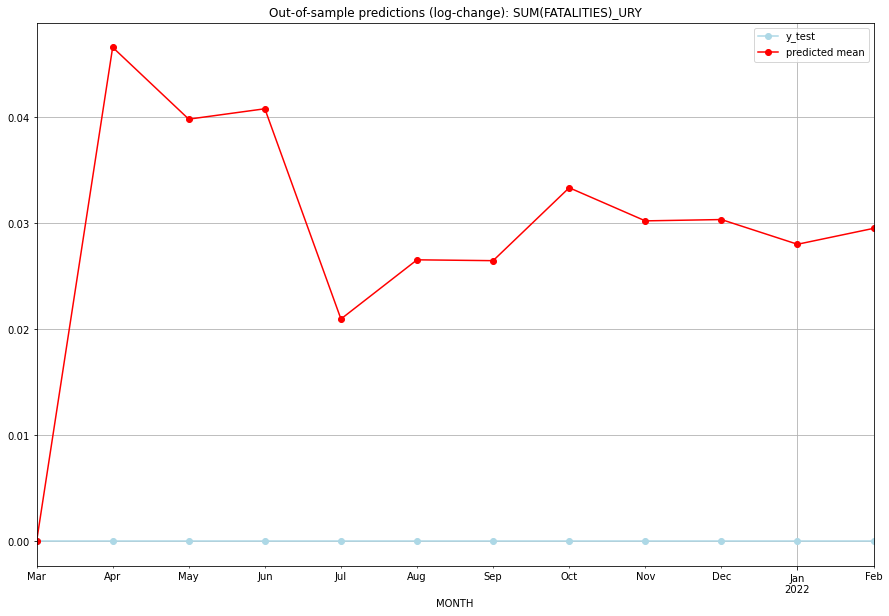

TADDA: 0.029370802279329252
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.000000         0.0      0.000000             0.0   URY   
1  2021-04-01  0.047660         0.0      0.046559             0.0   URY   
2  2021-05-01  0.040593         0.0      0.039791             0.0   URY   
3  2021-06-01  0.041611         0.0      0.040769             0.0   URY   
4  2021-07-01  0.021183         0.0      0.020962             0.0   URY   
5  2021-08-01  0.026893         0.0      0.026538             0.0   URY   
6  2021-09-01  0.026811         0.0      0.026458             0.0   URY   
7  2021-10-01  0.033890         0.0      0.033329             0.0   URY   
8  2021-11-01  0.030669         0.0      0.030208             0.0   URY   
9  2021-12-01  0.030796         0.0      0.030332             0.0   URY   
10 2022-01-01  0.028399         0.0      0.028003             0.0   URY   
11 2022-02-01  0.029941         0.0      0.029502  

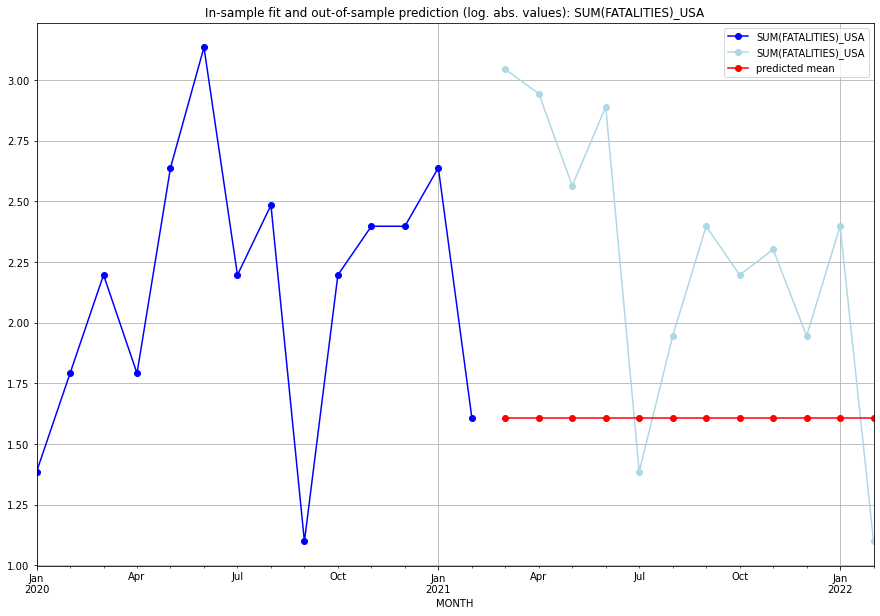

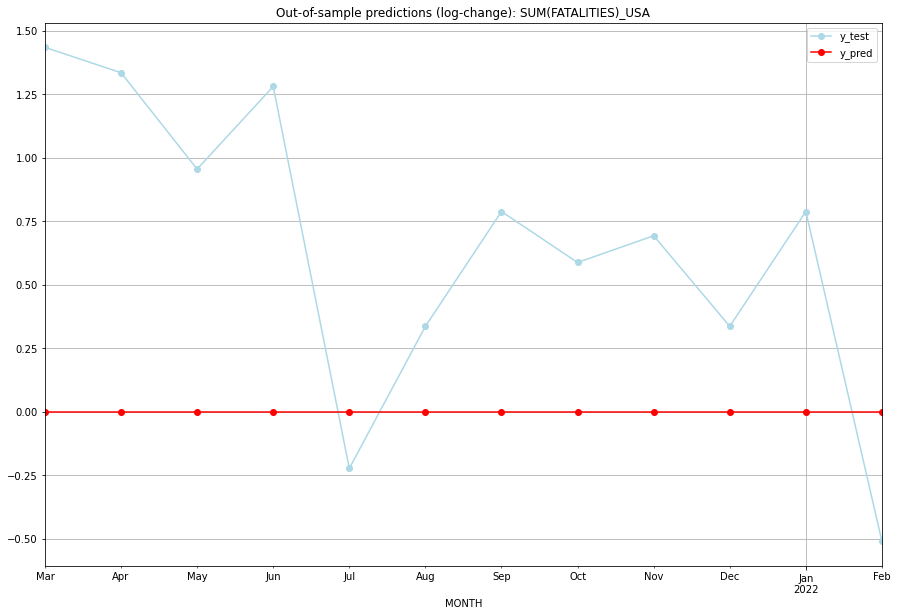

TADDA: 0.772607758085366
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.609438    3.044522           0.0        1.435085   USA   
1  2021-04-01  1.609438    2.944439           0.0        1.335001   USA   
2  2021-05-01  1.609438    2.564949           0.0        0.955511   USA   
3  2021-06-01  1.609438    2.890372           0.0        1.280934   USA   
4  2021-07-01  1.609438    1.386294           0.0       -0.223144   USA   
5  2021-08-01  1.609438    1.945910           0.0        0.336472   USA   
6  2021-09-01  1.609438    2.397895           0.0        0.788457   USA   
7  2021-10-01  1.609438    2.197225           0.0        0.587787   USA   
8  2021-11-01  1.609438    2.302585           0.0        0.693147   USA   
9  2021-12-01  1.609438    1.945910           0.0        0.336472   USA   
10 2022-01-01  1.609438    2.397895           0.0        0.788457   USA   
11 2022-02-01  1.609438    1.098612           0.0     

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.20707555414900003, 'fold_results': [0.20707555414900003, 0.20707555414900003]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_UZB   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                 -14.673
Date:                 Wed, 19 Oct 2022   AIC                             31.346
Time:                         11:11:41   BIC                             32.984
Sample:                     01-31-2018   HQIC                            31.929
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1267     

<Figure size 432x288 with 0 Axes>

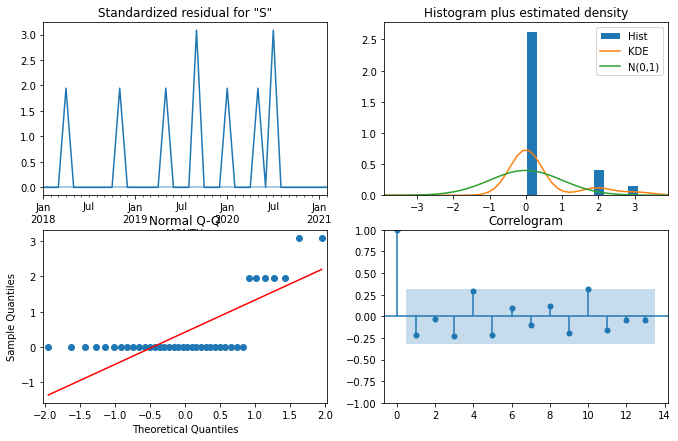

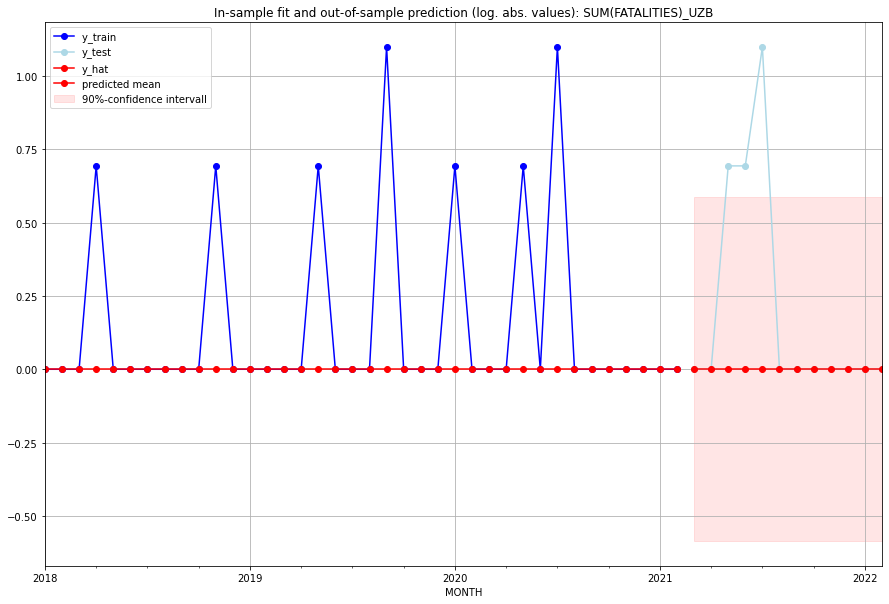

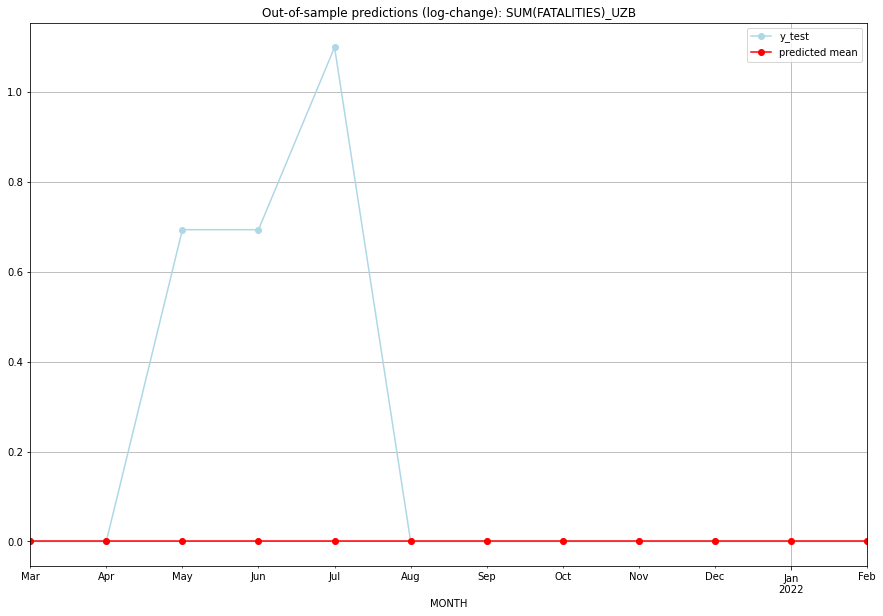

TADDA: 0.20707555414900003
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   UZB   
1  2021-04-01       0.0         0.0           0.0        0.000000   UZB   
2  2021-05-01       0.0         1.0           0.0        0.693147   UZB   
3  2021-06-01       0.0         1.0           0.0        0.693147   UZB   
4  2021-07-01       0.0         2.0           0.0        1.098612   UZB   
5  2021-08-01       0.0         0.0           0.0        0.000000   UZB   
6  2021-09-01       0.0         0.0           0.0        0.000000   UZB   
7  2021-10-01       0.0         0.0           0.0        0.000000   UZB   
8  2021-11-01       0.0         0.0           0.0        0.000000   UZB   
9  2021-12-01       0.0         0.0           0.0        0.000000   UZB   
10 2022-01-01       0.0         0.0           0.0        0.000000   UZB   
11 2022-02-01       0.0         0.0           0.0   

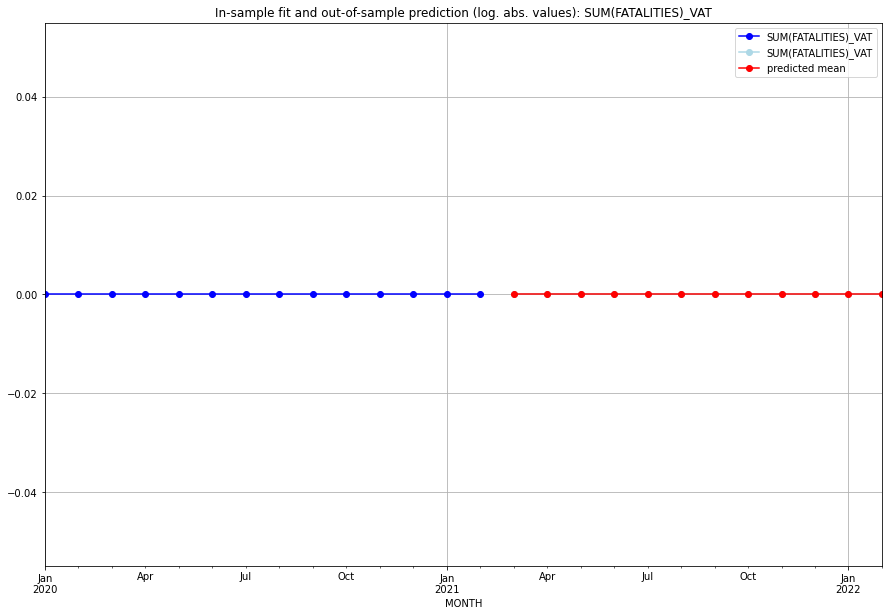

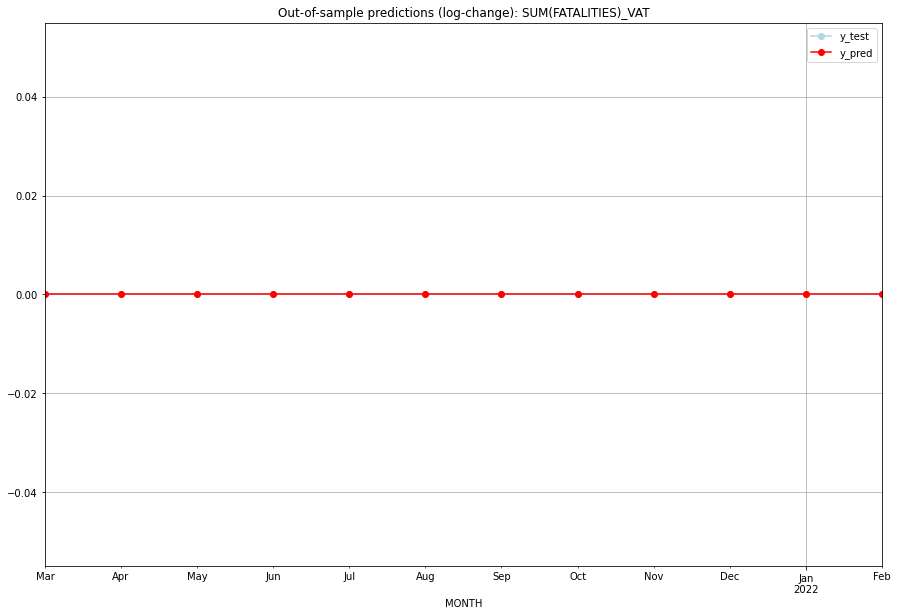

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   VAT   
1  2021-04-01       0.0         0.0           0.0             0.0   VAT   
2  2021-05-01       0.0         0.0           0.0             0.0   VAT   
3  2021-06-01       0.0         0.0           0.0             0.0   VAT   
4  2021-07-01       0.0         0.0           0.0             0.0   VAT   
5  2021-08-01       0.0         0.0           0.0             0.0   VAT   
6  2021-09-01       0.0         0.0           0.0             0.0   VAT   
7  2021-10-01       0.0         0.0           0.0             0.0   VAT   
8  2021-11-01       0.0         0.0           0.0             0.0   VAT   
9  2021-12-01       0.0         0.0           0.0             0.0   VAT   
10 2022-01-01       0.0         0.0           0.0             0.0   VAT   
11 2022-02-01       0.0         0.0           0.0             0.0   

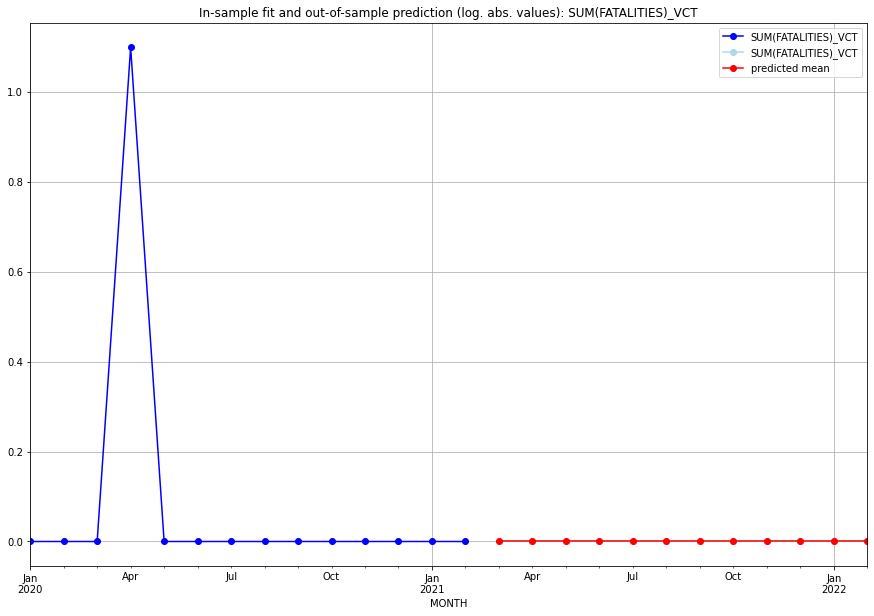

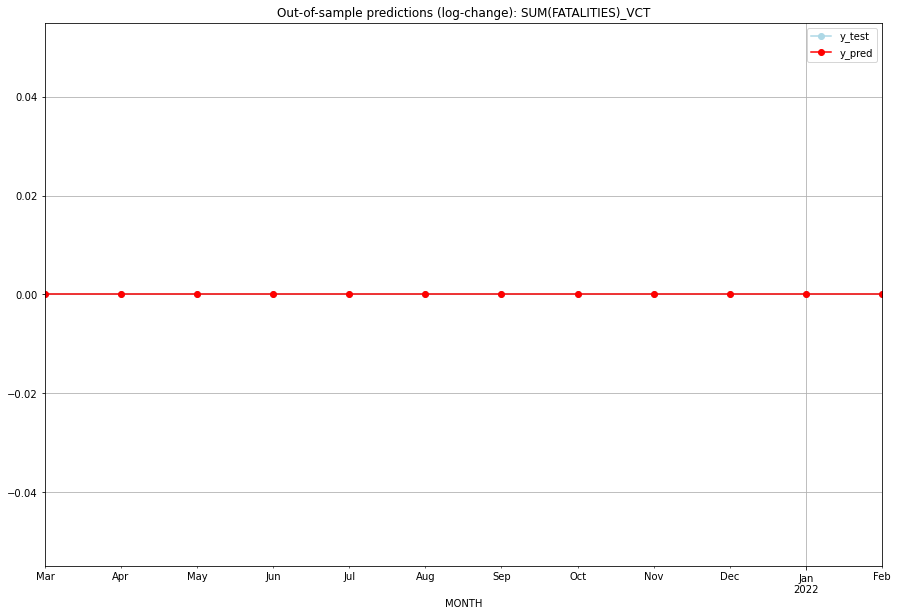

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   VCT   
1  2021-04-01       0.0         0.0           0.0             0.0   VCT   
2  2021-05-01       0.0         0.0           0.0             0.0   VCT   
3  2021-06-01       0.0         0.0           0.0             0.0   VCT   
4  2021-07-01       0.0         0.0           0.0             0.0   VCT   
5  2021-08-01       0.0         0.0           0.0             0.0   VCT   
6  2021-09-01       0.0         0.0           0.0             0.0   VCT   
7  2021-10-01       0.0         0.0           0.0             0.0   VCT   
8  2021-11-01       0.0         0.0           0.0             0.0   VCT   
9  2021-12-01       0.0         0.0           0.0             0.0   VCT   
10 2022-01-01       0.0         0.0           0.0             0.0   VCT   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6251676804277682, 'fold_results': [0.2767949561398318, 0.9735404047157045]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_VEN   No. Observations:                   38
Model:                SARIMAX(1, 0, 0)   Log Likelihood                 -38.513
Date:                 Wed, 19 Oct 2022   AIC                             85.025
Time:                         11:11:51   BIC                             91.576
Sample:                     01-31-2018   HQIC                            87.356
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0509      0.

<Figure size 432x288 with 0 Axes>

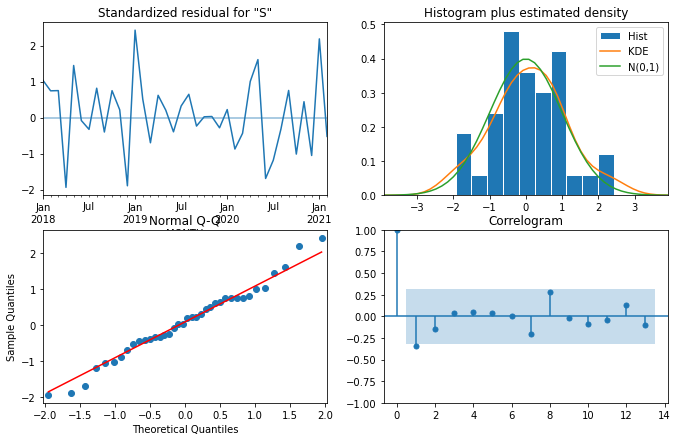

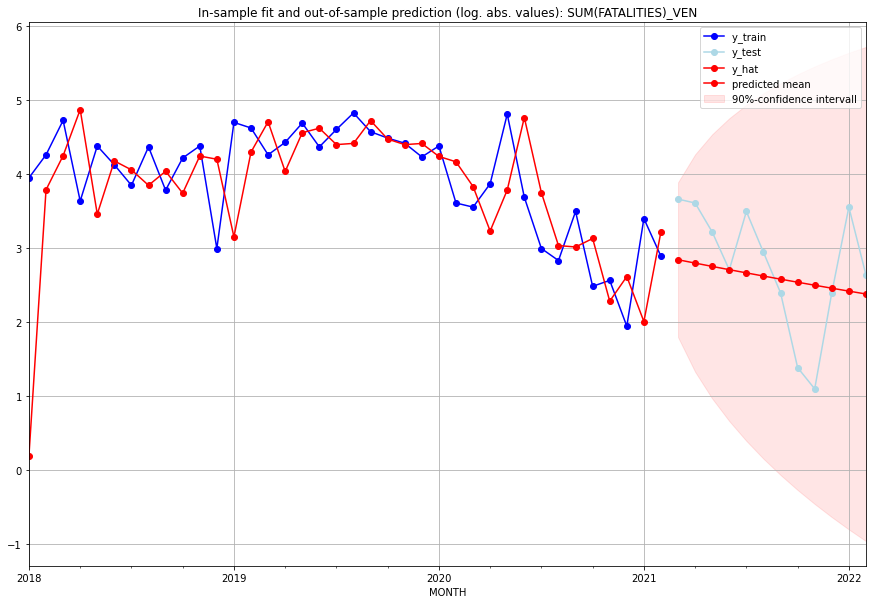

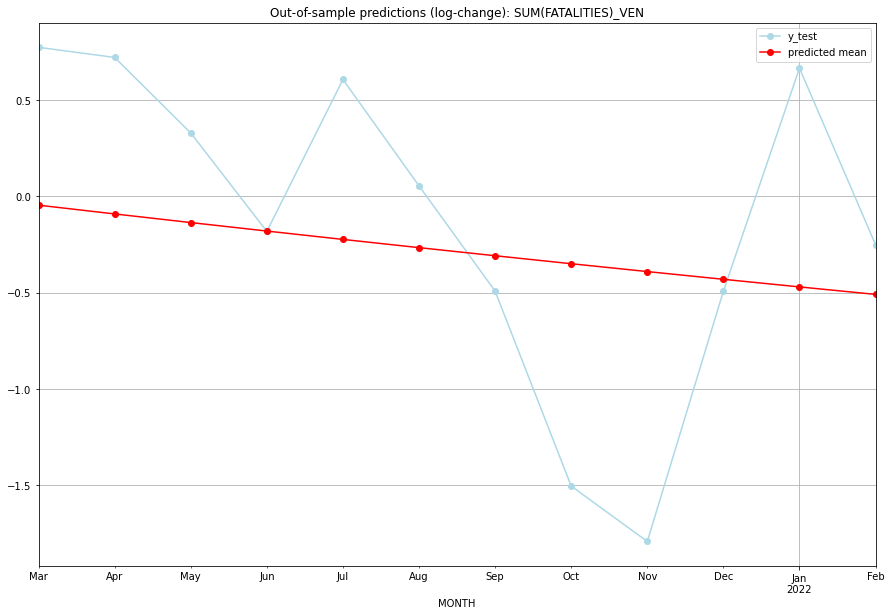

TADDA: 0.7231525022965006
Evaluation finished.
        MONTH   FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  16.187699        38.0     -0.046178        0.773190   VEN   
1  2021-04-01  15.423792        36.0     -0.091641        0.720546   VEN   
2  2021-05-01  14.704886        24.0     -0.136400        0.328504   VEN   
3  2021-06-01  14.027858        14.0     -0.180466       -0.182322   VEN   
4  2021-07-01  13.389830        32.0     -0.223850        0.606136   VEN   
5  2021-08-01  12.788148        18.0     -0.266562        0.054067   VEN   
6  2021-09-01  12.220363        10.0     -0.308613       -0.492476   VEN   
7  2021-10-01  11.684214         3.0     -0.350014       -1.504077   VEN   
8  2021-11-01  11.177611         2.0     -0.390773       -1.791759   VEN   
9  2021-12-01  10.698621        10.0     -0.430901       -0.492476   VEN   
10 2022-01-01  10.245455        34.0     -0.470408        0.664976   VEN   
11 2022-02-01   9.816457        13.0     

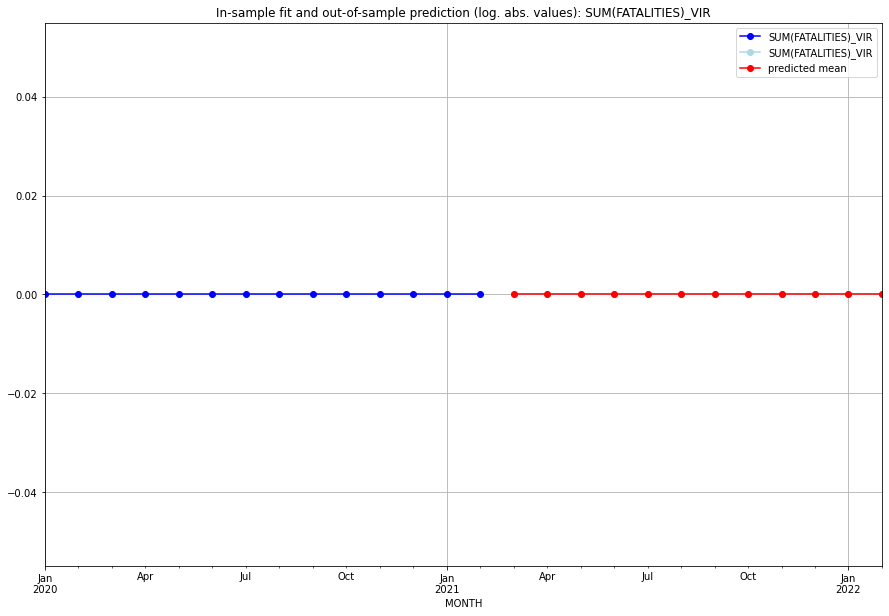

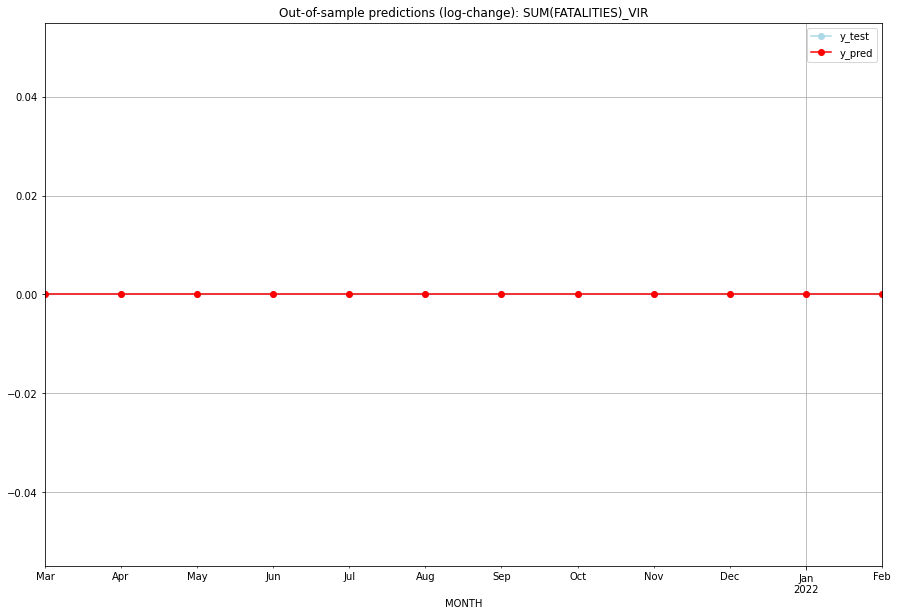

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   VIR   
1  2021-04-01       0.0         0.0           0.0             0.0   VIR   
2  2021-05-01       0.0         0.0           0.0             0.0   VIR   
3  2021-06-01       0.0         0.0           0.0             0.0   VIR   
4  2021-07-01       0.0         0.0           0.0             0.0   VIR   
5  2021-08-01       0.0         0.0           0.0             0.0   VIR   
6  2021-09-01       0.0         0.0           0.0             0.0   VIR   
7  2021-10-01       0.0         0.0           0.0             0.0   VIR   
8  2021-11-01       0.0         0.0           0.0             0.0   VIR   
9  2021-12-01       0.0         0.0           0.0             0.0   VIR   
10 2022-01-01       0.0         0.0           0.0             0.0   VIR   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.14910624710236195, 'fold_results': [0.23104906018664842, 0.17328679513998632, 0.1493132891023379, 0.19188209108283716, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_VNM   No. Observations:                  134
Model:                         SARIMAX   Log Likelihood                -132.136
Date:                 Wed, 19 Oct 2022   AIC                            266.272
Time:                         11:12:02   BIC                            269.170
Sample:                     01-31-2010   HQIC                           267.449
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------------------

<Figure size 432x288 with 0 Axes>

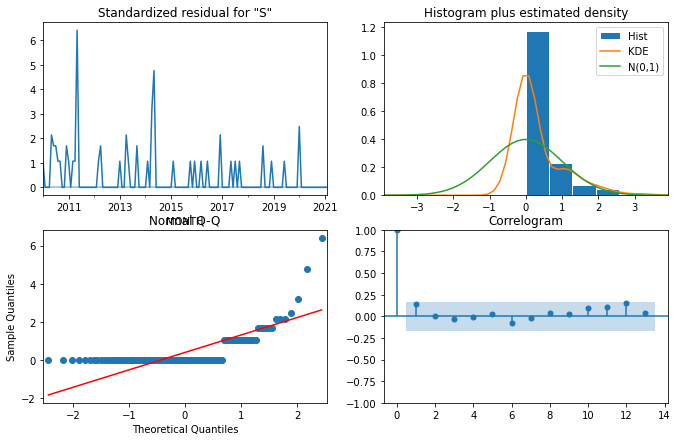

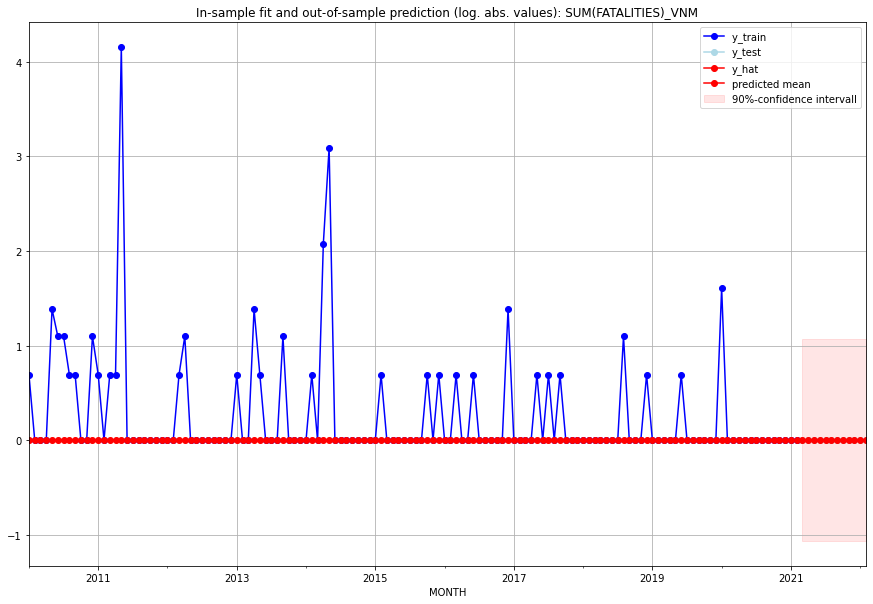

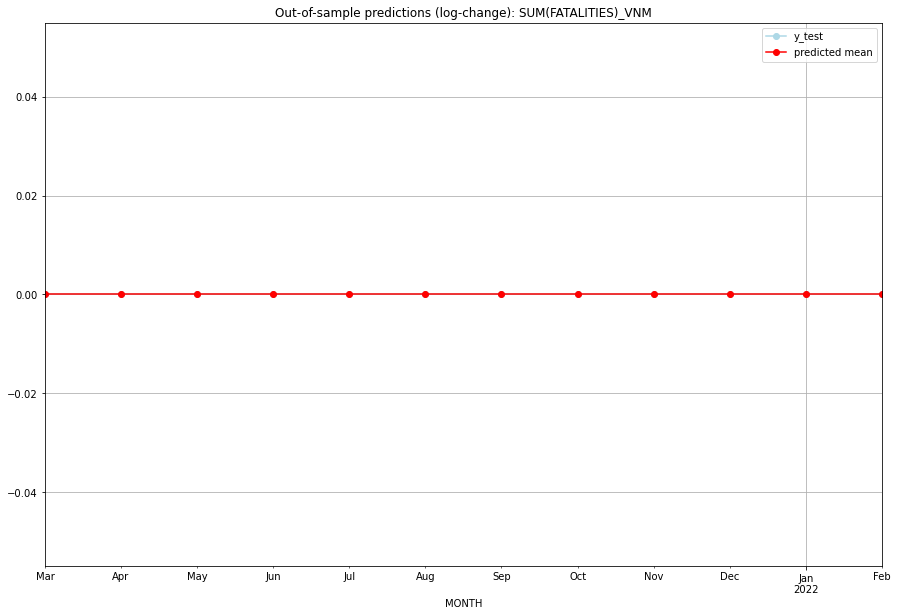

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   VNM   
1  2021-04-01       0.0         0.0           0.0             0.0   VNM   
2  2021-05-01       0.0         0.0           0.0             0.0   VNM   
3  2021-06-01       0.0         0.0           0.0             0.0   VNM   
4  2021-07-01       0.0         0.0           0.0             0.0   VNM   
5  2021-08-01       0.0         0.0           0.0             0.0   VNM   
6  2021-09-01       0.0         0.0           0.0             0.0   VNM   
7  2021-10-01       0.0         0.0           0.0             0.0   VNM   
8  2021-11-01       0.0         0.0           0.0             0.0   VNM   
9  2021-12-01       0.0         0.0           0.0             0.0   VNM   
10 2022-01-01       0.0         0.0           0.0             0.0   VNM   
11 2022-02-01       0.0         0.0           0.0             0.0   

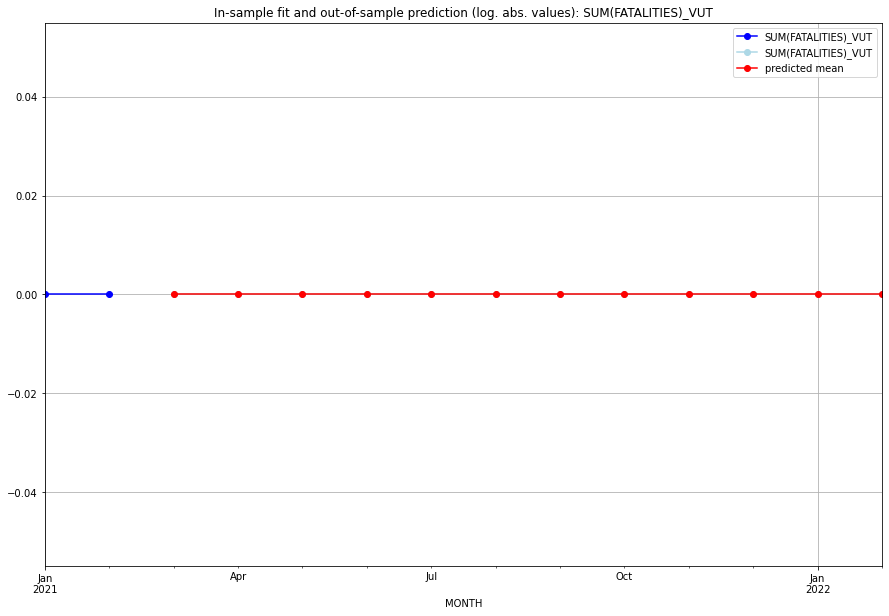

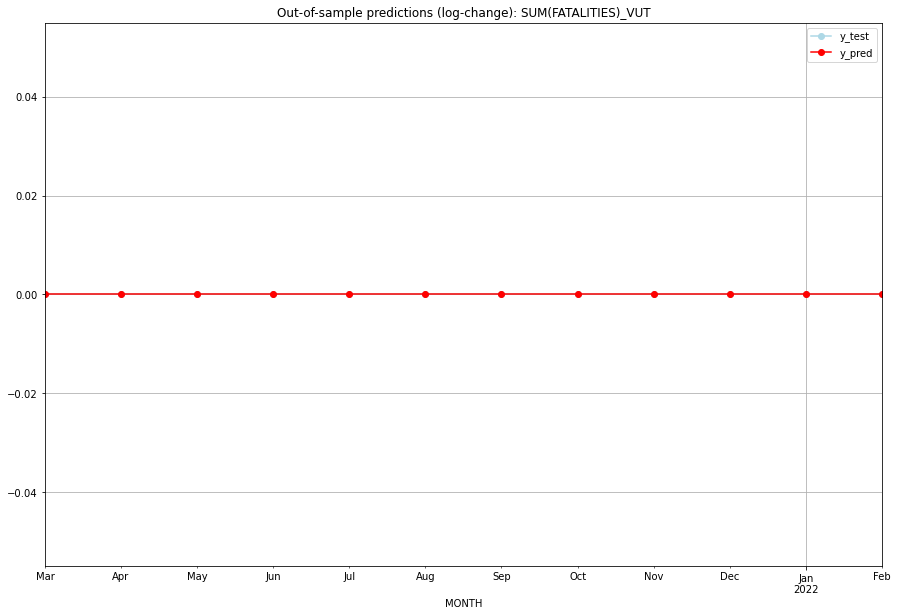

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   VUT   
1  2021-04-01       0.0         0.0           0.0             0.0   VUT   
2  2021-05-01       0.0         0.0           0.0             0.0   VUT   
3  2021-06-01       0.0         0.0           0.0             0.0   VUT   
4  2021-07-01       0.0         0.0           0.0             0.0   VUT   
5  2021-08-01       0.0         0.0           0.0             0.0   VUT   
6  2021-09-01       0.0         0.0           0.0             0.0   VUT   
7  2021-10-01       0.0         0.0           0.0             0.0   VUT   
8  2021-11-01       0.0         0.0           0.0             0.0   VUT   
9  2021-12-01       0.0         0.0           0.0             0.0   VUT   
10 2022-01-01       0.0         0.0           0.0             0.0   VUT   
11 2022-02-01       0.0         0.0           0.0             0.0   

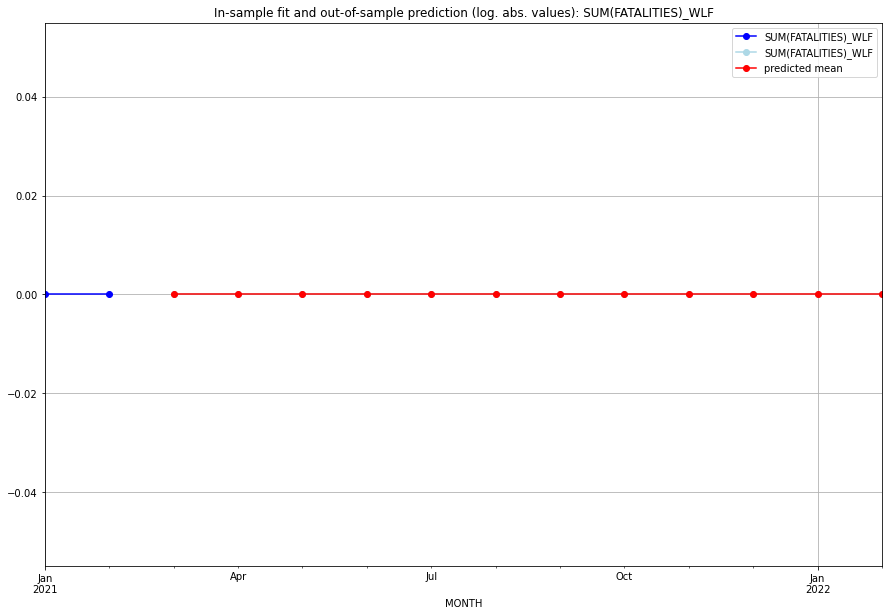

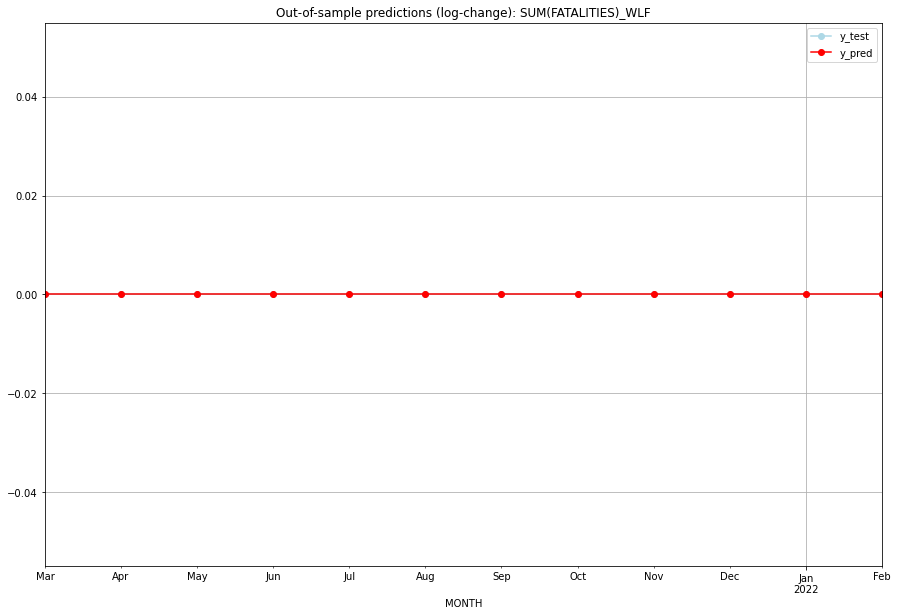

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   WLF   
1  2021-04-01       0.0         0.0           0.0             0.0   WLF   
2  2021-05-01       0.0         0.0           0.0             0.0   WLF   
3  2021-06-01       0.0         0.0           0.0             0.0   WLF   
4  2021-07-01       0.0         0.0           0.0             0.0   WLF   
5  2021-08-01       0.0         0.0           0.0             0.0   WLF   
6  2021-09-01       0.0         0.0           0.0             0.0   WLF   
7  2021-10-01       0.0         0.0           0.0             0.0   WLF   
8  2021-11-01       0.0         0.0           0.0             0.0   WLF   
9  2021-12-01       0.0         0.0           0.0             0.0   WLF   
10 2022-01-01       0.0         0.0           0.0             0.0   WLF   
11 2022-02-01       0.0         0.0           0.0             0.0   

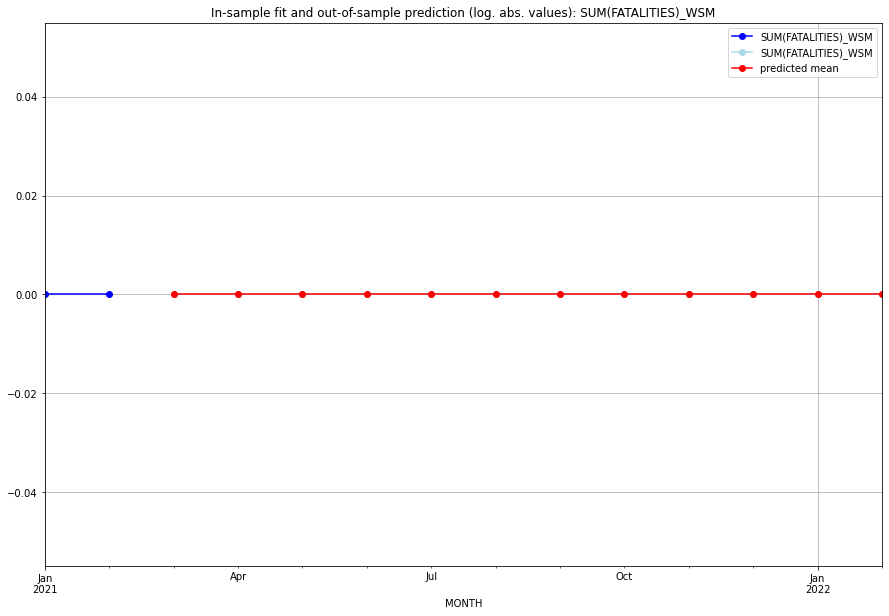

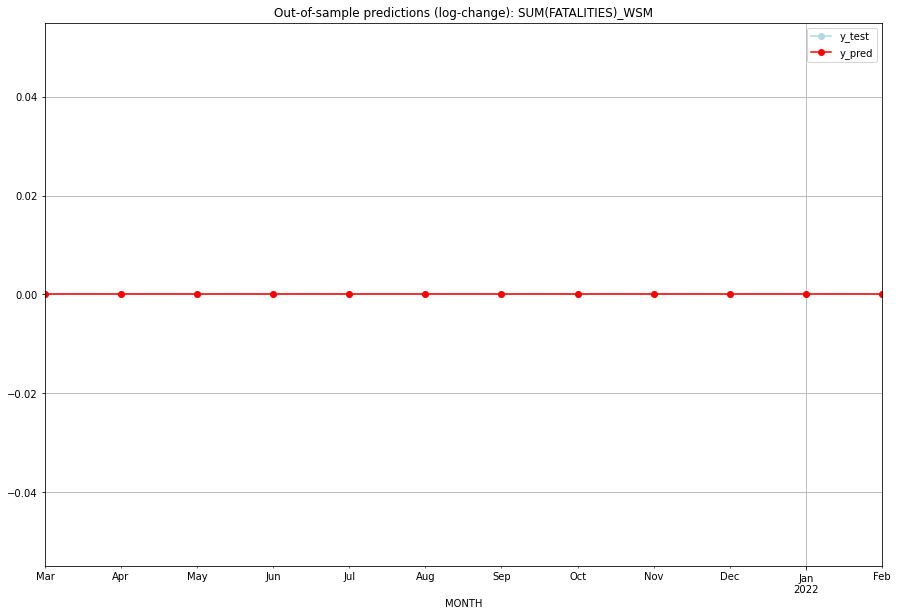

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   WSM   
1  2021-04-01       0.0         0.0           0.0             0.0   WSM   
2  2021-05-01       0.0         0.0           0.0             0.0   WSM   
3  2021-06-01       0.0         0.0           0.0             0.0   WSM   
4  2021-07-01       0.0         0.0           0.0             0.0   WSM   
5  2021-08-01       0.0         0.0           0.0             0.0   WSM   
6  2021-09-01       0.0         0.0           0.0             0.0   WSM   
7  2021-10-01       0.0         0.0           0.0             0.0   WSM   
8  2021-11-01       0.0         0.0           0.0             0.0   WSM   
9  2021-12-01       0.0         0.0           0.0             0.0   WSM   
10 2022-01-01       0.0         0.0           0.0             0.0   WSM   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.6977825046455781, 'fold_results': [0.8240253651090624, 0.6344437482950532, 0.49243308695331295, 0.8465080862195872, 0.6915022366508751]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XAR   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -426.428
Date:                 Wed, 19 Oct 2022   AIC                            858.856
Time:                         11:12:29   BIC                            869.855
Sample:                     02-28-1997   HQIC                           863.263
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

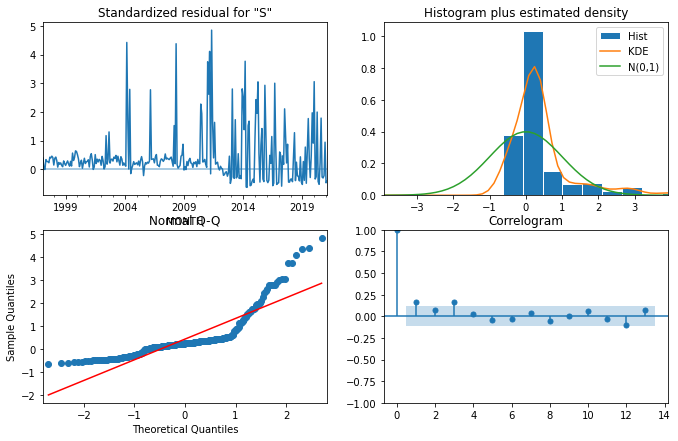

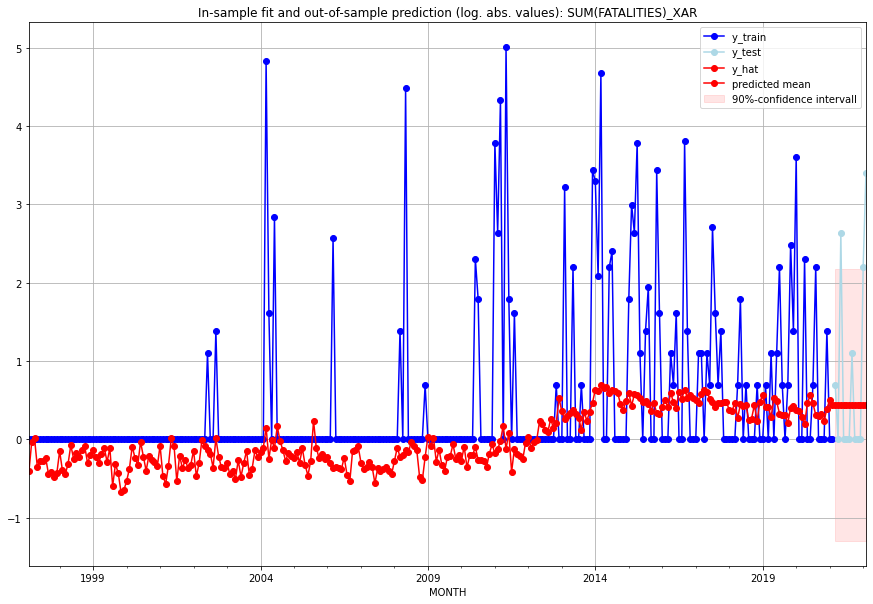

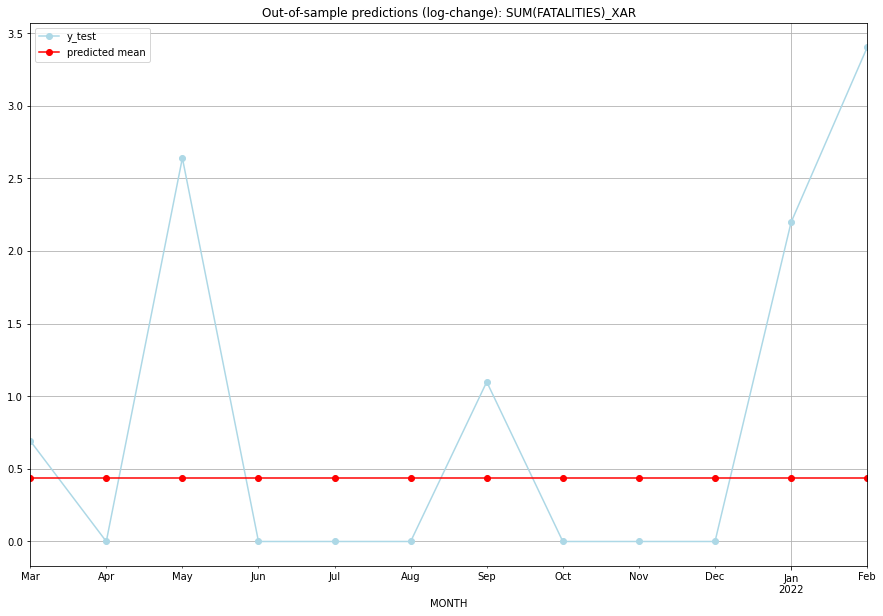

TADDA: 0.9090513213519523
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  0.552224         1.0      0.439689        0.693147   XAR   
1  2021-04-01  0.552224         0.0      0.439689        0.000000   XAR   
2  2021-05-01  0.552224        13.0      0.439689        2.639057   XAR   
3  2021-06-01  0.552224         0.0      0.439689        0.000000   XAR   
4  2021-07-01  0.552224         0.0      0.439689        0.000000   XAR   
5  2021-08-01  0.552224         0.0      0.439689        0.000000   XAR   
6  2021-09-01  0.552224         2.0      0.439689        1.098612   XAR   
7  2021-10-01  0.552224         0.0      0.439689        0.000000   XAR   
8  2021-11-01  0.552224         0.0      0.439689        0.000000   XAR   
9  2021-12-01  0.552224         0.0      0.439689        0.000000   XAR   
10 2022-01-01  0.552224         8.0      0.439689        2.197225   XAR   
11 2022-02-01  0.552224        29.0      0.439689    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XIT   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                 114.301
Date:                 Wed, 19 Oct 2022   AIC                           -226.602
Time:                         11:12:46   BIC                           -222.935
Sample:                     02-28-1997   HQIC                          -225.133
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0265      0.000    113.874      0.000     

<Figure size 432x288 with 0 Axes>

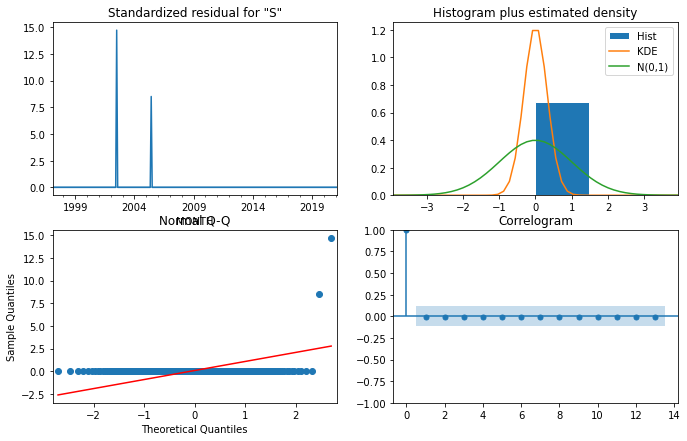

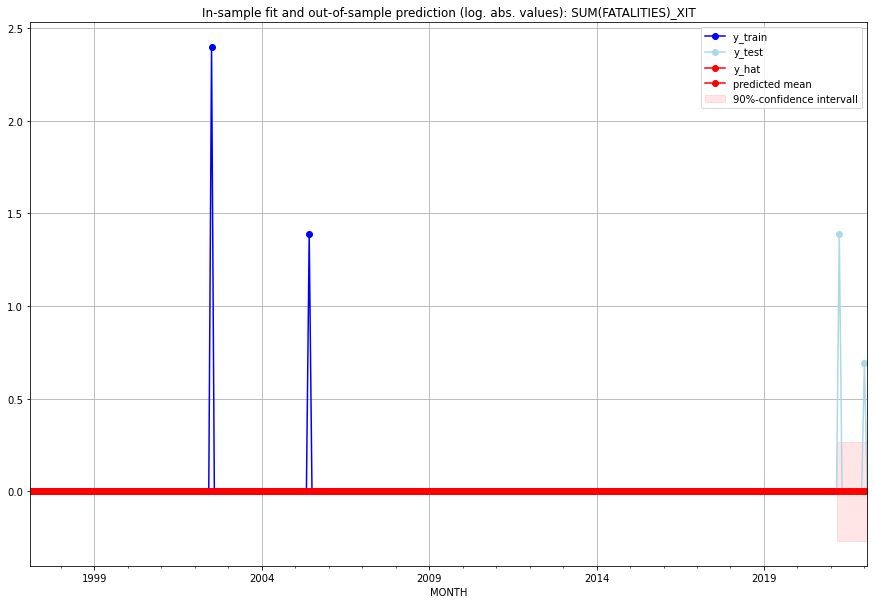

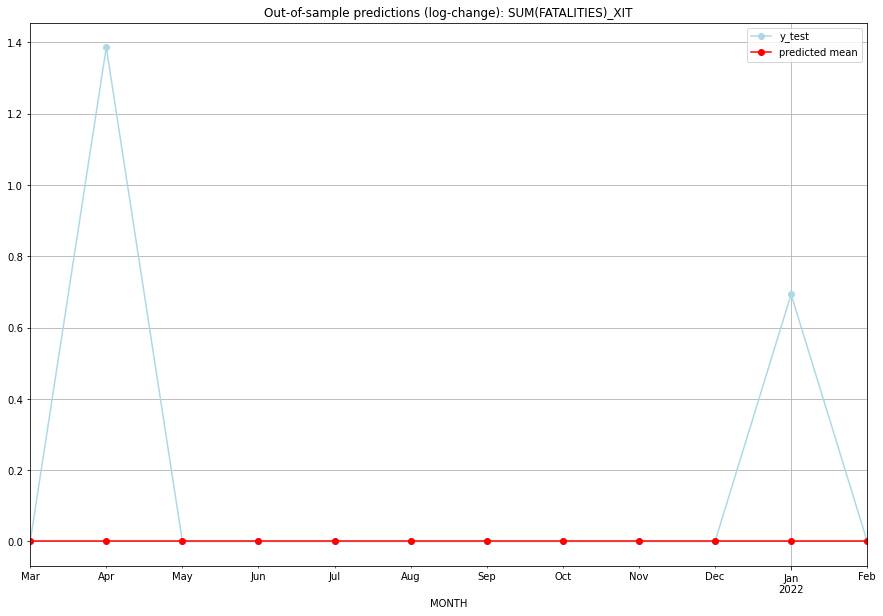

TADDA: 0.17328679513998632
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0        0.000000   XIT   
1  2021-04-01       0.0         3.0           0.0        1.386294   XIT   
2  2021-05-01       0.0         0.0           0.0        0.000000   XIT   
3  2021-06-01       0.0         0.0           0.0        0.000000   XIT   
4  2021-07-01       0.0         0.0           0.0        0.000000   XIT   
5  2021-08-01       0.0         0.0           0.0        0.000000   XIT   
6  2021-09-01       0.0         0.0           0.0        0.000000   XIT   
7  2021-10-01       0.0         0.0           0.0        0.000000   XIT   
8  2021-11-01       0.0         0.0           0.0        0.000000   XIT   
9  2021-12-01       0.0         0.0           0.0        0.000000   XIT   
10 2022-01-01       0.0         1.0           0.0        0.693147   XIT   
11 2022-02-01       0.0         0.0           0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.02986265782046758, 'fold_results': [0.0, 0.0, 0.0, 0.0, 0.1493132891023379]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XKK   No. Observations:                  289
Model:                         SARIMAX   Log Likelihood                -112.227
Date:                 Wed, 19 Oct 2022   AIC                            226.454
Time:                         11:13:04   BIC                            230.120
Sample:                     02-28-1997   HQIC                           227.923
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.1273      0

<Figure size 432x288 with 0 Axes>

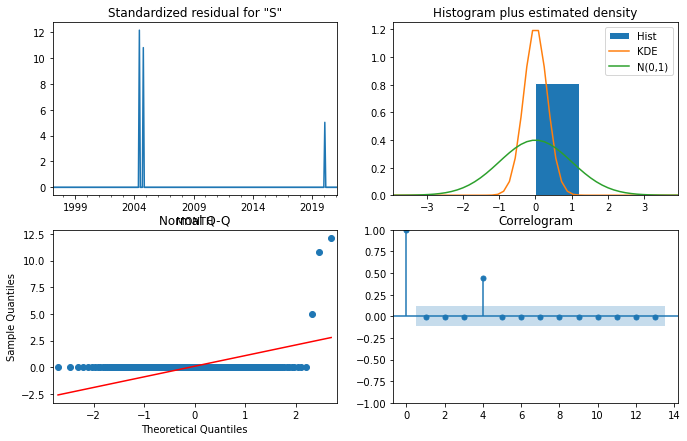

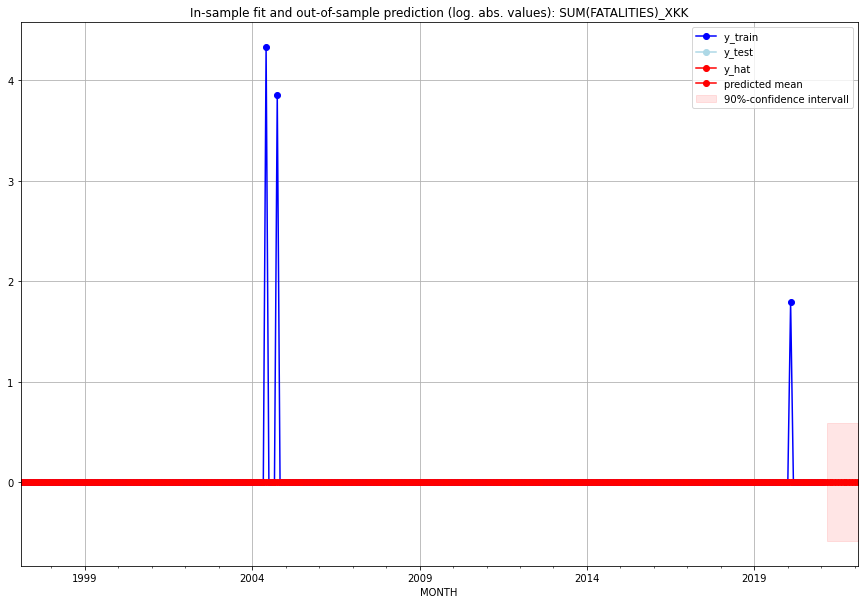

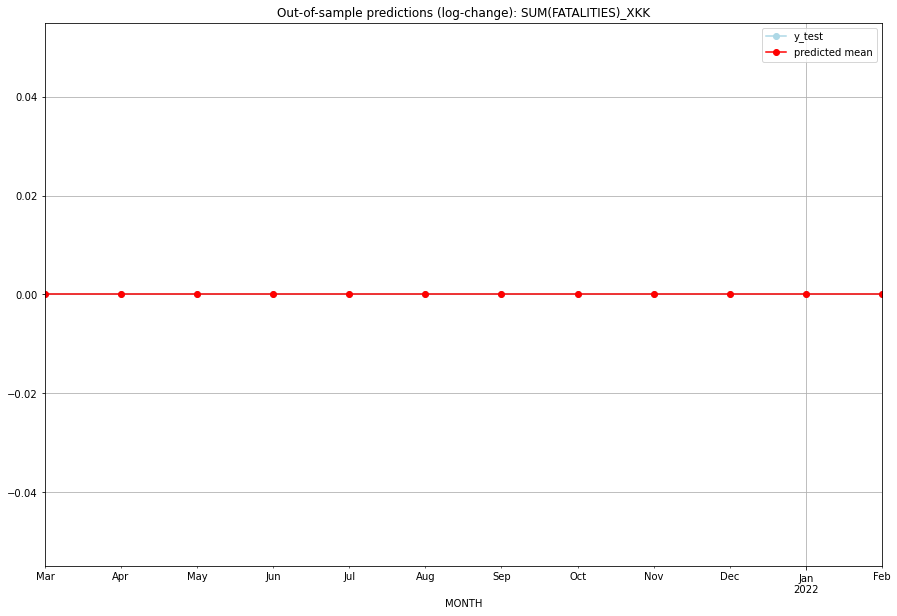

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   XKK   
1  2021-04-01       0.0         0.0           0.0             0.0   XKK   
2  2021-05-01       0.0         0.0           0.0             0.0   XKK   
3  2021-06-01       0.0         0.0           0.0             0.0   XKK   
4  2021-07-01       0.0         0.0           0.0             0.0   XKK   
5  2021-08-01       0.0         0.0           0.0             0.0   XKK   
6  2021-09-01       0.0         0.0           0.0             0.0   XKK   
7  2021-10-01       0.0         0.0           0.0             0.0   XKK   
8  2021-11-01       0.0         0.0           0.0             0.0   XKK   
9  2021-12-01       0.0         0.0           0.0             0.0   XKK   
10 2022-01-01       0.0         0.0           0.0             0.0   XKK   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 0, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [0.0, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XKO   No. Observations:                   38
Model:                         SARIMAX   Log Likelihood                   0.493
Date:                 Wed, 19 Oct 2022   AIC                              1.013
Time:                         11:13:14   BIC                              2.651
Sample:                     01-31-2018   HQIC                             1.596
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2         0.0570      0.005     11.741      0.000       0.048       0

<Figure size 432x288 with 0 Axes>

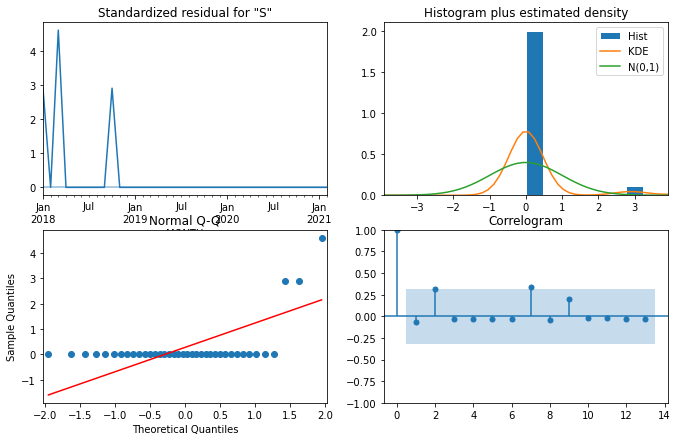

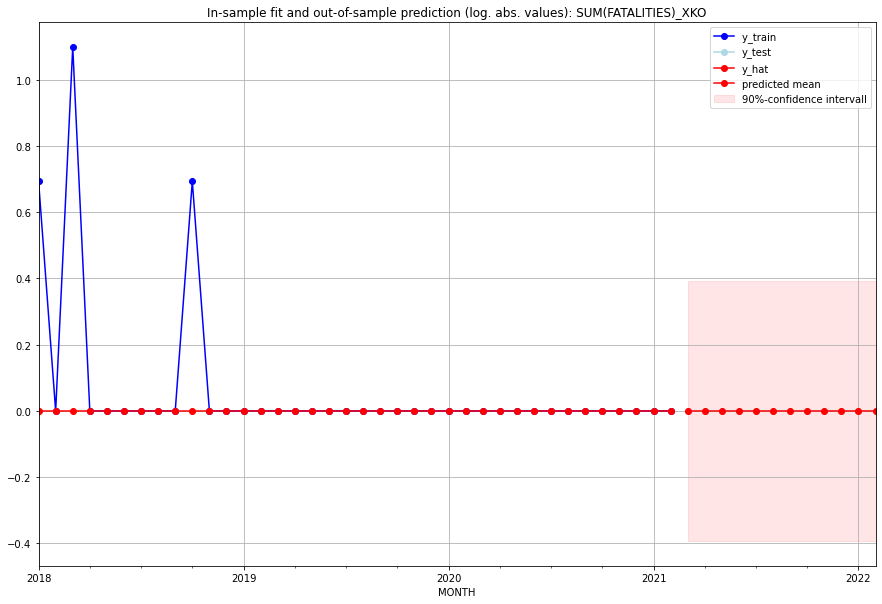

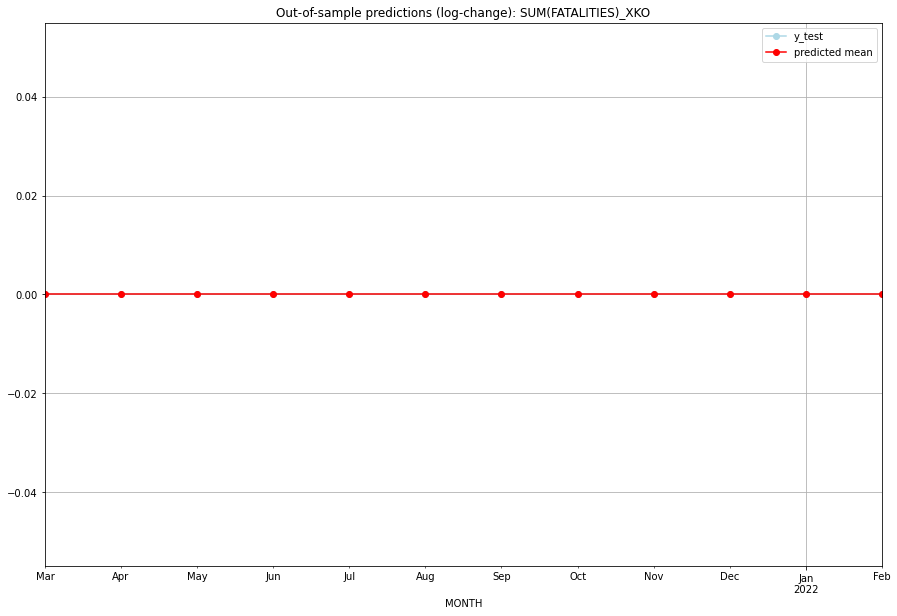

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   XKO   
1  2021-04-01       0.0         0.0           0.0             0.0   XKO   
2  2021-05-01       0.0         0.0           0.0             0.0   XKO   
3  2021-06-01       0.0         0.0           0.0             0.0   XKO   
4  2021-07-01       0.0         0.0           0.0             0.0   XKO   
5  2021-08-01       0.0         0.0           0.0             0.0   XKO   
6  2021-09-01       0.0         0.0           0.0             0.0   XKO   
7  2021-10-01       0.0         0.0           0.0             0.0   XKO   
8  2021-11-01       0.0         0.0           0.0             0.0   XKO   
9  2021-12-01       0.0         0.0           0.0             0.0   XKO   
10 2022-01-01       0.0         0.0           0.0             0.0   XKO   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [1, (0, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.0, 'fold_results': [nan, 0.0]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_XNC   No. Observations:                   38
Model:                SARIMAX(0, 1, 3)   Log Likelihood                  16.099
Date:                 Wed, 19 Oct 2022   AIC                            -22.198
Time:                         11:13:23   BIC                            -14.143
Sample:                     01-31-2018   HQIC                           -19.358
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.0331      0.020      1.673      0.094      -0.006       0

<Figure size 432x288 with 0 Axes>

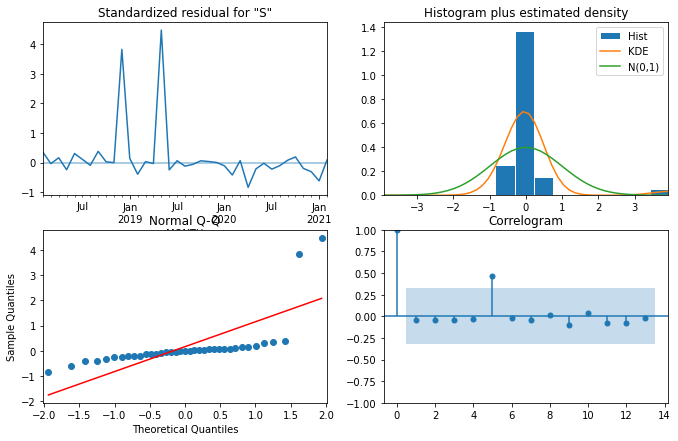

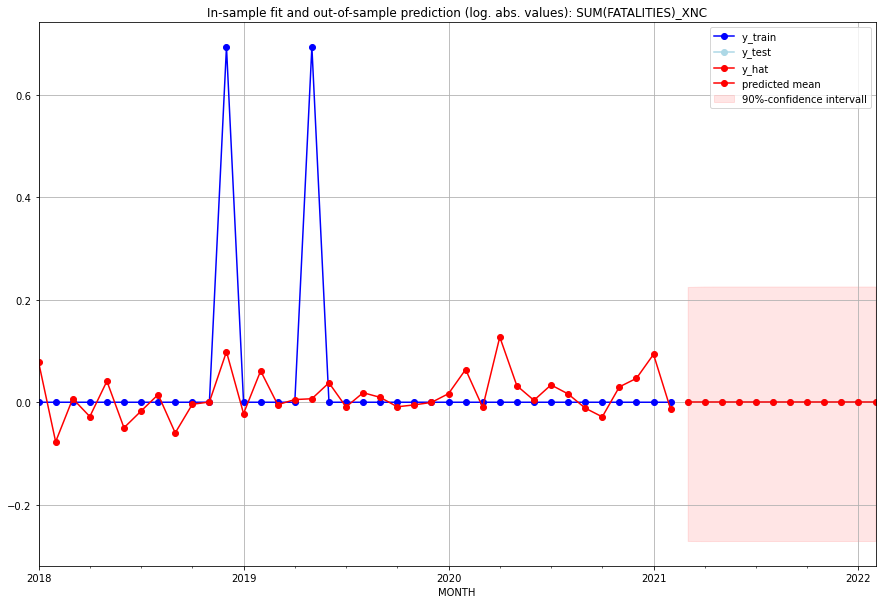

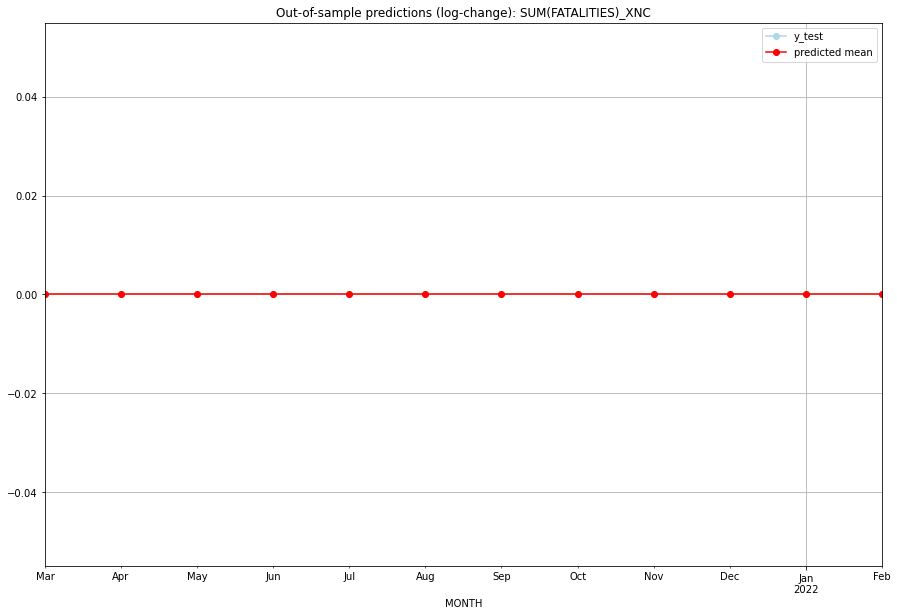

TADDA: 0.0
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01       0.0         0.0           0.0             0.0   XNC   
1  2021-04-01       0.0         0.0           0.0             0.0   XNC   
2  2021-05-01       0.0         0.0           0.0             0.0   XNC   
3  2021-06-01       0.0         0.0           0.0             0.0   XNC   
4  2021-07-01       0.0         0.0           0.0             0.0   XNC   
5  2021-08-01       0.0         0.0           0.0             0.0   XNC   
6  2021-09-01       0.0         0.0           0.0             0.0   XNC   
7  2021-10-01       0.0         0.0           0.0             0.0   XNC   
8  2021-11-01       0.0         0.0           0.0             0.0   XNC   
9  2021-12-01       0.0         0.0           0.0             0.0   XNC   
10 2022-01-01       0.0         0.0           0.0             0.0   XNC   
11 2022-02-01       0.0         0.0           0.0             0.0   

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (1, 1, 3), (0, 0, 0, 0), 'n'], 'cv_score': 0.2571265153034448, 'fold_results': [nan, 0.304717246605065, 0.1585101668127694, 0.3926431613233518, 0.1726354864725932]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_YEM   No. Observations:                   74
Model:                SARIMAX(1, 1, 3)   Log Likelihood                  -8.075
Date:                 Wed, 19 Oct 2022   AIC                             30.150
Time:                         11:13:35   BIC                             46.184
Sample:                     01-31-2015   HQIC                            36.540
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------

<Figure size 432x288 with 0 Axes>

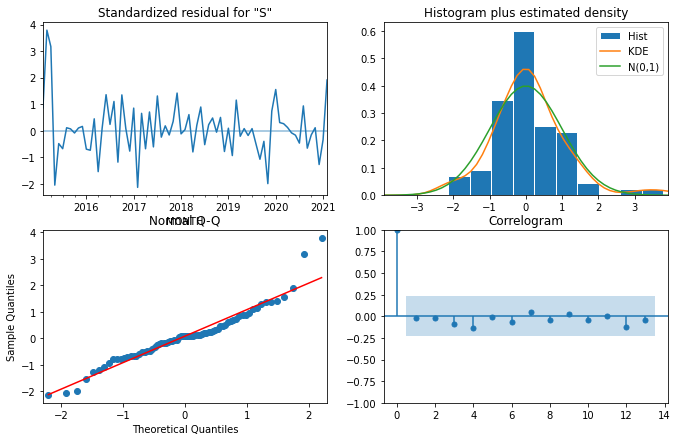

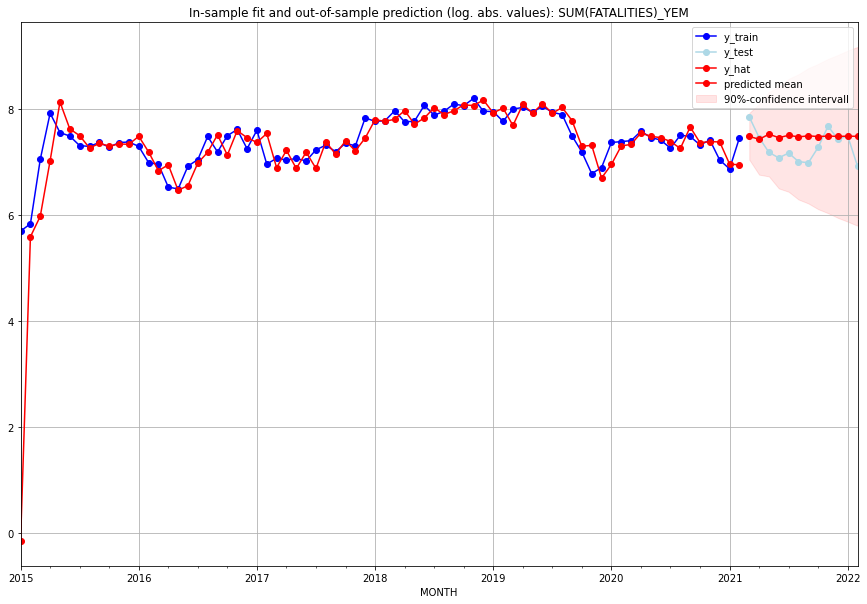

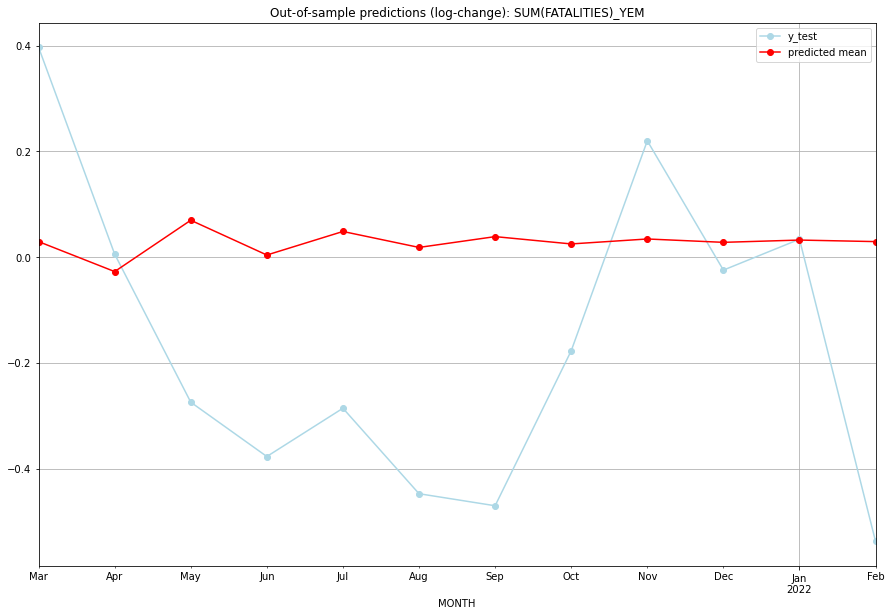

TADDA: 0.3089020579927994
Evaluation finished.
        MONTH     FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1788.942652      2584.0      0.029449        0.396990   YEM   
1  2021-04-01  1690.266833      1747.0     -0.027257        0.005737   YEM   
2  2021-05-01  1862.692797      1320.0      0.069825       -0.274346   YEM   
3  2021-06-01  1744.083828      1191.0      0.004068       -0.377102   YEM   
4  2021-07-01  1823.566592      1305.0      0.048607       -0.285766   YEM   
5  2021-08-01  1769.344120      1110.0      0.018439       -0.447475   YEM   
6  2021-09-01  1805.891960      1085.0      0.038873       -0.470234   YEM   
7  2021-10-01  1781.055228      1455.0      0.025032       -0.177042   YEM   
8  2021-11-01  1797.840481      2165.0      0.034407        0.220147   YEM   
9  2021-12-01  1786.454015      1695.0      0.028057       -0.024462   YEM   
10 2022-01-01  1794.158591      1797.0      0.032358        0.033940   YEM   
11 2022-02-01  17

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (0, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.41374650780283184, 'fold_results': [0.40429294842879004, 0.5776573654570557, 0.45093000209283357, 0.405981581911853, 0.22987064112362696]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ZAF   No. Observations:                  289
Model:                SARIMAX(0, 1, 0)   Log Likelihood                -408.038
Date:                 Wed, 19 Oct 2022   AIC                            818.076
Time:                         11:13:48   BIC                            821.739
Sample:                     02-28-1997   HQIC                           819.544
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------

<Figure size 432x288 with 0 Axes>

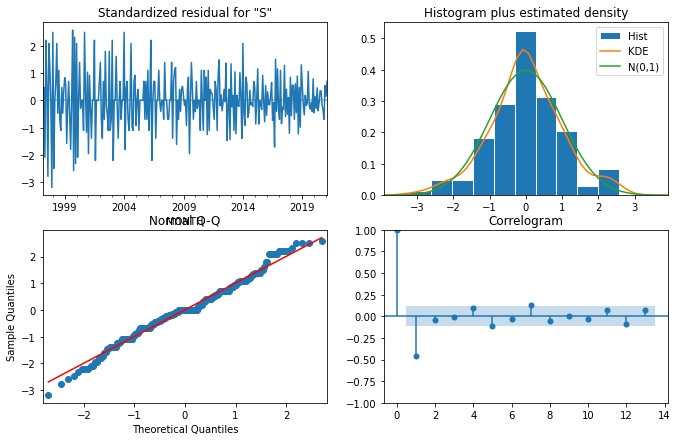

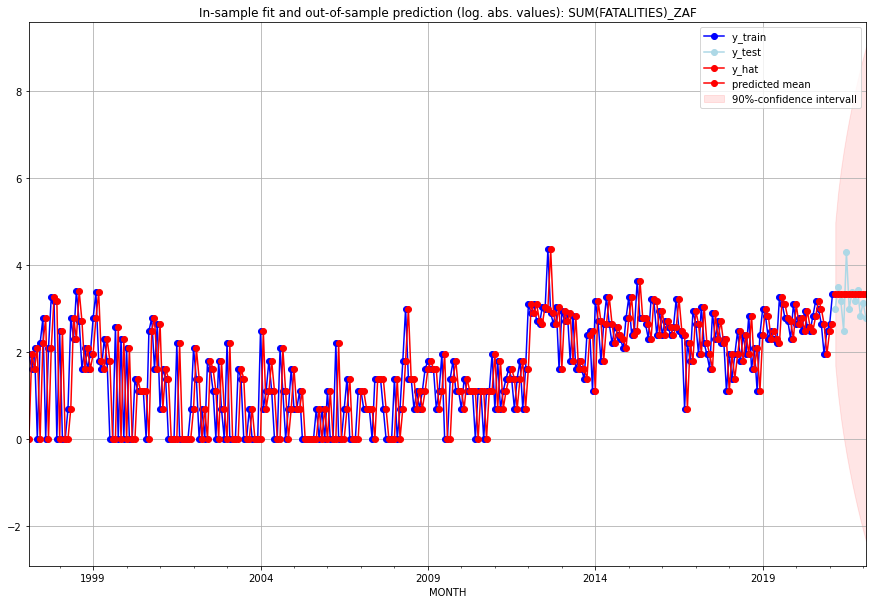

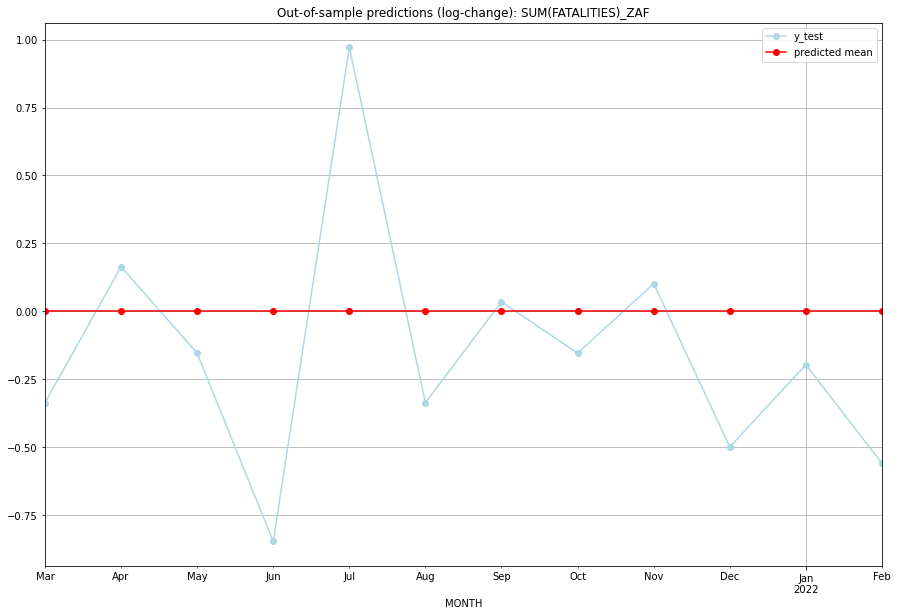

TADDA: 0.3630748825021725
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01      27.0        19.0  4.440892e-16       -0.336472   ZAF   
1  2021-04-01      27.0        32.0  4.440892e-16        0.164303   ZAF   
2  2021-05-01      27.0        23.0  4.440892e-16       -0.154151   ZAF   
3  2021-06-01      27.0        11.0  4.440892e-16       -0.847298   ZAF   
4  2021-07-01      27.0        73.0  4.440892e-16        0.971861   ZAF   
5  2021-08-01      27.0        19.0  4.440892e-16       -0.336472   ZAF   
6  2021-09-01      27.0        28.0  4.440892e-16        0.035091   ZAF   
7  2021-10-01      27.0        23.0  4.440892e-16       -0.154151   ZAF   
8  2021-11-01      27.0        30.0  4.440892e-16        0.101783   ZAF   
9  2021-12-01      27.0        16.0  4.440892e-16       -0.498991   ZAF   
10 2022-01-01      27.0        22.0  4.440892e-16       -0.196710   ZAF   
11 2022-02-01      27.0        15.0  4.440892e-16    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [0, (1, 1, 0), (0, 0, 0, 0), 'n'], 'cv_score': 0.5082960811458047, 'fold_results': [0.5230148764092379, 0.17328679513998632, 0.5057021323536759, 0.6168836623520824, 0.7225929394740414]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ZMB   No. Observations:                  289
Model:                SARIMAX(1, 1, 0)   Log Likelihood                -307.997
Date:                 Wed, 19 Oct 2022   AIC                            619.994
Time:                         11:14:09   BIC                            627.320
Sample:                     02-28-1997   HQIC                           622.930
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
-----------------------------------------------

<Figure size 432x288 with 0 Axes>

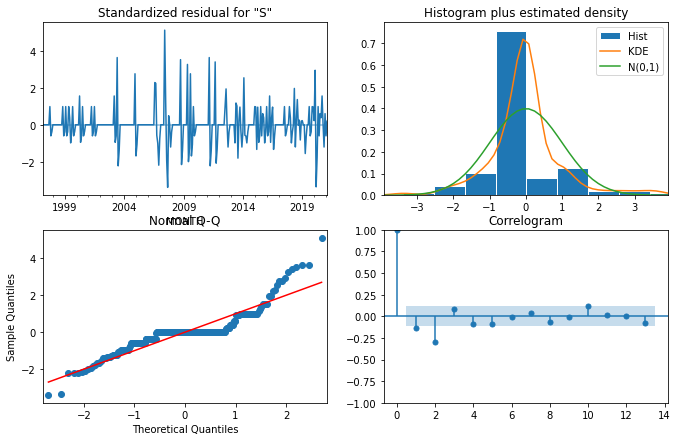

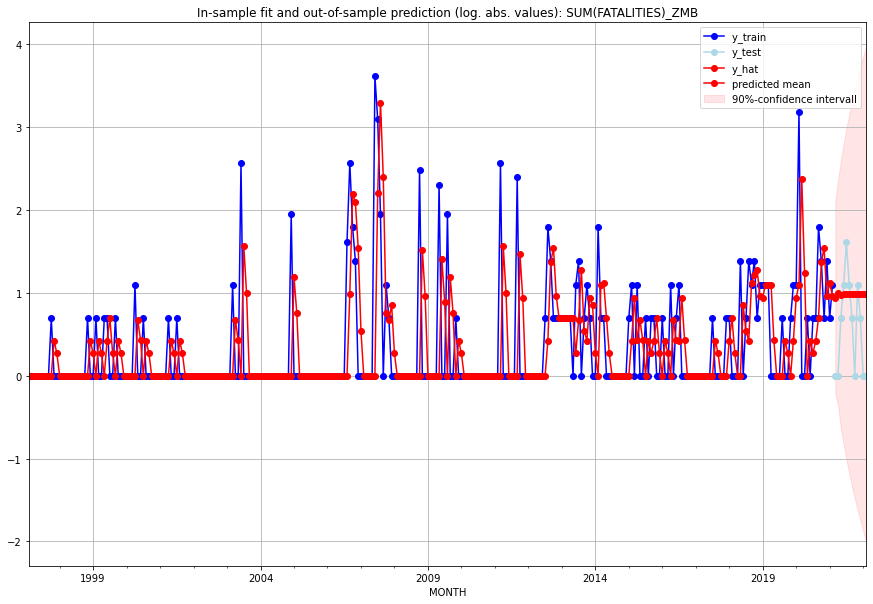

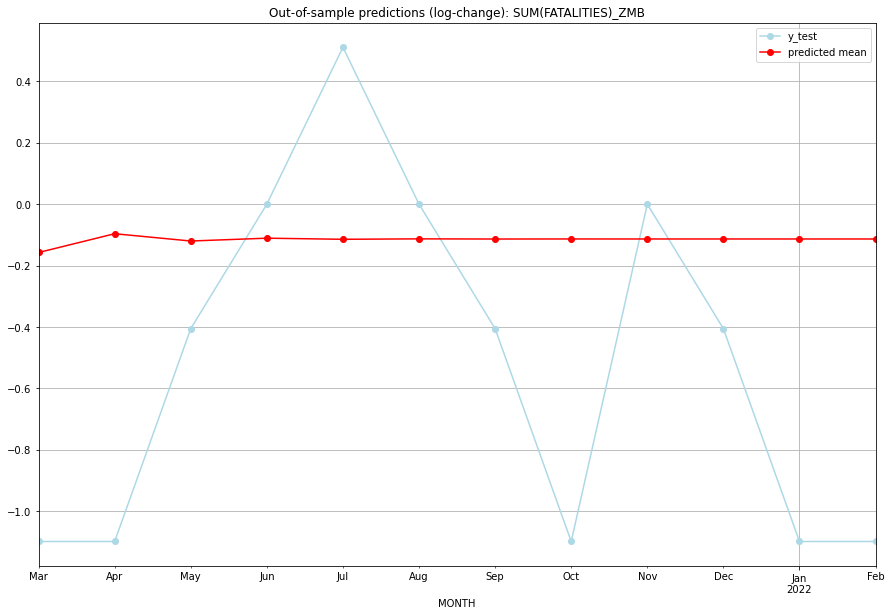

TADDA: 0.5704568212931747
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.563009         0.0     -0.157430       -1.098612   ZMB   
1  2021-04-01  1.724562         0.0     -0.096305       -1.098612   ZMB   
2  2021-05-01  1.660660         1.0     -0.120038       -0.405465   ZMB   
3  2021-06-01  1.685291         2.0     -0.110823        0.000000   ZMB   
4  2021-07-01  1.675701         4.0     -0.114401        0.510826   ZMB   
5  2021-08-01  1.679420         2.0     -0.113012        0.000000   ZMB   
6  2021-09-01  1.677975         1.0     -0.113551       -0.405465   ZMB   
7  2021-10-01  1.678536         0.0     -0.113342       -1.098612   ZMB   
8  2021-11-01  1.678319         2.0     -0.113423        0.000000   ZMB   
9  2021-12-01  1.678403         1.0     -0.113392       -0.405465   ZMB   
10 2022-01-01  1.678370         0.0     -0.113404       -1.098612   ZMB   
11 2022-02-01  1.678383         0.0     -0.113399    

  0%|          | 0/128 [00:00<?, ?it/s]



Best CV-Results
{'params': [2, (3, 1, 2), (0, 0, 0, 0), 'n'], 'cv_score': 0.5998370111305947, 'fold_results': [0.4594305526543802, 0.49735882363303857, 1.0077596439222185, 0.5467661386111355, 0.48786989683220044]}
Training finished.
                                SARIMAX Results                                
Dep. Variable:     SUM(FATALITIES)_ZWE   No. Observations:                  289
Model:                SARIMAX(3, 1, 2)   Log Likelihood                -300.978
Date:                 Wed, 19 Oct 2022   AIC                            617.956
Time:                         11:14:26   BIC                            647.260
Sample:                     02-28-1997   HQIC                           629.699
                          - 02-28-2021                                         
Covariance Type:                   opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------

<Figure size 432x288 with 0 Axes>

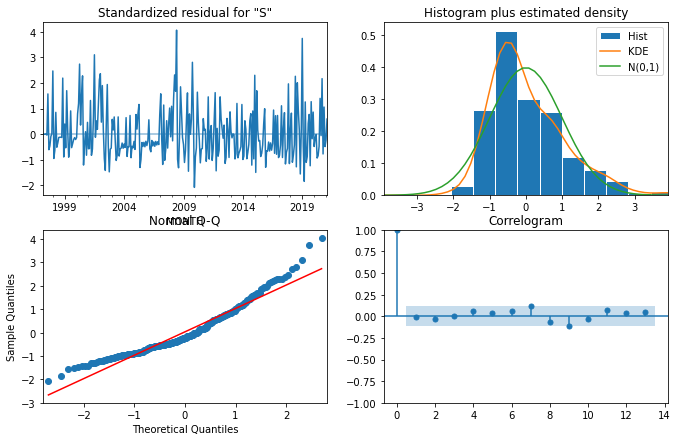

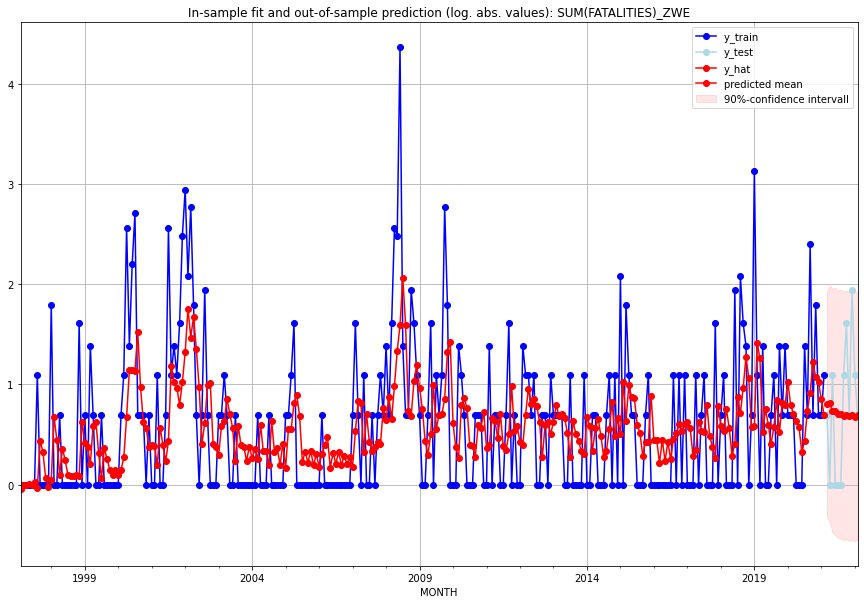

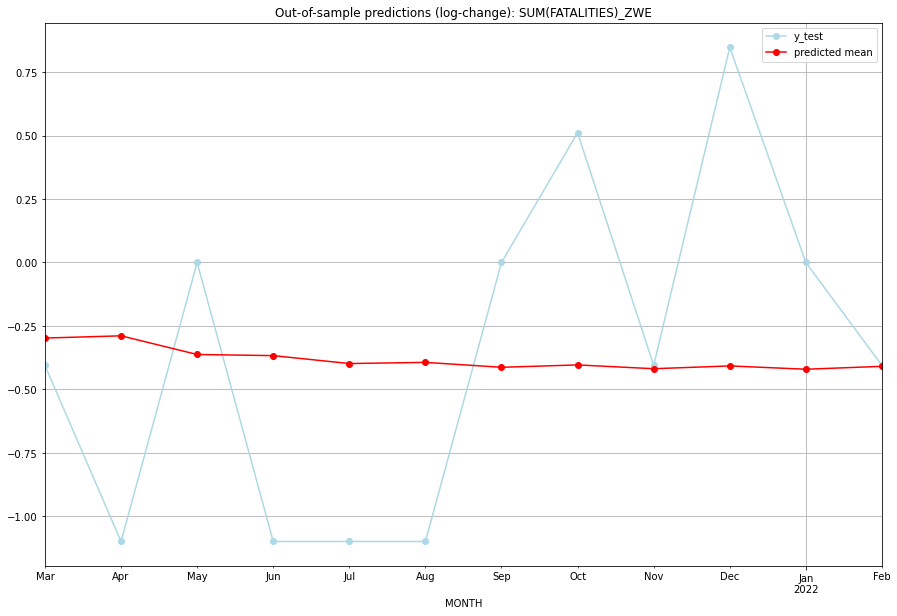

TADDA: 0.6038772194353044
Evaluation finished.
        MONTH  FAT_PRED  FAT_ACTUAL  LC(FAT_PRED)  LC(FAT_ACTUAL) GID_0  \
0  2021-03-01  1.227935         1.0     -0.297537       -0.405465   ZWE   
1  2021-04-01  1.247527         0.0     -0.288782       -1.098612   ZWE   
2  2021-05-01  1.088314         2.0     -0.362255        0.000000   ZWE   
3  2021-06-01  1.078955         0.0     -0.366747       -1.098612   ZWE   
4  2021-07-01  1.015153         0.0     -0.397917       -1.098612   ZWE   
5  2021-08-01  1.024418         0.0     -0.393330       -1.098612   ZWE   
6  2021-09-01  0.985675         2.0     -0.412653        0.000000   ZWE   
7  2021-10-01  1.004272         4.0     -0.403331        0.510826   ZWE   
8  2021-11-01  0.974503         1.0     -0.418296       -0.405465   ZWE   
9  2021-12-01  0.996354         6.0     -0.407290        0.847298   ZWE   
10 2022-01-01  0.970486         2.0     -0.420332        0.000000   ZWE   
11 2022-02-01  0.993035         1.0     -0.408954    

In [8]:
# warnings.simplefilter(action='ignore')

sarimax_res = pd.DataFrame(columns=["MONTH", "FAT_PRED", "FAT_ACTUAL", "LC(FAT_PRED)", "LC(FAT_ACTUAL)", "GID_0", "PARAMETERS", "TIMESTAMP"])
csv_file = "../data/"+MODEL_NAME+"_PREDICTIONS.csv"

if os.path.exists(csv_file):
    existing_res = pd.read_csv("../data/"+MODEL_NAME+"_PREDICTIONS.csv")
    # print(existing_res)
    print("File already exists.")
    
else:
    sarimax_res.to_csv(csv_file, index=False, mode="a", header=True)
    existing_res = sarimax_res

for i, g in enumerate(gid_list):
# for i, g in enumerate(["XNC"]):
    print("######## "+g+" ("+str(i+1)+"/"+str(len(gid_list))+") #########")
    # print(existing_res[existing_res["GID_0"] == g])
    print(len(existing_res[existing_res["GID_0"] == g]))
    
    
    # skip country if results already exiast
    if len(existing_res[existing_res["GID_0"] == g]) > 0:
        print("Model for this country has already been fitted.")
        continue
    
    # add time series of neighboring  countries as predictor variables

    if NEIGHBORS == True:
        neighbor = gid0_neighbors[gid0_neighbors["GID_0"] == g]["NEIGHBOUR"].tolist()
    else:
        neighbor = []
    print("Neighbor countries: "+ str(neighbor))

    # measure time 
    st = time.time()

    res = sarimax(target_variable = TARGET_VARIABLE,
                  target_country = g,
                  predictor_countries = neighbor,
                  n_lags_X = N_LAGS_X,
                  seasonal_periodicity = SEASONAL_PERIODICITY)

    # append country results to csv with timestamp
    res["TIMESTAMP"] = datetime.datetime.now()
    
    res.to_csv(csv_file, index=False, mode="a", header=False)

    et = time.time()
    elapsed_time = et - st
    print('Execution time:', time.strftime("%M:%S", time.gmtime(elapsed_time)))

    sarimax_res = pd.concat([sarimax_res, res], ignore_index=True)

    # break

In [9]:
# varimax_res.to_csv("../data/"+MODEL_NAME+"_PREDICTIONS.csv", index=False)

In [10]:
sarimax_res

,MONTH,FAT_PRED,FAT_ACTUAL,LC(FAT_PRED),LC(FAT_ACTUAL),GID_0,PARAMETERS,TIMESTAMP
0,2021-03-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:15.423044
1,2021-04-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:15.423044
2,2021-05-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:15.423044
3,2021-06-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:15.423044
4,2021-07-01 00:00:00,0.0,0.0,0.0,0.0,ABW,{},2022-10-19 10:23:15.423044
...,...,...,...,...,...,...,...,...
2803,2021-10-01 00:00:00,1.004272,4.0,-0.403331,0.510826,ZWE,"{'params': [2, (3, 1, 2), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:14:27.750084
2804,2021-11-01 00:00:00,0.974503,1.0,-0.418296,-0.405465,ZWE,"{'params': [2, (3, 1, 2), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:14:27.750084
2805,2021-12-01 00:00:00,0.996354,6.0,-0.40729,0.847298,ZWE,"{'params': [2, (3, 1, 2), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:14:27.750084
2806,2022-01-01 00:00:00,0.970486,2.0,-0.420332,0.0,ZWE,"{'params': [2, (3, 1, 2), (0, 0, 0, 0), 'n'], ...",2022-10-19 11:14:27.750084
